In [258]:
import numpy as np
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.mlab as mlab
import glob
import time
import pandas as pd
from statistics import mean
import math

# plt.rcParams["figure.figsize"] = (3,3)
print (time.ctime())

Thu Jul 22 16:17:48 2021


In [259]:
# file1 = "/home/imaginglab/Data/TPX3/CHIP0/Test/8x8Grid_visEq_1s_W0028_F03-200228-095644-1.csv"
file1 ="E:/Data/AOD7142021/AOD_7142021_5.0V_100nsPW_6usDelay_PolRot50degW0028_H07-210714-151415-1.csv"
# file1 ="/home/andrei/Data/TPX3/CHIP0/Test/AOD772021/AOD_772021_2.7V_100nsPW_6usDelay_2ndattempt_W0028_H07-210707-162811-1.csv"
print (file1, time.ctime())

# data1=np.loadtxt(file1, dtype= float, delimiter=",", usecols = (0,1,2,3,4))
# data1 = np.genfromtxt(file1, delimiter=",", skip_header=True)[:, 1:]
data1 = pd.read_csv(file1) # %timeit 1min 9s ± 829 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)
print(pd.read_csv(file1, nrows=5))
print(time.ctime())
# #print data
# y1   = data1.iloc[:, 0]
# x1   = data1.iloc[:, 1]
# t1   = data1.iloc[:, 2]
# a1   = data1.iloc[:, 3]
# A1   = data1.iloc[:, 4]

# for i in range(0,20):
#     print (i, x1[i],y1[i],t1[i],a1[i],A1[i])
    
# print (len(t1), time.ctime())

# # file2 = "/home/imaginglab/Data/TPX3/CHIP0/Test/8x8Grid_SettingsEq_1s_W0028_F03-200228-100050-1.csv"
# file2 = "/home/andrei/Data/TPX3/CHIP0/Test/AOD772021/AOD_772021_2.7V_100nsPW_6usDelay_2ndattempt_W0028_H07-210707-162811-1_time.csv"
# print (file2, time.ctime())

# # # data2=np.loadtxt(file2, dtype= float, delimiter=",", usecols = (0,1,2,3,4))
# # # data2 = np.genfromtxt(file2, delimiter=",", skip_header=True)[:, 1:]
# data2 =pd.read_csv(file2)
# print(pd.read_csv(file2, nrows=5))
# print(time.ctime())
# # # #print data
# # # y2  = data2.iloc[:, 0]
# # # x2  = data2.iloc[:, 1]
# # # t2  = data2.iloc[:, 2]
# # # a2  = data2.iloc[:, 3]
# # # A2  = data2.iloc[:, 4]

# # # for i in range(0,20):
# # #     print (i, x2[i],y2[i],t2[i],a2[i],A2[i])
    
# # # print (len(t2), time.ctime())

E:/Data/AOD7142021/AOD_7142021_5.0V_100nsPW_6usDelay_PolRot50degW0028_H07-210714-151415-1.csv Thu Jul 22 16:17:48 2021
   #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  #ToTtotal[arb]  \
0      936  153509008426    72   251  153615384064         50              50   
1      936  153509008426    68   253  153615384320         75              75   
2      936  153509008426   167    97  153616047616         75              75   
3      936  153509008426    93   237  153616837632        100             100   
4      936  153509008426    90   243  153616840448         25              25   

   #Trig-ToA[arb]  Unnamed: 8  
0       106375638         NaN  
1       106375894         NaN  
2       107039190         NaN  
3       107829206         NaN  
4       107832022         NaN  
Thu Jul 22 16:18:19 2021


In [260]:
data1.shape
# , data2.shape

(34731853, 9)

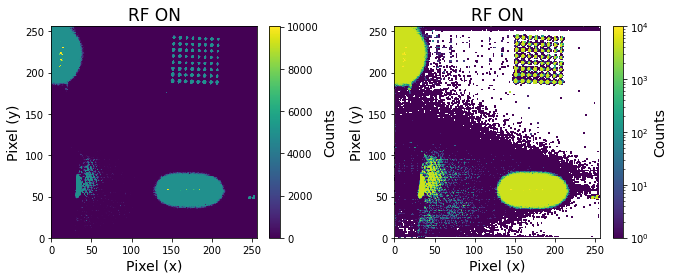

In [261]:
#File 1 grid
fig, (ax0, ax1) = plt.subplots(ncols=2, figsize=(9.5, 4))

h = ax0.hist2d(data1['#Row'], data1['#Col'], bins = 256, range = [(0, 256), (0, 256)])
cbar1 = fig.colorbar(h[3], ax = ax0)
cbar1.set_label('Counts', fontsize=14)
ax0.set_xlabel('Pixel (x)', fontsize=14)
ax0.set_ylabel('Pixel (y)', fontsize=14)
ax0.set_title('RF ON', fontsize=17)

h = ax1.hist2d(data1['#Row'], data1['#Col'], bins = 256, range = [(0, 256), (0, 256)], norm=mpl.colors.LogNorm())
cbar2 = fig.colorbar(h[3], ax = ax1)
cbar2.set_label('Counts', fontsize=14)
ax1.set_xlabel('Pixel (x)', fontsize=14)
ax1.set_ylabel('Pixel (y)', fontsize=14)
ax1.set_title('RF ON', fontsize=17)

fig.tight_layout()
plt.show()

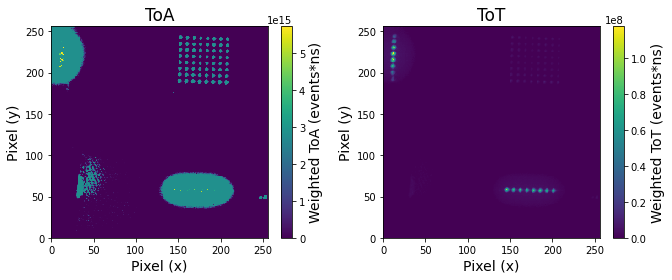

In [262]:
fig, (ax0, ax1) = plt.subplots(ncols=2, figsize=(9.5, 4), facecolor='w')
# data1['#Row'], data1['#Col'], bins = GridX1max-GridX1min, range = [(GridX1min, GridX1max), (GridY1min, GridY1max)]
h = ax0.hist2d(data1['#Row'], 
               data1['#Col'], 
               weights=data1['#ToA'], 
               bins = 256, range = [(0, 256), (0, 256)],
               )
cbar1 = fig.colorbar(h[3], ax = ax0)
#     cbar1.set_ticks([0,50,100,150,200,250])
#     tick_locator = ticker.MaxNLocator(nbins=6)
#     cbar1.locator = tick_locator
#     cbar1.update_ticks()
cbar1.set_label('Weighted ToA (events*ns)', fontsize=14)
ax0.set_xlabel('Pixel (x)', fontsize=14)
ax0.set_ylabel('Pixel (y)', fontsize=14)
ax0.set_title('ToA', fontsize=17)

h = ax1.hist2d(data1['#Row'], 
               data1['#Col'], 
               weights=data1['#ToT[arb]'], 
               bins = 256, range = [(0, 256), (0, 256)],
               )
cbar2 = fig.colorbar(h[3], ax = ax1)
#     cbar2.set_ticks([0,300,600,900,1200,1500])
#     tick_locator = ticker.MaxNLocator(nbins=6)
#     cbar2.locator = tick_locator
#     cbar2.update_ticks()
cbar2.set_label('Weighted ToT (events*ns)', fontsize=14)
ax1.set_xlabel('Pixel (x)', fontsize=14)
ax1.set_ylabel('Pixel (y)', fontsize=14)
ax1.set_title('ToT', fontsize=17)
fig.tight_layout()

In [263]:
# # file1 ="/QuantumRouter/AOD1012020/AOD_10s_blnkint_PL_1kHz_10ns_W0028_H07-201001-114131-1_cent.csv"
# GridX1min = 150
# GridX1max = 212
# GridY1min = 41
# GridY1max = 103

# # file1 ="/QuantumRouter/AOD1012020/AOD_10s_blnkint_PL_1kHz_10ns_W0028_H07-201001-114131-1.csv"
# GridX2min = 118
# GridX2max = 161
# GridY2min = 108
# GridY2max = 151

# # file1 ="E:/Data/AOD332021/AOD_784nm7mW1.8V_100nsPW_8usdelay_10usGW_W0028_H07-210303-144232-1.csv"
# GridX1min = 55
# GridX1max = 125
# GridY1min = 130
# GridY1max = 200

# file1 ="E:/Data/AOD332021/AOD_784nm7mW1.8V_100nsPW_8usdelay_10usGW_W0028_H07-210303-144232-1.csv"
# GridX1min = 100
# GridX1max = 150
# GridY1min = 90
# GridY1max = 140

file1 ="/home/andrei/Data/TPX3/CHIP0/Test/AOD772021/AOD_772021_2.7V_100nsPW_6usDelay_2ndattempt_W0028_H07-210707-162811-1.csv"
GridX1min = 140
GridX1max = 246
GridY1min = 150
GridY1max = 256

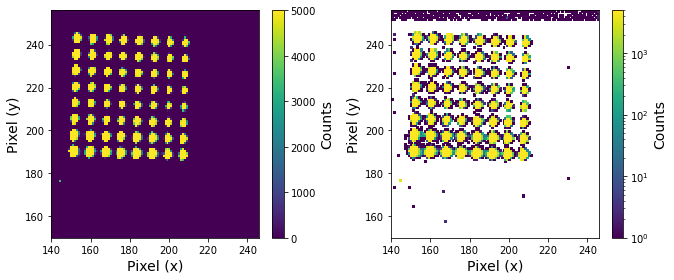

In [264]:
#File 1 grid

fig, (ax0, ax1) = plt.subplots(ncols=2, figsize=(9.5, 4))

h = ax0.hist2d(data1['#Row'], data1['#Col'], bins = GridX1max-GridX1min, range = [(GridX1min, GridX1max), (GridY1min, GridY1max)])
cbar1 = fig.colorbar(h[3], ax = ax0)
cbar1.set_label('Counts', fontsize=14)
ax0.set_xlabel('Pixel (x)', fontsize=14)
ax0.set_ylabel('Pixel (y)', fontsize=14)


h = ax1.hist2d(data1['#Row'], data1['#Col'], bins = GridX1max-GridX1min, range = [(GridX1min, GridX1max), (GridY1min, GridY1max)], norm=mpl.colors.LogNorm())
cbar2 = fig.colorbar(h[3], ax = ax1)
cbar2.set_label('Counts', fontsize=14)
ax1.set_xlabel('Pixel (x)', fontsize=14)
ax1.set_ylabel('Pixel (y)', fontsize=14)


fig.tight_layout()
plt.show()
# fig.savefig('fullgrid_8212020_025044-1_cent.png')

In [265]:
# #Display 1th order bottom spot
# # X
# # x: 134 - 240
# # y: 0 - 106

# # Y
# # x: 0 - 106
# # y: 150 -256

# fig, ((ax1, ax2), (ax3,ax4)) = plt.subplots(ncols=2, nrows=2, figsize=(10, 8))

# h1 = ax1.hist2d(data1['#Row'], data1['#Col'], bins = 106, range = [(0, 106), (150, 256)])
# fig.colorbar(h[3], ax = ax1)
# ax1.set_title('1st order beam parallel to y axis')

# h2 = ax2.hist2d(data1['#Row'], data1['#Col'], bins = GridX1max-GridX1min, range = [(GridX1min, GridX1max), (GridY1min, GridY1max)])
# fig.colorbar(h[3], ax = ax2)
# ax2.set_title('Grid')

# h3 = ax3.hist2d(data1['#Row'], data1['#Col'], bins = 106, range = [(0, 106), (0, 106)])
# fig.colorbar(h[3], ax = ax3)
# ax3.set_title('0th order beam')

# h4 = ax4.hist2d(data1['#Row'], data1['#Col'], bins = 106, range = [(134, 240), (0, 106)])
# fig.colorbar(h[3], ax = ax4)
# ax4.set_title('1st order beam parallel to x axis')


In [266]:
# # plt.xlim(963691753.125-50, 963691753.125+250)
# # x=(963691753.125-500000+(i*998100))

# TOA_MIN = data1['#ToA'].min()

# for i in range(100):
#     # start at min and move window of approx 1 period in size, by approx 1 period, each loop
#     ToAmin = (TOA_MIN-(500000*4096./25.))+((i*998100)*4096./25.)
#     ToAmax = ToAmin+(998100*4096./25.)
#     # create 100 dfs for consecutive time windows of approx 1 period
#     globals()["grid1_pulse"+str(i)+"_df"] = grid1_df[(grid1_df['#ToA'] > ToAmin) & (grid1_df['#ToA'] < ToAmax)]

#     # print(grid1_pulse1_df.shape, type(grid1_pulse1_df.iloc[0,0]), grid1_pulse1_df.iloc[:1])

In [267]:
# # finding peaks by finding max ToT in each peak
# for i in range(100):
#     # drop all ToTs < 1000 to shrink data set
#     globals()["grid1_pulse"+str(i)+"_sort_df"] = \
#     globals()["grid1_pulse"+str(i)+"_df"][globals()["grid1_pulse"+str(i)+"_df"]['#ToT[arb]'] > 1000]
#     # Create df consisting of only the max ToTs
#     globals()["grid1_pulse"+str(i)+"_max_df"] = \
#     globals()["grid1_pulse"+str(i)+"_sort_df"][globals()["grid1_pulse"+str(i)+"_sort_df"]['#ToT[arb]'] == (globals()["grid1_pulse"+str(i)+"_sort_df"]['#ToT[arb]'].max())]
#     print(globals()["grid1_pulse"+str(i)+"_max_df"].shape, globals()["grid1_pulse"+str(i)+"_max_df"].iloc[:2])
#     # Remove duplicates
#     if globals()["grid1_pulse"+str(i)+"_max_df"].shape[0] > 1:
#         globals()["grid1_pulse"+str(i)+"_max_df"] = \
#         globals()["grid1_pulse"+str(i)+"_max_df"][globals()["grid1_pulse"+str(i)+"_max_df"]['#ToA'] == (globals()["grid1_pulse"+str(i)+"_sort_df"]['#ToA'].min())]
#         print(globals()["grid1_pulse"+str(i)+"_max_df"].shape, globals()["grid1_pulse"+str(i)+"_max_df"].iloc[:2])

In [268]:
# # Here we subtract the offset by subtracting 50ns from the ToA corresponding to the max ToT.
# # We use this ToA because the max ToT is usually one of the earlist points in the cluster because of the time-walk structure
# # Therefore, we take it to be an approximation of the minimum 
# for i in range(100):
#     globals()['grid1_pulse'+str(i)+'_df']['#ToA'] = \
#     (globals()['grid1_pulse'+str(i)+'_df']['#ToA']/4096.*25.)-((globals()["grid1_pulse"+str(i)+"_max_df"]['#ToA'].max()/4096.*25.)-50)

In [269]:
# # Make 100 plots from the 100 dfs
# # from matplotlib import ticker
# for i in range(100):
#     fig, (ax0, ax1) = plt.subplots(ncols=2, figsize=(9.5, 4), facecolor='w')
#     h = ax0.hist2d(globals()['grid1_pulse'+str(i)+'_df']['#Row'], 
#                    globals()['grid1_pulse'+str(i)+'_df']['#Col'], 
#                    weights=globals()['grid1_pulse'+str(i)+'_df']['#ToA'], 
#                    bins = GridX1max-GridX1min, 
#                    range = [(GridX1min, GridX1max), (GridY1min, GridY1max)], 
#                    norm = mpl.colors.Normalize(vmin=0,vmax=250))
#     cbar1 = fig.colorbar(h[3], ax = ax0)
# #     cbar1.set_ticks([0,50,100,150,200,250])
# #     tick_locator = ticker.MaxNLocator(nbins=6)
# #     cbar1.locator = tick_locator
# #     cbar1.update_ticks()
#     cbar1.set_label('Weighted ToA (Events*ns)', fontsize=14)
#     ax0.set_xlabel('Row (Pixels)', fontsize=14)
#     ax0.set_ylabel('Col (Pixels)', fontsize=14)
#     ax0.set_title('ToA', fontsize=17)

#     h = ax1.hist2d(globals()['grid1_pulse'+str(i)+'_df']['#Row'], 
#                    globals()['grid1_pulse'+str(i)+'_df']['#Col'], 
#                    weights=globals()['grid1_pulse'+str(i)+'_df']['#ToT[arb]'], 
#                    bins = GridX1max-GridX1min, 
#                    range = [(GridX1min, GridX1max), (GridY1min, GridY1max)], 
#                    norm = mpl.colors.Normalize(vmin=0,vmax=1600))
#     cbar2 = fig.colorbar(h[3], ax = ax1)
# #     cbar2.set_ticks([0,300,600,900,1200,1500])
# #     tick_locator = ticker.MaxNLocator(nbins=6)
# #     cbar2.locator = tick_locator
# #     cbar2.update_ticks()
#     cbar2.set_label('Weighted ToT (Events*ns)', fontsize=14)
#     ax1.set_xlabel('Row (Pixels)', fontsize=14)
#     ax1.set_ylabel('Col (Pixels)', fontsize=14)
#     ax1.set_title('ToT', fontsize=17)
#     fig.tight_layout()

#     fig.savefig('gridtoatot_frame'+str(i)+'.png', bbox_inches='tight')
#     plt.close()
#     fig.clf()
# plt.show()

In [270]:
def min_max(data, grid_x_min, grid_x_max, grid_y_min, grid_y_max):
    """Returns DataFrame filtering values less than min or greater than max for two columns"""
    x_cond = (data['#Row'] >grid_x_min) & (data['#Row'] < grid_x_max)
    y_cond = (data['#Col'] > grid_y_min) & (data['#Col'] < grid_y_max)
    new_data = data[x_cond & y_cond]
    return new_data



In [271]:
grid1_df = min_max(data1, GridX1min, GridX1max, GridY1min, GridY1max)

print(grid1_df.shape, type(grid1_df.iloc[0,0]), type(grid1_df.iloc[1,1]), time.ctime())
print(grid1_df.iloc[:3])

# grid2_df = min_max(data2, GridX2min, GridX2max, GridY2min, GridY2max)

# print(grid2_df.shape, type(grid2_df.iloc[0,0]), type(grid2_df.iloc[1,1]), time.ctime())
# print(grid2_df.iloc[:3])

(4719274, 9) <class 'numpy.int64'> <class 'numpy.int64'> Thu Jul 22 16:19:04 2021
    #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
84      936  153509008426   209   160  153623035648         25   
90      936  153509008426   222   184  153623353344         50   
93      936  153509008426   200   183  153623355136         25   

    #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
84              25       114027222         NaN  
90              50       114344918         NaN  
93              25       114346710         NaN  


In [272]:
# # %timeit 6.41 s ± 24.1 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)
# oth_df = min_max(data1, 0, 60, 185, 245)
# # Pt1_ToT_df = grid1_df.drop(grid1_df[(grid1_df['#ToT[arb]'] > tMin2) & (grid1_df['#ToT[arb]'] < tMax2)].index)

# print(oth_df.shape, type(oth_df.iloc[0,0]), type(oth_df.iloc[1,1]), time.ctime())
# print(oth_df.iloc[:3])

In [273]:
# X
# x: 134 - 240
# y: 0 - 106

# Y
# x: 0 - 106
# y: 150 -256

In [274]:
X_df = min_max(data1, 134, 240, 0, 106)
# Pt1_ToT_df = grid1_df.drop(grid1_df[(grid1_df['#ToT[arb]'] > tMin2) & (grid1_df['#ToT[arb]'] < tMax2)].index)

print(X_df.shape, type(X_df.iloc[0,0]), type(X_df.iloc[1,1]), time.ctime())
print(X_df.iloc[:3])

(14736593, 9) <class 'numpy.int64'> <class 'numpy.int64'> Thu Jul 22 16:19:06 2021
   #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  #ToTtotal[arb]  \
3      936  153509008426    93   237  153616837632        100             100   
6      936  153509008426    31   194  153617466880         25              25   
7      936  153509008426    31   200  153617483776         25              25   

   #Trig-ToA[arb]  Unnamed: 8  
3       107829206         NaN  
6       108458454         NaN  
7       108475350         NaN  


In [275]:
Y_df = min_max(data1, 0, 106, 150, 256)
# Pt1_ToT_df = grid1_df.drop(grid1_df[(grid1_df['#ToT[arb]'] > tMin2) & (grid1_df['#ToT[arb]'] < tMax2)].index)

print(Y_df.shape, type(Y_df.iloc[0,0]), type(Y_df.iloc[1,1]), time.ctime())
print(Y_df.iloc[:3])

(11445805, 9) <class 'numpy.int64'> <class 'numpy.int64'> Thu Jul 22 16:19:07 2021
    #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2       936  153509008426   167    97  153616047616         75   
25      936  153509008426   159    83  153619631616         25   
35      936  153509008426   159    66  153620916480        125   

    #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2               75       107039190         NaN  
25              25       110623190         NaN  
35             125       111908054         NaN  


In [276]:
%store -r _0thToTsum

In [277]:
GRIDToTsum = np.nansum(grid1_df['#ToT[arb]'].to_numpy())
# _0thToTsum = np.nansum(oth_df['#ToT[arb]'].to_numpy())
YToTsum = np.nansum(Y_df['#ToT[arb]'].to_numpy())
XToTsum = np.nansum(X_df['#ToT[arb]'].to_numpy())
print("GRIDToTsum:", GRIDToTsum)
print("XToTsum:", XToTsum)
print("YToTsum:", YToTsum)
print("0thToTsum:", _0thToTsum)

# print("Y/0th:", YToTsum/_0thToTsum)
# print("X/0th:", XToTsum/_0thToTsum)
# print("grid spots/non-grid spots:", GRIDToTsum/(_0thToTsum+YToTsum+XToTsum))
# print("diffracted/0th:", (GRIDToTsum+YToTsum+XToTsum)/_0thToTsum)

GRIDToTsum: 2019169700
XToTsum: 16529413575
YToTsum: 16691446975
0thToTsum: 180990859075


In [278]:
print("Y/0th:", YToTsum/_0thToTsum)
print("X/0th:", XToTsum/_0thToTsum)
print("grid spots/non-grid spots:", GRIDToTsum/(_0thToTsum+YToTsum+XToTsum))
print("diffracted/0th:", (GRIDToTsum+YToTsum+XToTsum)/_0thToTsum)

Y/0th: 0.09222259654606814
X/0th: 0.09132733917877284
grid spots/non-grid spots: 0.009426046826638466
diffracted/0th: 0.19470613284064828


In [279]:
print("Diffraction efficiency: %.2f %%" % (((GRIDToTsum+YToTsum+XToTsum)/_0thToTsum)*100))

Diffraction efficiency: 19.47 %


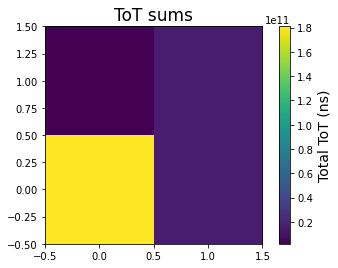

In [280]:
# reshape and plot data
# plt.figure(figsize = (8,8))
# TOTsums = [YToTsum, GRIDToTsum, _0thToTsum, XToTsum]
TOTsums = [_0thToTsum, XToTsum, GRIDToTsum, YToTsum]
plt.imshow(np.array(TOTsums).reshape(2,2), origin='lower')
plt.colorbar().set_label('Total ToT (ns)', fontsize=14)
plt.title('ToT sums', fontsize=17)
plt.show()

In [242]:
# Write ToT sums to txt file for plotting cumlative data later
with open('ToTs.txt', 'a') as file1:
    for tot in TOTsums:
        file1.write("%d\n" % tot)
        
file1.close()

In [133]:
# ToTs
# with open('ToTs.txt') as file1:
#     line = file1.readline()
#     print(line)
#     cnt = 1
#     while line:
#         print("Line {}: {}".format(cnt, line.strip()))
#         line = file1.readline()
#         cnt += 1
# gridToTs = [329500, 249491700, 3732142, 9670935025, ]
# xToTs = [40840525, 3760982450, 23173292750, 53026336800, ]
# yToTs = [400, 23468175, 322047050, 825412550, ]
# _0thToTs = [5644968775, 18357594650, 60742925625, 111438661100, ]

111438661100

Line 1: 111438661100
Line 2: 53026336800
Line 3: 9670935025
Line 4: 825412550


In [243]:
# ToTs; append ToTs for txt file to cumlative list for 0th, grid, sidebars
# Note: order or appending is based on order of TOTsums array for imshow plot "ToT sums";
# may be changed due to beam output orientation on CCD
gridToTs = [329500, 249491700, 3732142]
xToTs = [40840525, 3760982450, 23173292750]
yToTs = [400, 23468175, 322047050]
_0thToTs = [5644968775, 18357594650, 60742925625]

with open('ToTs.txt') as file1:
    line_number = 0
    lines = file1.readlines()
    for i in range(int(len(lines)/4)):
        _0thToTs.append(int(lines[line_number].strip()))
        xToTs.append(int(lines[line_number+1].strip()))
        gridToTs.append(int(lines[line_number+2].strip()))
        yToTs.append(int(lines[line_number+3].strip()))
        line_number+=4

In [244]:
print("_0thToTs:", _0thToTs)
print("xToTs:", xToTs)
print("gridToTs:", gridToTs)
print("yToTs:", yToTs)

_0thToTs: [5644968775, 18357594650, 60742925625, 111438661100, 155417307425, 163323571625, 171645188200, 180990859075]
xToTs: [40840525, 3760982450, 23173292750, 53026336800, 91559286775, 71150086550, 60984350050, 57191037125]
gridToTs: [329500, 249491700, 3732142, 9670935025, 20386253725, 30828439800, 34428249700, 35471919075]
yToTs: [400, 23468175, 322047050, 825412550, 1795089725, 2838371750, 2999067100, 3158810925]


In [281]:
import os
if os.path.exists("ToTs.txt"):
    os.remove("ToTs.txt")
else:
    print("The file does not exist")

In [246]:
# Percentages
prcntX = [((a/b)*100) for a,b in zip(xToTs, _0thToTs)]
prcntY = [((a/b)*100) for a,b in zip(yToTs, _0thToTs)]
prcntGRID = [((a/b)*100) for a,b in zip(gridToTs, _0thToTs)]

In [247]:
inputPwr = [0.25, 0.28, 0.34, 0.65, 0.70, 1.50, 1.90, 2.35] # Power at AOD Input [uW]

'Thu Jul 22 16:15:25 2021'

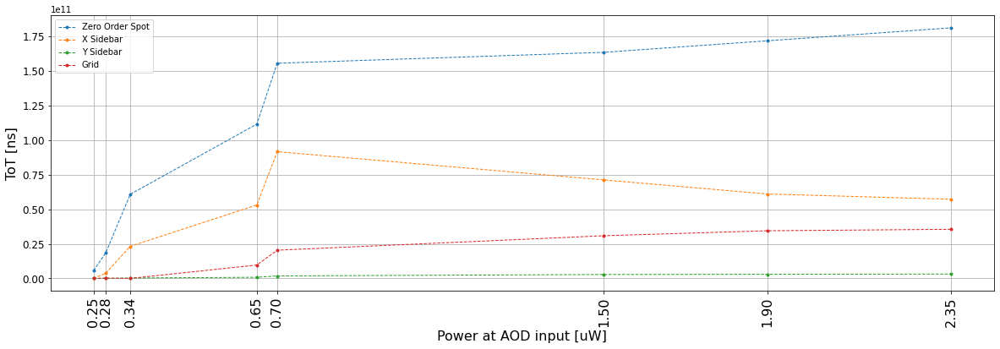

In [257]:
plt.rcParams["figure.figsize"] = (20,6)

plt.plot(inputPwr,_0thToTs, '.', linestyle='--', linewidth=1)
plt.plot(inputPwr,xToTs, '.', linestyle='--', linewidth=1)
plt.plot(inputPwr,yToTs, '.', linestyle='--', linewidth=1)
plt.plot(inputPwr,gridToTs, '.', linestyle='--', linewidth=1)
#plt.title("TOT", fontsize = 12) # change the title
plt.xlabel('Power at AOD input [uW]',fontsize = 16)
plt.ylabel('ToT [ns]',fontsize = 16)
plt.xticks(inputPwr, fontsize = 16, rotation="vertical")
plt.yticks(fontsize=12)
plt.grid()
plt.legend(["Zero Order Spot", "X Sidebar", "Y Sidebar","Grid"])

# plt.savefig('TOTvsTOA_256x256_8212020_025447-1_cent.png', bbox_inches='tight')
time.ctime()

'Thu Jul 22 15:11:45 2021'

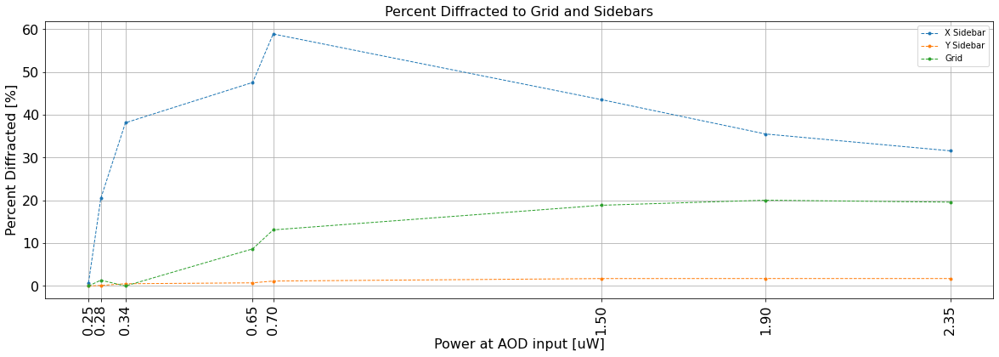

In [255]:
plt.rcParams["figure.figsize"] = (20,6)

plt.plot(inputPwr,prcntX, '.', linestyle='--', linewidth=1)
plt.plot(inputPwr,prcntY, '.', linestyle='--', linewidth=1)
plt.plot(inputPwr,prcntGRID, '.', linestyle='--', linewidth=1)
plt.title("Percent Diffracted to Grid and Sidebars", fontsize = 16) # change the title
plt.xlabel('Power at AOD input [uW]',fontsize = 16)
plt.ylabel('Percent Diffracted [%]',fontsize = 16)
plt.xticks(inputPwr, fontsize = 16, rotation="vertical")
plt.yticks(fontsize=16)
plt.grid()
plt.legend(["X Sidebar", "Y Sidebar","Grid"])

# plt.savefig('TOTvsTOA_256x256_8212020_025447-1_cent.png', bbox_inches='tight')
time.ctime()

In [13]:
TrigTime = data2['#TrigTime'].to_numpy()

'Mon Feb  1 20:02:07 2021'

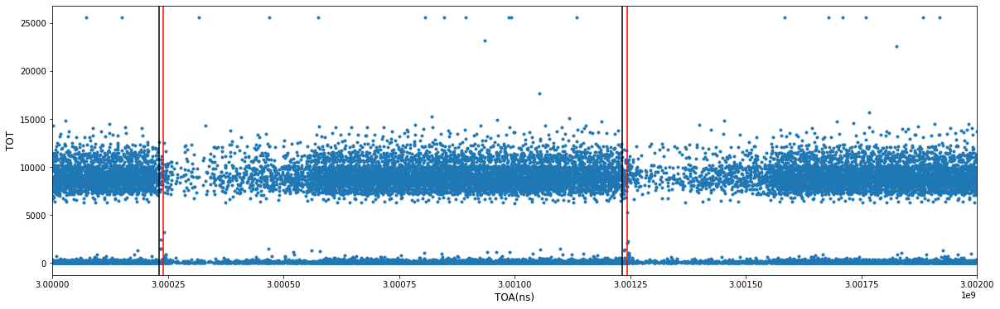

In [79]:
# r1 = t1[len(t1)//2:]/4096*25
# f1 = a1[len(a1)//2:]
plt.rcParams["figure.figsize"] = (20,6)
#len(t) = 8550085 
#
#plt.scatter(r,f)
plt.plot(oth_df['#ToA']/4096.*25.,oth_df['#ToT[arb]'], '.')
#plt.plot(r, f, 'xb-')
#plt.title("TOT", fontsize = 12) # change the title
plt.xlabel('TOA(ns)',fontsize = 12)
plt.ylabel('TOT',fontsize = 12)
for i in range(5000):
    plt.axvline(x=(TrigTime[i]/4096.*25.), ymin=0, ymax=2500, color='k')
    plt.axvline(x=((TrigTime[i]/4096.*25.)+10000), ymin=0, ymax=2500, color='r')
# plt.axvline(x=(TOA_MIN/4096.*25.), ymin=0, ymax=2500, color='k')
# plt.xlim(963691753.125-50, 963691753.125+250)
# plt.xlim(3.25875e9, 3.2592e9)
plt.xlim(3e9, 3.002e9)
# plt.savefig('TOTvsTOA_256x256_8212020_025447-1_cent.png', bbox_inches='tight')
time.ctime()

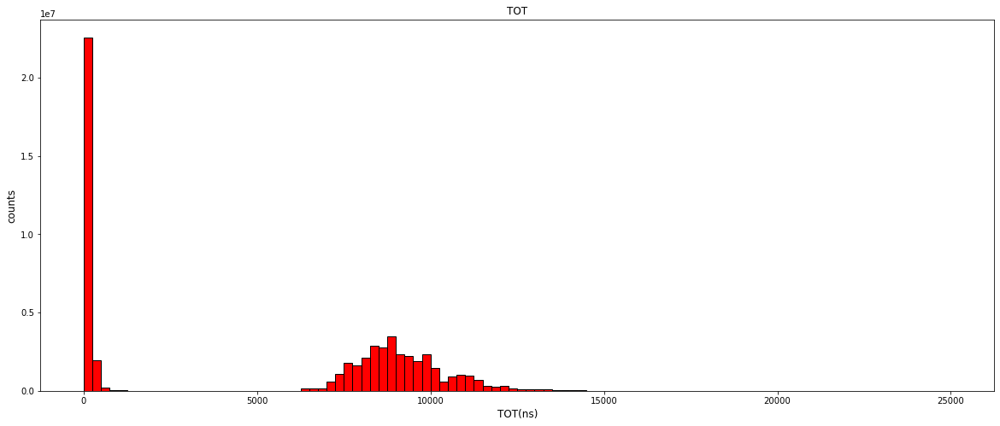

In [110]:
fig, ax1 = plt.subplots(ncols=1, figsize=(20, 8))

nbins = 100

plt.hist(oth_df['#ToT[arb]'], bins= nbins, range = [0, 25000], color = 'r', ec = 'k')
plt.title("TOT", fontsize = 12) # change the title
plt.xlabel('TOT(ns)',fontsize = 12)
plt.ylabel('counts',fontsize = 12)
# plt.hist(Pt1_df['#ToT[arb]'], bins= nbins, range = [0, 20000], lw=3, histtype='step', label = 'file 2', color = 'red')

# plt.xlabel('ToT, ns')
# plt.legend()
plt.show()

'Mon Feb  1 21:23:23 2021'

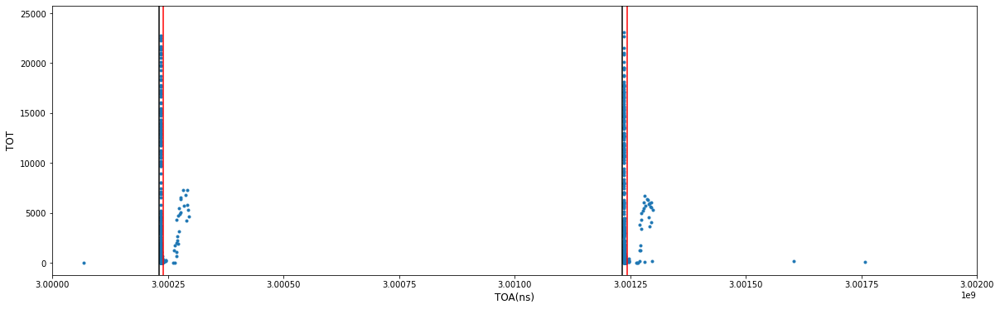

In [100]:
# r1 = t1[len(t1)//2:]/4096*25
# f1 = a1[len(a1)//2:]
plt.rcParams["figure.figsize"] = (20,6)
#len(t) = 8550085 
#
#plt.scatter(r,f)
plt.plot(X_df['#ToA']/4096.*25.,X_df['#ToT[arb]'], '.')
#plt.plot(r, f, 'xb-')
#plt.title("TOT", fontsize = 12) # change the title
plt.xlabel('TOA(ns)',fontsize = 12)
plt.ylabel('TOT',fontsize = 12)
for i in range(5000):
    plt.axvline(x=(TrigTime[i]/4096.*25.), ymin=0, ymax=2500, color='k')
    plt.axvline(x=((TrigTime[i]/4096.*25.)+10000), ymin=0, ymax=2500, color='r')
# plt.axvline(x=(TOA_MIN/4096.*25.), ymin=0, ymax=2500, color='k')
# plt.xlim(963691753.125-50, 963691753.125+250)
# plt.xlim(3.25875e9, 3.2592e9)
plt.xlim(3e9, 3.002e9)
# plt.savefig('TOTvsTOA_256x256_8212020_025447-1_cent.png', bbox_inches='tight')
time.ctime()

'Mon Feb  1 23:34:26 2021'

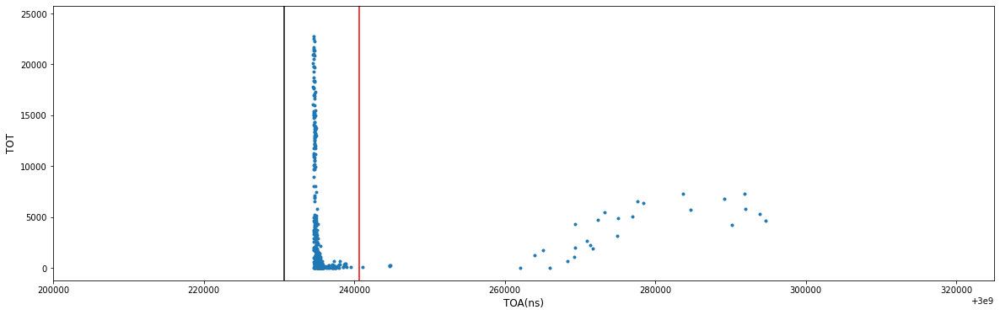

In [105]:
# r1 = t1[len(t1)//2:]/4096*25
# f1 = a1[len(a1)//2:]
plt.rcParams["figure.figsize"] = (20,6)
#len(t) = 8550085 
#
#plt.scatter(r,f)
plt.plot(X_df['#ToA']/4096.*25.,X_df['#ToT[arb]'], '.')
#plt.plot(r, f, 'xb-')
#plt.title("TOT", fontsize = 12) # change the title
plt.xlabel('TOA(ns)',fontsize = 12)
plt.ylabel('TOT',fontsize = 12)
for i in range(5000):
    plt.axvline(x=(TrigTime[i]/4096.*25.), ymin=0, ymax=2500, color='k')
    plt.axvline(x=((TrigTime[i]/4096.*25.)+10000), ymin=0, ymax=2500, color='r')
# plt.axvline(x=(TOA_MIN/4096.*25.), ymin=0, ymax=2500, color='k')
# plt.xlim(963691753.125-50, 963691753.125+250)
# plt.xlim(3.25875e9, 3.2592e9)
plt.xlim(3.0002e9, 3.000325e9)
# plt.savefig('TOTvsTOA_256x256_8212020_025447-1_cent.png', bbox_inches='tight')
time.ctime()

'Mon Feb  1 21:23:41 2021'

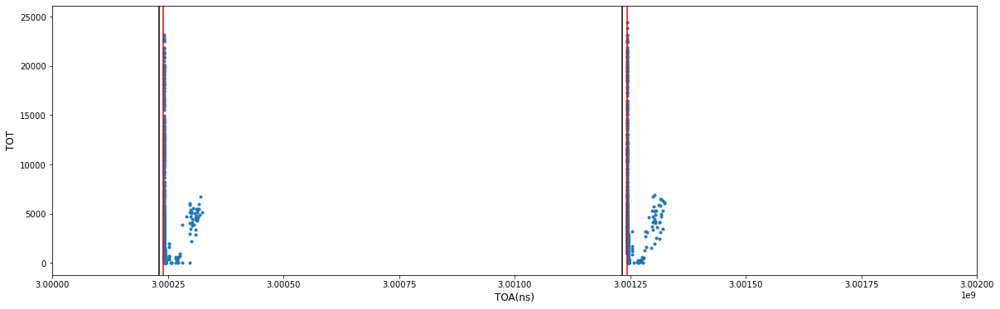

In [101]:
# r1 = t1[len(t1)//2:]/4096*25
# f1 = a1[len(a1)//2:]
plt.rcParams["figure.figsize"] = (20,6)
#len(t) = 8550085 
#
#plt.scatter(r,f)
plt.plot(Y_df['#ToA']/4096.*25.,Y_df['#ToT[arb]'], '.')
#plt.plot(r, f, 'xb-')
#plt.title("TOT", fontsize = 12) # change the title
plt.xlabel('TOA(ns)',fontsize = 12)
plt.ylabel('TOT',fontsize = 12)
for i in range(5000):
    plt.axvline(x=(TrigTime[i]/4096.*25.), ymin=0, ymax=2500, color='k')
    plt.axvline(x=((TrigTime[i]/4096.*25.)+10000), ymin=0, ymax=2500, color='r')
# plt.axvline(x=(TOA_MIN/4096.*25.), ymin=0, ymax=2500, color='k')
# plt.xlim(963691753.125-50, 963691753.125+250)
# plt.xlim(3.25875e9, 3.2592e9)
plt.xlim(3e9, 3.002e9)
# plt.savefig('TOTvsTOA_256x256_8212020_025447-1_cent.png', bbox_inches='tight')
time.ctime()

'Mon Feb  1 23:36:25 2021'

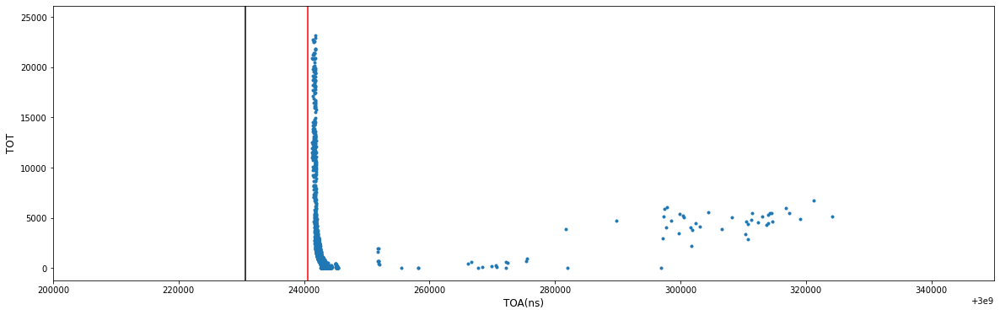

In [107]:
# r1 = t1[len(t1)//2:]/4096*25
# f1 = a1[len(a1)//2:]
plt.rcParams["figure.figsize"] = (20,6)
#len(t) = 8550085 
#
#plt.scatter(r,f)
plt.plot(Y_df['#ToA']/4096.*25.,Y_df['#ToT[arb]'], '.')
#plt.plot(r, f, 'xb-')
#plt.title("TOT", fontsize = 12) # change the title
plt.xlabel('TOA(ns)',fontsize = 12)
plt.ylabel('TOT',fontsize = 12)
for i in range(5000):
    plt.axvline(x=(TrigTime[i]/4096.*25.), ymin=0, ymax=2500, color='k')
    plt.axvline(x=((TrigTime[i]/4096.*25.)+10000), ymin=0, ymax=2500, color='r')
# plt.axvline(x=(TOA_MIN/4096.*25.), ymin=0, ymax=2500, color='k')
# plt.xlim(963691753.125-50, 963691753.125+250)
# plt.xlim(3.25875e9, 3.2592e9)
plt.xlim(3.0002e9, 3.000350e9)
# plt.savefig('TOTvsTOA_256x256_8212020_025447-1_cent.png', bbox_inches='tight')
time.ctime()

'Mon Feb  1 21:23:59 2021'

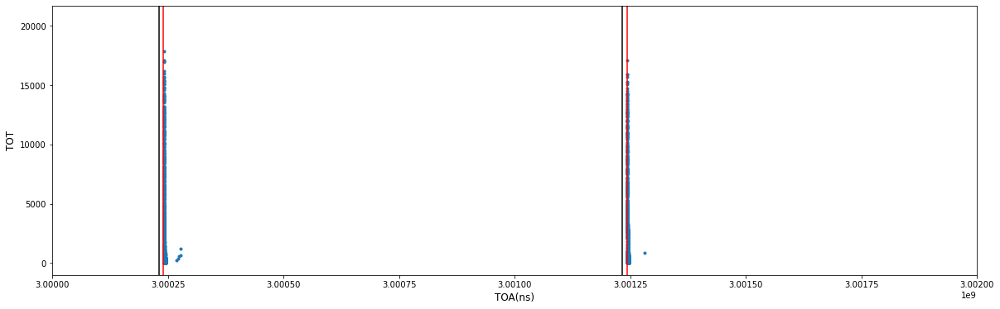

In [102]:
# r1 = t1[len(t1)//2:]/4096*25
# f1 = a1[len(a1)//2:]
plt.rcParams["figure.figsize"] = (20,6)
#len(t) = 8550085 
#
#plt.scatter(r,f)
plt.plot(grid1_df['#ToA']/4096.*25.,grid1_df['#ToT[arb]'], '.')
#plt.plot(r, f, 'xb-')
#plt.title("TOT", fontsize = 12) # change the title
plt.xlabel('TOA(ns)',fontsize = 12)
plt.ylabel('TOT',fontsize = 12)
for i in range(5000):
    plt.axvline(x=(TrigTime[i]/4096.*25.), ymin=0, ymax=2500, color='k')
    plt.axvline(x=((TrigTime[i]/4096.*25.)+10000), ymin=0, ymax=2500, color='r')
# plt.axvline(x=(TOA_MIN/4096.*25.), ymin=0, ymax=2500, color='k')
# plt.xlim(963691753.125-50, 963691753.125+250)
# plt.xlim(3.25875e9, 3.2592e9)
plt.xlim(3e9, 3.002e9)
# plt.savefig('TOTvsTOA_256x256_8212020_025447-1_cent.png', bbox_inches='tight')
time.ctime()

'Mon Feb  1 23:37:18 2021'

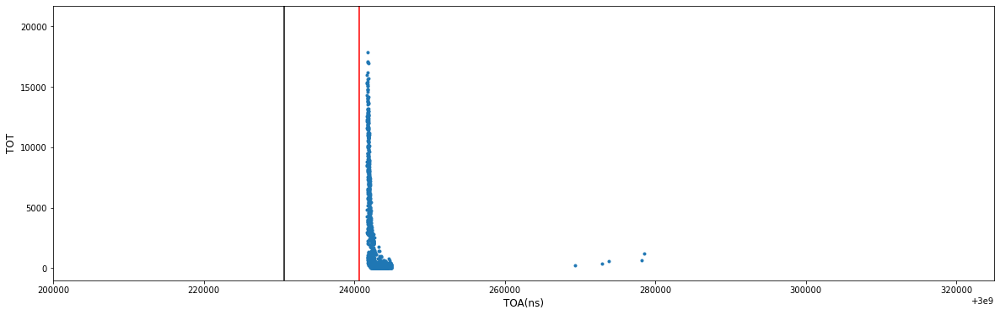

In [108]:
# r1 = t1[len(t1)//2:]/4096*25
# f1 = a1[len(a1)//2:]
plt.rcParams["figure.figsize"] = (20,6)
#len(t) = 8550085 
#
#plt.scatter(r,f)
plt.plot(grid1_df['#ToA']/4096.*25.,grid1_df['#ToT[arb]'], '.')
#plt.plot(r, f, 'xb-')
#plt.title("TOT", fontsize = 12) # change the title
plt.xlabel('TOA(ns)',fontsize = 12)
plt.ylabel('TOT',fontsize = 12)
for i in range(5000):
    plt.axvline(x=(TrigTime[i]/4096.*25.), ymin=0, ymax=2500, color='k')
    plt.axvline(x=((TrigTime[i]/4096.*25.)+10000), ymin=0, ymax=2500, color='r')
# plt.axvline(x=(TOA_MIN/4096.*25.), ymin=0, ymax=2500, color='k')
# plt.xlim(963691753.125-50, 963691753.125+250)
# plt.xlim(3.25875e9, 3.2592e9)
plt.xlim(3.0002e9, 3.000325e9)
# plt.savefig('TOTvsTOA_256x256_8212020_025447-1_cent.png', bbox_inches='tight')
time.ctime()

In [ ]:
# delay function that is known to work in all cases
def avg_delay(df):
    Delay_lst =[]
    nancount=0
    nonnancount=0
    for val in TrigTime:
        ToA_df = df[(df['#ToA'] > val) & (df['#ToA'] < (val+(100000*4096./25.)))]
        max_df = ToA_df[ToA_df['#ToT[arb]'] == (ToA_df['#ToT[arb]'].max())]
        Delay_lst.append((max_df['#ToA'].min()/4096.*25.)-(val/4096.*25))
        if math.isnan(Delay_lst[-1]):
            nancount+=1
        else:
            nonnancount+=1
    return np.nanmean(Delay_lst)*10**(-3), nancount, nonnancount

In [ ]:
print("Average delay (grid):", avg_delay(grid1_df)[0], 'us')

In [ ]:
print("Average delay (X):", avg_delay(X_df)[0], 'us')

In [ ]:
print("Average delay (Y):", avg_delay(Y_df)[0], 'us')

In [ ]:
trigToaDiffLst = [(grid1_df["#ToA"] - trig for trig in TrigTime).min()]

In [27]:
# does not work in all cases (list chomprehension too complicated) 
def avg_delay(df):
    Delay_lst = [((df[(df['#ToA'] > val) \
                          & (df['#ToA'] < (val+(100000*4096./25.))) \
                          & (df['#ToT[arb]'] == (df['#ToT[arb]'].max()))]['#ToA'].min()/4096.*25.)-(val/4096.*25)) \
                 for val in TrigTime]
    return np.nanmean(Delay_lst)*10**(-3)

In [25]:
print("Average delay (grid):", avg_delay(grid1_df), 'us')

6894 Average delay (grid): 11.0265625 us


In [28]:
print("Average delay (X):", avg_delay(X_df), 'us')

Average delay (X): 4.054103088378906 us


In [29]:
print("Average delay (Y):", avg_delay(Y_df), 'us')

Average delay (Y): 10.83125 us


In [26]:
Delay_lst = []
a=0
for val in TrigTime:
    a+=1
    print(a)
#     pulse_df = grid1_df[(grid1_df['#ToA'] > val) & (grid1_df['#ToA'] < (val+(100000*4096./25.)))]
#     pulse_max_df = pulse_df[pulse_df['#ToT[arb]'] == (pulse_df['#ToT[arb]'].max())]
#     toa_of_peak = pulse_picker(grid1_df, TrigTime[i], (TrigTime[i]+(100000*4096./25.)))
    
    Delay_lst.append((grid1_df[(grid1_df['#ToA'] > val) \
                      & (grid1_df['#ToA'] < (val+(100000*4096./25.))) \
                      & (grid1_df['#ToT[arb]'] == (grid1_df['#ToT[arb]'].max()))]['#ToA'].min()/4096.*25.)-(val/4096.*25))
time.ctime()

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277


1862
1863
1864
1865
1866
1867
1868
1869
1870
1871
1872
1873
1874
1875
1876
1877
1878
1879
1880
1881
1882
1883
1884
1885
1886
1887
1888
1889
1890
1891
1892
1893
1894
1895
1896
1897
1898
1899
1900
1901
1902
1903
1904
1905
1906
1907
1908
1909
1910
1911
1912
1913
1914
1915
1916
1917
1918
1919
1920
1921
1922
1923
1924
1925
1926
1927
1928
1929
1930
1931
1932
1933
1934
1935
1936
1937
1938
1939
1940
1941
1942
1943
1944
1945
1946
1947
1948
1949
1950
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
1961
1962
1963
1964
1965
1966
1967
1968
1969
1970
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060
2061


3503
3504
3505
3506
3507
3508
3509
3510
3511
3512
3513
3514
3515
3516
3517
3518
3519
3520
3521
3522
3523
3524
3525
3526
3527
3528
3529
3530
3531
3532
3533
3534
3535
3536
3537
3538
3539
3540
3541
3542
3543
3544
3545
3546
3547
3548
3549
3550
3551
3552
3553
3554
3555
3556
3557
3558
3559
3560
3561
3562
3563
3564
3565
3566
3567
3568
3569
3570
3571
3572
3573
3574
3575
3576
3577
3578
3579
3580
3581
3582
3583
3584
3585
3586
3587
3588
3589
3590
3591
3592
3593
3594
3595
3596
3597
3598
3599
3600
3601
3602
3603
3604
3605
3606
3607
3608
3609
3610
3611
3612
3613
3614
3615
3616
3617
3618
3619
3620
3621
3622
3623
3624
3625
3626
3627
3628
3629
3630
3631
3632
3633
3634
3635
3636
3637
3638
3639
3640
3641
3642
3643
3644
3645
3646
3647
3648
3649
3650
3651
3652
3653
3654
3655
3656
3657
3658
3659
3660
3661
3662
3663
3664
3665
3666
3667
3668
3669
3670
3671
3672
3673
3674
3675
3676
3677
3678
3679
3680
3681
3682
3683
3684
3685
3686
3687
3688
3689
3690
3691
3692
3693
3694
3695
3696
3697
3698
3699
3700
3701
3702


5144
5145
5146
5147
5148
5149
5150
5151
5152
5153
5154
5155
5156
5157
5158
5159
5160
5161
5162
5163
5164
5165
5166
5167
5168
5169
5170
5171
5172
5173
5174
5175
5176
5177
5178
5179
5180
5181
5182
5183
5184
5185
5186
5187
5188
5189
5190
5191
5192
5193
5194
5195
5196
5197
5198
5199
5200
5201
5202
5203
5204
5205
5206
5207
5208
5209
5210
5211
5212
5213
5214
5215
5216
5217
5218
5219
5220
5221
5222
5223
5224
5225
5226
5227
5228
5229
5230
5231
5232
5233
5234
5235
5236
5237
5238
5239
5240
5241
5242
5243
5244
5245
5246
5247
5248
5249
5250
5251
5252
5253
5254
5255
5256
5257
5258
5259
5260
5261
5262
5263
5264
5265
5266
5267
5268
5269
5270
5271
5272
5273
5274
5275
5276
5277
5278
5279
5280
5281
5282
5283
5284
5285
5286
5287
5288
5289
5290
5291
5292
5293
5294
5295
5296
5297
5298
5299
5300
5301
5302
5303
5304
5305
5306
5307
5308
5309
5310
5311
5312
5313
5314
5315
5316
5317
5318
5319
5320
5321
5322
5323
5324
5325
5326
5327
5328
5329
5330
5331
5332
5333
5334
5335
5336
5337
5338
5339
5340
5341
5342
5343


6783
6784
6785
6786
6787
6788
6789
6790
6791
6792
6793
6794
6795
6796
6797
6798
6799
6800
6801
6802
6803
6804
6805
6806
6807
6808
6809
6810
6811
6812
6813
6814
6815
6816
6817
6818
6819
6820
6821
6822
6823
6824
6825
6826
6827
6828
6829
6830
6831
6832
6833
6834
6835
6836
6837
6838
6839
6840
6841
6842
6843
6844
6845
6846
6847
6848
6849
6850
6851
6852
6853
6854
6855
6856
6857
6858
6859
6860
6861
6862
6863
6864
6865
6866
6867
6868
6869
6870
6871
6872
6873
6874
6875
6876
6877
6878
6879
6880
6881
6882
6883
6884
6885
6886
6887
6888
6889
6890
6891
6892
6893
6894


'Mon Feb 15 19:52:07 2021'

In [23]:
print("Average delay (grid):", np.nanmean(Delay_lst)*10**(-3), 'us')

Average delay (grid): 11.05642895291585 us


In [18]:
def pulse_picker(df, ToAmin, ToAmax):
    pulse_df = df.drop(df[(df['#ToA'] < ToAmin) | (df['#ToA'] > ToAmax)].index)
    print("Full Pulse df:")
    print("SHAPE:", pulse_df.shape, "\n", pulse_df.iloc[:2])
    
    # Create df consisting of only the max ToTs
    pulse_max_df = pulse_df[pulse_df['#ToT[arb]'] == (pulse_df['#ToT[arb]'].max())]
    print("Max Pulse df:")
    print("SHAPE:", pulse_max_df.shape, "\n", pulse_max_df.iloc[:2])
    
    return pulse_max_df['#ToA'].min()/4096.*25.

In [19]:
%%timeit
Delay_lst = [(pulse_picker(grid1_df, TrigTime[i], (TrigTime[i]+(100000*4096./25.))))-(TrigTime[i]/4096.*25) for i in range(len(TrigTime))]

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFr

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Full Pulse df:
SHAPE: (3218, 9) 
        #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13459      939  158058549888    96   200  158060344064       4350   
13469      939  158058549888    74   155  158060346368       9975   

       #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13459            4350         1794176         NaN  
13469           

Full Pulse df:
SHAPE: (1217, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
245787      951  160357407360    74   155  160359203072       9700   
245790      951  160357407360    97   200  160359204352      12875   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
245787            9700         1795712         NaN  
245790           12875         1796992         NaN  
Max Pulse df:
SHAPE: (1, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
246127      951  160357407360    83   155  160359237632      17050   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
246127           17050         1830272         NaN  
Full Pulse df:
SHAPE: (1299, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
261312      952  160521611477    74   185  160523408384       9750   
261317      952  160521611477    74   178  160523410944       6450   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
261312            975

Full Pulse df:
SHAPE: (1368, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
432241      963  162327857024    89   192  162329651200      12900   
432242      963  162327857024    66   192  162329651456      10700   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
432241           12900         1794176         NaN  
432242           10700         1794432         NaN  
Max Pulse df:
SHAPE: (1, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
432299      963  162327857024    75   155  162329664512      17450   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
432299           17450         1807488         NaN  
Full Pulse df:
SHAPE: (1080, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
447883      964  162492061056    66   163  162493855744       4850   
447887      964  162492061056    74   155  162493856512       9600   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
447883            485

Full Pulse df:
SHAPE: (1353, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
618587      975  164298305664    66   155  164300101120       6175   
618589      975  164298305664    66   163  164300101376       5250   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
618587            6175         1795456         NaN  
618589            5250         1795712         NaN  
Max Pulse df:
SHAPE: (1, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
618622      975  164298305664    67   192  164300109824      19325   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
618622           19325         1804160         NaN  
Full Pulse df:
SHAPE: (1416, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
634129      976  164462509781    58   192  164464311808       6700   
634130      976  164462509781    66   192  164464311808      10950   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
634129            670

Full Pulse df:
SHAPE: (1190, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
820780      988  166432959445    97   200  166434754048      13175   
820782      988  166432959445    97   207  166434756096      13950   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
820780           13175         1794603         NaN  
820782           13950         1796651         NaN  
Max Pulse df:
SHAPE: (1, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
820849      988  166432959445    67   192  166434771712      19175   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
820849           19175         1812267         NaN  
Full Pulse df:
SHAPE: (1227, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
836289      989  166597163477    75   155  166598962176      17375   
836295      989  166597163477    74   185  166598963200       9775   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
836289           1737

Full Pulse df:
SHAPE: (1186, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1022830     1001  168567612800    97   185  168569404416      13775   
1022834     1001  168567612800    97   193  168569406464      10825   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1022830           13775         1791616         NaN  
1022834           10825         1793664         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1022889     1001  168567612800    67   192  168569417216      19375   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1022889           19375         1804416         NaN  
Full Pulse df:
SHAPE: (1381, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1038217     1002  168731816832    67   156  168733612800      10825   
1038223     1002  168731816832    74   155  168733614080       9525   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1038217

Full Pulse df:
SHAPE: (1268, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1209127     1013  170538061440    66   192  170539854592      10975   
1209139     1013  170538061440    67   156  170539859712      10750   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1209127           10975         1793152         NaN  
1209139           10750         1798272         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1209157     1013  170538061440    67   192  170539863552      19225   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1209157           19225         1802112         NaN  
Full Pulse df:
SHAPE: (1301, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1224702     1014  170702265557    74   192  170704058880      15050   
1224711     1014  170702265557    58   192  170704062464       7050   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1224702

Full Pulse df:
SHAPE: (1375, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1395686     1025  172508511189    66   192  172510311936      10875   
1395687     1025  172508511189    51   192  172510312448      10775   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1395686           10875         1800747         NaN  
1395687           10775         1801259         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1395726     1025  172508511189    67   192  172510319360      19250   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1395726           19250         1808171         NaN  
Full Pulse df:
SHAPE: (1528, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1411085     1026  172672715221    97   200  172674517504      13675   
1411094     1026  172672715221    98   185  172674520320      17075   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1411085

Full Pulse df:
SHAPE: (1213, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1582167     1037  174478959744    89   200  174480757504      10675   
1582177     1037  174478959744    89   192  174480759296      13925   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1582167           10675         1797760         NaN  
1582177           13925         1799552         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1582315     1037  174478959744    67   184  174480776448      18600   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1582315           18600         1816704         NaN  
Full Pulse df:
SHAPE: (1423, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1597649     1038  174643164416    97   193  174644961792      12450   
1597650     1038  174643164416    90   185  174644962304      16225   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1597649

Full Pulse df:
SHAPE: (1245, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1768528     1049  176449494997    66   155  176451290624       6250   
1768534     1049  176449494997    66   170  176451293696       6125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1768528            6250         1795627         NaN  
1768534            6125         1798699         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1768630     1049  176449494997    67   184  176451308544      17800   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1768630           17800         1813547         NaN  
Full Pulse df:
SHAPE: (1272, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1784089     1050  176613698560    66   185  176615492608       8925   
1784091     1050  176613698560    66   155  176615493376       6250   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1784089

Full Pulse df:
SHAPE: (1288, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1955027     1061  178419944320    97   192  178421743872      16025   
1955028     1061  178419944320    97   193  178421743872      11725   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1955027           16025         1799552         NaN  
1955028           11725         1799552         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1955097     1061  178419944320    67   192  178421757440      19375   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1955097           19375         1813120         NaN  
Full Pulse df:
SHAPE: (1346, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1970605     1062  178584148352    67   155  178585945856      15925   
1970606     1062  178584148352    96   200  178585945856       4300   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1970605

Full Pulse df:
SHAPE: (1369, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2141462     1073  180390392576    97   200  180392191744      13375   
2141463     1073  180390392576    97   185  180392191744      14075   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2141462           13375         1799168         NaN  
2141463           14075         1799168         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2141543     1073  180390392576    67   184  180392204800      17475   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2141543           17475         1812224         NaN  
Full Pulse df:
SHAPE: (1203, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2157129     1074  180554596736    97   193  180556396544      11800   
2157130     1074  180554596736    97   185  180556397056      14250   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2157129

Full Pulse df:
SHAPE: (1113, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2328046     1085  182360841685    74   155  182362632704       9500   
2328056     1085  182360841685    74   185  182362635008       9900   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2328046            9500         1791019         NaN  
2328056            9900         1793323         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2328152     1085  182360841685    59   199  182362651648      17225   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2328152           17225         1809963         NaN  
Full Pulse df:
SHAPE: (1328, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2343558     1086  182525046656    66   185  182526842112       8450   
2343570     1086  182525046656    66   155  182526843648       5950   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2343558

Full Pulse df:
SHAPE: (1334, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2514438     1097  184331291221    67   155  184333088256      16025   
2514447     1097  184331291221    82   156  184333090816       7900   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2514438           16025         1797035         NaN  
2514447            7900         1799595         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2514453     1097  184331291221    67   192  184333091840      19250   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2514453           19250         1800619         NaN  
Full Pulse df:
SHAPE: (1272, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2529995     1098  184495495381    66   185  184497289216       8500   
2529999     1098  184495495381    66   170  184497291264       6050   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2529995

Full Pulse df:
SHAPE: (1037, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2716527     1109  186465943680    58   192  186467747584       6975   
2716528     1109  186465943680    97   200  186467747584      13525   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2716527            6975         1803904         NaN  
2716528           13525         1803904         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2716570     1109  186465943680    68   155  186467756288      17225   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2716570           17225         1812608         NaN  
Full Pulse df:
SHAPE: (1376, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2732003     1110  186630147797    96   207  186631942656       6275   
2732009     1110  186630147797    97   207  186631943936      13975   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2732003

Full Pulse df:
SHAPE: (1406, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2902888     1121  188436393429    74   155  188438188800       9900   
2902897     1121  188436393429    97   185  188438191104      14175   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2902888            9900         1795371         NaN  
2902897           14175         1797675         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2902968     1121  188436393429    59   192  188438202112      16425   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2902968           16425         1808683         NaN  
Full Pulse df:
SHAPE: (1354, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2918398     1122  188600597077    98   185  188602397184      16825   
2918401     1122  188600597077    74   192  188602397696      14675   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2918398

Full Pulse df:
SHAPE: (1370, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3089364     1133  190406843008    66   192  190408638464      10475   
3089372     1133  190406843008    97   207  190408639488      13625   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3089364           10475         1795456         NaN  
3089372           13625         1796480         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3089486     1133  190406843008    83   192  190408650752      17800   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3089486           17800         1807744         NaN  
Full Pulse df:
SHAPE: (1277, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3105031     1134  190571046101    67   185  190572843776      14500   
3105035     1134  190571046101    75   155  190572844288      17275   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3105031

Full Pulse df:
SHAPE: (1131, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3276034     1145  192377349077    89   192  192379141888      13050   
3276047     1145  192377349077    97   193  192379144704      11650   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3276034           13050         1792811         NaN  
3276047           11650         1795627         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3276226     1145  192377349077    83   192  192379166208      17850   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3276226           17850         1817131         NaN  
Full Pulse df:
SHAPE: (1419, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3291423     1146  192541552640    67   155  192543346432      15900   
3291437     1146  192541552640    74   155  192543350528       9850   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3291423

Full Pulse df:
SHAPE: (1376, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3462322     1157  194347797717    66   199  194349595648      12800   
3462324     1157  194347797717    59   155  194349595904      13075   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3462322           12800         1797931         NaN  
3462324           13075         1798187         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3462349     1157  194347797717    59   199  194349603584      18275   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3462349           18275         1805867         NaN  
Full Pulse df:
SHAPE: (1450, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3477829     1158  194512002304    75   170  194513800704      15975   
3477832     1158  194512002304    98   185  194513801216      17075   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3477829

Full Pulse df:
SHAPE: (1186, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3648957     1169  196318246912    51   192  196320051456      10275   
3648960     1169  196318246912    82   192  196320052480      14200   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3648957           10275         1804544         NaN  
3648960           14200         1805568         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3649092     1169  196318246912    83   192  196320068096      17975   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3649092           17975         1821184         NaN  
Full Pulse df:
SHAPE: (1207, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3664510     1170  196482451072    97   185  196484253440      14100   
3664517     1170  196482451072    74   155  196484255232       9575   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3664510

Full Pulse df:
SHAPE: (1202, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3835255     1181  198288696704    89   192  198290488576      12550   
3835263     1181  198288696704    66   192  198290490624      11225   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3835255           12550         1791872         NaN  
3835263           11225         1793920         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3835412     1181  198288696704    83   192  198290513152      17975   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3835412           17975         1816448         NaN  
Full Pulse df:
SHAPE: (1215, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3850969     1182  198452900736    97   193  198454694400      11800   
3850979     1182  198452900736    90   185  198454696704      14950   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3850969

Full Pulse df:
SHAPE: (1399, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4021596     1193  200259145216    98   185  200260941568      16975   
4021598     1193  200259145216    97   193  200260941824      11875   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4021596           16975         1796352         NaN  
4021598           11875         1796608         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4021616     1193  200259145216    67   192  200260947200      19475   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4021616           19475         1801984         NaN  
Full Pulse df:
SHAPE: (1241, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4037230     1194  200423349290    98   185  200425140992      17000   
4037242     1194  200423349290    97   185  200425145344      14100   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4037230

Full Pulse df:
SHAPE: (1432, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4208144     1205  202229595008    98   185  202231395328      16875   
4208146     1205  202229595008    74   200  202231395840      10500   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4208144           16875         1800320         NaN  
4208146           10500         1800832         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4208254     1205  202229595008    59   199  202231408128      17625   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4208254           17625         1813120         NaN  
Full Pulse df:
SHAPE: (1270, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4223689     1206  202393799125    74   163  202395590656       7050   
4223701     1206  202393799125    74   199  202395596544      15425   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4223689

Full Pulse df:
SHAPE: (1411, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4394654     1217  204200043605    66   192  204201840128      11050   
4394661     1217  204200043605    82   192  204201842688      14375   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4394654           11050         1796523         NaN  
4394661           14375         1799083         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4394675     1217  204200043605    83   155  204201846272      17350   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4394675           17350         1802667         NaN  
Full Pulse df:
SHAPE: (1478, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4410091     1218  204364247765    66   185  204366039552       8475   
4410094     1218  204364247765    66   155  204366041088       6025   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4410091

Full Pulse df:
SHAPE: (1387, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4581039     1229  206170493397    66   185  206172289536       8550   
4581041     1229  206170493397    66   192  206172292096      10625   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4581039            8550         1796139         NaN  
4581041           10625         1798699         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4581128     1229  206170493397    75   155  206172306176      17100   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4581128           17100         1812779         NaN  
Full Pulse df:
SHAPE: (1412, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4596681     1230  206334697429    98   185  206336498688      16975   
4596685     1230  206334697429    97   185  206336499712      14450   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4596681

Full Pulse df:
SHAPE: (1375, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4767559     1241  208140942037    98   156  208142743296      15700   
4767560     1241  208140942037    97   163  208142743296       9450   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4767559           15700         1801259         NaN  
4767560            9450         1801259         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4767654     1241  208140942037    59   199  208142756352      17675   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4767654           17675         1814315         NaN  
Full Pulse df:
SHAPE: (1231, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4783136     1242  208305146624    97   185  208306945792      14350   
4783142     1242  208305146624    97   192  208306947840      15575   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4783136

Full Pulse df:
SHAPE: (1106, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4954023     1253  210111391701    74   192  210113187584      14750   
4954027     1253  210111391701    89   185  210113189120       8725   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4954023           14750         1795883         NaN  
4954027            8725         1797419         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4954042     1253  210111391701    75   155  210113192960      17250   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4954042           17250         1801259         NaN  
Full Pulse df:
SHAPE: (1330, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4969507     1254  210275595733    89   192  210277391872      12975   
4969516     1254  210275595733    74   155  210277393408       9525   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4969507

Full Pulse df:
SHAPE: (1310, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5140532     1265  212081840896    89   200  212083636224       9675   
5140533     1265  212081840896    67   155  212083636224      15675   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5140532            9675         1795328         NaN  
5140533           15675         1795328         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5140557     1265  212081840896    67   192  212083642368      18950   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5140557           18950         1801472         NaN  
Full Pulse df:
SHAPE: (1237, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5156066     1266  212246045056    67   155  212247833088      15800   
5156073     1266  212246045056    66   185  212247834624       8200   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5156066

Full Pulse df:
SHAPE: (1480, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5326827     1277  214052289664    58   192  214054090240       6750   
5326828     1277  214052289664    66   185  214054090240       8575   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5326827            6750         1800576         NaN  
5326828            8575         1800576         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5326867     1277  214052289664    67   192  214054099712      19125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5326867           19125         1810048         NaN  
Full Pulse df:
SHAPE: (1187, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5342633     1278  214216493781    67   155  214218291968      15825   
5342637     1278  214216493781    74   192  214218293504      15175   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5342633

Full Pulse df:
SHAPE: (1108, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5513587     1289  216022739413    97   207  216024540928      13825   
5513590     1289  216022739413    97   156  216024542208       7425   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5513587           13825         1801515         NaN  
5513590            7425         1802795         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5513637     1289  216022739413    83   155  216024549120      17175   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5513637           17175         1809707         NaN  
Full Pulse df:
SHAPE: (1299, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5529025     1290  216186943274    97   193  216188743936      11200   
5529028     1290  216186943274    97   185  216188744448      13700   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5529025

Full Pulse df:
SHAPE: (1529, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5699874     1301  217993187968    89   192  217994983936      12275   
5699875     1301  217993187968    89   200  217994984192       9450   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5699874           12275         1795968         NaN  
5699875            9450         1796224         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5700025     1301  217993187968    67   192  217995005440      19300   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5700025           19300         1817472         NaN  
Full Pulse df:
SHAPE: (1526, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5715309     1302  218157392000    97   200  218159186688      13300   
5715310     1302  218157392000    90   192  218159186688      15500   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5715309

Full Pulse df:
SHAPE: (1454, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5886214     1313  219963637546    97   200  219965436416      13200   
5886215     1313  219963637546    97   185  219965436672      13875   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5886214           13200         1798870         NaN  
5886215           13875         1799126         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5886558     1313  219963637546    83   192  219965466624      17800   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5886558           17800         1829078         NaN  
Full Pulse df:
SHAPE: (1369, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5901898     1314  220127841749    66   192  220129633024      11100   
5901906     1314  220127841749    98   185  220129637376      16900   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5901898

Full Pulse df:
SHAPE: (1404, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6072712     1325  221934086272    75   163  221935879680      14025   
6072714     1325  221934086272    74   185  221935879936       9900   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6072712           14025         1793408         NaN  
6072714            9900         1793664         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6072724     1325  221934086272    67   192  221935882752      19575   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6072724           19575         1796480         NaN  
Full Pulse df:
SHAPE: (1323, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6088209     1326  222098290304    74   192  222100083712      15675   
6088215     1326  222098290304    74   155  222100088320       9575   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6088209

Full Pulse df:
SHAPE: (1261, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6259174     1337  223904536021    66   192  223906333440      11200   
6259179     1337  223904536021    98   185  223906333952      17100   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6259174           11200         1797419         NaN  
6259179           17100         1797931         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6259233     1337  223904536021    67   192  223906344192      19500   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6259233           19500         1808171         NaN  
Full Pulse df:
SHAPE: (1452, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6274631     1338  224068739584    66   155  224070533376       6250   
6274633     1338  224068739584    66   185  224070533888       8875   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6274631

Full Pulse df:
SHAPE: (1445, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6445586     1349  225874985216    97   192  225876786688      15400   
6445588     1349  225874985216    90   185  225876787200      15125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6445586           15400         1801472         NaN  
6445588           15125         1801984         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6445698     1349  225874985216    67   192  225876800000      19250   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6445698           19250         1814784         NaN  
Full Pulse df:
SHAPE: (1422, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6461258     1350  226039189248    98   185  226040989952      17300   
6461261     1350  226039189248    97   192  226040990464      15325   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6461258

Full Pulse df:
SHAPE: (1431, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6632062     1361  227845434325    98   156  227847229952      15775   
6632064     1361  227845434325    97   192  227847230208      15450   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6632062           15775         1795627         NaN  
6632064           15450         1795883         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6632555     1361  227845434325    83   192  227847268864      17725   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6632555           17725         1834539         NaN  
Full Pulse df:
SHAPE: (1408, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6647657     1362  228009637888    89   192  228011436544      12950   
6647660     1362  228009637888    67   192  228011437056      18850   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6647657

Full Pulse df:
SHAPE: (1439, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6818629     1373  229815882965    74   155  229817679872       9800   
6818631     1373  229815882965    74   192  229817680384      14875   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6818629            9800         1796907         NaN  
6818631           14875         1797419         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6818720     1373  229815882965    67   192  229817696512      18625   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6818720           18625         1813547         NaN  
Full Pulse df:
SHAPE: (1172, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6834305     1374  229980087552    74   192  229981886464      14900   
6834307     1374  229980087552    89   185  229981886976       9050   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6834305

Full Pulse df:
SHAPE: (1361, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7005029     1385  231786332160    66   192  231788126208      10800   
7005037     1385  231786332160    66   185  231788128768       8125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7005029           10800         1794048         NaN  
7005037            8125         1796608         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7005062     1385  231786332160    67   192  231788134656      18975   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7005062           18975         1802496         NaN  
Full Pulse df:
SHAPE: (1357, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7020556     1386  231950536277    66   185  231952329728       8275   
7020562     1386  231950536277    67   155  231952331776      15925   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7020556

Full Pulse df:
SHAPE: (1225, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7191643     1397  233756781952    58   192  233758579456       6550   
7191647     1397  233756781952    59   155  233758581504      12925   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7191643            6550         1797504         NaN  
7191647           12925         1799552         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7191784     1397  233756781952    68   155  233758600448      16825   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7191784           16825         1818496         NaN  
Full Pulse df:
SHAPE: (1348, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7207084     1398  233920985984    66   185  233922779904       8325   
7207100     1398  233920985984    67   155  233922784512      15750   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7207084

Full Pulse df:
SHAPE: (1256, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7378224     1409  235727230592    97   192  235729032960      15275   
7378230     1409  235727230592    97   185  235729034240      13900   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7378224           15275         1802368         NaN  
7378230           13900         1803648         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7378294     1409  235727230592    67   192  235729045760      19275   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7378294           19275         1815168         NaN  
Full Pulse df:
SHAPE: (1111, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7393725     1410  235891434709    97   185  235893231104      13750   
7393729     1410  235891434709    74   155  235893233408       9925   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7393725

Full Pulse df:
SHAPE: (1321, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7564445     1421  237697680341    97   200  237699475712      13400   
7564450     1421  237697680341    97   185  237699477248      14075   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7564445           13400         1795371         NaN  
7564450           14075         1796907         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7564498     1421  237697680341    67   192  237699487232      19625   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7564498           19625         1806891         NaN  
Full Pulse df:
SHAPE: (1389, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7579912     1422  237861884373    97   185  237863679232      13925   
7579914     1422  237861884373    74   155  237863679488       9850   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7579912

Full Pulse df:
SHAPE: (1332, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7750961     1433  239668128981    66   199  239669921792      12675   
7750966     1433  239668128981    66   185  239669922560       8475   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7750961           12675         1792811         NaN  
7750966            8475         1793579         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7750981     1433  239668128981    68   155  239669928192      17300   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7750981           17300         1799211         NaN  
Full Pulse df:
SHAPE: (1465, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7766321     1434  239832333568    66   192  239834124800      10725   
7766324     1434  239832333568    66   185  239834125568       8300   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7766321

Full Pulse df:
SHAPE: (1572, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7937374     1445  241638578304    74   185  241640369920       9625   
7937377     1445  241638578304    74   199  241640371968      15900   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7937374            9625         1791616         NaN  
7937377           15900         1793664         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7937451     1445  241638578304    59   199  241640388864      18225   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7937451           18225         1810560         NaN  
Full Pulse df:
SHAPE: (1383, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7953112     1446  241802782208    66   185  241804585984       8250   
7953114     1446  241802782208    59   155  241804586240      12725   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7953112

Full Pulse df:
SHAPE: (1489, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8123916     1457  243609027840    66   163  243610829568       5250   
8123919     1457  243609027840    66   185  243610830336       9025   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8123916            5250         1801728         NaN  
8123919            9025         1802496         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8124015     1457  243609027840    83   192  243610842368      18075   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8124015           18075         1814528         NaN  
Full Pulse df:
SHAPE: (1299, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8139529     1458  243773232000    97   192  243775033088      15975   
8139531     1458  243773232000    66   185  243775033856       9025   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8139529

Full Pulse df:
SHAPE: (1385, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8310472     1469  245579476480    97   185  245581265408      14725   
8310486     1469  245579476480    97   200  245581269248      13700   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8310472           14725         1788928         NaN  
8310486           13700         1792768         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8310568     1469  245579476480    59   199  245581284352      18000   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8310568           18000         1807872         NaN  
Full Pulse df:
SHAPE: (1406, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8325915     1470  245743680512    98   156  245745476864      15750   
8325919     1470  245743680512    97   192  245745477888      15975   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8325915

Full Pulse df:
SHAPE: (1505, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8496837     1481  247549926144    67   155  247551723264      15775   
8496839     1481  247549926144    98   156  247551724544      15750   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8496837           15775         1797120         NaN  
8496839           15750         1798400         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8496858     1481  247549926144    67   192  247551728896      19475   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8496858           19475         1802752         NaN  
Full Pulse df:
SHAPE: (1228, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8512478     1482  247714130389    98   185  247715925248      17275   
8512481     1482  247714130389    74   155  247715925760       9575   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8512478

Full Pulse df:
SHAPE: (1406, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8683340     1493  249520461056    97   192  249522255872      15800   
8683345     1493  249520461056    97   193  249522258176      11825   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8683340           15800         1794816         NaN  
8683345           11825         1797120         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8683369     1493  249520461056    67   192  249522266368      19350   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8683369           19350         1805312         NaN  
Full Pulse df:
SHAPE: (1479, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8698809     1494  249684665088    98   185  249686462208      16925   
8698810     1494  249684665088    97   200  249686462464      13375   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8698809

Full Pulse df:
SHAPE: (1440, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8869760     1505  251490910080    74   185  251492702464      10025   
8869771     1505  251490910080    74   192  251492706304      15025   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8869760           10025         1792384         NaN  
8869771           15025         1796224         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8869830     1505  251490910080    67   192  251492718080      19225   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8869830           19225         1808000         NaN  
Full Pulse df:
SHAPE: (1271, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8885346     1506  251655114197    98   156  251656914944      15700   
8885350     1506  251655114197    97   193  251656916480      11800   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8885346

Full Pulse df:
SHAPE: (1413, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9056133     1517  253461358805    74   163  253463151360       6900   
9056139     1517  253461358805    74   155  253463152640       9525   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9056133            6900         1792555         NaN  
9056139            9525         1793835         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9056253     1517  253461358805    83   192  253463168000      17550   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9056253           17550         1809195         NaN  
Full Pulse df:
SHAPE: (1278, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9071874     1518  253625562496    66   192  253627361024      10875   
9071876     1518  253625562496    66   185  253627361536       8625   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9071874

Full Pulse df:
SHAPE: (1255, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9242695     1529  255431808469    66   192  255433605120      10550   
9242697     1529  255431808469    66   163  255433605632       4950   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9242695           10550         1796651         NaN  
9242697            4950         1797163         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9242719     1529  255431808469    67   192  255433614336      18800   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9242719           18800         1805867         NaN  
Full Pulse df:
SHAPE: (1101, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9258361     1530  255596011221    59   155  255597809152      12750   
9258363     1530  255596011221    66   185  255597810432       8175   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9258361

Full Pulse df:
SHAPE: (1435, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9429129     1541  257402257664    97   185  257404054272      14100   
9429132     1541  257402257664    97   193  257404055552      11475   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9429129           14100         1796608         NaN  
9429132           11475         1797888         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9429161     1541  257402257664    67   192  257404059392      18700   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9429161           18700         1801728         NaN  
Full Pulse df:
SHAPE: (1305, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9444847     1542  257566461696    97   200  257568258560      13625   
9444858     1542  257566461696    97   193  257568262912      11450   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9444847

Full Pulse df:
SHAPE: (1141, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9615727     1553  259372706773    98   185  259374505216      16975   
9615728     1553  259372706773    97   185  259374505472      14400   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9615727           16975         1798443         NaN  
9615728           14400         1798699         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9615897     1553  259372706773    67   192  259374527232      18825   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9615897           18825         1820459         NaN  
Full Pulse df:
SHAPE: (1211, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9631121     1554  259536910336    97   193  259538709248      11575   
9631122     1554  259536910336    89   185  259538709760       8975   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9631121

Full Pulse df:
SHAPE: (1450, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9802041     1565  261343155968    98   185  261344950528      17200   
9802045     1565  261343155968    67   155  261344952064      15700   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9802041           17200         1794560         NaN  
9802045           15700         1796096         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9802070     1565  261343155968    67   192  261344956928      19075   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9802070           19075         1800960         NaN  
Full Pulse df:
SHAPE: (1256, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9817664     1566  261507360085    66   192  261509147136      10800   
9817674     1566  261507360085    67   155  261509149952      15875   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9817664

Full Pulse df:
SHAPE: (1357, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9988582     1577  263313604650    74   185  263315404288      10075   
9988587     1577  263313604650    98   185  263315405568      17175   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9988582           10075         1799638         NaN  
9988587           17175         1800918         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9988609     1577  263313604650    59   199  263315409920      18175   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9988609           18175         1805270         NaN  
Full Pulse df:
SHAPE: (1512, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10004017     1578  263477808768    74   192  263479603968      14675   
10004022     1578  263477808768    74   185  263479604224       9975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
100

Full Pulse df:
SHAPE: (1532, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10174851     1589  265284054272    97   163  265285856000       9350   
10174853     1589  265284054272    81   192  265285857024       8075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10174851            9350         1801728         NaN  
10174853            8075         1802752         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10175058     1589  265284054272    68   155  265285879296      17200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10175058           17200         1825024         NaN  
Full Pulse df:
SHAPE: (1533, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10190552     1590  265448258517    89   192  265450061568      14150   
10190557     1590  265448258517    81   192  265450062848       8050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unname

Full Pulse df:
SHAPE: (1508, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10361443     1601  267254559445    98   156  267256364288      15550   
10361454     1601  267254559445    66   192  267256366592      11500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10361443           15550         1804843         NaN  
10361454           11500         1807147         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10361565     1601  267254559445    83   192  267256377856      17975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10361565           17975         1818411         NaN  
Full Pulse df:
SHAPE: (1449, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10376988     1602  267418764032    66   185  267420561664       9025   
10376991     1602  267418764032    66   155  267420562432       6400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unname

Full Pulse df:
SHAPE: (1197, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10548128     1613  269225008640    90   192  269226803968      15350   
10548129     1613  269225008640    89   200  269226804224       9275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10548128           15350         1795328         NaN  
10548129            9275         1795584         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10548205     1613  269225008640    75   155  269226821632      17400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10548205           17400         1812992         NaN  
Full Pulse df:
SHAPE: (1536, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10563483     1614  269389212672    97   192  269391006720      15875   
10563500     1614  269389212672    90   185  269391011840      15225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unname

Full Pulse df:
SHAPE: (1486, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10734464     1625  271195458304    98   185  271197251840      16950   
10734474     1625  271195458304    97   200  271197254656      13650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10734464           16950         1793536         NaN  
10734474           13650         1796352         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10734856     1625  271195458304    83   192  271197294336      17600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10734856           17600         1836032         NaN  
Full Pulse df:
SHAPE: (1316, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10750173     1626  271359662464    66   185  271361460480       8325   
10750174     1626  271359662464    66   192  271361460992      11000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unname

Full Pulse df:
SHAPE: (1570, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10920867     1637  273165906944    74   185  273167703552       9850   
10920869     1637  273165906944    75   155  273167704576      17700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10920867            9850         1796608         NaN  
10920869           17700         1797632         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10920894     1637  273165906944    67   192  273167708928      19075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10920894           19075         1801984         NaN  
Full Pulse df:
SHAPE: (1198, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10936560     1638  273330111104    74   155  273331907072       9975   
10936565     1638  273330111104    74   185  273331909632       9675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unname

KeyboardInterrupt: 

In [56]:
Delay_lst = []
nancount=0
nonnancount=0
for i in range(len(TrigTime)):
    print("Trig#:", i)
    toa_of_peak = pulse_picker(grid1_df, TrigTime[i], (TrigTime[i]+(100000*4096./25.)))
    print("toa_of_peak:", toa_of_peak, "TrigTime[i]/4096.*25:",(TrigTime[i]/4096.*25))
    Delay_lst.append(toa_of_peak-(TrigTime[i]/4096.*25))
    
    if math.isnan(Delay_lst[-1]):
        print ("NAN SUM DETECTED at Trig#", i, "\n")
        nancount+=1
    else:
        print("Valid delay calculation:", Delay_lst[-1], "\n")
        nonnancount+=1
time.ctime()

Trig#: 0
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 573250.0
NAN SUM DETECTED at Trig# 0 

Trig#: 1
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 1575471.875
NAN SUM DETECTED at Trig# 1 

Trig#: 2
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SH

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 20617695.050048828
NAN SUM DETECTED at Trig# 20 

Trig#: 21
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 21619920.3125
NAN SUM DETECTED at Trig# 21 

Trig#: 22
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 40662140.625
NAN SUM DETECTED at Trig# 40 

Trig#: 41
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 41664362.5
NAN SUM DETECTED at Trig# 41 

Trig#: 42
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAP

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 60706589.84375
NAN SUM DETECTED at Trig# 60 

Trig#: 61
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 61708812.23754883
NAN SUM DETECTED at Trig# 61 

Trig#: 62
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 80751031.50634766
NAN SUM DETECTED at Trig# 80 

Trig#: 81
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 81753254.42504883
NAN SUM DETECTED at Trig# 81 

Trig#: 82
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pu

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 100795480.46875
NAN SUM DETECTED at Trig# 100 

Trig#: 101
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 101797702.86254883
NAN SUM DETECTED at Trig# 101 

Trig#: 102
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 120839923.17504883
NAN SUM DETECTED at Trig# 120 

Trig#: 121
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 121842148.4375
NAN SUM DETECTED at Trig# 121 

Trig#: 122
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 140884371.09375
NAN SUM DETECTED at Trig# 140 

Trig#: 141
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 141886590.625
NAN SUM DETECTED at Trig# 141 

Trig#: 142
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Puls

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 160928813.80004883
NAN SUM DETECTED at Trig# 160 

Trig#: 161
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 161931039.31884766
NAN SUM DETECTED at Trig# 161 

Trig#: 162
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 180973782.03125
NAN SUM DETECTED at Trig# 180 

Trig#: 181
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 181976003.90625
NAN SUM DETECTED at Trig# 181 

Trig#: 182
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pu

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 201018230.46875
NAN SUM DETECTED at Trig# 200 

Trig#: 201
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 202020443.75
NAN SUM DETECTED at Trig# 201 

Trig#: 202
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 221062673.17504883
NAN SUM DETECTED at Trig# 220 

Trig#: 221
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 222064895.05004883
NAN SUM DETECTED at Trig# 221 

Trig#: 222
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 241107121.61254883
NAN SUM DETECTED at Trig# 240 

Trig#: 241
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 242109343.48754883
NAN SUM DETECTED at Trig# 241 

Trig#: 242
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 261151567.1875
NAN SUM DETECTED at Trig# 260 

Trig#: 261
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 262153789.0625
NAN SUM DETECTED at Trig# 261 

Trig#: 262
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Puls

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 281196374.21875
NAN SUM DETECTED at Trig# 280 

Trig#: 281
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 282198596.6125488
NAN SUM DETECTED at Trig# 281 

Trig#: 282
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 301240815.625
NAN SUM DETECTED at Trig# 300 

Trig#: 301
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 302243038.8000488
NAN SUM DETECTED at Trig# 301 

Trig#: 302
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pu

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 321285264.5812988
NAN SUM DETECTED at Trig# 320 

Trig#: 321
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 322287487.2375488
NAN SUM DETECTED at Trig# 321 

Trig#: 322
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 341329707.03125
NAN SUM DETECTED at Trig# 340 

Trig#: 341
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 342331932.8125
NAN SUM DETECTED at Trig# 341 

Trig#: 342
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pul

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 361374155.9875488
NAN SUM DETECTED at Trig# 360 

Trig#: 361
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 362376375.78125
NAN SUM DETECTED at Trig# 361 

Trig#: 362
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 381418598.1750488
NAN SUM DETECTED at Trig# 380 

Trig#: 381
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 382420823.4375
NAN SUM DETECTED at Trig# 381 

Trig#: 382
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max P

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 401463044.2687988
NAN SUM DETECTED at Trig# 400 

Trig#: 401
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 402465266.40625
NAN SUM DETECTED at Trig# 401 

Trig#: 402
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 421507488.8000488
NAN SUM DETECTED at Trig# 420 

Trig#: 421
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 422509714.84375
NAN SUM DETECTED at Trig# 421 

Trig#: 422
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 441551935.15625
NAN SUM DETECTED at Trig# 440 

Trig#: 441
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 442554157.5500488
NAN SUM DETECTED at Trig# 441 

Trig#: 442
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 461596383.3312988
NAN SUM DETECTED at Trig# 460 

Trig#: 461
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 462598605.46875
NAN SUM DETECTED at Trig# 461 

Trig#: 462
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 481640825.78125
NAN SUM DETECTED at Trig# 480 

Trig#: 481
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 482643051.5625
NAN SUM DETECTED at Trig# 481 

Trig#: 482
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pul

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 501685274.7375488
NAN SUM DETECTED at Trig# 500 

Trig#: 501
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 502687493.75
NAN SUM DETECTED at Trig# 501 

Trig#: 502
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pul

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 521729716.9250488
NAN SUM DETECTED at Trig# 520 

Trig#: 521
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 522731942.1875
NAN SUM DETECTED at Trig# 521 

Trig#: 522
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max P

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 541774165.3625488
NAN SUM DETECTED at Trig# 540 

Trig#: 541
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 542776384.6313477
NAN SUM DETECTED at Trig# 541 

Trig#: 542
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 561818607.5500488
NAN SUM DETECTED at Trig# 560 

Trig#: 561
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 562820833.59375
NAN SUM DETECTED at Trig# 561 

Trig#: 562
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 581863053.90625
NAN SUM DETECTED at Trig# 580 

Trig#: 581
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 582865275.78125
NAN SUM DETECTED at Trig# 581 

Trig#: 582
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pu

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 601907502.34375
NAN SUM DETECTED at Trig# 600 

Trig#: 601
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 602909724.7375488
NAN SUM DETECTED at Trig# 601 

Trig#: 602
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 621952464.0625
NAN SUM DETECTED at Trig# 620 

Trig#: 621
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 622954686.1938477
NAN SUM DETECTED at Trig# 621 

Trig#: 622
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max P

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 641996906.25
NAN SUM DETECTED at Trig# 640 

Trig#: 641
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 642999134.375
NAN SUM DETECTED at Trig# 641 

Trig#: 642
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse d

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 662041355.2062988
NAN SUM DETECTED at Trig# 660 

Trig#: 661
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 663043583.59375
NAN SUM DETECTED at Trig# 661 

Trig#: 662
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 682085798.1750488
NAN SUM DETECTED at Trig# 680 

Trig#: 681
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 683088025.78125
NAN SUM DETECTED at Trig# 681 

Trig#: 682
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 702130248.1750488
NAN SUM DETECTED at Trig# 700 

Trig#: 701
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 703132474.7375488
NAN SUM DETECTED at Trig# 701 

Trig#: 702
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 722175042.1875
NAN SUM DETECTED at Trig# 720 

Trig#: 721
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 723177264.0625
NAN SUM DETECTED at Trig# 721 

Trig#: 722
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Puls

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 742219487.2375488
NAN SUM DETECTED at Trig# 740 

Trig#: 741
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 743221706.25
NAN SUM DETECTED at Trig# 741 

Trig#: 742
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pul

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 762263933.3312988
NAN SUM DETECTED at Trig# 760 

Trig#: 761
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 763266155.2062988
NAN SUM DETECTED at Trig# 761 

Trig#: 762
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 782308375.5187988
NAN SUM DETECTED at Trig# 780 

Trig#: 781
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 783310597.65625
NAN SUM DETECTED at Trig# 781 

Trig#: 782
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 802352823.4375
NAN SUM DETECTED at Trig# 800 

Trig#: 801
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 803355046.09375
NAN SUM DETECTED at Trig# 801 

Trig#: 802
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pul

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 822397266.9250488
NAN SUM DETECTED at Trig# 820 

Trig#: 821
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 823399488.8000488
NAN SUM DETECTED at Trig# 821 

Trig#: 822
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 842441715.3625488
NAN SUM DETECTED at Trig# 840 

Trig#: 841
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 843443937.2375488
NAN SUM DETECTED at Trig# 841 

Trig#: 842
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 862486157.5500488
NAN SUM DETECTED at Trig# 860 

Trig#: 861
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 863488378.90625
NAN SUM DETECTED at Trig# 861 

Trig#: 862
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 882530605.9875488
NAN SUM DETECTED at Trig# 880 

Trig#: 881
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 883532825.0
NAN SUM DETECTED at Trig# 881 

Trig#: 882
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Puls

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 902575048.1750488
NAN SUM DETECTED at Trig# 900 

Trig#: 901
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 903577273.4375
NAN SUM DETECTED at Trig# 901 

Trig#: 902
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max P

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 922619493.75
NAN SUM DETECTED at Trig# 920 

Trig#: 921
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 923621715.625
NAN SUM DETECTED at Trig# 921 

Trig#: 922
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse d

Full Pulse df:
SHAPE: (3137, 9) 
        #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37123      940  158222754005    58   192  158224548352       6800   
37132      940  158222754005    59   155  158224550144      13025   

       #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37123            6800         1794347         NaN  
37132           13025         1796139         NaN  
Max Pulse df:
SHAPE: (1, 9) 
        #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37330      940  158222754005    67   192  158224566784      19375   

       #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37330           19375         1812779         NaN  
toa_of_peak: 965726115.625 TrigTime[i]/4096.*25: 965715051.3000488
Valid delay calculation: 11064.324951171875 

Trig#: 940
Full Pulse df:
SHAPE: (1049, 9) 
        #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59432      941  158386958720    97   192  158388755200      15525   
59433      941  158386958720    9

Full Pulse df:
SHAPE: (1217, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
245787      951  160357407360    74   155  160359203072       9700   
245790      951  160357407360    97   200  160359204352      12875   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
245787            9700         1795712         NaN  
245790           12875         1796992         NaN  
Max Pulse df:
SHAPE: (1, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
246127      951  160357407360    83   155  160359237632      17050   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
246127           17050         1830272         NaN  
toa_of_peak: 978755112.5 TrigTime[i]/4096.*25: 978743941.40625
Valid delay calculation: 11171.09375 

Trig#: 951
Full Pulse df:
SHAPE: (1299, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
261312      952  160521611477    74   185  160523408384       9750   
261317      952  160521611477   

Full Pulse df:
SHAPE: (1108, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
416757      962  162163652309    97   193  162165451776      10825   
416779      962  162163652309    89   200  162165456384       9775   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
416757           10825         1799467         NaN  
416779            9775         1804075         NaN  
Max Pulse df:
SHAPE: (1, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
416869      962  162163652309    75   192  162165466112      16875   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
416869           16875         1813803         NaN  
toa_of_peak: 989779456.25 TrigTime[i]/4096.*25: 989768385.6750488
Valid delay calculation: 11070.574951171875 

Trig#: 962
Full Pulse df:
SHAPE: (1368, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
432241      963  162327857024    89   192  162329651200      12900   
432242      963  16232

Full Pulse df:
SHAPE: (1243, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
587636      973  163969897941    89   192  163971691776      12625   
587639      973  163969897941    66   163  163971692288       5000   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
587636           12625         1793835         NaN  
587639            5000         1794347         NaN  
Max Pulse df:
SHAPE: (1, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
587649      973  163969897941    67   192  163971694336      19025   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
587649           19025         1796395         NaN  
toa_of_peak: 1000803798.4375 TrigTime[i]/4096.*25: 1000792834.1125488
Valid delay calculation: 10964.324951171875 

Trig#: 973
Full Pulse df:
SHAPE: (1353, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
603167      974  164134101546    66   192  164135891456      11075   
603174      974  1

Full Pulse df:
SHAPE: (1378, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
758496      984  165776143104    66   192  165777931264      11150   
758500      984  165776143104    66   155  165777932544       6050   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
758496           11150         1788160         NaN  
758500            6050         1789440         NaN  
Max Pulse df:
SHAPE: (1, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
758541      984  165776143104    67   192  165777943808      19300   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
758541           19300         1800704         NaN  
toa_of_peak: 1011828270.3125 TrigTime[i]/4096.*25: 1011817279.6875
Valid delay calculation: 10990.625 

Trig#: 984
Full Pulse df:
SHAPE: (1300, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
774090      985  165940347221    58   192  165942149632       6625   
774091      985  165940347221 

Full Pulse df:
SHAPE: (1115, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
929568      995  167582387712    59   163  167584190720      10525   
929571      995  167582387712    74   192  167584191232      14600   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
929568           10525         1803008         NaN  
929571           14600         1803520         NaN  
Max Pulse df:
SHAPE: (1, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
929591      995  167582387712    75   155  167584195328      17100   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
929591           17100         1807616         NaN  
toa_of_peak: 1022852754.6875 TrigTime[i]/4096.*25: 1022841721.875
Valid delay calculation: 11032.8125 

Trig#: 995
Full Pulse df:
SHAPE: (1253, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
945009      996  167746592213    66   192  167748390912      10700   
945013      996  167746592213 

Full Pulse df:
SHAPE: (1078, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1100471     1006  169388632618    66   185  169390429440       8225   
1100477     1006  169388632618    81   185  169390431232       5100   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1100471            8225         1796822         NaN  
1100477            5100         1798614         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1100510     1006  169388632618    67   192  169390438144      19575   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1100510           19575         1805526         NaN  
toa_of_peak: 1033877185.9375 TrigTime[i]/4096.*25: 1033866165.8813477
Valid delay calculation: 11020.05615234375 

Trig#: 1006
Full Pulse df:
SHAPE: (1149, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1116039     1007  169552836736    97   200  169554637568      13250   
111604

Full Pulse df:
SHAPE: (1190, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1271417     1017  171194878208    74   192  171196679936      15325   
1271422     1017  171194878208    89   192  171196682240      12700   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1271417           15325         1801728         NaN  
1271422           12700         1804032         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1271519     1017  171194878208    59   199  171196697856      18075   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1271519           18075         1819648         NaN  
toa_of_peak: 1044901720.3125 TrigTime[i]/4096.*25: 1044890614.0625
Valid delay calculation: 11106.25 

Trig#: 1017
Full Pulse df:
SHAPE: (1196, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1286936     1018  171359082453    89   192  171360877568      12900   
1286944     1018  

Full Pulse df:
SHAPE: (1271, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1442301     1028  173001122901    97   200  173002917632      13475   
1442304     1028  173001122901    90   185  173002918912      15475   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1442301           13475         1794731         NaN  
1442304           15475         1796011         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1442443     1028  173001122901    83   192  173002940672      17975   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1442443           17975         1817771         NaN  
toa_of_peak: 1055926151.5625 TrigTime[i]/4096.*25: 1055915056.7687988
Valid delay calculation: 11094.793701171875 

Trig#: 1028
Full Pulse df:
SHAPE: (1279, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1457869     1029  173165327061    96   200  173167122944       4175   
14578

Full Pulse df:
SHAPE: (1147, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1613283     1039  174807453994    66   192  174809255168      10925   
1613288     1039  174807453994    98   192  174809255936      14275   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1613283           10925         1801174         NaN  
1613288           14275         1801942         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1613420     1039  174807453994    67   192  174809272832      19275   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1613420           19275         1818838         NaN  
toa_of_peak: 1066951128.125 TrigTime[i]/4096.*25: 1066940026.8188477
Valid delay calculation: 11101.30615234375 

Trig#: 1039
Full Pulse df:
SHAPE: (1141, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1628834     1040  174971658197    82   192  174973454336      14550   
1628842

Full Pulse df:
SHAPE: (1272, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1784089     1050  176613698560    66   185  176615492608       8925   
1784091     1050  176613698560    66   155  176615493376       6250   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1784089            8925         1794048         NaN  
1784091            6250         1794816         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1784154     1050  176613698560    67   192  176615504384      19600   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1784154           19600         1805824         NaN  
toa_of_peak: 1077975490.625 TrigTime[i]/4096.*25: 1077964468.75
Valid delay calculation: 11021.875 

Trig#: 1050
Full Pulse df:
SHAPE: (1222, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1799624     1051  176777903360    96   200  176779699968       4525   
1799630     1051  17

Full Pulse df:
SHAPE: (1288, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1955027     1061  178419944320    97   192  178421743872      16025   
1955028     1061  178419944320    97   193  178421743872      11725   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1955027           16025         1799552         NaN  
1955028           11725         1799552         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1955097     1061  178419944320    67   192  178421757440      19375   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1955097           19375         1813120         NaN  
toa_of_peak: 1088999984.375 TrigTime[i]/4096.*25: 1088988917.96875
Valid delay calculation: 11066.40625 

Trig#: 1061
Full Pulse df:
SHAPE: (1346, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1970605     1062  178584148352    67   155  178585945856      15925   
1970606     106

Full Pulse df:
SHAPE: (1251, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2126083     1072  180226188800    98   185  180227985664      17175   
2126087     1072  180226188800    66   185  180227986944       8325   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2126083           17175         1796864         NaN  
2126087            8325         1798144         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2126451     1072  180226188800    83   192  180228023040      17800   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2126451           17800         1834240         NaN  
toa_of_peak: 1100024554.6875 TrigTime[i]/4096.*25: 1100013359.375
Valid delay calculation: 11195.3125 

Trig#: 1072
Full Pulse df:
SHAPE: (1369, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2141462     1073  180390392576    97   200  180392191744      13375   
2141463     1073 

Full Pulse df:
SHAPE: (1249, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2296984     1083  182032433450    97   200  182034229760      13250   
2296990     1083  182032433450    67   156  182034232576      10850   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2296984           13250         1796310         NaN  
2296990           10850         1799126         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2297076     1083  182032433450    75   155  182034249984      17375   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2297076           17375         1816534         NaN  
toa_of_peak: 1111048889.0625 TrigTime[i]/4096.*25: 1111037801.8188477
Valid delay calculation: 11087.24365234375 

Trig#: 1083
Full Pulse df:
SHAPE: (1375, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2312402     1084  182196638464    74   185  182198432768      10000   
231240

Full Pulse df:
SHAPE: (1240, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2452372     1093  183674475477    74   155  183676267008       9850   
2452381     1093  183674475477    97   185  183676268800      13650   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2452372            9850         1791531         NaN  
2452381           13650         1793323         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2452410     1093  183674475477    75   155  183676275968      17725   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2452410           17725         1800491         NaN  
toa_of_peak: 1121071020.3125 TrigTime[i]/4096.*25: 1121060030.9875488
Valid delay calculation: 10989.324951171875 

Trig#: 1093
Full Pulse df:
SHAPE: (1404, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2467822     1094  183838679040    74   156  183840475648       5425   
24678

Full Pulse df:
SHAPE: (1361, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2638678     1104  185644923648    98   156  185646722048      15725   
2638690     1104  185644923648    66   192  185646723328      11125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2638678           15725         1798400         NaN  
2638690           11125         1799680         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2638783     1104  185644923648    67   184  185646733568      17425   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2638783           17425         1809920         NaN  
toa_of_peak: 1133097739.0625 TrigTime[i]/4096.*25: 1133086692.1875
Valid delay calculation: 11046.875 

Trig#: 1104
Full Pulse df:
SHAPE: (1065, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2654403     1105  185809128149    66   185  185810918912       8850   
2654412     1105 

Full Pulse df:
SHAPE: (1132, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2809757     1115  187451169280    66   185  187452959744       8675   
2809772     1115  187451169280    66   155  187452962560       6125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2809757            8675         1790464         NaN  
2809772            6125         1793280         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2809895     1115  187451169280    83   192  187452981504      17300   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2809895           17300         1812224         NaN  
toa_of_peak: 1144122201.5625 TrigTime[i]/4096.*25: 1144111140.625
Valid delay calculation: 11060.9375 

Trig#: 1115
Full Pulse df:
SHAPE: (1282, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2825200     1116  187615372373    66   192  187617163008      10950   
2825203     1116 

Full Pulse df:
SHAPE: (1270, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2980651     1126  189257414144    66   163  189259208960       4675   
2980652     1126  189257414144    66   192  189259209216      10425   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2980651            4675         1794816         NaN  
2980652           10425         1795072         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2980677     1126  189257414144    59   199  189259215104      17925   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2980677           17925         1800960         NaN  
toa_of_peak: 1155146576.5625 TrigTime[i]/4096.*25: 1155135584.375
Valid delay calculation: 10992.1875 

Trig#: 1126
Full Pulse df:
SHAPE: (1506, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2996163     1127  189421618389    59   155  189423422720      12825   
2996172     1127 

Full Pulse df:
SHAPE: (1245, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3136092     1136  190899456128    66   192  190901253888      11000   
3136100     1136  190899456128    67   155  190901259520      16625   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3136092           11000         1797760         NaN  
3136100           16625         1803392         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3136117     1136  190899456128    75   155  190901263616      17800   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3136117           17800         1807488         NaN  
toa_of_peak: 1165168845.3125 TrigTime[i]/4096.*25: 1165157813.28125
Valid delay calculation: 11032.03125 

Trig#: 1136
Full Pulse df:
SHAPE: (1251, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3151556     1137  191063660245    66   185  191065455616       8450   
3151563     11

Full Pulse df:
SHAPE: (1459, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3306842     1147  192705756800    67   155  192707549696      16050   
3306850     1147  192705756800    66   192  192707552000      10875   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3306842           16050         1792896         NaN  
3306850           10875         1795200         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3307312     1147  192705756800    83   192  192707594496      17525   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3307312           17525         1837696         NaN  
toa_of_peak: 1176193814.0625 TrigTime[i]/4096.*25: 1176182597.65625
Valid delay calculation: 11216.40625 

Trig#: 1147
Full Pulse df:
SHAPE: (1362, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3322446     1148  192869960917    66   185  192871753216       8450   
3322450     11

Full Pulse df:
SHAPE: (1450, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3477829     1158  194512002304    75   170  194513800704      15975   
3477832     1158  194512002304    98   185  194513801216      17075   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3477829           15975         1798400         NaN  
3477832           17075         1798912         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3477875     1158  194512002304    59   199  194513808896      18400   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3477875           18400         1806592         NaN  
toa_of_peak: 1187218071.875 TrigTime[i]/4096.*25: 1187207045.3125
Valid delay calculation: 11026.5625 

Trig#: 1158
Full Pulse df:
SHAPE: (1316, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3493420     1159  194676206336    74   200  194678005504      10225   
3493421     1159 

Full Pulse df:
SHAPE: (1186, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3648957     1169  196318246912    51   192  196320051456      10275   
3648960     1169  196318246912    82   192  196320052480      14200   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3648957           10275         1804544         NaN  
3648960           14200         1805568         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3649092     1169  196318246912    83   192  196320068096      17975   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3649092           17975         1821184         NaN  
toa_of_peak: 1198242603.125 TrigTime[i]/4096.*25: 1198231487.5
Valid delay calculation: 11115.625 

Trig#: 1169
Full Pulse df:
SHAPE: (1207, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3664510     1170  196482451072    97   185  196484253440      14100   
3664517     1170  196

Full Pulse df:
SHAPE: (1218, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3819844     1180  198124492544    66   185  198126291712       8725   
3819845     1180  198124492544    89   192  198126292224      12675   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3819844            8725         1799168         NaN  
3819845           12675         1799680         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3819939     1180  198124492544    67   192  198126305024      19275   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3819939           19275         1812480         NaN  
toa_of_peak: 1209266998.4375 TrigTime[i]/4096.*25: 1209255935.9375
Valid delay calculation: 11062.5 

Trig#: 1180
Full Pulse df:
SHAPE: (1202, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3835255     1181  198288696704    89   192  198290488576      12550   
3835263     1181  1

Full Pulse df:
SHAPE: (1393, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3975158     1190  199766533504    66   155  199768327680       6375   
3975161     1190  199766533504    66   163  199768328192       5050   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3975158            6375         1794176         NaN  
3975161            5050         1794688         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3975268     1190  199766533504    67   192  199768345344      19400   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3975268           19400         1811840         NaN  
toa_of_peak: 1219289217.1875 TrigTime[i]/4096.*25: 1219278158.59375
Valid delay calculation: 11058.59375 

Trig#: 1190
Full Pulse df:
SHAPE: (1255, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3990720     1191  199930737578    96   200  199932535040       4650   
3990728     11

Full Pulse df:
SHAPE: (1357, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4130536     1200  201408574421    89   192  201410369280      12800   
4130540     1200  201408574421    66   185  201410370048       8750   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4130536           12800         1794859         NaN  
4130540            8750         1795627         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4130650     1200  201408574421    67   192  201410387968      19400   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4130650           19400         1813547         NaN  
toa_of_peak: 1229311450.0 TrigTime[i]/4096.*25: 1229300380.9875488
Valid delay calculation: 11069.012451171875 

Trig#: 1200
Full Pulse df:
SHAPE: (1122, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4146117     1201  201572777984    90   185  201574576128      15200   
4146119 

Full Pulse df:
SHAPE: (1500, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4301311     1211  203214819584    97   192  203216618752      15675   
4301312     1211  203214819584    97   193  203216618752      11450   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4301311           15675         1799168         NaN  
4301312           11450         1799168         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4301389     1211  203214819584    67   192  203216632064      19050   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4301389           19050         1812480         NaN  
toa_of_peak: 1240335889.0625 TrigTime[i]/4096.*25: 1240324826.5625
Valid delay calculation: 11062.5 

Trig#: 1211
Full Pulse df:
SHAPE: (1436, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4316868     1212  203379023616    96   200  203380821248       4050   
4316881     1212  2

Full Pulse df:
SHAPE: (1354, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4472317     1222  205021064192    96   207  205022859776       6025   
4472319     1222  205021064192    97   185  205022860032      14075   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4472317            6025         1795584         NaN  
4472319           14075         1795840         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4472404     1222  205021064192    59   199  205022872064      17425   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4472404           17425         1807872         NaN  
toa_of_peak: 1251360303.125 TrigTime[i]/4096.*25: 1251349268.75
Valid delay calculation: 11034.375 

Trig#: 1222
Full Pulse df:
SHAPE: (1269, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4487978     1223  205185268224    97   185  205187067136      13925   
4487980     1223  20

Full Pulse df:
SHAPE: (1207, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4643418     1233  206827309098    97   163  206829106432       9350   
4643421     1233  206827309098    98   185  206829106688      16975   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4643418            9350         1797334         NaN  
4643421           16975         1797590         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4643460     1233  206827309098    67   192  206829115136      18700   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4643460           18700         1806038         NaN  
toa_of_peak: 1262384735.9375 TrigTime[i]/4096.*25: 1262373712.7563477
Valid delay calculation: 11023.18115234375 

Trig#: 1233
Full Pulse df:
SHAPE: (1396, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4658799     1234  206991513856    74   155  206993307392      10050   
465880

Full Pulse df:
SHAPE: (1257, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4814181     1244  208633554816    89   192  208635349248      13075   
4814188     1244  208633554816    97   192  208635351552      15625   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4814181           13075         1794432         NaN  
4814188           15625         1796736         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4814339     1244  208633554816    67   192  208635373312      18650   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4814339           18650         1818496         NaN  
toa_of_peak: 1273409260.9375 TrigTime[i]/4096.*25: 1273398161.71875
Valid delay calculation: 11099.21875 

Trig#: 1244
Full Pulse df:
SHAPE: (1437, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4829755     1245  208797758933    67   155  208799557632      16150   
4829767     12

Full Pulse df:
SHAPE: (1145, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4985120     1255  210439799509    97   185  210441597696      14050   
4985123     1255  210439799509    67   155  210441597952      15900   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4985120           14050         1798187         NaN  
4985123           15900         1798443         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4985149     1255  210439799509    67   192  210441603584      18900   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4985149           18900         1804075         NaN  
toa_of_peak: 1284433615.625 TrigTime[i]/4096.*25: 1284422604.4250488
Valid delay calculation: 11011.199951171875 

Trig#: 1255
Full Pulse df:
SHAPE: (1142, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5000688     1256  210604003456    66   185  210605794560       8025   
500070

Full Pulse df:
SHAPE: (1310, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5140532     1265  212081840896    89   200  212083636224       9675   
5140533     1265  212081840896    67   155  212083636224      15675   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5140532            9675         1795328         NaN  
5140533           15675         1795328         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5140557     1265  212081840896    67   192  212083642368      18950   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5140557           18950         1801472         NaN  
toa_of_peak: 1294455825.0 TrigTime[i]/4096.*25: 1294444829.6875
Valid delay calculation: 10995.3125 

Trig#: 1265
Full Pulse df:
SHAPE: (1237, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5156066     1266  212246045056    67   155  212247833088      15800   
5156073     1266  2

Full Pulse df:
SHAPE: (1402, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5311353     1276  213888085504    66   163  213889877760       5150   
5311363     1276  213888085504    66   207  213889882368       9750   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5311353            5150         1792256         NaN  
5311363            9750         1796864         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5311412     1276  213888085504    59   199  213889891072      18225   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5311412           18225         1805568         NaN  
toa_of_peak: 1305480292.1875 TrigTime[i]/4096.*25: 1305469271.875
Valid delay calculation: 11020.3125 

Trig#: 1276
Full Pulse df:
SHAPE: (1480, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5326827     1277  214052289664    58   192  214054090240       6750   
5326828     1277 

Full Pulse df:
SHAPE: (1330, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5482367     1287  215694330581    74   185  215696127232      10225   
5482378     1287  215694330581    58   185  215696129024       4750   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5482367           10225         1796651         NaN  
5482378            4750         1798443         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5482407     1287  215694330581    67   192  215696136448      19200   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5482407           19200         1805867         NaN  
toa_of_peak: 1316504739.0625 TrigTime[i]/4096.*25: 1316493716.9250488
Valid delay calculation: 11022.137451171875 

Trig#: 1287
Full Pulse df:
SHAPE: (1233, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5497920     1288  215858535296    66   192  215860334080      11125   
54979

Full Pulse df:
SHAPE: (1315, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5637756     1297  217336371968    75   155  217338167296      17150   
5637757     1297  217336371968    75   192  217338167296      17400   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5637756           17150         1795328         NaN  
5637757           17400         1795328         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5638343     1297  217336371968    83   192  217338215168      17800   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5638343           17800         1843200         NaN  
toa_of_peak: 1326527192.1875 TrigTime[i]/4096.*25: 1326515942.1875
Valid delay calculation: 11250.0 

Trig#: 1297
Full Pulse df:
SHAPE: (1232, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5653209     1298  217500576213    59   155  217502375680      12725   
5653214     1298  2

Full Pulse df:
SHAPE: (1567, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5808588     1308  219142616789    98   185  219144421376      16950   
5808597     1308  219142616789    96   200  219144423424       3675   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5808588           16950         1804587         NaN  
5808597            3675         1806635         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5808708     1308  219142616789    83   192  219144436224      18000   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5808708           18000         1819435         NaN  
toa_of_peak: 1337551490.625 TrigTime[i]/4096.*25: 1337540385.6750488
Valid delay calculation: 11104.949951171875 

Trig#: 1308
Full Pulse df:
SHAPE: (1396, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5824171     1309  219306820821    66   185  219308621824       8525   
582417

Full Pulse df:
SHAPE: (1271, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5979499     1319  220948862293    66   185  220950658816       8950   
5979502     1319  220948862293    89   192  220950659328      13175   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5979499            8950         1796523         NaN  
5979502           13175         1797035         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5979581     1319  220948862293    67   192  220950674176      19800   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5979581           19800         1811883         NaN  
toa_of_peak: 1348575892.1875 TrigTime[i]/4096.*25: 1348564833.3312988
Valid delay calculation: 11058.856201171875 

Trig#: 1319
Full Pulse df:
SHAPE: (1238, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5995173     1320  221113066368    90   193  221114863104      12450   
59951

Full Pulse df:
SHAPE: (1493, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6150368     1330  222755107285    89   192  222756905216      13100   
6150371     1330  222755107285    97   200  222756906496      13475   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6150368           13100         1797931         NaN  
6150371           13475         1799211         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6150519     1330  222755107285    67   192  222756923904      19375   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6150519           19375         1816619         NaN  
toa_of_peak: 1359600365.625 TrigTime[i]/4096.*25: 1359589277.8625488
Valid delay calculation: 11087.762451171875 

Trig#: 1330
Full Pulse df:
SHAPE: (1375, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6166076     1331  222919310890    97   192  222921108480      15600   
616607

Full Pulse df:
SHAPE: (1328, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6321524     1341  224561352448    97   200  224563148544      13000   
6321525     1341  224561352448    98   156  224563148544      15625   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6321524           13000         1796096         NaN  
6321525           15625         1796096         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6321551     1341  224561352448    67   192  224563155456      19175   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6321551           19175         1803008         NaN  
toa_of_peak: 1370624728.125 TrigTime[i]/4096.*25: 1370613723.4375
Valid delay calculation: 11004.6875 

Trig#: 1341
Full Pulse df:
SHAPE: (1501, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6336827     1342  224725556565    98   185  224727348224      17500   
6336839     1342 

Full Pulse df:
SHAPE: (1441, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6492249     1352  226367597440    67   155  226369391360      15850   
6492257     1352  226367597440    98   192  226369394688      14275   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6492249           15850         1793920         NaN  
6492257           14275         1797248         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6492711     1352  226367597440    83   192  226369434880      17650   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6492711           17650         1837440         NaN  
toa_of_peak: 1381649382.8125 TrigTime[i]/4096.*25: 1381638167.96875
Valid delay calculation: 11214.84375 

Trig#: 1352
Full Pulse df:
SHAPE: (1377, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6507699     1353  226531801557    74   155  226533594368       9725   
6507700     13

Full Pulse df:
SHAPE: (1408, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6647657     1362  228009637888    89   192  228011436544      12950   
6647660     1362  228009637888    67   192  228011437056      18850   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6647657           12950         1798656         NaN  
6647660           18850         1799168         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6647660     1362  228009637888    67   192  228011437056      18850   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6647660           18850         1799168         NaN  
toa_of_peak: 1391671368.75 TrigTime[i]/4096.*25: 1391660387.5
Valid delay calculation: 10981.25 

Trig#: 1362
Full Pulse df:
SHAPE: (1265, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6663283     1363  228173842048    74   192  228175636736      15000   
6663288     1363  22817

Full Pulse df:
SHAPE: (1439, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6818629     1373  229815882965    74   155  229817679872       9800   
6818631     1373  229815882965    74   192  229817680384      14875   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6818629            9800         1796907         NaN  
6818631           14875         1797419         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6818720     1373  229815882965    67   192  229817696512      18625   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6818720           18625         1813547         NaN  
toa_of_peak: 1402695901.5625 TrigTime[i]/4096.*25: 1402684832.5500488
Valid delay calculation: 11069.012451171875 

Trig#: 1373
Full Pulse df:
SHAPE: (1172, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6834305     1374  229980087552    74   192  229981886464      14900   
68343

Full Pulse df:
SHAPE: (1284, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6989558     1384  231622128597    67   155  231623926016      15800   
6989559     1384  231622128597    74   155  231623926272       9375   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6989558           15800         1797419         NaN  
6989559            9375         1797675         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6989594     1384  231622128597    67   192  231623931648      18925   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6989594           18925         1803051         NaN  
toa_of_peak: 1413720285.9375 TrigTime[i]/4096.*25: 1413709280.9875488
Valid delay calculation: 11004.949951171875 

Trig#: 1384
Full Pulse df:
SHAPE: (1361, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7005029     1385  231786332160    66   192  231788126208      10800   
70050

Full Pulse df:
SHAPE: (1341, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7160468     1395  233428373205    66   192  233430162688      10650   
7160486     1395  233428373205    66   170  233430167296       5725   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7160468           10650         1789483         NaN  
7160486            5725         1794091         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7160491     1395  233428373205    67   192  233430168320      19050   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7160491           19050         1795115         NaN  
toa_of_peak: 1424744679.6875 TrigTime[i]/4096.*25: 1424733723.1750488
Valid delay calculation: 10956.512451171875 

Trig#: 1395
Full Pulse df:
SHAPE: (1417, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7175981     1396  233592577237    67   155  233594371584      15950   
71759

Full Pulse df:
SHAPE: (1333, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7331348     1406  235234618837    66   155  235236417792       5900   
7331351     1406  235234618837    67   155  235236418560      15850   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7331348            5900         1798955         NaN  
7331351           15850         1799723         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7331377     1406  235234618837    67   192  235236424960      19025   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7331377           19025         1806123         NaN  
toa_of_peak: 1435769195.3125 TrigTime[i]/4096.*25: 1435758171.6125488
Valid delay calculation: 11023.699951171875 

Trig#: 1406
Full Pulse df:
SHAPE: (1431, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7347047     1407  235398822869    58   192  235400624128       6850   
73470

Full Pulse df:
SHAPE: (1421, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7502432     1417  237040863445    66   192  237042661120      11025   
7502436     1417  237040863445    67   155  237042663168      15950   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7502432           11025         1797675         NaN  
7502436           15950         1799723         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7502445     1417  237040863445    67   192  237042666496      19525   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7502445           19525         1803051         NaN  
toa_of_peak: 1446793618.75 TrigTime[i]/4096.*25: 1446782613.8000488
Valid delay calculation: 11004.949951171875 

Trig#: 1417
Full Pulse df:
SHAPE: (1156, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7518119     1418  237205067477    97   185  237206859520      14025   
7518130

Full Pulse df:
SHAPE: (1267, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7673247     1428  238847108992    97   193  238848907776      11200   
7673252     1428  238847108992    97   185  238848908800      14075   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7673247           11200         1798784         NaN  
7673252           14075         1799808         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7673426     1428  238847108992    67   192  238848928000      19525   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7673426           19525         1819008         NaN  
toa_of_peak: 1457818164.0625 TrigTime[i]/4096.*25: 1457807061.71875
Valid delay calculation: 11102.34375 

Trig#: 1428
Full Pulse df:
SHAPE: (1268, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7688704     1429  239011313109    74   156  239013112832       5075   
7688705     14

Full Pulse df:
SHAPE: (1398, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7844087     1439  240653353514    74   155  240655155200       9100   
7844088     1439  240653353514    89   185  240655155200       8950   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7844087            9100         1801686         NaN  
7844088            8950         1801686         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7844220     1439  240653353514    67   192  240655168512      19425   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7844220           19425         1814998         NaN  
toa_of_peak: 1468842581.25 TrigTime[i]/4096.*25: 1468831503.3813477
Valid delay calculation: 11077.86865234375 

Trig#: 1439
Full Pulse df:
SHAPE: (1306, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7859819     1440  240817557589    90   185  240819355904      15275   
7859820 

Full Pulse df:
SHAPE: (1522, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8015117     1450  242459599104    97   193  242461393408      11750   
8015124     1450  242459599104    97   207  242461395456      13550   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8015117           11750         1794304         NaN  
8015124           13550         1796352         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8015328     1450  242459599104    83   192  242461420800      17975   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8015328           17975         1821696         NaN  
toa_of_peak: 1479867070.3125 TrigTime[i]/4096.*25: 1479855951.5625
Valid delay calculation: 11118.75 

Trig#: 1450
Full Pulse df:
SHAPE: (1406, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8030742     1451  242623803221    66   192  242625598976      10900   
8030745     1451  

Full Pulse df:
SHAPE: (1271, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8186055     1461  244265843712    97   200  244267639040      13325   
8186063     1461  244265843712    66   192  244267640576      11200   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8186055           13325         1795328         NaN  
8186063           11200         1796864         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8186068     1461  244265843712    67   192  244267642112      19625   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8186068           19625         1798400         NaN  
toa_of_peak: 1490891370.3125 TrigTime[i]/4096.*25: 1490880393.75
Valid delay calculation: 10976.5625 

Trig#: 1461
Full Pulse df:
SHAPE: (1343, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8201549     1462  244430047744    66   192  244431840256      11125   
8201561     1462  

Full Pulse df:
SHAPE: (1548, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8356822     1472  246072089344    59   192  246073886208      16650   
8356823     1472  246072089344    67   192  246073886208      19425   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8356822           16650         1796864         NaN  
8356823           19425         1796864         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8356823     1472  246072089344    67   192  246073886208      19425   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8356823           19425         1796864         NaN  
toa_of_peak: 1501915809.375 TrigTime[i]/4096.*25: 1501904842.1875
Valid delay calculation: 10967.1875 

Trig#: 1472
Full Pulse df:
SHAPE: (1389, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8372627     1473  246236292821    74   185  246238081792      10250   
8372631     1473 

Full Pulse df:
SHAPE: (1228, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8512478     1482  247714130389    98   185  247715925248      17275   
8512481     1482  247714130389    74   155  247715925760       9575   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8512478           17275         1794859         NaN  
8512481            9575         1795371         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8512515     1482  247714130389    67   192  247715933184      19350   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8512515           19350         1802795         NaN  
toa_of_peak: 1511938068.75 TrigTime[i]/4096.*25: 1511927065.3625488
Valid delay calculation: 11003.387451171875 

Trig#: 1482
Full Pulse df:
SHAPE: (1303, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8528036     1483  247878334421    74   155  247880125952      10400   
8528039

Full Pulse df:
SHAPE: (1406, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8683340     1493  249520461056    97   192  249522255872      15800   
8683345     1493  249520461056    97   193  249522258176      11825   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8683340           15800         1794816         NaN  
8683345           11825         1797120         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8683369     1493  249520461056    67   192  249522266368      19350   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8683369           19350         1805312         NaN  
toa_of_peak: 1522963051.5625 TrigTime[i]/4096.*25: 1522952032.8125
Valid delay calculation: 11018.75 

Trig#: 1493
Full Pulse df:
SHAPE: (1479, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8698809     1494  249684665088    98   185  249686462208      16925   
8698810     1494  

Full Pulse df:
SHAPE: (1328, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8854327     1504  251326704640    97   200  251328502272      13525   
8854338     1504  251326704640    97   185  251328505856      13850   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8854327           13525         1797632         NaN  
8854338           13850         1801216         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8854347     1504  251326704640    67   192  251328507136      19275   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8854347           19275         1802496         NaN  
toa_of_peak: 1533987470.3125 TrigTime[i]/4096.*25: 1533976468.75
Valid delay calculation: 11001.5625 

Trig#: 1504
Full Pulse df:
SHAPE: (1440, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8869760     1505  251490910080    74   185  251492702464      10025   
8869771     1505  

Full Pulse df:
SHAPE: (1318, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9025098     1515  253132950528    74   170  253134746624       8850   
9025100     1515  253132950528    75   155  253134747904      17575   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9025098            8850         1796096         NaN  
9025100           17575         1797376         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9025190     1515  253132950528    67   192  253134764032      19125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9025190           19125         1813504         NaN  
toa_of_peak: 1545011987.5 TrigTime[i]/4096.*25: 1545000918.75
Valid delay calculation: 11068.75 

Trig#: 1515
Full Pulse df:
SHAPE: (1237, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9040710     1516  253297154304    98   185  253298953728      16600   
9040714     1516  25329

Full Pulse df:
SHAPE: (1238, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9180748     1525  254774991573    74   155  254776788736       9600   
9180755     1525  254774991573    89   192  254776790784      12150   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9180748            9600         1797163         NaN  
9180755           12150         1799211         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9180900     1525  254774991573    67   192  254776808448      19025   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9180900           19025         1816875         NaN  
toa_of_peak: 1555034231.25 TrigTime[i]/4096.*25: 1555023141.9250488
Valid delay calculation: 11089.324951171875 

Trig#: 1525
Full Pulse df:
SHAPE: (1492, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9195983     1526  254939195605    97   185  254940989952      13725   
9195987

Full Pulse df:
SHAPE: (1150, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9351540     1536  256581237205    67   155  256583030016      16125   
9351546     1536  256581237205    66   185  256583031296       8375   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9351540           16125         1792811         NaN  
9351546            8375         1794091         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9351792     1536  256581237205    59   199  256583057408      17550   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9351792           17550         1820203         NaN  
toa_of_peak: 1566058700.0 TrigTime[i]/4096.*25: 1566047590.3625488
Valid delay calculation: 11109.637451171875 

Trig#: 1536
Full Pulse df:
SHAPE: (1184, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9367074     1537  256745441237    66   185  256747235584       8425   
9367077 

Full Pulse df:
SHAPE: (1210, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9522492     1547  258387481642    66   192  258389274624      10925   
9522493     1547  258387481642    66   155  258389275648       6150   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9522492           10925         1792982         NaN  
9522493            6150         1794006         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9522557     1547  258387481642    59   199  258389291520      17950   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9522557           17950         1809878         NaN  
toa_of_peak: 1577083078.125 TrigTime[i]/4096.*25: 1577072031.5063477
Valid delay calculation: 11046.61865234375 

Trig#: 1547
Full Pulse df:
SHAPE: (1468, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9537859     1548  258551685760    66   185  258553479168       8450   
9537868

Full Pulse df:
SHAPE: (1232, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9693445     1558  260193726378    66   163  260195523328       4725   
9693460     1558  260193726378    59   155  260195526144      13075   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9693445            4725         1796950         NaN  
9693460           13075         1799766         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9693474     1558  260193726378    67   192  260195530752      18850   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9693474           18850         1804374         NaN  
toa_of_peak: 1588107487.5 TrigTime[i]/4096.*25: 1588096474.4750977
Valid delay calculation: 11013.02490234375 

Trig#: 1558
Full Pulse df:
SHAPE: (1445, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9708891     1559  260357930453    67   155  260359732480      15750   
9708893  

Full Pulse df:
SHAPE: (1400, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9864216     1569  261999970944    74   192  262001765120      14350   
9864219     1569  261999970944    75   170  262001766144      15975   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9864216           14350         1794176         NaN  
9864219           15975         1795200         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9864228     1569  261999970944    67   192  262001769984      18775   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9864228           18775         1799040         NaN  
toa_of_peak: 1599131896.875 TrigTime[i]/4096.*25: 1599120916.40625
Valid delay calculation: 10980.46875 

Trig#: 1569
Full Pulse df:
SHAPE: (1525, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9879799     1570  262164175872    97   185  262165979648      14100   
9879806     157

Full Pulse df:
SHAPE: (1642, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10035086     1580  263806216917    74   155  263808020224       9675   
10035087     1580  263806216917    98   156  263808020224      15675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10035086            9675         1803307         NaN  
10035087           15675         1803307         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10035255     1580  263806216917    83   192  263808039680      17725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10035255           17725         1822763         NaN  
toa_of_peak: 1610156492.1875 TrigTime[i]/4096.*25: 1610145366.9250488
Valid delay calculation: 11125.262451171875 

Trig#: 1580
Full Pulse df:
SHAPE: (1541, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10050530     1581  263970421504    89   192  263972221696      13

Full Pulse df:
SHAPE: (1533, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10190552     1590  265448258517    89   192  265450061568      14150   
10190557     1590  265448258517    81   192  265450062848       8050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10190552           14150         1803051         NaN  
10190557            8050         1804331         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10190726     1590  265448258517    67   184  265450080000      18100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10190726           18100         1821483         NaN  
toa_of_peak: 1620178710.9375 TrigTime[i]/4096.*25: 1620167593.4875488
Valid delay calculation: 11117.449951171875 

Trig#: 1590
Full Pulse df:
SHAPE: (1584, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10205977     1591  265612518485    74   192  265614320384      15

Full Pulse df:
SHAPE: (1321, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10346110     1600  267090355328    74   185  267092152064      10400   
10346111     1600  267090355328    74   170  267092152832       8725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10346110           10400         1796736         NaN  
10346111            8725         1797504         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10346126     1600  267090355328    67   192  267092158208      19450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10346126           19450         1802880         NaN  
toa_of_peak: 1630201160.9375 TrigTime[i]/4096.*25: 1630190157.03125
Valid delay calculation: 11003.90625 

Trig#: 1600
Full Pulse df:
SHAPE: (1508, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10361443     1601  267254559445    98   156  267256364288      15550   
10

Full Pulse df:
SHAPE: (1225, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10501607     1610  268732396800    74   185  268734199808      10050   
10501609     1610  268732396800    82   185  268734200320      12400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10501607           10050         1803008         NaN  
10501609           12400         1803520         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10501647     1610  268732396800    67   192  268734208768      19550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10501647           19550         1811968         NaN  
toa_of_peak: 1640223442.1875 TrigTime[i]/4096.*25: 1640212382.8125
Valid delay calculation: 11059.375 

Trig#: 1610
Full Pulse df:
SHAPE: (1480, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10516841     1611  268896600960    66   155  268898397952       6175   
10516

Full Pulse df:
SHAPE: (1573, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10672202     1621  270538641408    66   192  270540434432      11425   
10672211     1621  270538641408    66   155  270540437760       6300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10672202           11425         1793024         NaN  
10672211            6300         1796352         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10672303     1621  270538641408    67   184  270540453632      17200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10672303           17200         1812224         NaN  
toa_of_peak: 1651247885.9375 TrigTime[i]/4096.*25: 1651236825.0
Valid delay calculation: 11060.9375 

Trig#: 1621
Full Pulse df:
SHAPE: (1335, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10687740     1622  270702845568    66   163  270704637440       5050   
1068774

Full Pulse df:
SHAPE: (1460, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10843103     1632  272344886485    66   192  272346682880      11175   
10843107     1632  272344886485    66   155  272346684160       6450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10843103           11175         1796395         NaN  
10843107            6450         1797675         NaN  
Max Pulse df:
SHAPE: (2, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10843224     1632  272344886485    67   184  272346701312      17175   
10843289     1632  272344886485    68   155  272346706432      17175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10843224           17175         1814827         NaN  
10843289           17175         1819947         NaN  
toa_of_peak: 1662272346.875 TrigTime[i]/4096.*25: 1662261270.0500488
Valid delay calculation: 11076.824951171875 

Trig#: 1632
Full Pulse df:
SHAPE: (1355, 9) 
           #

Full Pulse df:
SHAPE: (1482, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10998543     1642  273986927872    66   185  273988728832       8700   
10998549     1642  273986927872    66   155  273988731136       6100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10998543            8700         1800960         NaN  
10998549            6100         1803264         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10998596     1642  273986927872    59   199  273988738304      17575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10998596           17575         1810432         NaN  
toa_of_peak: 1672294545.3125 TrigTime[i]/4096.*25: 1672283495.3125
Valid delay calculation: 11050.0 

Trig#: 1642
Full Pulse df:
SHAPE: (1281, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11014292     1643  274151132032    97   163  274152931072       9125   
1101429

Full Pulse df:
SHAPE: (1264, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11169542     1653  275793172608    97   193  275794970112      11025   
11169547     1653  275793172608    97   185  275794972160      14250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11169542           11025         1797504         NaN  
11169547           14250         1799552         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11169586     1653  275793172608    67   192  275794979072      18675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11169586           18675         1806464         NaN  
toa_of_peak: 1683318964.0625 TrigTime[i]/4096.*25: 1683307938.28125
Valid delay calculation: 11025.78125 

Trig#: 1653
Full Pulse df:
SHAPE: (1358, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11185137     1654  275957376640    98   156  275959170560      15650   
11

Full Pulse df:
SHAPE: (1164, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11325084     1663  277435213525    96   207  277437008896       6400   
11325088     1663  277435213525    59   155  277437010432      12875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11325084            6400         1795371         NaN  
11325088           12875         1796907         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11325468     1663  277435213525    83   192  277437045248      17425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11325468           17425         1831723         NaN  
toa_of_peak: 1693341340.625 TrigTime[i]/4096.*25: 1693330160.6750488
Valid delay calculation: 11179.949951171875 

Trig#: 1663
Full Pulse df:
SHAPE: (1354, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11340613     1664  277599418154    66   192  277601217792      100

Full Pulse df:
SHAPE: (1365, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11480320     1673  279077255040    97   200  279079051776      13400   
11480327     1673  279077255040    96   200  279079052800       4100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11480320           13400         1796736         NaN  
11480327            4100         1797760         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11480339     1673  279077255040    67   192  279079056640      18550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11480339           18550         1801600         NaN  
toa_of_peak: 1703363382.8125 TrigTime[i]/4096.*25: 1703352386.71875
Valid delay calculation: 10996.09375 

Trig#: 1673
Full Pulse df:
SHAPE: (1383, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11495945     1674  279241459157    97   207  279243259136      13950   
11

Full Pulse df:
SHAPE: (1257, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11635926     1683  280719295488    97   193  280721096448      11125   
11635927     1683  280719295488    97   200  280721096960      13375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11635926           11125         1800960         NaN  
11635927           13375         1801472         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11636214     1683  280719295488    83   192  280721124608      17350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11636214           17350         1829120         NaN  
toa_of_peak: 1713385770.3125 TrigTime[i]/4096.*25: 1713374606.25
Valid delay calculation: 11164.0625 

Trig#: 1683
Full Pulse df:
SHAPE: (1257, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11651381     1684  280883499520    97   200  280885295360      13300   
116513

Full Pulse df:
SHAPE: (1209, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11806840     1694  282525540480    97   193  282527340544      10825   
11806850     1694  282525540480    74   155  282527343616       9350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11806840           10825         1800064         NaN  
11806850            9350         1803136         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11807038     1694  282525540480    83   192  282527362048      17475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11807038           17475         1821568         NaN  
toa_of_peak: 1724410168.75 TrigTime[i]/4096.*25: 1724399050.78125
Valid delay calculation: 11117.96875 

Trig#: 1694
Full Pulse df:
SHAPE: (1172, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11822427     1695  282689744597    98   185  282691540480      16875   
1182

Full Pulse df:
SHAPE: (1385, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11962124     1704  284167582037    89   185  284169377280       8650   
11962127     1704  284167582037    89   207  284169378048      11625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11962124            8650         1795243         NaN  
11962127           11625         1796011         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11962229     1704  284167582037    59   199  284169391872      17775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11962229           17775         1809835         NaN  
toa_of_peak: 1734432323.4375 TrigTime[i]/4096.*25: 1734421277.0812988
Valid delay calculation: 11046.356201171875 

Trig#: 1704
Full Pulse df:
SHAPE: (1365, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11977674     1705  284331786154    89   185  284333581568       8

Full Pulse df:
SHAPE: (1413, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12117492     1714  285809622997    90   192  285811420672      15450   
12117494     1714  285809622997    89   185  285811421184       8850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12117492           15450         1797675         NaN  
12117494            8850         1798187         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12117635     1714  285809622997    83   192  285811438592      17600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12117635           17600         1815595         NaN  
toa_of_peak: 1744454581.25 TrigTime[i]/4096.*25: 1744443499.7375488
Valid delay calculation: 11081.512451171875 

Trig#: 1714
Full Pulse df:
SHAPE: (1278, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12133217     1715  285973826645    97   200  285975622400      1347

Full Pulse df:
SHAPE: (1358, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12272956     1724  287451663488    97   200  287453456128      13450   
12272961     1724  287451663488    97   185  287453457408      14150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12272956           13450         1792640         NaN  
12272961           14150         1793920         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12273106     1724  287451663488    59   199  287453479936      17975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12273106           17975         1816448         NaN  
toa_of_peak: 1754476806.25 TrigTime[i]/4096.*25: 1754465719.53125
Valid delay calculation: 11086.71875 

Trig#: 1724
Full Pulse df:
SHAPE: (1195, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12288424     1725  287615867605    98   156  287617660672      15575   
1228

Full Pulse df:
SHAPE: (1436, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12428330     1734  289093704960    98   156  289095503872      15750   
12428331     1734  289093704960    97   185  289095504128      14200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12428330           15750         1798912         NaN  
12428331           14200         1799168         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12428551     1734  289093704960    83   192  289095528192      17650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12428551           17650         1823232         NaN  
toa_of_peak: 1764499073.4375 TrigTime[i]/4096.*25: 1764487945.3125
Valid delay calculation: 11128.125 

Trig#: 1734
Full Pulse df:
SHAPE: (1381, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12444004     1735  289257908992    97   192  289259703296      15400   
12444

Full Pulse df:
SHAPE: (1460, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12583794     1744  290735745920    97   193  290737538304      11225   
12583802     1744  290735745920    97   200  290737541376      13100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12583794           11225         1792384         NaN  
12583802           13100         1795456         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12584144     1744  290735745920    83   192  290737579008      17675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12584144           17675         1833088         NaN  
toa_of_peak: 1774521356.25 TrigTime[i]/4096.*25: 1774510167.96875
Valid delay calculation: 11188.28125 

Trig#: 1744
Full Pulse df:
SHAPE: (1463, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12599276     1745  290899949568    66   192  290901745920      10525   
1259

Full Pulse df:
SHAPE: (1250, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12739172     1754  292377786368    97   185  292379584000      14600   
12739174     1754  292377786368    97   200  292379584512      13200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12739172           14600         1797632         NaN  
12739174           13200         1798144         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12739541     1754  292377786368    83   192  292379617536      17625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12739541           17625         1831168         NaN  
toa_of_peak: 1784543564.0625 TrigTime[i]/4096.*25: 1784532387.5
Valid delay calculation: 11176.5625 

Trig#: 1754
Full Pulse df:
SHAPE: (1476, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12754549     1755  292541990528    67   156  292543788800      10850   
1275455

Full Pulse df:
SHAPE: (1523, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12894440     1764  294019827370    97   193  294021621504      11325   
12894446     1764  294019827370    67   156  294021623552      10875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12894440           11325         1794134         NaN  
12894446           10875         1796182         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12894456     1764  294019827370    67   192  294021625856      19175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12894456           19175         1798486         NaN  
toa_of_peak: 1794565587.5 TrigTime[i]/4096.*25: 1794554610.4125977
Valid delay calculation: 10977.08740234375 

Trig#: 1764
Full Pulse df:
SHAPE: (1132, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12910244     1765  294184032000    66   192  294185828608      10750 

Full Pulse df:
SHAPE: (1470, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13049866     1774  295661868842    67   155  295663662080      15975   
13049872     1774  295661868842    66   192  295663663616      10475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13049866           15975         1793238         NaN  
13049872           10475         1794774         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13050385     1774  295661868842    83   192  295663709696      17525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13050385           17525         1840854         NaN  
toa_of_peak: 1804588071.875 TrigTime[i]/4096.*25: 1804576836.1938477
Valid delay calculation: 11235.68115234375 

Trig#: 1774
Full Pulse df:
SHAPE: (1313, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13065450     1775  295826073045    97   207  295827870976      1375

Full Pulse df:
SHAPE: (1250, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13205339     1784  297303909376    67   155  297305707520      15750   
13205345     1784  297303909376    97   193  297305708800      10975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13205339           15750         1798144         NaN  
13205345           10975         1799424         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13205366     1784  297303909376    67   192  297305713920      18850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13205366           18850         1804544         NaN  
toa_of_peak: 1814610070.3125 TrigTime[i]/4096.*25: 1814599056.25
Valid delay calculation: 11014.0625 

Trig#: 1784
Full Pulse df:
SHAPE: (1212, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13220908     1785  297468113877    74   192  297469907200      14825   
132209

Full Pulse df:
SHAPE: (1301, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13360691     1794  298945950421    97   200  298947746048      12975   
13360699     1794  298945950421    74   155  298947747328       9675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13360691           12975         1795627         NaN  
13360699            9675         1796907         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13361281     1794  298945950421    83   192  298947790080      17400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13361281           17400         1839659         NaN  
toa_of_peak: 1824632507.8125 TrigTime[i]/4096.*25: 1824621279.4250488
Valid delay calculation: 11228.387451171875 

Trig#: 1794
Full Pulse df:
SHAPE: (1197, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13376237     1795  299110154368    74   155  299111953664       9

Full Pulse df:
SHAPE: (1321, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13516195     1804  300587991893    74   155  300589789952       9900   
13516200     1804  300587991893    74   170  300589791232       9050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13516195            9900         1798059         NaN  
13516200            9050         1799339         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13516390     1804  300587991893    67   192  300589814272      18875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13516390           18875         1822379         NaN  
toa_of_peak: 1834654628.125 TrigTime[i]/4096.*25: 1834643505.2062988
Valid delay calculation: 11122.918701171875 

Trig#: 1804
Full Pulse df:
SHAPE: (1054, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13531721     1805  300752195840    89   192  300753993472      125

Full Pulse df:
SHAPE: (1221, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13671447     1814  302230032384    74   156  302231834880       5475   
13671448     1814  302230032384    74   155  302231834880       9800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13671447            5475         1802496         NaN  
13671448            9800         1802496         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13671631     1814  302230032384    67   192  302231856384      19125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13671631           19125         1824000         NaN  
toa_of_peak: 1844676857.8125 TrigTime[i]/4096.*25: 1844665725.0
Valid delay calculation: 11132.8125 

Trig#: 1814
Full Pulse df:
SHAPE: (1094, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13687126     1815  302394236416    67   155  302396033792      15875   
1368712

Full Pulse df:
SHAPE: (1258, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13826948     1824  303872073216    98   185  303873875200      16550   
13826951     1824  303872073216    98   156  303873875968      15575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13826948           16550         1801984         NaN  
13826951           15575         1802752         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13827028     1824  303872073216    83   192  303873886208      17550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13827028           17550         1812992         NaN  
toa_of_peak: 1854699012.5 TrigTime[i]/4096.*25: 1854687946.875
Valid delay calculation: 11065.625 

Trig#: 1824
Full Pulse df:
SHAPE: (1312, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13842467     1825  304036277376    66   163  304038070272       4775   
13842480 

Full Pulse df:
SHAPE: (1050, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13997984     1835  305678318976    89   185  305680113408       8225   
13997990     1835  305678318976    67   192  305680114432      19450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13997984            8225         1794432         NaN  
13997990           19450         1795456         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13997990     1835  305678318976    67   192  305680114432      19450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13997990           19450         1795456         NaN  
toa_of_peak: 1865723354.6875 TrigTime[i]/4096.*25: 1865712396.09375
Valid delay calculation: 10958.59375 

Trig#: 1835
Full Pulse df:
SHAPE: (1273, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14013416     1836  305842522880    67   192  305844316672      19400   
14

Full Pulse df:
SHAPE: (1170, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14153362     1845  307320359424    66   199  307322156800      12825   
14153370     1845  307320359424    89   192  307322158592      12125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14153362           12825         1797376         NaN  
14153370           12125         1799168         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14153494     1845  307320359424    59   199  307322174976      18100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14153494           18100         1815552         NaN  
toa_of_peak: 1875745696.875 TrigTime[i]/4096.*25: 1875734615.625
Valid delay calculation: 11081.25 

Trig#: 1845
Full Pulse df:
SHAPE: (1362, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14168736     1846  307484563456    66   200  307486355456       7425   
14168739

Full Pulse df:
SHAPE: (1231, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14308553     1855  308962400256    67   155  308964194560      16225   
14308554     1855  308962400256    66   192  308964194816      11100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14308553           16225         1794304         NaN  
14308554           11100         1794560         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14308643     1855  308962400256    59   199  308964210688      18125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14308643           18125         1810432         NaN  
toa_of_peak: 1885767887.5 TrigTime[i]/4096.*25: 1885756837.5
Valid delay calculation: 11050.0 

Trig#: 1855
Full Pulse df:
SHAPE: (1261, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14324218     1856  309126604373    66   185  309128399616       8650   
14324219     

Full Pulse df:
SHAPE: (1281, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14464045     1865  310604441301    66   185  310606234880       8650   
14464046     1865  310604441301    66   207  310606235136       9450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14464045            8650         1793579         NaN  
14464046            9450         1793835         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14464048     1865  310604441301    67   192  310606235392      19550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14464048           19550         1794091         NaN  
toa_of_peak: 1895790010.9375 TrigTime[i]/4096.*25: 1895779060.6750488
Valid delay calculation: 10950.262451171875 

Trig#: 1865
Full Pulse df:
SHAPE: (1284, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14479589     1866  310768645888    67   155  310770441728      15

Full Pulse df:
SHAPE: (1173, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14619503     1875  312246482901    66   170  312248277760       5825   
14619504     1875  312246482901    66   185  312248277760       8650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14619503            5825         1794859         NaN  
14619504            8650         1794859         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14619942     1875  312246482901    83   192  312248325888      17850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14619942           17850         1842987         NaN  
toa_of_peak: 1905812535.9375 TrigTime[i]/4096.*25: 1905801287.2375488
Valid delay calculation: 11248.699951171875 

Trig#: 1875
Full Pulse df:
SHAPE: (1420, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14634851     1876  312410686464    74   192  312412483328      14

Full Pulse df:
SHAPE: (1510, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14790258     1885  314052727338    74   192  314054519296      15025   
14790259     1885  314052727338    74   155  314054519808       9775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14790258           15025         1791958         NaN  
14790259            9775         1792470         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14790802     1885  314052727338    83   192  314054569216      17750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14790802           17750         1841878         NaN  
toa_of_peak: 1916836970.3125 TrigTime[i]/4096.*25: 1916825728.3813477
Valid delay calculation: 11241.93115234375 

Trig#: 1885
Full Pulse df:
SHAPE: (1307, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14805858     1886  314216931541    67   155  314218730496      158

Full Pulse df:
SHAPE: (1414, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14945733     1895  315694768341    74   192  315696562432      15175   
14945738     1895  315694768341    74   199  315696566784      15600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14945733           15175         1794091         NaN  
14945738           15600         1798443         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14945870     1895  315694768341    67   184  315696583680      17775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14945870           17775         1815339         NaN  
toa_of_peak: 1926859031.25 TrigTime[i]/4096.*25: 1926847951.3000488
Valid delay calculation: 11079.949951171875 

Trig#: 1895
Full Pulse df:
SHAPE: (1285, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14961298     1896  315858972928    74   192  315860769536      1497

Full Pulse df:
SHAPE: (1447, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15101055     1905  317336809856    74   200  317338609920      10050   
15101056     1905  317336809856    67   192  317338609920      19300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15101055           10050         1800064         NaN  
15101056           19300         1800064         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15101056     1905  317336809856    67   192  317338609920      19300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15101056           19300         1800064         NaN  
toa_of_peak: 1936881164.0625 TrigTime[i]/4096.*25: 1936870177.34375
Valid delay calculation: 10986.71875 

Trig#: 1905
Full Pulse df:
SHAPE: (1115, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15116710     1906  317501013504    66   155  317502808832       6300   
15

Full Pulse df:
SHAPE: (1139, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15256633     1915  318978850304    74   155  318980647424       9350   
15256639     1915  318978850304    97   200  318980648704      13200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15256633            9350         1797120         NaN  
15256639           13200         1798400         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15256640     1915  318978850304    75   155  318980649216      17400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15256640           17400         1798912         NaN  
toa_of_peak: 1946903376.5625 TrigTime[i]/4096.*25: 1946892396.875
Valid delay calculation: 10979.6875 

Trig#: 1915
Full Pulse df:
SHAPE: (1201, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15272175     1916  319143054464    82   185  319144854272      12125   
15272

Full Pulse df:
SHAPE: (1434, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15411836     1925  320620891349    66   192  320622687488      11075   
15411840     1925  320620891349    74   156  320622688256       5225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15411836           11075         1796139         NaN  
15411840            5225         1796907         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15411926     1925  320620891349    83   192  320622701056      17550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15411926           17550         1809707         NaN  
toa_of_peak: 1956925665.625 TrigTime[i]/4096.*25: 1956914620.0500488
Valid delay calculation: 11045.574951171875 

Trig#: 1925
Full Pulse df:
SHAPE: (1454, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15427381     1926  320785095978    66   185  320786887424       86

Full Pulse df:
SHAPE: (1366, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15567226     1935  322263019264    98   185  322264811520      16825   
15567233     1935  322263019264    74   156  322264814592       5625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15567226           16825         1792256         NaN  
15567233            5625         1795328         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15567318     1935  322263019264    67   192  322264832256      19100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15567318           19100         1812992         NaN  
toa_of_peak: 1966948439.0625 TrigTime[i]/4096.*25: 1966937373.4375
Valid delay calculation: 11065.625 

Trig#: 1935
Full Pulse df:
SHAPE: (1267, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15582782     1936  322427223765    74   155  322429018368       9900   
15582

Full Pulse df:
SHAPE: (1065, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15722799     1945  323905061589    74   192  323906859008      14700   
15722802     1945  323905061589    74   185  323906860288       9700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15722799           14700         1797419         NaN  
15722802            9700         1798699         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15722806     1945  323905061589    75   155  323906861312      17225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15722806           17225         1799723         NaN  
toa_of_peak: 1976970589.0625 TrigTime[i]/4096.*25: 1976959604.4250488
Valid delay calculation: 10984.637451171875 

Trig#: 1945
Full Pulse df:
SHAPE: (1010, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15738302     1946  324069265194    97   192  324071065344      15

Full Pulse df:
SHAPE: (1136, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15878080     1955  325547103061    97   156  325548900864       7025   
15878087     1955  325547103061    89   185  325548902912       8450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15878080            7025         1797803         NaN  
15878087            8450         1799851         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15878243     1955  325547103061    59   199  325548921088      17500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15878243           17500         1818027         NaN  
toa_of_peak: 1986992926.5625 TrigTime[i]/4096.*25: 1986981830.2062988
Valid delay calculation: 11096.356201171875 

Trig#: 1955
Full Pulse df:
SHAPE: (1390, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15893575     1956  325711307221    97   185  325713101824      14

Full Pulse df:
SHAPE: (1242, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16033453     1965  327189143552    98   185  327190935040      17125   
16033457     1965  327189143552    89   207  327190935296      11400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16033453           17125         1791488         NaN  
16033457           11400         1791744         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16033453     1965  327189143552    98   185  327190935040      17125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16033453           17125         1791488         NaN  
toa_of_peak: 1997014984.375 TrigTime[i]/4096.*25: 1997004050.0
Valid delay calculation: 10934.375 

Trig#: 1965
Full Pulse df:
SHAPE: (1322, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16049001     1966  327353347797    97   185  327355142656      14150   
16049007 

Full Pulse df:
SHAPE: (1044, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16188944     1975  328831184597    89   193  328832976640       7175   
16188961     1975  328831184597    97   192  328832983296      15700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16188944            7175         1792043         NaN  
16188961           15700         1798699         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16189125     1975  328831184597    75   192  328833000960      16975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16189125           16975         1816363         NaN  
toa_of_peak: 2007037359.375 TrigTime[i]/4096.*25: 2007026273.1750488
Valid delay calculation: 11086.199951171875 

Trig#: 1975
Full Pulse df:
SHAPE: (1551, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16204317     1976  328995388629    98   192  328997184000      144

Full Pulse df:
SHAPE: (1472, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16359656     1985  330637430144    66   192  330639225344      11050   
16359657     1985  330637430144    67   163  330639225600      12825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16359656           11050         1795200         NaN  
16359657           12825         1795456         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16359768     1985  330637430144    59   199  330639239424      18075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16359768           18075         1809280         NaN  
toa_of_peak: 2018061764.0625 TrigTime[i]/4096.*25: 2018050721.09375
Valid delay calculation: 11042.96875 

Trig#: 1985
Full Pulse df:
SHAPE: (1100, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16375341     1986  330801634176    66   185  330803426560       8725   
16

Full Pulse df:
SHAPE: (1266, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16530560     1995  332443674709    66   185  332445470208       8675   
16530563     1995  332443674709    66   192  332445472256      10925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16530560            8675         1795499         NaN  
16530563           10925         1797547         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16530589     1995  332443674709    67   192  332445476864      19275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16530589           19275         1802155         NaN  
toa_of_peak: 2029086162.5 TrigTime[i]/4096.*25: 2029075163.0187988
Valid delay calculation: 10999.481201171875 

Trig#: 1995
Full Pulse df:
SHAPE: (1444, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16546149     1996  332607878400    74   192  332609669888      14950

Full Pulse df:
SHAPE: (1365, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16686014     2005  334085715669    74   155  334087509248       9325   
16686017     2005  334085715669    67   155  334087510528      15525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16686014            9325         1793579         NaN  
16686017           15525         1794859         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16686093     2005  334085715669    67   184  334087526656      17350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16686093           17350         1810987         NaN  
toa_of_peak: 2039108439.0625 TrigTime[i]/4096.*25: 2039097385.6750488
Valid delay calculation: 11053.387451171875 

Trig#: 2005
Full Pulse df:
SHAPE: (1093, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16701672     2006  334249920256    74   185  334251712768      10

Full Pulse df:
SHAPE: (1433, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16841351     2015  335727755861    74   185  335729546752      10325   
16841352     2015  335727755861    74   155  335729548032       9525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16841351           10325         1790891         NaN  
16841352            9525         1792171         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16841384     2015  335727755861    75   192  335729553664      17575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16841384           17575         1797803         NaN  
toa_of_peak: 2049130576.5625 TrigTime[i]/4096.*25: 2049119603.6437988
Valid delay calculation: 10972.918701171875 

Trig#: 2015
Full Pulse df:
SHAPE: (1360, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16856925     2016  335891961301    74   192  335893759744      15

Full Pulse df:
SHAPE: (1438, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16996792     2025  337369797760    74   155  337371592960       9675   
16996793     2025  337369797760    74   185  337371593472      10150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16996792            9675         1795200         NaN  
16996793           10150         1795712         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16996798     2025  337369797760    75   155  337371597312      17425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16996798           17425         1799552         NaN  
toa_of_peak: 2059152815.625 TrigTime[i]/4096.*25: 2059141832.03125
Valid delay calculation: 10983.59375 

Trig#: 2025
Full Pulse df:
SHAPE: (1396, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17012370     2026  337534001408    97   185  337535803136      14275   
170

Full Pulse df:
SHAPE: (1255, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17152253     2035  339011838336    74   156  339013632256       5775   
17152266     2035  339011838336    74   155  339013637120      10100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17152253            5775         1793920         NaN  
17152266           10100         1798784         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17152393     2035  339011838336    83   192  339013657600      18625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17152393           18625         1819264         NaN  
toa_of_peak: 2069175156.25 TrigTime[i]/4096.*25: 2069164052.34375
Valid delay calculation: 11103.90625 

Trig#: 2035
Full Pulse df:
SHAPE: (1159, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17167809     2036  339176042453    66   155  339177840896       6700   
1716

Full Pulse df:
SHAPE: (1252, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17307700     2045  340653936128    74   155  340655734016       9675   
17307705     2045  340653936128    97   185  340655734016      13950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17307700            9675         1797888         NaN  
17307705           13950         1797888         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17307743     2045  340653936128    75   155  340655743232      17475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17307743           17475         1807104         NaN  
toa_of_peak: 2079197651.5625 TrigTime[i]/4096.*25: 2079186621.875
Valid delay calculation: 11029.6875 

Trig#: 2045
Full Pulse df:
SHAPE: (1135, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17323239     2046  340818140373    74   192  340819932928      15175   
17323

Full Pulse df:
SHAPE: (1376, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17462965     2055  342295977002    74   185  342297769472       9650   
17462975     2055  342295977002    74   207  342297771520      10900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17462965            9650         1792470         NaN  
17462975           10900         1794518         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17463426     2055  342295977002    83   155  342297811968      17025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17463426           17025         1834966         NaN  
toa_of_peak: 2089220043.75 TrigTime[i]/4096.*25: 2089208844.0063477
Valid delay calculation: 11199.74365234375 

Trig#: 2055
Full Pulse df:
SHAPE: (1151, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17478664     2056  342460181760    74   163  342461976576       6775

Full Pulse df:
SHAPE: (1115, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17618515     2065  343938018005    74   185  343939813120       9700   
17618521     2065  343938018005    98   185  343939815936      17025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17618515            9700         1795115         NaN  
17618521           17025         1797931         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17618868     2065  343938018005    83   192  343939848192      17475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17618868           17475         1830187         NaN  
toa_of_peak: 2099242237.5 TrigTime[i]/4096.*25: 2099231066.9250488
Valid delay calculation: 11170.574951171875 

Trig#: 2065
Full Pulse df:
SHAPE: (1121, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17633993     2066  344102222720    67   155  344104020224      16250

Full Pulse df:
SHAPE: (1172, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17773795     2075  345580059605    74   192  345581854208      15075   
17773803     2075  345580059605    98   156  345581856000      15850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17773795           15075         1794603         NaN  
17773803           15850         1796395         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17773885     2075  345580059605    67   192  345581867776      18550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17773885           18550         1808171         NaN  
toa_of_peak: 2109264329.6875 TrigTime[i]/4096.*25: 2109253293.4875488
Valid delay calculation: 11036.199951171875 

Trig#: 2075
Full Pulse df:
SHAPE: (1302, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17789415     2076  345744263637    66   185  345746061824       8

Full Pulse df:
SHAPE: (1245, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17929311     2085  347222100096    89   192  347223895552      12825   
17929315     2085  347222100096    89   185  347223897344       8850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17929311           12825         1795456         NaN  
17929315            8850         1797248         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17929422     2085  347222100096    83   155  347223911680      17050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17929422           17050         1811584         NaN  
toa_of_peak: 2119286570.3125 TrigTime[i]/4096.*25: 2119275513.28125
Valid delay calculation: 11057.03125 

Trig#: 2085
Full Pulse df:
SHAPE: (1209, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17944758     2086  347386304213    66   192  347388099584      10600   
17

Full Pulse df:
SHAPE: (1424, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18084565     2095  348864141013    89   192  348865936384      12825   
18084576     2095  348864141013    74   185  348865939200       9750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18084565           12825         1795371         NaN  
18084576            9750         1798187         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18084841     2095  348864141013    59   199  348865968128      17675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18084841           17675         1827115         NaN  
toa_of_peak: 2129308887.5 TrigTime[i]/4096.*25: 2129297735.6750488
Valid delay calculation: 11151.824951171875 

Trig#: 2095
Full Pulse df:
SHAPE: (1307, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18100158     2096  349028345600    66   192  349030135808      10650

Full Pulse df:
SHAPE: (1438, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18239896     2105  350506182528    89   192  350507976704      12900   
18239902     2105  350506182528    66   185  350507978240       8325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18239896           12900         1794176         NaN  
18239902            8325         1795712         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18240047     2105  350506182528    75   192  350507998208      16825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18240047           16825         1815680         NaN  
toa_of_peak: 2139331043.75 TrigTime[i]/4096.*25: 2139319961.71875
Valid delay calculation: 11082.03125 

Trig#: 2105
Full Pulse df:
SHAPE: (1198, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18255489     2106  350670386645    66   163  350672174848       5200   
1825

Full Pulse df:
SHAPE: (1399, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18395246     2115  352148222976    97   185  352150015488      13600   
18395257     2115  352148222976    97   200  352150019840      13500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18395246           13600         1792512         NaN  
18395257           13500         1796864         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18395274     2115  352148222976    67   192  352150022656      18925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18395274           18925         1799680         NaN  
toa_of_peak: 2149353165.625 TrigTime[i]/4096.*25: 2149342181.25
Valid delay calculation: 10984.375 

Trig#: 2115
Full Pulse df:
SHAPE: (1419, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18410758     2116  352312427221    66   185  352314213888       8750   
18410765

Full Pulse df:
SHAPE: (1258, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18550803     2125  353790264576    66   192  353792057856      11075   
18550815     2125  353790264576    67   192  353792060160      19225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18550803           11075         1793280         NaN  
18550815           19225         1795584         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18550815     2125  353790264576    67   192  353792060160      19225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18550815           19225         1795584         NaN  
toa_of_peak: 2159375367.1875 TrigTime[i]/4096.*25: 2159364407.8125
Valid delay calculation: 10959.375 

Trig#: 2125
Full Pulse df:
SHAPE: (1408, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18566090     2126  353954468650    66   185  353956260864       8525   
18566

Full Pulse df:
SHAPE: (1359, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18705966     2135  355432305578    67   155  355434096896      15850   
18705969     2135  355432305578    66   192  355434097408      10925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18705966           15850         1791318         NaN  
18705969           10925         1791830         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18706328     2135  355432305578    83   192  355434137088      17650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18706328           17650         1831510         NaN  
toa_of_peak: 2169397809.375 TrigTime[i]/4096.*25: 2169386630.7250977
Valid delay calculation: 11178.64990234375 

Trig#: 2135
Full Pulse df:
SHAPE: (1439, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18721606     2136  355596509568    66   185  355598303232       817

Full Pulse df:
SHAPE: (1242, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18861636     2145  357074346069    66   200  357076139776       7400   
18861640     2145  357074346069    59   155  357076140544      12875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18861636            7400         1793707         NaN  
18861640           12875         1794475         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18861671     2145  357074346069    59   199  357076150016      18100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18861671           18100         1803947         NaN  
toa_of_peak: 2179419860.9375 TrigTime[i]/4096.*25: 2179408850.518799
Valid delay calculation: 11010.418701171875 

Trig#: 2145
Full Pulse df:
SHAPE: (1459, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18876892     2146  357238550144    66   185  357240347904       82

Full Pulse df:
SHAPE: (1210, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19016934     2155  358716387029    67   155  358718183168      16150   
19016940     2155  358716387029    67   192  358718187264      19525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19016934           16150         1796139         NaN  
19016940           19525         1800235         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19016940     2155  358716387029    67   192  358718187264      19525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19016940           19525         1800235         NaN  
toa_of_peak: 2189442060.9375 TrigTime[i]/4096.*25: 2189431073.175049
Valid delay calculation: 10987.762451171875 

Trig#: 2155
Full Pulse df:
SHAPE: (1364, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19032457     2156  358880591061    74   163  358882384384       70

Full Pulse df:
SHAPE: (1396, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19172290     2165  360358428544    74   192  360360219648      15750   
19172297     2165  360358428544    74   170  360360221952       8675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19172290           15750         1791104         NaN  
19172297            8675         1793408         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19172301     2165  360358428544    75   155  360360222720      17650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19172301           17650         1794176         NaN  
toa_of_peak: 2199464250.0 TrigTime[i]/4096.*25: 2199453299.21875
Valid delay calculation: 10950.78125 

Trig#: 2165
Full Pulse df:
SHAPE: (1435, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19187803     2166  360522632576    74   177  360524431616       9975   
19187

Full Pulse df:
SHAPE: (1509, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19327656     2175  362000469461    73   192  362002266880       3850   
19327659     2175  362000469461    75   192  362002267392      17525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19327656            3850         1797419         NaN  
19327659           17525         1797931         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19327712     2175  362000469461    59   199  362002275840      17600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19327712           17600         1806379         NaN  
toa_of_peak: 2209486546.875 TrigTime[i]/4096.*25: 2209475521.612549
Valid delay calculation: 11025.262451171875 

Trig#: 2175
Full Pulse df:
SHAPE: (1546, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19343153     2176  362164673109    74   170  362166472448       832

Full Pulse df:
SHAPE: (1168, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19483192     2185  363642509952    74   185  363644303616       9675   
19483195     2185  363642509952    74   155  363644304128       9575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19483192            9675         1793664         NaN  
19483195            9575         1794176         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19483263     2185  363642509952    67   192  363644318464      18800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19483263           18800         1808512         NaN  
toa_of_peak: 2219508779.6875 TrigTime[i]/4096.*25: 2219497741.40625
Valid delay calculation: 11038.28125 

Trig#: 2185
Full Pulse df:
SHAPE: (1269, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19498714     2186  363806714069    74   155  363808512256       9525   
19

Full Pulse df:
SHAPE: (1443, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19638442     2195  365284551424    74   163  365286351360       7200   
19638452     2195  365284551424    97   192  365286353664      15225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19638442            7200         1799936         NaN  
19638452           15225         1802240         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19638523     2195  365284551424    83   155  365286363648      17275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19638523           17275         1812224         NaN  
toa_of_peak: 2229531028.125 TrigTime[i]/4096.*25: 2229519967.1875
Valid delay calculation: 11060.9375 

Trig#: 2195
Full Pulse df:
SHAPE: (1232, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19654051     2196  365448755584    66   185  365450552064       8775   
19654

Full Pulse df:
SHAPE: (1450, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19793837     2205  366926592000    74   155  366928388096       9900   
19793846     2205  366926592000    97   185  366928390400      14025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19793837            9900         1796096         NaN  
19793846           14025         1798400         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19793906     2205  366926592000    67   192  366928401152      18875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19793906           18875         1809152         NaN  
toa_of_peak: 2239553229.6875 TrigTime[i]/4096.*25: 2239542187.5
Valid delay calculation: 11042.1875 

Trig#: 2205
Full Pulse df:
SHAPE: (1357, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19809390     2206  367090796501    66   192  367092591104      11050   
1980939

Full Pulse df:
SHAPE: (1405, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19949170     2215  368568632960    67   155  368570428928      15925   
19949181     2215  368568632960    67   156  368570430208      10725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19949170           15925         1795968         NaN  
19949181           10725         1797248         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19949201     2215  368568632960    67   192  368570433024      19125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19949201           19125         1800064         NaN  
toa_of_peak: 2249575396.875 TrigTime[i]/4096.*25: 2249564410.15625
Valid delay calculation: 10986.71875 

Trig#: 2215
Full Pulse df:
SHAPE: (1275, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19964781     2216  368732836992    74   163  368734637056       7225   
199

Full Pulse df:
SHAPE: (1341, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20104643     2225  370210674432    74   192  370212468992      14600   
20104648     2225  370210674432    67   192  370212470272      19000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20104643           14600         1794560         NaN  
20104648           19000         1795840         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20104648     2225  370210674432    67   192  370212470272      19000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20104648           19000         1795840         NaN  
toa_of_peak: 2259597596.875 TrigTime[i]/4096.*25: 2259586635.9375
Valid delay calculation: 10960.9375 

Trig#: 2225
Full Pulse df:
SHAPE: (1291, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20120232     2226  370374878464    66   155  370376672256       5700   
20120

Full Pulse df:
SHAPE: (1293, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20259944     2235  371852715392    74   192  371854503936      14775   
20259960     2235  371852715392    66   192  371854508288      11000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20259944           14775         1788544         NaN  
20259960           11000         1792896         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20259982     2235  371852715392    67   192  371854513664      19125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20259982           19125         1798272         NaN  
toa_of_peak: 2269619834.375 TrigTime[i]/4096.*25: 2269608858.59375
Valid delay calculation: 10975.78125 

Trig#: 2235
Full Pulse df:
SHAPE: (1313, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20275575     2236  372016919509    66   192  372018709504      11150   
202

Full Pulse df:
SHAPE: (1096, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20415459     2245  373494755840    66   163  373496549120       5150   
20415464     2245  373494755840    66   199  373496551424      13150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20415459            5150         1793280         NaN  
20415464           13150         1795584         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20415668     2245  373494755840    83   192  373496577792      17125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20415668           17125         1821952         NaN  
toa_of_peak: 2279642198.4375 TrigTime[i]/4096.*25: 2279631078.125
Valid delay calculation: 11120.3125 

Trig#: 2245
Full Pulse df:
SHAPE: (1304, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20431007     2246  373658960000    67   155  373660752384      16000   
20431

Full Pulse df:
SHAPE: (1158, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20586428     2256  375301000917    67   155  375302798848      15925   
20586435     2256  375301000917    66   155  375302801664       5650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20586428           15925         1797931         NaN  
20586435            5650         1800747         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20586491     2256  375301000917    67   192  375302809600      19125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20586491           19125         1808683         NaN  
toa_of_peak: 2290666562.5 TrigTime[i]/4096.*25: 2290655523.175049
Valid delay calculation: 11039.324951171875 

Trig#: 2256
Full Pulse df:
SHAPE: (1180, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20601924     2257  375465205632    59   155  375467004416      12900 

Full Pulse df:
SHAPE: (1244, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20757326     2266  377107246506    66   192  377109041408      10425   
20757332     2266  377107246506    67   155  377109045248      15775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20757326           10425         1794902         NaN  
20757332           15775         1798742         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20757343     2266  377107246506    67   192  377109047808      19250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20757343           19250         1801302         NaN  
toa_of_peak: 2301690965.625 TrigTime[i]/4096.*25: 2301679971.3500977
Valid delay calculation: 10994.27490234375 

Trig#: 2266
Full Pulse df:
SHAPE: (1361, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20772805     2267  377271450112    82   192  377273251584      1427

Full Pulse df:
SHAPE: (1176, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20912673     2276  378749287040    66   192  378751085568      10775   
20912676     2276  378749287040    59   155  378751086080      12875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20912673           10775         1798528         NaN  
20912676           12875         1799040         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20912730     2276  378749287040    67   192  378751096832      19075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20912730           19075         1809792         NaN  
toa_of_peak: 2311713237.5 TrigTime[i]/4096.*25: 2311702191.40625
Valid delay calculation: 11046.09375 

Trig#: 2276
Full Pulse df:
SHAPE: (1316, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20928123     2277  378913491157    74   155  378915293696       9475   
20928

Full Pulse df:
SHAPE: (1141, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21068208     2286  380391328512    74   192  380393128448      15100   
21068210     2286  380391328512    97   200  380393128960      13675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21068208           15100         1799936         NaN  
21068210           13675         1800448         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21068290     2286  380391328512    83   192  380393140736      18025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21068290           18025         1812224         NaN  
toa_of_peak: 2321735478.125 TrigTime[i]/4096.*25: 2321724417.1875
Valid delay calculation: 11060.9375 

Trig#: 2286
Full Pulse df:
SHAPE: (1464, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21083578     2287  380555532672    82   185  380557338112      12150   
21083

Full Pulse df:
SHAPE: (1117, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21239117     2296  382197573120    66   192  382199370496      11475   
21239124     2296  382197573120    89   185  382199372544       8650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21239117           11475         1797376         NaN  
21239124            8650         1799424         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21239191     2296  382197573120    67   192  382199385088      19425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21239191           19425         1811968         NaN  
toa_of_peak: 2332759918.75 TrigTime[i]/4096.*25: 2332748859.375
Valid delay calculation: 11059.375 

Trig#: 2296
Full Pulse df:
SHAPE: (1304, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21254519     2297  382361777152    96   200  382363571712       4750   
21254527

Full Pulse df:
SHAPE: (1457, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21409861     2307  384003818197    97   193  384005613056      11725   
21409864     2307  384003818197    90   200  384005614336      14025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21409861           11725         1794859         NaN  
21409864           14025         1796139         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21410022     2307  384003818197    67   192  384005634560      19425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21410022           19425         1816363         NaN  
toa_of_peak: 2343784390.625 TrigTime[i]/4096.*25: 2343773304.425049
Valid delay calculation: 11086.199951171875 

Trig#: 2307
Full Pulse df:
SHAPE: (1520, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21425432     2308  384168022784    97   200  384169819136      1357

Full Pulse df:
SHAPE: (1372, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21565374     2317  385645859712    98   185  385647658752      17100   
21565375     2317  385645859712    97   192  385647659008      15875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21565374           17100         1799040         NaN  
21565375           15875         1799296         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21565771     2317  385645859712    83   192  385647697408      17775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21565771           17775         1837696         NaN  
toa_of_peak: 2353806746.875 TrigTime[i]/4096.*25: 2353795530.46875
Valid delay calculation: 11216.40625 

Trig#: 2317
Full Pulse df:
SHAPE: (1303, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21580853     2318  385810063744    97   185  385811857920      13925   
215

Full Pulse df:
SHAPE: (1110, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21720806     2327  387287900629    98   185  387289701120      17025   
21720807     2327  387287900629    97   185  387289701120      14125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21720806           17025         1800491         NaN  
21720807           14125         1800491         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21720806     2327  387287900629    98   185  387289701120      17025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21720806           17025         1800491         NaN  
toa_of_peak: 2363828742.1875 TrigTime[i]/4096.*25: 2363817752.862549
Valid delay calculation: 10989.324951171875 

Trig#: 2327
Full Pulse df:
SHAPE: (1179, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21736355     2328  387452104192    97   192  387453896192      161

Full Pulse df:
SHAPE: (1412, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21891617     2338  389094145237    97   193  389095942912      11700   
21891618     2338  389094145237    67   155  389095942912      16025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21891617           11700         1797675         NaN  
21891618           16025         1797675         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21891626     2338  389094145237    67   192  389095944960      19350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21891626           19350         1799723         NaN  
toa_of_peak: 2374853179.6875 TrigTime[i]/4096.*25: 2374842195.050049
Valid delay calculation: 10984.637451171875 

Trig#: 2338
Full Pulse df:
SHAPE: (1195, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21907245     2339  389258349269    98   185  389260145920      167

Full Pulse df:
SHAPE: (1219, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22047146     2348  390736186624    98   156  390737987072      15700   
22047148     2348  390736186624    59   155  390737987840      12850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22047146           15700         1800448         NaN  
22047148           12850         1801216         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22047187     2348  390736186624    68   155  390737994752      17200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22047187           17200         1808128         NaN  
toa_of_peak: 2384875456.25 TrigTime[i]/4096.*25: 2384864420.3125
Valid delay calculation: 11035.9375 

Trig#: 2348
Full Pulse df:
SHAPE: (1206, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22062652     2349  390900390869    74   192  390902187008      14550   
220626

Full Pulse df:
SHAPE: (1268, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22202422     2358  392378227200    97   200  392380028160      13425   
22202424     2358  392378227200    74   155  392380030208       9600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22202422           13425         1800960         NaN  
22202424            9600         1803008         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22202481     2358  392378227200    67   192  392380038912      18950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22202481           18950         1811712         NaN  
toa_of_peak: 2394897698.4375 TrigTime[i]/4096.*25: 2394886640.625
Valid delay calculation: 11057.8125 

Trig#: 2358
Full Pulse df:
SHAPE: (1181, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22218026     2359  392542431360    74   170  392544228096       8550   
22218

Full Pulse df:
SHAPE: (1078, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22357915     2368  394020268245    74   155  394022065152       9925   
22357925     2368  394020268245    97   200  394022069504      13600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22357915            9925         1796907         NaN  
22357925           13600         1801259         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22358234     2368  394020268245    83   192  394022103808      17350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22358234           17350         1835563         NaN  
toa_of_peak: 2404920067.1875 TrigTime[i]/4096.*25: 2404908863.800049
Valid delay calculation: 11203.387451171875 

Trig#: 2368
Full Pulse df:
SHAPE: (1075, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22373417     2369  394184472277    97   200  394186271744      135

Full Pulse df:
SHAPE: (1167, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22513215     2378  395662309760    74   155  395664102144      10600   
22513236     2378  395662309760    74   185  395664111104      10425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22513215           10600         1792384         NaN  
22513236           10425         1801344         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22513355     2378  395662309760    83   155  395664125952      17750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22513355           17750         1816192         NaN  
toa_of_peak: 2414942175.0 TrigTime[i]/4096.*25: 2414931089.84375
Valid delay calculation: 11085.15625 

Trig#: 2378
Full Pulse df:
SHAPE: (1204, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22528771     2379  395826513877    97   185  395828311808      15325   
22528

Full Pulse df:
SHAPE: (1217, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22668568     2388  397304438400    97   185  397306241792      14125   
22668572     2388  397304438400    97   200  397306243072      13450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22668568           14125         1803392         NaN  
22668572           13450         1804672         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22668596     2388  397304438400    67   192  397306248704      18575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22668596           18575         1810304         NaN  
toa_of_peak: 2424964896.875 TrigTime[i]/4096.*25: 2424953847.65625
Valid delay calculation: 11049.21875 

Trig#: 2388
Full Pulse df:
SHAPE: (1311, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22684142     2389  397468642517    97   185  397470439424      14050   
226

Full Pulse df:
SHAPE: (1240, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22823979     2398  398946478592    97   192  398948282624      15325   
22823981     2398  398946478592    82   156  398948283136       7675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22823979           15325         1804032         NaN  
22823981            7675         1804544         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22824040     2398  398946478592    67   192  398948291328      18625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22824040           18625         1812736         NaN  
toa_of_peak: 2434987129.6875 TrigTime[i]/4096.*25: 2434976065.625
Valid delay calculation: 11064.0625 

Trig#: 2398
Full Pulse df:
SHAPE: (1192, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22839657     2399  399110682666    98   156  399112483584      15425   
22839

Full Pulse df:
SHAPE: (1091, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22979545     2408  400588520448    97   192  400590325760      15500   
22979547     2408  400588520448    98   192  400590326272      14425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22979545           15500         1805312         NaN  
22979547           14425         1805824         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22979680     2408  400588520448    83   192  400590341632      17725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22979680           17725         1821184         NaN  
toa_of_peak: 2445009409.375 TrigTime[i]/4096.*25: 2444998293.75
Valid delay calculation: 11115.625 

Trig#: 2408
Full Pulse df:
SHAPE: (1210, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22994924     2409  400752724949    96   200  400754523392       4275   
22994925

Full Pulse df:
SHAPE: (1287, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23134769     2418  402230562048    89   192  402232360704      13025   
23134770     2418  402230562048    81   207  402232360704       6775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23134769           13025         1798656         NaN  
23134770            6775         1798656         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23134879     2418  402230562048    83   192  402232375040      18000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23134879           18000         1812992         NaN  
toa_of_peak: 2455031585.9375 TrigTime[i]/4096.*25: 2455020520.3125
Valid delay calculation: 11065.625 

Trig#: 2418
Full Pulse df:
SHAPE: (1092, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23150427     2419  402394765525    89   200  402396559104      10025   
23150

Full Pulse df:
SHAPE: (1264, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23305789     2428  404036805632    89   192  404038600192      12875   
23305792     2428  404036805632    90   185  404038601984      15150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23305789           12875         1794560         NaN  
23305792           15150         1796352         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23305953     2428  404036805632    83   192  404038623744      17750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23305953           17750         1818112         NaN  
toa_of_peak: 2466056053.125 TrigTime[i]/4096.*25: 2466044956.25
Valid delay calculation: 11096.875 

Trig#: 2428
Full Pulse df:
SHAPE: (1276, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23321228     2429  404201011029    89   192  404202801664      12725   
23321236

Full Pulse df:
SHAPE: (1490, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23461008     2438  405678846464    89   192  405680643840      12375   
23461012     2438  405678846464    96   192  405680644352       4975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23461008           12375         1797376         NaN  
23461012            4975         1797888         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23461126     2438  405678846464    67   192  405680662016      19175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23461126           19175         1815552         NaN  
toa_of_peak: 2476078259.375 TrigTime[i]/4096.*25: 2476067178.125
Valid delay calculation: 11081.25 

Trig#: 2438
Full Pulse df:
SHAPE: (1065, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23476810     2439  405843051520    97   200  405844846592      13650   
23476812

Full Pulse df:
SHAPE: (1092, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23647700     2449  407649296170    98   185  407651091712      16875   
23647702     2449  407649296170    97   192  407651092480      15725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23647700           16875         1795542         NaN  
23647702           15725         1796310         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23647730     2449  407649296170    67   192  407651101696      19400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23647730           19400         1805526         NaN  
toa_of_peak: 2488104868.75 TrigTime[i]/4096.*25: 2488093848.6938477
Valid delay calculation: 11020.05615234375 

Trig#: 2449
Full Pulse df:
SHAPE: (1394, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23663065     2450  407813501226    66   185  407815296256       8225

Full Pulse df:
SHAPE: (1401, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23818412     2459  409455541760    74   192  409457337088      15500   
23818416     2459  409455541760    98   185  409457339904      17075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23818412           15500         1795328         NaN  
23818416           17075         1798144         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23818450     2459  409455541760    67   192  409457347072      19200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23818450           19200         1805312         NaN  
toa_of_peak: 2499129315.625 TrigTime[i]/4096.*25: 2499118296.875
Valid delay calculation: 11018.75 

Trig#: 2459
Full Pulse df:
SHAPE: (1216, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23834049     2460  409619745877    74   155  409621538560       9925   
23834054

Full Pulse df:
SHAPE: (1535, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23973857     2469  411097581781    75   155  411099377664      17725   
23973858     2469  411097581781    74   185  411099377920       9900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23973857           17725         1795883         NaN  
23973858            9900         1796139         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23973857     2469  411097581781    75   155  411099377664      17725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23973857           17725         1795883         NaN  
toa_of_peak: 2509151475.0 TrigTime[i]/4096.*25: 2509140513.800049
Valid delay calculation: 10961.199951171875 

Trig#: 2469
Full Pulse df:
SHAPE: (1175, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23989524     2470  411261786496    74   192  411263584000      15075 

Full Pulse df:
SHAPE: (1182, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24144828     2479  412903828608    98   156  412905626368      16350   
24144833     2479  412903828608    74   155  412905628928      10175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24144828           16350         1797760         NaN  
24144833           10175         1800320         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24144941     2479  412903828608    83   192  412905645056      18300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24144941           18300         1816448         NaN  
toa_of_peak: 2520176056.25 TrigTime[i]/4096.*25: 2520164969.53125
Valid delay calculation: 11086.71875 

Trig#: 2479
Full Pulse df:
SHAPE: (1398, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24160375     2480  413068032725    66   185  413069825024       9000   
2416

Full Pulse df:
SHAPE: (1232, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24331359     2489  414874333952    98   185  414876130304      17150   
24331366     2489  414874333952    98   156  414876132608      15650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24331359           17150         1796352         NaN  
24331366           15650         1798656         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24331432     2489  414874333952    67   192  414876142848      18650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24331432           18650         1808896         NaN  
toa_of_peak: 2532203020.3125 TrigTime[i]/4096.*25: 2532191979.6875
Valid delay calculation: 11040.625 

Trig#: 2489
Full Pulse df:
SHAPE: (1256, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24346894     2490  415038537429    66   185  415040325888       8250   
24346

Full Pulse df:
SHAPE: (1270, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24486676     2499  416516374784    89   193  416518167296       7475   
24486680     2499  416516374784    98   156  416518168320      15700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24486676            7475         1792512         NaN  
24486680           15700         1793536         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24486843     2499  416516374784    83   192  416518189056      17550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24486843           17550         1814272         NaN  
toa_of_peak: 2542225275.0 TrigTime[i]/4096.*25: 2542214201.5625
Valid delay calculation: 11073.4375 

Trig#: 2499
Full Pulse df:
SHAPE: (1066, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24502379     2500  416680579029    74   155  416682371072       9925   
2450239

Full Pulse df:
SHAPE: (1276, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24642125     2509  418158415360    66   192  418160209920      10825   
24642128     2509  418158415360    74   155  418160210176       9925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24642125           10825         1794560         NaN  
24642128            9925         1794816         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24642149     2509  418158415360    67   192  418160214784      18950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24642149           18950         1799424         NaN  
toa_of_peak: 2552247404.6875 TrigTime[i]/4096.*25: 2552236421.875
Valid delay calculation: 10982.8125 

Trig#: 2509
Full Pulse df:
SHAPE: (1348, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24657556     2510  418322619392    66   192  418324413952      11000   
24657

Full Pulse df:
SHAPE: (1318, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24797434     2519  419800456277    66   185  419802253568       8225   
24797436     2519  419800456277    66   192  419802254080      10700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24797434            8225         1797291         NaN  
24797436           10700         1797803         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24797589     2519  419800456277    59   199  419802274304      17900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24797589           17900         1818027         NaN  
toa_of_peak: 2562269740.625 TrigTime[i]/4096.*25: 2562258644.268799
Valid delay calculation: 11096.356201171875 

Trig#: 2519
Full Pulse df:
SHAPE: (1091, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24813014     2520  419964660992    66   192  419966449920      1097

Full Pulse df:
SHAPE: (1209, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24952895     2529  421442497792    66   192  421444285184      10825   
24952899     2529  421442497792    67   155  421444286976      15675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24952895           10825         1787392         NaN  
24952899           15675         1789184         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24952920     2529  421442497792    67   192  421444294656      19100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24952920           19100         1796864         NaN  
toa_of_peak: 2572291837.5 TrigTime[i]/4096.*25: 2572280870.3125
Valid delay calculation: 10967.1875 

Trig#: 2529
Full Pulse df:
SHAPE: (1230, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24968414     2530  421606701952    66   192  421608496640      10900   
2496841

Full Pulse df:
SHAPE: (1125, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25108361     2539  423084538837    66   192  423086327296      11300   
25108365     2539  423084538837    67   170  423086330880      13650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25108361           11300         1788459         NaN  
25108365           13650         1792043         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25108373     2539  423084538837    67   192  423086334208      19475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25108373           19475         1795371         NaN  
toa_of_peak: 2582314051.5625 TrigTime[i]/4096.*25: 2582303093.487549
Valid delay calculation: 10958.074951171875 

Trig#: 2539
Full Pulse df:
SHAPE: (1148, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25123919     2540  423248742400    59   155  423250537472      132

Full Pulse df:
SHAPE: (1102, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25263713     2549  424726579285    66   192  424728372992      11325   
25263716     2549  424726579285    66   199  424728374016      13300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25263713           11325         1793707         NaN  
25263716           13300         1794731         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25263721     2549  424726579285    67   192  424728375808      19475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25263721           19475         1796523         NaN  
toa_of_peak: 2592336278.125 TrigTime[i]/4096.*25: 2592325313.018799
Valid delay calculation: 10965.106201171875 

Trig#: 2549
Full Pulse df:
SHAPE: (1382, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25279150     2550  424890783445    74   192  424892579840      1550

Full Pulse df:
SHAPE: (1329, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25419061     2559  426368620245    74   155  426370419712       9350   
25419062     2559  426368620245    67   155  426370419712      15950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25419061            9350         1799467         NaN  
25419062           15950         1799467         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25419104     2559  426368620245    59   199  426370425856      18000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25419104           18000         1805611         NaN  
toa_of_peak: 2602358556.25 TrigTime[i]/4096.*25: 2602347535.675049
Valid delay calculation: 11020.574951171875 

Trig#: 2559
Full Pulse df:
SHAPE: (1159, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25434726     2560  426532824960    74   185  426534615296       9625

Full Pulse df:
SHAPE: (1489, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25574423     2569  428010661760    97   193  428012457728      11075   
25574427     2569  428010661760    74   155  428012458752       9400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25574423           11075         1795968         NaN  
25574427            9400         1796992         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25574477     2569  428010661760    59   199  428012468736      17750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25574477           17750         1806976         NaN  
toa_of_peak: 2612380790.625 TrigTime[i]/4096.*25: 2612369761.71875
Valid delay calculation: 11028.90625 

Trig#: 2569
Full Pulse df:
SHAPE: (1408, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25589914     2570  428174865408    74   192  428176658432      15425   
255

Full Pulse df:
SHAPE: (1513, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25760793     2580  429981110400    82   192  429982907392      14550   
25760795     2580  429981110400    82   156  429982907904       8150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25760793           14550         1796992         NaN  
25760795            8150         1797504         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25760847     2580  429981110400    83   192  429982917376      18075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25760847           18075         1806976         NaN  
toa_of_peak: 2624407454.6875 TrigTime[i]/4096.*25: 2624396425.78125
Valid delay calculation: 11028.90625 

Trig#: 2580
Full Pulse df:
SHAPE: (1319, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25776465     2581  430145314517    66   185  430147109632       9250   
25

Full Pulse df:
SHAPE: (1118, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25931827     2590  431787356032    66   185  431789153536       9000   
25931833     2590  431787356032    67   155  431789156608      16075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25931827            9000         1797504         NaN  
25931833           16075         1800576         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25931870     2590  431787356032    75   155  431789163264      17250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25931870           17250         1807232         NaN  
toa_of_peak: 2635431904.6875 TrigTime[i]/4096.*25: 2635420874.21875
Valid delay calculation: 11030.46875 

Trig#: 2590
Full Pulse df:
SHAPE: (1363, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25947397     2591  431951560149    90   185  431953359872      15100   
25

Full Pulse df:
SHAPE: (1320, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26087187     2600  433429396949    66   163  433431195136       4825   
26087200     2600  433429396949    66   177  433431198976       7275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26087187            4825         1798187         NaN  
26087200            7275         1802027         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26087235     2600  433429396949    59   199  433431206656      17475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26087235           17475         1809707         NaN  
toa_of_peak: 2645454142.1875 TrigTime[i]/4096.*25: 2645443096.612549
Valid delay calculation: 11045.574951171875 

Trig#: 2600
Full Pulse df:
SHAPE: (1225, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26102801     2601  433593600512    97   185  433595399424      142

Full Pulse df:
SHAPE: (1223, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26289314     2610  435564050304    97   200  435565849600      12875   
26289316     2610  435564050304    66   192  435565850368      10525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26289314           12875         1799296         NaN  
26289316           10525         1800064         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26289337     2610  435564050304    67   192  435565853952      19075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26289337           19075         1803648         NaN  
toa_of_peak: 2658482995.3125 TrigTime[i]/4096.*25: 2658471986.71875
Valid delay calculation: 11008.59375 

Trig#: 2610
Full Pulse df:
SHAPE: (1359, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26304712     2611  435728254336    98   156  435730047744      15550   
26

Full Pulse df:
SHAPE: (1399, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26444566     2620  437206090794    98   156  437207887104      15800   
26444570     2620  437206090794    97   193  437207889664      11250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26444566           15800         1796310         NaN  
26444570           11250         1798870         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26444616     2620  437206090794    67   192  437207901696      19125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26444616           19125         1810902         NaN  
toa_of_peak: 2668505259.375 TrigTime[i]/4096.*25: 2668494206.5063477
Valid delay calculation: 11052.86865234375 

Trig#: 2620
Full Pulse df:
SHAPE: (1005, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26460175     2621  437370295253    74   185  437372091648       985

Full Pulse df:
SHAPE: (1401, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26599945     2630  438848131669    97   200  438849931520      13125   
26599949     2630  438848131669    98   185  438849934592      16550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26599945           13125         1799851         NaN  
26599949           16550         1802923         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26599949     2630  438848131669    98   185  438849934592      16550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26599949           16550         1802923         NaN  
toa_of_peak: 2678527432.8125 TrigTime[i]/4096.*25: 2678516428.643799
Valid delay calculation: 11004.168701171875 

Trig#: 2630
Full Pulse df:
SHAPE: (1245, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26615492     2631  439012336384    98   185  439014135296      165

Full Pulse df:
SHAPE: (1450, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26755361     2640  440490173184    74   155  440491969792       9550   
26755373     2640  440490173184    74   185  440491974400       9600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26755361            9550         1796608         NaN  
26755373            9600         1801216         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26755399     2640  440490173184    75   155  440491981824      17225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26755399           17225         1808640         NaN  
toa_of_peak: 2688549693.75 TrigTime[i]/4096.*25: 2688538654.6875
Valid delay calculation: 11039.0625 

Trig#: 2640
Full Pulse df:
SHAPE: (997, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26771046     2641  440654377344    89   200  440656177152       9300   
2677104

Full Pulse df:
SHAPE: (1299, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26941852     2650  442460621952    66   185  442462413824       8250   
26941856     2650  442460621952    97   200  442462415616      12975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26941852            8250         1791872         NaN  
26941856           12975         1793664         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26941882     2650  442460621952    67   192  442462419200      19350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26941882           19350         1797248         NaN  
toa_of_peak: 2700576289.0625 TrigTime[i]/4096.*25: 2700565319.53125
Valid delay calculation: 10969.53125 

Trig#: 2650
Full Pulse df:
SHAPE: (1259, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26957394     2651  442624825898    68   155  442626620928      17175   
26

Full Pulse df:
SHAPE: (1196, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27112871     2661  444266867456    66   192  444268656128      10975   
27112875     2661  444266867456    67   155  444268657152      16125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27112871           10975         1788672         NaN  
27112875           16125         1789696         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27112944     2661  444266867456    59   199  444268675584      18100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27112944           18100         1808128         NaN  
toa_of_peak: 2711600803.125 TrigTime[i]/4096.*25: 2711589767.1875
Valid delay calculation: 11035.9375 

Trig#: 2661
Full Pulse df:
SHAPE: (1139, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27128532     2662  444431071488    66   192  444432866048      10875   
27128

Full Pulse df:
SHAPE: (1542, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27283694     2672  446073112448    58   155  446074907904       3450   
27283697     2672  446073112448    67   155  446074909440      15950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27283694            3450         1795456         NaN  
27283697           15950         1796992         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27283742     2672  446073112448    59   199  446074920448      18125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27283742           18125         1808000         NaN  
toa_of_peak: 2722625246.875 TrigTime[i]/4096.*25: 2722614211.71875
Valid delay calculation: 11035.15625 

Trig#: 2672
Full Pulse df:
SHAPE: (1441, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27299230     2673  446237316565    74   155  446239112960       9175   
272

Full Pulse df:
SHAPE: (1472, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27439049     2682  447715153066    74   163  447716947456       6800   
27439053     2682  447715153066    74   207  447716948480      11150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27439049            6800         1794390         NaN  
27439053           11150         1795414         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27439135     2682  447715153066    59   199  447716960768      18175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27439135           18175         1807702         NaN  
toa_of_peak: 2732647465.625 TrigTime[i]/4096.*25: 2732636432.2875977
Valid delay calculation: 11033.33740234375 

Trig#: 2682
Full Pulse df:
SHAPE: (1339, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27454662     2683  447879357141    74   185  447881158912       957

Full Pulse df:
SHAPE: (1343, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27594493     2692  449357194496    74   185  449358985728       9950   
27594494     2692  449357194496    74   192  449358985728      14650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27594493            9950         1791232         NaN  
27594494           14650         1791232         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27594523     2692  449357194496    67   192  449358994688      19250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27594523           19250         1800192         NaN  
toa_of_peak: 2742669645.3125 TrigTime[i]/4096.*25: 2742658657.8125
Valid delay calculation: 10987.5 

Trig#: 2692
Full Pulse df:
SHAPE: (1190, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27610125     2693  449521398613    66   192  449523204096      10625   
2761012

Full Pulse df:
SHAPE: (1278, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27749943     2702  450999235456    74   185  451001031680      10200   
27749954     2702  450999235456    74   193  451001035520       7850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27749943           10200         1796224         NaN  
27749954            7850         1800064         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27749986     2702  450999235456    59   199  451001040896      17850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27749986           17850         1805440         NaN  
toa_of_peak: 2752691900.0 TrigTime[i]/4096.*25: 2752680880.46875
Valid delay calculation: 11019.53125 

Trig#: 2702
Full Pulse df:
SHAPE: (1321, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27765515     2703  451163439573    74   155  451165241344       9850   
27765

Full Pulse df:
SHAPE: (1393, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27920819     2712  452805480149    66   185  452807274752       9075   
27920833     2712  452805480149    66   155  452807277312       6575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27920819            9075         1794603         NaN  
27920833            6575         1797163         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27920895     2712  452805480149    67   192  452807288576      19350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27920895           19350         1808427         NaN  
toa_of_peak: 2763716360.9375 TrigTime[i]/4096.*25: 2763705323.175049
Valid delay calculation: 11037.762451171875 

Trig#: 2712
Full Pulse df:
SHAPE: (1246, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27936408     2713  452969684096    66   185  452971480576       90

Full Pulse df:
SHAPE: (1104, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28076351     2722  454447520981    66   163  454449318400       4950   
28076356     2722  454447520981    66   155  454449319680       6350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28076351            4950         1797419         NaN  
28076356            6350         1798699         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28076465     2722  454447520981    67   184  454449333248      17400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28076465           17400         1812267         NaN  
toa_of_peak: 2773738606.25 TrigTime[i]/4096.*25: 2773727545.050049
Valid delay calculation: 11061.199951171875 

Trig#: 2722
Full Pulse df:
SHAPE: (1221, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28091817     2723  454611725696    90   185  454613524480      14950

Full Pulse df:
SHAPE: (1442, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28247099     2732  456253766613    66   155  456255563520       5950   
28247108     2732  456253766613    97   185  456255565056      13975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28247099            5950         1796907         NaN  
28247108           13975         1798443         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28247192     2732  456253766613    75   155  456255579904      17475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28247192           17475         1813291         NaN  
toa_of_peak: 2784763060.9375 TrigTime[i]/4096.*25: 2784751993.487549
Valid delay calculation: 11067.449951171875 

Trig#: 2732
Full Pulse df:
SHAPE: (1298, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28262696     2733  456417970176    97   185  456419768576      139

Full Pulse df:
SHAPE: (1198, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28418122     2742  458060011136    97   185  458061814784      13900   
28418123     2742  458060011136    98   156  458061816064      15975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28418122           13900         1803648         NaN  
28418123           15975         1804928         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28418143     2742  458060011136    67   192  458061819648      19000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28418143           19000         1808512         NaN  
toa_of_peak: 2795787473.4375 TrigTime[i]/4096.*25: 2795776435.15625
Valid delay calculation: 11038.28125 

Trig#: 2742
Full Pulse df:
SHAPE: (1294, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28433621     2743  458224215253    97   185  458226009856      14000   
28

Full Pulse df:
SHAPE: (1317, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28573478     2752  459702052736    67   155  459703856128      16050   
28573480     2752  459702052736    96   192  459703856640       5175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28573478           16050         1803392         NaN  
28573480            5175         1803904         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28573548     2752  459702052736    67   184  459703866368      17175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28573548           17175         1813632         NaN  
toa_of_peak: 2805809731.25 TrigTime[i]/4096.*25: 2805798661.71875
Valid delay calculation: 11069.53125 

Trig#: 2752
Full Pulse df:
SHAPE: (1349, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28589026     2753  459866256810    97   193  459868052992      11600   
2858

Full Pulse df:
SHAPE: (1122, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28728855     2762  461344093610    98   185  461345891328      16775   
28728858     2762  461344093610    98   156  461345893120      15700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28728855           16775         1797718         NaN  
28728858           15700         1799510         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28729067     2762  461344093610    83   155  461345916416      17200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28729067           17200         1822806         NaN  
toa_of_peak: 2815832009.375 TrigTime[i]/4096.*25: 2815820883.8500977
Valid delay calculation: 11125.52490234375 

Trig#: 2762
Full Pulse df:
SHAPE: (1182, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28744412     2763  461508297216    98   156  461510094336      1567

Full Pulse df:
SHAPE: (1373, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28884276     2772  462986134144    97   207  462987935744      13825   
28884279     2772  462986134144    97   185  462987936256      13850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28884276           13825         1801600         NaN  
28884279           13850         1802112         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28884308     2772  462986134144    67   192  462987943680      18550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28884308           18550         1809536         NaN  
toa_of_peak: 2825854148.4375 TrigTime[i]/4096.*25: 2825843103.90625
Valid delay calculation: 11044.53125 

Trig#: 2772
Full Pulse df:
SHAPE: (1138, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28899893     2773  463150338261    74   192  463152134400      14625   
28

Full Pulse df:
SHAPE: (1352, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29039563     2782  464628175616    97   185  464629969408      14025   
29039569     2782  464628175616    98   185  464629971200      16825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29039563           14025         1793792         NaN  
29039569           16825         1795584         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29039717     2782  464628175616    67   192  464629993984      18400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29039717           18400         1818368         NaN  
toa_of_peak: 2835876428.125 TrigTime[i]/4096.*25: 2835865329.6875
Valid delay calculation: 11098.4375 

Trig#: 2782
Full Pulse df:
SHAPE: (1150, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29055317     2783  464792379776    74   155  464794174976       9400   
29055

Full Pulse df:
SHAPE: (1412, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29195018     2792  466270216576    74   155  466272015360       9675   
29195019     2792  466270216576    97   192  466272015360      15625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29195018            9675         1798784         NaN  
29195019           15625         1798784         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29195071     2792  466270216576    59   199  466272025856      18175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29195071           18175         1809280         NaN  
toa_of_peak: 2845898595.3125 TrigTime[i]/4096.*25: 2845887552.34375
Valid delay calculation: 11042.96875 

Trig#: 2792
Full Pulse df:
SHAPE: (1236, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29210514     2793  466434420224    89   200  466436216576       9950   
29

Full Pulse df:
SHAPE: (1338, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29350340     2802  467912257024    89   192  467914055168      12975   
29350352     2802  467912257024    97   185  467914058752      13975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29350340           12975         1798144         NaN  
29350352           13975         1801728         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29350568     2802  467912257024    67   184  467914082560      16825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29350568           16825         1825536         NaN  
toa_of_peak: 2855920914.0625 TrigTime[i]/4096.*25: 2855909771.875
Valid delay calculation: 11142.1875 

Trig#: 2802
Full Pulse df:
SHAPE: (1204, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29366017     2803  468076461184    97   185  468078257664      14175   
29366

Full Pulse df:
SHAPE: (1436, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29505819     2812  469554297984    89   185  469556095232       9600   
29505821     2812  469554297984    89   200  469556095488      10725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29505819            9600         1797248         NaN  
29505821           10725         1797504         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29505866     2812  469554297984    75   155  469556102912      18325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29505866           18325         1804928         NaN  
toa_of_peak: 2865943010.9375 TrigTime[i]/4096.*25: 2865931994.53125
Valid delay calculation: 11016.40625 

Trig#: 2812
Full Pulse df:
SHAPE: (1443, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29521393     2813  469718588288    51   199  469720391168      12650   
29

Full Pulse df:
SHAPE: (1336, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29661149     2822  471196425130    74   192  471198221568      14825   
29661155     2822  471196425130    66   192  471198223360      10825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29661149           14825         1796438         NaN  
29661155           10825         1798230         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29661170     2822  471196425130    67   192  471198227456      19275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29661170           19275         1802326         NaN  
toa_of_peak: 2875965743.75 TrigTime[i]/4096.*25: 2875954743.2250977
Valid delay calculation: 11000.52490234375 

Trig#: 2822
Full Pulse df:
SHAPE: (1433, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29676745     2823  471360627925    97   192  471362431232      15675

Full Pulse df:
SHAPE: (1363, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29816541     2832  472838465664    98   185  472840265472      17000   
29816542     2832  472838465664    74   185  472840265984      10100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29816541           17000         1799808         NaN  
29816542           10100         1800320         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29816693     2832  472838465664    83   192  472840285952      17925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29816693           17925         1820288         NaN  
toa_of_peak: 2885988073.4375 TrigTime[i]/4096.*25: 2885976963.28125
Valid delay calculation: 11110.15625 

Trig#: 2832
Full Pulse df:
SHAPE: (1493, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29832108     2833  473002668757    82   192  473004472064      14275   
29

Full Pulse df:
SHAPE: (1380, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29971888     2842  474480506197    66   192  474482304256      11650   
29971892     2842  474480506197    82   163  474482305792      11875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29971888           11650         1798059         NaN  
29971892           11875         1799595         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29971957     2842  474480506197    67   192  474482317056      19500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29971957           19500         1810859         NaN  
toa_of_peak: 2896010235.9375 TrigTime[i]/4096.*25: 2895999183.331299
Valid delay calculation: 11052.606201171875 

Trig#: 2842
Full Pulse df:
SHAPE: (1150, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29987604     2843  474644711253    66   192  474646507264      117

Full Pulse df:
SHAPE: (1206, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30127453     2852  476122548181    67   155  476124344832      16225   
30127458     2852  476122548181    82   185  476124346112      12400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30127453           16225         1796651         NaN  
30127458           12400         1797931         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30127475     2852  476122548181    75   155  476124350720      17425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30127475           17425         1802539         NaN  
toa_of_peak: 2906032414.0625 TrigTime[i]/4096.*25: 2906021412.237549
Valid delay calculation: 11001.824951171875 

Trig#: 2852
Full Pulse df:
SHAPE: (1453, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30142915     2853  476286751744    82   185  476288547584      124

Full Pulse df:
SHAPE: (1046, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30282930     2862  477764588629    89   185  477766387712       8950   
30282931     2862  477764588629    82   155  477766388480      11300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30282930            8950         1799083         NaN  
30282931           11300         1799851         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30282963     2862  477764588629    67   192  477766393856      19350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30282963           19350         1805227         NaN  
toa_of_peak: 2916054650.0 TrigTime[i]/4096.*25: 2916043631.768799
Valid delay calculation: 11018.231201171875 

Trig#: 2862
Full Pulse df:
SHAPE: (1462, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30298293     2863  477928791765    66   185  477930587648       8500 

Full Pulse df:
SHAPE: (1297, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30453753     2873  479570833621    66   163  479572628992       5000   
30453759     2873  479570833621    66   192  479572632832      10800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30453753            5000         1795371         NaN  
30453759           10800         1799211         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30453811     2873  479570833621    75   155  479572642048      17250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30453811           17250         1808427         NaN  
toa_of_peak: 2927079114.0625 TrigTime[i]/4096.*25: 2927068076.300049
Valid delay calculation: 11037.762451171875 

Trig#: 2873
Full Pulse df:
SHAPE: (1478, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30469153     2874  479735038250    97   193  479736839424      112

Full Pulse df:
SHAPE: (1277, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30624473     2883  481377079168    98   156  481378875648      15725   
30624474     2883  481377079168    66   185  481378875648       8450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30624473           15725         1796480         NaN  
30624474            8450         1796480         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30624545     2883  481377079168    67   192  481378888960      18750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30624545           18750         1809792         NaN  
toa_of_peak: 2938103570.3125 TrigTime[i]/4096.*25: 2938092524.21875
Valid delay calculation: 11046.09375 

Trig#: 2883
Full Pulse df:
SHAPE: (1177, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30640250     2884  481541282816    97   185  481543079936      14675   
30

Full Pulse df:
SHAPE: (1325, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30780051     2893  483019118805    97   163  483020919040       9075   
30780055     2893  483019118805    97   185  483020919808      14325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30780051            9075         1800235         NaN  
30780055           14325         1801003         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30780093     2893  483019118805    67   192  483020926720      18775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30780093           18775         1807915         NaN  
toa_of_peak: 2948125773.4375 TrigTime[i]/4096.*25: 2948114738.800049
Valid delay calculation: 11034.637451171875 

Trig#: 2893
Full Pulse df:
SHAPE: (1148, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30795668     2894  483183323520    96   207  483185123584       63

Full Pulse df:
SHAPE: (1161, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30935358     2903  484661161216    97   193  484662956544      11050   
30935362     2903  484661161216    98   185  484662957568      16950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30935358           11050         1795328         NaN  
30935362           16950         1796352         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30935431     2903  484661161216    59   199  484662972672      17550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30935431           17550         1811456         NaN  
toa_of_peak: 2958148026.5625 TrigTime[i]/4096.*25: 2958136970.3125
Valid delay calculation: 11056.25 

Trig#: 2903
Full Pulse df:
SHAPE: (1253, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30951025     2904  484825365333    97   200  484827164928      12975   
309510

Full Pulse df:
SHAPE: (1569, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31089874     2913  486303202176    58   192  486304999424       6250   
31089877     2913  486303202176    98   185  486305000960      16950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31089874            6250         1797248         NaN  
31089877           16950         1798784         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31090291     2913  486303202176    83   192  486305032448      17625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31090291           17625         1830272         NaN  
toa_of_peak: 2968170364.0625 TrigTime[i]/4096.*25: 2968159192.96875
Valid delay calculation: 11171.09375 

Trig#: 2913
Full Pulse df:
SHAPE: (1406, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31106149     2914  486467404885    98   185  486469202944      16775   
31

Full Pulse df:
SHAPE: (1384, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31246109     2923  487945299072    67   156  487947094272      10700   
31246114     2923  487945299072    59   155  487947096320      12950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31246109           10700         1795200         NaN  
31246114           12950         1797248         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31246155     2923  487945299072    67   192  487947107840      19100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31246155           19100         1808768         NaN  
toa_of_peak: 2978192796.875 TrigTime[i]/4096.*25: 2978181757.03125
Valid delay calculation: 11039.84375 

Trig#: 2923
Full Pulse df:
SHAPE: (1123, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31261714     2924  488109503104    66   185  488111302144       8550   
312

Full Pulse df:
SHAPE: (1170, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31401593     2933  489587339989    75   155  489589136384      17250   
31401594     2933  489587339989    66   192  489589136896      11150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31401593           17250         1796395         NaN  
31401594           11150         1796907         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31401614     2933  489587339989    67   192  489589140736      19225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31401614           19225         1800747         NaN  
toa_of_peak: 2988214970.3125 TrigTime[i]/4096.*25: 2988203979.425049
Valid delay calculation: 10990.887451171875 

Trig#: 2933
Full Pulse df:
SHAPE: (1217, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31417168     2934  489751544704    74   192  489753341184      152

Full Pulse df:
SHAPE: (1147, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31557028     2943  491229381120    74   192  491231174144      15150   
31557033     2943  491229381120    74   185  491231175168       9775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31557028           15150         1793024         NaN  
31557033            9775         1794048         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31557045     2943  491229381120    67   192  491231178752      19525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31557045           19525         1797632         NaN  
toa_of_peak: 2998237175.0 TrigTime[i]/4096.*25: 2998226203.125
Valid delay calculation: 10971.875 

Trig#: 2943
Full Pulse df:
SHAPE: (1255, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31572557     2944  491393585621    97   193  491395382016      11125   
31572566 

Full Pulse df:
SHAPE: (1448, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31727686     2954  493035626752    97   185  493037429504      13900   
31727688     2954  493035626752    98   185  493037431296      16800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31727686           13900         1802752         NaN  
31727688           16800         1804544         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31727798     2954  493035626752    83   192  493037445632      17875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31727798           17875         1818880         NaN  
toa_of_peak: 3009261753.125 TrigTime[i]/4096.*25: 3009250651.5625
Valid delay calculation: 11101.5625 

Trig#: 2954
Full Pulse df:
SHAPE: (1442, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31743304     2955  493199830229    66   185  493201632768       8500   
31743

Full Pulse df:
SHAPE: (1542, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31883113     2964  494677667029    74   192  494679463168      15775   
31883124     2964  494677667029    97   185  494679467776      14325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31883113           15775         1796139         NaN  
31883124           14325         1800747         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31883259     2964  494677667029    67   192  494679483904      19700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31883259           19700         1816875         NaN  
toa_of_peak: 3019283959.375 TrigTime[i]/4096.*25: 3019272870.050049
Valid delay calculation: 11089.324951171875 

Trig#: 2964
Full Pulse df:
SHAPE: (1255, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31898737     2965  494841871744    90   156  494843673600      1160

Full Pulse df:
SHAPE: (1141, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32038649     2974  496319708544    66   155  496321506304       6475   
32038652     2974  496319708544    89   185  496321506816       9575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32038649            6475         1797760         NaN  
32038652            9575         1798272         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32038703     2974  496319708544    67   192  496321515264      19775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32038703           19775         1806720         NaN  
toa_of_peak: 3029306123.4375 TrigTime[i]/4096.*25: 3029295096.09375
Valid delay calculation: 11027.34375 

Trig#: 2974
Full Pulse df:
SHAPE: (1351, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32054004     2975  496483912234    89   185  496485707008       9450   
32

Full Pulse df:
SHAPE: (1440, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32193893     2984  497961748992    74   192  497963548416      15525   
32193894     2984  497961748992    66   155  497963548672       6350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32193893           15525         1799424         NaN  
32193894            6350         1799680         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32193978     2984  497961748992    75   192  497963562240      17575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32193978           17575         1813248         NaN  
toa_of_peak: 3039328382.8125 TrigTime[i]/4096.*25: 3039317315.625
Valid delay calculation: 11067.1875 

Trig#: 2984
Full Pulse df:
SHAPE: (1516, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32209459     2985  498125953237    96   200  498127749888       4300   
32209

Full Pulse df:
SHAPE: (1160, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32349500     2994  499603790592    66   185  499605585408       8775   
32349510     2994  499603790592    90   185  499605589504      15225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32349500            8775         1794816         NaN  
32349510           15225         1798912         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32349611     2994  499603790592    59   199  499605603328      17725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32349611           17725         1812736         NaN  
toa_of_peak: 3049350606.25 TrigTime[i]/4096.*25: 3049339542.1875
Valid delay calculation: 11064.0625 

Trig#: 2994
Full Pulse df:
SHAPE: (1196, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32364973     2995  499767994752    96   200  499769793024       3950   
323649

Full Pulse df:
SHAPE: (1380, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32504693     3004  501245831509    97   192  501247632640      15450   
32504707     3004  501245831509    97   193  501247634688      11450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32504693           15450         1801131         NaN  
32504707           11450         1803179         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32504778     3004  501245831509    67   192  501247647488      19050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32504778           19050         1815979         NaN  
toa_of_peak: 3059372848.4375 TrigTime[i]/4096.*25: 3059361764.581299
Valid delay calculation: 11083.856201171875 

Trig#: 3004
Full Pulse df:
SHAPE: (1508, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32520223     3005  501410035669    97   185  501411832064      145

Full Pulse df:
SHAPE: (1323, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32660200     3014  502887872128    58   192  502889669888       6650   
32660203     3014  502887872128    59   185  502889671936      11550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32660200            6650         1797760         NaN  
32660203           11550         1799808         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32660292     3014  502887872128    67   192  502889687040      19050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32660292           19050         1814912         NaN  
toa_of_peak: 3069395062.5 TrigTime[i]/4096.*25: 3069383985.15625
Valid delay calculation: 11077.34375 

Trig#: 3014
Full Pulse df:
SHAPE: (1353, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32675703     3015  503052076160    97   192  503053875200      15725   
32675

Full Pulse df:
SHAPE: (1327, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32815651     3024  504529913045    97   200  504531710464      13425   
32815658     3024  504529913045    59   155  504531712512      13250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32815651           13425         1797419         NaN  
32815658           13250         1799467         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32815708     3024  504529913045    67   192  504531726080      19200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32815708           19200         1813035         NaN  
toa_of_peak: 3079417273.4375 TrigTime[i]/4096.*25: 3079406207.550049
Valid delay calculation: 11065.887451171875 

Trig#: 3024
Full Pulse df:
SHAPE: (1391, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32831106     3025  504694117632    97   185  504695916544      140

Full Pulse df:
SHAPE: (1563, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32970826     3034  506171954645    66   185  506173755648       8050   
32970833     3034  506171954645    66   192  506173757696      10600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32970826            8050         1801003         NaN  
32970833           10600         1803051         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32970871     3034  506171954645    67   192  506173763840      19125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32970871           19125         1809195         NaN  
toa_of_peak: 3089439476.5625 TrigTime[i]/4096.*25: 3089428434.112549
Valid delay calculation: 11042.449951171875 

Trig#: 3034
Full Pulse df:
SHAPE: (1560, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32986278     3035  506336158208    97   200  506337955584      131

Full Pulse df:
SHAPE: (1286, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33126304     3044  507813995136    66   192  507815797248      10675   
33126307     3044  507813995136    97   192  507815798272      15425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33126304           10675         1802112         NaN  
33126307           15425         1803136         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33126325     3044  507813995136    67   192  507815801856      19250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33126325           19250         1806720         NaN  
toa_of_peak: 3099461681.25 TrigTime[i]/4096.*25: 3099450653.90625
Valid delay calculation: 11027.34375 

Trig#: 3044
Full Pulse df:
SHAPE: (1364, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33141776     3045  507978199040    97   185  507980001536      13675   
3314

Full Pulse df:
SHAPE: (1120, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33281826     3054  509456036608    97   185  509457833728      14150   
33281828     3054  509456036608    97   192  509457834752      15475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33281826           14150         1797120         NaN  
33281828           15475         1798144         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33281868     3054  509456036608    67   192  509457842176      19175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33281868           19175         1805568         NaN  
toa_of_peak: 3109483900.0 TrigTime[i]/4096.*25: 3109472879.6875
Valid delay calculation: 11020.3125 

Trig#: 3054
Full Pulse df:
SHAPE: (1425, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33297072     3055  509620240085    97   193  509622041088      11425   
3329708

Full Pulse df:
SHAPE: (1485, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33437059     3064  511098077568    97   185  511099876096      14175   
33437069     3064  511098077568    97   200  511099879936      13500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33437059           14175         1798528         NaN  
33437069           13500         1802368         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33437186     3064  511098077568    67   192  511099892224      19175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33437186           19175         1814656         NaN  
toa_of_peak: 3119506178.125 TrigTime[i]/4096.*25: 3119495102.34375
Valid delay calculation: 11075.78125 

Trig#: 3064
Full Pulse df:
SHAPE: (1491, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33452539     3065  511262281557    89   200  511264082944       9675   
334

Full Pulse df:
SHAPE: (1316, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33592486     3074  512740118016    97   185  512741919744      14050   
33592492     3074  512740118016    97   156  512741921536       6950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33592486           14050         1801728         NaN  
33592492            6950         1803520         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33592693     3074  512740118016    67   192  512741943808      19125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33592693           19125         1825792         NaN  
toa_of_peak: 3129528465.625 TrigTime[i]/4096.*25: 3129517321.875
Valid delay calculation: 11143.75 

Trig#: 3074
Full Pulse df:
SHAPE: (1183, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33608192     3075  512904322048    97   200  512906125824      13300   
33608194

Full Pulse df:
SHAPE: (1352, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33747872     3084  514382158976    97   200  514383965952      13450   
33747873     3084  514382158976    82   170  514383965952      10325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33747872           13450         1806976         NaN  
33747873           10325         1806976         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33748063     3084  514382158976    67   192  514383983872      19050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33748063           19050         1824896         NaN  
toa_of_peak: 3139550682.8125 TrigTime[i]/4096.*25: 3139539544.53125
Valid delay calculation: 11138.28125 

Trig#: 3084
Full Pulse df:
SHAPE: (1325, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33763378     3085  514546363093    90   156  514548164096      11500   
33

Full Pulse df:
SHAPE: (1404, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33903255     3094  516024200448    66   185  516026001920       8825   
33903263     3094  516024200448    66   192  516026002944      11100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33903255            8825         1801472         NaN  
33903263           11100         1802496         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33903407     3094  516024200448    67   192  516026020864      19275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33903407           19275         1820416         NaN  
toa_of_peak: 3149572881.25 TrigTime[i]/4096.*25: 3149561770.3125
Valid delay calculation: 11110.9375 

Trig#: 3094
Full Pulse df:
SHAPE: (1365, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33918878     3095  516188404565    74   155  516190198784       9700   
339188

Full Pulse df:
SHAPE: (1402, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34058496     3104  517666241408    89   192  517668038912      13125   
34058500     3104  517666241408    90   185  517668039168      15125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34058496           13125         1797504         NaN  
34058500           15125         1797760         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34058615     3104  517666241408    67   192  517668057344      19200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34058615           19200         1815936         NaN  
toa_of_peak: 3159595076.5625 TrigTime[i]/4096.*25: 3159583992.96875
Valid delay calculation: 11083.59375 

Trig#: 3104
Full Pulse df:
SHAPE: (1409, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34074188     3105  517830445056    89   192  517832238592      13200   
34

Full Pulse df:
SHAPE: (1442, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34213945     3114  519308281941    97   200  519310075904      13800   
34213947     3114  519308281941    96   193  519310076672       3225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34213945           13800         1793963         NaN  
34213947            3225         1794731         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34214037     3114  519308281941    67   192  519310095616      19300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34214037           19300         1813675         NaN  
toa_of_peak: 3169617282.8125 TrigTime[i]/4096.*25: 3169606213.018799
Valid delay calculation: 11069.793701171875 

Trig#: 3114
Full Pulse df:
SHAPE: (1470, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34229508     3115  519472485973    97   200  519474280192      138

Full Pulse df:
SHAPE: (1433, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34369372     3124  520950322901    97   193  520952118528      11875   
34369375     3124  520950322901    96   207  520952120064       5900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34369372           11875         1795627         NaN  
34369375            5900         1797163         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34369654     3124  520950322901    83   192  520952148480      18025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34369654           18025         1825579         NaN  
toa_of_peak: 3179639578.125 TrigTime[i]/4096.*25: 3179628435.675049
Valid delay calculation: 11142.449951171875 

Trig#: 3124
Full Pulse df:
SHAPE: (1385, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34385001     3125  521114527488    98   156  521116326656      1572

Full Pulse df:
SHAPE: (1376, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34524866     3134  522592364501    97   156  522594162688       7575   
34524872     3134  522592364501    96   200  522594163968       4550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34524866            7575         1798187         NaN  
34524872            4550         1799467         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34524919     3134  522592364501    67   192  522594172672      19600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34524919           19600         1808171         NaN  
toa_of_peak: 3189661698.4375 TrigTime[i]/4096.*25: 3189650662.237549
Valid delay calculation: 11036.199951171875 

Trig#: 3134
Full Pulse df:
SHAPE: (1246, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34540337     3135  522756568533    97   185  522758364160      140

Full Pulse df:
SHAPE: (1300, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34680211     3144  524234404864    97   193  524236204544      11750   
34680212     3144  524234404864    97   185  524236204544      13975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34680211           11750         1799680         NaN  
34680212           13975         1799680         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34680247     3144  524234404864    67   192  524236211200      19300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34680247           19300         1806336         NaN  
toa_of_peak: 3199683906.25 TrigTime[i]/4096.*25: 3199672881.25
Valid delay calculation: 11025.0 

Trig#: 3144
Full Pulse df:
SHAPE: (1337, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34695741     3145  524398608896    96   200  524400408576       4275   
34695742   

Full Pulse df:
SHAPE: (1491, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34835500     3154  525876446464    97   192  525878241280      15750   
34835505     3154  525876446464    97   185  525878242816      13950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34835500           15750         1794816         NaN  
34835505           13950         1796352         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34835958     3154  525876446464    83   192  525878281216      17425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34835958           17425         1834752         NaN  
toa_of_peak: 3209706306.25 TrigTime[i]/4096.*25: 3209695107.8125
Valid delay calculation: 11198.4375 

Trig#: 3154
Full Pulse df:
SHAPE: (1203, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34851290     3155  526040650496    98   185  526042445824      16925   
348512

Full Pulse df:
SHAPE: (1160, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34991221     3164  527518487381    97   193  527520281600      11575   
34991230     3164  527518487381    97   156  527520284416       7350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34991221           11575         1794219         NaN  
34991230            7350         1797035         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34991304     3164  527518487381    68   155  527520295424      17250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34991304           17250         1808043         NaN  
toa_of_peak: 3219728365.625 TrigTime[i]/4096.*25: 3219717330.206299
Valid delay calculation: 11035.418701171875 

Trig#: 3164
Full Pulse df:
SHAPE: (1462, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35006441     3165  527682691456    97   200  527684488704      1360

Full Pulse df:
SHAPE: (1047, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35146573     3174  529160528341    97   193  529162327296      11650   
35146576     3174  529160528341    67   155  529162328832      16175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35146573           11650         1798955         NaN  
35146576           16175         1800491         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35146628     3174  529160528341    68   155  529162336512      17300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35146628           17300         1808171         NaN  
toa_of_peak: 3229750589.0625 TrigTime[i]/4096.*25: 3229739552.862549
Valid delay calculation: 11036.199951171875 

Trig#: 3174
Full Pulse df:
SHAPE: (1210, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35162082     3175  529324731904    97   185  529326525696      142

Full Pulse df:
SHAPE: (1090, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35301910     3184  530802568917    97   193  530804369664      11450   
35301911     3184  530802568917    97   192  530804369920      15575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35301910           11450         1800747         NaN  
35301911           15575         1801003         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35301955     3184  530802568917    67   192  530804379904      18675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35301955           18675         1810987         NaN  
toa_of_peak: 3239772826.5625 TrigTime[i]/4096.*25: 3239761773.175049
Valid delay calculation: 11053.387451171875 

Trig#: 3184
Full Pulse df:
SHAPE: (1185, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35317407     3185  530966772949    97   193  530968570112      114

Full Pulse df:
SHAPE: (1300, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35457160     3194  532444610304    74   155  532446407680       9475   
35457166     3194  532444610304    97   193  532446409728      11225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35457160            9475         1797376         NaN  
35457166           11225         1799424         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35457258     3194  532444610304    59   199  532446425856      17700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35457258           17700         1815552         NaN  
toa_of_peak: 3249795079.6875 TrigTime[i]/4096.*25: 3249783998.4375
Valid delay calculation: 11081.25 

Trig#: 3194
Full Pulse df:
SHAPE: (1448, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35472634     3195  532608814464    89   192  532610609920      12575   
354726

Full Pulse df:
SHAPE: (1375, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35612526     3204  534086651349    97   193  534088449280      11150   
35612528     3204  534086651349    74   155  534088451328       9425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35612526           11150         1797931         NaN  
35612528            9425         1799979         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35612693     3204  534086651349    83   192  534088474112      17500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35612693           17500         1822763         NaN  
toa_of_peak: 3259817346.875 TrigTime[i]/4096.*25: 3259806221.612549
Valid delay calculation: 11125.262451171875 

Trig#: 3204
Full Pulse df:
SHAPE: (1121, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35628235     3205  534250854912    89   193  534252654848       717

Full Pulse df:
SHAPE: (1433, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35767882     3214  535728691840    74   185  535730494720       9825   
35767884     3214  535728691840    96   200  535730495232       4350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35767882            9825         1802880         NaN  
35767884            4350         1803392         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35768045     3214  535728691840    67   192  535730510848      18525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35768045           18525         1819008         NaN  
toa_of_peak: 3269839543.75 TrigTime[i]/4096.*25: 3269828441.40625
Valid delay calculation: 11102.34375 

Trig#: 3214
Full Pulse df:
SHAPE: (1244, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35783495     3215  535892895957    89   192  535894689536      13025   
3578

Full Pulse df:
SHAPE: (1152, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35923477     3224  537370732757    89   200  537372529408       9975   
35923481     3224  537370732757    97   200  537372530432      13775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35923477            9975         1796651         NaN  
35923481           13775         1797675         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35923661     3224  537370732757    75   192  537372553216      17050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35923661           17050         1820459         NaN  
toa_of_peak: 3279861775.0 TrigTime[i]/4096.*25: 3279850663.800049
Valid delay calculation: 11111.199951171875 

Trig#: 3224
Full Pulse df:
SHAPE: (1224, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35938937     3225  537534937472    98   185  537536731904      17075 

Full Pulse df:
SHAPE: (1293, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36078726     3234  539012774272    89   192  539014562304      12825   
36078735     3234  539012774272    97   185  539014567936      13875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36078726           12825         1788032         NaN  
36078735           13875         1793664         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36078808     3234  539012774272    67   192  539014583552      19025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36078808           19025         1809280         NaN  
toa_of_peak: 3289883932.8125 TrigTime[i]/4096.*25: 3289872889.84375
Valid delay calculation: 11042.96875 

Trig#: 3234
Full Pulse df:
SHAPE: (1401, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36094342     3235  539176978304    97   185  539178773248      13825   
36

Full Pulse df:
SHAPE: (1470, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36249566     3245  540819018965    66   185  540820815616       8400   
36249573     3245  540819018965    97   185  540820816384      13750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36249566            8400         1796651         NaN  
36249573           13750         1797419         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36249590     3245  540819018965    67   192  540820818176      19425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36249590           19425         1799211         NaN  
toa_of_peak: 3300908314.0625 TrigTime[i]/4096.*25: 3300897332.550049
Valid delay calculation: 10981.512451171875 

Trig#: 3245
Full Pulse df:
SHAPE: (1450, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36265331     3246  540983222997    98   185  540985019904      169

Full Pulse df:
SHAPE: (1337, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36405089     3255  542461060352    97   192  542462857216      15875   
36405090     3255  542461060352    67   155  542462857216      16075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36405089           15875         1796864         NaN  
36405090           16075         1796864         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36405183     3255  542461060352    59   199  542462873088      17800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36405183           17800         1812736         NaN  
toa_of_peak: 3310930621.875 TrigTime[i]/4096.*25: 3310919557.8125
Valid delay calculation: 11064.0625 

Trig#: 3255
Full Pulse df:
SHAPE: (1288, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36420564     3256  542625264512    66   192  542627058176      11450   
36420

Full Pulse df:
SHAPE: (1626, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36560290     3265  544103188992    89   192  544104987392      12550   
36560298     3265  544103188992    96   200  544104990208       4350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36560290           12550         1798400         NaN  
36560298            4350         1801216         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36560452     3265  544103188992    83   192  544105008896      17500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36560452           17500         1819904         NaN  
toa_of_peak: 3320953423.4375 TrigTime[i]/4096.*25: 3320942315.625
Valid delay calculation: 11107.8125 

Trig#: 3265
Full Pulse df:
SHAPE: (1236, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36575998     3266  544267393237    97   200  544269186816      13600   
36576

Full Pulse df:
SHAPE: (1334, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36715828     3275  545745230592    97   200  545747027968      13425   
36715833     3275  545745230592    97   185  545747028480      14450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36715828           13425         1797376         NaN  
36715833           14450         1797888         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36715935     3275  545745230592    67   192  545747043328      19150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36715935           19150         1812736         NaN  
toa_of_peak: 3330975606.25 TrigTime[i]/4096.*25: 3330964542.1875
Valid delay calculation: 11064.0625 

Trig#: 3275
Full Pulse df:
SHAPE: (1281, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36731567     3276  545909434624    98   185  545911232512      17000   
367315

Full Pulse df:
SHAPE: (1487, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36871192     3285  547387271552    98   156  547389070848      15800   
36871197     3285  547387271552    97   185  547389072384      14525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36871192           15800         1799296         NaN  
36871197           14525         1800832         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36871258     3285  547387271552    67   192  547389081600      18900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36871258           18900         1810048         NaN  
toa_of_peak: 3340997812.5 TrigTime[i]/4096.*25: 3340986764.84375
Valid delay calculation: 11047.65625 

Trig#: 3285
Full Pulse df:
SHAPE: (1321, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36886637     3286  547551474176    97   185  547553273344      14425   
36886

Full Pulse df:
SHAPE: (1533, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37026550     3295  549029311189    97   185  549031107840      14700   
37026553     3295  549029311189    98   185  549031110400      17100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37026550           14700         1796651         NaN  
37026553           17100         1799211         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37026553     3295  549029311189    98   185  549031110400      17100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37026553           17100         1799211         NaN  
toa_of_peak: 3351019960.9375 TrigTime[i]/4096.*25: 3351008979.425049
Valid delay calculation: 10981.512451171875 

Trig#: 3295
Full Pulse df:
SHAPE: (1150, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37042327     3296  549193516160    97   192  549195312896      154

Full Pulse df:
SHAPE: (1403, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37181986     3305  550671352576    58   192  550673150464       6600   
37181989     3305  550671352576    67   192  550673152512      18550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37181986            6600         1797888         NaN  
37181989           18550         1799936         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37181989     3305  550671352576    67   192  550673152512      18550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37181989           18550         1799936         NaN  
toa_of_peak: 3361042190.625 TrigTime[i]/4096.*25: 3361031204.6875
Valid delay calculation: 10985.9375 

Trig#: 3305
Full Pulse df:
SHAPE: (1375, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37197516     3306  550835557077    97   200  550837354752      13150   
37197

Full Pulse df:
SHAPE: (1334, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37337350     3315  552313394645    96   200  552315187456       3950   
37337361     3315  552313394645    58   192  552315194112       6325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37337350            3950         1792811         NaN  
37337361            6325         1799467         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37337386     3315  552313394645    67   192  552315200256      18525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37337386           18525         1805611         NaN  
toa_of_peak: 3371064454.6875 TrigTime[i]/4096.*25: 3371053434.112549
Valid delay calculation: 11020.574951171875 

Trig#: 3315
Full Pulse df:
SHAPE: (1148, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37353054     3316  552477598677    97   207  552479400704      139

Full Pulse df:
SHAPE: (1539, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37492721     3325  553955435050    98   156  553957235456      15500   
37492724     3325  553955435050    97   200  553957236992      13175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37492721           15500         1800406         NaN  
37492724           13175         1801942         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37492747     3325  553955435050    67   192  553957241344      18650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37492747           18650         1806294         NaN  
toa_of_peak: 3381086678.125 TrigTime[i]/4096.*25: 3381075653.3813477
Valid delay calculation: 11024.74365234375 

Trig#: 3325
Full Pulse df:
SHAPE: (1275, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37508330     3326  554119638229    97   186  554121444864       830

Full Pulse df:
SHAPE: (1442, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37648169     3335  555597475968    97   185  555599279104      13800   
37648176     3335  555597475968    89   192  555599282176      12700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37648169           13800         1803136         NaN  
37648176           12700         1806208         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37648245     3335  555597475968    59   199  555599291904      17650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37648245           17650         1815936         NaN  
toa_of_peak: 3391108959.375 TrigTime[i]/4096.*25: 3391097875.78125
Valid delay calculation: 11083.59375 

Trig#: 3335
Full Pulse df:
SHAPE: (1131, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37663712     3336  555761680085    97   200  555763479040      13250   
376

Full Pulse df:
SHAPE: (1317, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37803504     3345  557239517482    97   200  557241318144      13150   
37803514     3345  557239517482    97   186  557241321984       7950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37803504           13150         1800662         NaN  
37803514            7950         1804502         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37803748     3345  557239517482    67   192  557241346816      18700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37803748           18700         1829334         NaN  
toa_of_peak: 3401131267.1875 TrigTime[i]/4096.*25: 3401120101.8188477
Valid delay calculation: 11165.36865234375 

Trig#: 3345
Full Pulse df:
SHAPE: (1448, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37819011     3346  557403720661    89   207  557405518336      117

Full Pulse df:
SHAPE: (1381, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37958946     3355  558881558485    89   185  558883358720       8625   
37958954     3355  558881558485    89   193  558883361024       7000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37958946            8625         1800235         NaN  
37958954            7000         1802539         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37958983     3355  558881558485    75   155  558883365376      17125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37958983           17125         1806891         NaN  
toa_of_peak: 3411153353.125 TrigTime[i]/4096.*25: 3411142324.737549
Valid delay calculation: 11028.387451171875 

Trig#: 3355
Full Pulse df:
SHAPE: (1090, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37974564     3356  559045762048    97   200  559047554304      1327

Full Pulse df:
SHAPE: (1194, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38114390     3365  560523598976    89   192  560525392896      12600   
38114393     3365  560523598976    89   185  560525393152       8825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38114390           12600         1793920         NaN  
38114393            8825         1794176         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38114544     3365  560523598976    67   192  560525415424      19275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38114544           19275         1816448         NaN  
toa_of_peak: 3421175631.25 TrigTime[i]/4096.*25: 3421164544.53125
Valid delay calculation: 11086.71875 

Trig#: 3365
Full Pulse df:
SHAPE: (1289, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38129952     3366  560687803093    90   185  560689598208      15150   
3812

Full Pulse df:
SHAPE: (1323, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38269734     3375  562165699541    74   192  562167503616      15625   
38269737     3375  562165699541    74   155  562167504128       9650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38269734           15625         1804075         NaN  
38269737            9650         1804587         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38269853     3375  562165699541    59   199  562167519232      17675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38269853           17675         1819691         NaN  
toa_of_peak: 3431198237.5 TrigTime[i]/4096.*25: 3431187130.987549
Valid delay calculation: 11106.512451171875 

Trig#: 3375
Full Pulse df:
SHAPE: (1112, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38285451     3376  562329903232    89   200  562331699456       9800 

Full Pulse df:
SHAPE: (1493, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38425158     3385  563807740117    74   199  563809539584      16225   
38425159     3385  563807740117    74   185  563809539584       9825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38425158           16225         1799467         NaN  
38425159            9825         1799467         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38425252     3385  563807740117    67   192  563809553664      19525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38425252           19525         1813547         NaN  
toa_of_peak: 3441220420.3125 TrigTime[i]/4096.*25: 3441209351.300049
Valid delay calculation: 11069.012451171875 

Trig#: 3385
Full Pulse df:
SHAPE: (1292, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38440713     3386  563971944704    96   200  563973742592       43

Full Pulse df:
SHAPE: (1285, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38580666     3395  565449781504    66   185  565451578368       8900   
38580679     3395  565449781504    89   207  565451580928      11150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38580666            8900         1796864         NaN  
38580679           11150         1799424         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38580724     3395  565449781504    67   192  565451588352      19650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38580724           19650         1806848         NaN  
toa_of_peak: 3451242604.6875 TrigTime[i]/4096.*25: 3451231576.5625
Valid delay calculation: 11028.125 

Trig#: 3395
Full Pulse df:
SHAPE: (1509, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38595947     3396  565613985578    90   185  565615782912      15600   
38595

Full Pulse df:
SHAPE: (1453, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38735876     3405  567091822464    90   185  567093618944      15325   
38735888     3405  567091822464    97   185  567093622528      14650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38735876           15325         1796480         NaN  
38735888           14650         1800064         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38735984     3405  567091822464    67   192  567093636096      19600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38735984           19600         1813632         NaN  
toa_of_peak: 3461264868.75 TrigTime[i]/4096.*25: 3461253799.21875
Valid delay calculation: 11069.53125 

Trig#: 3405
Full Pulse df:
SHAPE: (1321, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38751433     3406  567256026581    97   193  567257822464      11650   
3875

Full Pulse df:
SHAPE: (1269, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38891312     3415  568733862912    97   185  568735656704      14600   
38891321     3415  568733862912    96   200  568735660544       4425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38891312           14600         1793792         NaN  
38891321            4425         1797632         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38891628     3415  568733862912    83   192  568735692544      17825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38891628           17825         1829632         NaN  
toa_of_peak: 3471287185.9375 TrigTime[i]/4096.*25: 3471276018.75
Valid delay calculation: 11167.1875 

Trig#: 3415
Full Pulse df:
SHAPE: (1393, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38906792     3416  568898067072    97   193  568899861760      11675   
389067

Full Pulse df:
SHAPE: (1377, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39046538     3425  570375903957    96   193  570377699584       2975   
39046542     3425  570375903957    97   185  570377699840      14550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39046538            2975         1795627         NaN  
39046542           14550         1795883         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39046618     3425  570375903957    67   192  570377713920      19450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39046618           19450         1809963         NaN  
toa_of_peak: 3481309289.0625 TrigTime[i]/4096.*25: 3481298241.925049
Valid delay calculation: 11047.137451171875 

Trig#: 3425
Full Pulse df:
SHAPE: (1279, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39062119     3426  570540108544    66   185  570541906176       84

Full Pulse df:
SHAPE: (1232, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39202100     3435  572017945557    97   200  572019743488      13300   
39202104     3435  572017945557    90   200  572019745024      13825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39202100           13300         1797931         NaN  
39202104           13825         1799467         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39202147     3435  572017945557    59   199  572019752704      17600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39202147           17600         1807147         NaN  
toa_of_peak: 3491331498.4375 TrigTime[i]/4096.*25: 3491320468.487549
Valid delay calculation: 11029.949951171875 

Trig#: 3435
Full Pulse df:
SHAPE: (1447, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39217639     3436  572182149504    98   185  572183948032      170

Full Pulse df:
SHAPE: (1304, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39357453     3445  573659986133    66   192  573661789440      10750   
39357456     3445  573659986133    58   192  573661791232       6425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39357453           10750         1803307         NaN  
39357456            6425         1805099         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39357474     3445  573659986133    67   192  573661794048      19200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39357474           19200         1807915         NaN  
toa_of_peak: 3501353723.4375 TrigTime[i]/4096.*25: 3501342688.800049
Valid delay calculation: 11034.637451171875 

Trig#: 3445
Full Pulse df:
SHAPE: (1480, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39372957     3446  573824190080    97   185  573825986048      138

Full Pulse df:
SHAPE: (1187, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39512972     3455  575302026880    66   185  575303824896       8375   
39512982     3455  575302026880    97   156  575303827200       7550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39512972            8375         1798016         NaN  
39512982            7550         1800320         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39513019     3455  575302026880    67   192  575303834368      19175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39513019           19175         1807488         NaN  
toa_of_peak: 3511375942.1875 TrigTime[i]/4096.*25: 3511364910.15625
Valid delay calculation: 11032.03125 

Trig#: 3455
Full Pulse df:
SHAPE: (1440, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39528426     3456  575466230997    97   185  575468027904      13725   
39

Full Pulse df:
SHAPE: (1412, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39668198     3465  576944068352    97   200  576945867520      13300   
39668209     3465  576944068352    66   185  576945870592       8425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39668198           13300         1799168         NaN  
39668209            8425         1802240         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39668250     3465  576944068352    59   199  576945875968      17725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39668250           17725         1807616         NaN  
toa_of_peak: 3521398168.75 TrigTime[i]/4096.*25: 3521387135.9375
Valid delay calculation: 11032.8125 

Trig#: 3465
Full Pulse df:
SHAPE: (1432, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39683633     3466  577108272512    97   185  577110068480      13925   
396836

Full Pulse df:
SHAPE: (1191, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39823782     3475  578586109397    97   207  578587907840      13725   
39823785     3475  578586109397    97   200  578587909120      13300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39823782           13725         1798443         NaN  
39823785           13300         1799723         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39823861     3475  578586109397    67   192  578587923456      19175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39823861           19175         1814059         NaN  
toa_of_peak: 3531420431.25 TrigTime[i]/4096.*25: 3531409359.112549
Valid delay calculation: 11072.137451171875 

Trig#: 3475
Full Pulse df:
SHAPE: (1132, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39839229     3476  578750312960    74   155  578752113408       9675

Full Pulse df:
SHAPE: (1503, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39978902     3485  580228149888    97   193  580229950720      11200   
39978911     3485  580228149888    97   200  580229952000      13325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39978902           11200         1800832         NaN  
39978911           13325         1802112         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39979129     3485  580228149888    67   192  580229975296      19175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39979129           19175         1825408         NaN  
toa_of_peak: 3541442720.3125 TrigTime[i]/4096.*25: 3541431578.90625
Valid delay calculation: 11141.40625 

Trig#: 3485
Full Pulse df:
SHAPE: (1306, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39994518     3486  580392354005    97   156  580394158080       6900   
39

Full Pulse df:
SHAPE: (1443, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40134384     3495  581870191360    74   155  581871992064       9375   
40134394     3495  581870191360    89   192  581871996416      12350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40134384            9375         1800704         NaN  
40134394           12350         1805056         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40134600     3495  581870191360    67   192  581872017920      19000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40134600           19000         1826560         NaN  
toa_of_peak: 3551464953.125 TrigTime[i]/4096.*25: 3551453804.6875
Valid delay calculation: 11148.4375 

Trig#: 3495
Full Pulse df:
SHAPE: (1439, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40149827     3496  582034395477    89   207  582036193280      11550   
40149

Full Pulse df:
SHAPE: (1233, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40289795     3505  583512232320    89   200  583514026752      10125   
40289798     3505  583512232320    74   156  583514028288       5300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40289795           10125         1794432         NaN  
40289798            5300         1795968         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40289910     3505  583512232320    67   192  583514047744      19250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40289910           19250         1815424         NaN  
toa_of_peak: 3561487107.8125 TrigTime[i]/4096.*25: 3561476027.34375
Valid delay calculation: 11080.46875 

Trig#: 3505
Full Pulse df:
SHAPE: (1519, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40305251     3506  583676435968    97   200  583678229760      13675   
40

Full Pulse df:
SHAPE: (1220, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40445276     3515  585154272768    89   192  585156066560      13100   
40445284     3515  585154272768    97   192  585156070656      15825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40445276           13100         1793792         NaN  
40445284           15825         1797888         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40445413     3515  585154272768    67   192  585156085760      19250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40445413           19250         1812992         NaN  
toa_of_peak: 3571509312.5 TrigTime[i]/4096.*25: 3571498246.875
Valid delay calculation: 11065.625 

Trig#: 3515
Full Pulse df:
SHAPE: (1479, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40460655     3516  585318476885    97   200  585320271104      13600   
40460660 

Full Pulse df:
SHAPE: (1204, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40600673     3525  586796313813    89   185  586798110208       8425   
40600676     3525  586796313813    97   192  586798112512      15825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40600673            8425         1796395         NaN  
40600676           15825         1798699         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40600816     3525  586796313813    67   192  586798127360      19250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40600816           19250         1813547         NaN  
toa_of_peak: 3581531539.0625 TrigTime[i]/4096.*25: 3581520470.050049
Valid delay calculation: 11069.012451171875 

Trig#: 3525
Full Pulse df:
SHAPE: (1583, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40616068     3526  586960518400    97   200  586962313728      134

Full Pulse df:
SHAPE: (1461, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40755978     3535  588438355242    98   185  588440152832      17275   
40755982     3535  588438355242    97   192  588440153856      15975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40755978           17275         1797590         NaN  
40755982           15975         1798614         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40756027     3535  588438355242    59   199  588440161024      17825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40756027           17825         1805782         NaN  
toa_of_peak: 3591553717.1875 TrigTime[i]/4096.*25: 3591542695.5688477
Valid delay calculation: 11021.61865234375 

Trig#: 3535
Full Pulse df:
SHAPE: (1478, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40771526     3536  588602559445    97   200  588604356096      136

Full Pulse df:
SHAPE: (1574, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40911324     3545  590080396245    98   185  590082192128      17125   
40911334     3545  590080396245    89   185  590082195200       8375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40911324           17125         1795883         NaN  
40911334            8375         1798955         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40911375     3545  590080396245    67   192  590082203136      19475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40911375           19475         1806891         NaN  
toa_of_peak: 3601575946.875 TrigTime[i]/4096.*25: 3601564918.487549
Valid delay calculation: 11028.387451171875 

Trig#: 3545
Full Pulse df:
SHAPE: (1396, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40926884     3546  590244599808    98   192  590246395392      1460

Full Pulse df:
SHAPE: (1191, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41066862     3555  591722436736    97   193  591724233728      11850   
41066866     3555  591722436736    97   192  591724237056      16000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41066862           11850         1796992         NaN  
41066866           16000         1800320         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41066908     3555  591722436736    67   192  591724241664      19275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41066908           19275         1804928         NaN  
toa_of_peak: 3611598154.6875 TrigTime[i]/4096.*25: 3611587138.28125
Valid delay calculation: 11016.40625 

Trig#: 3555
Full Pulse df:
SHAPE: (1458, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41082184     3556  591886640853    98   192  591888437760      14500   
41

Full Pulse df:
SHAPE: (1382, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41222115     3565  593364478208    97   185  593366271744      13925   
41222118     3565  593364478208    98   156  593366272000      15775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41222115           13925         1793536         NaN  
41222118           15775         1793792         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41222205     3565  593364478208    59   199  593366288384      17600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41222205           17600         1810176         NaN  
toa_of_peak: 3621620412.5 TrigTime[i]/4096.*25: 3621609364.0625
Valid delay calculation: 11048.4375 

Trig#: 3565
Full Pulse df:
SHAPE: (1420, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41237524     3566  593528682368    97   193  593530481408      11575   
4123753

Full Pulse df:
SHAPE: (1304, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41377550     3575  595006518784    66   185  595008314624       8150   
41377555     3575  595006518784    97   200  595008315648      13600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41377550            8150         1795840         NaN  
41377555           13600         1796864         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41377628     3575  595006518784    68   155  595008328192      17150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41377628           17150         1809408         NaN  
toa_of_peak: 3631642628.125 TrigTime[i]/4096.*25: 3631631584.375
Valid delay calculation: 11043.75 

Trig#: 3575
Full Pulse df:
SHAPE: (1339, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41393045     3576  595170722816    97   193  595172523264      11500   
41393048

Full Pulse df:
SHAPE: (1222, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41548433     3586  596812763861    74   156  596814560000       5425   
41548436     3586  596812763861    97   192  596814561024      15650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41548433            5425         1796139         NaN  
41548436           15650         1797163         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41548520     3586  596812763861    59   199  596814576896      17400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41548520           17400         1813035         NaN  
toa_of_peak: 3642667095.3125 TrigTime[i]/4096.*25: 3642656029.425049
Valid delay calculation: 11065.887451171875 

Trig#: 3586
Full Pulse df:
SHAPE: (1357, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41564008     3587  596976967893    74   156  596978763264       53

Full Pulse df:
SHAPE: (1201, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41703804     3596  598454805376    74   155  598456599040       9875   
41703811     3596  598454805376    74   185  598456600832       9750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41703804            9875         1793664         NaN  
41703811            9750         1795456         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41704079     3596  598454805376    83   192  598456633344      17225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41704079           17225         1827968         NaN  
toa_of_peak: 3652689412.5 TrigTime[i]/4096.*25: 3652678255.46875
Valid delay calculation: 11157.03125 

Trig#: 3596
Full Pulse df:
SHAPE: (1073, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41719571     3597  598619009493    74   192  598620805376      14575   
41719

Full Pulse df:
SHAPE: (1275, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41859149     3606  600096845824    74   155  600098643456       9425   
41859153     3606  600096845824    75   155  600098644480      17100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41859149            9425         1797632         NaN  
41859153           17100         1798656         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41859251     3606  600096845824    59   199  600098656512      17675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41859251           17675         1810688         NaN  
toa_of_peak: 3662711526.5625 TrigTime[i]/4096.*25: 3662700475.0
Valid delay calculation: 11051.5625 

Trig#: 3606
Full Pulse df:
SHAPE: (1168, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41874818     3607  600261049856    89   185  600262848768       8650   
4187482

Full Pulse df:
SHAPE: (1223, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42014718     3616  601738886741    98   185  601740685056      17100   
42014720     3616  601738886741    97   200  601740685568      13750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42014718           17100         1798315         NaN  
42014720           13750         1798827         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42014718     3616  601738886741    98   185  601740685056      17100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42014718           17100         1798315         NaN  
toa_of_peak: 3672733673.4375 TrigTime[i]/4096.*25: 3672722697.393799
Valid delay calculation: 10976.043701171875 

Trig#: 3616
Full Pulse df:
SHAPE: (1132, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42030281     3617  601903090901    89   192  601904883968      128

Full Pulse df:
SHAPE: (1261, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42170056     3626  603380927701    89   192  603382717184      12850   
42170064     3626  603380927701    89   185  603382720512       8950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42170056           12850         1789483         NaN  
42170064            8950         1792811         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42170232     3626  603380927701    83   192  603382744064      17750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42170232           17750         1816363         NaN  
toa_of_peak: 3682756006.25 TrigTime[i]/4096.*25: 3682744920.050049
Valid delay calculation: 11086.199951171875 

Trig#: 3626
Full Pulse df:
SHAPE: (1468, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42185516     3627  603545132416    98   185  603546928128      17175

Full Pulse df:
SHAPE: (1165, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42325403     3636  605022969130    89   192  605024759808      12950   
42325406     3636  605022969130    98   185  605024761344      17025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42325403           12950         1790678         NaN  
42325406           17025         1792214         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42325625     3636  605022969130    59   199  605024786176      18150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42325625           18150         1817046         NaN  
toa_of_peak: 3692778235.9375 TrigTime[i]/4096.*25: 3692767145.5688477
Valid delay calculation: 11090.36865234375 

Trig#: 3636
Full Pulse df:
SHAPE: (1138, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42341020     3637  605187173248    97   200  605188968704      137

Full Pulse df:
SHAPE: (1161, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42480806     3646  606665009664    89   192  606666801152      12975   
42480811     3646  606665009664    97   185  606666801664      13900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42480806           12975         1791488         NaN  
42480811           13900         1792000         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42480822     3646  606665009664    98   185  606666804224      16900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42480822           16900         1794560         NaN  
toa_of_peak: 3702800318.75 TrigTime[i]/4096.*25: 3702789365.625
Valid delay calculation: 10953.125 

Trig#: 3646
Full Pulse df:
SHAPE: (1293, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42496406     3647  606829213696    67   155  606831005184      15675   
42496411

Full Pulse df:
SHAPE: (1306, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42636116     3656  608307050709    66   192  608308843520      10925   
42636118     3656  608307050709    67   155  608308846080      15700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42636116           10925         1792811         NaN  
42636118           15700         1795371         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42636131     3656  608307050709    67   192  608308848128      19125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42636131           19125         1797419         NaN  
toa_of_peak: 3712822559.375 TrigTime[i]/4096.*25: 3712811588.800049
Valid delay calculation: 10970.574951171875 

Trig#: 3656
Full Pulse df:
SHAPE: (1149, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42651826     3657  608471255424    67   155  608473044480      1575

Full Pulse df:
SHAPE: (1175, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42791693     3666  609949092224    67   163  609950892032      12575   
42791699     3666  609949092224    66   200  609950893312       7300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42791693           12575         1799808         NaN  
42791699            7300         1801088         NaN  
Max Pulse df:
SHAPE: (2, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42791785     3666  609949092224    59   199  609950905344      17900   
42792019     3666  609949092224    83   192  609950920704      17900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42791785           17900         1813120         NaN  
42792019           17900         1828480         NaN  
toa_of_peak: 3722844881.25 TrigTime[i]/4096.*25: 3722833814.84375
Valid delay calculation: 11066.40625 

Trig#: 3666
Full Pulse df:
SHAPE: (1440, 9) 
           #TrigId    

Full Pulse df:
SHAPE: (1390, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42946975     3676  611591132672    66   192  611592923904      11225   
42946985     3676  611591132672    67   155  611592927488      16000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42946975           11225         1791232         NaN  
42946985           16000         1794816         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42946993     3676  611591132672    68   155  611592930560      17175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42946993           17175         1797888         NaN  
toa_of_peak: 3732867007.8125 TrigTime[i]/4096.*25: 3732856034.375
Valid delay calculation: 10973.4375 

Trig#: 3676
Full Pulse df:
SHAPE: (1295, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42962601     3677  611755336746    66   185  611757131264       8250   
42962

Full Pulse df:
SHAPE: (1278, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43102407     3686  613233173717    66   192  613234967808      11175   
43102408     3686  613233173717    66   185  613234968064       8350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43102407           11175         1794091         NaN  
43102408            8350         1794347         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43102418     3686  613233173717    67   192  613234976000      19400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43102418           19400         1802283         NaN  
toa_of_peak: 3742889257.8125 TrigTime[i]/4096.*25: 3742878257.550049
Valid delay calculation: 11000.262451171875 

Trig#: 3686
Full Pulse df:
SHAPE: (1068, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43118178     3687  613397378304    74   155  613399172096       99

Full Pulse df:
SHAPE: (1316, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43257909     3696  614875215104    97   200  614877013504      13425   
43257910     3696  614875215104    74   155  614877013760       9800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43257909           13425         1798400         NaN  
43257910            9800         1798656         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43257970     3696  614875215104    59   199  614877022720      17575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43257970           17575         1807616         NaN  
toa_of_peak: 3752911515.625 TrigTime[i]/4096.*25: 3752900482.8125
Valid delay calculation: 11032.8125 

Trig#: 3696
Full Pulse df:
SHAPE: (1389, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43273354     3697  615039419349    74   185  615041210880       9725   
43273

Full Pulse df:
SHAPE: (1340, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43413281     3706  616517256149    74   156  616519051008       5725   
43413283     3706  616517256149    74   192  616519051264      16025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43413281            5725         1794859         NaN  
43413283           16025         1795115         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43413345     3706  616517256149    68   155  616519064576      18150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43413345           18150         1808427         NaN  
toa_of_peak: 3762933743.75 TrigTime[i]/4096.*25: 3762922705.987549
Valid delay calculation: 11037.762451171875 

Trig#: 3706
Full Pulse df:
SHAPE: (1253, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43428782     3707  616681459754    74   185  616683258112      10325

Full Pulse df:
SHAPE: (1410, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43568473     3716  618159385344    90   185  618161182720      15125   
43568480     3716  618159385344    96   200  618161184000       4025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43568473           15125         1797376         NaN  
43568480            4025         1798656         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43568502     3716  618159385344    67   192  618161190400      18675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43568502           18675         1805056         NaN  
toa_of_peak: 3772956484.375 TrigTime[i]/4096.*25: 3772945467.1875
Valid delay calculation: 11017.1875 

Trig#: 3716
Full Pulse df:
SHAPE: (1128, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43584311     3717  618323589504    98   156  618325382144      15675   
43584

Full Pulse df:
SHAPE: (1435, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43723953     3726  619801425920    97   200  619803223552      13350   
43723960     3726  619801425920    98   163  619803225600      16250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43723953           13350         1797632         NaN  
43723960           16250         1799680         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43724377     3726  619801425920    83   192  619803261696      17350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43724377           17350         1835776         NaN  
toa_of_peak: 3782978892.1875 TrigTime[i]/4096.*25: 3782967687.5
Valid delay calculation: 11204.6875 

Trig#: 3726
Full Pulse df:
SHAPE: (1429, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43739602     3727  619965629141    97   192  619967433472      15200   
4373960

Full Pulse df:
SHAPE: (1248, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43879424     3736  621443466837    98   185  621445267968      17000   
43879426     3736  621443466837    98   156  621445268480      15550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43879424           17000         1801131         NaN  
43879426           15550         1801643         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43879789     3736  621443466837    83   192  621445299456      17425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43879789           17425         1832619         NaN  
toa_of_peak: 3793001095.3125 TrigTime[i]/4096.*25: 3792989909.893799
Valid delay calculation: 11185.418701171875 

Trig#: 3736
Full Pulse df:
SHAPE: (1352, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43894947     3737  621607670912    98   185  621609468416      170

Full Pulse df:
SHAPE: (1177, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44034868     3746  623085508480    97   156  623087308032       6775   
44034870     3746  623085508480    98   156  623087308032      15425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44034868            6775         1799552         NaN  
44034870           15425         1799552         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44034957     3746  623085508480    59   199  623087321856      17500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44034957           17500         1813376         NaN  
toa_of_peak: 3803023204.6875 TrigTime[i]/4096.*25: 3803012136.71875
Valid delay calculation: 11067.96875 

Trig#: 3746
Full Pulse df:
SHAPE: (1042, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44050491     3747  623249712469    98   156  623251510784      15250   
44

Full Pulse df:
SHAPE: (1420, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44190194     3756  624727549397    75   155  624729346560      17325   
44190200     3756  624727549397    74   200  624729348096      10500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44190194           17325         1797163         NaN  
44190200           10500         1798699         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44190332     3756  624727549397    67   192  624729369600      18800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44190332           18800         1820203         NaN  
toa_of_peak: 3813045468.75 TrigTime[i]/4096.*25: 3813034359.112549
Valid delay calculation: 11109.637451171875 

Trig#: 3756
Full Pulse df:
SHAPE: (1333, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44205789     3757  624891753429    89   192  624893544704      12425

Full Pulse df:
SHAPE: (1171, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44345581     3766  626369588949    74   192  626371386112      15400   
44345583     3766  626369588949    97   185  626371386624      13975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44345581           15400         1797163         NaN  
44345583           13975         1797675         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44345710     3766  626369588949    83   155  626371404288      17000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44345710           17000         1815339         NaN  
toa_of_peak: 3823067653.125 TrigTime[i]/4096.*25: 3823056573.175049
Valid delay calculation: 11079.949951171875 

Trig#: 3766
Full Pulse df:
SHAPE: (1341, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44361148     3767  626533792981    96   200  626535590144       422

Full Pulse df:
SHAPE: (1327, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44500968     3776  628011631360    89   200  628013430016       9725   
44500973     3776  628011631360    74   192  628013431040      15350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44500968            9725         1798656         NaN  
44500973           15350         1799680         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44501115     3776  628011631360    67   192  628013447680      19200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44501115           19200         1816320         NaN  
toa_of_peak: 3833089890.625 TrigTime[i]/4096.*25: 3833078804.6875
Valid delay calculation: 11085.9375 

Trig#: 3776
Full Pulse df:
SHAPE: (1162, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44516593     3777  628175835392    89   192  628177629952      12425   
44516

Full Pulse df:
SHAPE: (1401, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44656273     3786  629653670912    89   200  629655470848       9400   
44656281     3786  629653670912    89   193  629655474176       6625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44656273            9400         1799936         NaN  
44656281            6625         1803264         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44656396     3786  629653670912    83   192  629655486720      17825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44656396           17825         1815808         NaN  
toa_of_peak: 3843112101.5625 TrigTime[i]/4096.*25: 3843101018.75
Valid delay calculation: 11082.8125 

Trig#: 3786
Full Pulse df:
SHAPE: (1295, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44671893     3787  629817876352    89   192  629819668224      12100   
446718

Full Pulse df:
SHAPE: (1167, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44811819     3796  631295712896    97   193  631297506560      11325   
44811821     3796  631295712896    97   185  631297506560      14450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44811819           11325         1793664         NaN  
44811821           14450         1793664         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44811902     3796  631295712896    59   199  631297524992      17875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44811902           17875         1812096         NaN  
toa_of_peak: 3853134307.8125 TrigTime[i]/4096.*25: 3853123247.65625
Valid delay calculation: 11060.15625 

Trig#: 3796
Full Pulse df:
SHAPE: (1123, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44827391     3797  631459916800    89   200  631461711872       9475   
44

Full Pulse df:
SHAPE: (1343, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44982688     3807  633101957504    89   192  633103755008      13150   
44982701     3807  633101957504    98   192  633103757056      14175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44982688           13150         1797504         NaN  
44982701           14175         1799552         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44982809     3807  633101957504    59   199  633103770624      17975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44982809           17975         1813120         NaN  
toa_of_peak: 3864158756.25 TrigTime[i]/4096.*25: 3864147689.84375
Valid delay calculation: 11066.40625 

Trig#: 3807
Full Pulse df:
SHAPE: (1243, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44998226     3808  633266161536    66   170  633267957248       6325   
4499

Full Pulse df:
SHAPE: (1360, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45138016     3817  634743999317    97   185  634745799168      14725   
45138018     3817  634743999317    67   155  634745799424      16150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45138016           14725         1799851         NaN  
45138018           16150         1800107         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45138083     3817  634743999317    59   199  634745810432      17850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45138083           17850         1811115         NaN  
toa_of_peak: 3874180971.875 TrigTime[i]/4096.*25: 3874169917.706299
Valid delay calculation: 11054.168701171875 

Trig#: 3817
Full Pulse df:
SHAPE: (1129, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45153734     3818  634908203477    66   192  634909993216      1172

Full Pulse df:
SHAPE: (1267, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45293492     3827  636386096213    96   200  636387892480       4075   
45293495     3827  636386096213    97   185  636387892992      14525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45293492            4075         1796267         NaN  
45293495           14525         1796779         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45293716     3827  636386096213    75   192  636387921152      17425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45293716           17425         1824939         NaN  
toa_of_peak: 3884203620.3125 TrigTime[i]/4096.*25: 3884192481.768799
Valid delay calculation: 11138.543701171875 

Trig#: 3827
Full Pulse df:
SHAPE: (1473, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45308965     3828  636550300288    97   193  636552100352      114

Full Pulse df:
SHAPE: (1166, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45448902     3837  638028137728    97   192  638029940480      15625   
45448903     3837  638028137728    97   193  638029940480      11525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45448902           15625         1802752         NaN  
45448903           11525         1802752         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45448945     3837  638028137728    59   199  638029947392      17700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45448945           17700         1809664         NaN  
toa_of_peak: 3894225753.125 TrigTime[i]/4096.*25: 3894214707.8125
Valid delay calculation: 11045.3125 

Trig#: 3837
Full Pulse df:
SHAPE: (1252, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45464477     3838  638192341802    97   200  638194137856      13075   
45464

Full Pulse df:
SHAPE: (1097, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45604251     3847  639670178688    97   185  639671976704      14325   
45604254     3847  639670178688    97   192  639671977472      15800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45604251           14325         1798016         NaN  
45604254           15800         1798784         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45604353     3847  639670178688    67   184  639671995392      17400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45604353           17400         1816704         NaN  
toa_of_peak: 3904248018.75 TrigTime[i]/4096.*25: 3904236930.46875
Valid delay calculation: 11088.28125 

Trig#: 3847
Full Pulse df:
SHAPE: (1104, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45619845     3848  639834382805    97   192  639836177152      15825   
4561

Full Pulse df:
SHAPE: (1538, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45759546     3857  641312219136    98   185  641314016512      16975   
45759550     3857  641312219136    66   185  641314020096       8250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45759546           16975         1797376         NaN  
45759550            8250         1800960         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45759774     3857  641312219136    83   155  641314043904      17125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45759774           17125         1824768         NaN  
toa_of_peak: 3914270287.5 TrigTime[i]/4096.*25: 3914259150.0
Valid delay calculation: 11137.5 

Trig#: 3857
Full Pulse df:
SHAPE: (1097, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45775299     3858  641476423210    98   185  641478217728      16775   
45775308     

Full Pulse df:
SHAPE: (1103, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45915093     3867  642954260181    97   193  642956051456      11225   
45915098     3867  642954260181    59   155  642956053248      12925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45915093           11225         1791275         NaN  
45915098           12925         1793067         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45915147     3867  642954260181    67   192  642956065024      19175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45915147           19175         1804843         NaN  
toa_of_peak: 3924292389.0625 TrigTime[i]/4096.*25: 3924281373.175049
Valid delay calculation: 11015.887451171875 

Trig#: 3867
Full Pulse df:
SHAPE: (1331, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45930588     3868  643118464896    97   192  643120261120      153

Full Pulse df:
SHAPE: (1420, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46070403     3877  644596301738    67   155  644598099712      15825   
46070408     3877  644596301738    97   185  644598101248      13650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46070403           15825         1797974         NaN  
46070408           13650         1799510         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46070801     3877  644596301738    83   192  644598133248      17375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46070801           17375         1831510         NaN  
toa_of_peak: 3934314778.125 TrigTime[i]/4096.*25: 3934303599.4750977
Valid delay calculation: 11178.64990234375 

Trig#: 3877
Full Pulse df:
SHAPE: (1211, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46086068     3878  644760505813    74   155  644762304768       995

Full Pulse df:
SHAPE: (1278, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46225736     3887  646238342144    97   192  646240143104      15550   
46225740     3887  646238342144    96   207  646240145152       6300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46225736           15550         1800960         NaN  
46225740            6300         1803008         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46225781     3887  646238342144    67   192  646240153600      19175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46225781           19175         1811456         NaN  
toa_of_peak: 3944336875.0 TrigTime[i]/4096.*25: 3944325818.75
Valid delay calculation: 11056.25 

Trig#: 3887
Full Pulse df:
SHAPE: (1097, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46241483     3888  646402546304    74   163  646404342272       7400   
46241488   

Full Pulse df:
SHAPE: (1189, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46396771     3898  648044587776    98   156  648046389504      15575   
46396772     3898  648044587776    74   155  648046389760       9925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46396771           15575         1801728         NaN  
46396772            9925         1801984         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46396989     3898  648044587776    67   192  648046410240      19050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46396989           19050         1822464         NaN  
toa_of_peak: 3955361390.625 TrigTime[i]/4096.*25: 3955350267.1875
Valid delay calculation: 11123.4375 

Trig#: 3898
Full Pulse df:
SHAPE: (1187, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46412257     3899  648208791936    97   185  648210589696      14300   
46412

Full Pulse df:
SHAPE: (1295, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46552165     3908  649686628736    98   185  649688421632      17075   
46552182     3908  649686628736    98   156  649688426496      15350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46552165           17075         1792896         NaN  
46552182           15350         1797760         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46552367     3908  649686628736    67   184  649688448512      17275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46552367           17275         1819776         NaN  
toa_of_peak: 3965383596.875 TrigTime[i]/4096.*25: 3965372489.84375
Valid delay calculation: 11107.03125 

Trig#: 3908
Full Pulse df:
SHAPE: (1331, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46567705     3909  649850832384    89   200  649852631040       9575   
465

Full Pulse df:
SHAPE: (1394, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46707490     3918  651328669312    97   193  651330467072      11550   
46707494     3918  651328669312    98   185  651330468608      17225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46707490           11550         1797760         NaN  
46707494           17225         1799296         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46707494     3918  651328669312    98   185  651330468608      17225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46707494           17225         1799296         NaN  
toa_of_peak: 3975405692.1875 TrigTime[i]/4096.*25: 3975394710.15625
Valid delay calculation: 10982.03125 

Trig#: 3918
Full Pulse df:
SHAPE: (1501, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46722998     3919  651492873429    97   200  651494670592      13300   
46

Full Pulse df:
SHAPE: (1236, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46862943     3928  652970710229    89   192  652972502272      13175   
46862950     3928  652970710229    98   185  652972504064      17275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46862943           13175         1792043         NaN  
46862950           17275         1793835         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46863079     3928  652970710229    59   199  652972526080      18125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46863079           18125         1815851         NaN  
toa_of_peak: 3985428015.625 TrigTime[i]/4096.*25: 3985416932.550049
Valid delay calculation: 11083.074951171875 

Trig#: 3928
Full Pulse df:
SHAPE: (1394, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46878405     3929  653134914944    97   185  653136709888      1455

Full Pulse df:
SHAPE: (1419, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47018213     3938  654612751829    89   192  654614542336      13475   
47018218     3938  654612751829    90   185  654614544640      15275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47018213           13475         1790507         NaN  
47018218           15275         1792811         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47018455     3938  654612751829    83   192  654614573568      17900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47018455           17900         1821739         NaN  
toa_of_peak: 3995450278.125 TrigTime[i]/4096.*25: 3995439159.112549
Valid delay calculation: 11119.012451171875 

Trig#: 3938
Full Pulse df:
SHAPE: (1342, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47033686     3939  654776955392    67   155  654778746112      1582

Full Pulse df:
SHAPE: (1242, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47173713     3948  656254792277    97   185  656256588544      14325   
47173715     3948  656254792277    97   200  656256589312      13725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47173713           14325         1796267         NaN  
47173715           13725         1797035         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47174039     3948  656254792277    83   192  656256622336      18025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47174039           18025         1830059         NaN  
toa_of_peak: 4005472548.4375 TrigTime[i]/4096.*25: 4005461378.643799
Valid delay calculation: 11169.793701171875 

Trig#: 3948
Full Pulse df:
SHAPE: (1246, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47189230     3949  656418996266    67   155  656420790528      158

Full Pulse df:
SHAPE: (1244, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47329150     3958  657896833237    98   185  657898624768      17325   
47329156     3958  657896833237    67   155  657898628864      15975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47329150           17325         1791531         NaN  
47329156           15975         1795627         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47329226     3958  657896833237    59   199  657898641920      17825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47329226           17825         1808683         NaN  
toa_of_peak: 4015494640.625 TrigTime[i]/4096.*25: 4015483601.300049
Valid delay calculation: 11039.324951171875 

Trig#: 3958
Full Pulse df:
SHAPE: (1207, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47344713     3959  658061037269    66   155  658062836480       550

Full Pulse df:
SHAPE: (1345, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47484397     3968  659538874752    98   185  659540668416      17100   
47484399     3968  659538874752    66   185  659540669952       8100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47484397           17100         1793664         NaN  
47484399            8100         1795200         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47484408     3968  659538874752    67   192  659540672768      19550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47484408           19550         1798016         NaN  
toa_of_peak: 4025516801.5625 TrigTime[i]/4096.*25: 4025505827.34375
Valid delay calculation: 10974.21875 

Trig#: 3968
Full Pulse df:
SHAPE: (1375, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47499973     3969  659703078784    66   193  659704875776       5925   
47

Full Pulse df:
SHAPE: (1098, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47639990     3978  661180915200    67   192  661182714368      19475   
47639992     3978  661180915200    98   156  661182715392      15800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47639990           19475         1799168         NaN  
47639992           15800         1800192         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47639990     3978  661180915200    67   192  661182714368      19475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47639990           19475         1799168         NaN  
toa_of_peak: 4035539028.125 TrigTime[i]/4096.*25: 4035528046.875
Valid delay calculation: 10981.25 

Trig#: 3978
Full Pulse df:
SHAPE: (1141, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47655523     3979  661345119445    74   155  661346914048       9925   
47655528

Full Pulse df:
SHAPE: (1125, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47795297     3988  662822956160    97   185  662824755968      14075   
47795303     3988  662822956160    97   186  662824757504       8050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47795297           14075         1799808         NaN  
47795303            8050         1801344         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47795682     3988  662822956160    83   155  662824789760      16875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47795682           16875         1833600         NaN  
toa_of_peak: 4045561460.9375 TrigTime[i]/4096.*25: 4045550269.53125
Valid delay calculation: 11191.40625 

Trig#: 3988
Full Pulse df:
SHAPE: (1091, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47810840     3989  662987160832    74   192  662988950784      15050   
47

Full Pulse df:
SHAPE: (1487, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47966074     3999  664629201792    74   192  664631001088      14550   
47966084     3999  664629201792    75   155  664631003648      17425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47966074           14550         1799296         NaN  
47966084           17425         1801856         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47966084     3999  664629201792    75   155  664631003648      17425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47966084           17425         1801856         NaN  
toa_of_peak: 4056585715.625 TrigTime[i]/4096.*25: 4056574717.96875
Valid delay calculation: 10997.65625 

Trig#: 3999
Full Pulse df:
SHAPE: (1391, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47981610     4000  664793405824    98   185  664795203584      16675   
479

Full Pulse df:
SHAPE: (1139, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48121670     4009  666271242325    74   185  666273043200       9425   
48121673     4009  666271242325    97   192  666273044224      15525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48121670            9425         1800875         NaN  
48121673           15525         1801899         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48121756     4009  666271242325    83   155  666273054720      17375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48121756           17375         1812395         NaN  
toa_of_peak: 4066608000.0 TrigTime[i]/4096.*25: 4066596938.018799
Valid delay calculation: 11061.981201171875 

Trig#: 4009
Full Pulse df:
SHAPE: (1123, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48137200     4010  666435446400    89   200  666437240832       9200 

Full Pulse df:
SHAPE: (1295, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48276880     4019  667913283285    89   185  667915080192       8700   
48276890     4019  667913283285    97   193  667915083520      11400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48276880            8700         1796907         NaN  
48276890           11400         1800235         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48277031     4019  667913283285    83   192  667915100672      17475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48277031           17475         1817387         NaN  
toa_of_peak: 4076630253.125 TrigTime[i]/4096.*25: 4076619160.675049
Valid delay calculation: 11092.449951171875 

Trig#: 4019
Full Pulse df:
SHAPE: (1260, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48292449     4020  668077487872    74   155  668079279616       980

Full Pulse df:
SHAPE: (1224, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48432353     4029  669555324800    67   155  669557118720      15900   
48432359     4029  669555324800    98   185  669557122560      17025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48432353           15900         1793920         NaN  
48432359           17025         1797760         NaN  
Max Pulse df:
SHAPE: (2, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48432359     4029  669555324800    98   185  669557122560      17025   
48432420     4029  669555324800    67   184  669557133056      17025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48432359           17025         1797760         NaN  
48432420           17025         1808256         NaN  
toa_of_peak: 4086652359.375 TrigTime[i]/4096.*25: 4086641386.71875
Valid delay calculation: 10972.65625 

Trig#: 4029
Full Pulse df:
SHAPE: (1341, 9) 
           #TrigId   

Full Pulse df:
SHAPE: (1352, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48587768     4039  671197365632    89   192  671199163136      12850   
48587774     4039  671197365632    98   185  671199163904      17125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48587768           12850         1797504         NaN  
48587774           17125         1798272         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48587880     4039  671197365632    83   192  671199179520      17725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48587880           17725         1813888         NaN  
toa_of_peak: 4096674679.6875 TrigTime[i]/4096.*25: 4096663608.59375
Valid delay calculation: 11071.09375 

Trig#: 4039
Full Pulse df:
SHAPE: (1469, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48603242     4040  671361569749    66   155  671363363840       5925   
48

Full Pulse df:
SHAPE: (1042, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48743251     4049  672839406165    66   192  672841196800      10650   
48743260     4049  672839406165    67   155  672841200384      15600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48743251           10650         1790635         NaN  
48743260           15600         1794219         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48743390     4049  672839406165    59   199  672841222656      18075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48743390           18075         1816491         NaN  
toa_of_peak: 4106696915.625 TrigTime[i]/4096.*25: 4106685828.643799
Valid delay calculation: 11086.981201171875 

Trig#: 4049
Full Pulse df:
SHAPE: (1451, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48758552     4050  673003610240    66   185  673005400832       847

Full Pulse df:
SHAPE: (1405, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48898384     4059  674481447680    67   155  674483232768      15775   
48898389     4059  674481447680    66   185  674483233280       8625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48898384           15775         1785088         NaN  
48898389            8625         1785600         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48898410     4059  674481447680    67   192  674483239680      19250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48898410           19250         1792000         NaN  
toa_of_peak: 4116718992.1875 TrigTime[i]/4096.*25: 4116708054.6875
Valid delay calculation: 10937.5 

Trig#: 4059
Full Pulse df:
SHAPE: (1097, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48914140     4060  674645651797    66   185  674647447040       8750   
4891414

Full Pulse df:
SHAPE: (1140, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49054032     4069  676123488597    66   155  676125283584       6025   
49054035     4069  676123488597    67   156  676125284352      10725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49054032            6025         1794987         NaN  
49054035           10725         1795755         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49054081     4069  676123488597    59   199  676125293312      18225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49054081           18225         1804715         NaN  
toa_of_peak: 4126741292.1875 TrigTime[i]/4096.*25: 4126730277.081299
Valid delay calculation: 11015.106201171875 

Trig#: 4069
Full Pulse df:
SHAPE: (1409, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49069398     4070  676287692288    66   185  676289490944       88

Full Pulse df:
SHAPE: (1154, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49209447     4079  677765529088    67   156  677767326464      10775   
49209448     4079  677765529088    66   155  677767326464       5775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49209447           10775         1797376         NaN  
49209448            5775         1797376         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49209463     4079  677765529088    59   199  677767330304      18075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49209463           18075         1801216         NaN  
toa_of_peak: 4136763490.625 TrigTime[i]/4096.*25: 4136752496.875
Valid delay calculation: 10993.75 

Trig#: 4079
Full Pulse df:
SHAPE: (1232, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49224880     4080  677929733333    74   192  677931528192      15575   
49224895

Full Pulse df:
SHAPE: (1322, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49380164     4089  679571774165    74   200  679573565696      10500   
49380172     4089  679571774165    74   163  679573568512       6825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49380164           10500         1791531         NaN  
49380172            6825         1794347         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49380701     4089  679571774165    83   192  679573613056      17975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49380701           17975         1838891         NaN  
toa_of_peak: 4147788165.625 TrigTime[i]/4096.*25: 4147776941.925049
Valid delay calculation: 11223.699951171875 

Trig#: 4089
Full Pulse df:
SHAPE: (1293, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49395840     4090  679735978837    67   155  679737780736      1582

Full Pulse df:
SHAPE: (1261, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49535615     4099  681213815296    74   199  681215613696      15675   
49535619     4099  681213815296    67   155  681215614720      16000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49535615           15675         1798400         NaN  
49535619           16000         1799424         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49535663     4099  681213815296    67   192  681215620352      19525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49535663           19525         1805056         NaN  
toa_of_peak: 4157810182.8125 TrigTime[i]/4096.*25: 4157799165.625
Valid delay calculation: 11017.1875 

Trig#: 4099
Full Pulse df:
SHAPE: (1493, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49551087     4100  681378019797    66   185  681379820544       8550   
49551

Full Pulse df:
SHAPE: (1537, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49706479     4109  683020060288    74   155  683021858048       9850   
49706481     4109  683020060288    74   192  683021859840      15500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49706479            9850         1797760         NaN  
49706481           15500         1799552         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49706581     4109  683020060288    83   192  683021872896      17975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49706581           17975         1812608         NaN  
toa_of_peak: 4168834673.4375 TrigTime[i]/4096.*25: 4168823610.15625
Valid delay calculation: 11063.28125 

Trig#: 4109
Full Pulse df:
SHAPE: (1139, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49722173     4110  683184264960    66   192  683186064128      11500   
49

Full Pulse df:
SHAPE: (1139, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49862005     4119  684662101205    74   155  684663896832       9825   
49862013     4119  684662101205    82   192  684663899392      14450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49862005            9825         1795627         NaN  
49862013           14450         1798187         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49862051     4119  684662101205    67   192  684663909376      19175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49862051           19175         1808171         NaN  
toa_of_peak: 4178856868.75 TrigTime[i]/4096.*25: 4178845832.550049
Valid delay calculation: 11036.199951171875 

Trig#: 4119
Full Pulse df:
SHAPE: (1418, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49877454     4120  684826305792    66   192  684828101888      11325

Full Pulse df:
SHAPE: (1395, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50017320     4129  686304142805    66   163  686305933056       4975   
50017322     4129  686304142805    66   155  686305933568       6250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50017320            4975         1790251         NaN  
50017322            6250         1790763         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50017358     4129  686304142805    67   192  686305945600      19075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50017358           19075         1802795         NaN  
toa_of_peak: 4188879062.5 TrigTime[i]/4096.*25: 4188868059.112549
Valid delay calculation: 11003.387451171875 

Trig#: 4129
Full Pulse df:
SHAPE: (1193, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50032921     4130  686468346368    66   185  686470142208       8450 

Full Pulse df:
SHAPE: (1192, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50172721     4139  687946183168    66   185  687947976192       8200   
50172735     4139  687946183168    74   155  687947982336       9450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50172721            8200         1793024         NaN  
50172735            9450         1799168         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50172747     4139  687946183168    67   192  687947985920      18850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50172747           18850         1802752         NaN  
toa_of_peak: 4198901281.25 TrigTime[i]/4096.*25: 4198890278.125
Valid delay calculation: 11003.125 

Trig#: 4139
Full Pulse df:
SHAPE: (1281, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50188318     4140  688110387328    66   185  688112186880       8100   
50188321

Full Pulse df:
SHAPE: (1380, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50328021     4149  689588224213    66   155  689590019072       6275   
50328029     4149  689588224213    66   163  689590021120       4850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50328021            6275         1794859         NaN  
50328029            4850         1796907         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50328389     4149  689588224213    83   192  689590058240      17425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50328389           17425         1834027         NaN  
toa_of_peak: 4208923695.3125 TrigTime[i]/4096.*25: 4208912501.300049
Valid delay calculation: 11194.012451171875 

Trig#: 4149
Full Pulse df:
SHAPE: (1436, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50343600     4150  689752428800    58   155  689754230272       33

Full Pulse df:
SHAPE: (1147, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50483617     4159  691230349824    97   185  691232144128      13925   
50483619     4159  691230349824    97   200  691232144384      13225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50483617           13925         1794304         NaN  
50483619           13225         1794560         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50483689     4159  691230349824    67   192  691232157952      18700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50483689           18700         1808128         NaN  
toa_of_peak: 4218946276.5625 TrigTime[i]/4096.*25: 4218935240.625
Valid delay calculation: 11035.9375 

Trig#: 4159
Full Pulse df:
SHAPE: (1182, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50499140     4160  691394554624    89   192  691396343808      13125   
50499

Full Pulse df:
SHAPE: (1246, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50654476     4170  693036595840    98   156  693038395392      15400   
50654478     4170  693036595840    74   155  693038395392       9625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50654476           15400         1799552         NaN  
50654478            9625         1799552         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50654696     4170  693036595840    59   199  693038415360      17625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50654696           17625         1819520         NaN  
toa_of_peak: 4229970796.875 TrigTime[i]/4096.*25: 4229959691.40625
Valid delay calculation: 11105.46875 

Trig#: 4170
Full Pulse df:
SHAPE: (988, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50670088     4171  693200799530    66   192  693202594048      10800   
5067

Full Pulse df:
SHAPE: (1390, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50809756     4180  694678636501    66   192  694680431104      10800   
50809779     4180  694678636501    66   199  694680435968      12900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50809756           10800         1794603         NaN  
50809779           12900         1799467         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50809895     4180  694678636501    59   199  694680449536      17775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50809895           17775         1813035         NaN  
toa_of_peak: 4239992978.125 TrigTime[i]/4096.*25: 4239981912.237549
Valid delay calculation: 11065.887451171875 

Trig#: 4180
Full Pulse df:
SHAPE: (1233, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50825372     4181  694842841557    66   185  694844633344       842

Full Pulse df:
SHAPE: (1498, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50965030     4190  696320676906    67   155  696322469376      15875   
50965036     4190  696320676906    66   170  696322471424       5975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50965030           15875         1792470         NaN  
50965036            5975         1794518         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50965068     4190  696320676906    67   184  696322480128      17050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50965068           17050         1803222         NaN  
toa_of_peak: 4250015137.5 TrigTime[i]/4096.*25: 4250004131.5063477
Valid delay calculation: 11005.99365234375 

Trig#: 4190
Full Pulse df:
SHAPE: (1355, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50980678     4191  696484881109    66   185  696486676224       8475 

Full Pulse df:
SHAPE: (1406, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51120458     4200  697962718720    66   185  697964509184       8550   
51120465     4200  697962718720    67   155  697964510976      16125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51120458            8550         1790464         NaN  
51120465           16125         1792256         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51120509     4200  697962718720    59   199  697964521472      18100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51120509           18100         1802752         NaN  
toa_of_peak: 4260037362.5 TrigTime[i]/4096.*25: 4260026359.375
Valid delay calculation: 11003.125 

Trig#: 4200
Full Pulse df:
SHAPE: (1248, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51136119     4201  698126922880    66   192  698128720896      11225   
51136123 

Full Pulse df:
SHAPE: (1196, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51276104     4210  699604759765    97   185  699606559488      14075   
51276105     4210  699604759765    59   185  699606560256      11350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51276104           14075         1799723         NaN  
51276105           11350         1800491         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51276120     4210  699604759765    67   192  699606563328      19375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51276120           19375         1803563         NaN  
toa_of_peak: 4270059590.625 TrigTime[i]/4096.*25: 4270048582.550049
Valid delay calculation: 11008.074951171875 

Trig#: 4210
Full Pulse df:
SHAPE: (1196, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51291613     4211  699768964394    74   200  699770759424      1075

Full Pulse df:
SHAPE: (1309, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51446952     4220  701411004928    74   200  701412798976      10650   
51446953     4220  701411004928    74   185  701412799232       9600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51446952           10650         1794048         NaN  
51446953            9600         1794304         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51446957     4220  701411004928    67   192  701412801280      19400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51446957           19400         1796352         NaN  
toa_of_peak: 4281083992.1875 TrigTime[i]/4096.*25: 4281073028.125
Valid delay calculation: 10964.0625 

Trig#: 4220
Full Pulse df:
SHAPE: (1151, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51462537     4221  701575208064    97   200  701577011712      13375   
51462

Full Pulse df:
SHAPE: (1310, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51602278     4230  703053045973    51   192  703054849280      10675   
51602280     4230  703053045973    97   192  703054849536      15500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51602278           10675         1803307         NaN  
51602280           15500         1803563         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51602309     4230  703053045973    59   199  703054855168      17750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51602309           17750         1809195         NaN  
toa_of_peak: 4291106293.75 TrigTime[i]/4096.*25: 4291095251.300049
Valid delay calculation: 11042.449951171875 

Trig#: 4230
Full Pulse df:
SHAPE: (1343, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51617907     4231  703217250005    82   192  703219051264      14625

Full Pulse df:
SHAPE: (1327, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51757563     4240  704695087360    74   192  704696882944      15425   
51757575     4240  704695087360    97   185  704696888576      14625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51757563           15425         1795584         NaN  
51757575           14625         1801216         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51757621     4240  704695087360    67   192  704696895232      19225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51757621           19225         1807872         NaN  
toa_of_peak: 4301128510.9375 TrigTime[i]/4096.*25: 4301117476.5625
Valid delay calculation: 11034.375 

Trig#: 4240
Full Pulse df:
SHAPE: (1664, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51773020     4241  704859290581    66   192  704861088000      11650   
51773

Full Pulse df:
SHAPE: (1515, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51912969     4250  706337128405    98   163  706338925056      16200   
51912972     4250  706337128405    66   155  706338925824       6625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51912969           16200         1796651         NaN  
51912972            6625         1797419         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51913030     4250  706337128405    83   192  706338933760      18000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51913030           18000         1805355         NaN  
toa_of_peak: 4311150718.75 TrigTime[i]/4096.*25: 4311139699.737549
Valid delay calculation: 11019.012451171875 

Trig#: 4250
Full Pulse df:
SHAPE: (1367, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51928490     4251  706501331968    89   200  706503131904      10225

Full Pulse df:
SHAPE: (1192, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52068514     4260  707979168810    66   155  707980964352       6300   
52068520     4260  707979168810    66   192  707980964608      11150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52068514            6300         1795542         NaN  
52068520           11150         1795798         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52068597     4260  707979168810    83   192  707980977408      17825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52068597           17825         1808598         NaN  
toa_of_peak: 4321172957.8125 TrigTime[i]/4096.*25: 4321161919.006348
Valid delay calculation: 11038.80615234375 

Trig#: 4260
Full Pulse df:
SHAPE: (1407, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52083933     4261  708143371989    66   185  708145166336       860

Full Pulse df:
SHAPE: (1194, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52223735     4270  709621266901    74   155  709623059712       9400   
52223742     4270  709621266901    74   156  709623061248       5175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52223735            9400         1792811         NaN  
52223742            5175         1794347         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52223926     4270  709621266901    67   184  709623083264      17075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52223926           17075         1816363         NaN  
toa_of_peak: 4331195576.5625 TrigTime[i]/4096.*25: 4331184490.362549
Valid delay calculation: 11086.199951171875 

Trig#: 4270
Full Pulse df:
SHAPE: (1147, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52239390     4271  709785470464    66   155  709787272448       60

Full Pulse df:
SHAPE: (1328, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52379203     4280  711263307264    74   155  711265106944       9850   
52379207     4280  711263307264    98   192  711265107968      13975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52379203            9850         1799680         NaN  
52379207           13975         1800704         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52379313     4280  711263307264    67   184  711265120000      17250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52379313           17250         1812736         NaN  
toa_of_peak: 4341217773.4375 TrigTime[i]/4096.*25: 4341206709.375
Valid delay calculation: 11064.0625 

Trig#: 4280
Full Pulse df:
SHAPE: (1374, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52394641     4281  711427511338    66   192  711429305856      11200   
52394

Full Pulse df:
SHAPE: (1134, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52534650     4290  712905348224    98   185  712907144704      16525   
52534658     4290  712905348224    89   192  712907146496      12425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52534650           16525         1796480         NaN  
52534658           12425         1798272         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52534691     4290  712905348224    67   192  712907152128      19200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52534691           19200         1803904         NaN  
toa_of_peak: 4351239942.1875 TrigTime[i]/4096.*25: 4351228932.03125
Valid delay calculation: 11010.15625 

Trig#: 4290
Full Pulse df:
SHAPE: (1390, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52550031     4291  713069552341    66   192  713071344640      11125   
52

Full Pulse df:
SHAPE: (1312, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52689904     4300  714547389696    66   192  714549187328      10775   
52689908     4300  714547389696    98   185  714549187840      16500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52689904           10775         1797632         NaN  
52689908           16500         1798144         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52689979     4300  714547389696    67   184  714549195264      17250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52689979           17250         1805568         NaN  
toa_of_peak: 4361262178.125 TrigTime[i]/4096.*25: 4361251157.8125
Valid delay calculation: 11020.3125 

Trig#: 4300
Full Pulse df:
SHAPE: (1261, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52705614     4301  714711593856    66   155  714713388544       5800   
52705

Full Pulse df:
SHAPE: (1178, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52845324     4310  716189430741    66   192  716191223552      10575   
52845334     4310  716189430741    67   192  716191227136      19200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52845324           10575         1792811         NaN  
52845334           19200         1796395         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52845334     4310  716189430741    67   192  716191227136      19200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52845334           19200         1796395         NaN  
toa_of_peak: 4371284345.3125 TrigTime[i]/4096.*25: 4371273380.987549
Valid delay calculation: 10964.324951171875 

Trig#: 4310
Full Pulse df:
SHAPE: (1436, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52860868     4311  716353634432    67   192  716355430400      192

Full Pulse df:
SHAPE: (1187, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53016318     4321  717995675349    66   185  717997466880       8600   
53016324     4321  717995675349    67   155  717997468928      16175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53016318            8600         1791531         NaN  
53016324           16175         1793579         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53016338     4321  717995675349    67   192  717997473536      19250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53016338           19250         1798187         NaN  
toa_of_peak: 4382308798.4375 TrigTime[i]/4096.*25: 4382297823.175049
Valid delay calculation: 10975.262451171875 

Trig#: 4321
Full Pulse df:
SHAPE: (1425, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53031842     4322  718159879936    66   185  718161672704       84

Full Pulse df:
SHAPE: (1243, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53171793     4331  719637716864    59   155  719639511296      13275   
53171797     4331  719637716864    66   192  719639512064      10900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53171793           13275         1794432         NaN  
53171797           10900         1795200         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53171824     4331  719637716864    67   192  719639521792      19100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53171824           19100         1804928         NaN  
toa_of_peak: 4392331065.625 TrigTime[i]/4096.*25: 4392320049.21875
Valid delay calculation: 11016.40625 

Trig#: 4331
Full Pulse df:
SHAPE: (1288, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53187267     4332  719801920981    66   185  719803717376       8475   
531

Full Pulse df:
SHAPE: (1202, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53327123     4341  721279757312    66   192  721281551360      10575   
53327125     4341  721279757312    58   192  721281552128       6825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53327123           10575         1794048         NaN  
53327125            6825         1794816         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53327157     4341  721279757312    67   192  721281561856      19050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53327157           19050         1804544         NaN  
toa_of_peak: 4402353282.8125 TrigTime[i]/4096.*25: 4402342268.75
Valid delay calculation: 11014.0625 

Trig#: 4341
Full Pulse df:
SHAPE: (1258, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53342675     4342  721443961557    75   163  721445756672      13750   
533426

Full Pulse df:
SHAPE: (1313, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53482515     4351  722921798357    74   192  722923587072      14625   
53482523     4351  722921798357    75   163  722923592960      14025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53482515           14625         1788715         NaN  
53482523           14025         1794603         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53482545     4351  722921798357    67   192  722923598336      19075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53482545           19075         1799979         NaN  
toa_of_peak: 4412375478.125 TrigTime[i]/4096.*25: 4412364491.925049
Valid delay calculation: 10986.199951171875 

Trig#: 4351
Full Pulse df:
SHAPE: (1235, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53498090     4352  723086002389    74   185  723087802624       982

Full Pulse df:
SHAPE: (1456, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53637897     4361  724563839744    74   170  724565634304       9000   
53637905     4361  724563839744    74   163  724565636864       7125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53637897            9000         1794560         NaN  
53637905            7125         1797120         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53637999     4361  724563839744    59   199  724565650176      17850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53637999           17850         1810432         NaN  
toa_of_peak: 4422397767.1875 TrigTime[i]/4096.*25: 4422386717.1875
Valid delay calculation: 11050.0 

Trig#: 4361
Full Pulse df:
SHAPE: (1280, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53653349     4362  724728043904    98   185  724729846528      17225   
5365335

Full Pulse df:
SHAPE: (1147, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53793363     4371  726205880789    74   155  726207673600       9825   
53793373     4371  726205880789    74   192  726207676416      14975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53793363            9825         1792811         NaN  
53793373           14975         1795627         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53793388     4371  726205880789    67   192  726207683072      19350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53793388           19350         1802283         NaN  
toa_of_peak: 4432419940.625 TrigTime[i]/4096.*25: 4432408940.362549
Valid delay calculation: 11000.262451171875 

Trig#: 4371
Full Pulse df:
SHAPE: (1347, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53808751     4372  726370084821    82   185  726371887872      1222

Full Pulse df:
SHAPE: (1228, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53948625     4381  727847921152    66   192  727849721344      11200   
53948643     4381  727847921152    82   156  727849723904       7975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53948625           11200         1800192         NaN  
53948643            7975         1802752         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53948688     4381  727847921152    67   192  727849729792      19125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53948688           19125         1808640         NaN  
toa_of_peak: 4442442198.4375 TrigTime[i]/4096.*25: 4442431159.375
Valid delay calculation: 11039.0625 

Trig#: 4381
Full Pulse df:
SHAPE: (1431, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53964279     4382  728012125952    74   155  728013918976       9775   
53964

Full Pulse df:
SHAPE: (1136, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54104151     4391  729489962752    66   185  729491758592       8450   
54104156     4391  729489962752    74   155  729491760384       9325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54104151            8450         1795840         NaN  
54104156            9325         1797632         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54104207     4391  729489962752    67   192  729491770880      19300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54104207           19300         1808128         NaN  
toa_of_peak: 4452464421.875 TrigTime[i]/4096.*25: 4452453385.9375
Valid delay calculation: 11035.9375 

Trig#: 4391
Full Pulse df:
SHAPE: (1478, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54119592     4392  729654166784    66   185  729655958784       8525   
54119

Full Pulse df:
SHAPE: (1123, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54259493     4401  731132003754    66   192  731133800448      11150   
54259500     4401  731132003754    66   155  731133800960       6225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54259493           11150         1796694         NaN  
54259500            6225         1797206         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54259589     4401  731132003754    83   192  731133814272      17800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54259589           17800         1810518         NaN  
toa_of_peak: 4462486659.375 TrigTime[i]/4096.*25: 4462475608.850098
Valid delay calculation: 11050.52490234375 

Trig#: 4401
Full Pulse df:
SHAPE: (1333, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54274957     4402  731296207829    66   192  731298000128      11050

Full Pulse df:
SHAPE: (1198, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54414880     4411  732774044160    66   192  732775834880      11150   
54414890     4411  732774044160    66   163  732775840768       5175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54414880           11150         1790720         NaN  
54414890            5175         1796608         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54415004     4411  732774044160    83   192  732775858432      17450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54415004           17450         1814272         NaN  
toa_of_peak: 4472508901.5625 TrigTime[i]/4096.*25: 4472497828.125
Valid delay calculation: 11073.4375 

Trig#: 4411
Full Pulse df:
SHAPE: (1264, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54430452     4412  732938248320    66   155  732940041472       6400   
54430

Full Pulse df:
SHAPE: (1245, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54570172     4421  734416085205    66   185  734417877504       8750   
54570179     4421  734416085205    67   155  734417880064      16175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54570172            8750         1792299         NaN  
54570179           16175         1794859         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54570201     4421  734416085205    67   192  734417887488      19050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54570201           19050         1802283         NaN  
toa_of_peak: 4482531051.5625 TrigTime[i]/4096.*25: 4482520051.300049
Valid delay calculation: 11000.262451171875 

Trig#: 4421
Full Pulse df:
SHAPE: (1225, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54585807     4422  734580289877    67   155  734582086912      161

Full Pulse df:
SHAPE: (1261, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54725567     4431  736058126805    66   170  736059922176       6150   
54725568     4431  736058126805    66   185  736059922176       8200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54725567            6150         1795371         NaN  
54725568            8200         1795371         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54725604     4431  736058126805    67   184  736059933184      16950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54725604           16950         1806379         NaN  
toa_of_peak: 4492553303.125 TrigTime[i]/4096.*25: 4492542277.862549
Valid delay calculation: 11025.262451171875 

Trig#: 4431
Full Pulse df:
SHAPE: (1284, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54741217     4432  736222330837    66   155  736224129024       572

Full Pulse df:
SHAPE: (1251, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54881070     4441  737700167168    66   199  737701967616      12150   
54881076     4441  737700167168    59   170  737701968896      12450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54881070           12150         1800448         NaN  
54881076           12450         1801728         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54881080     4441  737700167168    59   199  737701969664      17575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54881080           17575         1802496         NaN  
toa_of_peak: 4502575498.4375 TrigTime[i]/4096.*25: 4502564496.875
Valid delay calculation: 11001.5625 

Trig#: 4441
Full Pulse df:
SHAPE: (1398, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54896509     4442  737864371413    59   155  737866171904      12800   
54896

Full Pulse df:
SHAPE: (1110, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55036563     4451  739342208768    59   192  739344011264      16250   
55036570     4451  739342208768    66   178  739344013824       4675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55036563           16250         1802496         NaN  
55036570            4675         1805056         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55037087     4451  739342208768    83   192  739344056064      17150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55037087           17150         1847296         NaN  
toa_of_peak: 4512597998.4375 TrigTime[i]/4096.*25: 4512586723.4375
Valid delay calculation: 11275.0 

Trig#: 4451
Full Pulse df:
SHAPE: (1176, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55052052     4452  739506412245    66   192  739508214784      10475   
5505205

Full Pulse df:
SHAPE: (1275, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55191796     4461  740984249728    67   155  740986051328      15725   
55191797     4461  740984249728    59   155  740986051328      13175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55191796           15725         1801600         NaN  
55191797           13175         1801600         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55191853     4461  740984249728    59   199  740986060800      18075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55191853           18075         1811072         NaN  
toa_of_peak: 4522620000.0 TrigTime[i]/4096.*25: 4522608946.09375
Valid delay calculation: 11053.90625 

Trig#: 4461
Full Pulse df:
SHAPE: (1352, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55207431     4462  741148453845    74   185  741150253568       9825   
55207

Full Pulse df:
SHAPE: (1143, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55347329     4471  742626290645    75   192  742628085504      17000   
55347332     4471  742626290645    74   200  742628087040      10150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55347329           17000         1794859         NaN  
55347332           10150         1796395         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55347357     4471  742626290645    67   192  742628090368      18900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55347357           18900         1799723         NaN  
toa_of_peak: 4532642153.125 TrigTime[i]/4096.*25: 4532631168.487549
Valid delay calculation: 10984.637451171875 

Trig#: 4471
Full Pulse df:
SHAPE: (1138, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55362855     4472  742790494208    58   192  742792295936       622

Full Pulse df:
SHAPE: (1427, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55502613     4481  744268331221    58   192  744270126592       6375   
55502619     4481  744268331221    59   155  744270128128      12700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55502613            6375         1795371         NaN  
55502619           12700         1796907         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55502676     4481  744268331221    67   184  744270138368      17100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55502676           17100         1807147         NaN  
toa_of_peak: 4542664418.75 TrigTime[i]/4096.*25: 4542653388.800049
Valid delay calculation: 11029.949951171875 

Trig#: 4481
Full Pulse df:
SHAPE: (1463, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55518133     4482  744432535936    97   200  744434339072      13350

Full Pulse df:
SHAPE: (1273, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55657968     4491  745910372608    81   192  745912174336       7375   
55657971     4491  745910372608    97   200  745912175360      13500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55657968            7375         1801728         NaN  
55657971           13500         1802752         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55658127     4491  745910372608    83   192  745912188672      18100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55658127           18100         1816064         NaN  
toa_of_peak: 4552686698.4375 TrigTime[i]/4096.*25: 4552675614.0625
Valid delay calculation: 11084.375 

Trig#: 4491
Full Pulse df:
SHAPE: (1262, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55673571     4492  746074576768    97   200  746076378880      13475   
55673

Full Pulse df:
SHAPE: (1162, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55813417     4501  747552413653    97   185  747554218752      14175   
55813422     4501  747552413653    74   192  747554219008      15625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55813417           14175         1805099         NaN  
55813422           15625         1805355         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55813516     4501  747552413653    67   192  747554231808      19300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55813516           19300         1818155         NaN  
toa_of_peak: 4562708934.375 TrigTime[i]/4096.*25: 4562697837.237549
Valid delay calculation: 11097.137451171875 

Trig#: 4501
Full Pulse df:
SHAPE: (1274, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55828965     4502  747716617685    66   155  747718415872       652

Full Pulse df:
SHAPE: (1199, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55968833     4511  749194454016    66   185  749196256000       8750   
55968839     4511  749194454016    66   192  749196257536      11600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55968833            8750         1801984         NaN  
55968839           11600         1803520         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55968890     4511  749194454016    83   192  749196266496      18000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55968890           18000         1812480         NaN  
toa_of_peak: 4572731118.75 TrigTime[i]/4096.*25: 4572720056.25
Valid delay calculation: 11062.5 

Trig#: 4511
Full Pulse df:
SHAPE: (1178, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55984448     4512  749358658176    66   185  749360453632       8775   
55984466   

Full Pulse df:
SHAPE: (1389, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56124171     4521  750836495061    66   163  750838296064       5050   
56124174     4521  750836495061    89   185  750838296832       9400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56124171            5050         1801003         NaN  
56124174            9400         1801771         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56124204     4521  750836495061    75   155  750838301696      17450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56124204           17450         1806635         NaN  
toa_of_peak: 4582753306.25 TrigTime[i]/4096.*25: 4582742279.425049
Valid delay calculation: 11026.824951171875 

Trig#: 4521
Full Pulse df:
SHAPE: (1397, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56139663     4522  751000699648    89   192  751002492928      12675

Full Pulse df:
SHAPE: (1256, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56279558     4531  752478536661    66   155  752480328960       6275   
56279560     4531  752478536661    74   155  752480329984       9575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56279558            6275         1792299         NaN  
56279560            9575         1793323         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56279600     4531  752478536661    67   192  752480338176      19300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56279600           19300         1801515         NaN  
toa_of_peak: 4592775501.5625 TrigTime[i]/4096.*25: 4592764505.987549
Valid delay calculation: 10995.574951171875 

Trig#: 4531
Full Pulse df:
SHAPE: (1306, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56295172     4532  752642740224    90   192  752644542208      155

Full Pulse df:
SHAPE: (1408, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56434994     4541  754120577237    66   192  754122374400      11125   
56434998     4541  754120577237    66   163  754122375168       4950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56434994           11125         1797163         NaN  
56434998            4950         1797931         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56435036     4541  754120577237    67   192  754122385408      19150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56435036           19150         1808171         NaN  
toa_of_peak: 4602797762.5 TrigTime[i]/4096.*25: 4602786726.300049
Valid delay calculation: 11036.199951171875 

Trig#: 4541
Full Pulse df:
SHAPE: (1253, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56450401     4542  754284781269    97   192  754286581248      15650 

Full Pulse df:
SHAPE: (1247, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56590310     4551  755762618624    66   178  755764421120       4975   
56590315     4551  755762618624    97   185  755764422656      14525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56590310            4975         1802496         NaN  
56590315           14525         1804032         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56590483     4551  755762618624    83   155  755764441600      17100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56590483           17100         1822976         NaN  
toa_of_peak: 4612820078.125 TrigTime[i]/4096.*25: 4612808951.5625
Valid delay calculation: 11126.5625 

Trig#: 4551
Full Pulse df:
SHAPE: (1397, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56605820     4552  755926822656    59   155  755928622848      13175   
56605

Full Pulse df:
SHAPE: (1469, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56745650     4561  757404659669    59   155  757406454016      13200   
56745654     4561  757404659669    66   163  757406456576       4700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56745650           13200         1794347         NaN  
56745654            4700         1796907         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56745722     4561  757404659669    67   192  757406468352      19000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56745722           19000         1808683         NaN  
toa_of_peak: 4622842214.0625 TrigTime[i]/4096.*25: 4622831174.737549
Valid delay calculation: 11039.324951171875 

Trig#: 4561
Full Pulse df:
SHAPE: (1253, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56761328     4562  757568863232    67   155  757570662656      159

Full Pulse df:
SHAPE: (1101, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56901250     4571  759046700032    59   163  759048501504      10300   
56901252     4571  759046700032    67   155  759048502016      15775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56901250           10300         1801472         NaN  
56901252           15775         1801984         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56901284     4571  759046700032    67   192  759048508416      18975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56901284           18975         1808384         NaN  
toa_of_peak: 4632864431.25 TrigTime[i]/4096.*25: 4632853393.75
Valid delay calculation: 11037.5 

Trig#: 4571
Full Pulse df:
SHAPE: (1442, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56916670     4572  759210904192    97   185  759212704000      14050   
56916671   

Full Pulse df:
SHAPE: (1278, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57056597     4581  760688741077    67   155  760690545920      15675   
57056598     4581  760688741077    75   155  760690545920      17375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57056597           15675         1804843         NaN  
57056598           17375         1804843         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57057141     4581  760688741077    83   192  760690587904      17400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57057141           17400         1846827         NaN  
toa_of_peak: 4642886889.0625 TrigTime[i]/4096.*25: 4642875616.925049
Valid delay calculation: 11272.137451171875 

Trig#: 4581
Full Pulse df:
SHAPE: (1351, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57071974     4582  760852945664    97   200  760854743040      132

Full Pulse df:
SHAPE: (1392, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57211886     4591  762330782677    66   192  762332587264      11050   
57211887     4591  762330782677    74   192  762332587776      15100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57211886           11050         1804587         NaN  
57211887           15100         1805099         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57211901     4591  762330782677    67   192  762332589568      19250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57211901           19250         1806891         NaN  
toa_of_peak: 4652908871.875 TrigTime[i]/4096.*25: 4652897843.487549
Valid delay calculation: 11028.387451171875 

Trig#: 4591
Full Pulse df:
SHAPE: (1179, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57227428     4592  762494986709    97   185  762496781568      1400

Full Pulse df:
SHAPE: (1329, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57367259     4601  763972823040    59   170  763974624000      14000   
57367260     4601  763972823040    58   185  763974624000       4975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57367259           14000         1800960         NaN  
57367260            4975         1800960         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57367595     4601  763972823040    83   192  763974655232      18400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57367595           18400         1832192         NaN  
toa_of_peak: 4662931245.3125 TrigTime[i]/4096.*25: 4662920062.5
Valid delay calculation: 11182.8125 

Trig#: 4601
Full Pulse df:
SHAPE: (1128, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57382956     4602  764137027200    97   163  764138829312       9650   
5738296

Full Pulse df:
SHAPE: (1374, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57522612     4611  765614949589    66   199  765616742144      13025   
57522615     4611  765614949589    66   200  765616742656       7475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57522612           13025         1792555         NaN  
57522615            7475         1793067         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57522651     4611  765614949589    59   199  765616753152      17925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57522651           17925         1803563         NaN  
toa_of_peak: 4672953815.625 TrigTime[i]/4096.*25: 4672942807.550049
Valid delay calculation: 11008.074951171875 

Trig#: 4611
Full Pulse df:
SHAPE: (1415, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57538218     4612  765779152896    66   155  765780948736       567

Full Pulse df:
SHAPE: (1255, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57693681     4621  767421193856    67   155  767422990336      15800   
57693686     4621  767421193856    58   192  767422991872       6775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57693681           15800         1796480         NaN  
57693686            6775         1798016         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57693738     4621  767421193856    68   155  767423001344      17175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57693738           17175         1807488         NaN  
toa_of_peak: 4683978279.6875 TrigTime[i]/4096.*25: 4683967247.65625
Valid delay calculation: 11032.03125 

Trig#: 4621
Full Pulse df:
SHAPE: (1404, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57709159     4622  767585397845    74   155  767587191552       9075   
57

Full Pulse df:
SHAPE: (1091, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57849065     4631  769063235328    74   163  769065028096       6900   
57849067     4631  769063235328    75   155  769065029376      17400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57849065            6900         1792768         NaN  
57849067           17400         1794048         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57849075     4631  769063235328    67   192  769065034496      19475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57849075           19475         1799168         NaN  
toa_of_peak: 4694000454.6875 TrigTime[i]/4096.*25: 4693989473.4375
Valid delay calculation: 10981.25 

Trig#: 4631
Full Pulse df:
SHAPE: (1218, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57864549     4632  769227439786    59   155  769229241088      12925   
578645

Full Pulse df:
SHAPE: (1225, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58004372     4641  770705276160    74   192  770707066368      15450   
58004377     4641  770705276160    74   155  770707068928       9700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58004372           15450         1790208         NaN  
58004377            9700         1792768         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58004883     4641  770705276160    83   192  770707112192      17700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58004883           17700         1836032         NaN  
toa_of_peak: 4704022901.5625 TrigTime[i]/4096.*25: 4704011695.3125
Valid delay calculation: 11206.25 

Trig#: 4641
Full Pulse df:
SHAPE: (1456, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58019909     4642  770869481216    97   185  770871282688      14625   
580199

Full Pulse df:
SHAPE: (1158, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58159931     4651  772347318229    74   185  772349118976       9700   
58159933     4651  772347318229    74   200  772349120512      10450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58159931            9700         1800747         NaN  
58159933           10450         1802283         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58160015     4651  772347318229    83   192  772349132288      18000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58160015           18000         1814059         NaN  
toa_of_peak: 4714044996.875 TrigTime[i]/4096.*25: 4714033924.737549
Valid delay calculation: 11072.137451171875 

Trig#: 4651
Full Pulse df:
SHAPE: (1372, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58175429     4652  772511520896    74   155  772513323008       960

Full Pulse df:
SHAPE: (1229, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58315241     4661  773989358720    66   185  773991159808       8550   
58315242     4661  773989358720    97   185  773991160320      14100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58315241            8550         1801088         NaN  
58315242           14100         1801600         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58315330     4661  773989358720    83   192  773991175424      18150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58315330           18150         1816704         NaN  
toa_of_peak: 4724067232.8125 TrigTime[i]/4096.*25: 4724056144.53125
Valid delay calculation: 11088.28125 

Trig#: 4661
Full Pulse df:
SHAPE: (1162, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58330831     4662  774153562752    67   155  774155359744      15975   
58

Full Pulse df:
SHAPE: (1212, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58470625     4671  775631399210    66   192  775633198080      11225   
58470629     4671  775631399210    97   185  775633198848      14175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58470625           11225         1798870         NaN  
58470629           14175         1799638         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58470712     4671  775631399210    67   184  775633212160      17475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58470712           17475         1812950         NaN  
toa_of_peak: 4734089429.6875 TrigTime[i]/4096.*25: 4734078364.318848
Valid delay calculation: 11065.36865234375 

Trig#: 4671
Full Pulse df:
SHAPE: (1303, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58486162     4672  775795604224    66   155  775797394944       645

Full Pulse df:
SHAPE: (1338, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58625923     4681  777273440213    74   192  777275235328      14875   
58625933     4681  777273440213    82   192  777275237888      13975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58625923           14875         1795115         NaN  
58625933           13975         1797675         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58626255     4681  777273440213    59   199  777275270144      17175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58626255           17175         1829931         NaN  
toa_of_peak: 4744111756.25 TrigTime[i]/4096.*25: 4744100587.237549
Valid delay calculation: 11169.012451171875 

Trig#: 4681
Full Pulse df:
SHAPE: (1205, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58641574     4682  777437645269    66   163  777439440384       5150

Full Pulse df:
SHAPE: (1293, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58781286     4691  778915481600    66   192  778917274880      11125   
58781304     4691  778915481600    66   163  778917279488       4950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58781286           11125         1793280         NaN  
58781304            4950         1797888         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58781320     4691  778915481600    75   155  778917285120      17450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58781320           17450         1803520         NaN  
toa_of_peak: 4754133820.3125 TrigTime[i]/4096.*25: 4754122812.5
Valid delay calculation: 11007.8125 

Trig#: 4691
Full Pulse df:
SHAPE: (1362, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58796882     4692  779079685845    66   185  779081481472       8550   
5879688

Full Pulse df:
SHAPE: (1066, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58936825     4701  780557523200    67   155  780559315968      15875   
58936836     4701  780557523200    66   155  780559318272       5850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58936825           15875         1792768         NaN  
58936836            5850         1795072         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58937004     4701  780557523200    83   192  780559345408      17275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58937004           17275         1822208         NaN  
toa_of_peak: 4764156160.9375 TrigTime[i]/4096.*25: 4764145039.0625
Valid delay calculation: 11121.875 

Trig#: 4701
Full Pulse df:
SHAPE: (1107, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58952386     4702  780721727232    66   177  780723526144       6825   
58952

Full Pulse df:
SHAPE: (1071, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59092220     4711  782199564245    66   155  782201353984       6025   
59092221     4711  782199564245    67   155  782201353984      15950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59092220            6025         1789739         NaN  
59092221           15950         1789739         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59092268     4711  782199564245    67   184  782201371392      17100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59092268           17100         1807147         NaN  
toa_of_peak: 4774178292.1875 TrigTime[i]/4096.*25: 4774167262.237549
Valid delay calculation: 11029.949951171875 

Trig#: 4711
Full Pulse df:
SHAPE: (1282, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59107672     4712  782363766869    66   192  782365566464      107

Full Pulse df:
SHAPE: (1047, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59247646     4721  783841660928    67   155  783843456768      16100   
59247656     4721  783841660928    74   155  783843458816       9975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59247646           16100         1795840         NaN  
59247656            9975         1797888         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59247932     4721  783841660928    59   199  783843486976      17425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59247932           17425         1826048         NaN  
toa_of_peak: 4784200970.3125 TrigTime[i]/4096.*25: 4784189825.0
Valid delay calculation: 11145.3125 

Trig#: 4721
Full Pulse df:
SHAPE: (1169, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59263156     4722  784005865088    66   163  784007660544       5100   
5926316

Full Pulse df:
SHAPE: (1084, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59403029     4731  785483701973    66   163  785485493504       4775   
59403032     4731  785483701973    89   192  785485494016      12250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59403029            4775         1791531         NaN  
59403032           12250         1792043         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59403150     4731  785483701973    59   199  785485513216      17825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59403150           17825         1811243         NaN  
toa_of_peak: 4794223103.125 TrigTime[i]/4096.*25: 4794212048.175049
Valid delay calculation: 11054.949951171875 

Trig#: 4731
Full Pulse df:
SHAPE: (1235, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59418476     4732  785647906688    66   185  785649699072       850

Full Pulse df:
SHAPE: (1248, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59558310     4741  787125743573    67   155  787127537920      15925   
59558312     4741  787125743573    66   185  787127538432       8050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59558310           15925         1794347         NaN  
59558312            8050         1794859         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59558419     4741  787125743573    59   199  787127554560      17850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59558419           17850         1810987         NaN  
toa_of_peak: 4804245328.125 TrigTime[i]/4096.*25: 4804234274.737549
Valid delay calculation: 11053.387451171875 

Trig#: 4741
Full Pulse df:
SHAPE: (1317, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59573855     4742  787289947605    66   199  787291741184      1262

Full Pulse df:
SHAPE: (1190, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59713606     4751  788767784021    67   155  788769573376      15975   
59713607     4751  788767784021    66   185  788769574912       8350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59713606           15975         1789355         NaN  
59713607            8350         1790891         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59713622     4751  788767784021    67   192  788769578240      19200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59713622           19200         1794219         NaN  
toa_of_peak: 4814267445.3125 TrigTime[i]/4096.*25: 4814256494.268799
Valid delay calculation: 10951.043701171875 

Trig#: 4751
Full Pulse df:
SHAPE: (1401, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59729239     4752  788931988096    66   192  788933784064      105

Full Pulse df:
SHAPE: (1134, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59869200     4761  790409824981    66   192  790411617536      10900   
59869209     4761  790409824981    66   155  790411621120       5925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59869200           10900         1792555         NaN  
59869209            5925         1796139         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59869716     4761  790409824981    83   192  790411667968      17450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59869716           17450         1842987         NaN  
toa_of_peak: 4824289965.625 TrigTime[i]/4096.*25: 4824278716.925049
Valid delay calculation: 11248.699951171875 

Trig#: 4761
Full Pulse df:
SHAPE: (1297, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59884717     4762  790574029568    58   192  790575822592       695

Full Pulse df:
SHAPE: (1238, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60024432     4771  792051866581    66   192  792053664256      11125   
60024437     4771  792051866581    67   155  792053666048      16025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60024432           11125         1797675         NaN  
60024437           16025         1799467         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60024502     4771  792051866581    67   184  792053676800      17775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60024502           17775         1810219         NaN  
toa_of_peak: 4834311992.1875 TrigTime[i]/4096.*25: 4834300943.487549
Valid delay calculation: 11048.699951171875 

Trig#: 4771
Full Pulse df:
SHAPE: (1291, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60039922     4772  792216070144    74   170  792217863936       90

Full Pulse df:
SHAPE: (1371, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60179875     4781  793693906944    74   192  793695703040      15150   
60179880     4781  793693906944    74   185  793695704576      10250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60179875           15150         1796096         NaN  
60179880           10250         1797632         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60179887     4781  793693906944    67   192  793695707136      19425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60179887           19425         1800192         NaN  
toa_of_peak: 4844334150.0 TrigTime[i]/4096.*25: 4844323162.5
Valid delay calculation: 10987.5 

Trig#: 4781
Full Pulse df:
SHAPE: (1377, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60195407     4782  793858111061    74   155  793859902464       9550   
60195412     

Full Pulse df:
SHAPE: (1150, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60335299     4791  795335947989    74   192  795337739008      15075   
60335303     4791  795335947989    74   156  795337740800       5000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60335299           15075         1791019         NaN  
60335303            5000         1792811         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60335914     4791  795335947989    83   192  795337795072      17800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60335914           17800         1847083         NaN  
toa_of_peak: 4854356659.375 TrigTime[i]/4096.*25: 4854345385.675049
Valid delay calculation: 11273.699951171875 

Trig#: 4791
Full Pulse df:
SHAPE: (1440, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60350829     4792  795500152021    59   192  795501955328      1602

Full Pulse df:
SHAPE: (1223, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60490679     4801  796977989461    74   170  796979782656       8625   
60490683     4801  796977989461    75   155  796979783936      17300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60490679            8625         1793195         NaN  
60490683           17300         1794475         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60490683     4801  796977989461    75   155  796979783936      17300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60490683           17300         1794475         NaN  
toa_of_peak: 4864378564.0625 TrigTime[i]/4096.*25: 4864367611.456299
Valid delay calculation: 10952.606201171875 

Trig#: 4801
Full Pulse df:
SHAPE: (1105, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60506234     4802  797142193536    66   185  797143998208       84

Full Pulse df:
SHAPE: (1252, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60661521     4812  798784233984    74   155  798786035456       9550   
60661522     4812  798784233984    74   192  798786035712      14875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60661521            9550         1801472         NaN  
60661522           14875         1801728         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60661553     4812  798784233984    83   192  798786040832      17675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60661553           17675         1806848         NaN  
toa_of_peak: 4875403081.25 TrigTime[i]/4096.*25: 4875392053.125
Valid delay calculation: 11028.125 

Trig#: 4812
Full Pulse df:
SHAPE: (1252, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60677184     4813  798948438144    67   155  798950232832      16275   
60677185

Full Pulse df:
SHAPE: (1299, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60832521     4823  800590479616    67   155  800592274688      16150   
60832523     4823  800590479616    74   192  800592274944      14450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60832521           16150         1795072         NaN  
60832523           14450         1795328         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60832546     4823  800590479616    75   155  800592280064      17475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60832546           17475         1800448         NaN  
toa_of_peak: 4886427490.625 TrigTime[i]/4096.*25: 4886416501.5625
Valid delay calculation: 10989.0625 

Trig#: 4823
Full Pulse df:
SHAPE: (1404, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60848054     4824  800754683776    66   185  800756484864       8650   
60848

Full Pulse df:
SHAPE: (1308, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60987839     4833  802232520576    66   185  802234315264       8650   
60987840     4833  802232520576    66   192  802234315520      10675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60987839            8650         1794688         NaN  
60987840           10675         1794944         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60987916     4833  802232520576    75   155  802234328832      17150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60987916           17150         1808256         NaN  
toa_of_peak: 4896449760.9375 TrigTime[i]/4096.*25: 4896438724.21875
Valid delay calculation: 11036.71875 

Trig#: 4833
Full Pulse df:
SHAPE: (1245, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61003471     4834  802396724224    59   155  802398522112      12775   
61

Full Pulse df:
SHAPE: (1422, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61143214     4843  803874561024    66   155  803876354560       6125   
61143225     4843  803874561024    66   192  803876357120      10550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61143214            6125         1793536         NaN  
61143225           10550         1796096         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61143699     4843  803874561024    83   192  803876400896      17100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61143699           17100         1839872         NaN  
toa_of_peak: 4906472173.4375 TrigTime[i]/4096.*25: 4906460943.75
Valid delay calculation: 11229.6875 

Trig#: 4843
Full Pulse df:
SHAPE: (1259, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61158844     4844  804038765184    66   192  804040563712      10250   
611588

Full Pulse df:
SHAPE: (1393, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61298672     4853  805516602624    66   185  805518400512       8275   
61298683     4853  805516602624    59   170  805518403840      12825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61298672            8275         1797888         NaN  
61298683           12825         1801216         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61298709     4853  805516602624    67   192  805518408448      18650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61298709           18650         1805824         NaN  
toa_of_peak: 4916494192.1875 TrigTime[i]/4096.*25: 4916483170.3125
Valid delay calculation: 11021.875 

Trig#: 4853
Full Pulse df:
SHAPE: (1102, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61314260     4854  805680806741    66   192  805682606080      10475   
61314

Full Pulse df:
SHAPE: (1210, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61454091     4863  807158643584    58   185  807160442880       4625   
61454093     4863  807158643584    59   155  807160444160      13225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61454091            4625         1799296         NaN  
61454093           13225         1800576         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61454146     4863  807158643584    75   155  807160453376      17100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61454146           17100         1809792         NaN  
toa_of_peak: 4926516439.0625 TrigTime[i]/4096.*25: 4926505392.96875
Valid delay calculation: 11046.09375 

Trig#: 4863
Full Pulse df:
SHAPE: (1238, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61469724     4864  807322847616    97   193  807324649472      11275   
61

Full Pulse df:
SHAPE: (1190, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61609521     4873  808800684032    66   185  808802482688       7925   
61609526     4873  808800684032    59   155  808802484736      12900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61609521            7925         1798656         NaN  
61609526           12900         1800704         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61609547     4873  808800684032    75   192  808802489600      16925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61609547           16925         1805568         NaN  
toa_of_peak: 4936538632.8125 TrigTime[i]/4096.*25: 4936527612.5
Valid delay calculation: 11020.3125 

Trig#: 4873
Full Pulse df:
SHAPE: (1474, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61624991     4874  808964888149    58   192  808966693632       6200   
6162499

Full Pulse df:
SHAPE: (1408, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61764839     4883  810442725077    67   155  810444525568      15575   
61764840     4883  810442725077    66   192  810444525568      10500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61764839           15575         1800491         NaN  
61764840           10500         1800491         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61765290     4883  810442725077    83   192  810444560640      17625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61765290           17625         1835563         NaN  
toa_of_peak: 4946561039.0625 TrigTime[i]/4096.*25: 4946549835.675049
Valid delay calculation: 11203.387451171875 

Trig#: 4883
Full Pulse df:
SHAPE: (1544, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61780276     4884  810606929109    97   193  810608726272      111

Full Pulse df:
SHAPE: (1069, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61920391     4893  812084766506    97   185  812086567168      14125   
61920395     4893  812084766506    58   170  812086568960       3450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61920391           14125         1800662         NaN  
61920395            3450         1802454         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61920409     4893  812084766506    67   192  812086571520      18875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61920409           18875         1805014         NaN  
toa_of_peak: 4956583078.125 TrigTime[i]/4096.*25: 4956572061.193848
Valid delay calculation: 11016.93115234375 

Trig#: 4893
Full Pulse df:
SHAPE: (1477, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61935840     4894  812248970624    97   192  812250776320      15525

Full Pulse df:
SHAPE: (1352, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62075487     4903  813726807125    97   200  813728610048      13650   
62075490     4903  813726807125    74   192  813728610304      15500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62075487           13650         1802923         NaN  
62075490           15500         1803179         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62075598     4903  813726807125    67   192  813728622848      19175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62075598           19175         1815723         NaN  
toa_of_peak: 4966605364.0625 TrigTime[i]/4096.*25: 4966594281.768799
Valid delay calculation: 11082.293701171875 

Trig#: 4903
Full Pulse df:
SHAPE: (1297, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62091284     4904  813891011157    82   185  813892812288      122

Full Pulse df:
SHAPE: (1388, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62230996     4913  815368848085    81   185  815370650880       5100   
62230997     4913  815368848085    97   185  815370650880      13925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62230996            5100         1802795         NaN  
62230997           13925         1802795         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62231111     4913  815368848085    83   192  815370665984      17950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62231111           17950         1817899         NaN  
toa_of_peak: 4976627600.0 TrigTime[i]/4096.*25: 4976616504.425049
Valid delay calculation: 11095.574951171875 

Trig#: 4913
Full Pulse df:
SHAPE: (1426, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62246524     4914  815533052117    66   163  815534850048       4900 

Full Pulse df:
SHAPE: (1304, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62386356     4923  817010888917    66   185  817012689152       8650   
62386362     4923  817010888917    82   185  817012690176      12400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62386356            8650         1800235         NaN  
62386362           12400         1801259         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62386429     4923  817010888917    67   192  817012699904      19350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62386429           19350         1810987         NaN  
toa_of_peak: 4986649779.6875 TrigTime[i]/4096.*25: 4986638726.300049
Valid delay calculation: 11053.387451171875 

Trig#: 4923
Full Pulse df:
SHAPE: (1375, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62401878     4924  817175093632    90   200  817176894208      139

Full Pulse df:
SHAPE: (1357, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62541593     4933  818652930517    89   192  818654724608      13225   
62541599     4933  818652930517    74   192  818654728960      15625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62541593           13225         1794091         NaN  
62541599           15625         1798443         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62541653     4933  818652930517    67   192  818654740992      19800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62541653           19800         1810475         NaN  
toa_of_peak: 4996672003.125 TrigTime[i]/4096.*25: 4996660952.862549
Valid delay calculation: 11050.262451171875 

Trig#: 4933
Full Pulse df:
SHAPE: (1465, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62557171     4934  818817134080    89   200  818818931712       937

Full Pulse df:
SHAPE: (1554, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62696863     4943  820294970880    66   185  820296769280       9075   
62696869     4943  820294970880    89   192  820296771072      13275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62696863            9075         1798400         NaN  
62696869           13275         1800192         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62697008     4943  820294970880    83   192  820296790272      17675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62697008           17675         1819392         NaN  
toa_of_peak: 5006694276.5625 TrigTime[i]/4096.*25: 5006683171.875
Valid delay calculation: 11104.6875 

Trig#: 4943
Full Pulse df:
SHAPE: (1282, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62712739     4944  820459175040    97   193  820460966400      11625   
62712

Full Pulse df:
SHAPE: (1313, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62852462     4953  821937012480    90   185  821938808832      15325   
62852463     4953  821937012480    96   200  821938809600       4300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62852462           15325         1796352         NaN  
62852463            4300         1797120         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62852720     4953  821937012480    83   192  821938839808      17925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62852720           17925         1827328         NaN  
toa_of_peak: 5016716551.5625 TrigTime[i]/4096.*25: 5016705398.4375
Valid delay calculation: 11153.125 

Trig#: 4953
Full Pulse df:
SHAPE: (1206, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62867955     4954  822101216640    98   185  822103009792      17300   
62867

Full Pulse df:
SHAPE: (1408, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63007832     4963  823579053312    59   192  823580855040      16550   
63007833     4963  823579053312    97   185  823580855040      14475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63007832           16550         1801728         NaN  
63007833           14475         1801728         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63007868     4963  823579053312    59   199  823580862208      17475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63007868           17475         1808896         NaN  
toa_of_peak: 5026738660.9375 TrigTime[i]/4096.*25: 5026727620.3125
Valid delay calculation: 11040.625 

Trig#: 4963
Full Pulse df:
SHAPE: (1148, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63023443     4964  823743257472    97   185  823745059072      14425   
63023

Full Pulse df:
SHAPE: (1527, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63163182     4973  825221093888    58   192  825222892800       6600   
63163186     4973  825221093888    98   156  825222895872      15775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63163182            6600         1798912         NaN  
63163186           15775         1801984         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63163226     4973  825221093888    59   199  825222904064      17700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63163226           17700         1810176         NaN  
toa_of_peak: 5036760889.0625 TrigTime[i]/4096.*25: 5036749840.625
Valid delay calculation: 11048.4375 

Trig#: 4973
Full Pulse df:
SHAPE: (1148, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63178819     4974  825385298048    97   185  825387096832      14225   
63178

Full Pulse df:
SHAPE: (1373, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63318696     4983  826863135488    58   192  826864935168       6675   
63318706     4983  826863135488    96   192  826864939008       4775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63318696            6675         1799680         NaN  
63318706            4775         1803520         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63318726     4983  826863135488    67   192  826864942080      19075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63318726           19075         1806592         NaN  
toa_of_peak: 5046783093.75 TrigTime[i]/4096.*25: 5046772067.1875
Valid delay calculation: 11026.5625 

Trig#: 4983
Full Pulse df:
SHAPE: (1417, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63334127     4984  827027338965    97   185  827029137408      14150   
633341

Full Pulse df:
SHAPE: (1576, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63473914     4993  828505176320    66   185  828506974976       8100   
63473922     4993  828505176320    58   192  828506976512       6525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63473914            8100         1798656         NaN  
63473922            6525         1800192         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63473970     4993  828505176320    67   192  828506982656      18950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63473970           18950         1806336         NaN  
toa_of_peak: 5056805314.0625 TrigTime[i]/4096.*25: 5056794289.0625
Valid delay calculation: 11025.0 

Trig#: 4993
Full Pulse df:
SHAPE: (1257, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63489442     4994  828669380480    97   193  828671179008      11100   
6348944

Full Pulse df:
SHAPE: (1317, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63629454     5003  830147217365    97   185  830149015808      13625   
63629465     5003  830147217365    66   185  830149017856       8100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63629454           13625         1798443         NaN  
63629465            8100         1800491         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63629529     5003  830147217365    75   155  830149027072      17225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63629529           17225         1809707         NaN  
toa_of_peak: 5066827557.8125 TrigTime[i]/4096.*25: 5066816512.237549
Valid delay calculation: 11045.574951171875 

Trig#: 5003
Full Pulse df:
SHAPE: (1274, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63644944     5004  830311420928    97   185  830313225216      135

Full Pulse df:
SHAPE: (1324, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63784689     5013  831789257941    58   192  831791062784       6375   
63784699     5013  831789257941    97   207  831791065344      13800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63784689            6375         1804843         NaN  
63784699           13800         1807403         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63784751     5013  831789257941    59   199  831791070720      17650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63784751           17650         1812779         NaN  
toa_of_peak: 5076849796.875 TrigTime[i]/4096.*25: 5076838732.550049
Valid delay calculation: 11064.324951171875 

Trig#: 5013
Full Pulse df:
SHAPE: (1319, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63800285     5014  831953461888    74   155  831955262720       957

Full Pulse df:
SHAPE: (1300, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63940026     5023  833431299328    97   193  833433103872      11050   
63940035     5023  833431299328    51   192  833433105408      10275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63940026           11050         1804544         NaN  
63940035           10275         1806080         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63940121     5023  833431299328    67   192  833433119488      19150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63940121           19150         1820160         NaN  
toa_of_peak: 5086872067.1875 TrigTime[i]/4096.*25: 5086860957.8125
Valid delay calculation: 11109.375 

Trig#: 5023
Full Pulse df:
SHAPE: (1254, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63955760     5024  833595503402    89   193  833597303040       6850   
63955

Full Pulse df:
SHAPE: (1573, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64095411     5033  835073340288    97   200  835075142144      13175   
64095419     5033  835073340288    74   155  835075142912       9750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64095411           13175         1801856         NaN  
64095419            9750         1802624         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64095420     5033  835073340288    75   155  835075143168      17125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64095420           17125         1802880         NaN  
toa_of_peak: 5096894184.375 TrigTime[i]/4096.*25: 5096883180.46875
Valid delay calculation: 11003.90625 

Trig#: 5033
Full Pulse df:
SHAPE: (1322, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64111016     5034  835237544405    89   185  835239339776       9075   
641

Full Pulse df:
SHAPE: (1517, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64250746     5043  836715380736    82   192  836717179392      14525   
64250747     5043  836715380736    82   185  836717179648      12425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64250746           14525         1798656         NaN  
64250747           12425         1798912         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64250876     5043  836715380736    67   192  836717199104      19400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64250876           19400         1818368         NaN  
toa_of_peak: 5106916498.4375 TrigTime[i]/4096.*25: 5106905400.0
Valid delay calculation: 11098.4375 

Trig#: 5043
Full Pulse df:
SHAPE: (1593, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64266312     5044  836879584896    89   192  836881381376      12625   
6426631

Full Pulse df:
SHAPE: (1576, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64406094     5053  838357421781    89   192  838359218176      13625   
64406096     5053  838357421781    90   185  838359218176      16275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64406094           13625         1796395         NaN  
64406096           16275         1796395         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64406191     5053  838357421781    83   192  838359233280      19025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64406191           19025         1811499         NaN  
toa_of_peak: 5116938679.6875 TrigTime[i]/4096.*25: 5116927623.175049
Valid delay calculation: 11056.512451171875 

Trig#: 5053
Full Pulse df:
SHAPE: (1381, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64421799     5054  838521711914    67   155  838523507968      157

Full Pulse df:
SHAPE: (1378, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64561467     5063  839999547434    74   192  840001338112      15150   
64561478     5063  839999547434    74   155  840001342976       9500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64561467           15150         1790678         NaN  
64561478            9500         1795542         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64561488     5063  839999547434    67   192  840001347584      19150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64561488           19150         1800150         NaN  
toa_of_peak: 5126961350.0 TrigTime[i]/4096.*25: 5126950362.756348
Valid delay calculation: 10987.24365234375 

Trig#: 5063
Full Pulse df:
SHAPE: (1529, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64577083     5064  840163752832    97   185  840165550848      14475  

Full Pulse df:
SHAPE: (1484, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64716921     5073  841641588352    74   192  841643383552      15175   
64716924     5073  841641588352    74   155  841643385600       9975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64716921           15175         1795200         NaN  
64716924            9975         1797248         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64716987     5073  841641588352    59   199  841643399168      17775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64716987           17775         1810816         NaN  
toa_of_peak: 5136983637.5 TrigTime[i]/4096.*25: 5136972585.15625
Valid delay calculation: 11052.34375 

Trig#: 5073
Full Pulse df:
SHAPE: (1603, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64732433     5074  841805793408    66   192  841807591680      11425   
64732

Full Pulse df:
SHAPE: (1594, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64872273     5083  843283630293    66   192  843285426176      11150   
64872284     5083  843283630293    82   192  843285430016      14200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64872273           11150         1795883         NaN  
64872284           14200         1799723         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64872357     5083  843283630293    67   192  843285440768      19200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64872357           19200         1810475         NaN  
toa_of_peak: 5147005864.0625 TrigTime[i]/4096.*25: 5146994813.800049
Valid delay calculation: 11050.262451171875 

Trig#: 5083
Full Pulse df:
SHAPE: (1710, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64887764     5084  843447834880    66   192  843449631744      114

Full Pulse df:
SHAPE: (1302, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65027689     5093  844925671680    66   192  844927468288      11000   
65027691     5093  844925671680    66   163  844927470336       4825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65027689           11000         1796608         NaN  
65027691            4825         1798656         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65027732     5093  844925671680    67   192  844927478528      19175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65027732           19175         1806848         NaN  
toa_of_peak: 5157028067.1875 TrigTime[i]/4096.*25: 5157017039.0625
Valid delay calculation: 11028.125 

Trig#: 5093
Full Pulse df:
SHAPE: (1569, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65043201     5094  845089875840    66   155  845091664896       6225   
65043

Full Pulse df:
SHAPE: (1188, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65183207     5103  846567711232    66   192  846569500672      10975   
65183212     5103  846567711232    66   163  846569501952       4800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65183207           10975         1789440         NaN  
65183212            4800         1790720         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65183251     5103  846567711232    75   155  846569513216      17425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65183251           17425         1801984         NaN  
toa_of_peak: 5167050251.5625 TrigTime[i]/4096.*25: 5167039253.125
Valid delay calculation: 10998.4375 

Trig#: 5103
Full Pulse df:
SHAPE: (1520, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65198610     5104  846731916288    66   155  846733710592       6175   
65198

Full Pulse df:
SHAPE: (1480, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65338407     5113  848209753216    66   192  848211547136      11150   
65338420     5113  848209753216    66   163  848211550464       5075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65338407           11150         1793920         NaN  
65338420            5075         1797248         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65338540     5113  848209753216    83   192  848211566848      17325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65338540           17325         1813632         NaN  
toa_of_peak: 5177072551.5625 TrigTime[i]/4096.*25: 5177061482.03125
Valid delay calculation: 11069.53125 

Trig#: 5113
Full Pulse df:
SHAPE: (1402, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65354053     5114  848373958016    66   192  848375749376      11250   
65

Full Pulse df:
SHAPE: (1351, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65493797     5123  849851794688    74   155  849853592064       9875   
65493799     5123  849851794688    66   199  849853592832      12875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65493797            9875         1797376         NaN  
65493799           12875         1798144         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65493811     5123  849851794688    67   192  849853594368      19225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65493811           19225         1799680         NaN  
toa_of_peak: 5187094692.1875 TrigTime[i]/4096.*25: 5187083707.8125
Valid delay calculation: 10984.375 

Trig#: 5123
Full Pulse df:
SHAPE: (1399, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65509533     5124  850015997482    67   155  850017795328      16150   
65509

Full Pulse df:
SHAPE: (1519, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65649266     5133  851493834240    67   155  851495629824      15925   
65649267     5133  851493834240    66   163  851495630080       5050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65649266           15925         1795584         NaN  
65649267            5050         1795840         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65649283     5133  851493834240    67   192  851495636992      19000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65649283           19000         1802752         NaN  
toa_of_peak: 5197116925.0 TrigTime[i]/4096.*25: 5197105921.875
Valid delay calculation: 11003.125 

Trig#: 5133
Full Pulse df:
SHAPE: (1444, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65664887     5134  851658038357    66   192  851659831808      10550   
65664908 

Full Pulse df:
SHAPE: (1352, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65804632     5143  853135876096    67   155  853137673728      15800   
65804636     5143  853135876096    66   163  853137675264       4700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65804632           15800         1797632         NaN  
65804636            4700         1799168         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65805132     5143  853135876096    83   192  853137719552      17050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65805132           17050         1843456         NaN  
toa_of_peak: 5207139401.5625 TrigTime[i]/4096.*25: 5207128150.0
Valid delay calculation: 11251.5625 

Trig#: 5143
Full Pulse df:
SHAPE: (1452, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65820098     5144  853300080341    66   185  853301878272       8125   
6582009

Full Pulse df:
SHAPE: (1391, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65960040     5153  854777917696    66   185  854779715584       8325   
65960043     5153  854777917696    59   155  854779717376      13100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65960040            8325         1797888         NaN  
65960043           13100         1799680         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65960092     5153  854777917696    67   184  854779726080      17175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65960092           17175         1808384         NaN  
toa_of_peak: 5217161414.0625 TrigTime[i]/4096.*25: 5217150376.5625
Valid delay calculation: 11037.5 

Trig#: 5153
Full Pulse df:
SHAPE: (1443, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65975579     5154  854942121898    66   185  854943917056       8050   
6597559

Full Pulse df:
SHAPE: (1489, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66115530     5163  856419958656    74   192  856421756160      14400   
66115533     5163  856419958656    74   185  856421756928       9625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66115530           14400         1797504         NaN  
66115533            9625         1798272         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66115562     5163  856419958656    67   192  856421763584      18950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66115562           18950         1804928         NaN  
toa_of_peak: 5227183615.625 TrigTime[i]/4096.*25: 5227172599.21875
Valid delay calculation: 11016.40625 

Trig#: 5163
Full Pulse df:
SHAPE: (1452, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66131024     5164  856584162773    66   185  856585959680       8150   
661

Full Pulse df:
SHAPE: (1617, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66270836     5173  858062061056    66   192  858063857920      10575   
66270839     5173  858062061056    58   155  858063859456       3250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66270836           10575         1796864         NaN  
66270839            3250         1798400         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66270877     5173  858062061056    67   192  858063867392      18900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66270877           18900         1806336         NaN  
toa_of_peak: 5237206221.875 TrigTime[i]/4096.*25: 5237195196.875
Valid delay calculation: 11025.0 

Trig#: 5173
Full Pulse df:
SHAPE: (1710, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66286319     5174  858226265088    67   192  858228060672      18950   
66286321 

Full Pulse df:
SHAPE: (1520, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66426250     5183  859704102016    74   155  859705895936       9325   
66426252     5183  859704102016    67   155  859705896192      15825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66426250            9325         1793920         NaN  
66426252           15825         1794176         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66426887     5183  859704102016    83   192  859705949696      17625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66426887           17625         1847680         NaN  
toa_of_peak: 5247228696.875 TrigTime[i]/4096.*25: 5247217419.53125
Valid delay calculation: 11277.34375 

Trig#: 5183
Full Pulse df:
SHAPE: (1317, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66441898     5184  859868306688    75   155  859870106624      17375   
664

Full Pulse df:
SHAPE: (1410, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66581670     5193  861346143488    74   192  861347936512      14725   
66581685     5193  861346143488    75   170  861347942400      15925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66581670           14725         1793024         NaN  
66581685           15925         1798912         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66581966     5193  861346143488    83   155  861347969280      17225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66581966           17225         1825792         NaN  
toa_of_peak: 5257250789.0625 TrigTime[i]/4096.*25: 5257239645.3125
Valid delay calculation: 11143.75 

Trig#: 5193
Full Pulse df:
SHAPE: (1401, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66597351     5194  861510347264    97   193  861512150528      11575   
665973

Full Pulse df:
SHAPE: (1542, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66737139     5203  862988184533    74   192  862989982720      15000   
66737146     5203  862988184533    74   185  862989987072      10225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66737139           15000         1798187         NaN  
66737146           10225         1802539         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66737169     5203  862988184533    67   192  862989990912      19375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66737169           19375         1806379         NaN  
toa_of_peak: 5267272893.75 TrigTime[i]/4096.*25: 5267261868.487549
Valid delay calculation: 11025.262451171875 

Trig#: 5203
Full Pulse df:
SHAPE: (1443, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66752622     5204  863152388096    82   185  863154189056      12225

Full Pulse df:
SHAPE: (1452, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66892457     5213  864630224896    97   185  864632027648      13950   
66892460     5213  864630224896    66   192  864632028160      11250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66892457           13950         1802752         NaN  
66892460           11250         1803264         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66892482     5213  864630224896    67   192  864632033024      19325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66892482           19325         1808128         NaN  
toa_of_peak: 5277295123.4375 TrigTime[i]/4096.*25: 5277284087.5
Valid delay calculation: 11035.9375 

Trig#: 5213
Full Pulse df:
SHAPE: (1505, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66907941     5214  864794429056    66   192  864796227328      11550   
6690794

Full Pulse df:
SHAPE: (1325, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67047905     5223  866272266496    67   155  866274060800      16075   
67047909     5223  866272266496    82   185  866274062336      12375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67047905           16075         1794304         NaN  
67047909           12375         1795840         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67047943     5223  866272266496    67   192  866274068480      19475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67047943           19475         1801984         NaN  
toa_of_peak: 5287317312.5 TrigTime[i]/4096.*25: 5287306314.0625
Valid delay calculation: 10998.4375 

Trig#: 5223
Full Pulse df:
SHAPE: (1354, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67063526     5224  866436470528    67   155  866438264576      16300   
6706354

Full Pulse df:
SHAPE: (1445, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67203206     5233  867914307456    82   192  867916101888      14200   
67203209     5233  867914307456    66   170  867916102144       6025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67203206           14200         1794432         NaN  
67203209            6025         1794688         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67203323     5233  867914307456    68   155  867916117504      17075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67203323           17075         1810048         NaN  
toa_of_peak: 5297339584.375 TrigTime[i]/4096.*25: 5297328536.71875
Valid delay calculation: 11047.65625 

Trig#: 5233
Full Pulse df:
SHAPE: (1492, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67218897     5234  868078511573    66   155  868080304128       6225   
672

Full Pulse df:
SHAPE: (1321, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67358675     5243  869556348032    66   185  869558139136       8675   
67358689     5243  869556348032    66   155  869558143744       6200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67358675            8675         1791104         NaN  
67358689            6200         1795712         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67358716     5243  869556348032    75   155  869558148864      17300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67358716           17300         1800832         NaN  
toa_of_peak: 5307361748.4375 TrigTime[i]/4096.*25: 5307350757.03125
Valid delay calculation: 10991.40625 

Trig#: 5243
Full Pulse df:
SHAPE: (1544, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67374116     5244  869720552021    66   192  869722345984      10875   
67

Full Pulse df:
SHAPE: (1392, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67514105     5253  871198388949    66   192  871200183552      11000   
67514119     5253  871198388949    66   177  871200187904       7225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67514105           11000         1794603         NaN  
67514119            7225         1798955         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67514140     5253  871198388949    67   192  871200193024      19000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67514140           19000         1804075         NaN  
toa_of_peak: 5317383990.625 TrigTime[i]/4096.*25: 5317372979.425049
Valid delay calculation: 11011.199951171875 

Trig#: 5253
Full Pulse df:
SHAPE: (1494, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67529540     5254  871362593664    66   192  871364385792      1070

Full Pulse df:
SHAPE: (1217, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67669470     5263  872840430336    66   163  872842226432       4950   
67669487     5263  872840430336    66   200  872842232064       6925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67669470            4950         1796096         NaN  
67669487            6925         1801728         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67669511     5263  872840430336    59   199  872842237184      17475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67669511           17475         1806848         NaN  
toa_of_peak: 5327406232.8125 TrigTime[i]/4096.*25: 5327395204.6875
Valid delay calculation: 11028.125 

Trig#: 5263
Full Pulse df:
SHAPE: (1357, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67685025     5264  873004634496    58   185  873006434304       4525   
67685

Full Pulse df:
SHAPE: (1205, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67824920     5273  874482471381    66   163  874484264192       4650   
67824928     5273  874482471381    66   192  874484266496      10475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67824920            4650         1792811         NaN  
67824928           10475         1795115         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67824968     5273  874482471381    67   192  874484279040      18625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67824968           18625         1807659         NaN  
toa_of_peak: 5337428460.9375 TrigTime[i]/4096.*25: 5337417427.862549
Valid delay calculation: 11033.074951171875 

Trig#: 5273
Full Pulse df:
SHAPE: (1326, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67840523     5274  874646674944    66   163  874648477440       44

Full Pulse df:
SHAPE: (1459, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67980166     5283  876124511957    58   192  876126309888       6400   
67980174     5283  876124511957    58   185  876126312448       4225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67980166            6400         1797931         NaN  
67980174            4225         1800491         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67980183     5283  876124511957    59   199  876126314240      17900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67980183           17900         1802283         NaN  
toa_of_peak: 5347450648.4375 TrigTime[i]/4096.*25: 5347439648.175049
Valid delay calculation: 11000.262451171875 

Trig#: 5283
Full Pulse df:
SHAPE: (1306, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67995829     5284  876288715989    51   192  876290523904      100

Full Pulse df:
SHAPE: (1218, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68135825     5293  877766553386    66   192  877768355328      10650   
68135829     5293  877766553386    58   155  877768356352       3275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68135825           10650         1801942         NaN  
68135829            3275         1802966         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68135858     5293  877766553386    75   155  877768360192      17350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68135858           17350         1806806         NaN  
toa_of_peak: 5357472901.5625 TrigTime[i]/4096.*25: 5357461873.693848
Valid delay calculation: 11027.86865234375 

Trig#: 5293
Full Pulse df:
SHAPE: (1428, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68151155     5294  877930757504    59   155  877932556032      1292

Full Pulse df:
SHAPE: (1517, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68290942     5303  879408594304    75   163  879410390016      14275   
68290950     5303  879408594304    51   192  879410392832      10300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68290942           14275         1795712         NaN  
68290950           10300         1798528         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68291542     5303  879408594304    83   192  879410439680      17375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68291542           17375         1845376         NaN  
toa_of_peak: 5367495359.375 TrigTime[i]/4096.*25: 5367484096.09375
Valid delay calculation: 11263.28125 

Trig#: 5303
Full Pulse df:
SHAPE: (1321, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68306611     5304  879572798421    97   163  879574598912       8750   
683

Full Pulse df:
SHAPE: (1312, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68446607     5313  881050634965    74   192  881052428800      15025   
68446623     5313  881050634965    75   155  881052434176      17125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68446607           15025         1793835         NaN  
68446623           17125         1799211         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68446986     5313  881050634965    83   192  881052465408      17775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68446986           17775         1830443         NaN  
toa_of_peak: 5377517489.0625 TrigTime[i]/4096.*25: 5377506316.925049
Valid delay calculation: 11172.137451171875 

Trig#: 5313
Full Pulse df:
SHAPE: (1420, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68461874     5314  881214838912    98   192  881216642560      143

Full Pulse df:
SHAPE: (1394, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68601989     5323  882692676394    97   193  882694475776      11325   
68601990     5323  882692676394    59   192  882694476032      16325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68601989           11325         1799382         NaN  
68601990           16325         1799638         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68602067     5323  882692676394    67   192  882694489088      19300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68602067           19300         1812694         NaN  
toa_of_peak: 5387539606.25 TrigTime[i]/4096.*25: 5387528542.443848
Valid delay calculation: 11063.80615234375 

Trig#: 5323
Full Pulse df:
SHAPE: (1266, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68617532     5324  882856880384    74   192  882858679296      15250 

Full Pulse df:
SHAPE: (1265, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68757290     5333  884334717269    97   200  884336517120      13575   
68757294     5333  884334717269    96   200  884336519424       4125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68757290           13575         1799851         NaN  
68757294            4125         1802155         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68757403     5333  884334717269    67   192  884336535296      19550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68757403           19550         1818027         NaN  
toa_of_peak: 5397561860.9375 TrigTime[i]/4096.*25: 5397550764.581299
Valid delay calculation: 11096.356201171875 

Trig#: 5333
Full Pulse df:
SHAPE: (1294, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68772865     5334  884498921045    74   155  884500720896       96

Full Pulse df:
SHAPE: (1319, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68912591     5343  885976757802    74   155  885978558720       9750   
68912595     5343  885976757802    74   192  885978559232      15850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68912591            9750         1800918         NaN  
68912595           15850         1801430         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68912633     5343  885976757802    83   155  885978568448      17000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68912633           17000         1810646         NaN  
toa_of_peak: 5407584035.9375 TrigTime[i]/4096.*25: 5407572984.631348
Valid delay calculation: 11051.30615234375 

Trig#: 5343
Full Pulse df:
SHAPE: (1349, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68928248     5344  886140962560    90   192  886142757632      1570

Full Pulse df:
SHAPE: (1437, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69068043     5353  887618798805    66   192  887620595712      11425   
69068045     5353  887618798805    67   155  887620596224      16125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69068043           11425         1796907         NaN  
69068045           16125         1797419         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69068101     5353  887618798805    83   192  887620609280      18175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69068101           18175         1810475         NaN  
toa_of_peak: 5417606257.8125 TrigTime[i]/4096.*25: 5417595207.550049
Valid delay calculation: 11050.262451171875 

Trig#: 5353
Full Pulse df:
SHAPE: (1486, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69083462     5354  887783003392    66   192  887784798976      111

Full Pulse df:
SHAPE: (1362, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69239033     5364  889425044352    96   200  889426845440       4150   
69239034     5364  889425044352    97   192  889426845440      15625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69239033            4150         1801088         NaN  
69239034           15625         1801088         NaN  
Max Pulse df:
SHAPE: (2, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69239162     5364  889425044352    83   155  889426859776      17100   
69239258     5364  889425044352    68   155  889426867200      17100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69239162           17100         1815424         NaN  
69239258           17100         1822848         NaN  
toa_of_peak: 5428630735.9375 TrigTime[i]/4096.*25: 5428619655.46875
Valid delay calculation: 11080.46875 

Trig#: 5364
Full Pulse df:
SHAPE: (1509, 9) 
           #TrigId  

Full Pulse df:
SHAPE: (1436, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69394367     5374  891067084800    97   185  891068885248      14575   
69394371     5374  891067084800    97   193  891068887552      11425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69394367           14575         1800448         NaN  
69394371           11425         1802752         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69394446     5374  891067084800    67   192  891068899840      19075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69394446           19075         1815040         NaN  
toa_of_peak: 5438652953.125 TrigTime[i]/4096.*25: 5438641875.0
Valid delay calculation: 11078.125 

Trig#: 5374
Full Pulse df:
SHAPE: (1341, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69409992     5375  891231288874    97   192  891233086208      15475   
69409995 

Full Pulse df:
SHAPE: (1433, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69549733     5384  892709126400    97   185  892710927616      14450   
69549739     5384  892709126400    97   192  892710928896      15675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69549733           14450         1801216         NaN  
69549739           15675         1802496         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69549760     5384  892709126400    59   199  892710932992      17775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69549760           17775         1806592         NaN  
toa_of_peak: 5448675128.125 TrigTime[i]/4096.*25: 5448664101.5625
Valid delay calculation: 11026.5625 

Trig#: 5384
Full Pulse df:
SHAPE: (1502, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69565364     5385  892873330474    66   192  892875128064      10750   
69565

Full Pulse df:
SHAPE: (1237, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69705246     5394  894351167445    97   185  894352970240      14150   
69705256     5394  894351167445    98   156  894352972544      15700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69705246           14150         1802795         NaN  
69705256           15700         1805099         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69705274     5394  894351167445    67   192  894352975104      18950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69705274           18950         1807659         NaN  
toa_of_peak: 5458697357.8125 TrigTime[i]/4096.*25: 5458686324.737549
Valid delay calculation: 11033.074951171875 

Trig#: 5394
Full Pulse df:
SHAPE: (1453, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69720706     5395  894515371008    97   192  894517167872      153

Full Pulse df:
SHAPE: (1109, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69860777     5404  895993207936    97   185  895995006720      13750   
69860778     5404  895993207936    67   156  895995007488      10625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69860777           13750         1798784         NaN  
69860778           10625         1799552         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69860806     5404  895993207936    67   192  895995013376      18925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69860806           18925         1805440         NaN  
toa_of_peak: 5468719564.0625 TrigTime[i]/4096.*25: 5468708544.53125
Valid delay calculation: 11019.53125 

Trig#: 5404
Full Pulse df:
SHAPE: (1120, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69876334     5405  896157411840    97   185  896159211008      13675   
69

Full Pulse df:
SHAPE: (1356, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70015966     5414  897635248853    96   200  897637050880       3900   
70015971     5414  897635248853    58   192  897637051648       6400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70015966            3900         1802027         NaN  
70015971            6400         1802795         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70016006     5414  897635248853    67   192  897637057024      18925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70016006           18925         1808171         NaN  
toa_of_peak: 5478741803.125 TrigTime[i]/4096.*25: 5478730766.925049
Valid delay calculation: 11036.199951171875 

Trig#: 5414
Full Pulse df:
SHAPE: (1264, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70031729     5415  897799453440    96   207  897801255936       615

Full Pulse df:
SHAPE: (1257, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70171403     5424  899277290325    58   192  899279088384       6650   
70171415     5424  899277290325    51   192  899279094528      10150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70171403            6650         1798059         NaN  
70171415           10150         1804203         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70171551     5424  899277290325    75   155  899279111424      17125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70171551           17125         1821099         NaN  
toa_of_peak: 5488764107.8125 TrigTime[i]/4096.*25: 5488752992.706299
Valid delay calculation: 11115.106201171875 

Trig#: 5424
Full Pulse df:
SHAPE: (1485, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70186816     5425  899441494400    97   185  899443293696      137

Full Pulse df:
SHAPE: (1432, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70326730     5434  900919331285    97   192  900921128960      15325   
70326732     5434  900919331285    97   200  900921129216      13175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70326730           15325         1797675         NaN  
70326732           13175         1797931         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70327040     5434  900919331285    83   192  900921162496      17300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70327040           17300         1831211         NaN  
toa_of_peak: 5498786392.1875 TrigTime[i]/4096.*25: 5498775215.362549
Valid delay calculation: 11176.824951171875 

Trig#: 5434
Full Pulse df:
SHAPE: (1352, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70342352     5435  901083534848    74   192  901085332480      152

Full Pulse df:
SHAPE: (1148, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70482327     5444  902561371776    98   156  902563174912      15400   
70482333     5444  902561371776    74   163  902563177216       7025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70482327           15400         1803136         NaN  
70482333            7025         1805440         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70482556     5444  902561371776    67   184  902563197440      17125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70482556           17125         1825664         NaN  
toa_of_peak: 5508808578.125 TrigTime[i]/4096.*25: 5508797435.15625
Valid delay calculation: 11142.96875 

Trig#: 5444
Full Pulse df:
SHAPE: (1424, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70497711     5445  902725575893    98   185  902727378176      16800   
704

Full Pulse df:
SHAPE: (1322, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70653289     5455  904367617322    97   200  904369415936      13200   
70653290     5455  904367617322    89   200  904369416192       9475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70653289           13200         1798614         NaN  
70653290            9475         1798870         NaN  
Max Pulse df:
SHAPE: (2, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70653333     5455  904367617322    98   163  904369425152      15825   
70653491     5455  904367617322    75   185  904369439232      15825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70653333           15825         1807830         NaN  
70653491           15825         1821910         NaN  
toa_of_peak: 5519832917.1875 TrigTime[i]/4096.*25: 5519821883.068848
Valid delay calculation: 11034.11865234375 

Trig#: 5455
Full Pulse df:
SHAPE: (1080, 9) 
           #T

Full Pulse df:
SHAPE: (1330, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70808485     5465  906009658325    97   185  906011450368      14850   
70808488     5465  906009658325    89   192  906011452928      12875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70808485           14850         1792043         NaN  
70808488           12875         1794603         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70808604     5465  906009658325    59   199  906011471616      17875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70808604           17875         1813291         NaN  
toa_of_peak: 5529855173.4375 TrigTime[i]/4096.*25: 5529844105.987549
Valid delay calculation: 11067.449951171875 

Trig#: 5465
Full Pulse df:
SHAPE: (1203, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70824092     5466  906173861888    97   185  906175657216      146

Full Pulse df:
SHAPE: (1269, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70963805     5475  907651698730    97   185  907653494784      14900   
70963806     5475  907651698730    89   192  907653495040      13300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70963805           14900         1796054         NaN  
70963806           13300         1796310         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70963875     5475  907651698730    67   192  907653506816      19325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70963875           19325         1808086         NaN  
toa_of_peak: 5539877360.9375 TrigTime[i]/4096.*25: 5539866325.256348
Valid delay calculation: 11035.68115234375 

Trig#: 5475
Full Pulse df:
SHAPE: (1130, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70979603     5476  907815902848    98   185  907817696256      1732

Full Pulse df:
SHAPE: (1570, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71119115     5485  909293740288    97   192  909295535872      15900   
71119116     5485  909293740288    97   200  909295536128      13275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71119115           15900         1795584         NaN  
71119116           13275         1795840         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71119197     5485  909293740288    67   184  909295549696      17575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71119197           17575         1809408         NaN  
toa_of_peak: 5549899595.3125 TrigTime[i]/4096.*25: 5549888551.5625
Valid delay calculation: 11043.75 

Trig#: 5485
Full Pulse df:
SHAPE: (1229, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71134916     5486  909457944448    66   192  909459741184      10800   
711349

Full Pulse df:
SHAPE: (1332, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71274811     5495  910935781290    97   185  910937581056      14275   
71274816     5495  910935781290    66   185  910937581824       8450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71274811           14275         1799766         NaN  
71274816            8450         1800534         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71274836     5495  910935781290    67   192  910937585152      19550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71274836           19550         1803862         NaN  
toa_of_peak: 5559921784.375 TrigTime[i]/4096.*25: 5559910774.475098
Valid delay calculation: 11009.89990234375 

Trig#: 5495
Full Pulse df:
SHAPE: (1329, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71290173     5496  911099985365    98   156  911101776640      15525

Full Pulse df:
SHAPE: (1240, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71430222     5505  912577907328    66   185  912579702784       8950   
71430226     5505  912577907328    67   155  912579704064      16025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71430222            8950         1795456         NaN  
71430226           16025         1796736         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71430261     5505  912577907328    67   192  912579710208      19400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71430261           19400         1802880         NaN  
toa_of_peak: 5569944520.3125 TrigTime[i]/4096.*25: 5569933516.40625
Valid delay calculation: 11003.90625 

Trig#: 5505
Full Pulse df:
SHAPE: (1141, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71445711     5506  912742111445    66   163  912743911168       4900   
71

Full Pulse df:
SHAPE: (1269, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71585592     5515  914219948800    66   185  914221741824       8800   
71585596     5515  914219948800    74   155  914221743104       9950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71585592            8800         1793024         NaN  
71585596            9950         1794304         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71585672     5515  914219948800    67   184  914221758464      17600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71585672           17600         1809664         NaN  
toa_of_peak: 5579966787.5 TrigTime[i]/4096.*25: 5579955742.1875
Valid delay calculation: 11045.3125 

Trig#: 5515
Full Pulse df:
SHAPE: (1187, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71601188     5516  914384151552    97   185  914385954816      14275   
7160119

Full Pulse df:
SHAPE: (1437, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71740906     5525  915861989845    66   155  915863787776       6125   
71740908     5525  915861989845    66   185  915863787776       8375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71740906            6125         1797931         NaN  
71740908            8375         1797931         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71740979     5525  915861989845    67   192  915863802624      19225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71740979           19225         1812779         NaN  
toa_of_peak: 5589989029.6875 TrigTime[i]/4096.*25: 5589977965.362549
Valid delay calculation: 11064.324951171875 

Trig#: 5525
Full Pulse df:
SHAPE: (1178, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71756465     5526  916026192597    59   192  916027994112      160

Full Pulse df:
SHAPE: (1228, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71896282     5535  917504030208    59   185  917505832960      10900   
71896283     5535  917504030208    58   192  917505833216       6050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71896282           10900         1802752         NaN  
71896283            6050         1803008         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71896289     5535  917504030208    59   199  917505836032      17425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71896289           17425         1805824         NaN  
toa_of_peak: 5600011206.25 TrigTime[i]/4096.*25: 5600000184.375
Valid delay calculation: 11021.875 

Trig#: 5535
Full Pulse df:
SHAPE: (1175, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71911857     5536  917668234368    59   155  917670033408      12825   
71911860

Full Pulse df:
SHAPE: (1012, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72067352     5545  919310275968    59   155  919312075776      12850   
72067353     5545  919310275968    66   192  919312076032      10625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72067352           12850         1799808         NaN  
72067353           10625         1800064         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72067403     5545  919310275968    68   155  919312084992      17225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72067403           17225         1809024         NaN  
toa_of_peak: 5611035675.0 TrigTime[i]/4096.*25: 5611024633.59375
Valid delay calculation: 11041.40625 

Trig#: 5545
Full Pulse df:
SHAPE: (1149, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72082836     5546  919474480085    98   156  919476275456      15775   
72082

Full Pulse df:
SHAPE: (1143, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72222667     5555  920952316885    66   155  920954114560       6000   
72222669     5555  920952316885    97   192  920954115072      15700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72222667            6000         1797675         NaN  
72222669           15700         1798187         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72222744     5555  920952316885    59   199  920954125568      17900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72222744           17900         1808683         NaN  
toa_of_peak: 5621057895.3125 TrigTime[i]/4096.*25: 5621046855.987549
Valid delay calculation: 11039.324951171875 

Trig#: 5555
Full Pulse df:
SHAPE: (1166, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72238309     5556  921116519637    97   200  921118321664      136

Full Pulse df:
SHAPE: (1359, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72377963     5565  922594357376    98   185  922596160512      16600   
72377969     5565  922594357376    97   156  922596161536       7050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72377963           16600         1803136         NaN  
72377969            7050         1804160         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72378001     5565  922594357376    67   192  922596165632      18875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72378001           18875         1808256         NaN  
toa_of_peak: 5631080112.5 TrigTime[i]/4096.*25: 5631069075.78125
Valid delay calculation: 11036.71875 

Trig#: 5565
Full Pulse df:
SHAPE: (1460, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72393390     5566  922758561408    97   193  922760358144      11375   
72393

Full Pulse df:
SHAPE: (1355, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72548908     5576  924400603008    98   156  924402403584      15175   
72548913     5576  924400603008    97   192  924402404352      15400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72548908           15175         1800576         NaN  
72548913           15400         1801344         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72549122     5576  924400603008    67   192  924402426624      18800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72549122           18800         1823616         NaN  
toa_of_peak: 5642104654.6875 TrigTime[i]/4096.*25: 5642093524.21875
Valid delay calculation: 11130.46875 

Trig#: 5576
Full Pulse df:
SHAPE: (1133, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72564604     5577  924564806954    89   185  924566605056       8600   
72

Full Pulse df:
SHAPE: (1212, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72704455     5586  926042642432    74   192  926044443392      14575   
72704457     5586  926042642432    81   192  926044444160       7300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72704455           14575         1800960         NaN  
72704457            7300         1801728         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72704598     5586  926042642432    67   192  926044463872      18775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72704598           18775         1821440         NaN  
toa_of_peak: 5652126854.6875 TrigTime[i]/4096.*25: 5652115737.5
Valid delay calculation: 11117.1875 

Trig#: 5586
Full Pulse df:
SHAPE: (1389, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72719797     5587  926206847573    96   200  926208644608       4425   
7271980

Full Pulse df:
SHAPE: (1522, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72859635     5596  927684684032    89   193  927686487296       7200   
72859642     5596  927684684032    98   156  927686488064      15525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72859635            7200         1803264         NaN  
72859642           15525         1804032         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72859783     5596  927684684032    59   199  927686501632      18125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72859783           18125         1817600         NaN  
toa_of_peak: 5662149057.8125 TrigTime[i]/4096.*25: 5662137964.0625
Valid delay calculation: 11093.75 

Trig#: 5596
Full Pulse df:
SHAPE: (1213, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72875175     5597  927848888533    97   192  927850684672      15925   
728751

Full Pulse df:
SHAPE: (1341, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73015060     5606  929326724992    90   185  929328521984      15025   
73015063     5606  929326724992    90   192  929328523008      15450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73015060           15025         1796992         NaN  
73015063           15450         1798016         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73015172     5606  929326724992    67   192  929328541696      19075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73015172           19075         1816704         NaN  
toa_of_peak: 5672171275.0 TrigTime[i]/4096.*25: 5672160186.71875
Valid delay calculation: 11088.28125 

Trig#: 5606
Full Pulse df:
SHAPE: (1163, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73030603     5607  929490930048    98   192  929492720128      14650   
73030

Full Pulse df:
SHAPE: (1417, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73170330     5616  930968766848    90   185  930970560768      15675   
73170333     5616  930968766848    97   185  930970561280      14875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73170330           15675         1793920         NaN  
73170333           14875         1794432         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73170428     5616  930968766848    67   192  930970579200      19650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73170428           19650         1812352         NaN  
toa_of_peak: 5682193476.5625 TrigTime[i]/4096.*25: 5682182414.84375
Valid delay calculation: 11061.71875 

Trig#: 5616
Full Pulse df:
SHAPE: (1353, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73186043     5617  931132971904    97   192  931134768640      16300   
73

Full Pulse df:
SHAPE: (1116, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73341500     5627  932775071189    97   185  932776864256      13975   
73341501     5627  932775071189    97   193  932776864512      11800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73341500           13975         1793067         NaN  
73341501           11800         1793323         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73341594     5627  932775071189    67   192  932776883456      19225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73341594           19225         1812267         NaN  
toa_of_peak: 5693218282.8125 TrigTime[i]/4096.*25: 5693207221.612549
Valid delay calculation: 11061.199951171875 

Trig#: 5627
Full Pulse df:
SHAPE: (1403, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73356874     5628  932939274752    90   192  932941070080      154

Full Pulse df:
SHAPE: (1179, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73496965     5637  934417111680    90   185  934418905088      15225   
73496975     5637  934417111680    90   192  934418910464      15350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73496965           15225         1793408         NaN  
73496975           15350         1798784         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73497061     5637  934417111680    67   192  934418922496      19400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73497061           19400         1810816         NaN  
toa_of_peak: 5703240493.75 TrigTime[i]/4096.*25: 5703229441.40625
Valid delay calculation: 11052.34375 

Trig#: 5637
Full Pulse df:
SHAPE: (1455, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73512340     5638  934581315797    98   156  934583112448      15975   
7351

Full Pulse df:
SHAPE: (1127, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73652181     5647  936059152512    97   192  936060944128      16000   
73652191     5647  936059152512    96   200  936060951296       4325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73652181           16000         1791616         NaN  
73652191            4325         1798784         NaN  
Max Pulse df:
SHAPE: (2, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73652293     5647  936059152512    68   155  936060964864      17125   
73652662     5647  936059152512    83   192  936060993024      17125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73652293           17125         1812352         NaN  
73652662           17125         1840512         NaN  
toa_of_peak: 5713262725.0 TrigTime[i]/4096.*25: 5713251663.28125
Valid delay calculation: 11061.71875 

Trig#: 5647
Full Pulse df:
SHAPE: (1168, 9) 
           #TrigId     

Full Pulse df:
SHAPE: (1209, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73807663     5657  937701194154    66   192  937702994688      10525   
73807666     5657  937701194154    67   192  937702995200      19025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73807663           10525         1800534         NaN  
73807666           19025         1801046         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73807666     5657  937701194154    67   192  937702995200      19025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73807666           19025         1801046         NaN  
toa_of_peak: 5723284882.8125 TrigTime[i]/4096.*25: 5723273890.100098
Valid delay calculation: 10992.71240234375 

Trig#: 5657
Full Pulse df:
SHAPE: (1380, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73823106     5658  937865398229    98   185  937867193088      1690

Full Pulse df:
SHAPE: (1470, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73963024     5667  939343234645    97   193  939345031680      11300   
73963037     5667  939343234645    96   192  939345035520       4675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73963024           11300         1797035         NaN  
73963037            4675         1800875         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73963054     5667  939343234645    67   192  939345038592      18850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73963054           18850         1803947         NaN  
toa_of_peak: 5733307120.3125 TrigTime[i]/4096.*25: 5733296109.893799
Valid delay calculation: 11010.418701171875 

Trig#: 5667
Full Pulse df:
SHAPE: (1426, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73978464     5668  939507438720    58   155  939509237504       31

Full Pulse df:
SHAPE: (1223, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74118418     5677  940985275605    97   200  940987074048      13375   
74118424     5677  940985275605    97   192  940987075328      15450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74118418           13375         1798443         NaN  
74118424           15450         1799723         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74118466     5677  940985275605    67   192  940987083008      18450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74118466           18450         1807403         NaN  
toa_of_peak: 5743329364.0625 TrigTime[i]/4096.*25: 5743318332.550049
Valid delay calculation: 11031.512451171875 

Trig#: 5677
Full Pulse df:
SHAPE: (1184, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74134004     5678  941149480192    97   200  941151278848      135

Full Pulse df:
SHAPE: (1245, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74273862     5687  942627317120    97   185  942629114880      14125   
74273867     5687  942627317120    66   192  942629116160      10150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74273862           14125         1797760         NaN  
74273867           10150         1799040         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74273917     5687  942627317120    67   192  942629125376      18225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74273917           18225         1808256         NaN  
toa_of_peak: 5753351595.3125 TrigTime[i]/4096.*25: 5753340558.59375
Valid delay calculation: 11036.71875 

Trig#: 5687
Full Pulse df:
SHAPE: (1252, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74289296     5688  942791521109    74   185  942793317120       9725   
74

Full Pulse df:
SHAPE: (1168, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74429161     5697  944269358037    97   193  944271156224      11100   
74429162     5697  944269358037    89   192  944271156480      12725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74429161           11100         1798187         NaN  
74429162           12725         1798443         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74429286     5697  944269358037    67   192  944271173120      18200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74429286           18200         1815083         NaN  
toa_of_peak: 5763373859.375 TrigTime[i]/4096.*25: 5763362780.987549
Valid delay calculation: 11078.387451171875 

Trig#: 5697
Full Pulse df:
SHAPE: (1106, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74444812     5698  944433562069    74   155  944435359488       952

Full Pulse df:
SHAPE: (1289, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74584467     5707  945911398613    74   156  945913199360       5250   
74584469     5707  945911398613    89   200  945913201408       9625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74584467            5250         1800747         NaN  
74584469            9625         1802795         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74584679     5707  945911398613    67   192  945913223680      18250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74584679           18250         1825067         NaN  
toa_of_peak: 5773396140.625 TrigTime[i]/4096.*25: 5773385001.300049
Valid delay calculation: 11139.324951171875 

Trig#: 5707
Full Pulse df:
SHAPE: (1116, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74600262     5708  946075602645    89   185  946077398784       882

Full Pulse df:
SHAPE: (1369, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74739925     5717  947553440042    89   192  947555233792      12675   
74739937     5717  947553440042    97   192  947555237632      15250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74739925           12675         1793750         NaN  
74739937           15250         1797590         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74740048     5717  947553440042    59   199  947555254528      17725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74740048           17725         1814486         NaN  
toa_of_peak: 5783418301.5625 TrigTime[i]/4096.*25: 5783407226.818848
Valid delay calculation: 11074.74365234375 

Trig#: 5717
Full Pulse df:
SHAPE: (1552, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74755380     5718  947717644032    89   192  947719437568      1277

Full Pulse df:
SHAPE: (1130, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74895519     5727  949195480874    89   200  949197274624       9800   
74895525     5727  949195480874    89   193  949197276416       6950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74895519            9800         1793750         NaN  
74895525            6950         1795542         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74895667     5727  949195480874    67   192  949197297664      18825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74895667           18825         1816790         NaN  
toa_of_peak: 5793440537.5 TrigTime[i]/4096.*25: 5793429448.693848
Valid delay calculation: 11088.80615234375 

Trig#: 5727
Full Pulse df:
SHAPE: (1233, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74910914     5728  949359684608    98   178  949361479168      12725  

Full Pulse df:
SHAPE: (1477, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75050638     5737  950837521450    89   192  950839312640      12850   
75050650     5737  950837521450    96   200  950839318016       4325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75050638           12850         1791190         NaN  
75050650            4325         1796566         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75050785     5737  950837521450    67   192  950839337216      19125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75050785           19125         1815766         NaN  
toa_of_peak: 5803462751.5625 TrigTime[i]/4096.*25: 5803451669.006348
Valid delay calculation: 11082.55615234375 

Trig#: 5737
Full Pulse df:
SHAPE: (1536, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75066214     5738  951001725653    89   207  951003523328      1175

Full Pulse df:
SHAPE: (1299, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75206115     5747  952479563008    89   200  952481358848       9625   
75206116     5747  952479563008    96   200  952481359104       4125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75206115            9625         1795840         NaN  
75206116            4125         1796096         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75206324     5747  952479563008    75   192  952481382656      16900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75206324           16900         1819648         NaN  
toa_of_peak: 5813485001.5625 TrigTime[i]/4096.*25: 5813473895.3125
Valid delay calculation: 11106.25 

Trig#: 5747
Full Pulse df:
SHAPE: (1228, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75221738     5748  952643766485    89   200  952645560832       9650   
752217

Full Pulse df:
SHAPE: (1430, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75361526     5757  954121603968    97   193  954123397120      11275   
75361532     5757  954121603968    97   192  954123399680      15375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75361526           11275         1793152         NaN  
75361532           15375         1795712         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75361604     5757  954121603968    68   155  954123414016      17300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75361604           17300         1810048         NaN  
toa_of_peak: 5823507165.625 TrigTime[i]/4096.*25: 5823496117.96875
Valid delay calculation: 11047.65625 

Trig#: 5757
Full Pulse df:
SHAPE: (1128, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75377208     5758  954285808085    97   200  954287600384      13250   
753

Full Pulse df:
SHAPE: (1196, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75516990     5767  955763644416    98   185  955765440512      17050   
75517002     5767  955763644416    66   185  955765444608       8425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75516990           17050         1796096         NaN  
75517002            8425         1800192         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75517103     5767  955763644416    59   199  955765457408      17675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75517103           17675         1812992         NaN  
toa_of_peak: 5833529403.125 TrigTime[i]/4096.*25: 5833518337.5
Valid delay calculation: 11065.625 

Trig#: 5767
Full Pulse df:
SHAPE: (1382, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75532446     5768  955927848448    98   185  955929643520      16975   
75532447 

Full Pulse df:
SHAPE: (1305, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75672266     5777  957405685376    97   193  957407480320      11425   
75672270     5777  957405685376    97   192  957407481344      15500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75672266           11425         1794944         NaN  
75672270           15500         1795968         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75672294     5777  957405685376    67   192  957407487744      19175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75672294           19175         1802368         NaN  
toa_of_peak: 5843551560.9375 TrigTime[i]/4096.*25: 5843540560.15625
Valid delay calculation: 11000.78125 

Trig#: 5777
Full Pulse df:
SHAPE: (1213, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75687775     5778  957569889493    67   155  957571684608      16250   
75

Full Pulse df:
SHAPE: (1225, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75827793     5787  959047726976    98   185  959049522432      17250   
75827803     5787  959047726976    97   193  959049523968      11200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75827793           17250         1795456         NaN  
75827803           11200         1796992         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75827882     5787  959047726976    59   199  959049538304      17650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75827882           17650         1811328         NaN  
toa_of_peak: 5853573842.1875 TrigTime[i]/4096.*25: 5853562786.71875
Valid delay calculation: 11055.46875 

Trig#: 5787
Full Pulse df:
SHAPE: (1154, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75843291     5788  959211931008    97   185  959213729792      14525   
75

Full Pulse df:
SHAPE: (1264, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75983091     5797  960689767893    97   185  960691564544      14175   
75983097     5797  960689767893    98   185  960691566336      17250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75983091           14175         1796651         NaN  
75983097           17250         1798443         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75983106     5797  960689767893    67   192  960691568384      18825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75983106           18825         1800491         NaN  
toa_of_peak: 5863595998.4375 TrigTime[i]/4096.*25: 5863585009.112549
Valid delay calculation: 10989.324951171875 

Trig#: 5797
Full Pulse df:
SHAPE: (1358, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75998554     5798  960853971541    74   192  960855766784      148

Full Pulse df:
SHAPE: (1531, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76138440     5807  962331808256    89   192  962333602560      12575   
76138445     5807  962331808256    74   155  962333603328       9350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76138440           12575         1794304         NaN  
76138445            9350         1795072         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76138479     5807  962331808256    67   192  962333612544      18800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76138479           18800         1804288         NaN  
toa_of_peak: 5873618240.625 TrigTime[i]/4096.*25: 5873607228.125
Valid delay calculation: 11012.5 

Trig#: 5807
Full Pulse df:
SHAPE: (1319, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76153924     5808  962496012501    74   185  962497808896       9825   
76153927 

Full Pulse df:
SHAPE: (1344, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76293875     5817  963973849301    74   192  963975648256      15075   
76293878     5817  963973849301    74   185  963975648768      10075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76293875           15075         1798955         NaN  
76293878           10075         1799467         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76294364     5817  963973849301    83   192  963975688704      17125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76294364           17125         1839403         NaN  
toa_of_peak: 5883640678.125 TrigTime[i]/4096.*25: 5883629451.300049
Valid delay calculation: 11226.824951171875 

Trig#: 5817
Full Pulse df:
SHAPE: (1277, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76309440     5818  964138054016    97   200  964139854080      1320

Full Pulse df:
SHAPE: (1276, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76449234     5827  965615890901    74   155  965617688832       9925   
76449238     5827  965615890901    74   192  965617689600      15075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76449234            9925         1797931         NaN  
76449238           15075         1798699         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76449318     5827  965615890901    59   199  965617701632      17525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76449318           17525         1810731         NaN  
toa_of_peak: 5893662729.6875 TrigTime[i]/4096.*25: 5893651677.862549
Valid delay calculation: 11051.824951171875 

Trig#: 5827
Full Pulse df:
SHAPE: (1207, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76464776     5828  965780094592    89   192  965781896192      127

Full Pulse df:
SHAPE: (1211, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76604624     5837  967257931264    74   192  967259733504      14625   
76604627     5837  967257931264    97   185  967259734272      13450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76604624           14625         1802240         NaN  
76604627           13450         1803008         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76604720     5837  967257931264    59   199  967259746816      17325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76604720           17325         1815552         NaN  
toa_of_peak: 5903684978.125 TrigTime[i]/4096.*25: 5903673896.875
Valid delay calculation: 11081.25 

Trig#: 5837
Full Pulse df:
SHAPE: (1311, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76620159     5838  967422135509    97   200  967423930880      12975   
76620163

Full Pulse df:
SHAPE: (1283, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76760116     5847  968899972864    89   192  968901769728      11975   
76760127     5847  968899972864    96   200  968901771520       3650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76760116           11975         1796864         NaN  
76760127            3650         1798656         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76760288     5847  968899972864    59   199  968901793280      17400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76760288           17400         1820416         NaN  
toa_of_peak: 5913707234.375 TrigTime[i]/4096.*25: 5913696123.4375
Valid delay calculation: 11110.9375 

Trig#: 5847
Full Pulse df:
SHAPE: (1304, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76775557     5848  969064176896    89   200  969065970688       9425   
76775

Full Pulse df:
SHAPE: (1201, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76915375     5857  970542013909    89   192  970543809280      12350   
76915382     5857  970542013909    97   200  970543811328      13050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76915375           12350         1795371         NaN  
76915382           13050         1797419         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76915464     5857  970542013909    67   192  970543821056      19325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76915464           19325         1807147         NaN  
toa_of_peak: 5923729376.5625 TrigTime[i]/4096.*25: 5923718346.612549
Valid delay calculation: 11029.949951171875 

Trig#: 5857
Full Pulse df:
SHAPE: (1277, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76930922     5858  970706217472    97   185  970708011008      139

Full Pulse df:
SHAPE: (1333, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77070873     5867  972184054272    98   156  972185844480      15725   
77070879     5867  972184054272    89   192  972185846528      12700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77070873           15725         1790208         NaN  
77070879           12700         1792256         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77070941     5867  972184054272    67   184  972185858560      17375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77070941           17375         1804288         NaN  
toa_of_peak: 5933751578.125 TrigTime[i]/4096.*25: 5933740565.625
Valid delay calculation: 11012.5 

Trig#: 5867
Full Pulse df:
SHAPE: (1339, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77086340     5868  972348258432    67   155  972350053376      16125   
77086342 

Full Pulse df:
SHAPE: (1404, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77226061     5877  973826095317    98   192  973827890176      14275   
77226073     5877  973826095317    97   192  973827892480      15250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77226061           14275         1794859         NaN  
77226073           15250         1797163         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77226202     5877  973826095317    59   199  973827908352      17850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77226202           17850         1813035         NaN  
toa_of_peak: 5943773854.6875 TrigTime[i]/4096.*25: 5943762788.800049
Valid delay calculation: 11065.887451171875 

Trig#: 5877
Full Pulse df:
SHAPE: (1194, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77241798     5878  973990299946    66   185  973992093952       82

Full Pulse df:
SHAPE: (1228, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77381616     5887  975468136746    66   185  975469930752       8250   
77381625     5887  975468136746    67   192  975469933056      19550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77381616            8250         1794006         NaN  
77381625           19550         1796310         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77381625     5887  975468136746    67   192  975469933056      19550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77381625           19550         1796310         NaN  
toa_of_peak: 5953795978.125 TrigTime[i]/4096.*25: 5953785014.318848
Valid delay calculation: 10963.80615234375 

Trig#: 5887
Full Pulse df:
SHAPE: (1416, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77397100     5888  975632340864    67   192  975634134528      19375

Full Pulse df:
SHAPE: (1319, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77537049     5897  977110177280    66   192  977111968768      10925   
77537052     5897  977110177280    68   155  977111970048      17075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77537049           10925         1791488         NaN  
77537052           17075         1792768         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77537066     5897  977110177280    67   192  977111972352      19625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77537066           19625         1795072         NaN  
toa_of_peak: 5963818190.625 TrigTime[i]/4096.*25: 5963807234.375
Valid delay calculation: 10956.25 

Trig#: 5897
Full Pulse df:
SHAPE: (1376, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77552352     5898  977274381312    66   192  977276171520      10950   
77552355

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 5974831679.425049
NAN SUM DETECTED at Trig# 5906 

Trig#: 5907
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 5975833904.6875
NAN SUM DETECTED at Trig# 5907 

Trig#: 5908
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 5994876125.78125
NAN SUM DETECTED at Trig# 5926 

Trig#: 5927
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 5995878347.393799
NAN SUM DETECTED at Trig# 5927 

Trig#: 5928
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6014920570.050049
NAN SUM DETECTED at Trig# 5946 

Trig#: 5947
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6015922796.09375
NAN SUM DETECTED at Trig# 5947 

Trig#: 5948
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6034965538.28125
NAN SUM DETECTED at Trig# 5966 

Trig#: 5967
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6035967760.15625
NAN SUM DETECTED at Trig# 5967 

Trig#: 5968
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6055009986.71875
NAN SUM DETECTED at Trig# 5986 

Trig#: 5987
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6056012209.112549
NAN SUM DETECTED at Trig# 5987 

Trig#: 5988
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6075054426.5625
NAN SUM DETECTED at Trig# 6006 

Trig#: 6007
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6076056655.46875
NAN SUM DETECTED at Trig# 6007 

Trig#: 6008
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
M

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6095098877.862549
NAN SUM DETECTED at Trig# 6026 

Trig#: 6027
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6096101099.737549
NAN SUM DETECTED at Trig# 6027 

Trig#: 6028
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6115143317.96875
NAN SUM DETECTED at Trig# 6046 

Trig#: 6047
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6116145540.362549
NAN SUM DETECTED at Trig# 6047 

Trig#: 6048
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6135187760.675049
NAN SUM DETECTED at Trig# 6066 

Trig#: 6067
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6136189988.800049
NAN SUM DETECTED at Trig# 6067 

Trig#: 6068
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6155232556.25
NAN SUM DETECTED at Trig# 6086 

Trig#: 6087
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6156234778.125
NAN SUM DETECTED at Trig# 6087 

Trig#: 6088
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max P

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6175277004.943848
NAN SUM DETECTED at Trig# 6106 

Trig#: 6107
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6176279223.175049
NAN SUM DETECTED at Trig# 6107 

Trig#: 6108
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6195321449.737549
NAN SUM DETECTED at Trig# 6126 

Trig#: 6127
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6196323669.53125
NAN SUM DETECTED at Trig# 6127 

Trig#: 6128
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6215365891.925049
NAN SUM DETECTED at Trig# 6146 

Trig#: 6147
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6216368117.96875
NAN SUM DETECTED at Trig# 6147 

Trig#: 6148
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6235410337.5
NAN SUM DETECTED at Trig# 6166 

Trig#: 6167
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6236412560.675049
NAN SUM DETECTED at Trig# 6167 

Trig#: 6168
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6255454787.237549
NAN SUM DETECTED at Trig# 6186 

Trig#: 6187
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6256457009.112549
NAN SUM DETECTED at Trig# 6187 

Trig#: 6188
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6275499228.125
NAN SUM DETECTED at Trig# 6206 

Trig#: 6207
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6276501451.300049
NAN SUM DETECTED at Trig# 6207 

Trig#: 6208
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
M

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6295543677.862549
NAN SUM DETECTED at Trig# 6226 

Trig#: 6227
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6296545899.737549
NAN SUM DETECTED at Trig# 6227 

Trig#: 6228
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6315588119.53125
NAN SUM DETECTED at Trig# 6246 

Trig#: 6247
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6316590341.925049
NAN SUM DETECTED at Trig# 6247 

Trig#: 6248
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6335632565.625
NAN SUM DETECTED at Trig# 6266 

Trig#: 6267
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6336634787.5
NAN SUM DETECTED at Trig# 6267 

Trig#: 6268
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pu

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6355677014.84375
NAN SUM DETECTED at Trig# 6286 

Trig#: 6287
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6356679236.71875
NAN SUM DETECTED at Trig# 6287 

Trig#: 6288
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6375721456.768799
NAN SUM DETECTED at Trig# 6306 

Trig#: 6307
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6376723678.381348
NAN SUM DETECTED at Trig# 6307 

Trig#: 6308
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6395765904.6875
NAN SUM DETECTED at Trig# 6326 

Trig#: 6327
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6396768127.34375
NAN SUM DETECTED at Trig# 6327 

Trig#: 6328
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
M

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6415810348.175049
NAN SUM DETECTED at Trig# 6346 

Trig#: 6347
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6416812570.050049
NAN SUM DETECTED at Trig# 6347 

Trig#: 6348
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6435854796.612549
NAN SUM DETECTED at Trig# 6366 

Trig#: 6367
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6436857018.487549
NAN SUM DETECTED at Trig# 6367 

Trig#: 6368
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6455899242.1875
NAN SUM DETECTED at Trig# 6386 

Trig#: 6387
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6456901464.84375
NAN SUM DETECTED at Trig# 6387 

Trig#: 6388
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
M

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6475944206.768799
NAN SUM DETECTED at Trig# 6406 

Trig#: 6407
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6476946428.90625
NAN SUM DETECTED at Trig# 6407 

Trig#: 6408
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6495988655.206299
NAN SUM DETECTED at Trig# 6426 

Trig#: 6427
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6496990877.862549
NAN SUM DETECTED at Trig# 6427 

Trig#: 6428
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6516033091.925049
NAN SUM DETECTED at Trig# 6446 

Trig#: 6447
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6517035323.4375
NAN SUM DETECTED at Trig# 6447 

Trig#: 6448
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6536077546.09375
NAN SUM DETECTED at Trig# 6466 

Trig#: 6467
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6537079768.487549
NAN SUM DETECTED at Trig# 6467 

Trig#: 6468
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6556121986.193848
NAN SUM DETECTED at Trig# 6486 

Trig#: 6487
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6557124214.318848
NAN SUM DETECTED at Trig# 6487 

Trig#: 6488
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6576166429.425049
NAN SUM DETECTED at Trig# 6506 

Trig#: 6507
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6577168656.25
NAN SUM DETECTED at Trig# 6507 

Trig#: 6508
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6596211227.862549
NAN SUM DETECTED at Trig# 6526 

Trig#: 6527
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6597213449.737549
NAN SUM DETECTED at Trig# 6527 

Trig#: 6528
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6616255669.53125
NAN SUM DETECTED at Trig# 6546 

Trig#: 6547
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6617257895.3125
NAN SUM DETECTED at Trig# 6547 

Trig#: 6548
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
M

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6636300115.625
NAN SUM DETECTED at Trig# 6566 

Trig#: 6567
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6637302338.28125
NAN SUM DETECTED at Trig# 6567 

Trig#: 6568
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6656344560.675049
NAN SUM DETECTED at Trig# 6586 

Trig#: 6587
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6657346786.71875
NAN SUM DETECTED at Trig# 6587 

Trig#: 6588
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6676389009.112549
NAN SUM DETECTED at Trig# 6606 

Trig#: 6607
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6677391228.643799
NAN SUM DETECTED at Trig# 6607 

Trig#: 6608
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6696433454.6875
NAN SUM DETECTED at Trig# 6626 

Trig#: 6627
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6697435677.081299
NAN SUM DETECTED at Trig# 6627 

Trig#: 6628
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6716477897.131348
NAN SUM DETECTED at Trig# 6646 

Trig#: 6647
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6717480119.53125
NAN SUM DETECTED at Trig# 6647 

Trig#: 6648
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6736522346.09375
NAN SUM DETECTED at Trig# 6666 

Trig#: 6667
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6737524568.487549
NAN SUM DETECTED at Trig# 6667 

Trig#: 6668
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6756566788.800049
NAN SUM DETECTED at Trig# 6686 

Trig#: 6687
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6757569010.15625
NAN SUM DETECTED at Trig# 6687 

Trig#: 6688
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6776611236.71875
NAN SUM DETECTED at Trig# 6706 

Trig#: 6707
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6777613459.112549
NAN SUM DETECTED at Trig# 6707 

Trig#: 6708
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6796655679.425049
NAN SUM DETECTED at Trig# 6726 

Trig#: 6727
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6797657905.46875
NAN SUM DETECTED at Trig# 6727 

Trig#: 6728
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6816700127.862549
NAN SUM DETECTED at Trig# 6746 

Trig#: 6747
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6817702346.875
NAN SUM DETECTED at Trig# 6747 

Trig#: 6748
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
M

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6836744573.4375
NAN SUM DETECTED at Trig# 6766 

Trig#: 6767
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6837746796.09375
NAN SUM DETECTED at Trig# 6767 

Trig#: 6768
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
M

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6856789015.625
NAN SUM DETECTED at Trig# 6786 

Trig#: 6787
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6857791238.018799
NAN SUM DETECTED at Trig# 6787 

Trig#: 6788
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
M

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6876833464.84375
NAN SUM DETECTED at Trig# 6806 

Trig#: 6807
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6877835684.375
NAN SUM DETECTED at Trig# 6807 

Trig#: 6808
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6896877907.550049
NAN SUM DETECTED at Trig# 6826 

Trig#: 6827
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6897880132.8125
NAN SUM DETECTED at Trig# 6827 

Trig#: 6828
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6916922355.987549
NAN SUM DETECTED at Trig# 6846 

Trig#: 6847
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6917925096.875
NAN SUM DETECTED at Trig# 6847 

Trig#: 6848
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
M

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6936967323.956299
NAN SUM DETECTED at Trig# 6866 

Trig#: 6867
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6937969546.09375
NAN SUM DETECTED at Trig# 6867 

Trig#: 6868
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6957011765.625
NAN SUM DETECTED at Trig# 6886 

Trig#: 6887
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6958013987.756348
NAN SUM DETECTED at Trig# 6887 

Trig#: 6888
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
M

'Sat Feb 13 18:24:51 2021'

In [57]:
print(nancount, nonnancount, nancount+nonnancount)

1926 4968 6894


In [58]:
print("Average delay (grid):", np.nanmean(Delay_lst)*10**(-3), 'us')

Average delay (grid): 11.05642895291585 us


In [59]:
Delay_lst = []
nancount=0
nonnancount=0
for i in range(len(TrigTime)):
    print("Trig#:", i)
    toa_of_peak = pulse_picker(X_df, TrigTime[i], (TrigTime[i]+(100000*4096./25.)))
    print("toa_of_peak:", toa_of_peak, "TrigTime[i]/4096.*25:",(TrigTime[i]/4096.*25))
    Delay_lst.append(toa_of_peak-(TrigTime[i]/4096.*25))
    
    if math.isnan(Delay_lst[-1]):
        print ("NAN SUM DETECTED at Trig#", i, "\n")
        nancount+=1
    else:
        print("Valid delay calculation:", Delay_lst[-1], "\n")
        nonnancount+=1
time.ctime()

Trig#: 0
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 573250.0
NAN SUM DETECTED at Trig# 0 

Trig#: 1
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 1575471.875
NAN SUM DETECTED at Trig# 1 

Trig#: 2
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SH

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 20617695.050048828
NAN SUM DETECTED at Trig# 20 

Trig#: 21
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 21619920.3125
NAN SUM DETECTED at Trig# 21 

Trig#: 22
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 40662140.625
NAN SUM DETECTED at Trig# 40 

Trig#: 41
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 41664362.5
NAN SUM DETECTED at Trig# 41 

Trig#: 42
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAP

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 60706589.84375
NAN SUM DETECTED at Trig# 60 

Trig#: 61
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 61708812.23754883
NAN SUM DETECTED at Trig# 61 

Trig#: 62
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 80751031.50634766
NAN SUM DETECTED at Trig# 80 

Trig#: 81
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 81753254.42504883
NAN SUM DETECTED at Trig# 81 

Trig#: 82
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pu

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 100795480.46875
NAN SUM DETECTED at Trig# 100 

Trig#: 101
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 101797702.86254883
NAN SUM DETECTED at Trig# 101 

Trig#: 102
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 120839923.17504883
NAN SUM DETECTED at Trig# 120 

Trig#: 121
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 121842148.4375
NAN SUM DETECTED at Trig# 121 

Trig#: 122
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 140884371.09375
NAN SUM DETECTED at Trig# 140 

Trig#: 141
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 141886590.625
NAN SUM DETECTED at Trig# 141 

Trig#: 142
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Puls

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 160928813.80004883
NAN SUM DETECTED at Trig# 160 

Trig#: 161
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 161931039.31884766
NAN SUM DETECTED at Trig# 161 

Trig#: 162
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 180973782.03125
NAN SUM DETECTED at Trig# 180 

Trig#: 181
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 181976003.90625
NAN SUM DETECTED at Trig# 181 

Trig#: 182
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pu

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 201018230.46875
NAN SUM DETECTED at Trig# 200 

Trig#: 201
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 202020443.75
NAN SUM DETECTED at Trig# 201 

Trig#: 202
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 221062673.17504883
NAN SUM DETECTED at Trig# 220 

Trig#: 221
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 222064895.05004883
NAN SUM DETECTED at Trig# 221 

Trig#: 222
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 241107121.61254883
NAN SUM DETECTED at Trig# 240 

Trig#: 241
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 242109343.48754883
NAN SUM DETECTED at Trig# 241 

Trig#: 242
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 261151567.1875
NAN SUM DETECTED at Trig# 260 

Trig#: 261
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 262153789.0625
NAN SUM DETECTED at Trig# 261 

Trig#: 262
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Puls

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 281196374.21875
NAN SUM DETECTED at Trig# 280 

Trig#: 281
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 282198596.6125488
NAN SUM DETECTED at Trig# 281 

Trig#: 282
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 301240815.625
NAN SUM DETECTED at Trig# 300 

Trig#: 301
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 302243038.8000488
NAN SUM DETECTED at Trig# 301 

Trig#: 302
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pu

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 321285264.5812988
NAN SUM DETECTED at Trig# 320 

Trig#: 321
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 322287487.2375488
NAN SUM DETECTED at Trig# 321 

Trig#: 322
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 341329707.03125
NAN SUM DETECTED at Trig# 340 

Trig#: 341
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 342331932.8125
NAN SUM DETECTED at Trig# 341 

Trig#: 342
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pul

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 361374155.9875488
NAN SUM DETECTED at Trig# 360 

Trig#: 361
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 362376375.78125
NAN SUM DETECTED at Trig# 361 

Trig#: 362
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 381418598.1750488
NAN SUM DETECTED at Trig# 380 

Trig#: 381
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 382420823.4375
NAN SUM DETECTED at Trig# 381 

Trig#: 382
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max P

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 401463044.2687988
NAN SUM DETECTED at Trig# 400 

Trig#: 401
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 402465266.40625
NAN SUM DETECTED at Trig# 401 

Trig#: 402
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 421507488.8000488
NAN SUM DETECTED at Trig# 420 

Trig#: 421
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 422509714.84375
NAN SUM DETECTED at Trig# 421 

Trig#: 422
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 441551935.15625
NAN SUM DETECTED at Trig# 440 

Trig#: 441
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 442554157.5500488
NAN SUM DETECTED at Trig# 441 

Trig#: 442
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 461596383.3312988
NAN SUM DETECTED at Trig# 460 

Trig#: 461
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 462598605.46875
NAN SUM DETECTED at Trig# 461 

Trig#: 462
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 481640825.78125
NAN SUM DETECTED at Trig# 480 

Trig#: 481
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 482643051.5625
NAN SUM DETECTED at Trig# 481 

Trig#: 482
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pul

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 501685274.7375488
NAN SUM DETECTED at Trig# 500 

Trig#: 501
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 502687493.75
NAN SUM DETECTED at Trig# 501 

Trig#: 502
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pul

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 521729716.9250488
NAN SUM DETECTED at Trig# 520 

Trig#: 521
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 522731942.1875
NAN SUM DETECTED at Trig# 521 

Trig#: 522
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max P

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 541774165.3625488
NAN SUM DETECTED at Trig# 540 

Trig#: 541
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 542776384.6313477
NAN SUM DETECTED at Trig# 541 

Trig#: 542
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 561818607.5500488
NAN SUM DETECTED at Trig# 560 

Trig#: 561
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 562820833.59375
NAN SUM DETECTED at Trig# 561 

Trig#: 562
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 581863053.90625
NAN SUM DETECTED at Trig# 580 

Trig#: 581
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 582865275.78125
NAN SUM DETECTED at Trig# 581 

Trig#: 582
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pu

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 601907502.34375
NAN SUM DETECTED at Trig# 600 

Trig#: 601
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 602909724.7375488
NAN SUM DETECTED at Trig# 601 

Trig#: 602
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 621952464.0625
NAN SUM DETECTED at Trig# 620 

Trig#: 621
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 622954686.1938477
NAN SUM DETECTED at Trig# 621 

Trig#: 622
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max P

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 641996906.25
NAN SUM DETECTED at Trig# 640 

Trig#: 641
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 642999134.375
NAN SUM DETECTED at Trig# 641 

Trig#: 642
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse d

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 662041355.2062988
NAN SUM DETECTED at Trig# 660 

Trig#: 661
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 663043583.59375
NAN SUM DETECTED at Trig# 661 

Trig#: 662
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 682085798.1750488
NAN SUM DETECTED at Trig# 680 

Trig#: 681
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 683088025.78125
NAN SUM DETECTED at Trig# 681 

Trig#: 682
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 702130248.1750488
NAN SUM DETECTED at Trig# 700 

Trig#: 701
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 703132474.7375488
NAN SUM DETECTED at Trig# 701 

Trig#: 702
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 722175042.1875
NAN SUM DETECTED at Trig# 720 

Trig#: 721
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 723177264.0625
NAN SUM DETECTED at Trig# 721 

Trig#: 722
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Puls

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 742219487.2375488
NAN SUM DETECTED at Trig# 740 

Trig#: 741
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 743221706.25
NAN SUM DETECTED at Trig# 741 

Trig#: 742
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pul

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 762263933.3312988
NAN SUM DETECTED at Trig# 760 

Trig#: 761
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 763266155.2062988
NAN SUM DETECTED at Trig# 761 

Trig#: 762
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 782308375.5187988
NAN SUM DETECTED at Trig# 780 

Trig#: 781
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 783310597.65625
NAN SUM DETECTED at Trig# 781 

Trig#: 782
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 802352823.4375
NAN SUM DETECTED at Trig# 800 

Trig#: 801
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 803355046.09375
NAN SUM DETECTED at Trig# 801 

Trig#: 802
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pul

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 822397266.9250488
NAN SUM DETECTED at Trig# 820 

Trig#: 821
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 823399488.8000488
NAN SUM DETECTED at Trig# 821 

Trig#: 822
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 842441715.3625488
NAN SUM DETECTED at Trig# 840 

Trig#: 841
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 843443937.2375488
NAN SUM DETECTED at Trig# 841 

Trig#: 842
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 862486157.5500488
NAN SUM DETECTED at Trig# 860 

Trig#: 861
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 863488378.90625
NAN SUM DETECTED at Trig# 861 

Trig#: 862
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 882530605.9875488
NAN SUM DETECTED at Trig# 880 

Trig#: 881
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 883532825.0
NAN SUM DETECTED at Trig# 881 

Trig#: 882
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Puls

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 902575048.1750488
NAN SUM DETECTED at Trig# 900 

Trig#: 901
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 903577273.4375
NAN SUM DETECTED at Trig# 901 

Trig#: 902
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max P

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 922619493.75
NAN SUM DETECTED at Trig# 920 

Trig#: 921
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 923621715.625
NAN SUM DETECTED at Trig# 921 

Trig#: 922
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse d

Full Pulse df:
SHAPE: (1117, 9) 
        #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35680      940  158222754005   232   155  158223390720      15050   
35681      940  158222754005   232   156  158223391744      20575   

       #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35680           15050          636715         NaN  
35681           20575          637739         NaN  
Max Pulse df:
SHAPE: (1, 9) 
        #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35854      940  158222754005   232   207  158223415296      24075   

       #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35854           24075          661291         NaN  
toa_of_peak: 965719087.5 TrigTime[i]/4096.*25: 965715051.3000488
Valid delay calculation: 4036.199951171875 

Trig#: 940
Full Pulse df:
SHAPE: (621, 9) 
        #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58672      941  158386958720   224   174  158387587840       4925   
58673      941  158386958720   223   

Full Pulse df:
SHAPE: (513, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
245142      951  160357407360   224   175  160358038272      12725   
245143      951  160357407360   232   156  160358039296      20175   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
245142           12725          630912         NaN  
245143           20175          631936         NaN  
Max Pulse df:
SHAPE: (1, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
245276      951  160357407360   232   205  160358075648      23925   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
245276           23925          668288         NaN  
toa_of_peak: 978748020.3125 TrigTime[i]/4096.*25: 978743941.40625
Valid delay calculation: 4078.90625 

Trig#: 951
Full Pulse df:
SHAPE: (475, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
260689      952  160521611477   223   180  160522241792        725   
260690      952  160521611477   

Full Pulse df:
SHAPE: (516, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
416062      962  162163652309   232   154  162164285952      16450   
416063      962  162163652309   232   153  162164286720      17675   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
416062           16450          633643         NaN  
416063           17675          634411         NaN  
Max Pulse df:
SHAPE: (1, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
416126      962  162163652309   231   196  162164305152      22625   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
416126           22625          652843         NaN  
toa_of_peak: 989772370.3125 TrigTime[i]/4096.*25: 989768385.6750488
Valid delay calculation: 3984.637451171875 

Trig#: 962
Full Pulse df:
SHAPE: (469, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
431608      963  162327857024   223   180  162328483584        750   
431609      963  162327

Full Pulse df:
SHAPE: (442, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
586997      973  163969897941   223   181  163970523392      10150   
586998      973  163969897941   220   177  163970526464        525   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
586997           10150          625451         NaN  
586998             525          628523         NaN  
Max Pulse df:
SHAPE: (1, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
587065      973  163969897941   232   198  163970558208      22950   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
587065           22950          660267         NaN  
toa_of_peak: 1000796864.0625 TrigTime[i]/4096.*25: 1000792834.1125488
Valid delay calculation: 4029.949951171875 

Trig#: 973
Full Pulse df:
SHAPE: (479, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
602551      974  164134101546   232   156  164134731776      20300   
602552      974  1641

Full Pulse df:
SHAPE: (443, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
757933      984  165776143104   223   173  165776768768       4575   
757934      984  165776143104   224   182  165776769280      12050   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
757933            4575          625664         NaN  
757934           12050          626176         NaN  
Max Pulse df:
SHAPE: (1, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
758044      984  165776143104   232   207  165776810752      24275   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
758044           24275          667648         NaN  
toa_of_peak: 1011821354.6875 TrigTime[i]/4096.*25: 1011817279.6875
Valid delay calculation: 4075.0 

Trig#: 984
Full Pulse df:
SHAPE: (454, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
773470      985  165940347221   224   166  165940976128       3125   
773471      985  165940347221   232

Full Pulse df:
SHAPE: (531, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
928851      995  167582387712   223   172  167583014400        300   
928852      995  167582387712   224   166  167583016192        700   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
928851             300          626688         NaN  
928852             700          628480         NaN  
Max Pulse df:
SHAPE: (1, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
929024      995  167582387712   232   207  167583058944      24325   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
929024           24325          671232         NaN  
toa_of_peak: 1022845818.75 TrigTime[i]/4096.*25: 1022841721.875
Valid delay calculation: 4096.875 

Trig#: 995
Full Pulse df:
SHAPE: (476, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
944387      996  167746592213   224   166  167747218944       3275   
944388      996  167746592213   232 

Full Pulse df:
SHAPE: (500, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1099786     1006  169388632618   224   167  169389259520       3725   
1099787     1006  169388632618   223   165  169389260544        450   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1099786            3725          626902         NaN  
1099787             450          627926         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1099896     1006  169388632618   232   198  169389297920      23075   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1099896           23075          665302         NaN  
toa_of_peak: 1033870226.5625 TrigTime[i]/4096.*25: 1033866165.8813477
Valid delay calculation: 4060.68115234375 

Trig#: 1006
Full Pulse df:
SHAPE: (555, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1115327     1007  169552836736   232   155  169553471488      15200   
1115328  

Full Pulse df:
SHAPE: (540, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1270715     1017  171194878208   223   173  171195510272       4300   
1270716     1017  171194878208   232   154  171195511040      15900   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1270715            4300          632064         NaN  
1270716           15900          632832         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1270738     1017  171194878208   230   204  171195522816      22750   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1270738           22750          644608         NaN  
toa_of_peak: 1044894548.4375 TrigTime[i]/4096.*25: 1044890614.0625
Valid delay calculation: 3934.375 

Trig#: 1017
Full Pulse df:
SHAPE: (551, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1286252     1018  171359082453   224   174  171359715072       4750   
1286253     1018  17

Full Pulse df:
SHAPE: (512, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1441646     1028  173001122901   224   174  173001754880       5125   
1441647     1028  173001122901   224   175  173001756928      12625   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1441646            5125          631979         NaN  
1441647           12625          634027         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1441668     1028  173001122901   231   192  173001765120      22575   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1441668           22575          642219         NaN  
toa_of_peak: 1055918976.5625 TrigTime[i]/4096.*25: 1055915056.7687988
Valid delay calculation: 3919.793701171875 

Trig#: 1028
Full Pulse df:
SHAPE: (530, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1457197     1029  173165327061   232   156  173165956352      20525   
1457198 

Full Pulse df:
SHAPE: (532, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1612590     1039  174807453994   223   180  174808087296        650   
1612591     1039  174807453994   224   175  174808088576      12825   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1612590             650          633302         NaN  
1612591           12825          634582         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1612689     1039  174807453994   232   207  174808125952      24225   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1612689           24225          671958         NaN  
toa_of_peak: 1066944128.125 TrigTime[i]/4096.*25: 1066940026.8188477
Valid delay calculation: 4101.30615234375 

Trig#: 1039
Full Pulse df:
SHAPE: (555, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1628127     1040  174971658197   223   173  174972289536       4325   
1628128   

Full Pulse df:
SHAPE: (490, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1783463     1050  176613698560   223   181  176614330368      10500   
1783464     1050  176613698560   224   174  176614333184       5350   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1783463           10500          631808         NaN  
1783464            5350          634624         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1783590     1050  176613698560   232   205  176614373888      24150   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1783590           24150          675328         NaN  
toa_of_peak: 1077968590.625 TrigTime[i]/4096.*25: 1077964468.75
Valid delay calculation: 4121.875 

Trig#: 1050
Full Pulse df:
SHAPE: (447, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1799047     1051  176777903360   223   173  176778530816       5550   
1799048     1051  17677

Full Pulse df:
SHAPE: (441, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1954423     1061  178419944320   223   166  178420581888         25   
1954424     1061  178419944320   230   201  178420581888       3000   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1954423              25          637568         NaN  
1954424            3000          637568         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1954506     1061  178419944320   232   205  178420609280      24050   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1954506           24050          664960         NaN  
toa_of_peak: 1088992976.5625 TrigTime[i]/4096.*25: 1088988917.96875
Valid delay calculation: 4058.59375 

Trig#: 1061
Full Pulse df:
SHAPE: (496, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1969931     1062  178584148352   224   173  178584775424        375   
1969932     1062 

Full Pulse df:
SHAPE: (583, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2125352     1072  180226188800   224   173  180226818048        450   
2125353     1072  180226188800   223   172  180226820096        375   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2125352             450          629248         NaN  
2125353             375          631296         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2125452     1072  180226188800   232   207  180226853632      24125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2125452           24125          664832         NaN  
toa_of_peak: 1100017417.1875 TrigTime[i]/4096.*25: 1100013359.375
Valid delay calculation: 4057.8125 

Trig#: 1072
Full Pulse df:
SHAPE: (423, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2140899     1073  180390392576   223   172  180391018752        375   
2140900     1073  18

Full Pulse df:
SHAPE: (519, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2296294     1083  182032433450   232   156  182033069312      20350   
2296295     1083  182032433450   232   155  182033070592      15250   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2296294           20350          635862         NaN  
2296295           15250          637142         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2296383     1083  182032433450   231   196  182033096192      22800   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2296383           22800          662742         NaN  
toa_of_peak: 1111041846.875 TrigTime[i]/4096.*25: 1111037801.8188477
Valid delay calculation: 4045.05615234375 

Trig#: 1083
Full Pulse df:
SHAPE: (390, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2311827     1084  182196638464   230   206  182197277952      15850   
2311828   

Full Pulse df:
SHAPE: (424, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2467233     1094  183838679040   221   156  183839312128        525   
2467234     1094  183838679040   232   153  183839316736      17650   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2467233             525          633088         NaN  
2467234           17650          637696         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2467289     1094  183838679040   232   205  183839339264      24250   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2467289           24250          660224         NaN  
toa_of_peak: 1122066279.6875 TrigTime[i]/4096.*25: 1122062250.0
Valid delay calculation: 4029.6875 

Trig#: 1094
Full Pulse df:
SHAPE: (605, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2482739     1095  184002883072   223   173  184003520000       5100   
2482741     1095  1840

Full Pulse df:
SHAPE: (606, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2653646     1105  185809128149   223   173  185809762560       4925   
2653647     1105  185809128149   224   174  185809766656       4775   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2653646            4925          634411         NaN  
2653647            4775          638507         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2653758     1105  185809128149   232   205  185809792000      23925   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2653758           23925          663851         NaN  
toa_of_peak: 1134092968.75 TrigTime[i]/4096.*25: 1134088916.9250488
Valid delay calculation: 4051.824951171875 

Trig#: 1105
Full Pulse df:
SHAPE: (479, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2669246     1106  185973332181   232   156  185973962496      20400   
2669247   

Full Pulse df:
SHAPE: (458, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2824604     1116  187615372373   220   169  187616003840        225   
2824605     1116  187615372373   223   172  187616005632        250   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2824604             225          631467         NaN  
2824605             250          633259         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2824707     1116  187615372373   232   207  187616034816      24225   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2824707           24225          662443         NaN  
toa_of_peak: 1145117400.0 TrigTime[i]/4096.*25: 1145113356.7687988
Valid delay calculation: 4043.231201171875 

Trig#: 1116
Full Pulse df:
SHAPE: (472, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2840146     1117  187779577344   223   180  187780200960        750   
2840147    

Full Pulse df:
SHAPE: (469, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2995539     1127  189421618389   232   156  189422254336      20175   
2995540     1127  189421618389   223   188  189422254592       4150   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2995539           20175          635947         NaN  
2995540            4150          636203         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2995648     1127  189421618389   232   205  189422285056      24300   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2995648           24300          666667         NaN  
toa_of_peak: 1156141876.5625 TrigTime[i]/4096.*25: 1156137807.5500488
Valid delay calculation: 4069.012451171875 

Trig#: 1127
Full Pulse df:
SHAPE: (472, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3011107     1128  189585822421   224   182  189586450944      12175   
3011108 

Full Pulse df:
SHAPE: (503, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3166489     1138  191227864021   223   181  191228492800      10575   
3166490     1138  191227864021   223   180  191228493824        750   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3166489           10575          628779         NaN  
3166490             750          629803         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3166606     1138  191227864021   232   205  191228536832      23975   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3166606           23975          672811         NaN  
toa_of_peak: 1167166362.5 TrigTime[i]/4096.*25: 1167162255.9875488
Valid delay calculation: 4106.512451171875 

Trig#: 1138
Full Pulse df:
SHAPE: (504, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3181960     1139  191392069077   223   180  191392695040        750   
3181961    

Full Pulse df:
SHAPE: (430, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3337372     1149  193034165504   232   164  193034802944       8800   
3337373     1149  193034165504   223   180  193034804224        525   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3337372            8800          637440         NaN  
3337373             525          638720         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3337455     1149  193034165504   232   205  193034831104      23875   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3337455           23875          665600         NaN  
toa_of_peak: 1178191107.8125 TrigTime[i]/4096.*25: 1178187045.3125
Valid delay calculation: 4062.5 

Trig#: 1149
Full Pulse df:
SHAPE: (401, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3352948     1150  193198369536   223   180  193199003136        800   
3352949     1150  1931

Full Pulse df:
SHAPE: (445, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3508350     1160  194840410496   231   193  194841046016      12450   
3508351     1160  194840410496   231   192  194841046528      22300   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3508350           12450          635520         NaN  
3508351           22300          636032         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3508437     1160  194840410496   232   205  194841080064      24125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3508437           24125          669568         NaN  
toa_of_peak: 1189215576.5625 TrigTime[i]/4096.*25: 1189211489.84375
Valid delay calculation: 4086.71875 

Trig#: 1160
Full Pulse df:
SHAPE: (416, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3523885     1161  195004614613   223   180  195005247744        625   
3523886     1161 

Full Pulse df:
SHAPE: (529, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3679270     1171  196646655189   223   180  196647282432        850   
3679271     1171  196646655189   221   178  196647287552        250   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3679270             850          627243         NaN  
3679271             250          632363         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3679369     1171  196646655189   232   205  196647325440      24025   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3679369           24025          670251         NaN  
toa_of_peak: 1200240023.4375 TrigTime[i]/4096.*25: 1200235932.5500488
Valid delay calculation: 4090.887451171875 

Trig#: 1171
Full Pulse df:
SHAPE: (493, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3694705     1172  196810859221   224   174  196811487232       5275   
3694706 

Full Pulse df:
SHAPE: (643, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3850200     1182  198452900736   223   180  198453528320       2225   
3850201     1182  198452900736   223   181  198453531392      10500   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3850200            2225          627584         NaN  
3850201           10500          630656         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3850341     1182  198452900736   232   207  198453568256      24300   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3850341           24300          667520         NaN  
toa_of_peak: 1211264454.6875 TrigTime[i]/4096.*25: 1211260380.46875
Valid delay calculation: 4074.21875 

Trig#: 1182
Full Pulse df:
SHAPE: (470, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3865635     1183  198617104853   223   180  198617737472        750   
3865636     1183 

Full Pulse df:
SHAPE: (387, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4021054     1193  200259145216   224   181  200259779072       2250   
4021055     1193  200259145216   223   180  200259779840        775   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4021054            2250          633856         NaN  
4021055             775          634624         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4021164     1193  200259145216   232   205  200259824128      23950   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4021164           23950          678912         NaN  
toa_of_peak: 1222288965.625 TrigTime[i]/4096.*25: 1222284821.875
Valid delay calculation: 4143.75 

Trig#: 1193
Full Pulse df:
SHAPE: (505, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4036587     1194  200423349290   232   155  200423987712      14875   
4036588     1194  20042

Full Pulse df:
SHAPE: (561, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4176519     1203  201901186176   224   182  201901816832      12025   
4176520     1203  201901186176   224   174  201901820416       4775   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4176519           12025          630656         NaN  
4176520            4775          634240         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4176671     1203  201901186176   232   207  201901857536      24025   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4176671           24025          671360         NaN  
toa_of_peak: 1232311142.1875 TrigTime[i]/4096.*25: 1232307044.53125
Valid delay calculation: 4097.65625 

Trig#: 1203
Full Pulse df:
SHAPE: (458, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4192006     1204  202065390848   231   191  202066030336      21800   
4192007     1204 

Full Pulse df:
SHAPE: (567, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4347451     1214  203707431808   224   175  203708067072      12925   
4347452     1214  203707431808   223   180  203708068096        625   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4347451           12925          635264         NaN  
4347452             625          636288         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4347592     1214  203707431808   232   207  203708105216      24125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4347592           24125          673408         NaN  
toa_of_peak: 1243335603.125 TrigTime[i]/4096.*25: 1243331492.96875
Valid delay calculation: 4110.15625 

Trig#: 1214
Full Pulse df:
SHAPE: (572, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4362930     1215  203871635925   223   181  203872276480      10225   
4362931     1215  

Full Pulse df:
SHAPE: (517, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4518314     1225  205513676330   224   182  205514311936      12150   
4518316     1225  205513676330   230   202  205514316800      11525   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4518314           12150          635606         NaN  
4518316           11525          640470         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4518417     1225  205513676330   232   207  205514353664      24125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4518417           24125          677334         NaN  
toa_of_peak: 1254360068.75 TrigTime[i]/4096.*25: 1254355934.6313477
Valid delay calculation: 4134.11865234375 

Trig#: 1225
Full Pulse df:
SHAPE: (527, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4533864     1226  205677880490   232   153  205678519040      17625   
4533865    

Full Pulse df:
SHAPE: (634, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4689242     1236  207319921962   232   154  207320559872      16175   
4689243     1236  207319921962   230   204  207320559872      22850   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4689242           16175          637910         NaN  
4689243           22850          637910         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4689301     1236  207319921962   232   205  207320579584      24125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4689301           24125          657622         NaN  
toa_of_peak: 1265384396.875 TrigTime[i]/4096.*25: 1265380383.0688477
Valid delay calculation: 4013.80615234375 

Trig#: 1236
Full Pulse df:
SHAPE: (477, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4704685     1237  207484126165   232   155  207484764672      15250   
4704686   

Full Pulse df:
SHAPE: (466, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4860170     1247  209126166613   232   152  209126807808      18700   
4860171     1247  209126166613   223   172  209126812160        250   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4860170           18700          641195         NaN  
4860171             250          645547         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4860202     1247  209126166613   232   205  209126825984      23975   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4860202           23975          659371         NaN  
toa_of_peak: 1276408850.0 TrigTime[i]/4096.*25: 1276404825.5187988
Valid delay calculation: 4024.481201171875 

Trig#: 1247
Full Pulse df:
SHAPE: (597, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4875717     1248  209290370602   232   154  209291009024      16200   
4875718    

Full Pulse df:
SHAPE: (422, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5031116     1258  210932412373   232   153  210933047296      17550   
5031117     1258  210932412373   232   152  210933053184      18675   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5031116           17550          634923         NaN  
5031117           18675          640811         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5031166     1258  210932412373   232   205  210933075968      24075   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5031166           24075          663595         NaN  
toa_of_peak: 1287433325.0 TrigTime[i]/4096.*25: 1287429274.7375488
Valid delay calculation: 4050.262451171875 

Trig#: 1258
Full Pulse df:
SHAPE: (664, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5046523     1259  211096616320   232   154  211097257728      16400   
5046524    

Full Pulse df:
SHAPE: (506, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5201905     1269  212738657237   230   200  212739299584      10675   
5201906     1269  212738657237   232   152  212739299584      18775   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5201905           10675          642347         NaN  
5201906           18775          642347         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5201978     1269  212738657237   232   205  212739321600      24025   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5201978           24025          664363         NaN  
toa_of_peak: 1298457773.4375 TrigTime[i]/4096.*25: 1298453718.4875488
Valid delay calculation: 4054.949951171875 

Trig#: 1269
Full Pulse df:
SHAPE: (456, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5217572     1270  212902860800   223   187  212903492864        225   
5217573 

Full Pulse df:
SHAPE: (591, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5357447     1279  214380697813   232   155  214381328896      15225   
5357448     1279  214380697813   232   156  214381330176      20300   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5357447           15225          631083         NaN  
5357448           20300          632363         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5357539     1279  214380697813   232   205  214381363712      23975   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5357539           23975          665899         NaN  
toa_of_peak: 1308480003.125 TrigTime[i]/4096.*25: 1308475938.8000488
Valid delay calculation: 4064.324951171875 

Trig#: 1279
Full Pulse df:
SHAPE: (541, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5372953     1280  214544902400   230   198  214545541376      21250   
5372954  

Full Pulse df:
SHAPE: (478, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5528378     1290  216186943274   232   153  216187578880      17925   
5528379     1290  216186943274   232   155  216187579392      15125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5528378           17925          635606         NaN  
5528379           15125          636118         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5528398     1290  216186943274   231   196  216187588864      22700   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5528398           22700          645590         NaN  
toa_of_peak: 1319504326.5625 TrigTime[i]/4096.*25: 1319500386.1938477
Valid delay calculation: 3940.36865234375 

Trig#: 1290
Full Pulse df:
SHAPE: (492, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5543918     1291  216351147477   223   188  216351784448       3775   
5543919  

Full Pulse df:
SHAPE: (505, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5699212     1301  217993187968   232   153  217993821696      17750   
5699213     1301  217993187968   232   156  217993822720      20425   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5699212           17750          633728         NaN  
5699213           20425          634752         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5699264     1301  217993187968   232   198  217993844992      23175   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5699264           23175          657024         NaN  
toa_of_peak: 1330528839.0625 TrigTime[i]/4096.*25: 1330524828.90625
Valid delay calculation: 4010.15625 

Trig#: 1301
Full Pulse df:
SHAPE: (474, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5714658     1302  218157392000   223   180  218158025728        675   
5714659     1302 

Full Pulse df:
SHAPE: (492, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5870083     1312  219799433472   223   181  219800062464      10400   
5870084     1312  219799433472   223   180  219800063232        550   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5870083           10400          628992         NaN  
5870084             550          629760         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5870141     1312  219799433472   232   198  219800091648      23200   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5870141           23200          658176         NaN  
toa_of_peak: 1341553293.75 TrigTime[i]/4096.*25: 1341549276.5625
Valid delay calculation: 4017.1875 

Trig#: 1312
Full Pulse df:
SHAPE: (457, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5885624     1313  219963637546   223   180  219964262400        750   
5885625     1313  219

Full Pulse df:
SHAPE: (669, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6040867     1323  221605678549   220   177  221606308096        400   
6040868     1323  221605678549   223   182  221606312960      11750   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6040867             400          629547         NaN  
6040868           11750          634411         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6040983     1323  221605678549   232   207  221606342656      24225   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6040983           24225          664107         NaN  
toa_of_peak: 1352577775.0 TrigTime[i]/4096.*25: 1352573721.6125488
Valid delay calculation: 4053.387451171875 

Trig#: 1323
Full Pulse df:
SHAPE: (599, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6056516     1324  221769882197   224   182  221770508800      12250   
6056517    

Full Pulse df:
SHAPE: (555, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6211878     1334  223411923712   223   180  223412548864        625   
6211879     1334  223411923712   223   181  223412553216      10425   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6211878             625          625152         NaN  
6211879           10425          629504         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6212002     1334  223411923712   232   207  223412588288      24300   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6212002           24300          664576         NaN  
toa_of_peak: 1363602223.4375 TrigTime[i]/4096.*25: 1363598167.1875
Valid delay calculation: 4056.25 

Trig#: 1334
Full Pulse df:
SHAPE: (555, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6227412     1335  223576127872   223   180  223576755968        650   
6227413     1335  223

Full Pulse df:
SHAPE: (472, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6382846     1345  225218168789   231   184  225218804480      14250   
6382847     1345  225218168789   231   190  225218805760      19700   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6382846           14250          635691         NaN  
6382847           19700          636971         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6382983     1345  225218168789   232   205  225218845952      23950   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6382983           23950          677163         NaN  
toa_of_peak: 1374626745.3125 TrigTime[i]/4096.*25: 1374622612.2375488
Valid delay calculation: 4133.074951171875 

Trig#: 1345
Full Pulse df:
SHAPE: (519, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6398426     1346  225382372821   224   182  225383008256      12325   
6398427 

Full Pulse df:
SHAPE: (606, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6538175     1355  226860209237   223   180  226860835584        575   
6538176     1355  226860209237   223   181  226860840960      10350   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6538175             575          626347         NaN  
6538176           10350          631723         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6538230     1355  226860209237   231   196  226860858880      22850   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6538230           22850          649643         NaN  
toa_of_peak: 1384648796.875 TrigTime[i]/4096.*25: 1384644831.7687988
Valid delay calculation: 3965.106201171875 

Trig#: 1355
Full Pulse df:
SHAPE: (570, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6553616     1356  227024413312   223   181  227025050112      10225   
6553617  

Full Pulse df:
SHAPE: (465, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6709131     1366  228666454784   220   177  228667088384        325   
6709132     1366  228666454784   224   181  228667088384        700   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6709131             325          633600         NaN  
6709132             700          633600         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6709248     1366  228666454784   232   205  228667134720      23900   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6709248           23900          679936         NaN  
toa_of_peak: 1395673429.6875 TrigTime[i]/4096.*25: 1395669279.6875
Valid delay calculation: 4150.0 

Trig#: 1366
Full Pulse df:
SHAPE: (620, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6724676     1367  228830658944   230   200  228831293440      11650   
6724677     1367  2288

Full Pulse df:
SHAPE: (559, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6880194     1377  230472699434   230   200  230473339648      11500   
6880195     1377  230472699434   230   201  230473340928       2850   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6880194           11500          640214         NaN  
6880195            2850          641494         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6880306     1377  230472699434   232   205  230473367296      24000   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6880306           24000          667862         NaN  
toa_of_peak: 1406697798.4375 TrigTime[i]/4096.*25: 1406693722.1313477
Valid delay calculation: 4076.30615234375 

Trig#: 1377
Full Pulse df:
SHAPE: (434, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6895817     1378  230636903466   230   203  230637540096      15375   
6895818  

Full Pulse df:
SHAPE: (489, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7051013     1388  232278945152   230   200  232279582976      11200   
7051014     1388  232278945152   232   155  232279584512      15450   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7051013           11200          637824         NaN  
7051014           15450          639360         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7051075     1388  232278945152   232   198  232279609088      23100   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7051075           23100          663936         NaN  
toa_of_peak: 1417722223.4375 TrigTime[i]/4096.*25: 1417718171.09375
Valid delay calculation: 4052.34375 

Trig#: 1388
Full Pulse df:
SHAPE: (472, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7066646     1389  232443149184   230   204  232443783936      22375   
7066647     1389 

Full Pulse df:
SHAPE: (612, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7222009     1399  234085190101   232   154  234085826304      16350   
7222010     1399  234085190101   230   206  234085827584      15650   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7222009           16350          636203         NaN  
7222010           15650          637483         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7222071     1399  234085190101   232   205  234085847808      24125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7222071           24125          657707         NaN  
toa_of_peak: 1428746629.6875 TrigTime[i]/4096.*25: 1428742615.3625488
Valid delay calculation: 4014.324951171875 

Trig#: 1399
Full Pulse df:
SHAPE: (647, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7237505     1400  234249393792   232   155  234250029568      15350   
7237506 

Full Pulse df:
SHAPE: (566, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7392971     1410  235891434709   232   154  235892072960      16100   
7392972     1410  235891434709   230   205  235892076032      14450   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7392971           16100          638251         NaN  
7392972           14450          641323         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7393040     1410  235891434709   232   207  235892097536      24200   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7393040           24200          662827         NaN  
toa_of_peak: 1439771103.125 TrigTime[i]/4096.*25: 1439767057.5500488
Valid delay calculation: 4045.574951171875 

Trig#: 1410
Full Pulse df:
SHAPE: (544, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7408353     1411  236055639296   223   188  236056278784       3825   
7408354  

Full Pulse df:
SHAPE: (540, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7563742     1421  237697680341   232   156  237698314240      20325   
7563743     1421  237697680341   232   153  237698314240      17850   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7563742           20325          633899         NaN  
7563743           17850          633899         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7563756     1421  237697680341   230   196  237698326528      22475   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7563756           22475          646187         NaN  
toa_of_peak: 1450795450.0 TrigTime[i]/4096.*25: 1450791505.9875488
Valid delay calculation: 3944.012451171875 

Trig#: 1421
Full Pulse df:
SHAPE: (550, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7579198     1422  237861884373   230   199  237862526464      21175   
7579199    

Full Pulse df:
SHAPE: (550, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7734541     1432  239503924864   224   159  239504555264         50   
7734542     1432  239503924864   232   155  239504560384      15150   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7734541              50          630400         NaN  
7734542           15150          635520         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7734623     1432  239503924864   232   207  239504587520      24200   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7734623           24200          662656         NaN  
toa_of_peak: 1461819992.1875 TrigTime[i]/4096.*25: 1461815947.65625
Valid delay calculation: 4044.53125 

Trig#: 1432
Full Pulse df:
SHAPE: (673, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7750130     1433  239668128981   224   182  239668768000      12100   
7750131     1433 

Full Pulse df:
SHAPE: (537, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7905484     1443  241310170496   232   153  241310805504      17650   
7905485     1443  241310170496   232   156  241310806272      20350   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7905484           17650          635008         NaN  
7905485           20350          635776         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7905528     1443  241310170496   232   192  241310825472      22550   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7905528           22550          654976         NaN  
toa_of_peak: 1472844393.75 TrigTime[i]/4096.*25: 1472840396.09375
Valid delay calculation: 3997.65625 

Trig#: 1443
Full Pulse df:
SHAPE: (513, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7921150     1444  241474374570   231   192  241475012096      22400   
7921151     1444  2

Full Pulse df:
SHAPE: (623, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8076553     1454  243116415061   223   180  243117046784        575   
8076555     1454  243116415061   224   182  243117052416      12125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8076553             575          631723         NaN  
8076555           12125          637355         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8076650     1454  243116415061   232   207  243117081344      24225   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8076650           24225          666283         NaN  
toa_of_peak: 1483868904.6875 TrigTime[i]/4096.*25: 1483864838.0187988
Valid delay calculation: 4066.668701171875 

Trig#: 1454
Full Pulse df:
SHAPE: (487, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8091910     1455  243280619136   223   180  243281250560        750   
8091911 

Full Pulse df:
SHAPE: (499, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8247395     1465  244922660608   223   180  244923285760        725   
8247396     1465  244922660608   224   181  244923286784       2525   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8247395             725          625152         NaN  
8247396            2525          626176         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8247461     1465  244922660608   232   198  244923316224      23050   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8247461           23050          655616         NaN  
toa_of_peak: 1494893287.5 TrigTime[i]/4096.*25: 1494889285.9375
Valid delay calculation: 4001.5625 

Trig#: 1465
Full Pulse df:
SHAPE: (551, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8263044     1466  245086864768   224   181  245087493632        775   
8263045     1466  2450

Full Pulse df:
SHAPE: (517, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8418361     1476  246728905685   223   180  246729525248        775   
8418363     1476  246728905685   223   181  246729534976      10500   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8418361             775          619563         NaN  
8418363           10500          629291         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8418478     1476  246728905685   232   207  246729571328      24325   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8418478           24325          665643         NaN  
toa_of_peak: 1505917793.75 TrigTime[i]/4096.*25: 1505913730.9875488
Valid delay calculation: 4062.762451171875 

Trig#: 1476
Full Pulse df:
SHAPE: (566, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8434008     1477  246893109290   224   175  246893741312      12825   
8434009   

Full Pulse df:
SHAPE: (538, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8589339     1487  248535235797   232   157  248535864576       8325   
8589340     1487  248535235797   232   155  248535865600      15050   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8589339            8325          628779         NaN  
8589340           15050          629803         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8589444     1487  248535235797   232   207  248535897088      24350   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8589444           24350          661291         NaN  
toa_of_peak: 1516942731.25 TrigTime[i]/4096.*25: 1516938695.0500488
Valid delay calculation: 4036.199951171875 

Trig#: 1487
Full Pulse df:
SHAPE: (596, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8604910     1488  248699440384   232   156  248700070400      20425   
8604911   

Full Pulse df:
SHAPE: (483, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8744854     1497  250177277312   223   173  250177903360       4500   
8744855     1497  250177277312   232   157  250177908224       8575   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8744854            4500          626048         NaN  
8744855            8575          630912         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8744907     1497  250177277312   232   198  250177931008      23025   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8744907           23025          653696         NaN  
toa_of_peak: 1526964910.9375 TrigTime[i]/4096.*25: 1526960921.09375
Valid delay calculation: 3989.84375 

Trig#: 1497
Full Pulse df:
SHAPE: (622, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8760192     1498  250341481429   224   174  250342107648       4650   
8760193     1498 

Full Pulse df:
SHAPE: (453, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8915800     1508  251983521834   232   157  251984154368       8225   
8915801     1508  251983521834   232   155  251984154880      15125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8915800            8225          632534         NaN  
8915801           15125          633046         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8915851     1508  251983521834   232   198  251984174080      22975   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8915851           22975          652246         NaN  
toa_of_peak: 1537989343.75 TrigTime[i]/4096.*25: 1537985362.7563477
Valid delay calculation: 3980.99365234375 

Trig#: 1508
Full Pulse df:
SHAPE: (648, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8931285     1509  252147726037   232   156  252148355584      20475   
8931286    

Full Pulse df:
SHAPE: (549, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9086611     1519  253789767424   232   157  253790398720       7775   
9086612     1519  253789767424   232   155  253790399488      15300   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9086611            7775          631296         NaN  
9086612           15300          632064         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9086731     1519  253789767424   232   205  253790434560      24000   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9086731           24000          667136         NaN  
toa_of_peak: 1549013882.8125 TrigTime[i]/4096.*25: 1549009810.9375
Valid delay calculation: 4071.875 

Trig#: 1519
Full Pulse df:
SHAPE: (511, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9102039     1520  253953970645   232   156  253954600192      20250   
9102040     1520  25

Full Pulse df:
SHAPE: (581, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9257603     1530  255596011221   224   175  255596644352      12500   
9257604     1530  255596011221   231   186  255596645120       3475   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9257603           12500          633131         NaN  
9257604            3475          633899         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9257701     1530  255596011221   232   198  255596674048      22950   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9257701           22950          662827         NaN  
toa_of_peak: 1560038293.75 TrigTime[i]/4096.*25: 1560034248.1750488
Valid delay calculation: 4045.574951171875 

Trig#: 1530
Full Pulse df:
SHAPE: (612, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9273026     1531  255760215808   224   182  255760840960      12200   
9273027   

Full Pulse df:
SHAPE: (588, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9428349     1541  257402257664   224   181  257402884096       2975   
9428350     1541  257402257664   224   174  257402885888       4675   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9428349            2975          626432         NaN  
9428350            4675          628224         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9428464     1541  257402257664   232   198  257402919168      22750   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9428464           22750          661504         NaN  
toa_of_peak: 1571062739.0625 TrigTime[i]/4096.*25: 1571058701.5625
Valid delay calculation: 4037.5 

Trig#: 1541
Full Pulse df:
SHAPE: (619, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9444078     1542  257566461696   223   173  257567083776       4150   
9444079     1542  2575

Full Pulse df:
SHAPE: (563, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9599347     1552  259208501290   223   180  259209128448        725   
9599348     1552  259208501290   224   173  259209128704        300   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9599347             725          627158         NaN  
9599348             300          627414         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9599474     1552  259208501290   232   207  259209172992      24200   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9599474           24200          671702         NaN  
toa_of_peak: 1582087237.5 TrigTime[i]/4096.*25: 1582083137.7563477
Valid delay calculation: 4099.74365234375 

Trig#: 1552
Full Pulse df:
SHAPE: (636, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9614926     1553  259372706773   224   174  259373330688       4700   
9614927     

Full Pulse df:
SHAPE: (490, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9754767     1562  260850542293   223   173  260851173376       5250   
9754768     1562  260850542293   223   180  260851173888        625   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9754767            5250          631083         NaN  
9754768             625          631595         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9754855     1562  260850542293   232   198  260851202048      23025   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9754855           23025          659755         NaN  
toa_of_peak: 1592109387.5 TrigTime[i]/4096.*25: 1592105360.6750488
Valid delay calculation: 4026.824951171875 

Trig#: 1562
Full Pulse df:
SHAPE: (506, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9770369     1563  261014747008   223   172  261015368448        325   
9770370    

Full Pulse df:
SHAPE: (656, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9925754     1573  262656787840   224   173  262657418752        375   
9925755     1573  262656787840   224   167  262657419520       3600   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9925754             375          630912         NaN  
9925755            3600          631680         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9925966     1573  262656787840   232   205  262657464832      24150   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9925966           24150          676992         NaN  
toa_of_peak: 1603133940.625 TrigTime[i]/4096.*25: 1603129808.59375
Valid delay calculation: 4132.03125 

Trig#: 1573
Full Pulse df:
SHAPE: (728, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9941231     1574  262820991957   223   173  262821617664       4100   
9941232     1574  

Full Pulse df:
SHAPE: (617, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10096559     1584  264463033344   232   155  264463663616      14925   
10096560     1584  264463033344   232   156  264463664128      20475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10096559           14925          630272         NaN  
10096560           20475          630784         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10096666     1584  264463033344   232   205  264463697152      23875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10096666           23875          663808         NaN  
toa_of_peak: 1614158307.8125 TrigTime[i]/4096.*25: 1614154256.25
Valid delay calculation: 4051.5625 

Trig#: 1584
Full Pulse df:
SHAPE: (506, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10112101     1585  264627236565   232   155  264627867392      14975   
10112102 

Full Pulse df:
SHAPE: (604, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10251933     1594  266105131264   223   180  266105759744        575   
10251934     1594  266105131264   224   182  266105763584      12075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10251933             575          628480         NaN  
10251934           12075          632320         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10252085     1594  266105131264   232   205  266105805824      23950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10252085           23950          674560         NaN  
toa_of_peak: 1624180943.75 TrigTime[i]/4096.*25: 1624176826.5625
Valid delay calculation: 4117.1875 

Trig#: 1594
Full Pulse df:
SHAPE: (509, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10267796     1595  266269335509   223   180  266269966592        675   
10267798 

Full Pulse df:
SHAPE: (654, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10407459     1604  267747172224   224   181  267747799552       3175   
10407460     1604  267747172224   231   189  267747804928      20475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10407459            3175          627328         NaN  
10407460           20475          632704         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10407595     1604  267747172224   232   207  267747839488      24350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10407595           24350          667264         NaN  
toa_of_peak: 1634203121.875 TrigTime[i]/4096.*25: 1634199049.21875
Valid delay calculation: 4072.65625 

Trig#: 1604
Full Pulse df:
SHAPE: (501, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10422874     1605  267911376341   176   144  267911772672        100   
104228

Full Pulse df:
SHAPE: (471, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10562865     1614  269389212672   220   177  269389839872        475   
10562866     1614  269389212672   224   181  269389841408       2550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10562865             475          627200         NaN  
10562866            2550          628736         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10562964     1614  269389212672   232   207  269389880576      24150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10562964           24150          667904         NaN  
toa_of_peak: 1644225345.3125 TrigTime[i]/4096.*25: 1644221268.75
Valid delay calculation: 4076.5625 

Trig#: 1614
Full Pulse df:
SHAPE: (472, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10578304     1615  269553416704   223   180  269554050304        675   
10578305 

Full Pulse df:
SHAPE: (496, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10733783     1625  271195458304   223   181  271196087552      10275   
10733785     1625  271195458304   224   182  271196089600      12200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10733783           10275          629248         NaN  
10733785           12200          631296         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10733851     1625  271195458304   232   198  271196117760      23000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10733851           23000          659456         NaN  
toa_of_peak: 1655249742.1875 TrigTime[i]/4096.*25: 1655245717.1875
Valid delay calculation: 4025.0 

Trig#: 1625
Full Pulse df:
SHAPE: (617, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10749394     1626  271359662464   223   181  271360292864      10250   
10749395  

Full Pulse df:
SHAPE: (553, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10889156     1635  272837499264   223   180  272838127104        575   
10889157     1635  272837499264   223   181  272838127616      10300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10889156             575          627840         NaN  
10889157           10300          628352         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10889303     1635  272837499264   232   205  272838174976      23875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10889303           23875          675712         NaN  
toa_of_peak: 1665272064.0625 TrigTime[i]/4096.*25: 1665267939.84375
Valid delay calculation: 4124.21875 

Trig#: 1635
Full Pulse df:
SHAPE: (571, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10904768     1636  273001703381   223   181  273002328320      10325   
10904

Full Pulse df:
SHAPE: (516, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11044617     1645  274479539712   223   180  274480160000        600   
11044618     1645  274479539712   231   191  274480172544      21550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11044617             600          620288         NaN  
11044618           21550          632832         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11044651     1645  274479539712   231   196  274480188928      22650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11044651           22650          649216         NaN  
toa_of_peak: 1675294121.875 TrigTime[i]/4096.*25: 1675290159.375
Valid delay calculation: 3962.5 

Trig#: 1645
Full Pulse df:
SHAPE: (446, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11060281     1646  274643743786   224   181  274644376320        725   
11060282    

Full Pulse df:
SHAPE: (447, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11215500     1656  276285784789   223   173  276286416384       4475   
11215501     1656  276285784789   232   156  276286417408      20225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11215500            4475          631595         NaN  
11215501           20225          632619         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11215504     1656  276285784789   231   192  276286422272      22425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11215504           22425          637483         NaN  
toa_of_peak: 1686318495.3125 TrigTime[i]/4096.*25: 1686314604.4250488
Valid delay calculation: 3890.887451171875 

Trig#: 1656
Full Pulse df:
SHAPE: (486, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11231105     1657  276449989376   224   174  276450622208       4900

Full Pulse df:
SHAPE: (506, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11370913     1666  277927826218   224   173  277928448256         25   
11370914     1666  277927826218   232   153  277928458240      17725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11370913              25          622038         NaN  
11370914           17725          632022         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11371043     1666  277927826218   232   205  277928500736      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11371043           24100          674518         NaN  
toa_of_peak: 1696340946.875 TrigTime[i]/4096.*25: 1696336829.9438477
Valid delay calculation: 4116.93115234375 

Trig#: 1666
Full Pulse df:
SHAPE: (495, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11386535     1667  278092030336   232   153  278092659968      17600  

Full Pulse df:
SHAPE: (612, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11526415     1676  279569866794   223   173  279570495744       5150   
11526416     1676  279569866794   223   174  279570498048      10950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11526415            5150          628950         NaN  
11526416           10950          631254         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11526598     1676  279569866794   232   205  279570543616      24000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11526598           24000          676822         NaN  
toa_of_peak: 1706363181.25 TrigTime[i]/4096.*25: 1706359050.2563477
Valid delay calculation: 4130.99365234375 

Trig#: 1676
Full Pulse df:
SHAPE: (577, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11541966     1677  279734070869   224   167  279734699520       3750   

Full Pulse df:
SHAPE: (445, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11681825     1686  281211907797   223   180  281212531968        550   
11681826     1686  281211907797   224   174  281212535040       4750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11681825             550          624171         NaN  
11681826            4750          627243         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11681920     1686  281211907797   232   207  281212576512      24325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11681920           24325          668715         NaN  
toa_of_peak: 1716385354.6875 TrigTime[i]/4096.*25: 1716381273.1750488
Valid delay calculation: 4081.512451171875 

Trig#: 1686
Full Pulse df:
SHAPE: (561, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11697359     1687  281376112384   232   156  281376741376      20250

Full Pulse df:
SHAPE: (447, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11852848     1697  283018153301   232   157  283018784000       7825   
11852849     1697  283018153301   223   173  283018784000       4500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11852848            7825          630699         NaN  
11852849            4500          630699         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11852918     1697  283018153301   232   198  283018813440      22925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11852918           22925          660139         NaN  
toa_of_peak: 1727409750.0 TrigTime[i]/4096.*25: 1727405720.8312988
Valid delay calculation: 4029.168701171875 

Trig#: 1697
Full Pulse df:
SHAPE: (630, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11868347     1698  283182357418   223   173  283182981376       5575   

Full Pulse df:
SHAPE: (545, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12008164     1707  284660194261   223   173  284660820224       4775   
12008165     1707  284660194261   224   166  284660823552        350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12008164            4775          625963         NaN  
12008165             350          629291         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12008298     1707  284660194261   232   207  284660866304      24300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12008298           24300          672043         NaN  
toa_of_peak: 1737432045.3125 TrigTime[i]/4096.*25: 1737427943.4875488
Valid delay calculation: 4101.824951171875 

Trig#: 1707
Full Pulse df:
SHAPE: (549, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12023753     1708  284824397824   224   167  284825025536       3500

Full Pulse df:
SHAPE: (425, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12163593     1717  286302234752   223   180  286302862848        650   
12163595     1717  286302234752   224   166  286302867456        425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12163593             650          628096         NaN  
12163595             425          632704         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12163717     1717  286302234752   232   205  286302911744      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12163717           24025          676992         NaN  
toa_of_peak: 1747454295.3125 TrigTime[i]/4096.*25: 1747450163.28125
Valid delay calculation: 4132.03125 

Trig#: 1717
Full Pulse df:
SHAPE: (533, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12179158     1718  286466438869   232   156  286467068416      20425   
12179

Full Pulse df:
SHAPE: (378, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12319005     1727  287944276266   223   180  287944900864        650   
12319006     1727  287944276266   224   173  287944910336        275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12319005             650          624598         NaN  
12319006             275          634070         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12319109     1727  287944276266   232   205  287944953344      24000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12319109           24000          677078         NaN  
toa_of_peak: 1757476521.875 TrigTime[i]/4096.*25: 1757472389.3188477
Valid delay calculation: 4132.55615234375 

Trig#: 1727
Full Pulse df:
SHAPE: (563, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12334572     1728  288108480384   223   173  288109111296       4775  

Full Pulse df:
SHAPE: (612, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12489921     1738  289750521301   224   174  289751155200       5250   
12489922     1738  289750521301   224   182  289751155200      12500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12489921            5250          633899         NaN  
12489922           12500          633899         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12490069     1738  289750521301   232   207  289751195136      24125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12490069           24125          673835         NaN  
toa_of_peak: 1768500946.875 TrigTime[i]/4096.*25: 1768496834.1125488
Valid delay calculation: 4112.762451171875 

Trig#: 1738
Full Pulse df:
SHAPE: (578, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12505470     1739  289914724864   223   173  289915357696       4325 

Full Pulse df:
SHAPE: (590, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12645245     1748  291392561792   223   181  291393194496      10575   
12645246     1748  291392561792   224   182  291393196544      12275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12645245           10575          632704         NaN  
12645246           12275          634752         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12645386     1748  291392561792   232   207  291393237248      24275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12645386           24275          675456         NaN  
toa_of_peak: 1778523176.5625 TrigTime[i]/4096.*25: 1778519053.90625
Valid delay calculation: 4122.65625 

Trig#: 1748
Full Pulse df:
SHAPE: (461, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12660848     1749  291556765909   231   177  291557403648       5250   
12660

Full Pulse df:
SHAPE: (531, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12800698     1758  293034603264   223   180  293035230208        575   
12800699     1758  293034603264   231   189  293035241216      20425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12800698             575          626944         NaN  
12800699           20425          637952         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12800811     1758  293034603264   232   207  293035277056      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12800811           24025          673792         NaN  
toa_of_peak: 1788545392.1875 TrigTime[i]/4096.*25: 1788541279.6875
Valid delay calculation: 4112.5 

Trig#: 1758
Full Pulse df:
SHAPE: (430, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12816208     1759  293198807424   223   181  293199448320      10450   
12816209  

Full Pulse df:
SHAPE: (654, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12956100     1768  294676644266   223   181  294677273856      10400   
12956101     1768  294676644266   220   177  294677274368        300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12956100           10400          629590         NaN  
12956101             300          630102         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12956289     1768  294676644266   232   205  294677324288      23900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12956289           23900          680022         NaN  
toa_of_peak: 1798567653.125 TrigTime[i]/4096.*25: 1798563502.6000977
Valid delay calculation: 4150.52490234375 

Trig#: 1768
Full Pulse df:
SHAPE: (492, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12971649     1769  294840847872   232   155  294841493248      15000  

Full Pulse df:
SHAPE: (500, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13111488     1778  296318684885   223   173  296319316224       4275   
13111489     1778  296318684885   223   180  296319317504        750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13111488            4275          631339         NaN  
13111489             750          632619         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13111517     1778  296318684885   231   197  296319332608      21925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13111517           21925          647723         NaN  
toa_of_peak: 1808589676.5625 TrigTime[i]/4096.*25: 1808585723.1750488
Valid delay calculation: 3953.387451171875 

Trig#: 1778
Full Pulse df:
SHAPE: (539, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13127048     1779  296482888917   224   174  296483526400       4950

Full Pulse df:
SHAPE: (415, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13266875     1788  297960726272   224   166  297961353728       3525   
13266876     1788  297960726272   223   181  297961355264      10325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13266875            3525          627456         NaN  
13266876           10325          628992         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13266946     1788  297960726272   232   198  297961384960      23125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13266946           23125          658688         NaN  
toa_of_peak: 1818611968.75 TrigTime[i]/4096.*25: 1818607948.4375
Valid delay calculation: 4020.3125 

Trig#: 1788
Full Pulse df:
SHAPE: (456, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13282412     1789  298124929749   223   173  298125559552       5225   
13282413 

Full Pulse df:
SHAPE: (604, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13422251     1798  299602767232   224   175  299603395840      12775   
13422252     1798  299602767232   232   155  299603396352      15325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13422251           12775          628608         NaN  
13422252           15325          629120         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13422423     1798  299602767232   231   204  299603433472      22875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13422423           22875          666240         NaN  
toa_of_peak: 1828634237.5 TrigTime[i]/4096.*25: 1828630171.09375
Valid delay calculation: 4066.40625 

Trig#: 1798
Full Pulse df:
SHAPE: (461, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13437815     1799  299766971349   224   174  299767604480       4925   
13437816

Full Pulse df:
SHAPE: (490, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13577655     1808  301244807765   224   175  301245435904      12650   
13577656     1808  301244807765   223   180  301245439488        900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13577655           12650          628139         NaN  
13577656             900          631723         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13577764     1808  301244807765   232   198  301245469952      23000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13577764           23000          662187         NaN  
toa_of_peak: 1838656432.8125 TrigTime[i]/4096.*25: 1838652391.1437988
Valid delay calculation: 4041.668701171875 

Trig#: 1808
Full Pulse df:
SHAPE: (601, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13593215     1809  301409011925   224   166  301409639680        800

Full Pulse df:
SHAPE: (501, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13748577     1819  303051052757   232   154  303051683328      16275   
13748578     1819  303051052757   224   181  303051684352        750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13748577           16275          630571         NaN  
13748578             750          631595         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13748656     1819  303051052757   230   204  303051709696      22775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13748656           22775          656939         NaN  
toa_of_peak: 1849680845.3125 TrigTime[i]/4096.*25: 1849676835.6750488
Valid delay calculation: 4009.637451171875 

Trig#: 1819
Full Pulse df:
SHAPE: (414, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13764126     1820  303215256789   223   181  303215889920      10150

Full Pulse df:
SHAPE: (542, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13903993     1829  304693094357   224   166  304693723136        725   
13903994     1829  304693094357   227   178  304693723136      10675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13903993             725          628779         NaN  
13903994           10675          628779         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13904181     1829  304693094357   232   205  304693774080      24050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13904181           24050          679723         NaN  
toa_of_peak: 1859703210.9375 TrigTime[i]/4096.*25: 1859699062.2375488
Valid delay calculation: 4148.699951171875 

Trig#: 1829
Full Pulse df:
SHAPE: (520, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13919507     1830  304857297920   223   165  304857924864        525

Full Pulse df:
SHAPE: (537, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14074889     1840  306499338965   232   155  306499967744      15225   
14074890     1840  306499338965   223   181  306499968256      10300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14074889           15225          628779         NaN  
14074890           10300          629291         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14074985     1840  306499338965   231   197  306499993344      21550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14074985           21550          654379         NaN  
toa_of_peak: 1870727498.4375 TrigTime[i]/4096.*25: 1870723504.4250488
Valid delay calculation: 3994.012451171875 

Trig#: 1840
Full Pulse df:
SHAPE: (562, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14090453     1841  306663542997   232   155  306664175872      15275

Full Pulse df:
SHAPE: (492, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14230297     1850  308141380437   225   168  308142013184       4075   
14230298     1850  308141380437   231   155  308142014208      16250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14230297            4075          632747         NaN  
14230298           16250          633771         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14230383     1850  308141380437   231   204  308142039040      22750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14230383           22750          658603         NaN  
toa_of_peak: 1880749750.0 TrigTime[i]/4096.*25: 1880745730.2062988
Valid delay calculation: 4019.793701171875 

Trig#: 1850
Full Pulse df:
SHAPE: (467, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14245839     1851  308305584384   224   174  308306216192       4550   

Full Pulse df:
SHAPE: (460, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14385704     1860  309783421312   223   173  309784048640       4500   
14385705     1860  309783421312   223   165  309784049152         50   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14385704            4500          627328         NaN  
14385705              50          627840         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14385790     1860  309783421312   231   196  309784082688      22500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14385790           22500          661376         NaN  
toa_of_peak: 1890771989.0625 TrigTime[i]/4096.*25: 1890767952.34375
Valid delay calculation: 4036.71875 

Trig#: 1860
Full Pulse df:
SHAPE: (585, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14401238     1861  309947625429   225   168  309948252928       4600   
14401

Full Pulse df:
SHAPE: (535, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14541099     1870  311425461973   220   169  311426090752         25   
14541100     1870  311425461973   232   156  311426097920      20550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14541099              25          628779         NaN  
14541100           20550          635947         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14541215     1870  311425461973   232   198  311426126336      22975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14541215           22975          664363         NaN  
toa_of_peak: 1900794228.125 TrigTime[i]/4096.*25: 1900790173.1750488
Valid delay calculation: 4054.949951171875 

Trig#: 1870
Full Pulse df:
SHAPE: (496, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14556621     1871  311589665920   224   173  311590291968        450 

Full Pulse df:
SHAPE: (575, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14727522     1881  313395911552   223   173  313396539904       4500   
14727523     1881  313395911552   232   156  313396542976      20550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14727522            4500          628352         NaN  
14727523           20550          631424         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14727623     1881  313395911552   232   207  313396576512      24225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14727623           24225          664960         NaN  
toa_of_peak: 1912820901.5625 TrigTime[i]/4096.*25: 1912816842.96875
Valid delay calculation: 4058.59375 

Trig#: 1881
Full Pulse df:
SHAPE: (532, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14743102     1882  313560115626   225   168  313560753664       3975   
14743

Full Pulse df:
SHAPE: (382, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14882933     1891  315037952000   223   173  315038582528       4225   
14882934     1891  315037952000   224   174  315038584320       5000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14882933            4225          630528         NaN  
14882934            5000          632320         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14883002     1891  315037952000   232   205  315038612736      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14883002           24025          660736         NaN  
toa_of_peak: 1922843095.3125 TrigTime[i]/4096.*25: 1922839062.5
Valid delay calculation: 4032.8125 

Trig#: 1891
Full Pulse df:
SHAPE: (451, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14898471     1892  315202156032   223   173  315202792192       4475   
14898473  

Full Pulse df:
SHAPE: (424, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15053859     1902  316844197632   223   173  316844834560       5050   
15053860     1902  316844197632   232   153  316844834816      17725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15053859            5050          636928         NaN  
15053860           17725          637184         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15053937     1902  316844197632   232   207  316844861952      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15053937           24075          664320         NaN  
toa_of_peak: 1933867565.625 TrigTime[i]/4096.*25: 1933863510.9375
Valid delay calculation: 4054.6875 

Trig#: 1902
Full Pulse df:
SHAPE: (510, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15069436     1903  317008401109   223   173  317009032192       5450   
15069438

Full Pulse df:
SHAPE: (418, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15209257     1912  318486238506   232   156  318486875136      20450   
15209258     1912  318486238506   232   155  318486877952      15150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15209257           20450          636630         NaN  
15209258           15150          639446         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15209272     1912  318486238506   231   204  318486886144      22600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15209272           22600          647638         NaN  
toa_of_peak: 1943889685.9375 TrigTime[i]/4096.*25: 1943885733.0688477
Valid delay calculation: 3952.86865234375 

Trig#: 1912
Full Pulse df:
SHAPE: (465, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15224804     1913  318650442624   230   206  318651079936      15900 

Full Pulse df:
SHAPE: (436, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15380180     1923  320292483157   230   205  320293123840      14700   
15380181     1923  320292483157   230   206  320293123840      15800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15380180           14700          640683         NaN  
15380181           15800          640683         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15380259     1923  320292483157   232   205  320293145856      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15380259           24025          662699         NaN  
toa_of_peak: 1954914220.3125 TrigTime[i]/4096.*25: 1954910175.5187988
Valid delay calculation: 4044.793701171875 

Trig#: 1923
Full Pulse df:
SHAPE: (479, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15395715     1924  320456687232   223   173  320457316096       5250

Full Pulse df:
SHAPE: (494, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15535564     1933  321934524117   232   155  321935161600      15525   
15535565     1933  321934524117   232   156  321935163648      20725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15535564           15525          637483         NaN  
15535565           20725          639531         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15535648     1933  321934524117   232   205  321935186688      24250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15535648           24250          662571         NaN  
toa_of_peak: 1964936442.1875 TrigTime[i]/4096.*25: 1964932398.1750488
Valid delay calculation: 4044.012451171875 

Trig#: 1933
Full Pulse df:
SHAPE: (484, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15551098     1934  322098728746   223   173  322099367424       5325

Full Pulse df:
SHAPE: (496, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15690932     1943  323576653440   223   165  323577279488         25   
15690933     1943  323576653440   223   181  323577280768      10350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15690932              25          626048         NaN  
15690933           10350          627328         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15691072     1943  323576653440   232   207  323577328896      24150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15691072           24150          675456         NaN  
toa_of_peak: 1974959282.8125 TrigTime[i]/4096.*25: 1974955160.15625
Valid delay calculation: 4122.65625 

Trig#: 1943
Full Pulse df:
SHAPE: (483, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15706484     1944  323740857557   223   173  323741496064       4850   
15706

Full Pulse df:
SHAPE: (550, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15846323     1953  325218694912   224   166  325219323392        750   
15846324     1953  325218694912   223   173  325219324672       4500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15846323             750          628480         NaN  
15846324            4500          629760         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15846526     1953  325218694912   232   205  325219370496      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15846526           24100          675584         NaN  
toa_of_peak: 1984981509.375 TrigTime[i]/4096.*25: 1984977385.9375
Valid delay calculation: 4123.4375 

Trig#: 1953
Full Pulse df:
SHAPE: (521, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15861876     1954  325382898048   232   155  325383528704      15375   
15861877

Full Pulse df:
SHAPE: (515, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16001712     1963  326860735914   224   166  326861359872        725   
16001713     1963  326860735914   223   172  326861364224        275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16001712             725          623958         NaN  
16001713             275          628310         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16001869     1963  326860735914   232   207  326861407232      24225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16001869           24225          671318         NaN  
toa_of_peak: 1995003706.25 TrigTime[i]/4096.*25: 1994999608.8500977
Valid delay calculation: 4097.39990234375 

Trig#: 1963
Full Pulse df:
SHAPE: (602, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16017297     1964  327024939989   232   154  327025571328      16275   

Full Pulse df:
SHAPE: (524, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16172643     1974  328666979541   223   173  328667608832       5475   
16172644     1974  328666979541   224   174  328667610112       5175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16172643            5475          629291         NaN  
16172644            5175          630571         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16172782     1974  328666979541   232   205  328667652608      24125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16172782           24125          673067         NaN  
toa_of_peak: 2006028153.125 TrigTime[i]/4096.*25: 2006024045.0500488
Valid delay calculation: 4108.074951171875 

Trig#: 1974
Full Pulse df:
SHAPE: (545, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16188231     1975  328831184597   224   175  328831821312      12625 

Full Pulse df:
SHAPE: (558, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16343581     1984  330473224704   224   167  330473854976       3675   
16343582     1984  330473224704   232   155  330473855232      15075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16343581            3675          630272         NaN  
16343582           15075          630528         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16343725     1984  330473224704   232   207  330473897216      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16343725           24200          672512         NaN  
toa_of_peak: 2017052595.3125 TrigTime[i]/4096.*25: 2017048490.625
Valid delay calculation: 4104.6875 

Trig#: 1984
Full Pulse df:
SHAPE: (376, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16359141     1985  330637430144   223   173  330638066176       5225   
16359142

Full Pulse df:
SHAPE: (364, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16530050     1995  332443674709   230   204  332444314624      22675   
16530051     1995  332443674709   230   205  332444315136      14500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16530050           22675          639915         NaN  
16530051           14500          640427         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16530100     1995  332443674709   232   205  332444335360      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16530100           24025          660651         NaN  
toa_of_peak: 2029079195.3125 TrigTime[i]/4096.*25: 2029075163.0187988
Valid delay calculation: 4032.293701171875 

Trig#: 1995
Full Pulse df:
SHAPE: (456, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16545566     1996  332607878400   232   157  332608514304       6975

Full Pulse df:
SHAPE: (415, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16685453     2005  334085715669   232   156  334086352128      20350   
16685454     2005  334085715669   230   206  334086352640      15775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16685453           20350          636459         NaN  
16685454           15775          636971         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16685506     2005  334085715669   232   205  334086372864      24150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16685506           24150          657195         NaN  
toa_of_peak: 2039101396.875 TrigTime[i]/4096.*25: 2039097385.6750488
Valid delay calculation: 4011.199951171875 

Trig#: 2005
Full Pulse df:
SHAPE: (547, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16700981     2006  334249920256   232   156  334250548736      20375 

Full Pulse df:
SHAPE: (384, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16840832     2015  335727755861   224   174  335728391936       5000   
16840833     2015  335727755861   232   156  335728393472      20625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16840832            5000          636075         NaN  
16840833           20625          637611         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16840873     2015  335727755861   232   205  335728413696      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16840873           24200          657835         NaN  
toa_of_peak: 2049123618.75 TrigTime[i]/4096.*25: 2049119603.6437988
Valid delay calculation: 4015.106201171875 

Trig#: 2015
Full Pulse df:
SHAPE: (450, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16856347     2016  335891961301   232   153  335892598528      17925  

Full Pulse df:
SHAPE: (452, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16996209     2025  337369797760   232   155  337370434816      14825   
16996210     2025  337369797760   230   204  337370435840      22750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16996209           14825          637056         NaN  
16996210           22750          638080         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16996210     2025  337369797760   230   204  337370435840      22750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16996210           22750          638080         NaN  
toa_of_peak: 2059145726.5625 TrigTime[i]/4096.*25: 2059141832.03125
Valid delay calculation: 3894.53125 

Trig#: 2025
Full Pulse df:
SHAPE: (462, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17011742     2026  337534001408   232   156  337534636544      20550   
17011

Full Pulse df:
SHAPE: (512, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17167141     2036  339176042453   230   207  339176679680      20775   
17167142     2036  339176042453   230   205  339176680192      14800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17167141           20775          637227         NaN  
17167142           14800          637739         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17167212     2036  339176042453   232   205  339176703232      24125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17167212           24125          660779         NaN  
toa_of_peak: 2070170307.8125 TrigTime[i]/4096.*25: 2070166274.7375488
Valid delay calculation: 4033.074951171875 

Trig#: 2036
Full Pulse df:
SHAPE: (417, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17182698     2037  339340247424   224   174  339340873216       4925

Full Pulse df:
SHAPE: (513, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17322558     2046  340818140373   230   201  340818778880       2775   
17322559     2046  340818140373   232   154  340818781440      16225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17322558            2775          638507         NaN  
17322559           16225          641067         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17322636     2046  340818140373   232   198  340818806272      23075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17322636           23075          665899         NaN  
toa_of_peak: 2080192909.375 TrigTime[i]/4096.*25: 2080188845.0500488
Valid delay calculation: 4064.324951171875 

Trig#: 2046
Full Pulse df:
SHAPE: (528, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17338062     2047  340982344320   224   173  340982979328        425 

Full Pulse df:
SHAPE: (589, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17477911     2056  342460181760   224   182  342460809728      12150   
17477912     2056  342460181760   223   181  342460810240      10200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17477911           12150          627968         NaN  
17477912           10200          628480         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17478059     2056  342460181760   232   207  342460857600      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17478059           24025          675840         NaN  
toa_of_peak: 2090215195.3125 TrigTime[i]/4096.*25: 2090211070.3125
Valid delay calculation: 4125.0 

Trig#: 2056
Full Pulse df:
SHAPE: (476, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17493460     2057  342624385237   230   201  342625022208       3025   
17493461  

Full Pulse df:
SHAPE: (495, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17633308     2066  344102222720   223   181  344102853376      10175   
17633309     2066  344102222720   224   174  344102856192       4525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17633308           10175          630656         NaN  
17633309            4525          633472         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17633456     2066  344102222720   232   207  344102895872      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17633456           24025          673152         NaN  
toa_of_peak: 2100237401.5625 TrigTime[i]/4096.*25: 2100233292.96875
Valid delay calculation: 4108.59375 

Trig#: 2066
Full Pulse df:
SHAPE: (534, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17648826     2067  344266426837   230   199  344267063040      21475   
17648

Full Pulse df:
SHAPE: (536, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17788717     2076  345744263637   224   167  345744900096       3925   
17788718     2076  345744263637   223   165  345744900608        425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17788717            3925          636459         NaN  
17788718             425          636971         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17788860     2076  345744263637   232   205  345744937728      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17788860           24075          674091         NaN  
toa_of_peak: 2110259629.6875 TrigTime[i]/4096.*25: 2110255515.3625488
Valid delay calculation: 4114.324951171875 

Trig#: 2076
Full Pulse df:
SHAPE: (476, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17804244     2077  345908467328   224   182  345909107200      11800

Full Pulse df:
SHAPE: (569, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17944010     2086  347386304213   223   173  347386935808       4350   
17944011     2086  347386304213   232   156  347386937088      20325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17944010            4350          631595         NaN  
17944011           20325          632875         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17944103     2086  347386304213   232   198  347386967552      23025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17944103           23025          663339         NaN  
toa_of_peak: 2120281784.375 TrigTime[i]/4096.*25: 2120277735.6750488
Valid delay calculation: 4048.699951171875 

Trig#: 2086
Full Pulse df:
SHAPE: (580, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17959577     2087  347550508928   223   181  347551135488      10250 

Full Pulse df:
SHAPE: (508, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18099514     2096  349028345600   232   156  349028974848      20200   
18099515     2096  349028345600   232   155  349028975104      15350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18099514           20200          629248         NaN  
18099515           15350          629504         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18099642     2096  349028345600   232   207  349029020416      24325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18099642           24325          674816         NaN  
toa_of_peak: 2130304079.6875 TrigTime[i]/4096.*25: 2130299960.9375
Valid delay calculation: 4118.75 

Trig#: 2096
Full Pulse df:
SHAPE: (453, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18114946     2097  349192549760   232   153  349193183488      17550   
18114947 

Full Pulse df:
SHAPE: (553, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18270318     2107  350834590250   223   173  350835223040       5400   
18270319     2107  350834590250   224   167  350835223040       3600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18270318            5400          632790         NaN  
18270319            3600          632790         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18270408     2107  350834590250   231   196  350835248896      22750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18270408           22750          658646         NaN  
toa_of_peak: 2141328423.4375 TrigTime[i]/4096.*25: 2141324403.3813477
Valid delay calculation: 4020.05615234375 

Trig#: 2107
Full Pulse df:
SHAPE: (587, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18285991     2108  350998794453   232   155  350999429888      15125 

Full Pulse df:
SHAPE: (463, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18441297     2118  352640835285   223   181  352641467392      10100   
18441298     2118  352640835285   223   173  352641468672       4300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18441297           10100          632107         NaN  
18441298            4300          633387         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18441322     2118  352640835285   231   204  352641481728      22850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18441322           22850          646443         NaN  
toa_of_peak: 2152352793.75 TrigTime[i]/4096.*25: 2152348848.175049
Valid delay calculation: 3945.574951171875 

Trig#: 2118
Full Pulse df:
SHAPE: (548, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18456743     2119  352805039872   230   205  352805676544      14400   

Full Pulse df:
SHAPE: (545, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18612153     2129  354447080917   230   206  354447715328      15625   
18612155     2129  354447080917   224   175  354447717120      12700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18612153           15625          634411         NaN  
18612155           12700          636203         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18612240     2129  354447080917   231   196  354447745024      22600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18612240           22600          664107         NaN  
toa_of_peak: 2163377350.0 TrigTime[i]/4096.*25: 2163373296.612549
Valid delay calculation: 4053.387451171875 

Trig#: 2129
Full Pulse df:
SHAPE: (566, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18627744     2130  354611284949   232   156  354611916544      20300   


Full Pulse df:
SHAPE: (460, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18767670     2139  356089121365   232   155  356089756160      15075   
18767671     2139  356089121365   223   173  356089756672       5025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18767670           15075          634795         NaN  
18767671            5025          635307         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18767743     2139  356089121365   232   207  356089782528      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18767743           24175          661163         NaN  
toa_of_peak: 2173399551.5625 TrigTime[i]/4096.*25: 2173395516.143799
Valid delay calculation: 4035.418701171875 

Trig#: 2139
Full Pulse df:
SHAPE: (441, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18783146     2140  356253325440   232   156  356253959936      20350 

Full Pulse df:
SHAPE: (598, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18922982     2149  357731162965   223   173  357731794432       5150   
18922983     2149  357731162965   224   182  357731794688      12250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18922982            5150          631467         NaN  
18922983           12250          631723         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18923099     2149  357731162965   232   207  357731824896      24275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18923099           24275          661931         NaN  
toa_of_peak: 2183421782.8125 TrigTime[i]/4096.*25: 2183417742.706299
Valid delay calculation: 4040.106201171875 

Trig#: 2149
Full Pulse df:
SHAPE: (445, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18938622     2150  357895367040   232   157  357896006144       7600 

Full Pulse df:
SHAPE: (527, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19078408     2159  359373203925   223   181  359373830656      10325   
19078409     2159  359373203925   224   174  359373830656       4950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19078408           10325          626731         NaN  
19078409            4950          626731         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19078417     2159  359373203925   230   204  359373843968      22800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19078417           22800          640043         NaN  
toa_of_peak: 2193443871.875 TrigTime[i]/4096.*25: 2193439965.362549
Valid delay calculation: 3906.512451171875 

Trig#: 2159
Full Pulse df:
SHAPE: (537, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19093915     2160  359537407957   223   173  359538042880       4800  

Full Pulse df:
SHAPE: (490, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19233764     2169  361015244288   232   156  361015880192      20400   
19233765     2169  361015244288   232   153  361015881216      17775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19233764           20400          635904         NaN  
19233765           17775          636928         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19233794     2169  361015244288   231   204  361015890176      22825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19233794           22825          645888         NaN  
toa_of_peak: 2203466126.5625 TrigTime[i]/4096.*25: 2203462184.375
Valid delay calculation: 3942.1875 

Trig#: 2169
Full Pulse df:
SHAPE: (434, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19249327     2170  361179448533   223   166  361180083968       4250   
19249328

Full Pulse df:
SHAPE: (580, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19389197     2179  362657285333   223   172  362657915648        350   
19389198     2179  362657285333   223   173  362657919232       4325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19389197             350          630315         NaN  
19389198            4325          633899         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19389266     2179  362657285333   232   205  362657943296      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19389266           24100          657963         NaN  
toa_of_peak: 2213488423.4375 TrigTime[i]/4096.*25: 2213484407.550049
Valid delay calculation: 4015.887451171875 

Trig#: 2179
Full Pulse df:
SHAPE: (432, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19404665     2180  362821489920   232   157  362822127872       6900 

Full Pulse df:
SHAPE: (454, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19544618     2189  364299326720   223   172  364299962880        250   
19544619     2189  364299326720   230   203  364299964928      15275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19544618             250          636160         NaN  
19544619           15275          638208         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19544701     2189  364299326720   232   198  364299996416      23050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19544701           23050          669696         NaN  
toa_of_peak: 2223510720.3125 TrigTime[i]/4096.*25: 2223506632.8125
Valid delay calculation: 4087.5 

Trig#: 2189
Full Pulse df:
SHAPE: (517, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19560001     2190  364463530880   223   173  364464163328       4800   
19560002  

Full Pulse df:
SHAPE: (464, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19715575     2200  366105571328   224   173  366106205696        400   
19715576     2200  366105571328   232   154  366106209024      16050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19715575             400          634368         NaN  
19715576           16050          637696         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19715629     2200  366105571328   232   205  366106230272      23825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19715629           23825          658944         NaN  
toa_of_peak: 2234535096.875 TrigTime[i]/4096.*25: 2234531075.0
Valid delay calculation: 4021.875 

Trig#: 2200
Full Pulse df:
SHAPE: (546, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19731095     2201  366269775573   220   192  366270415104         50   
19731096    

Full Pulse df:
SHAPE: (435, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19870864     2210  367747612373   232   156  367748252416      20425   
19870865     2210  367747612373   230   200  367748254720      11325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19870864           20425          640043         NaN  
19870865           11325          642347         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19870904     2210  367747612373   232   207  367748270592      24300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19870904           24300          658219         NaN  
toa_of_peak: 2244557315.625 TrigTime[i]/4096.*25: 2244553298.175049
Valid delay calculation: 4017.449951171875 

Trig#: 2210
Full Pulse df:
SHAPE: (576, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19886442     2211  367911816960   224   174  367912454400       5200  

Full Pulse df:
SHAPE: (388, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20041853     2221  369553858005   232   155  369554497280      15425   
20041854     2221  369553858005   232   153  369554497280      17575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20041853           15425          639275         NaN  
20041854           17575          639275         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20041914     2221  369553858005   232   207  369554519296      24125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20041914           24125          661291         NaN  
toa_of_peak: 2255581782.8125 TrigTime[i]/4096.*25: 2255577746.612549
Valid delay calculation: 4036.199951171875 

Trig#: 2221
Full Pulse df:
SHAPE: (604, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20057425     2222  369718061568   223   173  369718700544       4825 

Full Pulse df:
SHAPE: (633, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20197296     2231  371195898496   232   154  371196536832      16375   
20197297     2231  371195898496   230   206  371196538368      15650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20197296           16375          638336         NaN  
20197297           15650          639872         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20197382     2231  371195898496   232   198  371196562944      23000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20197382           23000          664448         NaN  
toa_of_peak: 2265604021.875 TrigTime[i]/4096.*25: 2265599966.40625
Valid delay calculation: 4055.46875 

Trig#: 2231
Full Pulse df:
SHAPE: (546, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20212805     2232  371360102613   232   155  371360741888      15350   
202128

Full Pulse df:
SHAPE: (529, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20352673     2241  372837939413   232   154  372838576384      16150   
20352674     2241  372837939413   232   156  372838576896      20300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20352673           16150          636971         NaN  
20352674           20300          637483         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20352736     2241  372837939413   232   207  372838597888      24275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20352736           24275          658475         NaN  
toa_of_peak: 2275626207.8125 TrigTime[i]/4096.*25: 2275622188.800049
Valid delay calculation: 4019.012451171875 

Trig#: 2241
Full Pulse df:
SHAPE: (493, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20368202     2242  373002144000   230   199  373002781952      21200 

Full Pulse df:
SHAPE: (496, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20508062     2251  374479980928   232   153  374480617728      17850   
20508063     2251  374479980928   230   204  374480618496      22700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20508062           17850          636800         NaN  
20508063           22700          637568         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20508115     2251  374479980928   232   207  374480640256      24225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20508115           24225          659328         NaN  
toa_of_peak: 2285648439.0625 TrigTime[i]/4096.*25: 2285644414.84375
Valid delay calculation: 4024.21875 

Trig#: 2251
Full Pulse df:
SHAPE: (416, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20523606     2252  374644184576   232   153  374644820736      17575   
20523

Full Pulse df:
SHAPE: (472, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20694505     2262  376450429653   232   156  376451065344      20350   
20694506     2262  376450429653   232   152  376451067904      18825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20694505           20350          635691         NaN  
20694506           18825          638251         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20694581     2262  376450429653   232   207  376451094528      24350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20694581           24350          664875         NaN  
toa_of_peak: 2297675137.5 TrigTime[i]/4096.*25: 2297671079.425049
Valid delay calculation: 4058.074951171875 

Trig#: 2262
Full Pulse df:
SHAPE: (399, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20710044     2263  376614633685   224   182  376615271936      12150   


Full Pulse df:
SHAPE: (507, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20849900     2272  378092471040   232   153  378093103104      17825   
20849901     2272  378092471040   223   188  378093104640       3875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20849900           17825          632064         NaN  
20849901            3875          633600         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20849989     2272  378092471040   232   205  378093133824      24125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20849989           24125          662784         NaN  
toa_of_peak: 2307697350.0 TrigTime[i]/4096.*25: 2307693304.6875
Valid delay calculation: 4045.3125 

Trig#: 2272
Full Pulse df:
SHAPE: (443, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20865486     2273  378256675200   232   153  378257312512      17875   
20865487  

Full Pulse df:
SHAPE: (452, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21020855     2283  379898715648   232   153  379899351296      18050   
21020856     2283  379898715648   230   199  379899354880      21375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21020855           18050          635648         NaN  
21020856           21375          639232         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21020914     2283  379898715648   232   205  379899376384      24150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21020914           24150          660736         NaN  
toa_of_peak: 2318721779.6875 TrigTime[i]/4096.*25: 2318717746.875
Valid delay calculation: 4032.8125 

Trig#: 2283
Full Pulse df:
SHAPE: (475, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21036391     2284  380062919765   224   182  380063548928      12125   
21036392

Full Pulse df:
SHAPE: (504, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21176235     2293  381540757248   232   156  381541388800      20600   
21176236     2293  381540757248   232   153  381541390336      18000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21176235           20600          631552         NaN  
21176236           18000          633088         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21176280     2293  381540757248   232   198  381541410816      23100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21176280           23100          653568         NaN  
toa_of_peak: 2328743962.5 TrigTime[i]/4096.*25: 2328739973.4375
Valid delay calculation: 3989.0625 

Trig#: 2293
Full Pulse df:
SHAPE: (422, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21191798     2294  381704961280   223   181  381705596928      10350   
21191799  

Full Pulse df:
SHAPE: (490, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21362711     2304  383511206357   223   180  383511829504        650   
21362712     2304  383511206357   231   188  383511840000      19425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21362711             650          623147         NaN  
21362712           19425          633643         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21362760     2304  383511206357   232   198  383511862528      23100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21362760           23100          656171         NaN  
toa_of_peak: 2340770645.3125 TrigTime[i]/4096.*25: 2340766640.362549
Valid delay calculation: 4004.949951171875 

Trig#: 2304
Full Pulse df:
SHAPE: (452, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21378232     2305  383675409920   223   180  383676037120        725 

Full Pulse df:
SHAPE: (400, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21518087     2314  385153246933   232   156  385153879296      20400   
21518088     2314  385153246933   231   189  385153883136      20300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21518087           20400          632363         NaN  
21518088           20300          636203         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21518153     2314  385153246933   232   207  385153914368      24350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21518153           24350          667435         NaN  
toa_of_peak: 2350792934.375 TrigTime[i]/4096.*25: 2350788860.675049
Valid delay calculation: 4073.699951171875 

Trig#: 2314
Full Pulse df:
SHAPE: (569, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21533637     2315  385317450965   223   181  385318077184      10475  

Full Pulse df:
SHAPE: (504, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21673502     2324  386795288362   232   155  386795917312      15050   
21673503     2324  386795288362   224   182  386795917312      12200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21673502           15050          628950         NaN  
21673503           12200          628950         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21673593     2324  386795288362   232   198  386795947520      22875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21673593           22875          659158         NaN  
toa_of_peak: 2360815109.375 TrigTime[i]/4096.*25: 2360811086.1938477
Valid delay calculation: 4023.18115234375 

Trig#: 2324
Full Pulse df:
SHAPE: (476, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21689013     2325  386959492352   231   188  386960124160      19425  

Full Pulse df:
SHAPE: (513, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21844410     2335  388601532928   224   181  388602162432        775   
21844411     2335  388601532928   231   190  388602166272      19850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21844410             775          629504         NaN  
21844411           19850          633344         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21844447     2335  388601532928   231   197  388602181888      21850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21844447           21850          648960         NaN  
toa_of_peak: 2371839489.0625 TrigTime[i]/4096.*25: 2371835528.125
Valid delay calculation: 3960.9375 

Trig#: 2335
Full Pulse df:
SHAPE: (483, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21859930     2336  388765736960   224   181  388766365952       2425   
21859931

Full Pulse df:
SHAPE: (458, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22015356     2346  390407777920   224   166  390408406528       3250   
22015357     2346  390407777920   232   155  390408409600      15325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22015356            3250          628608         NaN  
22015357           15325          631680         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22015426     2346  390407777920   232   198  390408438016      22925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22015426           22925          660096         NaN  
toa_of_peak: 2382864001.5625 TrigTime[i]/4096.*25: 2382859972.65625
Valid delay calculation: 4028.90625 

Trig#: 2346
Full Pulse df:
SHAPE: (503, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22030890     2347  390571982037   232   154  390572614656      16400   
22030

Full Pulse df:
SHAPE: (478, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22186236     2357  392214023594   223   173  392214650880       4600   
22186237     2357  392214023594   232   156  392214654208      20250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22186236            4600          627286         NaN  
22186237           20250          630614         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22186312     2357  392214023594   231   196  392214678528      22750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22186312           22750          654934         NaN  
toa_of_peak: 2393888418.75 TrigTime[i]/4096.*25: 2393884421.3500977
Valid delay calculation: 3997.39990234375 

Trig#: 2357
Full Pulse df:
SHAPE: (461, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22201787     2358  392378227200   223   180  392378862336        725   

Full Pulse df:
SHAPE: (443, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22341658     2367  393856064042   232   156  393856695040      20225   
22341659     2367  393856064042   232   157  393856695296       7650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22341658           20225          630998         NaN  
22341659            7650          631254         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22341777     2367  393856064042   232   205  393856740096      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22341777           24025          676054         NaN  
toa_of_peak: 2403910767.1875 TrigTime[i]/4096.*25: 2403906640.8813477
Valid delay calculation: 4126.30615234375 

Trig#: 2367
Full Pulse df:
SHAPE: (517, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22357215     2368  394020268245   232   156  394020898304      20325 

Full Pulse df:
SHAPE: (489, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22497050     2377  395498105045   224   166  395498738176       2800   
22497052     2377  395498105045   231   185  395498739456      14975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22497050            2800          633131         NaN  
22497052           14975          634411         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22497167     2377  395498105045   232   207  395498775040      24550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22497167           24550          669995         NaN  
toa_of_peak: 2413932953.125 TrigTime[i]/4096.*25: 2413928863.800049
Valid delay calculation: 4089.324951171875 

Trig#: 2377
Full Pulse df:
SHAPE: (472, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22512607     2378  395662309760   232   155  395662935552      15475  

Full Pulse df:
SHAPE: (592, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22652470     2387  397140233984   232   153  397140873472      17725   
22652471     2387  397140233984   230   206  397140873728      15650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22652470           17725          639488         NaN  
22652471           15650          639744         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22652572     2387  397140233984   232   207  397140898304      24400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22652572           24400          664320         NaN  
toa_of_peak: 2423955678.125 TrigTime[i]/4096.*25: 2423951623.4375
Valid delay calculation: 4054.6875 

Trig#: 2387
Full Pulse df:
SHAPE: (422, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22668001     2388  397304438400   224   182  397305072640      12025   
22668002

Full Pulse df:
SHAPE: (460, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22823358     2398  398946478592   223   181  398947110144      10225   
22823359     2398  398946478592   223   180  398947113728        900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22823358           10225          631552         NaN  
22823359             900          635136         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22823442     2398  398946478592   232   205  398947145728      24050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22823442           24050          667136         NaN  
toa_of_peak: 2434980137.5 TrigTime[i]/4096.*25: 2434976065.625
Valid delay calculation: 4071.875 

Trig#: 2398
Full Pulse df:
SHAPE: (573, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22838923     2399  399110682666   224   181  399111313152       2825   
22838924    

Full Pulse df:
SHAPE: (587, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22978776     2408  400588520448   223   180  400589152512        700   
22978777     2408  400588520448   224   181  400589153024       2725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22978776             700          632064         NaN  
22978777            2725          632576         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22978899     2408  400588520448   232   207  400589187584      24400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22978899           24400          667136         NaN  
toa_of_peak: 2445002365.625 TrigTime[i]/4096.*25: 2444998293.75
Valid delay calculation: 4071.875 

Trig#: 2408
Full Pulse df:
SHAPE: (484, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22994304     2409  400752724949   223   180  400753346560        775   
22994305   

Full Pulse df:
SHAPE: (453, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23134170     2418  402230562048   224   181  402231197184        750   
23134171     2418  402230562048   232   152  402231204096      18800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23134170             750          635136         NaN  
23134171           18800          642048         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23134248     2418  402230562048   232   207  402231225600      24275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23134248           24275          663552         NaN  
toa_of_peak: 2455024570.3125 TrigTime[i]/4096.*25: 2455020520.3125
Valid delay calculation: 4050.0 

Trig#: 2418
Full Pulse df:
SHAPE: (579, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23149721     2419  402394765525   223   180  402395391488        625   
23149722  

Full Pulse df:
SHAPE: (511, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23305114     2428  404036805632   224   181  404037433856       2450   
23305115     2428  404036805632   231   188  404037441536      19425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23305114            2450          628224         NaN  
23305115           19425          635904         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23305234     2428  404036805632   232   205  404037479424      23850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23305234           23850          673792         NaN  
toa_of_peak: 2466049068.75 TrigTime[i]/4096.*25: 2466044956.25
Valid delay calculation: 4112.5 

Trig#: 2428
Full Pulse df:
SHAPE: (459, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23320622     2429  404201011029   223   180  404201639168        625   
23320623     2

Full Pulse df:
SHAPE: (425, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23460474     2438  405678846464   223   180  405679469824        750   
23460475     2438  405678846464   224   181  405679477248       2600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23460474             750          623360         NaN  
23460475            2600          630784         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23460563     2438  405678846464   232   207  405679514880      24250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23460563           24250          668416         NaN  
toa_of_peak: 2476071257.8125 TrigTime[i]/4096.*25: 2476067178.125
Valid delay calculation: 4079.6875 

Trig#: 2438
Full Pulse df:
SHAPE: (623, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23476027     2439  405843051520   223   180  405843670784        850   
23476028

Full Pulse df:
SHAPE: (561, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23646966     2449  407649296170   224   182  407649926912      12175   
23646967     2449  407649296170   223   180  407649929216        725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23646966           12175          630742         NaN  
23646967             725          633046         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23647102     2449  407649296170   232   207  407649961472      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23647102           24100          665302         NaN  
toa_of_peak: 2488097909.375 TrigTime[i]/4096.*25: 2488093848.6938477
Valid delay calculation: 4060.68115234375 

Trig#: 2449
Full Pulse df:
SHAPE: (461, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23662462     2450  407813501226   223   180  407814136576        775  

Full Pulse df:
SHAPE: (368, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23817887     2459  409455541760   231   190  409456181248      19775   
23817888     2459  409455541760   220   177  409456181760        400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23817887           19775          639488         NaN  
23817888             400          640000         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23817942     2459  409455541760   232   198  409456204288      23075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23817942           23075          662528         NaN  
toa_of_peak: 2499122340.625 TrigTime[i]/4096.*25: 2499118296.875
Valid delay calculation: 4043.75 

Trig#: 2459
Full Pulse df:
SHAPE: (481, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23833430     2460  409619745877   224   174  409620384768       4875   
23833431   

Full Pulse df:
SHAPE: (423, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23973290     2469  411097581781   224   174  411098215168       5100   
23973291     2469  411097581781   232   153  411098218240      17800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23973290            5100          633387         NaN  
23973291           17800          636459         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23973408     2469  411097581781   232   205  411098261504      24050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23973408           24050          679723         NaN  
toa_of_peak: 2509144662.5 TrigTime[i]/4096.*25: 2509140513.800049
Valid delay calculation: 4148.699951171875 

Trig#: 2469
Full Pulse df:
SHAPE: (526, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23988823     2470  411261786496   230   199  411262427136      21375   


Full Pulse df:
SHAPE: (467, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24144209     2479  412903828608   231   200  412904472064      20500   
24144210     2479  412903828608   232   155  412904473344      15400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24144209           20500          643456         NaN  
24144210           15400          644736         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24144294     2479  412903828608   232   207  412904501760      24375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24144294           24375          673152         NaN  
toa_of_peak: 2520169078.125 TrigTime[i]/4096.*25: 2520164969.53125
Valid delay calculation: 4108.59375 

Trig#: 2479
Full Pulse df:
SHAPE: (477, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24159749     2480  413068032725   230   200  413068672768      11625   
241597

Full Pulse df:
SHAPE: (522, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24330695     2489  414874333952   223   180  414874960640        650   
24330696     2489  414874333952   232   156  414874963712      20225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24330695             650          626688         NaN  
24330696           20225          629760         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24330812     2489  414874333952   232   198  414874997504      23125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24330812           23125          663552         NaN  
toa_of_peak: 2532196029.6875 TrigTime[i]/4096.*25: 2532191979.6875
Valid delay calculation: 4050.0 

Trig#: 2489
Full Pulse df:
SHAPE: (508, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24346241     2490  415038537429   223   181  415039174656      10225   
24346242  

Full Pulse df:
SHAPE: (607, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24501621     2500  416680579029   232   156  416681209344      20425   
24501622     2500  416680579029   232   153  416681209600      17725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24501621           20425          630315         NaN  
24501622           17725          630571         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24501793     2500  416680579029   232   207  416681253632      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24501793           24025          674603         NaN  
toa_of_peak: 2543220542.1875 TrigTime[i]/4096.*25: 2543216424.737549
Valid delay calculation: 4117.449951171875 

Trig#: 2500
Full Pulse df:
SHAPE: (523, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24517159     2501  416844782677   230   202  416845422336      11725 

Full Pulse df:
SHAPE: (410, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24657014     2510  418322619392   232   155  418323247104      15275   
24657015     2510  418322619392   232   156  418323247360      20425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24657014           15275          627712         NaN  
24657015           20425          627968         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24657128     2510  418322619392   232   205  418323291392      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24657128           24100          672000         NaN  
toa_of_peak: 2553242745.3125 TrigTime[i]/4096.*25: 2553238643.75
Valid delay calculation: 4101.5625 

Trig#: 2510
Full Pulse df:
SHAPE: (468, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24672559     2511  418486823552   230   201  418487462144       2975   
24672560 

Full Pulse df:
SHAPE: (487, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24827912     2521  420128865152   232   156  420129498368      20125   
24827913     2521  420128865152   224   174  420129498880       4700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24827912           20125          633216         NaN  
24827913            4700          633728         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24828023     2521  420128865152   232   207  420129537024      24250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24828023           24250          671872         NaN  
toa_of_peak: 2564267193.75 TrigTime[i]/4096.*25: 2564263092.96875
Valid delay calculation: 4100.78125 

Trig#: 2521
Full Pulse df:
SHAPE: (391, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24843467     2522  420293069056   230   201  420293708288       2725   
2484346

Full Pulse df:
SHAPE: (441, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24998875     2532  421935110101   232   154  421935745536      16050   
24998876     2532  421935110101   230   200  421935746304      11300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24998875           16050          635435         NaN  
24998876           11300          636203         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24998884     2532  421935110101   231   204  421935753472      22825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24998884           22825          643371         NaN  
toa_of_peak: 2575291464.0625 TrigTime[i]/4096.*25: 2575287537.237549
Valid delay calculation: 3926.824951171875 

Trig#: 2532
Full Pulse df:
SHAPE: (498, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25014405     2533  422099314133   232   156  422099946752      20450 

Full Pulse df:
SHAPE: (416, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25154240     2542  423577150464   224   174  423577781504       4675   
25154241     2542  423577150464   223   173  423577781760       5475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25154240            4675          631040         NaN  
25154241            5475          631296         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25154258     2542  423577150464   231   204  423577796608      22850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25154258           22850          646144         NaN  
toa_of_peak: 2585313700.0 TrigTime[i]/4096.*25: 2585309756.25
Valid delay calculation: 3943.75 

Trig#: 2542
Full Pulse df:
SHAPE: (553, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25169809     2543  423741354624   224   175  423741990656      12675   
25169810     2

Full Pulse df:
SHAPE: (537, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25309667     2552  425219191509   224   167  425219825408       3475   
25309668     2552  425219191509   232   154  425219825408      15825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25309667            3475          633899         NaN  
25309668           15825          633899         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25309770     2552  425219191509   232   207  425219860992      24125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25309770           24125          669483         NaN  
toa_of_peak: 2595336065.625 TrigTime[i]/4096.*25: 2595331979.425049
Valid delay calculation: 4086.199951171875 

Trig#: 2552
Full Pulse df:
SHAPE: (558, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25325203     2553  425383396096   230   204  425384031232      22625  

Full Pulse df:
SHAPE: (480, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25480567     2563  427025437141   224   174  427026071296       5050   
25480568     2563  427025437141   232   156  427026073856      20475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25480567            5050          634155         NaN  
25480568           20475          636715         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25480577     2563  427025437141   231   204  427026081280      22750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25480577           22750          644139         NaN  
toa_of_peak: 2606360359.375 TrigTime[i]/4096.*25: 2606356427.862549
Valid delay calculation: 3931.512451171875 

Trig#: 2563
Full Pulse df:
SHAPE: (441, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25496139     2564  427189640832   232   157  427190276864       7675  

Full Pulse df:
SHAPE: (604, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25667062     2574  428995886336   232   156  428996516096      20550   
25667063     2574  428995886336   232   155  428996517376      15000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25667062           20550          629760         NaN  
25667063           15000          631040         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25667182     2574  428995886336   232   205  428996550144      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25667182           24025          663808         NaN  
toa_of_peak: 2618387146.875 TrigTime[i]/4096.*25: 2618383095.3125
Valid delay calculation: 4051.5625 

Trig#: 2574
Full Pulse df:
SHAPE: (507, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25682560     2575  429160090368   232   153  429160722688      17875   
25682561

Full Pulse df:
SHAPE: (465, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25853529     2585  430966335104   232   156  430966969088      20625   
25853530     2585  430966335104   232   154  430966970368      15800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25853529           20625          633984         NaN  
25853530           15800          635264         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25853630     2585  430966335104   232   205  430967002624      23950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25853630           23950          667520         NaN  
toa_of_peak: 2630413834.375 TrigTime[i]/4096.*25: 2630409760.15625
Valid delay calculation: 4074.21875 

Trig#: 2585
Full Pulse df:
SHAPE: (463, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25869053     2586  431130539136   223   181  431131162368      10375   
258690

Full Pulse df:
SHAPE: (602, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26008923     2595  432608375936   224   175  432609003776      12775   
26008924     2595  432608375936   232   156  432609005312      20525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26008923           12775          627840         NaN  
26008924           20525          629376         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26009037     2595  432608375936   232   207  432609038592      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26009037           24075          662656         NaN  
toa_of_peak: 2640436026.5625 TrigTime[i]/4096.*25: 2640431982.03125
Valid delay calculation: 4044.53125 

Trig#: 2595
Full Pulse df:
SHAPE: (591, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26024461     2596  432772580608   223   180  432773209344        575   
26024

Full Pulse df:
SHAPE: (463, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26164285     2605  434250417536   223   173  434251051008       4325   
26164286     2605  434250417536   232   160  434251051264      14750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26164285            4325          633472         NaN  
26164286           14750          633728         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26164301     2605  434250417536   231   197  434251059200      21700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26164301           21700          641664         NaN  
toa_of_peak: 2650458125.0 TrigTime[i]/4096.*25: 2650454208.59375
Valid delay calculation: 3916.40625 

Trig#: 2605
Full Pulse df:
SHAPE: (483, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26179859     2606  434414621653   223   181  434415250944      10250   
26179860

Full Pulse df:
SHAPE: (503, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26381855     2616  436549274325   232   153  436549905408      17750   
26381856     2616  436549274325   232   155  436549905664      15325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26381855           17750          631083         NaN  
26381856           15325          631339         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26381992     2616  436549274325   232   207  436549950208      24050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26381992           24050          675883         NaN  
toa_of_peak: 2664489442.1875 TrigTime[i]/4096.*25: 2664485316.925049
Valid delay calculation: 4125.262451171875 

Trig#: 2616
Full Pulse df:
SHAPE: (427, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26397384     2617  436713478912   230   199  436714117120      21200 

Full Pulse df:
SHAPE: (439, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26537240     2626  438191315712   232   155  438191945472      15300   
26537241     2626  438191315712   232   153  438191947008      17750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26537240           15300          629760         NaN  
26537241           17750          631296         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26537371     2626  438191315712   232   205  438191995136      23925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26537371           23925          679424         NaN  
toa_of_peak: 2674511689.0625 TrigTime[i]/4096.*25: 2674507542.1875
Valid delay calculation: 4146.875 

Trig#: 2626
Full Pulse df:
SHAPE: (510, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26552771     2627  438355519957   232   153  438356157696      17825   
26552772

Full Pulse df:
SHAPE: (508, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26692654     2636  439833356757   223   173  439833980416       5175   
26692655     2636  439833356757   224   174  439833981696       4850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26692654            5175          623659         NaN  
26692655            4850          624939         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26692735     2636  439833356757   231   196  439834014720      22700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26692735           22700          657963         NaN  
toa_of_peak: 2684533781.25 TrigTime[i]/4096.*25: 2684529765.362549
Valid delay calculation: 4015.887451171875 

Trig#: 2636
Full Pulse df:
SHAPE: (525, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26708174     2637  439997560320   224   166  439998193408        700   

Full Pulse df:
SHAPE: (393, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26863550     2646  441639601365   224   166  441640232448       3275   
26863551     2646  441639601365   231   182  441640238848      18225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26863550            3275          631083         NaN  
26863551           18225          637483         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26863654     2646  441639601365   232   205  441640272640      24050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26863654           24050          671275         NaN  
toa_of_peak: 2695558304.6875 TrigTime[i]/4096.*25: 2695554207.550049
Valid delay calculation: 4097.137451171875 

Trig#: 2646
Full Pulse df:
SHAPE: (464, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26879102     2647  441803805952   176   144  441804213504        100 

Full Pulse df:
SHAPE: (590, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27050035     2657  443610050560   232   156  443610686720      20050   
27050036     2657  443610050560   232   154  443610686976      16100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27050035           20050          636160         NaN  
27050036           16100          636416         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27050156     2657  443610050560   232   198  443610719488      22875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27050156           22875          668928         NaN  
toa_of_peak: 2707584957.8125 TrigTime[i]/4096.*25: 2707580875.0
Valid delay calculation: 4082.8125 

Trig#: 2657
Full Pulse df:
SHAPE: (527, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27065560     2658  443774254634   232   154  443774889728      16100   
27065562  

Full Pulse df:
SHAPE: (545, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27220972     2668  445416295637   232   155  445416929792      15050   
27220973     2668  445416295637   232   154  445416932864      15875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27220972           15050          634155         NaN  
27220973           15875          637227         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27221052     2668  445416295637   232   207  445416956160      24250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27221052           24250          660523         NaN  
toa_of_peak: 2718609351.5625 TrigTime[i]/4096.*25: 2718605320.050049
Valid delay calculation: 4031.512451171875 

Trig#: 2668
Full Pulse df:
SHAPE: (566, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27236477     2669  445580500224   232   155  445581131008      15050 

Full Pulse df:
SHAPE: (503, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27376375     2678  447058337237   230   206  447058968832      15600   
27376376     2678  447058337237   232   156  447058972672      20350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27376375           15600          631595         NaN  
27376376           20350          635435         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27376428     2678  447058337237   232   205  447058994688      24000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27376428           24000          657451         NaN  
toa_of_peak: 2728631559.375 TrigTime[i]/4096.*25: 2728627546.612549
Valid delay calculation: 4012.762451171875 

Trig#: 2678
Full Pulse df:
SHAPE: (408, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27391899     2679  447222541184   232   157  447223177728       7000  

Full Pulse df:
SHAPE: (442, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27531731     2688  448700377600   232   155  448701014016      15050   
27531732     2688  448700377600   230   204  448701016320      22400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27531731           15050          636416         NaN  
27531732           22400          638720         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27531801     2688  448700377600   232   207  448701038848      24300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27531801           24300          661248         NaN  
toa_of_peak: 2738653801.5625 TrigTime[i]/4096.*25: 2738649765.625
Valid delay calculation: 4035.9375 

Trig#: 2688
Full Pulse df:
SHAPE: (517, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27547254     2689  448864581760   232   156  448865215232      20225   
27547255

Full Pulse df:
SHAPE: (444, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27702659     2699  450506623317   230   205  450507262464      14600   
27702660     2699  450506623317   230   207  450507264256      20550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27702659           14600          639147         NaN  
27702660           20550          640939         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27702723     2699  450506623317   232   205  450507287296      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27702723           24075          663979         NaN  
toa_of_peak: 2749678267.1875 TrigTime[i]/4096.*25: 2749674214.581299
Valid delay calculation: 4052.606201171875 

Trig#: 2699
Full Pulse df:
SHAPE: (581, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27718214     2700  450670827264   232   155  450671455744      14950 

Full Pulse df:
SHAPE: (517, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27858022     2709  452148664192   224   174  452149299456       4825   
27858023     2709  452148664192   230   205  452149301504      14500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27858022            4825          635264         NaN  
27858023           14500          637312         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27858100     2709  452148664192   232   207  452149326080      24300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27858100           24300          661888         NaN  
toa_of_peak: 2759700476.5625 TrigTime[i]/4096.*25: 2759696436.71875
Valid delay calculation: 4039.84375 

Trig#: 2709
Full Pulse df:
SHAPE: (502, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27873603     2710  452312868309   232   156  452313499136      20600   
27873

Full Pulse df:
SHAPE: (442, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28028997     2719  453954908800   224   175  453955540224      12650   
28028998     2719  453954908800   232   157  453955543808       8275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28028997           12650          631424         NaN  
28028998            8275          635008         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28029016     2719  453954908800   231   196  453955558400      22700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28029016           22700          649600         NaN  
toa_of_peak: 2770724843.75 TrigTime[i]/4096.*25: 2770720878.90625
Valid delay calculation: 3964.84375 

Trig#: 2719
Full Pulse df:
SHAPE: (449, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28044530     2720  454119112832   232   155  454119742208      14975   
2804453

Full Pulse df:
SHAPE: (473, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28199907     2729  455761154304   223   187  455761779712        400   
28199908     2729  455761154304   224   174  455761780992       5225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28199907             400          625408         NaN  
28199908            5225          626688         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28199966     2729  455761154304   231   204  455761808384      22650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28199966           22650          654080         NaN  
toa_of_peak: 2781749318.75 TrigTime[i]/4096.*25: 2781745326.5625
Valid delay calculation: 3992.1875 

Trig#: 2729
Full Pulse df:
SHAPE: (525, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28215466     2730  455925358336   232   155  455925989632      15150   
28215467 

Full Pulse df:
SHAPE: (454, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28386384     2740  457731603029   232   156  457732233728      20175   
28386385     2740  457731603029   223   181  457732234752      10225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28386384           20175          630699         NaN  
28386385           10225          631723         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28386472     2740  457731603029   232   207  457732271360      24250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28386472           24250          668331         NaN  
toa_of_peak: 2793776070.3125 TrigTime[i]/4096.*25: 2793771991.143799
Valid delay calculation: 4079.168701171875 

Trig#: 2740
Full Pulse df:
SHAPE: (391, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28401911     2741  457895807189   231   185  457896439296      14550 

Full Pulse df:
SHAPE: (494, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28541777     2750  459373643989   232   156  459374276608      20225   
28541778     2750  459373643989   232   153  459374279936      17650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28541777           20225          632619         NaN  
28541778           17650          635947         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28541849     2750  459373643989   232   198  459374301696      23075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28541849           23075          657707         NaN  
toa_of_peak: 2803798228.125 TrigTime[i]/4096.*25: 2803794213.800049
Valid delay calculation: 4014.324951171875 

Trig#: 2750
Full Pulse df:
SHAPE: (522, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28557304     2751  459537848021   224   180  459538477824        125  

Full Pulse df:
SHAPE: (486, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28712681     2761  461179889536   223   181  461180514560      10275   
28712682     2761  461179889536   223   180  461180520192        725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28712681           10275          625024         NaN  
28712682             725          630656         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28712752     2761  461179889536   232   198  461180547584      23075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28712752           23075          658048         NaN  
toa_of_peak: 2814822678.125 TrigTime[i]/4096.*25: 2814818661.71875
Valid delay calculation: 4016.40625 

Trig#: 2761
Full Pulse df:
SHAPE: (424, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28728253     2762  461344093610   220   170  461344718336        700   
287282

Full Pulse df:
SHAPE: (497, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28868069     2771  462821929984   220   176  462822558720         25   
28868070     2771  462821929984   224   181  462822559232       2975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28868069              25          628736         NaN  
28868070            2975          629248         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28868178     2771  462821929984   232   207  462822599168      24425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28868178           24425          669184         NaN  
toa_of_peak: 2824844965.625 TrigTime[i]/4096.*25: 2824840881.25
Valid delay calculation: 4084.375 

Trig#: 2771
Full Pulse df:
SHAPE: (519, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28883596     2772  462986134144   224   174  462986760448       4750   
28883597   

Full Pulse df:
SHAPE: (572, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29023484     2781  464463971029   224   182  464464605184      12250   
29023485     2781  464463971029   223   173  464464605440       4375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29023484           12250          634155         NaN  
29023485            4375          634411         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29023631     2781  464463971029   232   205  464464645632      23975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29023631           23975          674603         NaN  
toa_of_peak: 2834867221.875 TrigTime[i]/4096.*25: 2834863104.425049
Valid delay calculation: 4117.449951171875 

Trig#: 2781
Full Pulse df:
SHAPE: (386, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29039025     2782  464628175616   224   182  464628803584      12125  

Full Pulse df:
SHAPE: (436, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29178884     2791  466106012458   223   180  466106644736        625   
29178885     2791  466106012458   224   174  466106644736       5075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29178884             625          632278         NaN  
29178885            5075          632278         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29178981     2791  466106012458   232   205  466106685440      24000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29178981           24000          672982         NaN  
toa_of_peak: 2844889437.5 TrigTime[i]/4096.*25: 2844885329.9438477
Valid delay calculation: 4107.55615234375 

Trig#: 2791
Full Pulse df:
SHAPE: (453, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29194408     2792  466270216576   223   180  466270842368        775   


Full Pulse df:
SHAPE: (484, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29334254     2801  467748053461   223   181  467748682496      10325   
29334255     2801  467748053461   224   174  467748687360       5025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29334254           10325          629035         NaN  
29334255            5025          633899         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29334304     2801  467748053461   232   198  467748706048      22975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29334304           22975          652587         NaN  
toa_of_peak: 2854911535.9375 TrigTime[i]/4096.*25: 2854907552.862549
Valid delay calculation: 3983.074951171875 

Trig#: 2801
Full Pulse df:
SHAPE: (397, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29349783     2802  467912257024   223   174  467912890624      10900 

Full Pulse df:
SHAPE: (495, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29489663     2811  469390093952   223   181  469390729984      10675   
29489664     2811  469390093952   224   182  469390730496      12600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29489663           10675          636032         NaN  
29489664           12600          636544         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29489717     2811  469390093952   232   198  469390750464      23300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29489717           23300          656512         NaN  
toa_of_peak: 2864933779.6875 TrigTime[i]/4096.*25: 2864929772.65625
Valid delay calculation: 4007.03125 

Trig#: 2811
Full Pulse df:
SHAPE: (454, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29505199     2812  469554297984   223   181  469554931456      10750   
29505

Full Pulse df:
SHAPE: (656, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29644901     2821  471032221056   232   156  471032855808      20425   
29644902     2821  471032221056   224   174  471032857600       5175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29644901           20425          634752         NaN  
29644902            5175          636544         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29644961     2821  471032221056   232   207  471032880128      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29644961           24200          659072         NaN  
toa_of_peak: 2874956543.75 TrigTime[i]/4096.*25: 2874952521.09375
Valid delay calculation: 4022.65625 

Trig#: 2821
Full Pulse df:
SHAPE: (412, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29660582     2822  471196425130   223   174  471197061376      10875   
2966058

Full Pulse df:
SHAPE: (481, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29800477     2831  472674260608   224   174  472674890496       5250   
29800478     2831  472674260608   224   173  472674896128        225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29800477            5250          629888         NaN  
29800478             225          635520         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29800541     2831  472674260608   232   205  472674919680      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29800541           24100          659072         NaN  
toa_of_peak: 2884978757.8125 TrigTime[i]/4096.*25: 2884974735.15625
Valid delay calculation: 4022.65625 

Trig#: 2831
Full Pulse df:
SHAPE: (426, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29815972     2832  472838465664   232   156  472839100416      20350   
29815

Full Pulse df:
SHAPE: (527, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29955823     2841  474316302549   232   155  474316937216      14825   
29955824     2841  474316302549   232   157  474316941568       7800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29955823           14825          634667         NaN  
29955824            7800          639019         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29955909     2841  474316302549   232   207  474316966656      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29955909           24100          664107         NaN  
toa_of_peak: 2895001017.1875 TrigTime[i]/4096.*25: 2894996963.800049
Valid delay calculation: 4053.387451171875 

Trig#: 2841
Full Pulse df:
SHAPE: (483, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29971270     2842  474480506197   232   156  474481143296      20525 

Full Pulse df:
SHAPE: (595, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30111220     2851  475958343680   224   173  475958971904        400   
30111221     2851  475958343680   223   173  475958976000       4500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30111220             400          628224         NaN  
30111221            4500          632320         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30111327     2851  475958343680   232   207  475959008256      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30111327           24175          664576         NaN  
toa_of_peak: 2905023243.75 TrigTime[i]/4096.*25: 2905019187.5
Valid delay calculation: 4056.25 

Trig#: 2851
Full Pulse df:
SHAPE: (592, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30126726     2852  476122548181   232   156  476123186944      20325   
30126727     2

Full Pulse df:
SHAPE: (611, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30282155     2862  477764588629   232   156  477765225472      20300   
30282156     2862  477764588629   224   174  477765226496       5075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30282155           20300          636843         NaN  
30282156            5075          637867         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30282224     2862  477764588629   232   207  477765251328      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30282224           24200          662699         NaN  
toa_of_peak: 2916047676.5625 TrigTime[i]/4096.*25: 2916043631.768799
Valid delay calculation: 4044.793701171875 

Trig#: 2862
Full Pulse df:
SHAPE: (451, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30297689     2863  477928791765   223   172  477929425152        225 

Full Pulse df:
SHAPE: (553, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30453048     2873  479570833621   232   157  479571474688       7800   
30453049     2873  479570833621   224   167  479571475712       3700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30453048            7800          641067         NaN  
30453049            3700          642091         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30453133     2873  479570833621   232   207  479571499008      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30453133           24075          665387         NaN  
toa_of_peak: 2927072137.5 TrigTime[i]/4096.*25: 2927068076.300049
Valid delay calculation: 4061.199951171875 

Trig#: 2873
Full Pulse df:
SHAPE: (403, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30468615     2874  479735038250   232   159  479735671040      19450   


Full Pulse df:
SHAPE: (418, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30623887     2883  481377079168   223   173  481377710592       4875   
30623889     2883  481377079168   224   173  481377715456        225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30623887            4875          631424         NaN  
30623889             225          636288         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30623938     2883  481377079168   232   198  481377733120      23025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30623938           23025          653952         NaN  
toa_of_peak: 2938096515.625 TrigTime[i]/4096.*25: 2938092524.21875
Valid delay calculation: 3991.40625 

Trig#: 2883
Full Pulse df:
SHAPE: (630, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30639452     2884  481541282816   232   160  481541913344      14825   
306394

Full Pulse df:
SHAPE: (490, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30779396     2893  483019118805   224   175  483019761408      12525   
30779397     2893  483019118805   230   199  483019762176      21100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30779396           12525          642603         NaN  
30779397           21100          643371         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30779487     2893  483019118805   232   207  483019782400      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30779487           24200          663595         NaN  
toa_of_peak: 2948118789.0625 TrigTime[i]/4096.*25: 2948114738.800049
Valid delay calculation: 4050.262451171875 

Trig#: 2893
Full Pulse df:
SHAPE: (606, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30794879     2894  483183323520   220   170  483183953664        825 

Full Pulse df:
SHAPE: (421, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30934771     2903  484661161216   223   188  484661800704       4450   
30934772     2903  484661161216   223   173  484661802240       5250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30934771            4450          639488         NaN  
30934772            5250          641024         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30934810     2903  484661161216   232   198  484661818112      23075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30934810           23075          656896         NaN  
toa_of_peak: 2958140979.6875 TrigTime[i]/4096.*25: 2958136970.3125
Valid delay calculation: 4009.375 

Trig#: 2903
Full Pulse df:
SHAPE: (530, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30950325     2904  484825365333   223   188  484826000640       3775   
30950326

Full Pulse df:
SHAPE: (643, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31089009     2913  486303202176   232   155  486303843584      15400   
31089010     2913  486303202176   230   205  486303844352      14625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31089009           15400          641408         NaN  
31089010           14625          642176         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31089078     2913  486303202176   232   207  486303867136      24400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31089078           24400          664960         NaN  
toa_of_peak: 2968163251.5625 TrigTime[i]/4096.*25: 2968159192.96875
Valid delay calculation: 4058.59375 

Trig#: 2913
Full Pulse df:
SHAPE: (388, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31105610     2914  486467404885   223   172  486468043776        250   
31105

Full Pulse df:
SHAPE: (430, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31245527     2923  487945299072   232   155  487945938432      15225   
31245528     2923  487945299072   232   153  487945938944      17750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31245527           15225          639360         NaN  
31245528           17750          639872         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31245590     2923  487945299072   232   207  487945964288      24275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31245590           24275          665216         NaN  
toa_of_peak: 2978185817.1875 TrigTime[i]/4096.*25: 2978181757.03125
Valid delay calculation: 4060.15625 

Trig#: 2923
Full Pulse df:
SHAPE: (478, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31261071     2924  488109503104   230   204  488110142464      22900   
31261

Full Pulse df:
SHAPE: (637, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31400798     2933  489587339989   224   167  489587971840       3425   
31400799     2933  489587339989   223   173  489587973888       5625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31400798            3425          631851         NaN  
31400799            5625          633899         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31400921     2933  489587339989   232   207  489588009472      24000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31400921           24000          669483         NaN  
toa_of_peak: 2988208065.625 TrigTime[i]/4096.*25: 2988203979.425049
Valid delay calculation: 4086.199951171875 

Trig#: 2933
Full Pulse df:
SHAPE: (635, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31416366     2934  489751544704   232   155  489752178176      15250  

Full Pulse df:
SHAPE: (631, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31556258     2943  491229381120   224   167  491230014976       3525   
31556259     2943  491229381120   232   154  491230016000      16050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31556258            3525          633856         NaN  
31556259           16050          634880         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31556394     2943  491229381120   232   207  491230050560      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31556394           24200          669440         NaN  
toa_of_peak: 2998230289.0625 TrigTime[i]/4096.*25: 2998226203.125
Valid delay calculation: 4085.9375 

Trig#: 2943
Full Pulse df:
SHAPE: (580, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31571831     2944  491393585621   232   154  491394219520      16075   
31571832

Full Pulse df:
SHAPE: (560, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31726937     2954  493035626752   223   173  493036258816       4625   
31726938     2954  493035626752   232   155  493036261632      15225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31726937            4625          632064         NaN  
31726938           15225          634880         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31727012     2954  493035626752   232   207  493036285696      24325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31727012           24325          658944         NaN  
toa_of_peak: 3009254673.4375 TrigTime[i]/4096.*25: 3009250651.5625
Valid delay calculation: 4021.875 

Trig#: 2954
Full Pulse df:
SHAPE: (516, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31742626     2955  493199830229   232   155  493200465152      15125   
31742627

Full Pulse df:
SHAPE: (499, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31882472     2964  494677667029   224   174  494678300416       5000   
31882473     2964  494677667029   232   154  494678304000      15750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31882472            5000          633387         NaN  
31882473           15750          636971         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31882533     2964  494677667029   232   205  494678326528      24050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31882533           24050          659499         NaN  
toa_of_peak: 3019276895.3125 TrigTime[i]/4096.*25: 3019272870.050049
Valid delay calculation: 4025.262451171875 

Trig#: 2964
Full Pulse df:
SHAPE: (595, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31897953     2965  494841871744   223   174  494842503936      11050 

Full Pulse df:
SHAPE: (597, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32037918     2974  496319708544   223   173  496320338432       4925   
32037919     2974  496319708544   232   156  496320338688      20500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32037918            4925          629888         NaN  
32037919           20500          630144         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32038013     2974  496319708544   232   205  496320369152      23925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32038013           23925          660608         NaN  
toa_of_peak: 3029299128.125 TrigTime[i]/4096.*25: 3029295096.09375
Valid delay calculation: 4032.03125 

Trig#: 2974
Full Pulse df:
SHAPE: (457, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32053389     2975  496483912234   223   166  496484547328       4050   
320533

Full Pulse df:
SHAPE: (568, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32208760     2985  498125953237   232   153  498126591744      17800   
32208761     2985  498125953237   230   201  498126592768       2350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32208760           17800          638507         NaN  
32208761            2350          639531         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32208862     2985  498125953237   232   198  498126622464      23000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32208862           23000          669227         NaN  
toa_of_peak: 3040323623.4375 TrigTime[i]/4096.*25: 3040319538.800049
Valid delay calculation: 4084.637451171875 

Trig#: 2985
Full Pulse df:
SHAPE: (648, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32224428     2986  498290157269   224   175  498290788864      12750 

Full Pulse df:
SHAPE: (541, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32364288     2995  499767994752   232   154  499768633856      16100   
32364289     2995  499767994752   220   169  499768635392        175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32364288           16100          639104         NaN  
32364289             175          640640         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32364373     2995  499767994752   232   205  499768655872      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32364373           24025          661120         NaN  
toa_of_peak: 3050345800.0 TrigTime[i]/4096.*25: 3050341764.84375
Valid delay calculation: 4035.15625 

Trig#: 2995
Full Pulse df:
SHAPE: (605, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32379875     2996  499932198784   232   156  499932833792      20175   
32379876

Full Pulse df:
SHAPE: (451, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32519616     3005  501410035669   232   157  501410674176       7550   
32519617     3005  501410035669   230   200  501410675456      11175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32519616            7550          638507         NaN  
32519617           11175          639787         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32519675     3005  501410035669   232   205  501410697216      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32519675           24100          661547         NaN  
toa_of_peak: 3060368025.0 TrigTime[i]/4096.*25: 3060363987.237549
Valid delay calculation: 4037.762451171875 

Trig#: 3005
Full Pulse df:
SHAPE: (552, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32535245     3006  501574239232   230   206  501574879488      15725   


Full Pulse df:
SHAPE: (570, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32674970     3015  503052076160   223   172  503052713984        300   
32674971     3015  503052076160   224   174  503052716800       4625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32674970             300          637824         NaN  
32674971            4625          640640         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32675063     3015  503052076160   232   198  503052743936      22950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32675063           22950          667776         NaN  
toa_of_peak: 3070390282.8125 TrigTime[i]/4096.*25: 3070386207.03125
Valid delay calculation: 4075.78125 

Trig#: 3015
Full Pulse df:
SHAPE: (536, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32690518     3016  503216280192   232   155  503216917760      15050   
32690

Full Pulse df:
SHAPE: (572, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32830352     3025  504694117632   224   173  504694754816        400   
32830353     3025  504694117632   230   205  504694754816      14500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32830352             400          637184         NaN  
32830353           14500          637184         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32830365     3025  504694117632   231   204  504694763264      22675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32830365           22675          645632         NaN  
toa_of_peak: 3080412373.4375 TrigTime[i]/4096.*25: 3080408432.8125
Valid delay calculation: 3940.625 

Trig#: 3025
Full Pulse df:
SHAPE: (522, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32845859     3026  504858321664   223   173  504858961152       4900   
32845860

Full Pulse df:
SHAPE: (482, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33001272     3036  506500362709   232   153  506501000192      17600   
33001273     3036  506500362709   232   157  506501004800       6325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33001272           17600          637483         NaN  
33001273            6325          642091         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33001337     3036  506500362709   232   205  506501025792      24050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33001337           24050          663083         NaN  
toa_of_peak: 3091436925.0 TrigTime[i]/4096.*25: 3091432877.862549
Valid delay calculation: 4047.137451171875 

Trig#: 3036
Full Pulse df:
SHAPE: (488, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33016718     3037  506664566272   221   156  506665204480        850   


Full Pulse df:
SHAPE: (599, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33172316     3047  508306607872   230   205  508307250432      14550   
33172317     3047  508306607872   230   200  508307250432      10925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33172316           14550          642560         NaN  
33172317           10925          642560         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33172402     3047  508306607872   232   205  508307269376      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33172402           24100          661504         NaN  
toa_of_peak: 3102461360.9375 TrigTime[i]/4096.*25: 3102457323.4375
Valid delay calculation: 4037.5 

Trig#: 3047
Full Pulse df:
SHAPE: (628, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33187588     3048  508470811349   223   173  508471450624       4500   
33187589  

Full Pulse df:
SHAPE: (625, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33343189     3058  510112852949   223   188  510113491712       3825   
33343190     3058  510112852949   223   189  510113491968      11700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33343189            3825          638763         NaN  
33343190           11700          639019         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33343294     3058  510112852949   232   207  510113513472      24250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33343294           24250          660523         NaN  
toa_of_peak: 3113485800.0 TrigTime[i]/4096.*25: 3113481768.487549
Valid delay calculation: 4031.512451171875 

Trig#: 3058
Full Pulse df:
SHAPE: (631, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33358731     3059  510277056512   223   173  510277696512       4250   


Full Pulse df:
SHAPE: (473, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33498518     3068  511754893440   223   188  511755528192       3800   
33498519     3068  511754893440   232   155  511755531264      15250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33498518            3800          634752         NaN  
33498519           15250          637824         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33498578     3068  511754893440   232   207  511755556864      24250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33498578           24250          663424         NaN  
toa_of_peak: 3123508037.5 TrigTime[i]/4096.*25: 3123503988.28125
Valid delay calculation: 4049.21875 

Trig#: 3068
Full Pulse df:
SHAPE: (490, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33514004     3069  511919097472   223   188  511919736576       3600   
33514005

Full Pulse df:
SHAPE: (567, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33653932     3078  513396934912   232   155  513397569024      15250   
33653933     3078  513396934912   223   188  513397572608       3750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33653932           15250          634112         NaN  
33653933            3750          637696         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33653980     3078  513396934912   232   198  513397588736      23075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33653980           23075          653824         NaN  
toa_of_peak: 3133530204.6875 TrigTime[i]/4096.*25: 3133526214.0625
Valid delay calculation: 3990.625 

Trig#: 3078
Full Pulse df:
SHAPE: (505, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33669607     3079  513561139029   232   155  513561775872      15225   
33669608

Full Pulse df:
SHAPE: (460, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33824871     3089  515203179989   223   181  515203818240      10175   
33824872     3089  515203179989   223   180  515203819776        550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33824871           10175          638251         NaN  
33824872             550          639787         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33824930     3089  515203179989   232   207  515203838208      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33824930           24200          658219         NaN  
toa_of_peak: 3144554676.5625 TrigTime[i]/4096.*25: 3144550659.112549
Valid delay calculation: 4017.449951171875 

Trig#: 3089
Full Pulse df:
SHAPE: (613, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33840420     3090  515367384021   223   180  515368014336        725 

Full Pulse df:
SHAPE: (485, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33980130     3099  516845220565   232   155  516845852672      15000   
33980131     3099  516845220565   232   156  516845856768      20450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33980130           15000          632107         NaN  
33980131           20450          636203         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33980150     3099  516845220565   231   204  516845867520      22675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33980150           22675          646955         NaN  
toa_of_peak: 3154576828.125 TrigTime[i]/4096.*25: 3154572879.425049
Valid delay calculation: 3948.699951171875 

Trig#: 3099
Full Pulse df:
SHAPE: (573, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33995820     3100  517009424597   223   181  517010060544      10250  

Full Pulse df:
SHAPE: (563, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34135775     3109  518487262037   232   153  518487889664      17875   
34135776     3109  518487262037   223   188  518487892992       4675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34135775           17875          627627         NaN  
34135776            4675          630955         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34135871     3109  518487262037   232   207  518487923712      24275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34135871           24275          661675         NaN  
toa_of_peak: 3164599143.75 TrigTime[i]/4096.*25: 3164595105.206299
Valid delay calculation: 4038.543701171875 

Trig#: 3109
Full Pulse df:
SHAPE: (482, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34151298     3110  518651465984   223   181  518652097536      10300   

Full Pulse df:
SHAPE: (617, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34291127     3119  520129302528   232   155  520129932288      15000   
34291128     3119  520129302528   224   175  520129932800      12825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34291127           15000          629760         NaN  
34291128           12825          630272         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34291156     3119  520129302528   230   204  520129947648      22150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34291156           22150          645120         NaN  
toa_of_peak: 3174621262.5 TrigTime[i]/4096.*25: 3174617325.0
Valid delay calculation: 3937.5 

Trig#: 3119
Full Pulse df:
SHAPE: (477, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34306639     3120  520293506560   232   155  520294137088      15050   
34306640     312

Full Pulse df:
SHAPE: (609, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34461938     3130  521935547562   232   152  521936181248      18875   
34461939     3130  521935547562   232   153  521936182784      17875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34461938           18875          633686         NaN  
34461939           17875          635222         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34462004     3130  521935547562   232   198  521936201984      22925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34462004           22925          654422         NaN  
toa_of_peak: 3185645764.0625 TrigTime[i]/4096.*25: 3185641769.7875977
Valid delay calculation: 3994.27490234375 

Trig#: 3130
Full Pulse df:
SHAPE: (501, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34477367     3131  522099751637   232   153  522100382976      17800 

Full Pulse df:
SHAPE: (610, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34617451     3140  523577588992   221   148  523578210048        425   
34617452     3140  523577588992   232   155  523578218752      15025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34617451             425          621056         NaN  
34617452           15025          629760         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34617575     3140  523577588992   232   207  523578253056      24125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34617575           24125          664064         NaN  
toa_of_peak: 3195668048.4375 TrigTime[i]/4096.*25: 3195663995.3125
Valid delay calculation: 4053.125 

Trig#: 3140
Full Pulse df:
SHAPE: (506, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34632947     3141  523741793152   223   180  523742416128        800   
34632949

Full Pulse df:
SHAPE: (493, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34772900     3150  525219630037   232   157  525220260352       8425   
34772901     3150  525219630037   232   156  525220260352      20400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34772900            8425          630315         NaN  
34772901           20400          630315         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34773012     3150  525219630037   232   205  525220294400      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34773012           24025          664363         NaN  
toa_of_peak: 3205690273.4375 TrigTime[i]/4096.*25: 3205686218.487549
Valid delay calculation: 4054.949951171875 

Trig#: 3150
Full Pulse df:
SHAPE: (605, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34788375     3151  525383834069   232   156  525384464128      20300 

Full Pulse df:
SHAPE: (598, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34928197     3160  526861670528   223   173  526862300416       5375   
34928198     3160  526861670528   224   174  526862302464       4825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34928197            5375          629888         NaN  
34928198            4825          631936         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34928263     3160  526861670528   232   198  526862325504      23100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34928263           23100          654976         NaN  
toa_of_peak: 3215712435.9375 TrigTime[i]/4096.*25: 3215708438.28125
Valid delay calculation: 3997.65625 

Trig#: 3160
Full Pulse df:
SHAPE: (612, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34943785     3161  527025874645   232   157  527026504192       7975   
34943

Full Pulse df:
SHAPE: (505, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35099152     3171  528667916032   232   157  528668548096       8250   
35099153     3171  528667916032   232   156  528668548352      20350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35099152            8250          632064         NaN  
35099153           20350          632320         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35099241     3171  528667916032   232   207  528668578816      24225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35099241           24225          662784         NaN  
toa_of_peak: 3226736931.25 TrigTime[i]/4096.*25: 3226732885.9375
Valid delay calculation: 4045.3125 

Trig#: 3171
Full Pulse df:
SHAPE: (468, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35114729     3172  528832120149   232   157  528832748800       7975   
35114730 

Full Pulse df:
SHAPE: (565, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35270172     3182  530474160640   232   156  530474792960      20275   
35270173     3182  530474160640   232   158  530474793216      14200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35270172           20275          632320         NaN  
35270173           14200          632576         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35270333     3182  530474160640   232   205  530474831360      23975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35270333           23975          670720         NaN  
toa_of_peak: 3237761421.875 TrigTime[i]/4096.*25: 3237757328.125
Valid delay calculation: 4093.75 

Trig#: 3182
Full Pulse df:
SHAPE: (623, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35285562     3183  530638364885   223   180  530638989568        600   
35285563   

Full Pulse df:
SHAPE: (533, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35425352     3192  532116201557   223   181  532116828672      10200   
35425353     3192  532116201557   224   175  532116831232      12575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35425352           10200          627115         NaN  
35425353           12575          629675         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35425450     3192  532116201557   232   207  532116868096      24125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35425450           24125          666539         NaN  
toa_of_peak: 3247783618.75 TrigTime[i]/4096.*25: 3247779550.518799
Valid delay calculation: 4068.231201171875 

Trig#: 3192
Full Pulse df:
SHAPE: (439, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35440971     3193  532280405717   223   180  532281035264        625   

Full Pulse df:
SHAPE: (526, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35596316     3203  533922447317   223   180  533923074048        675   
35596317     3203  533922447317   231   190  533923078912      19625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35596316             675          626731         NaN  
35596317           19625          631595         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35596355     3203  533922447317   230   196  533923096576      22250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35596355           22250          649259         NaN  
toa_of_peak: 3258807962.5 TrigTime[i]/4096.*25: 3258803999.737549
Valid delay calculation: 3962.762451171875 

Trig#: 3203
Full Pulse df:
SHAPE: (528, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35611844     3204  534086651349   223   173  534087279616       4225   


Full Pulse df:
SHAPE: (556, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35751855     3213  535564487722   223   181  535565121024      10125   
35751856     3213  535564487722   230   189  535565123328      19225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35751855           10125          633302         NaN  
35751856           19225          635606         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35751933     3213  535564487722   232   198  535565145856      22950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35751933           22950          658134         NaN  
toa_of_peak: 3268830235.9375 TrigTime[i]/4096.*25: 3268826219.0063477
Valid delay calculation: 4016.93115234375 

Trig#: 3213
Full Pulse df:
SHAPE: (459, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35767245     3214  535728691840   223   180  535729323008        700 

Full Pulse df:
SHAPE: (464, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35907227     3223  537206528725   223   180  537207157504        550   
35907228     3223  537206528725   223   181  537207159040      10300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35907227             550          628779         NaN  
35907228           10300          630315         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35907329     3223  537206528725   232   207  537207198464      24300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35907329           24300          669739         NaN  
toa_of_peak: 3278852529.6875 TrigTime[i]/4096.*25: 3278848441.925049
Valid delay calculation: 4087.762451171875 

Trig#: 3223
Full Pulse df:
SHAPE: (549, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35922787     3224  537370732757   223   180  537371361792        700 

Full Pulse df:
SHAPE: (604, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36062494     3233  538848570240   223   187  538849199872        325   
36062495     3233  538848570240   223   180  538849199872        675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36062494             325          629632         NaN  
36062495             675          629632         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36062527     3233  538848570240   231   196  538849212416      22725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36062527           22725          642176         NaN  
toa_of_peak: 3288874587.5 TrigTime[i]/4096.*25: 3288870667.96875
Valid delay calculation: 3919.53125 

Trig#: 3233
Full Pulse df:
SHAPE: (478, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36078124     3234  539012774272   223   173  539013404160       5200   
36078125

Full Pulse df:
SHAPE: (540, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36233385     3244  540654814805   223   173  540655444736       5050   
36233386     3244  540654814805   224   174  540655446272       4900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36233385            5050          629931         NaN  
36233386            4900          631467         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36233487     3244  540654814805   232   207  540655482368      24275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36233487           24275          667563         NaN  
toa_of_peak: 3299899184.375 TrigTime[i]/4096.*25: 3299895109.893799
Valid delay calculation: 4074.481201171875 

Trig#: 3244
Full Pulse df:
SHAPE: (471, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36248937     3245  540819018965   223   181  540819648768      10425  

Full Pulse df:
SHAPE: (648, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36404266     3255  542461060352   223   181  542461690880      10500   
36404267     3255  542461060352   224   174  542461693440       4925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36404266           10500          630528         NaN  
36404267            4925          633088         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36404397     3255  542461060352   232   207  542461730816      24325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36404397           24325          670464         NaN  
toa_of_peak: 3310923650.0 TrigTime[i]/4096.*25: 3310919557.8125
Valid delay calculation: 4092.1875 

Trig#: 3255
Full Pulse df:
SHAPE: (590, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36419834     3256  542625264512   223   173  542625899520       5400   
36419835  

Full Pulse df:
SHAPE: (527, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36559611     3265  544103188992   232   153  544103815424      17950   
36559612     3265  544103188992   232   154  544103820544      15900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36559611           17950          626432         NaN  
36559612           15900          631552         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36559677     3265  544103188992   232   198  544103845376      23075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36559677           23075          656384         NaN  
toa_of_peak: 3320946321.875 TrigTime[i]/4096.*25: 3320942315.625
Valid delay calculation: 4006.25 

Trig#: 3265
Full Pulse df:
SHAPE: (538, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36575317     3266  544267393237   223   180  544268020992        650   
36575318   

Full Pulse df:
SHAPE: (566, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36715092     3275  545745230592   224   175  545745861120      12725   
36715093     3275  545745230592   232   156  545745861888      20475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36715092           12725          630528         NaN  
36715093           20475          631296         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36715204     3275  545745230592   232   205  545745893120      23900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36715204           23900          662528         NaN  
toa_of_peak: 3330968585.9375 TrigTime[i]/4096.*25: 3330964542.1875
Valid delay calculation: 4043.75 

Trig#: 3275
Full Pulse df:
SHAPE: (652, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36730764     3276  545909434624   232   155  545910064128      15125   
36730765 

Full Pulse df:
SHAPE: (437, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36870587     3285  547387271552   231   185  547387909120      14525   
36870588     3285  547387271552   224   174  547387909632       4700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36870587           14525          637568         NaN  
36870588            4700          638080         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36870616     3285  547387271552   231   192  547387920896      22300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36870616           22300          649344         NaN  
toa_of_peak: 3340990728.125 TrigTime[i]/4096.*25: 3340986764.84375
Valid delay calculation: 3963.28125 

Trig#: 3285
Full Pulse df:
SHAPE: (575, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36885904     3286  547551474176   232   156  547552104960      20375   
368859

Full Pulse df:
SHAPE: (616, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37041524     3296  549193516160   223   181  549194149632      10100   
37041525     3296  549193516160   232   154  549194150144      16100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37041524           10100          633472         NaN  
37041525           16100          633984         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37041638     3296  549193516160   232   205  549194183168      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37041638           24025          667008         NaN  
toa_of_peak: 3352015278.125 TrigTime[i]/4096.*25: 3352011207.03125
Valid delay calculation: 4071.09375 

Trig#: 3296
Full Pulse df:
SHAPE: (576, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37056902     3297  549357720277   223   180  549358350848        675   
370569

Full Pulse df:
SHAPE: (692, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37212339     3307  550999761706   223   180  551000386304        600   
37212340     3307  550999761706   224   182  551000389888      11975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37212339             600          624598         NaN  
37212340           11975          628182         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37212485     3307  550999761706   232   207  551000429312      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37212485           24175          667606         NaN  
toa_of_peak: 3363039729.6875 TrigTime[i]/4096.*25: 3363035654.9438477
Valid delay calculation: 4074.74365234375 

Trig#: 3307
Full Pulse df:
SHAPE: (452, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37227836     3308  551163964416   223   180  551164594176        825 

Full Pulse df:
SHAPE: (648, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37383271     3318  552806005461   223   180  552806631424        700   
37383272     3318  552806005461   232   155  552806638592      15300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37383271             700          625963         NaN  
37383272           15300          633131         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37383391     3318  552806005461   232   198  552806670080      22775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37383391           22775          664619         NaN  
toa_of_peak: 3374064148.4375 TrigTime[i]/4096.*25: 3374060091.925049
Valid delay calculation: 4056.512451171875 

Trig#: 3318
Full Pulse df:
SHAPE: (534, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37398814     3319  552970210432   223   181  552970836736      10150 

Full Pulse df:
SHAPE: (551, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37538666     3328  554448046976   223   181  554448674560      10225   
37538667     3328  554448046976   231   189  554448676352      20475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37538666           10225          627584         NaN  
37538667           20475          629376         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37538777     3328  554448046976   232   207  554448715520      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37538777           24200          668544         NaN  
toa_of_peak: 3384086398.4375 TrigTime[i]/4096.*25: 3384082317.96875
Valid delay calculation: 4080.46875 

Trig#: 3328
Full Pulse df:
SHAPE: (532, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37554147     3329  554612251946   223   180  554612882688        600   
37554

Full Pulse df:
SHAPE: (496, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37693905     3338  556090088746   223   180  556090715904        775   
37693906     3338  556090088746   222   179  556090721280        300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37693905             775          627158         NaN  
37693906             300          632534         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37694020     3338  556090088746   232   205  556090763264      23875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37694020           23875          674518         NaN  
toa_of_peak: 3394108662.5 TrigTime[i]/4096.*25: 3394104545.5688477
Valid delay calculation: 4116.93115234375 

Trig#: 3338
Full Pulse df:
SHAPE: (570, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37709633     3339  556254292949   223   173  556254920448       4400   


Full Pulse df:
SHAPE: (607, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37849522     3348  557732128341   223   180  557732760064        575   
37849523     3348  557732128341   224   181  557732760832        700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37849522             575          631723         NaN  
37849523             700          632491         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37849611     3348  557732128341   230   204  557732784128      22575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37849611           22575          655787         NaN  
toa_of_peak: 3404130762.5 TrigTime[i]/4096.*25: 3404126759.893799
Valid delay calculation: 4002.606201171875 

Trig#: 3348
Full Pulse df:
SHAPE: (518, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37865053     3349  557896332501   223   180  557896956416        800   


Full Pulse df:
SHAPE: (559, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38004896     3358  559374170325   223   173  559374801408       5225   
38004897     3358  559374170325   224   182  559374804480      12025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38004896            5225          631083         NaN  
38004897           12025          634155         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38004998     3358  559374170325   231   204  559374835712      22650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38004998           22650          665387         NaN  
toa_of_peak: 3414153050.0 TrigTime[i]/4096.*25: 3414148988.800049
Valid delay calculation: 4061.199951171875 

Trig#: 3358
Full Pulse df:
SHAPE: (609, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38020372     3359  559538374912   224   182  559539003904      12075   


Full Pulse df:
SHAPE: (567, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38175829     3369  561180416213   223   173  561181049856       4325   
38175830     3369  561180416213   224   181  561181050624       1925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38175829            4325          633643         NaN  
38175830            1925          634411         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38175952     3369  561180416213   232   205  561181092864      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38175952           24025          676651         NaN  
toa_of_peak: 3425177568.75 TrigTime[i]/4096.*25: 3425173438.800049
Valid delay calculation: 4129.949951171875 

Trig#: 3369
Full Pulse df:
SHAPE: (606, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38191204     3370  561344619946   223   181  561345246976      10500   

Full Pulse df:
SHAPE: (479, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38331220     3379  562822515968   223   180  562823151104        750   
38331221     3379  562822515968   231   193  562823154432      12475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38331220             750          635136         NaN  
38331221           12475          638464         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38331257     3379  562822515968   232   198  562823175168      23050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38331257           23050          659200         NaN  
toa_of_peak: 3435200043.75 TrigTime[i]/4096.*25: 3435196020.3125
Valid delay calculation: 4023.4375 

Trig#: 3379
Full Pulse df:
SHAPE: (533, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38346774     3380  562986720000   223   180  562987347200        750   
38346775 

Full Pulse df:
SHAPE: (437, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38502070     3390  564628760576   223   180  564629383424       1325   
38502071     3390  564628760576   223   181  564629387264      10425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38502070            1325          622848         NaN  
38502071           10425          626688         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38502122     3390  564628760576   232   198  564629418496      22975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38502122           22975          657920         NaN  
toa_of_peak: 3446224478.125 TrigTime[i]/4096.*25: 3446220462.5
Valid delay calculation: 4015.625 

Trig#: 3390
Full Pulse df:
SHAPE: (593, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38517677     3391  564792964693   224   175  564793595136      12725   
38517678    

Full Pulse df:
SHAPE: (541, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38657482     3400  566270801493   223   181  566271422464      10550   
38657483     3400  566270801493   223   180  566271433472        800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38657482           10550          620971         NaN  
38657483             800          631979         NaN  
Max Pulse df:
SHAPE: (2, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38657568     3400  566270801493   232   207  566271466752      24075   
38657589     3400  566270801493   232   205  566271472128      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38657568           24075          665259         NaN  
38657589           24075          670635         NaN  
toa_of_peak: 3456246745.3125 TrigTime[i]/4096.*25: 3456242684.893799
Valid delay calculation: 4060.418701171875 

Trig#: 3400
Full Pulse df:
SHAPE: (515, 9) 
           #Tri

Full Pulse df:
SHAPE: (578, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38812984     3410  567912843008   223   181  567913475072      10375   
38812985     3410  567912843008   232   156  567913478656      20525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38812984           10375          632064         NaN  
38812985           20525          635648         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38813101     3410  567912843008   232   207  567913508352      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38813101           24025          665344         NaN  
toa_of_peak: 3466268971.875 TrigTime[i]/4096.*25: 3466264910.9375
Valid delay calculation: 4060.9375 

Trig#: 3410
Full Pulse df:
SHAPE: (529, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38828451     3411  568077047168   223   180  568077667840        825   
38828452

Full Pulse df:
SHAPE: (608, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38983789     3421  569719088085   223   180  569719705856        825   
38983790     3421  569719088085   223   181  569719715072      10300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38983789             825          617771         NaN  
38983790           10300          626987         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38983923     3421  569719088085   232   207  569719752192      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38983923           24200          664107         NaN  
toa_of_peak: 3477293409.375 TrigTime[i]/4096.*25: 3477289355.987549
Valid delay calculation: 4053.387451171875 

Trig#: 3421
Full Pulse df:
SHAPE: (576, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38999404     3422  569883291648   223   180  569883916544        650  

Full Pulse df:
SHAPE: (451, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39139247     3431  571361128576   224   181  571361762048       3325   
39139248     3431  571361128576   231   189  571361762816      20450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39139247            3325          633472         NaN  
39139248           20450          634240         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39139314     3431  571361128576   232   198  571361788416      23000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39139314           23000          659840         NaN  
toa_of_peak: 3487315603.125 TrigTime[i]/4096.*25: 3487311575.78125
Valid delay calculation: 4027.34375 

Trig#: 3431
Full Pulse df:
SHAPE: (530, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39154714     3432  571525332608   223   181  571525963008      10250   
391547

Full Pulse df:
SHAPE: (525, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39294505     3441  573003170261   223   181  573003799808      10300   
39294506     3441  573003170261   223   180  573003800064        775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39294505           10300          629547         NaN  
39294506             775          629803         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39294614     3441  573003170261   232   207  573003839232      24225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39294614           24225          668971         NaN  
toa_of_peak: 3497337885.9375 TrigTime[i]/4096.*25: 3497333802.862549
Valid delay calculation: 4083.074951171875 

Trig#: 3441
Full Pulse df:
SHAPE: (604, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39310176     3442  573167374080   222   179  573167997952         25 

Full Pulse df:
SHAPE: (629, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39449961     3451  574645211050   223   180  574645836288        950   
39449962     3451  574645211050   223   181  574645841152      10275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39449961             950          625238         NaN  
39449962           10275          630102         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39450089     3451  574645211050   232   207  574645878016      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39450089           24200          666966         NaN  
toa_of_peak: 3507360095.3125 TrigTime[i]/4096.*25: 3507356024.4750977
Valid delay calculation: 4070.83740234375 

Trig#: 3451
Full Pulse df:
SHAPE: (525, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39465459     3452  574809414656   223   180  574810041088        775 

Full Pulse df:
SHAPE: (548, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39605272     3461  576287251456   223   180  576287882752        675   
39605273     3461  576287251456   232   156  576287884032      20450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39605272             675          631296         NaN  
39605273           20450          632576         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39605312     3461  576287251456   231   196  576287898112      22725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39605312           22725          646656         NaN  
toa_of_peak: 3517382190.625 TrigTime[i]/4096.*25: 3517378243.75
Valid delay calculation: 3946.875 

Trig#: 3461
Full Pulse df:
SHAPE: (492, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39620799     3462  576451455616   223   181  576452083712      10325   
39620800   

Full Pulse df:
SHAPE: (493, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39760742     3471  577929292501   223   181  577929922816      10200   
39760743     3471  577929292501   224   174  577929924352       4850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39760742           10200          630315         NaN  
39760743            4850          631851         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39760852     3471  577929292501   232   205  577929963520      24000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39760852           24000          671019         NaN  
toa_of_peak: 3527404562.5 TrigTime[i]/4096.*25: 3527400466.925049
Valid delay calculation: 4095.574951171875 

Trig#: 3471
Full Pulse df:
SHAPE: (510, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39776269     3472  578093497088   223   180  578094126848        675   


Full Pulse df:
SHAPE: (549, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39916176     3481  579571334016   223   180  579571970304        450   
39916177     3481  579571334016   230   195  579571972096      16725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39916176             450          636288         NaN  
39916177           16725          638080         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39916288     3481  579571334016   232   207  579571999232      24400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39916288           24400          665216         NaN  
toa_of_peak: 3537426753.125 TrigTime[i]/4096.*25: 3537422692.96875
Valid delay calculation: 4060.15625 

Trig#: 3481
Full Pulse df:
SHAPE: (586, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39931748     3482  579735538048   223   173  579736167168       4325   
399317

Full Pulse df:
SHAPE: (649, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40071562     3491  581213374464   223   187  581214001664        100   
40071563     3491  581213374464   223   180  581214009600        550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40071562             100          627200         NaN  
40071563             550          635136         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40071679     3491  581213374464   232   207  581214040832      24375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40071679           24375          666368         NaN  
toa_of_peak: 3547448979.6875 TrigTime[i]/4096.*25: 3547444912.5
Valid delay calculation: 4067.1875 

Trig#: 3491
Full Pulse df:
SHAPE: (572, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40087075     3492  581377578624   223   173  581378205184       4375   
40087076  

Full Pulse df:
SHAPE: (617, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40242407     3502  583019619541   223   180  583020248064        775   
40242408     3502  583019619541   223   181  583020248064      10175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40242407             775          628523         NaN  
40242408           10175          628523         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40242536     3502  583019619541   232   207  583020287744      24300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40242536           24300          668203         NaN  
toa_of_peak: 3558473435.9375 TrigTime[i]/4096.*25: 3558469357.550049
Valid delay calculation: 4078.387451171875 

Trig#: 3502
Full Pulse df:
SHAPE: (648, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40258086     3503  583183824128   224   175  583184451072      12750 

Full Pulse df:
SHAPE: (534, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40413337     3513  584825864704   223   180  584826500608        600   
40413338     3513  584825864704   231   191  584826500608      21475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40413337             600          635904         NaN  
40413338           21475          635904         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40413442     3513  584825864704   232   207  584826534400      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40413442           24175          669696         NaN  
toa_of_peak: 3569497890.625 TrigTime[i]/4096.*25: 3569493803.125
Valid delay calculation: 4087.5 

Trig#: 3513
Full Pulse df:
SHAPE: (499, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40429007     3514  584990068864   224   173  584990696704        375   
40429008    

Full Pulse df:
SHAPE: (496, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40584386     3524  586632109653   223   180  586632743424       2350   
40584387     3524  586632109653   224   175  586632743936      12800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40584386            2350          633771         NaN  
40584387           12800          634283         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40584504     3524  586632109653   232   207  586632781568      24150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40584504           24150          671915         NaN  
toa_of_peak: 3580522348.4375 TrigTime[i]/4096.*25: 3580518247.393799
Valid delay calculation: 4101.043701171875 

Trig#: 3524
Full Pulse df:
SHAPE: (611, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40599915     3525  586796313813   223   173  586796941056       4600 

Full Pulse df:
SHAPE: (502, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40739709     3534  588274151296   223   180  588274777600        950   
40739710     3534  588274151296   223   173  588274780672       5500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40739709             950          626304         NaN  
40739710            5500          629376         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40739855     3534  588274151296   232   205  588274828544      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40739855           24025          677248         NaN  
toa_of_peak: 3590544607.8125 TrigTime[i]/4096.*25: 3590540474.21875
Valid delay calculation: 4133.59375 

Trig#: 3534
Full Pulse df:
SHAPE: (494, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40755316     3535  588438355242   224   173  588438989312        375   
40755

Full Pulse df:
SHAPE: (551, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40895074     3544  589916192213   224   174  589916824064       5275   
40895075     3544  589916192213   223   180  589916824320        700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40895074            5275          631851         NaN  
40895075             700          632107         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40895197     3544  589916192213   232   207  589916861952      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40895197           24075          669739         NaN  
toa_of_peak: 3600566784.375 TrigTime[i]/4096.*25: 3600562696.612549
Valid delay calculation: 4087.762451171875 

Trig#: 3544
Full Pulse df:
SHAPE: (555, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40910619     3545  590080396245   223   181  590081026816      10375  

Full Pulse df:
SHAPE: (448, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41050427     3554  591558232704   223   180  591558864896        850   
41050428     3554  591558232704   231   185  591558868736      14475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41050427             850          632192         NaN  
41050428           14475          636032         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41050481     3554  591558232704   232   198  591558892800      22950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41050481           22950          660096         NaN  
toa_of_peak: 3610588945.3125 TrigTime[i]/4096.*25: 3610584916.40625
Valid delay calculation: 4028.90625 

Trig#: 3554
Full Pulse df:
SHAPE: (633, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41066056     3555  591722436736   223   180  591723067904        675   
41066

Full Pulse df:
SHAPE: (476, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41205916     3564  593200274261   223   180  593200905216        925   
41205917     3564  593200274261   224   174  593200907776       4850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41205916             925          630955         NaN  
41205917            4850          633515         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41206008     3564  593200274261   232   207  593200944896      24225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41206008           24225          670635         NaN  
toa_of_peak: 3620611235.9375 TrigTime[i]/4096.*25: 3620607142.706299
Valid delay calculation: 4093.231201171875 

Trig#: 3564
Full Pulse df:
SHAPE: (475, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41221440     3565  593364478208   224   174  593365117696       4775 

Full Pulse df:
SHAPE: (593, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41361290     3574  594842315221   231   186  594842946048       3200   
41361291     3574  594842315221   231   185  594842948864      14350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41361290            3200          630827         NaN  
41361291           14350          633643         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41361342     3574  594842315221   230   196  594842963712      22250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41361342           22250          648491         NaN  
toa_of_peak: 3630633323.4375 TrigTime[i]/4096.*25: 3630629365.362549
Valid delay calculation: 3958.074951171875 

Trig#: 3574
Full Pulse df:
SHAPE: (581, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41376819     3575  595006518784   223   173  595007152128       4600 

Full Pulse df:
SHAPE: (558, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41532284     3585  596648559744   224   182  596649191424      12025   
41532285     3585  596648559744   223   173  596649192448       4425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41532284           12025          631680         NaN  
41532285            4425          632704         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41532456     3585  596648559744   232   207  596649229056      24225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41532456           24225          669312         NaN  
toa_of_peak: 3641657892.1875 TrigTime[i]/4096.*25: 3641653807.03125
Valid delay calculation: 4085.15625 

Trig#: 3585
Full Pulse df:
SHAPE: (474, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41547779     3586  596812763861   224   174  596813401600       4725   
41547

Full Pulse df:
SHAPE: (565, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41703037     3596  598454805376   224   166  598455435008        750   
41703039     3596  598454805376   231   193  598455441152      12400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41703037             750          629632         NaN  
41703039           12400          635776         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41703206     3596  598454805376   232   207  598455480576      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41703206           24100          675200         NaN  
toa_of_peak: 3652682376.5625 TrigTime[i]/4096.*25: 3652678255.46875
Valid delay calculation: 4121.09375 

Trig#: 3596
Full Pulse df:
SHAPE: (634, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41718754     3597  598619009493   223   181  598619639808      10125   
41718

Full Pulse df:
SHAPE: (444, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41858515     3606  600096845824   232   155  600097476608      15300   
41858516     3606  600096845824   223   165  600097480448        325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41858515           15300          630784         NaN  
41858516             325          634624         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41858579     3606  600096845824   230   204  600097502976      22500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41858579           22500          657152         NaN  
toa_of_peak: 3662704485.9375 TrigTime[i]/4096.*25: 3662700475.0
Valid delay calculation: 4010.9375 

Trig#: 3606
Full Pulse df:
SHAPE: (554, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41874110     3607  600261049856   224   182  600261682688      12050   
41874111  

Full Pulse df:
SHAPE: (598, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42029514     3617  601903090901   223   173  601903721728       4475   
42029515     3617  601903090901   232   154  601903724032      16400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42029514            4475          630827         NaN  
42029515           16400          633131         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42029672     3617  601903090901   232   207  601903763712      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42029672           24175          672811         NaN  
toa_of_peak: 3673729026.5625 TrigTime[i]/4096.*25: 3673724920.050049
Valid delay calculation: 4106.512451171875 

Trig#: 3617
Full Pulse df:
SHAPE: (463, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42044932     3618  602067295488   232   156  602067933184      20275 

Full Pulse df:
SHAPE: (508, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42184864     3627  603545132416   224   166  603545753600       3500   
42184865     3627  603545132416   224   174  603545759488       4950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42184864            3500          621184         NaN  
42184865            4950          627072         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42184963     3627  603545132416   232   205  603545798400      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42184963           24075          665984         NaN  
toa_of_peak: 3683751210.9375 TrigTime[i]/4096.*25: 3683747146.09375
Valid delay calculation: 4064.84375 

Trig#: 3627
Full Pulse df:
SHAPE: (592, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42200418     3628  603709336533   230   205  603709972736      14550   
42200

Full Pulse df:
SHAPE: (449, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42340383     3637  605187173248   232   157  605187798784       7925   
42340384     3637  605187173248   224   175  605187802624      12700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42340383            7925          625536         NaN  
42340384           12700          629376         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42340514     3637  605187173248   232   207  605187846144      24275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42340514           24275          672896         NaN  
toa_of_peak: 3693773475.0 TrigTime[i]/4096.*25: 3693769367.96875
Valid delay calculation: 4107.03125 

Trig#: 3637
Full Pulse df:
SHAPE: (486, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42355815     3638  605351377365   232   155  605352012032      15075   
42355816

Full Pulse df:
SHAPE: (580, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42495672     3647  606829213696   223   173  606829839872       4225   
42495673     3647  606829213696   224   173  606829840384        300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42495672            4225          626176         NaN  
42495673             300          626688         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42495758     3647  606829213696   231   204  606829869056      22925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42495758           22925          655360         NaN  
toa_of_peak: 3703795587.5 TrigTime[i]/4096.*25: 3703791587.5
Valid delay calculation: 4000.0 

Trig#: 3647
Full Pulse df:
SHAPE: (517, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42511212     3648  606993417856   223   173  606994049536       5300   
42511213     364

Full Pulse df:
SHAPE: (505, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42666656     3658  608635459456   223   172  608636086784        325   
42666657     3658  608635459456   232   156  608636090112      20200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42666656             325          627328         NaN  
42666657           20200          630656         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42666740     3658  608635459456   232   205  608636119040      24225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42666740           24225          659584         NaN  
toa_of_peak: 3714820062.5 TrigTime[i]/4096.*25: 3714816036.71875
Valid delay calculation: 4025.78125 

Trig#: 3658
Full Pulse df:
SHAPE: (542, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42682226     3659  608799663573   232   153  608800298496      17700   
42682227

Full Pulse df:
SHAPE: (466, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42822128     3668  610277500373   223   172  610278125568        350   
42822129     3668  610277500373   224   167  610278127104       3575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42822128             350          625195         NaN  
42822129            3575          626731         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42822246     3668  610277500373   232   198  610278166016      23075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42822246           23075          665643         NaN  
toa_of_peak: 3724842321.875 TrigTime[i]/4096.*25: 3724838259.112549
Valid delay calculation: 4062.762451171875 

Trig#: 3668
Full Pulse df:
SHAPE: (549, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42837693     3669  610441704405   227   178  610442337280      10825  

Full Pulse df:
SHAPE: (631, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42992938     3679  612083744896   223   173  612084374272       5100   
42992939     3679  612083744896   224   174  612084377600       4900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42992938            5100          629376         NaN  
42992939            4900          632704         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42993070     3679  612083744896   232   198  612084412928      22900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42993070           22900          668032         NaN  
toa_of_peak: 3735866778.125 TrigTime[i]/4096.*25: 3735862700.78125
Valid delay calculation: 4077.34375 

Trig#: 3679
Full Pulse df:
SHAPE: (430, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43008566     3680  612247949568   224   174  612248585216       4900   
430085

Full Pulse df:
SHAPE: (489, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43148385     3689  613725786496   224   173  613726413312        450   
43148387     3689  613725786496   232   156  613726419200      20600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43148385             450          626816         NaN  
43148387           20600          632704         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43148456     3689  613725786496   232   205  613726445824      24150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43148456           24150          659328         NaN  
toa_of_peak: 3745888951.5625 TrigTime[i]/4096.*25: 3745884927.34375
Valid delay calculation: 4024.21875 

Trig#: 3689
Full Pulse df:
SHAPE: (467, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43163956     3690  613889990613   232   155  613890629376      14925   
43163

Full Pulse df:
SHAPE: (473, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43319345     3700  615532031061   232   155  615532670976      15125   
43319346     3700  615532031061   230   206  615532670976      15900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43319345           15125          639915         NaN  
43319346           15900          639915         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43319424     3700  615532031061   232   198  615532696832      23075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43319424           23075          665771         NaN  
toa_of_peak: 3756913432.8125 TrigTime[i]/4096.*25: 3756909369.268799
Valid delay calculation: 4063.543701171875 

Trig#: 3700
Full Pulse df:
SHAPE: (448, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43334928     3701  615696235136   232   156  615696871424      20325 

Full Pulse df:
SHAPE: (530, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43474680     3710  617174072576   224   173  617174702336        400   
43474681     3710  617174072576   223   173  617174706432       4475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43474680             400          629760         NaN  
43474681            4475          633856         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43474915     3710  617174072576   231   204  617174798080      22925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43474915           22925          725504         NaN  
toa_of_peak: 3766936023.4375 TrigTime[i]/4096.*25: 3766931595.3125
Valid delay calculation: 4428.125 

Trig#: 3710
Full Pulse df:
SHAPE: (557, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43490347     3711  617338362581   224   182  617338994688      12150   
43490348

Full Pulse df:
SHAPE: (557, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43645624     3721  618980405376   223   181  618981042944       9900   
43645625     3721  618980405376   224   182  618981043968      11850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43645624            9900          637568         NaN  
43645625           11850          638592         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43645764     3721  618980405376   232   207  618981081088      23925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43645764           23925          675712         NaN  
toa_of_peak: 3777960700.0 TrigTime[i]/4096.*25: 3777956575.78125
Valid delay calculation: 4124.21875 

Trig#: 3721
Full Pulse df:
SHAPE: (504, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43661174     3722  619144609493   230   206  619145249792      15525   
43661175

Full Pulse df:
SHAPE: (467, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43801073     3731  620622446848   224   174  620623082496       4650   
43801074     3731  620622446848   223   180  620623083776        575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43801073            4650          635648         NaN  
43801074             575          636928         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43801111     3731  620622446848   230   204  620623099904      22725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43801111           22725          653056         NaN  
toa_of_peak: 3787982787.5 TrigTime[i]/4096.*25: 3787978801.5625
Valid delay calculation: 3985.9375 

Trig#: 3731
Full Pulse df:
SHAPE: (446, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43816644     3732  620786650069   230   202  620787290368      11750   
43816645  

Full Pulse df:
SHAPE: (489, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43956490     3741  622264487893   232   155  622265121536      15425   
43956491     3741  622264487893   224   166  622265121792        725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43956490           15425          633643         NaN  
43956491             725          633899         NaN  
Max Pulse df:
SHAPE: (2, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43956622     3741  622264487893   232   207  622265159424      24100   
43956625     3741  622264487893   232   205  622265160192      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43956622           24100          671531         NaN  
43956625           24100          672299         NaN  
toa_of_peak: 3798005123.4375 TrigTime[i]/4096.*25: 3798001024.737549
Valid delay calculation: 4098.699951171875 

Trig#: 3741
Full Pulse df:
SHAPE: (529, 9) 
           #Tri

Full Pulse df:
SHAPE: (573, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44111886     3751  623906528256   224   166  623907159040       3025   
44111887     3751  623906528256   232   155  623907159040      15425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44111886            3025          630784         NaN  
44111887           15425          630784         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44112006     3751  623906528256   232   198  623907192320      23125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44112006           23125          664064         NaN  
toa_of_peak: 3808027296.875 TrigTime[i]/4096.*25: 3808023243.75
Valid delay calculation: 4053.125 

Trig#: 3751
Full Pulse df:
SHAPE: (460, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44127424     3752  624070732416   232   153  624071369472      17675   
44127425   

Full Pulse df:
SHAPE: (615, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44267218     3761  625548569856   224   167  625549198080       3525   
44267219     3761  625548569856   232   154  625549201152      16000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44267218            3525          628224         NaN  
44267219           16000          631296         NaN  
Max Pulse df:
SHAPE: (2, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44267415     3761  625548569856   232   207  625549244928      24050   
44267419     3761  625548569856   232   205  625549245440      24050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44267415           24050          675072         NaN  
44267419           24050          675584         NaN  
toa_of_peak: 3818049590.625 TrigTime[i]/4096.*25: 3818045470.3125
Valid delay calculation: 4120.3125 

Trig#: 3761
Full Pulse df:
SHAPE: (443, 9) 
           #TrigId     #Tr

Full Pulse df:
SHAPE: (557, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44422504     3771  627190609408   224   174  627191233024       4725   
44422505     3771  627190609408   223   173  627191235072       4025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44422504            4725          623616         NaN  
44422505            4025          625664         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44422669     3771  627190609408   232   205  627191289344      24050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44422669           24050          679936         NaN  
toa_of_peak: 3828071834.375 TrigTime[i]/4096.*25: 3828067684.375
Valid delay calculation: 4150.0 

Trig#: 3771
Full Pulse df:
SHAPE: (525, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44438172     3772  627354814933   232   155  627355443712      15100   
44438173    

Full Pulse df:
SHAPE: (486, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44593599     3782  628996855381   224   174  628997488128       5075   
44593600     3782  628996855381   232   154  628997488640      16075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44593599            5075          632747         NaN  
44593600           16075          633259         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44593696     3782  628996855381   231   196  628997518336      22525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44593696           22525          662955         NaN  
toa_of_peak: 3839096181.25 TrigTime[i]/4096.*25: 3839092134.893799
Valid delay calculation: 4046.356201171875 

Trig#: 3782
Full Pulse df:
SHAPE: (456, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44609160     3783  629161060096   224   174  629161686272       5075   

Full Pulse df:
SHAPE: (436, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44748990     3792  630638896341   224   173  630639521792        450   
44748991     3792  630638896341   225   168  630639523072       4450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44748990             450          625451         NaN  
44748991            4450          626731         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44749113     3792  630638896341   232   207  630639573760      24125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44749113           24125          677419         NaN  
toa_of_peak: 3849118492.1875 TrigTime[i]/4096.*25: 3849114357.550049
Valid delay calculation: 4134.637451171875 

Trig#: 3792
Full Pulse df:
SHAPE: (512, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44764479     3793  630803100117   223   172  630803727872        325 

Full Pulse df:
SHAPE: (486, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44904367     3802  632280937856   224   167  632281571072       3800   
44904369     3802  632280937856   232   156  632281573120      20600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44904367            3800          633216         NaN  
44904369           20600          635264         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44904471     3802  632280937856   232   205  632281608704      24050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44904471           24050          670848         NaN  
toa_of_peak: 3859140678.125 TrigTime[i]/4096.*25: 3859136583.59375
Valid delay calculation: 4094.53125 

Trig#: 3802
Full Pulse df:
SHAPE: (479, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44919901     3803  632445141504   232   156  632445772800      20500   
449199

Full Pulse df:
SHAPE: (441, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45075324     3813  634087182080   226   176  634087816704       3925   
45075325     3813  634087182080   220   169  634087817216        175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45075324            3925          634624         NaN  
45075325             175          635136         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45075338     3813  634087182080   230   204  634087824896      22900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45075338           22900          642816         NaN  
toa_of_peak: 3870164946.875 TrigTime[i]/4096.*25: 3870161023.4375
Valid delay calculation: 3923.4375 

Trig#: 3813
Full Pulse df:
SHAPE: (504, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45090850     3814  634251386112   223   173  634252015104       4175   
45090851

Full Pulse df:
SHAPE: (613, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45230692     3823  635729280469   223   180  635729909248        900   
45230693     3823  635729280469   223   181  635729909248      10450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45230692             900          628779         NaN  
45230693           10450          628779         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45230828     3823  635729280469   232   207  635729946112      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45230828           24025          665643         NaN  
toa_of_peak: 3880187659.375 TrigTime[i]/4096.*25: 3880183596.612549
Valid delay calculation: 4062.762451171875 

Trig#: 3823
Full Pulse df:
SHAPE: (521, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45246221     3824  635893484501   223   173  635894118144       4525  

Full Pulse df:
SHAPE: (434, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45386095     3833  637371320832   232   153  637371951616      17725   
45386096     3833  637371320832   231   190  637371954176      19700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45386095           17725          630784         NaN  
45386096           19700          633344         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45386231     3833  637371320832   232   205  637371993856      23950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45386231           23950          673024         NaN  
toa_of_peak: 3890209923.4375 TrigTime[i]/4096.*25: 3890205815.625
Valid delay calculation: 4107.8125 

Trig#: 3833
Full Pulse df:
SHAPE: (495, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45401645     3834  637535524992   223   180  637536154880        700   
45401647

Full Pulse df:
SHAPE: (588, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45541485     3843  639013361877   223   180  639013992960        925   
45541486     3843  639013361877   220   177  639013994496        475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45541485             925          631083         NaN  
45541486             475          632619         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45541659     3843  639013361877   232   205  639014035200      23975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45541659           23975          673323         NaN  
toa_of_peak: 3900232148.4375 TrigTime[i]/4096.*25: 3900228038.800049
Valid delay calculation: 4109.637451171875 

Trig#: 3843
Full Pulse df:
SHAPE: (517, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45557016     3844  639177565909   223   181  639178195456      10350 

Full Pulse df:
SHAPE: (512, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45696813     3853  640655403306   223   180  640656032000        700   
45696814     3853  640655403306   232   156  640656032512      20350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45696813             700          628694         NaN  
45696814           20350          629206         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45696918     3853  640655403306   232   207  640656072192      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45696918           24175          668886         NaN  
toa_of_peak: 3910254346.875 TrigTime[i]/4096.*25: 3910250264.3188477
Valid delay calculation: 4082.55615234375 

Trig#: 3853
Full Pulse df:
SHAPE: (439, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45712393     3854  640819607509   223   180  640820233472        550  

Full Pulse df:
SHAPE: (451, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45852269     3863  642297444309   223   180  642298064384        875   
45852270     3863  642297444309   224   181  642298072832       2225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45852269             875          620075         NaN  
45852270            2225          628523         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45852336     3863  642297444309   232   198  642298105344      22925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45852336           22925          661035         NaN  
toa_of_peak: 3920276521.875 TrigTime[i]/4096.*25: 3920272487.237549
Valid delay calculation: 4034.637451171875 

Trig#: 3863
Full Pulse df:
SHAPE: (438, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45867781     3864  642461647872   223   173  642462276864       4350  

Full Pulse df:
SHAPE: (481, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46023206     3874  644103688917   223   181  644104315648      10225   
46023207     3874  644103688917   223   173  644104316416       4500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46023206           10225          626731         NaN  
46023207            4500          627499         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46023326     3874  644103688917   232   207  644104357632      24325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46023326           24325          668715         NaN  
toa_of_peak: 3931301010.9375 TrigTime[i]/4096.*25: 3931296929.425049
Valid delay calculation: 4081.512451171875 

Trig#: 3874
Full Pulse df:
SHAPE: (548, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46038723     3875  644267892949   224   182  644268519168      12100 

Full Pulse df:
SHAPE: (507, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46178576     3884  645745730304   223   181  645746356736      10250   
46178577     3884  645745730304   223   180  645746357504        700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46178576           10250          626432         NaN  
46178577             700          627200         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46178614     3884  645745730304   230   196  645746379520      22300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46178614           22300          649216         NaN  
toa_of_peak: 3941323117.1875 TrigTime[i]/4096.*25: 3941319154.6875
Valid delay calculation: 3962.5 

Trig#: 3884
Full Pulse df:
SHAPE: (440, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46194080     3885  645909934464   223   180  645910560512        725   
46194082  

Full Pulse df:
SHAPE: (541, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46349478     3895  647551975040   223   180  647552605184        600   
46349479     3895  647551975040   224   174  647552606464       4375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46349478             600          630144         NaN  
46349479            4375          631424         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46349633     3895  647551975040   232   207  647552645120      23925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46349633           23925          670080         NaN  
toa_of_peak: 3952347687.5 TrigTime[i]/4096.*25: 3952343597.65625
Valid delay calculation: 4089.84375 

Trig#: 3895
Full Pulse df:
SHAPE: (425, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46365055     3896  647716179072   232   155  647716809472      15125   
46365056

Full Pulse df:
SHAPE: (513, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46504860     3905  649194016512   223   172  649194650112        250   
46504861     3905  649194016512   223   181  649194650880      10350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46504860             250          633600         NaN  
46504861           10350          634368         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46505012     3905  649194016512   232   207  649194684416      24250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46505012           24250          667904         NaN  
toa_of_peak: 3962369900.0 TrigTime[i]/4096.*25: 3962365823.4375
Valid delay calculation: 4076.5625 

Trig#: 3905
Full Pulse df:
SHAPE: (519, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46520415     3906  649358220544   223   172  649358848512        175   
46520416  

Full Pulse df:
SHAPE: (446, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46675781     3916  651000261589   223   165  651000886528        450   
46675782     3916  651000261589   223   172  651000886784        350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46675781             450          624939         NaN  
46675782             350          625195         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46675888     3916  651000261589   231   204  651000922624      22925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46675888           22925          661035         NaN  
toa_of_peak: 3973394303.125 TrigTime[i]/4096.*25: 3973390268.487549
Valid delay calculation: 4034.637451171875 

Trig#: 3916
Full Pulse df:
SHAPE: (403, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46691325     3917  651164465152   232   155  651165095168      15175  

Full Pulse df:
SHAPE: (473, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46831090     3926  652642302165   224   174  652642931456       4900   
46831091     3926  652642302165   224   173  652642933760        375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46831090            4900          629291         NaN  
46831091             375          631595         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46831225     3926  652642302165   232   207  652642975744      24250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46831225           24250          673579         NaN  
toa_of_peak: 3983416600.0 TrigTime[i]/4096.*25: 3983412488.800049
Valid delay calculation: 4111.199951171875 

Trig#: 3926
Full Pulse df:
SHAPE: (428, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46846702     3927  652806506197   232   155  652807135744      15000   


Full Pulse df:
SHAPE: (501, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46986571     3936  654284343680   223   181  654284975360      10400   
46986572     3936  654284343680   224   173  654284978432        300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46986571           10400          631680         NaN  
46986572             300          634752         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46986702     3936  654284343680   232   207  654285018624      24125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46986702           24125          674944         NaN  
toa_of_peak: 3993438834.375 TrigTime[i]/4096.*25: 3993434714.84375
Valid delay calculation: 4119.53125 

Trig#: 3936
Full Pulse df:
SHAPE: (477, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47002139     3937  654448547669   232   155  654449176064      14900   
470021

Full Pulse df:
SHAPE: (458, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47157483     3947  656090588160   223   172  656091212800        325   
47157484     3947  656090588160   220   169  656091216384        300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47157483             325          624640         NaN  
47157484             300          628224         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47157573     3947  656090588160   232   198  656091257344      22925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47157573           22925          669184         NaN  
toa_of_peak: 4004463240.625 TrigTime[i]/4096.*25: 4004459156.25
Valid delay calculation: 4084.375 

Trig#: 3947
Full Pulse df:
SHAPE: (583, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47172989     3948  656254792277   223   173  656255420160       4625   
47172990   

Full Pulse df:
SHAPE: (547, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47328455     3958  657896833237   223   172  657897463040        350   
47328456     3958  657896833237   224   168  657897465600       6425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47328455             350          629803         NaN  
47328456            6425          632363         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47328560     3958  657896833237   232   207  657897501696      24125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47328560           24125          668459         NaN  
toa_of_peak: 4015487681.25 TrigTime[i]/4096.*25: 4015483601.300049
Valid delay calculation: 4079.949951171875 

Trig#: 3958
Full Pulse df:
SHAPE: (594, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47343997     3959  658061037269   232   155  658061672192      15100   

Full Pulse df:
SHAPE: (502, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47483730     3968  659538874752   220   169  659539513088        300   
47483731     3968  659538874752   224   174  659539513856       5325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47483730             300          638336         NaN  
47483731            5325          639104         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47483806     3968  659538874752   232   205  659539536128      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47483806           24025          661376         NaN  
toa_of_peak: 4025509864.0625 TrigTime[i]/4096.*25: 4025505827.34375
Valid delay calculation: 4036.71875 

Trig#: 3968
Full Pulse df:
SHAPE: (461, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47499367     3969  659703078784   232   155  659703713280      15050   
47499

Full Pulse df:
SHAPE: (614, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47639222     3978  661180915200   230   200  661181551360      11600   
47639224     3978  661180915200   232   156  661181556736      20375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47639222           11600          636160         NaN  
47639224           20375          641536         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47639241     3978  661180915200   231   204  661181563648      22775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47639241           22775          648448         NaN  
toa_of_peak: 4035532004.6875 TrigTime[i]/4096.*25: 4035528046.875
Valid delay calculation: 3957.8125 

Trig#: 3978
Full Pulse df:
SHAPE: (624, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47654755     3979  661345119445   224   173  661345756672        350   
47654756

Full Pulse df:
SHAPE: (587, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47794539     3988  662822956160   230   200  662823593472      11600   
47794540     3988  662822956160   224   167  662823594240       3700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47794539           11600          637312         NaN  
47794540            3700          638080         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47794657     3988  662822956160   232   198  662823623936      22850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47794657           22850          667776         NaN  
toa_of_peak: 4045554345.3125 TrigTime[i]/4096.*25: 4045550269.53125
Valid delay calculation: 4075.78125 

Trig#: 3988
Full Pulse df:
SHAPE: (532, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47810148     3989  662987160832   224   174  662987795712       4875   
47810

Full Pulse df:
SHAPE: (409, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47965516     3999  664629201792   230   204  664629836288      22450   
47965517     3999  664629201792   224   167  664629839360       3750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47965516           22450          634496         NaN  
47965517            3750          637568         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47965516     3999  664629201792   230   204  664629836288      22450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47965516           22450          634496         NaN  
toa_of_peak: 4056578590.625 TrigTime[i]/4096.*25: 4056574717.96875
Valid delay calculation: 3872.65625 

Trig#: 3999
Full Pulse df:
SHAPE: (381, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47981093     4000  664793405824   224   173  664794046720        275   
479810

Full Pulse df:
SHAPE: (580, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48120893     4009  666271242325   230   203  666271879936      15200   
48120894     4009  666271242325   232   156  666271882752      20175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48120893           15200          637611         NaN  
48120894           20175          640427         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48120965     4009  666271242325   232   207  666271905280      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48120965           24175          662955         NaN  
toa_of_peak: 4066600984.375 TrigTime[i]/4096.*25: 4066596938.018799
Valid delay calculation: 4046.356201171875 

Trig#: 4009
Full Pulse df:
SHAPE: (553, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48136480     4010  666435446400   230   206  666436085504      15875  

Full Pulse df:
SHAPE: (429, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48276307     4019  667913283285   230   200  667913919232      11325   
48276308     4019  667913283285   230   201  667913919488       3000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48276307           11325          635947         NaN  
48276308            3000          636203         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48276316     4019  667913283285   231   204  667913929728      22800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48276316           22800          646443         NaN  
toa_of_peak: 4076623106.25 TrigTime[i]/4096.*25: 4076619160.675049
Valid delay calculation: 3945.574951171875 

Trig#: 4019
Full Pulse df:
SHAPE: (420, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48291852     4020  668077487872   230   205  668078125824      14525   

Full Pulse df:
SHAPE: (421, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48447248     4030  669719528746   230   206  669720165120      15475   
48447249     4030  669719528746   232   155  669720166656      15225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48447248           15475          636374         NaN  
48447249           15225          637910         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48447253     4030  669719528746   231   204  669720174080      22725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48447253           22725          645334         NaN  
toa_of_peak: 4087647546.875 TrigTime[i]/4096.*25: 4087643608.0688477
Valid delay calculation: 3938.80615234375 

Trig#: 4030
Full Pulse df:
SHAPE: (463, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48462793     4031  669883732864   232   153  669884369152      17775  

Full Pulse df:
SHAPE: (491, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48602597     4040  671361569749   232   156  671362203904      20250   
48602598     4040  671361569749   230   204  671362208512      22750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48602597           20250          634155         NaN  
48602598           22750          638763         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48602637     4040  671361569749   232   207  671362228480      24150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48602637           24150          658731         NaN  
toa_of_peak: 4097669851.5625 TrigTime[i]/4096.*25: 4097665830.987549
Valid delay calculation: 4020.574951171875 

Trig#: 4040
Full Pulse df:
SHAPE: (664, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48618179     4041  671525773354   232   155  671526408960      15350 

Full Pulse df:
SHAPE: (428, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48757972     4050  673003610240   232   156  673004244992      20150   
48757973     4050  673003610240   230   203  673004248064      15300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48757972           20150          634752         NaN  
48757973           15300          637824         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48757985     4050  673003610240   231   204  673004255744      22900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48757985           22900          645504         NaN  
toa_of_peak: 4107691990.625 TrigTime[i]/4096.*25: 4107688050.78125
Valid delay calculation: 3939.84375 

Trig#: 4050
Full Pulse df:
SHAPE: (544, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48773553     4051  673167814912   232   156  673168448000      20200   
487735

Full Pulse df:
SHAPE: (569, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48913439     4060  674645651797   232   154  674646283776      16025   
48913440     4060  674645651797   232   155  674646285056      15175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48913439           16025          631979         NaN  
48913440           15175          633259         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48913523     4060  674645651797   232   207  674646313216      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48913523           24025          661419         NaN  
toa_of_peak: 4117714314.0625 TrigTime[i]/4096.*25: 4117710277.081299
Valid delay calculation: 4036.981201171875 

Trig#: 4060
Full Pulse df:
SHAPE: (548, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48928995     4061  674809855957   232   155  674810490368      15075 

Full Pulse df:
SHAPE: (504, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49068744     4070  676287692288   223   173  676288320256       4525   
49068746     4070  676287692288   232   155  676288327424      14950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49068744            4525          627968         NaN  
49068746           14950          635136         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49068857     4070  676287692288   232   198  676288359936      22900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49068857           22900          667648         NaN  
toa_of_peak: 4127736571.875 TrigTime[i]/4096.*25: 4127732496.875
Valid delay calculation: 4075.0 

Trig#: 4070
Full Pulse df:
SHAPE: (627, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49084317     4071  676451896789   232   154  676452533760      15725   
49084318    

Full Pulse df:
SHAPE: (497, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49224241     4080  677929733333   224   174  677930364416       5000   
49224242     4080  677929733333   224   167  677930366720       3900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49224241            5000          631083         NaN  
49224242            3900          633387         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49224309     4080  677929733333   232   205  677930392576      24000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49224309           24000          659243         NaN  
toa_of_peak: 4137758743.75 TrigTime[i]/4096.*25: 4137754720.050049
Valid delay calculation: 4023.699951171875 

Trig#: 4080
Full Pulse df:
SHAPE: (439, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49239745     4081  678093937365   232   154  678094577152      15875   

Full Pulse df:
SHAPE: (541, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49395138     4090  679735978837   223   173  679736609024       4625   
49395139     4090  679735978837   224   174  679736615424       5000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49395138            4625          630187         NaN  
49395139            5000          636587         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49395236     4090  679735978837   232   207  679736638208      24250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49395236           24250          659371         NaN  
toa_of_peak: 4148783192.1875 TrigTime[i]/4096.*25: 4148779167.706299
Valid delay calculation: 4024.481201171875 

Trig#: 4090
Full Pulse df:
SHAPE: (491, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49410684     4091  679900182997   221   148  679900824320        200 

Full Pulse df:
SHAPE: (475, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49566063     4101  681542223360   232   155  681542860544      14950   
49566064     4101  681542223360   224   174  681542861312       5025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49566063           14950          637184         NaN  
49566064            5025          637952         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49566099     4101  681542223360   231   204  681542875648      22775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49566099           22775          652288         NaN  
toa_of_peak: 4159807590.625 TrigTime[i]/4096.*25: 4159803609.375
Valid delay calculation: 3981.25 

Trig#: 4101
Full Pulse df:
SHAPE: (507, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49581599     4102  681706427477   232   155  681707060224      14975   
49581600   

Full Pulse df:
SHAPE: (461, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49752528     4112  683512673024   232   155  683513300224      14975   
49752529     4112  683512673024   232   153  683513303296      18100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49752528           14975          627200         NaN  
49752529           18100          630272         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49752574     4112  683512673024   232   198  683513322496      23200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49752574           23200          649472         NaN  
toa_of_peak: 4171834243.75 TrigTime[i]/4096.*25: 4171830279.6875
Valid delay calculation: 3964.0625 

Trig#: 4112
Full Pulse df:
SHAPE: (466, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49768075     4113  683676877269   223   180  683677506048        625   
49768076 

Full Pulse df:
SHAPE: (400, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49907917     4122  685154713600   224   174  685155340800       4825   
49907918     4122  685154713600   232   155  685155345920      15125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49907917            4825          627200         NaN  
49907918           15125          632320         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49907995     4122  685154713600   232   207  685155376896      24150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49907995           24150          663296         NaN  
toa_of_peak: 4181856548.4375 TrigTime[i]/4096.*25: 4181852500.0
Valid delay calculation: 4048.4375 

Trig#: 4122
Full Pulse df:
SHAPE: (529, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49923458     4123  685318917632   231   155  685319548672      15925   
49923459  

Full Pulse df:
SHAPE: (492, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50078875     4133  686960958677   232   155  686961591040      15350   
50078876     4133  686960958677   232   158  686961597184      14100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50078875           15350          632363         NaN  
50078876           14100          638507         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50078970     4133  686960958677   232   205  686961622016      24150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50078970           24150          663339         NaN  
toa_of_peak: 4192880993.75 TrigTime[i]/4096.*25: 4192876945.050049
Valid delay calculation: 4048.699951171875 

Trig#: 4133
Full Pulse df:
SHAPE: (371, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50094390     4134  687125162709   224   181  687125788928       2250   

Full Pulse df:
SHAPE: (442, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50234238     4143  688603000192   223   180  688603631360       1000   
50234239     4143  688603000192   223   188  688603634688       3400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50234238            1000          631168         NaN  
50234239            3400          634496         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50234330     4143  688603000192   232   205  688603664640      24150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50234330           24150          664448         NaN  
toa_of_peak: 4202903226.5625 TrigTime[i]/4096.*25: 4202899171.09375
Valid delay calculation: 4055.46875 

Trig#: 4143
Full Pulse df:
SHAPE: (604, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50249765     4144  688767204224   220   177  688767831552        575   
50249

Full Pulse df:
SHAPE: (483, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50389517     4153  690245040640   232   157  690245676032       8250   
50389518     4153  690245040640   223   173  690245676032       4375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50389517            8250          635392         NaN  
50389518            4375          635392         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50389617     4153  690245040640   232   207  690245704960      24425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50389617           24425          664320         NaN  
toa_of_peak: 4212925445.3125 TrigTime[i]/4096.*25: 4212921390.625
Valid delay calculation: 4054.6875 

Trig#: 4153
Full Pulse df:
SHAPE: (577, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50405089     4154  690409244672   224   174  690409877248       4575   
50405090

Full Pulse df:
SHAPE: (451, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50545007     4163  691887166720   230   202  691887804416      11800   
50545008     4163  691887166720   230   201  691887805952       3050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50545007           11800          637696         NaN  
50545008            3050          639232         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50545085     4163  691887166720   232   207  691887832576      24225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50545085           24225          665856         NaN  
toa_of_peak: 4222948196.875 TrigTime[i]/4096.*25: 4222944132.8125
Valid delay calculation: 4064.0625 

Trig#: 4163
Full Pulse df:
SHAPE: (450, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50560446     4164  692051370837   230   206  692052006144      15500   
50560447

Full Pulse df:
SHAPE: (413, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50715970     4174  693693412821   232   153  693694048768      17625   
50715971     4174  693693412821   230   206  693694050560      15750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50715970           17625          635947         NaN  
50715971           15750          637739         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50716014     4174  693693412821   232   207  693694074112      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50716014           24200          661291         NaN  
toa_of_peak: 4233972620.3125 TrigTime[i]/4096.*25: 4233968584.112549
Valid delay calculation: 4036.199951171875 

Trig#: 4174
Full Pulse df:
SHAPE: (480, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50731493     4175  693857616853   232   166  693858257920      14400 

Full Pulse df:
SHAPE: (595, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50871338     4184  695335453269   232   155  695336087296      15300   
50871339     4184  695335453269   232   154  695336088832      16225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50871338           15300          634027         NaN  
50871339           16225          635563         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50871413     4184  695335453269   232   207  695336115200      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50871413           24200          661931         NaN  
toa_of_peak: 4243994843.75 TrigTime[i]/4096.*25: 4243990803.643799
Valid delay calculation: 4040.106201171875 

Trig#: 4184
Full Pulse df:
SHAPE: (527, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50886793     4185  695499656960   232   155  695500293376      15250   

Full Pulse df:
SHAPE: (496, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51026619     4194  696977494229   232   155  696978129152      15150   
51026621     4194  696977494229   230   205  696978131968      14450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51026619           15150          634923         NaN  
51026621           14450          637739         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51026645     4194  696977494229   232   205  696978149888      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51026645           24025          655659         NaN  
toa_of_peak: 4254017028.125 TrigTime[i]/4096.*25: 4254013026.300049
Valid delay calculation: 4001.824951171875 

Trig#: 4194
Full Pulse df:
SHAPE: (456, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51042197     4195  697141698261   232   153  697142334720      17900  

Full Pulse df:
SHAPE: (522, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51182073     4204  698619535701   230   201  698620168448       3100   
51182074     4204  698619535701   232   153  698620169728      17975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51182073            3100          632747         NaN  
51182074           17975          634027         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51182147     4204  698619535701   232   207  698620196864      24125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51182147           24125          661163         NaN  
toa_of_peak: 4264039287.5 TrigTime[i]/4096.*25: 4264035252.081299
Valid delay calculation: 4035.418701171875 

Trig#: 4204
Full Pulse df:
SHAPE: (564, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51197584     4205  698783739776   232   156  698784374528      20375   


Full Pulse df:
SHAPE: (513, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51337504     4214  700261576661   223   173  700262208768       4925   
51337505     4214  700261576661   224   174  700262209536       5300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51337504            4925          632107         NaN  
51337505            5300          632875         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51337580     4214  700261576661   232   205  700262235648      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51337580           24075          658987         NaN  
toa_of_peak: 4274061496.875 TrigTime[i]/4096.*25: 4274057474.737549
Valid delay calculation: 4022.137451171875 

Trig#: 4214
Full Pulse df:
SHAPE: (457, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51368610     4215  700589984469   223   188  700590617344       3850  

Full Pulse df:
SHAPE: (616, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51508475     4224  702067820928   223   173  702068449536       4475   
51508476     4224  702067820928   232   155  702068455680      14950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51508475            4475          628608         NaN  
51508476           14950          634752         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51508571     4224  702067820928   232   192  702068479488      22500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51508571           22500          658560         NaN  
toa_of_peak: 4285085934.375 TrigTime[i]/4096.*25: 4285081914.84375
Valid delay calculation: 4019.53125 

Trig#: 4224
Full Pulse df:
SHAPE: (463, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51523915     4225  702232025898   232   153  702232662784      17725   
515239

Full Pulse df:
SHAPE: (621, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51663710     4234  703709862869   224   174  703710496768       4750   
51663712     4234  703709862869   232   154  703710499584      15750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51663710            4750          633899         NaN  
51663712           15750          636715         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51663810     4234  703709862869   232   207  703710521856      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51663810           24100          658987         NaN  
toa_of_peak: 4295108165.625 TrigTime[i]/4096.*25: 4295104143.487549
Valid delay calculation: 4022.137451171875 

Trig#: 4234
Full Pulse df:
SHAPE: (659, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51679224     4235  703874065493   224   174  703874698240       4850  

Full Pulse df:
SHAPE: (420, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51819110     4244  705351903317   223   172  705352531712        225   
51819111     4244  705351903317   224   173  705352538368        325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51819110             225          628395         NaN  
51819111             325          635051         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51819159     4244  705351903317   232   205  705352559104      24000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51819159           24000          655787         NaN  
toa_of_peak: 4305130365.625 TrigTime[i]/4096.*25: 4305126363.018799
Valid delay calculation: 4002.606201171875 

Trig#: 4244
Full Pulse df:
SHAPE: (450, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51834647     4245  705516107349   230   205  705516748032      14375  

Full Pulse df:
SHAPE: (480, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51974455     4254  706993944192   232   155  706994580480      15000   
51974456     4254  706993944192   232   157  706994581248       7875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51974455           15000          636288         NaN  
51974456            7875          637056         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51974535     4254  706993944192   232   205  706994604032      23875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51974535           23875          659840         NaN  
toa_of_peak: 4315152612.5 TrigTime[i]/4096.*25: 4315148585.15625
Valid delay calculation: 4027.34375 

Trig#: 4254
Full Pulse df:
SHAPE: (471, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51990009     4255  707158147882   232   155  707158782720      15050   
51990011

Full Pulse df:
SHAPE: (486, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52129937     4264  708635985792   223   172  708636621568        350   
52129938     4264  708635985792   224   173  708636623104        425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52129937             350          635776         NaN  
52129938             425          637312         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52129988     4264  708635985792   232   205  708636642560      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52129988           24025          656768         NaN  
toa_of_peak: 4325174820.3125 TrigTime[i]/4096.*25: 4325170811.71875
Valid delay calculation: 4008.59375 

Trig#: 4264
Full Pulse df:
SHAPE: (559, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52145444     4265  708800189440   232   154  708800831232      16450   
52145

Full Pulse df:
SHAPE: (609, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52285174     4274  710278082560   176   144  710278441216         50   
52285196     4274  710278082560   223   180  710278712064        550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52285174              50          358656         NaN  
52285196             550          629504         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52285337     4274  710278082560   232   198  710278744064      23000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52285337           23000          661504         NaN  
toa_of_peak: 4335197412.5 TrigTime[i]/4096.*25: 4335193375.0
Valid delay calculation: 4037.5 

Trig#: 4274
Full Pulse df:
SHAPE: (481, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52300762     4275  710442286805   223   180  710442920448        175   
52300767     427

Full Pulse df:
SHAPE: (552, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52456065     4285  712084328405   223   174  712084963328      10750   
52456066     4285  712084328405   220   177  712084963840        425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52456065           10750          634923         NaN  
52456066             425          635435         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52456219     4285  712084328405   232   207  712085005056      24150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52456219           24150          676651         NaN  
toa_of_peak: 4346221954.6875 TrigTime[i]/4096.*25: 4346217824.737549
Valid delay calculation: 4129.949951171875 

Trig#: 4285
Full Pulse df:
SHAPE: (551, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52471779     4286  712248532352   223   181  712249166080      10100 

Full Pulse df:
SHAPE: (442, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52611666     4295  713726369237   224   166  713726994688        775   
52611667     4295  713726369237   224   181  713727002368        725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52611666             775          625451         NaN  
52611667             725          633131         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52611792     4295  713726369237   232   207  713727043072      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52611792           24175          673835         NaN  
toa_of_peak: 4356244159.375 TrigTime[i]/4096.*25: 4356240046.612549
Valid delay calculation: 4112.762451171875 

Trig#: 4295
Full Pulse df:
SHAPE: (627, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52627146     4296  713890572800   230   201  713891211264       3050  

Full Pulse df:
SHAPE: (518, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52782456     4306  715532613845   224   166  715533247232        500   
52782457     4306  715532613845   232   156  715533250304      19975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52782456             500          633387         NaN  
52782457           19975          636459         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52782529     4306  715532613845   232   205  715533277440      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52782529           24075          663595         NaN  
toa_of_peak: 4367268539.0625 TrigTime[i]/4096.*25: 4367264488.800049
Valid delay calculation: 4050.262451171875 

Trig#: 4306
Full Pulse df:
SHAPE: (571, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52798014     4307  715696818432   221   140  715697450496        175 

Full Pulse df:
SHAPE: (657, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52953424     4317  717338859008   232   155  717339496704      15200   
52953425     4317  717338859008   230   205  717339497728      14425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52953424           15200          637696         NaN  
52953425           14425          638720         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52953552     4317  717338859008   232   198  717339527424      22975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52953552           22975          668416         NaN  
toa_of_peak: 4378293014.0625 TrigTime[i]/4096.*25: 4378288934.375
Valid delay calculation: 4079.6875 

Trig#: 4317
Full Pulse df:
SHAPE: (529, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52969026     4318  717503063040   232   152  717503706880      18750   
52969027

Full Pulse df:
SHAPE: (577, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53124356     4328  719145104000   232   154  719145742336      15925   
53124357     4328  719145104000   232   153  719145743616      17775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53124356           15925          638336         NaN  
53124357           17775          639616         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53124411     4328  719145104000   232   207  719145760000      24350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53124411           24350          656000         NaN  
toa_of_peak: 4389317382.8125 TrigTime[i]/4096.*25: 4389313378.90625
Valid delay calculation: 4003.90625 

Trig#: 4328
Full Pulse df:
SHAPE: (607, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53139970     4329  719309308117   232   156  719309941760      20425   
53139

Full Pulse df:
SHAPE: (547, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53279797     4338  720787145557   232   156  720787779840      20425   
53279798     4338  720787145557   230   205  720787781632      14425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53279797           20425          634283         NaN  
53279798           14425          636075         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53279873     4338  720787145557   231   196  720787809280      22700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53279873           22700          663723         NaN  
toa_of_peak: 4399339656.25 TrigTime[i]/4096.*25: 4399335605.206299
Valid delay calculation: 4051.043701171875 

Trig#: 4338
Full Pulse df:
SHAPE: (483, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53295285     4339  720951349632   232   155  720951981568      15100   

Full Pulse df:
SHAPE: (459, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53450845     4349  722593390549   232   153  722594024704      17800   
53450846     4349  722593390549   232   157  722594029056       6950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53450845           17800          634155         NaN  
53450846            6950          638507         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53450868     4349  722593390549   231   204  722594041344      22750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53450868           22750          650795         NaN  
toa_of_peak: 4410364021.875 TrigTime[i]/4096.*25: 4410360049.737549
Valid delay calculation: 3972.137451171875 

Trig#: 4349
Full Pulse df:
SHAPE: (547, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53466178     4350  722757594240   232   153  722758227456      17800  

Full Pulse df:
SHAPE: (614, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53606193     4359  724235431040   224   174  724236063488       5075   
53606194     4359  724235431040   232   155  724236064256      14975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53606193            5075          632448         NaN  
53606194           14975          633216         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53606294     4359  724235431040   232   205  724236093952      24000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53606294           24000          662912         NaN  
toa_of_peak: 4420386315.625 TrigTime[i]/4096.*25: 4420382269.53125
Valid delay calculation: 4046.09375 

Trig#: 4359
Full Pulse df:
SHAPE: (547, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53621647     4360  724399635157   232   155  724400264704      15025   
536216

Full Pulse df:
SHAPE: (513, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53776968     4370  726041676714   232   156  726042306048      20500   
53776969     4370  726041676714   224   175  726042310912      12625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53776968           20500          629334         NaN  
53776969           12625          634198         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53777034     4370  726041676714   232   198  726042335232      22975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53777034           22975          658518         NaN  
toa_of_peak: 4431410737.5 TrigTime[i]/4096.*25: 4431406718.225098
Valid delay calculation: 4019.27490234375 

Trig#: 4370
Full Pulse df:
SHAPE: (646, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53792570     4371  726205880789   232   154  726206514432      15650   
5

Full Pulse df:
SHAPE: (483, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53932398     4380  727683717120   232   157  727684355584       7850   
53932400     4380  727683717120   224   167  727684359168       3800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53932398            7850          638464         NaN  
53932400            3800          642048         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53932480     4380  727683717120   232   198  727684380160      22925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53932480           22925          663040         NaN  
toa_of_peak: 4441432984.375 TrigTime[i]/4096.*25: 4441428937.5
Valid delay calculation: 4046.875 

Trig#: 4380
Full Pulse df:
SHAPE: (439, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53948046     4381  727847921152   232   156  727848549376      20525   
53948047    

Full Pulse df:
SHAPE: (560, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54103426     4391  729489962752   223   174  729490597376      10925   
54103427     4391  729489962752   223   188  729490597888       3750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54103426           10925          634624         NaN  
54103427            3750          635136         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54103491     4391  729489962752   232   198  729490616576      23000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54103491           23000          653824         NaN  
toa_of_peak: 4452457376.5625 TrigTime[i]/4096.*25: 4452453385.9375
Valid delay calculation: 3990.625 

Trig#: 4391
Full Pulse df:
SHAPE: (494, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54118965     4392  729654166784   232   154  729654796544      16100   
54118966

Full Pulse df:
SHAPE: (508, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54274292     4402  731296207829   232   156  731296839424      20175   
54274294     4402  731296207829   232   162  731296845056      20925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54274292           20175          631595         NaN  
54274294           20925          637227         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54274341     4402  731296207829   231   204  731296859648      22800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54274341           22800          651819         NaN  
toa_of_peak: 4463481809.375 TrigTime[i]/4096.*25: 4463477830.987549
Valid delay calculation: 3978.387451171875 

Trig#: 4402
Full Pulse df:
SHAPE: (476, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54289957     4403  731460411434   232   154  731461040128      16150  

Full Pulse df:
SHAPE: (605, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54429696     4412  732938248320   232   157  732938881024       8375   
54429697     4412  732938248320   232   158  732938881280      14375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54429696            8375          632704         NaN  
54429697           14375          632960         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54429751     4412  732938248320   232   198  732938901760      23125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54429751           23125          653440         NaN  
toa_of_peak: 4473504039.0625 TrigTime[i]/4096.*25: 4473500050.78125
Valid delay calculation: 3988.28125 

Trig#: 4412
Full Pulse df:
SHAPE: (512, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54445312     4413  733102452437   232   156  733103083264      20250   
54445

Full Pulse df:
SHAPE: (597, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54585065     4422  734580289877   223   188  734580924672       3700   
54585066     4422  734580289877   232   157  734580925952       8450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54585065            3700          634795         NaN  
54585066            8450          636075         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54585174     4422  734580289877   232   207  734580955392      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54585174           24200          665515         NaN  
toa_of_peak: 4483526339.0625 TrigTime[i]/4096.*25: 4483522277.081299
Valid delay calculation: 4061.981201171875 

Trig#: 4422
Full Pulse df:
SHAPE: (675, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54600585     4423  734744493952   232   158  734745126656      14225 

Full Pulse df:
SHAPE: (507, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54740551     4432  736222330837   224   173  736222958336        375   
54740552     4432  736222330837   224   174  736222961152       4850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54740551             375          627499         NaN  
54740552            4850          630315         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54740653     4432  736222330837   232   207  736222995712      24250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54740653           24250          664875         NaN  
toa_of_peak: 4493548557.8125 TrigTime[i]/4096.*25: 4493544499.737549
Valid delay calculation: 4058.074951171875 

Trig#: 4432
Full Pulse df:
SHAPE: (548, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54756088     4433  736386534528   232   156  736387169536      20150 

Full Pulse df:
SHAPE: (546, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54911498     4443  738028575445   224   174  738029204480       5150   
54911499     4443  738028575445   223   173  738029208320       5475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54911498            5150          629035         NaN  
54911499            5475          632875         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54911502     4443  738028575445   231   196  738029219584      22700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54911502           22700          644139         NaN  
toa_of_peak: 4504572873.4375 TrigTime[i]/4096.*25: 4504568941.925049
Valid delay calculation: 3931.512451171875 

Trig#: 4443
Full Pulse df:
SHAPE: (477, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54927011     4444  738192780032   223   180  738193410816        950 

Full Pulse df:
SHAPE: (440, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55066870     4453  739670616917   224   173  739671252480        300   
55066871     4453  739670616917   223   173  739671254528       4550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55066870             300          635563         NaN  
55066871            4550          637611         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55066943     4453  739670616917   232   205  739671282176      23875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55066943           23875          665259         NaN  
toa_of_peak: 4514595228.125 TrigTime[i]/4096.*25: 4514591167.706299
Valid delay calculation: 4060.418701171875 

Trig#: 4453
Full Pulse df:
SHAPE: (400, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55082448     4454  739834821077   231   185  739835458048      14600  

Full Pulse df:
SHAPE: (577, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55222221     4463  741312657877   224   182  741313297152      11800   
55222222     4463  741312657877   223   181  741313298688       9800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55222221           11800          639275         NaN  
55222222            9800          640811         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55222315     4463  741312657877   232   205  741313324288      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55222315           24025          666411         NaN  
toa_of_peak: 4524617457.8125 TrigTime[i]/4096.*25: 4524613390.362549
Valid delay calculation: 4067.449951171875 

Trig#: 4463
Full Pulse df:
SHAPE: (577, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55237850     4464  741476861440   224   182  741477497088      11975 

Full Pulse df:
SHAPE: (498, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55377538     4473  742954698368   223   180  742955337472        550   
55377539     4473  742954698368   223   187  742955338752        275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55377538             550          639104         NaN  
55377539             275          640384         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55377602     4473  742954698368   232   205  742955363840      24050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55377602           24050          665472         NaN  
toa_of_peak: 4534639671.875 TrigTime[i]/4096.*25: 4534635610.15625
Valid delay calculation: 4061.71875 

Trig#: 4473
Full Pulse df:
SHAPE: (569, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55393189     4474  743118902400   223   181  743119535360      10225   
553931

Full Pulse df:
SHAPE: (507, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55533049     4483  744596739840   223   188  744597373440       3725   
55533050     4483  744596739840   232   155  744597376256      15150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55533049            3725          633600         NaN  
55533050           15150          636416         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55533111     4483  744596739840   232   198  744597397504      22925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55533111           22925          657664         NaN  
toa_of_peak: 4544661850.0 TrigTime[i]/4096.*25: 4544657835.9375
Valid delay calculation: 4014.0625 

Trig#: 4483
Full Pulse df:
SHAPE: (586, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55548518     4484  744760943957   223   181  744761576192      10250   
55548519  

Full Pulse df:
SHAPE: (595, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55688450     4493  746238780885   232   155  746239411968      15000   
55688451     4493  746238780885   232   154  746239415552      15850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55688450           15000          631083         NaN  
55688451           15850          634667         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55688511     4493  746238780885   232   198  746239437824      23050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55688511           23050          656939         NaN  
toa_of_peak: 4554684068.75 TrigTime[i]/4096.*25: 4554680059.112549
Valid delay calculation: 4009.637451171875 

Trig#: 4493
Full Pulse df:
SHAPE: (543, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55703932     4494  746402984490   223   180  746403619840        675   

Full Pulse df:
SHAPE: (424, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55843842     4503  747880821248   232   153  747881449728      17975   
55843844     4503  747880821248   176   144  747881455360         75   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55843842           17975          628480         NaN  
55843844              75          634112         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55843904     4503  747880821248   232   207  747881484032      24150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55843904           24150          662784         NaN  
toa_of_peak: 4564706323.4375 TrigTime[i]/4096.*25: 4564702278.125
Valid delay calculation: 4045.3125 

Trig#: 4503
Full Pulse df:
SHAPE: (463, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55859365     4504  748045025493   224   181  748045659904        775   
55859366

Full Pulse df:
SHAPE: (557, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56014793     4514  749687066880   223   181  749687696896      10325   
56014794     4514  749687066880   232   153  749687699456      17900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56014793           10325          630016         NaN  
56014794           17900          632576         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56014885     4514  749687066880   232   207  749687729920      24375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56014885           24375          663040         NaN  
toa_of_peak: 4575730773.4375 TrigTime[i]/4096.*25: 4575726726.5625
Valid delay calculation: 4046.875 

Trig#: 4514
Full Pulse df:
SHAPE: (509, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56030322     4515  749851270954   224   182  749851904512      12150   
56030323

Full Pulse df:
SHAPE: (437, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56170124     4524  751329107925   232   155  751329738240      15150   
56170125     4524  751329107925   232   156  751329740032      20375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56170124           15150          630315         NaN  
56170125           20375          632107         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56170189     4524  751329107925   232   205  751329771264      24000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56170189           24000          663339         NaN  
toa_of_peak: 4585752998.4375 TrigTime[i]/4096.*25: 4585748949.737549
Valid delay calculation: 4048.699951171875 

Trig#: 4524
Full Pulse df:
SHAPE: (540, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56185678     4525  751493311488   224   182  751493944576      12150 

Full Pulse df:
SHAPE: (524, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56341011     4535  753135352533   232   155  753135984384      15200   
56341012     4535  753135352533   223   181  753135984384      10400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56341011           15200          631851         NaN  
56341012           10400          631851         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56341045     4535  753135352533   232   192  753136000512      22375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56341045           22375          647979         NaN  
toa_of_peak: 4596777346.875 TrigTime[i]/4096.*25: 4596773391.925049
Valid delay calculation: 3954.949951171875 

Trig#: 4535
Full Pulse df:
SHAPE: (468, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56356588     4536  753299556565   223   181  753300185856      10300  

Full Pulse df:
SHAPE: (619, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56496518     4545  754777393920   223   180  754778026240        550   
56496519     4545  754777393920   232   154  754778027776      15975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56496518             550          632320         NaN  
56496519           15975          633856         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56496565     4545  754777393920   231   196  754778042368      22700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56496565           22700          648448         NaN  
toa_of_peak: 4606799575.0 TrigTime[i]/4096.*25: 4606795617.1875
Valid delay calculation: 3957.8125 

Trig#: 4545
Full Pulse df:
SHAPE: (520, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56512042     4546  754941598080   223   181  754942223616      10325   
56512043  

Full Pulse df:
SHAPE: (584, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56667339     4556  756583638656   223   181  756584268544      10325   
56667340     4556  756583638656   231   191  756584272896      21625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56667339           10325          629888         NaN  
56667340           21625          634240         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56667461     4556  756583638656   232   207  756584308480      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56667461           24075          669824         NaN  
toa_of_peak: 4617824148.4375 TrigTime[i]/4096.*25: 4617820060.15625
Valid delay calculation: 4088.28125 

Trig#: 4556
Full Pulse df:
SHAPE: (464, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56682888     4557  756747842602   223   181  756748468992      10275   
56682

Full Pulse df:
SHAPE: (417, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56838309     4567  758389884160   223   180  758390508288        925   
56838310     4567  758389884160   231   185  758390513152      14500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56838309             925          624128         NaN  
56838310           14500          628992         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56838408     4567  758389884160   232   207  758390550272      24250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56838408           24250          666112         NaN  
toa_of_peak: 4628848573.4375 TrigTime[i]/4096.*25: 4628844507.8125
Valid delay calculation: 4065.625 

Trig#: 4567
Full Pulse df:
SHAPE: (459, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56853913     4568  758554088277   223   165  758554718720        700   
56853914

Full Pulse df:
SHAPE: (435, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57009273     4578  760196128853   223   173  760196753920       4350   
57009274     4578  760196128853   231   184  760196758528      14750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57009273            4350          625067         NaN  
57009274           14750          629675         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57009370     4578  760196128853   232   198  760196791808      23000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57009370           23000          662955         NaN  
toa_of_peak: 4639872996.875 TrigTime[i]/4096.*25: 4639868950.518799
Valid delay calculation: 4046.356201171875 

Trig#: 4578
Full Pulse df:
SHAPE: (619, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57024790     4579  760360332928   223   181  760360968192       9975  

Full Pulse df:
SHAPE: (490, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57164636     4588  761838169813   224   173  761838795264        200   
57164637     4588  761838169813   223   180  761838795776        675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57164636             200          625451         NaN  
57164637             675          625963         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57164749     4588  761838169813   232   198  761838834176      22800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57164749           22800          664363         NaN  
toa_of_peak: 4649895228.125 TrigTime[i]/4096.*25: 4649891173.175049
Valid delay calculation: 4054.949951171875 

Trig#: 4588
Full Pulse df:
SHAPE: (571, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57180066     4589  762002374400   223   173  762003003392       5300  

Full Pulse df:
SHAPE: (540, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57320063     4598  763480211200   223   173  763480843264       4350   
57320064     4598  763480211200   224   175  763480844288      12600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57320063            4350          632064         NaN  
57320064           12600          633088         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57320238     4598  763480211200   232   207  763480882432      24125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57320238           24125          671232         NaN  
toa_of_peak: 4659917495.3125 TrigTime[i]/4096.*25: 4659913398.4375
Valid delay calculation: 4096.875 

Trig#: 4598
Full Pulse df:
SHAPE: (446, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57335561     4599  763644415402   224   173  763645035520        300   
57335562

Full Pulse df:
SHAPE: (408, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57490992     4609  765286541440   230   205  765287184384      14475   
57490993     4609  765286541440   223   189  765287184640      11725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57490992           14475          642944         NaN  
57490993           11725          643200         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57491051     4609  765286541440   232   207  765287208192      24225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57491051           24225          666752         NaN  
toa_of_peak: 4670942432.8125 TrigTime[i]/4096.*25: 4670938363.28125
Valid delay calculation: 4069.53125 

Trig#: 4609
Full Pulse df:
SHAPE: (568, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57506568     4610  765450745429   223   180  765451377920        575   
57506

Full Pulse df:
SHAPE: (401, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57661909     4619  767092787072   223   180  767093416448        600   
57661910     4619  767092787072   223   181  767093418240      10300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57661909             600          629376         NaN  
57661910           10300          631168         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57661976     4619  767092787072   232   207  767093452544      24325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57661976           24325          665472         NaN  
toa_of_peak: 4681966873.4375 TrigTime[i]/4096.*25: 4681962811.71875
Valid delay calculation: 4061.71875 

Trig#: 4619
Full Pulse df:
SHAPE: (613, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57677387     4620  767256989696   223   173  767257622016       4850   
57677

Full Pulse df:
SHAPE: (568, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57832768     4630  768899031552   223   181  768899657216      10500   
57832770     4630  768899031552   223   180  768899660288        600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57832768           10500          625664         NaN  
57832770             600          628736         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57832783     4630  768899031552   230   196  768899673344      22400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57832783           22400          641792         NaN  
toa_of_peak: 4692991170.3125 TrigTime[i]/4096.*25: 4692987253.125
Valid delay calculation: 3917.1875 

Trig#: 4630
Full Pulse df:
SHAPE: (519, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57848419     4631  769063235328   224   181  769063866880       3075   
57848420

Full Pulse df:
SHAPE: (465, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57988256     4640  770541072128   223   181  770541697792      10425   
57988257     4640  770541072128   224   182  770541700864      11925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57988256           10425          625664         NaN  
57988257           11925          628736         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57988360     4640  770541072128   232   207  770541740032      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57988360           24075          667904         NaN  
toa_of_peak: 4703013550.0 TrigTime[i]/4096.*25: 4703009473.4375
Valid delay calculation: 4076.5625 

Trig#: 4640
Full Pulse df:
SHAPE: (448, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58003789     4641  770705276160   224   182  770705904384      12025   
58003790  

Full Pulse df:
SHAPE: (618, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58159150     4651  772347318229   223   181  772347947264      10375   
58159151     4651  772347318229   223   180  772347947776        675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58159150           10375          629035         NaN  
58159151             675          629547         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58159249     4651  772347318229   232   198  772347976704      23050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58159249           23050          658475         NaN  
toa_of_peak: 4714037943.75 TrigTime[i]/4096.*25: 4714033924.737549
Valid delay calculation: 4019.012451171875 

Trig#: 4651
Full Pulse df:
SHAPE: (563, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58174691     4652  772511520896   223   180  772512154624        725   

Full Pulse df:
SHAPE: (529, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58314573     4661  773989358720   224   181  773989986048       2550   
58314574     4661  773989358720   224   182  773989986560      12300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58314573            2550          627328         NaN  
58314574           12300          627840         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58314700     4661  773989358720   232   207  773990027520      24225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58314700           24225          668800         NaN  
toa_of_peak: 4724060226.5625 TrigTime[i]/4096.*25: 4724056144.53125
Valid delay calculation: 4082.03125 

Trig#: 4661
Full Pulse df:
SHAPE: (565, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58330117     4662  774153562752   223   180  774154191616        725   
58330

Full Pulse df:
SHAPE: (507, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58485495     4672  775795604224   223   180  775796234240        575   
58485496     4672  775795604224   223   181  775796235520      10325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58485495             575          630016         NaN  
58485496           10325          631296         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58485629     4672  775795604224   232   205  775796280832      23975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58485629           23975          676608         NaN  
toa_of_peak: 4735084721.875 TrigTime[i]/4096.*25: 4735080592.1875
Valid delay calculation: 4129.6875 

Trig#: 4672
Full Pulse df:
SHAPE: (458, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58501050     4673  775959807018   224   182  775960445184      12025   
58501051

Full Pulse df:
SHAPE: (612, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58640819     4682  777437645269   223   180  777438275072        525   
58640820     4682  777437645269   224   175  777438276864      12675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58640819             525          629803         NaN  
58640820           12675          631595         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58640958     4682  777437645269   232   207  777438316032      24050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58640958           24050          670763         NaN  
toa_of_peak: 4745106909.375 TrigTime[i]/4096.*25: 4745102815.362549
Valid delay calculation: 4094.012451171875 

Trig#: 4682
Full Pulse df:
SHAPE: (507, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58656350     4683  777601848832   223   181  777602482688      10200  

Full Pulse df:
SHAPE: (564, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58796196     4692  779079685845   232   153  779080317184      17750   
58796197     4692  779079685845   223   181  779080317440      10125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58796196           17750          631339         NaN  
58796197           10125          631595         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58796368     4692  779079685845   232   205  779080363264      23875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58796368           23875          677419         NaN  
toa_of_peak: 4755129170.3125 TrigTime[i]/4096.*25: 4755125035.675049
Valid delay calculation: 4134.637451171875 

Trig#: 4692
Full Pulse df:
SHAPE: (473, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58811793     4693  779243889536   224   182  779244521216      12075 

Full Pulse df:
SHAPE: (591, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58951647     4702  780721727232   224   182  780722356480      12200   
58951648     4702  780721727232   223   173  780722358016       4125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58951647           12200          629248         NaN  
58951648            4125          630784         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58951712     4702  780721727232   231   196  780722379264      22700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58951712           22700          652032         NaN  
toa_of_peak: 4765151240.625 TrigTime[i]/4096.*25: 4765147260.9375
Valid delay calculation: 3979.6875 

Trig#: 4702
Full Pulse df:
SHAPE: (366, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58967190     4703  780885931306   232   156  780886562560      20275   
58967191

Full Pulse df:
SHAPE: (451, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59107080     4712  782363766869   224   174  782364393728       4725   
59107081     4712  782363766869   224   175  782364395008      12550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59107080            4725          626859         NaN  
59107081           12550          628139         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59107207     4712  782363766869   232   207  782364436736      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59107207           24175          669867         NaN  
toa_of_peak: 4775173564.0625 TrigTime[i]/4096.*25: 4775169475.518799
Valid delay calculation: 4088.543701171875 

Trig#: 4712
Full Pulse df:
SHAPE: (424, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59122589     4713  782527970944   224   166  782528602368        675 

Full Pulse df:
SHAPE: (536, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59262457     4722  784005865088   223   188  784006504192       3500   
59262458     4722  784005865088   223   181  784006504704      10050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59262457            3500          639104         NaN  
59262458           10050          639616         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59262472     4722  784005865088   231   196  784006510336      22650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59262472           22650          645248         NaN  
toa_of_peak: 4785195985.9375 TrigTime[i]/4096.*25: 4785192047.65625
Valid delay calculation: 3938.28125 

Trig#: 4722
Full Pulse df:
SHAPE: (513, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59277968     4723  784170069760   224   175  784170706432      12475   
59277

Full Pulse df:
SHAPE: (555, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59417765     4732  785647906688   223   188  785648539904       3900   
59417766     4732  785647906688   230   197  785648545024      17900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59417765            3900          633216         NaN  
59417766           17900          638336         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59417860     4732  785647906688   232   207  785648568064      24325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59417860           24325          661376         NaN  
toa_of_peak: 4795218310.9375 TrigTime[i]/4096.*25: 4795214274.21875
Valid delay calculation: 4036.71875 

Trig#: 4732
Full Pulse df:
SHAPE: (431, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59433380     4733  785812110805   223   172  785812744192        275   
59433

Full Pulse df:
SHAPE: (520, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59573204     4742  787289947605   223   188  787290585344       3675   
59573205     4742  787289947605   223   173  787290589440       4425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59573204            3675          637739         NaN  
59573205            4425          641835         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59573285     4742  787289947605   232   207  787290609408      24225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59573285           24225          661803         NaN  
toa_of_peak: 4805240535.9375 TrigTime[i]/4096.*25: 4805236496.612549
Valid delay calculation: 4039.324951171875 

Trig#: 4742
Full Pulse df:
SHAPE: (403, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59588783     4743  787454151168   224   182  787454790144      12075 

Full Pulse df:
SHAPE: (488, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59744168     4753  789096192213   224   182  789096831232      12025   
59744169     4753  789096192213   230   193  789096833024       2050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59744168           12025          639019         NaN  
59744169            2050          640811         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59744216     4753  789096192213   232   198  789096851200      22975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59744216           22975          658987         NaN  
toa_of_peak: 4816264960.9375 TrigTime[i]/4096.*25: 4816260938.800049
Valid delay calculation: 4022.137451171875 

Trig#: 4753
Full Pulse df:
SHAPE: (590, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59759609     4754  789260396800   224   182  789261027328      12050 

Full Pulse df:
SHAPE: (522, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59899548     4763  790738233728   223   181  790738861568      10375   
59899549     4763  790738233728   223   180  790738865152        725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59899548           10375          627840         NaN  
59899549             725          631424         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59899650     4763  790738233728   232   207  790738899200      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59899650           24075          665472         NaN  
toa_of_peak: 4826287226.5625 TrigTime[i]/4096.*25: 4826283164.84375
Valid delay calculation: 4061.71875 

Trig#: 4763
Full Pulse df:
SHAPE: (499, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59915092     4764  790902437376   223   181  790903064320      10475   
59915

Full Pulse df:
SHAPE: (533, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60054981     4773  792380274389   232   153  792380909568      17950   
60054982     4773  792380274389   232   155  792380910080      14975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60054981           17950          635179         NaN  
60054982           14975          635691         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60055007     4773  792380274389   231   196  792380920832      22600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60055007           22600          646443         NaN  
toa_of_peak: 4836309331.25 TrigTime[i]/4096.*25: 4836305385.675049
Valid delay calculation: 3945.574951171875 

Trig#: 4773
Full Pulse df:
SHAPE: (565, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60070453     4774  792544478336   223   181  792545099520      10425   

Full Pulse df:
SHAPE: (446, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60210338     4783  794022315776   232   156  794022947584      20225   
60210339     4783  794022315776   232   157  794022951168       6025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60210338           20225          631808         NaN  
60210339            6025          635392         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60210370     4783  794022315776   231   204  794022965760      22650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60210370           22650          649984         NaN  
toa_of_peak: 4846331578.125 TrigTime[i]/4096.*25: 4846327610.9375
Valid delay calculation: 3967.1875 

Trig#: 4783
Full Pulse df:
SHAPE: (541, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60225843     4784  794186519253   223   180  794187151872        750   
60225844

Full Pulse df:
SHAPE: (495, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60365687     4793  795664356650   232   154  795664986880      15950   
60365688     4793  795664356650   232   156  795664987392      20100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60365687           15950          630230         NaN  
60365688           20100          630742         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60365710     4793  795664356650   231   196  795665000448      22775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60365710           22775          643798         NaN  
toa_of_peak: 4856353762.5 TrigTime[i]/4096.*25: 4856349833.068848
Valid delay calculation: 3929.43115234375 

Trig#: 4793
Full Pulse df:
SHAPE: (523, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60381282     4794  795828560384   223   181  795829192192      10475   
6

Full Pulse df:
SHAPE: (521, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60521095     4803  797306397184   232   154  797307026944      15950   
60521096     4803  797306397184   232   153  797307027968      18000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60521095           15950          629760         NaN  
60521096           18000          630784         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60521119     4803  797306397184   230   204  797307042304      22625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60521119           22625          645120         NaN  
toa_of_peak: 4866375990.625 TrigTime[i]/4096.*25: 4866372053.125
Valid delay calculation: 3937.5 

Trig#: 4803
Full Pulse df:
SHAPE: (515, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60536653     4804  797470601344   232   156  797471234560      20300   
60536654    

Full Pulse df:
SHAPE: (418, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60692038     4814  799112642816   232   155  799113273344      15075   
60692040     4814  799112642816   232   156  799113274880      20250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60692038           15075          630528         NaN  
60692040           20250          632064         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60692092     4814  799112642816   231   204  799113300224      22500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60692092           22500          657408         NaN  
toa_of_peak: 4877400514.0625 TrigTime[i]/4096.*25: 4877396501.5625
Valid delay calculation: 4012.5 

Trig#: 4814
Full Pulse df:
SHAPE: (496, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60707609     4815  799276846293   223   180  799277475584        600   
60707610  

Full Pulse df:
SHAPE: (546, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60862948     4825  800918887808   224   181  800919513856       2150   
60862949     4825  800918887808   223   181  800919515648      10250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60862948            2150          626048         NaN  
60862949           10250          627840         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60863050     4825  800918887808   232   207  800919554560      24225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60863050           24225          666752         NaN  
toa_of_peak: 4888425015.625 TrigTime[i]/4096.*25: 4888420946.09375
Valid delay calculation: 4069.53125 

Trig#: 4825
Full Pulse df:
SHAPE: (634, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60878467     4826  801083091925   223   181  801083717376      10225   
608784

Full Pulse df:
SHAPE: (504, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61018382     4835  802560928384   220   176  802561553152        150   
61018383     4835  802560928384   232   156  802561556480      20200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61018382             150          624768         NaN  
61018383           20200          628096         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61018496     4835  802560928384   232   205  802561601024      24225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61018496           24225          672640         NaN  
toa_of_peak: 4898447271.875 TrigTime[i]/4096.*25: 4898443166.40625
Valid delay calculation: 4105.46875 

Trig#: 4835
Full Pulse df:
SHAPE: (526, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61033862     4836  802725132501   224   181  802725758208        825   
610338

Full Pulse df:
SHAPE: (501, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61189240     4846  804367173888   224   181  804367799296        775   
61189241     4846  804367173888   227   185  804367805952      12625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61189240             775          625408         NaN  
61189241           12625          632064         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61189367     4846  804367173888   232   205  804367851520      24050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61189367           24050          677632         NaN  
toa_of_peak: 4909471750.0 TrigTime[i]/4096.*25: 4909467614.0625
Valid delay calculation: 4135.9375 

Trig#: 4846
Full Pulse df:
SHAPE: (431, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61204824     4847  804531378048   231   184  804532011520      14750   
61204825  

Full Pulse df:
SHAPE: (535, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61360232     4857  806173418965   223   173  806174047488       5175   
61360233     4857  806173418965   223   174  806174047488      10825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61360232            5175          628523         NaN  
61360233           10825          628523         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61360305     4857  806173418965   231   196  806174074368      22650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61360305           22650          655403         NaN  
toa_of_peak: 4920496059.375 TrigTime[i]/4096.*25: 4920492059.112549
Valid delay calculation: 4000.262451171875 

Trig#: 4857
Full Pulse df:
SHAPE: (648, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61375600     4858  806337622528   223   165  806338250752        700  

Full Pulse df:
SHAPE: (623, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61531137     4868  807979664128   224   174  807980290560       4525   
61531139     4868  807979664128   232   155  807980294400      15225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61531137            4525          626432         NaN  
61531139           15225          630272         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61531361     4868  807979664128   232   205  807980340736      24150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61531361           24150          676608         NaN  
toa_of_peak: 4931520634.375 TrigTime[i]/4096.*25: 4931516504.6875
Valid delay calculation: 4129.6875 

Trig#: 4868
Full Pulse df:
SHAPE: (467, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61546718     4869  808143867605   220   170  808144498176        675   
61546719

Full Pulse df:
SHAPE: (464, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61686515     4878  809621705173   224   173  809622334464        375   
61686516     4878  809621705173   227   178  809622337280      10800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61686515             375          629291         NaN  
61686516           10800          632107         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61686615     4878  809621705173   231   196  809622364672      22625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61686615           22625          659499         NaN  
toa_of_peak: 4941542753.125 TrigTime[i]/4096.*25: 4941538727.862549
Valid delay calculation: 4025.262451171875 

Trig#: 4878
Full Pulse df:
SHAPE: (377, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61702060     4879  809785909120   232   155  809786537472      15250  

Full Pulse df:
SHAPE: (526, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61841864     4888  811263746005   224   173  811264378624        375   
61841865     4888  811263746005   224   175  811264378624      12675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61841864             375          632619         NaN  
61841865           12675          632619         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61842012     4888  811263746005   232   207  811264416256      24225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61842012           24225          670251         NaN  
toa_of_peak: 4951565040.625 TrigTime[i]/4096.*25: 4951560949.737549
Valid delay calculation: 4090.887451171875 

Trig#: 4888
Full Pulse df:
SHAPE: (481, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61857438     4889  811427949568   224   173  811428573696        400  

Full Pulse df:
SHAPE: (598, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61997265     4898  812905786496   223   181  812906415616      10175   
61997266     4898  812905786496   224   174  812906417408       4600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61997265           10175          629120         NaN  
61997266            4600          630912         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61997360     4898  812905786496   232   198  812906451200      22850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61997360           22850          664704         NaN  
toa_of_peak: 4961587226.5625 TrigTime[i]/4096.*25: 4961583169.53125
Valid delay calculation: 4057.03125 

Trig#: 4898
Full Pulse df:
SHAPE: (521, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62012868     4899  813069990613   223   173  813070615040       5225   
62012

Full Pulse df:
SHAPE: (605, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62152400     4908  814547827968   223   173  814548460544       4375   
62152401     4908  814547827968   223   181  814548461824      10200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62152400            4375          632576         NaN  
62152401           10200          633856         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62152488     4908  814547827968   232   198  814548492288      22975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62152488           22975          664320         NaN  
toa_of_peak: 4971609450.0 TrigTime[i]/4096.*25: 4971605395.3125
Valid delay calculation: 4054.6875 

Trig#: 4908
Full Pulse df:
SHAPE: (522, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62167562     4909  814712032000   223   172  814712664064        325   
62167563  

Full Pulse df:
SHAPE: (468, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62323557     4919  816354073045   223   180  816354706432       1575   
62323559     4919  816354073045   224   173  816354710784        350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62323557            1575          633387         NaN  
62323559             350          637739         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62323637     4919  816354073045   232   198  816354736640      23150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62323637           23150          663595         NaN  
toa_of_peak: 4982633890.625 TrigTime[i]/4096.*25: 4982629840.362549
Valid delay calculation: 4050.262451171875 

Trig#: 4919
Full Pulse df:
SHAPE: (553, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62339009     4920  816518276736   220   169  816518908160        400  

Full Pulse df:
SHAPE: (553, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62478916     4929  817996113536   223   181  817996744192      10425   
62478917     4929  817996113536   224   174  817996749568       4850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62478916           10425          630656         NaN  
62478917            4850          636032         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62478969     4929  817996113536   231   196  817996774400      22700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62478969           22700          660864         NaN  
toa_of_peak: 4992656093.75 TrigTime[i]/4096.*25: 4992652060.15625
Valid delay calculation: 4033.59375 

Trig#: 4929
Full Pulse df:
SHAPE: (456, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62494491     4930  818160317653   223   172  818160942336        400   
6249449

Full Pulse df:
SHAPE: (450, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62649686     4940  819802359125   224   167  819802993408       3550   
62649687     4940  819802359125   223   172  819802993920        300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62649686            3550          634283         NaN  
62649687             300          634795         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62649765     4940  819802359125   232   198  819803024384      23000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62649765           23000          665259         NaN  
toa_of_peak: 5003680568.75 TrigTime[i]/4096.*25: 5003676508.331299
Valid delay calculation: 4060.418701171875 

Trig#: 4940
Full Pulse df:
SHAPE: (556, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62665189     4941  819966563200   223   172  819967190784        350   

Full Pulse df:
SHAPE: (588, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62820660     4951  821608603690   230   201  821609242112       3100   
62820661     4951  821608603690   230   202  821609242112      11850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62820660            3100          638422         NaN  
62820661           11850          638422         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62820780     4951  821608603690   232   198  821609273600      23000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62820780           23000          669910         NaN  
toa_of_peak: 5014705039.0625 TrigTime[i]/4096.*25: 5014700950.256348
Valid delay calculation: 4088.80615234375 

Trig#: 4951
Full Pulse df:
SHAPE: (633, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62836072     4952  821772807808   224   167  821773444096       3725  

Full Pulse df:
SHAPE: (562, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62991631     4962  823414849280   223   173  823415480832       5000   
62991632     4962  823414849280   224   172  823415482112        175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62991631            5000          631552         NaN  
62991632             175          632832         NaN  
Max Pulse df:
SHAPE: (2, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62991700     4962  823414849280   232   205  823415508480      24125   
62991709     4962  823414849280   232   207  823415510272      24125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62991700           24125          659200         NaN  
62991709           24125          660992         NaN  
toa_of_peak: 5025729421.875 TrigTime[i]/4096.*25: 5025725398.4375
Valid delay calculation: 4023.4375 

Trig#: 4962
Full Pulse df:
SHAPE: (583, 9) 
           #TrigId     #Tr

Full Pulse df:
SHAPE: (578, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63146920     4972  825056890325   230   204  825057524992      22450   
63146921     4972  825056890325   230   206  825057527808      15725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63146920           22450          634667         NaN  
63146921           15725          637483         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63146990     4972  825056890325   232   207  825057551104      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63146990           24175          660779         NaN  
toa_of_peak: 5035751654.6875 TrigTime[i]/4096.*25: 5035747621.612549
Valid delay calculation: 4033.074951171875 

Trig#: 4972
Full Pulse df:
SHAPE: (488, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63162512     4973  825221093888   232   156  825221735168      20200 

Full Pulse df:
SHAPE: (510, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63302310     4982  826698930773   230   204  826699568128      22825   
63302311     4982  826698930773   230   200  826699569920      11400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63302310           22825          637355         NaN  
63302311           11400          639147         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63302348     4982  826698930773   232   205  826699588864      23950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63302348           23950          658091         NaN  
toa_of_peak: 5045773857.8125 TrigTime[i]/4096.*25: 5045769841.143799
Valid delay calculation: 4016.668701171875 

Trig#: 4982
Full Pulse df:
SHAPE: (580, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63317937     4983  826863135488   232   155  826863774208      15175 

Full Pulse df:
SHAPE: (594, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63457681     4992  828340971733   230   200  828341610240      11425   
63457682     4992  828340971733   232   153  828341610496      17750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63457681           11425          638507         NaN  
63457682           17750          638763         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63457754     4992  828340971733   232   207  828341634304      24125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63457754           24125          662571         NaN  
toa_of_peak: 5055796107.8125 TrigTime[i]/4096.*25: 5055792063.800049
Valid delay calculation: 4044.012451171875 

Trig#: 4992
Full Pulse df:
SHAPE: (515, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63473226     4993  828505176320   232   155  828505812224      15225 

Full Pulse df:
SHAPE: (511, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63613053     5002  829983013333   230   203  829983648000      15400   
63613054     5002  829983013333   232   155  829983648768      15325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63613053           15400          634667         NaN  
63613054           15325          635435         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63613123     5002  829983013333   232   207  829983677184      24150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63613123           24150          663851         NaN  
toa_of_peak: 5065818342.1875 TrigTime[i]/4096.*25: 5065814290.362549
Valid delay calculation: 4051.824951171875 

Trig#: 5002
Full Pulse df:
SHAPE: (534, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63628768     5003  830147217365   232   155  830147852544      15350 

Full Pulse df:
SHAPE: (528, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63768503     5012  831625053824   223   181  831625690624      10200   
63768504     5012  831625053824   230   201  831625692160       3125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63768503           10200          636800         NaN  
63768504            3125          638336         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63768607     5012  831625053824   232   207  831625719808      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63768607           24200          665984         NaN  
toa_of_peak: 5075840575.0 TrigTime[i]/4096.*25: 5075836510.15625
Valid delay calculation: 4064.84375 

Trig#: 5012
Full Pulse df:
SHAPE: (449, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63784039     5013  831789257941   232   153  831789895168      17650   
63784040

Full Pulse df:
SHAPE: (606, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63923814     5022  833267094741   223   173  833267724288       4500   
63923815     5022  833267094741   230   199  833267728640      21250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63923814            4500          629547         NaN  
63923815           21250          633899         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63923916     5022  833267094741   232   205  833267755264      24125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63923916           24125          660523         NaN  
toa_of_peak: 5085862764.0625 TrigTime[i]/4096.*25: 5085858732.550049
Valid delay calculation: 4031.512451171875 

Trig#: 5022
Full Pulse df:
SHAPE: (488, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63939350     5023  833431299328   232   155  833431934976      15225 

Full Pulse df:
SHAPE: (564, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64079249     5032  834909136128   232   153  834909772288      17950   
64079250     5032  834909136128   230   200  834909772544      11475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64079249           17950          636160         NaN  
64079250           11475          636416         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64079362     5032  834909136128   232   207  834909802752      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64079362           24075          666624         NaN  
toa_of_peak: 5095885026.5625 TrigTime[i]/4096.*25: 5095880957.8125
Valid delay calculation: 4068.75 

Trig#: 5032
Full Pulse df:
SHAPE: (475, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64094769     5033  835073340288   230   201  835073975296       2850   
64094770 

Full Pulse df:
SHAPE: (645, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64234607     5042  836551177173   223   172  836551803904        275   
64234608     5042  836551177173   224   167  836551806208       3800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64234607             275          626731         NaN  
64234608            3800          629035         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64234744     5042  836551177173   232   207  836551849472      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64234744           24100          672299         NaN  
toa_of_peak: 5105907284.375 TrigTime[i]/4096.*25: 5105903180.987549
Valid delay calculation: 4103.387451171875 

Trig#: 5042
Full Pulse df:
SHAPE: (499, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64250062     5043  836715380736   232   156  836716014848      20200  

Full Pulse df:
SHAPE: (573, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64405357     5053  838357421781   223   173  838358047744       4525   
64405358     5053  838357421781   224   174  838358052352       5275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64405357            4525          625963         NaN  
64405358            5275          630571         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64405488     5053  838357421781   232   198  838358089472      23325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64405488           23325          667691         NaN  
toa_of_peak: 5116931698.4375 TrigTime[i]/4096.*25: 5116927623.175049
Valid delay calculation: 4075.262451171875 

Trig#: 5053
Full Pulse df:
SHAPE: (562, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64421071     5054  838521711914   223   173  838522341120       4425 

Full Pulse df:
SHAPE: (525, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64560779     5063  839999547434   224   182  840000168448      12275   
64560780     5063  839999547434   223   180  840000169472        775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64560779           12275          621014         NaN  
64560780             775          622038         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64560891     5063  839999547434   232   207  840000215808      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64560891           24200          668374         NaN  
toa_of_peak: 5126954442.1875 TrigTime[i]/4096.*25: 5126950362.756348
Valid delay calculation: 4079.43115234375 

Trig#: 5063
Full Pulse df:
SHAPE: (578, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64576324     5064  840163752832   223   173  840164378880       4825  

Full Pulse df:
SHAPE: (567, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64731716     5074  841805793408   223   181  841806425088      10400   
64731717     5074  841805793408   224   181  841806425856       3150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64731716           10400          631680         NaN  
64731717            3150          632448         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64731791     5074  841805793408   231   196  841806449152      22550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64731791           22550          655744         NaN  
toa_of_peak: 5137978815.625 TrigTime[i]/4096.*25: 5137974813.28125
Valid delay calculation: 4002.34375 

Trig#: 5074
Full Pulse df:
SHAPE: (565, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64747295     5075  841969997184   223   181  841970631936      10350   
647472

Full Pulse df:
SHAPE: (509, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64887079     5084  843447834880   223   181  843448463360      10550   
64887080     5084  843447834880   232   153  843448467200      17800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64887079           10550          628480         NaN  
64887080           17800          632320         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64887223     5084  843447834880   232   205  843448508928      24000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64887223           24000          674048         NaN  
toa_of_peak: 5148001153.125 TrigTime[i]/4096.*25: 5147997039.0625
Valid delay calculation: 4114.0625 

Trig#: 5084
Full Pulse df:
SHAPE: (577, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64902666     5085  843612039040   223   180  843612670464        675   
64902667

Full Pulse df:
SHAPE: (725, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65057970     5095  845254079957   223   173  845254711552       4600   
65057971     5095  845254079957   223   181  845254713344      10200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65057970            4600          631595         NaN  
65057971           10200          633387         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65058134     5095  845254079957   232   207  845254753792      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65058134           24175          673835         NaN  
toa_of_peak: 5159025596.875 TrigTime[i]/4096.*25: 5159021484.112549
Valid delay calculation: 4112.762451171875 

Trig#: 5095
Full Pulse df:
SHAPE: (619, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65073526     5096  845418283520   224   182  845418921728      12150  

Full Pulse df:
SHAPE: (627, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65229048     5106  847060324138   223   182  847060958720      11650   
65229049     5106  847060324138   223   180  847060959488       1025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65229048           11650          634582         NaN  
65229049            1025          635350         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65229189     5106  847060324138   232   207  847060996608      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65229189           24075          672470         NaN  
toa_of_peak: 5170050028.125 TrigTime[i]/4096.*25: 5170045923.693848
Valid delay calculation: 4104.43115234375 

Trig#: 5106
Full Pulse df:
SHAPE: (680, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65244464     5107  847224528341   230   200  847225167872      11500   

Full Pulse df:
SHAPE: (531, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65384311     5116  848702366080   232   154  848703003904      16100   
65384312     5116  848702366080   232   155  848703004672      15175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65384311           16100          637824         NaN  
65384312           15175          638592         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65384392     5116  848702366080   232   198  848703029248      22825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65384392           22825          663168         NaN  
toa_of_peak: 5180072200.0 TrigTime[i]/4096.*25: 5180068152.34375
Valid delay calculation: 4047.65625 

Trig#: 5116
Full Pulse df:
SHAPE: (484, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65399954     5117  848866569173   230   199  848867208192      21375   
65399955

Full Pulse df:
SHAPE: (512, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65539730     5126  850344406997   232   155  850345040896      15350   
65539731     5126  850344406997   232   156  850345043712      20125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65539730           15350          633899         NaN  
65539731           20125          636715         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65539803     5126  850344406997   232   198  850345070592      22925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65539803           22925          663595         NaN  
toa_of_peak: 5190094425.0 TrigTime[i]/4096.*25: 5190090374.737549
Valid delay calculation: 4050.262451171875 

Trig#: 5126
Full Pulse df:
SHAPE: (578, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65555168     5127  850508610602   230   201  850509248512       3000   


Full Pulse df:
SHAPE: (646, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65695090     5136  851986447488   223   165  851987069952         25   
65695091     5136  851986447488   224   166  851987078144        675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65695090              25          622464         NaN  
65695091             675          630656         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65695215     5136  851986447488   231   204  851987112192      22850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65695215           22850          664704         NaN  
toa_of_peak: 5200116651.5625 TrigTime[i]/4096.*25: 5200112594.53125
Valid delay calculation: 4057.03125 

Trig#: 5136
Full Pulse df:
SHAPE: (548, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65710603     5137  852150651221   224   174  852151285248       4750   
65710

Full Pulse df:
SHAPE: (549, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65850504     5146  853628488960   223   173  853629114624       4650   
65850505     5146  853628488960   223   180  853629119488        575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65850504            4650          625664         NaN  
65850505             575          630528         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65850579     5146  853628488960   231   196  853629147648      22650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65850579           22650          658688         NaN  
toa_of_peak: 5210138840.625 TrigTime[i]/4096.*25: 5210134820.3125
Valid delay calculation: 4020.3125 

Trig#: 5146
Full Pulse df:
SHAPE: (608, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65866050     5147  853792693162   232   155  853793327616      15325   
65866051

Full Pulse df:
SHAPE: (491, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66005868     5156  855270529920   232   155  855271160320      15200   
66005869     5156  855270529920   224   174  855271160576       4775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66005868           15200          630400         NaN  
66005869            4775          630656         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66006019     5156  855270529920   232   205  855271205888      24050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66006019           24050          675968         NaN  
toa_of_peak: 5220161168.75 TrigTime[i]/4096.*25: 5220157042.96875
Valid delay calculation: 4125.78125 

Trig#: 5156
Full Pulse df:
SHAPE: (529, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66021465     5157  855434734037   224   166  855435362560        525   
6602146

Full Pulse df:
SHAPE: (682, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66176875     5167  857076774613   232   158  857077404928      14650   
66176876     5167  857076774613   232   154  857077405440      16050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66176875           14650          630315         NaN  
66176876           16050          630827         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66177069     5167  857076774613   232   207  857077451008      24450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66177069           24450          676395         NaN  
toa_of_peak: 5231185614.0625 TrigTime[i]/4096.*25: 5231181485.675049
Valid delay calculation: 4128.387451171875 

Trig#: 5167
Full Pulse df:
SHAPE: (504, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66192406     5168  857240978645   224   174  857241609728       4875 

Full Pulse df:
SHAPE: (629, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66332463     5177  858718877397   223   180  858719506944        550   
66332464     5177  858718877397   223   181  858719506944      10225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66332463             550          629547         NaN  
66332464           10225          629547         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66332583     5177  858718877397   231   204  858719546880      22775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66332583           22775          669483         NaN  
toa_of_peak: 5241208171.875 TrigTime[i]/4096.*25: 5241204085.675049
Valid delay calculation: 4086.199951171875 

Trig#: 5177
Full Pulse df:
SHAPE: (434, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66348064     5178  858883082112   223   172  858883710208        350  

Full Pulse df:
SHAPE: (510, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66503353     5188  860525123029   224   173  860525753856        400   
66503354     5188  860525123029   224   167  860525754112       3700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66503353             400          630827         NaN  
66503354            3700          631083         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66503485     5188  860525123029   232   205  860525796608      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66503485           24100          673579         NaN  
toa_of_peak: 5252232645.3125 TrigTime[i]/4096.*25: 5252228534.112549
Valid delay calculation: 4111.199951171875 

Trig#: 5188
Full Pulse df:
SHAPE: (648, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66518882     5189  860689326592   223   173  860689953536       5350 

Full Pulse df:
SHAPE: (532, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66674236     5199  862331367637   232   157  862332001024       8500   
66674238     5199  862331367637   223   173  862332001280       4225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66674236            8500          633387         NaN  
66674238            4225          633643         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66674345     5199  862331367637   231   196  862332035840      22675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66674345           22675          668203         NaN  
toa_of_peak: 5263257054.6875 TrigTime[i]/4096.*25: 5263252976.300049
Valid delay calculation: 4078.387451171875 

Trig#: 5199
Full Pulse df:
SHAPE: (596, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66689815     5200  862495572224   224   174  862496201984       4850 

Full Pulse df:
SHAPE: (619, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66829699     5209  863973409024   224   173  863974041856        325   
66829700     5209  863973409024   223   173  863974042624       4775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66829699             325          632832         NaN  
66829700            4775          633600         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66829806     5209  863973409024   232   205  863974075392      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66829806           24100          666368         NaN  
toa_of_peak: 5273279268.75 TrigTime[i]/4096.*25: 5273275201.5625
Valid delay calculation: 4067.1875 

Trig#: 5209
Full Pulse df:
SHAPE: (574, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66845280     5210  864137613184   223   173  864138247680       4775   
66845281 

Full Pulse df:
SHAPE: (647, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67000498     5220  865779653717   224   174  865780284672       5225   
67000499     5220  865779653717   223   172  865780286720        300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67000498            5225          630955         NaN  
67000499             300          633003         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67000606     5220  865779653717   232   207  865780318976      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67000606           24175          665259         NaN  
toa_of_peak: 5284303704.6875 TrigTime[i]/4096.*25: 5284299644.268799
Valid delay calculation: 4060.418701171875 

Trig#: 5220
Full Pulse df:
SHAPE: (621, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67016020     5221  865943857792   232   156  865944493056      20325 

Full Pulse df:
SHAPE: (697, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67156026     5230  867421694677   224   173  867422328320        400   
67156027     5230  867421694677   230   205  867422330880      14625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67156026             400          633643         NaN  
67156027           14625          636203         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67156138     5230  867421694677   232   207  867422361088      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67156138           24025          666411         NaN  
toa_of_peak: 5294325934.375 TrigTime[i]/4096.*25: 5294321866.925049
Valid delay calculation: 4067.449951171875 

Trig#: 5230
Full Pulse df:
SHAPE: (615, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67171543     5231  867585898709   232   155  867586536448      15225  

Full Pulse df:
SHAPE: (571, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67311362     5240  869063736064   232   155  869064373760      15225   
67311363     5240  869063736064   223   172  869064374016        275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67311362           15225          637696         NaN  
67311363             275          637952         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67311451     5240  869063736064   232   207  869064402688      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67311451           24075          666624         NaN  
toa_of_peak: 5304348160.9375 TrigTime[i]/4096.*25: 5304344092.1875
Valid delay calculation: 4068.75 

Trig#: 5240
Full Pulse df:
SHAPE: (539, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67326912     5241  869227940224   223   172  869228573696        225   
67326913 

Full Pulse df:
SHAPE: (680, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67466661     5250  870705777109   176   144  870706085632         25   
67466664     5250  870705777109   176   144  870706231296        175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67466661              25          308523         NaN  
67466664             175          454187         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67466756     5250  870705777109   232   205  870706436352      24050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67466756           24050          659243         NaN  
toa_of_peak: 5314370339.0625 TrigTime[i]/4096.*25: 5314366315.362549
Valid delay calculation: 4023.699951171875 

Trig#: 5250
Full Pulse df:
SHAPE: (513, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67482123     5251  870869980672   232   156  870870619904      20250 

Full Pulse df:
SHAPE: (560, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67622227     5260  872347817685   230   201  872348455936       3125   
67622228     5260  872347817685   230   203  872348457216      15450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67622227            3125          638251         NaN  
67622228           15450          639531         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67622342     5260  872347817685   232   207  872348486912      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67622342           24075          669227         NaN  
toa_of_peak: 5324392620.3125 TrigTime[i]/4096.*25: 5324388535.675049
Valid delay calculation: 4084.637451171875 

Trig#: 5260
Full Pulse df:
SHAPE: (651, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67637643     5261  872512022272   230   201  872512661248       2725 

Full Pulse df:
SHAPE: (498, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67777580     5270  873989859072   230   200  873990496000      11225   
67777581     5270  873989859072   230   201  873990497792       3000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67777580           11225          636928         NaN  
67777581            3000          638720         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67777662     5270  873989859072   232   198  873990523392      23075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67777662           23075          664320         NaN  
toa_of_peak: 5334414815.625 TrigTime[i]/4096.*25: 5334410760.9375
Valid delay calculation: 4054.6875 

Trig#: 5270
Full Pulse df:
SHAPE: (586, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67793012     5271  874154063146   230   201  874154700288       2725   
67793013

Full Pulse df:
SHAPE: (586, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67932902     5280  875631900117   230   201  875632537344       2850   
67932903     5280  875631900117   232   153  875632537344      17650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67932902            2850          637227         NaN  
67932903           17650          637227         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67932990     5280  875631900117   231   196  875632562688      22700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67932990           22700          662571         NaN  
toa_of_peak: 5344437028.125 TrigTime[i]/4096.*25: 5344432984.112549
Valid delay calculation: 4044.012451171875 

Trig#: 5280
Full Pulse df:
SHAPE: (483, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67948538     5281  875796104149   230   204  875796740352      22575  

Full Pulse df:
SHAPE: (571, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68088476     5290  877273940480   224   166  877274572288       3225   
68088477     5290  877273940480   232   153  877274576128      17850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68088476            3225          631808         NaN  
68088477           17850          635648         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68088636     5290  877273940480   232   207  877274615808      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68088636           24175          675328         NaN  
toa_of_peak: 5354459325.0 TrigTime[i]/4096.*25: 5354455203.125
Valid delay calculation: 4121.875 

Trig#: 5290
Full Pulse df:
SHAPE: (543, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68103948     5291  877438144597   220   192  877438780416        300   
68103949    

Full Pulse df:
SHAPE: (543, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68243765     5300  878915982080   232   153  878916611328      17925   
68243766     5300  878915982080   232   156  878916611840      20250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68243765           17925          629248         NaN  
68243766           20250          629760         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68243871     5300  878915982080   232   198  878916646400      23050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68243871           23050          664320         NaN  
toa_of_peak: 5364481484.375 TrigTime[i]/4096.*25: 5364477429.6875
Valid delay calculation: 4054.6875 

Trig#: 5300
Full Pulse df:
SHAPE: (590, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68259247     5301  879080186197   224   175  879080819456      12725   
68259249

Full Pulse df:
SHAPE: (520, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68399149     5310  880558023082   232   156  880558649088      20425   
68399150     5310  880558023082   232   155  880558651648      15125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68399149           20425          626006         NaN  
68399150           15125          628566         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68399220     5310  880558023082   231   204  880558678272      22775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68399220           22775          655190         NaN  
toa_of_peak: 5374503651.5625 TrigTime[i]/4096.*25: 5374499652.600098
Valid delay calculation: 3998.96240234375 

Trig#: 5310
Full Pulse df:
SHAPE: (500, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68414731     5311  880722227157   224   174  880722856960       4725  

Full Pulse df:
SHAPE: (492, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68554500     5320  882200063488   224   173  882200689920        400   
68554501     5320  882200063488   224   175  882200694016      12850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68554500             400          626432         NaN  
68554501           12850          630528         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68554633     5320  882200063488   232   207  882200737024      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68554633           24175          673536         NaN  
toa_of_peak: 5384525982.8125 TrigTime[i]/4096.*25: 5384521871.875
Valid delay calculation: 4110.9375 

Trig#: 5320
Full Pulse df:
SHAPE: (641, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68570060     5321  882364267690   232   156  882364897536      20300   
68570061

Full Pulse df:
SHAPE: (491, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68725415     5331  884006308565   224   173  884006938624        350   
68725416     5331  884006308565   224   174  884006939136       4825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68725415             350          630059         NaN  
68725416            4825          630571         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68725493     5331  884006308565   232   205  884006972160      23925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68725493           23925          663595         NaN  
toa_of_peak: 5395550367.1875 TrigTime[i]/4096.*25: 5395546316.925049
Valid delay calculation: 4050.262451171875 

Trig#: 5331
Full Pulse df:
SHAPE: (480, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68740999     5332  884170513152   224   173  884171143936        250 

Full Pulse df:
SHAPE: (561, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68880718     5341  885648350165   223   173  885648974336       4475   
68880719     5341  885648350165   223   172  885648976896        350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68880718            4475          624171         NaN  
68880719             350          626731         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68880830     5341  885648350165   232   207  885649022720      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68880830           24075          672555         NaN  
toa_of_peak: 5405572648.4375 TrigTime[i]/4096.*25: 5405568543.487549
Valid delay calculation: 4104.949951171875 

Trig#: 5341
Full Pulse df:
SHAPE: (542, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68896447     5342  885812554154   223   173  885813184000       4925 

Full Pulse df:
SHAPE: (586, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69036297     5351  887290390656   224   173  887291022336        450   
69036298     5351  887290390656   224   174  887291025664       5200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69036297             450          631680         NaN  
69036298            5200          635008         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69036441     5351  887290390656   232   207  887291065600      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69036441           24100          674944         NaN  
toa_of_peak: 5415594882.8125 TrigTime[i]/4096.*25: 5415590763.28125
Valid delay calculation: 4119.53125 

Trig#: 5351
Full Pulse df:
SHAPE: (643, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69051629     5352  887454594773   223   172  887455226624        325   
69051

Full Pulse df:
SHAPE: (580, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69207297     5362  889096636160   224   173  889097267712        425   
69207298     5362  889096636160   223   172  889097268224        350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69207297             425          631552         NaN  
69207298             350          632064         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69207367     5362  889096636160   232   205  889097293568      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69207367           24075          657408         NaN  
toa_of_peak: 5426619223.4375 TrigTime[i]/4096.*25: 5426615210.9375
Valid delay calculation: 4012.5 

Trig#: 5362
Full Pulse df:
SHAPE: (590, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69222819     5363  889260840192   232   155  889261473792      15125   
69222820  

Full Pulse df:
SHAPE: (618, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69378236     5373  890902881237   223   172  890903513344        300   
69378237     5373  890902881237   223   173  890903516160       4400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69378236             300          632107         NaN  
69378237            4400          634923         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69378359     5373  890902881237   232   198  890903547136      23075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69378359           23075          665899         NaN  
toa_of_peak: 5437643720.3125 TrigTime[i]/4096.*25: 5437639655.987549
Valid delay calculation: 4064.324951171875 

Trig#: 5373
Full Pulse df:
SHAPE: (505, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69393714     5374  891067084800   230   205  891067723520      14600 

Full Pulse df:
SHAPE: (591, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69533447     5383  892544921813   223   173  892545555712       4450   
69533449     5383  892544921813   232   155  892545559552      15050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69533447            4450          633899         NaN  
69533449           15050          637739         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69533499     5383  892544921813   230   196  892545577216      22650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69533499           22650          655403         NaN  
toa_of_peak: 5447665876.5625 TrigTime[i]/4096.*25: 5447661876.300049
Valid delay calculation: 4000.262451171875 

Trig#: 5383
Full Pulse df:
SHAPE: (470, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69549098     5384  892709126400   223   172  892709767168        225 

Full Pulse df:
SHAPE: (470, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69688920     5393  894186963200   230   206  894187600384      15675   
69688921     5393  894186963200   230   204  894187602432      22775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69688920           15675          637184         NaN  
69688921           22775          639232         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69688995     5393  894186963200   232   198  894187633152      22950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69688995           22950          669952         NaN  
toa_of_peak: 5457688190.625 TrigTime[i]/4096.*25: 5457684101.5625
Valid delay calculation: 4089.0625 

Trig#: 5393
Full Pulse df:
SHAPE: (507, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69704558     5394  894351167445   223   173  894351804160       4225   
69704559

Full Pulse df:
SHAPE: (600, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69860019     5404  895993207936   232   154  895993847040      16450   
69860020     5404  895993207936   230   206  895993847552      15800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69860019           16450          639104         NaN  
69860020           15800          639616         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69860086     5404  895993207936   231   196  895993863680      22725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69860086           22725          655744         NaN  
toa_of_peak: 5468712546.875 TrigTime[i]/4096.*25: 5468708544.53125
Valid delay calculation: 4002.34375 

Trig#: 5404
Full Pulse df:
SHAPE: (567, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69875592     5405  896157411840   230   205  896158053376      14650   
698755

Full Pulse df:
SHAPE: (615, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70030934     5415  897799453440   223   188  897800096512       3675   
70030935     5415  897799453440   230   200  897800097280      10900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70030934            3675          643072         NaN  
70030935           10900          643840         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70031026     5415  897799453440   232   207  897800118784      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70031026           24175          665344         NaN  
toa_of_peak: 5479737053.125 TrigTime[i]/4096.*25: 5479732992.1875
Valid delay calculation: 4060.9375 

Trig#: 5415
Full Pulse df:
SHAPE: (544, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70046500     5416  897963656917   223   189  897964297216      11700   
70046501

Full Pulse df:
SHAPE: (452, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70186185     5425  899441494400   232   153  899442130432      17700   
70186186     5425  899441494400   223   188  899442132736       3700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70186185           17700          636032         NaN  
70186186            3700          638336         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70186225     5425  899441494400   232   198  899442150656      22900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70186225           22900          656256         NaN  
toa_of_peak: 5489759220.3125 TrigTime[i]/4096.*25: 5489755214.84375
Valid delay calculation: 4005.46875 

Trig#: 5425
Full Pulse df:
SHAPE: (444, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70201842     5426  899605698048   232   153  899606337536      17675   
70201

Full Pulse df:
SHAPE: (475, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70357107     5436  901247739008   232   155  901248378880      15175   
70357108     5436  901247739008   232   156  901248379136      20450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70357107           15175          639872         NaN  
70357108           20450          640128         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70357167     5436  901247739008   232   205  901248404992      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70357167           24025          665984         NaN  
toa_of_peak: 5500783721.875 TrigTime[i]/4096.*25: 5500779657.03125
Valid delay calculation: 4064.84375 

Trig#: 5436
Full Pulse df:
SHAPE: (505, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70372770     5437  901411943040   224   182  901412582656      11900   
703727

Full Pulse df:
SHAPE: (450, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70512687     5446  902889780480   232   153  902890418176      17650   
70512688     5446  902889780480   230   204  902890421760      22375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70512687           17650          637696         NaN  
70512688           22375          641280         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70512742     5446  902889780480   232   205  902890444032      24000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70512742           24000          663552         NaN  
toa_of_peak: 5510805932.8125 TrigTime[i]/4096.*25: 5510801882.8125
Valid delay calculation: 4050.0 

Trig#: 5446
Full Pulse df:
SHAPE: (563, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70528070     5447  903053984512   224   182  903054622464      12200   
70528071  

Full Pulse df:
SHAPE: (453, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70683532     5457  904696025557   232   154  904696660992      16025   
70683533     5457  904696025557   232   152  904696666624      18800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70683532           16025          635435         NaN  
70683533           18800          641067         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70683547     5457  904696025557   231   192  904696672000      22275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70683547           22275          646443         NaN  
toa_of_peak: 5521830273.4375 TrigTime[i]/4096.*25: 5521826327.862549
Valid delay calculation: 3945.574951171875 

Trig#: 5457
Full Pulse df:
SHAPE: (452, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70699182     5458  904860229120   230   191  904860866560      13725 

Full Pulse df:
SHAPE: (518, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70854535     5468  906502270080   223   181  906502900480      10375   
70854536     5468  906502270080   220   177  906502907136        425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70854535           10375          630400         NaN  
70854536             425          637056         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70854633     5468  906502270080   232   207  906502935808      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70854633           24025          665728         NaN  
toa_of_peak: 5532854832.8125 TrigTime[i]/4096.*25: 5532850769.53125
Valid delay calculation: 4063.28125 

Trig#: 5468
Full Pulse df:
SHAPE: (617, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70869857     5469  906666474112   223   181  906667102720      10400   
70869

Full Pulse df:
SHAPE: (544, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71009915     5478  908144311594   232   153  908144944896      17950   
71009916     5478  908144311594   223   181  908144949248      10400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71009915           17950          633302         NaN  
71009916           10400          637654         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71010014     5478  908144311594   232   207  908144974592      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71010014           24175          662998         NaN  
toa_of_peak: 5542877042.1875 TrigTime[i]/4096.*25: 5542872995.568848
Valid delay calculation: 4046.61865234375 

Trig#: 5478
Full Pulse df:
SHAPE: (406, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71025481     5479  908308515712   231   193  908309151744      12375  

Full Pulse df:
SHAPE: (483, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71165280     5488  909786352597   232   152  909786988032      18875   
71165281     5488  909786352597   230   207  909786993152      20425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71165280           18875          635435         NaN  
71165281           20425          640555         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71165325     5488  909786352597   232   198  909787011584      23150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71165325           23150          658987         NaN  
toa_of_peak: 5552899240.625 TrigTime[i]/4096.*25: 5552895218.487549
Valid delay calculation: 4022.137451171875 

Trig#: 5488
Full Pulse df:
SHAPE: (515, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71180863     5489  909950556160   224   182  909951186432      12375  

Full Pulse df:
SHAPE: (642, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71320581     5498  911428393173   232   155  911429025280      15425   
71320582     5498  911428393173   232   156  911429025280      20700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71320581           15425          632107         NaN  
71320582           20700          632107         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71320680     5498  911428393173   232   207  911429056256      24475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71320680           24475          663083         NaN  
toa_of_peak: 5562921485.9375 TrigTime[i]/4096.*25: 5562917438.800049
Valid delay calculation: 4047.137451171875 

Trig#: 5498
Full Pulse df:
SHAPE: (445, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71336187     5499  911592597205   232   154  911593228800      16250 

Full Pulse df:
SHAPE: (478, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71476026     5508  913070520192   230   201  913071156736       2825   
71476027     5508  913070520192   224   173  913071156992        475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71476026            2825          636544         NaN  
71476027             475          636800         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71476044     5508  913070520192   231   204  913071165952      22625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71476044           22625          645760         NaN  
toa_of_peak: 5572944128.125 TrigTime[i]/4096.*25: 5572940186.71875
Valid delay calculation: 3941.40625 

Trig#: 5508
Full Pulse df:
SHAPE: (460, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71491488     5509  913234724309   232   156  913235359488      20300   
714914

Full Pulse df:
SHAPE: (529, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71631489     5518  914712560682   230   202  914713199872      11625   
71631490     5518  914712560682   223   172  914713200128        275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71631489           11625          639190         NaN  
71631490             275          639446         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71631562     5518  914712560682   232   207  914713226752      23925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71631562           23925          666070         NaN  
toa_of_peak: 5582966471.875 TrigTime[i]/4096.*25: 5582962406.506348
Valid delay calculation: 4065.36865234375 

Trig#: 5518
Full Pulse df:
SHAPE: (551, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71646942     5519  914876764672   230   206  914877404416      15600   

Full Pulse df:
SHAPE: (446, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71786921     5528  916354601514   230   201  916355241472       2975   
71786922     5528  916354601514   231   201  916355242240      10500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71786921            2975          639958         NaN  
71786922           10500          640726         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71786952     5528  916354601514   232   205  916355260160      24000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71786952           24000          658646         NaN  
toa_of_peak: 5592988648.4375 TrigTime[i]/4096.*25: 5592984628.381348
Valid delay calculation: 4020.05615234375 

Trig#: 5528
Full Pulse df:
SHAPE: (566, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71802452     5529  916518805333   223   172  916519438080        325  

Full Pulse df:
SHAPE: (568, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71973327     5539  918325051349   232   155  918325689600      15425   
71973328     5539  918325051349   232   153  918325689600      17625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71973327           15425          638251         NaN  
71973328           17625          638251         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71973403     5539  918325051349   232   205  918325711360      24000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71973403           24000          660011         NaN  
toa_of_peak: 5605015328.125 TrigTime[i]/4096.*25: 5605011299.737549
Valid delay calculation: 4028.387451171875 

Trig#: 5539
Full Pulse df:
SHAPE: (586, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71988819     5540  918489254016   230   206  918489894912      15875  

Full Pulse df:
SHAPE: (635, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72128737     5549  919967090901   232   155  919967726848      15250   
72128738     5549  919967090901   224   159  919967727872       2650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72128737           15250          635947         NaN  
72128738            2650          636971         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72128824     5549  919967090901   232   207  919967751168      24150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72128824           24150          660267         NaN  
toa_of_peak: 5615037543.75 TrigTime[i]/4096.*25: 5615033513.800049
Valid delay calculation: 4029.949951171875 

Trig#: 5549
Full Pulse df:
SHAPE: (442, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72144243     5550  920131295957   230   206  920131937536      15550   

Full Pulse df:
SHAPE: (516, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72284040     5559  921609132501   232   156  921609770496      20300   
72284041     5559  921609132501   230   205  921609771008      14400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72284040           20300          637995         NaN  
72284041           14400          638507         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72284132     5559  921609132501   232   198  921609797888      22900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72284132           22900          665387         NaN  
toa_of_peak: 5625059801.5625 TrigTime[i]/4096.*25: 5625055740.362549
Valid delay calculation: 4061.199951171875 

Trig#: 5559
Full Pulse df:
SHAPE: (536, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72299653     5560  921773336448   232   156  921773970176      20525 

Full Pulse df:
SHAPE: (616, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72439399     5569  923251174272   232   155  923251811072      15300   
72439400     5569  923251174272   232   154  923251811584      16325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72439399           15300          636800         NaN  
72439400           16325          637312         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72439449     5569  923251174272   232   205  923251830784      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72439449           24100          656512         NaN  
toa_of_peak: 5635081975.0 TrigTime[i]/4096.*25: 5635077967.96875
Valid delay calculation: 4007.03125 

Trig#: 5569
Full Pulse df:
SHAPE: (457, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72455023     5570  923415378304   232   155  923416014592      15350   
72455024

Full Pulse df:
SHAPE: (662, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72610291     5580  925057418965   232   154  925058054912      16325   
72610292     5580  925057418965   232   152  925058056448      18825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72610291           16325          635947         NaN  
72610292           18825          637483         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72610371     5580  925057418965   232   198  925058079488      22950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72610371           22950          660523         NaN  
toa_of_peak: 5646106442.1875 TrigTime[i]/4096.*25: 5646102410.675049
Valid delay calculation: 4031.512451171875 

Trig#: 5580
Full Pulse df:
SHAPE: (664, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72625797     5581  925221622997   223   188  925222262272       3725 

Full Pulse df:
SHAPE: (503, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72765826     5590  926699459456   232   153  926700094720      17800   
72765827     5590  926699459456   232   157  926700094976       6875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72765826           17800          635264         NaN  
72765827            6875          635520         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72765888     5590  926699459456   232   207  926700120320      24425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72765888           24425          660864         NaN  
toa_of_peak: 5656128664.0625 TrigTime[i]/4096.*25: 5656124630.46875
Valid delay calculation: 4033.59375 

Trig#: 5590
Full Pulse df:
SHAPE: (432, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72781344     5591  926863663829   223   187  926864295936        150   
72781

Full Pulse df:
SHAPE: (441, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72921258     5600  928341499946   232   155  928342134016      14975   
72921259     5600  928341499946   232   154  928342137344      15825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72921258           14975          634070         NaN  
72921259           15825          637398         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72921314     5600  928341499946   232   207  928342159872      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72921314           24200          659926         NaN  
toa_of_peak: 5666150878.125 TrigTime[i]/4096.*25: 5666146850.256348
Valid delay calculation: 4027.86865234375 

Trig#: 5600
Full Pulse df:
SHAPE: (409, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72936679     5601  928505705429   232   156  928506335488      20425   

Full Pulse df:
SHAPE: (554, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73076510     5610  929983541760   232   157  929984178176       7375   
73076511     5610  929983541760   232   155  929984178432      14925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73076510            7375          636416         NaN  
73076511           14925          636672         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73076593     5610  929983541760   232   205  929984204032      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73076593           24025          662272         NaN  
toa_of_peak: 5676173120.3125 TrigTime[i]/4096.*25: 5676169078.125
Valid delay calculation: 4042.1875 

Trig#: 5610
Full Pulse df:
SHAPE: (422, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73092226     5611  930147745877   232   157  930148378880       7225   
73092227

Full Pulse df:
SHAPE: (559, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73247493     5621  931789845120   224   173  931790477056        375   
73247494     5621  931789845120   232   155  931790477312      14975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73247493             375          631936         NaN  
73247494           14975          632192         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73247612     5621  931789845120   232   207  931790508800      24225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73247612           24225          663680         NaN  
toa_of_peak: 5687197929.6875 TrigTime[i]/4096.*25: 5687193878.90625
Valid delay calculation: 4050.78125 

Trig#: 5621
Full Pulse df:
SHAPE: (493, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73263088     5622  931954050176   232   157  931954687232       7625   
73263

Full Pulse df:
SHAPE: (494, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73418371     5632  933596091093   223   173  933596726784       4625   
73418372     5632  933596091093   232   156  933596729088      20375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73418371            4625          635691         NaN  
73418372           20375          637995         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73418443     5632  933596091093   232   198  933596758528      23000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73418443           23000          667435         NaN  
toa_of_peak: 5698222403.125 TrigTime[i]/4096.*25: 5698218329.425049
Valid delay calculation: 4073.699951171875 

Trig#: 5632
Full Pulse df:
SHAPE: (588, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73433951     5633  933760295808   223   173  933760921600       4300  

Full Pulse df:
SHAPE: (544, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73573867     5642  935238132608   223   173  935238772480       4550   
73573868     5642  935238132608   224   174  935238772992       4875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73573867            4550          639872         NaN  
73573868            4875          640384         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73573982     5642  935238132608   232   198  935238801408      22975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73573982           22975          668800         NaN  
toa_of_peak: 5708244637.5 TrigTime[i]/4096.*25: 5708240555.46875
Valid delay calculation: 4082.03125 

Trig#: 5642
Full Pulse df:
SHAPE: (518, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73589422     5643  935402336640   232   155  935402975488      14975   
73589423

Full Pulse df:
SHAPE: (575, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73744723     5653  937044377088   232   156  937045017344      20375   
73744724     5653  937044377088   230   206  937045018368      15725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73744723           20375          640256         NaN  
73744724           15725          641280         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73744802     5653  937044377088   232   198  937045041152      23000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73744802           23000          664064         NaN  
toa_of_peak: 5719269050.0 TrigTime[i]/4096.*25: 5719264996.875
Valid delay calculation: 4053.125 

Trig#: 5653
Full Pulse df:
SHAPE: (507, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73760338     5654  937208581333   223   174  937209211904      10900   
73760339    

Full Pulse df:
SHAPE: (437, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73900238     5663  938686418816   224   174  938687056384       4925   
73900239     5663  938686418816   232   156  938687059456      20125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73900238            4925          637568         NaN  
73900239           20125          640640         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73900299     5663  938686418816   232   207  938687082752      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73900299           24100          663936         NaN  
toa_of_peak: 5729291276.5625 TrigTime[i]/4096.*25: 5729287224.21875
Valid delay calculation: 4052.34375 

Trig#: 5663
Full Pulse df:
SHAPE: (454, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73915753     5664  938850622848   224   174  938851249920       5025   
73915

Full Pulse df:
SHAPE: (509, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74055609     5673  940328459605   230   204  940329099008      22325   
74055610     5673  940328459605   230   206  940329099008      15650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74055609           22325          639403         NaN  
74055610           15650          639403         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74055681     5673  940328459605   232   205  940329122048      23975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74055681           23975          662443         NaN  
toa_of_peak: 5739313489.0625 TrigTime[i]/4096.*25: 5739309445.831299
Valid delay calculation: 4043.231201171875 

Trig#: 5673
Full Pulse df:
SHAPE: (370, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74071145     5674  940492663296   224   173  940493299968        325 

Full Pulse df:
SHAPE: (446, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74211023     5683  941970500096   232   155  941971136512      15300   
74211024     5683  941970500096   232   156  941971136512      20425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74211023           15300          636416         NaN  
74211024           20425          636416         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74211050     5683  941970500096   231   204  941971153920      22675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74211050           22675          653824         NaN  
toa_of_peak: 5749335656.25 TrigTime[i]/4096.*25: 5749331665.625
Valid delay calculation: 3990.625 

Trig#: 5683
Full Pulse df:
SHAPE: (510, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74226419     5684  942134704341   224   174  942135344128       4550   
74226420   

Full Pulse df:
SHAPE: (413, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74381939     5694  943776745728   230   199  943777388544      21075   
74381940     5694  943776745728   232   153  943777389312      17650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74381939           21075          642816         NaN  
74381940           17650          643584         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74381951     5694  943776745728   231   204  943777395712      22575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74381951           22575          649984         NaN  
toa_of_peak: 5760360081.25 TrigTime[i]/4096.*25: 5760356114.0625
Valid delay calculation: 3967.1875 

Trig#: 5694
Full Pulse df:
SHAPE: (560, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74397312     5695  943940949888   223   173  943941581824       4350   
74397313 

Full Pulse df:
SHAPE: (530, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74552836     5705  945582990805   232   155  945583632640      15300   
74552837     5705  945582990805   230   198  945583632896      21050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74552836           15300          641835         NaN  
74552837           21050          642091         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74552888     5705  945582990805   232   198  945583646464      22850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74552888           22850          655659         NaN  
toa_of_peak: 5771384560.9375 TrigTime[i]/4096.*25: 5771380559.112549
Valid delay calculation: 4001.824951171875 

Trig#: 5705
Full Pulse df:
SHAPE: (492, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74568337     5706  945747194368   223   173  945747831808       4175 

Full Pulse df:
SHAPE: (554, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74708252     5715  947225031253   232   154  947225670144      16200   
74708253     5715  947225031253   232   155  947225670400      15325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74708252           16200          638891         NaN  
74708253           15325          639147         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74708319     5715  947225031253   232   207  947225692416      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74708319           24200          661163         NaN  
toa_of_peak: 5781406814.0625 TrigTime[i]/4096.*25: 5781402778.643799
Valid delay calculation: 4035.418701171875 

Trig#: 5715
Full Pulse df:
SHAPE: (439, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74723775     5716  947389235328   223   180  947389873920        600 

Full Pulse df:
SHAPE: (522, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74863624     5725  948867072896   230   205  948867713280      14500   
74863625     5725  948867072896   223   189  948867714304      11775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74863624           14500          640384         NaN  
74863625           11775          641408         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74863680     5725  948867072896   232   207  948867735040      24225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74863680           24225          662144         NaN  
toa_of_peak: 5791429046.875 TrigTime[i]/4096.*25: 5791425005.46875
Valid delay calculation: 4041.40625 

Trig#: 5725
Full Pulse df:
SHAPE: (433, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74879169     5726  949031276800   223   180  949031911680        525   
748791

Full Pulse df:
SHAPE: (424, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75018979     5735  950509113770   223   188  950509748736       4125   
75018980     5735  950509113770   230   197  950509753600      17825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75018979            4125          634966         NaN  
75018980           17825          639830         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75019015     5735  950509113770   232   198  950509768192      22900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75019015           22900          654422         NaN  
toa_of_peak: 5801451221.875 TrigTime[i]/4096.*25: 5801447227.600098
Valid delay calculation: 3994.27490234375 

Trig#: 5735
Full Pulse df:
SHAPE: (442, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75034494     5736  950673317802   223   180  950673952000        625   

Full Pulse df:
SHAPE: (392, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75174391     5745  952151154176   232   152  952151789824      18925   
75174392     5745  952151154176   230   199  952151790080      21375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75174391           18925          635648         NaN  
75174392           21375          635904         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75174433     5745  952151154176   232   198  952151808768      23050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75174433           23050          654592         NaN  
toa_of_peak: 5811473442.1875 TrigTime[i]/4096.*25: 5811469446.875
Valid delay calculation: 3995.3125 

Trig#: 5745
Full Pulse df:
SHAPE: (404, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75189968     5746  952315358976   232   155  952315989760      15050   
75189969

Full Pulse df:
SHAPE: (483, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75345382     5756  953957399808   232   153  953958032640      17775   
75345384     5756  953957399808   232   154  953958034176      16025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75345382           17775          632832         NaN  
75345384           16025          634368         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75345407     5756  953957399808   231   196  953958046208      22750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75345407           22750          646400         NaN  
toa_of_peak: 5822497840.625 TrigTime[i]/4096.*25: 5822493895.3125
Valid delay calculation: 3945.3125 

Trig#: 5756
Full Pulse df:
SHAPE: (514, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75360848     5757  954121603968   224   182  954122237440      12325   
75360849

Full Pulse df:
SHAPE: (563, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75500685     5766  955599440384   232   153  955600072192      17725   
75500686     5766  955599440384   232   157  955600074240       7150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75500685           17725          631808         NaN  
75500686            7150          633856         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75500695     5766  955599440384   230   196  955600082688      22300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75500695           22300          642304         NaN  
toa_of_peak: 5832520035.9375 TrigTime[i]/4096.*25: 5832516115.625
Valid delay calculation: 3920.3125 

Trig#: 5766
Full Pulse df:
SHAPE: (527, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75516299     5767  955763644416   232   155  955764274176      15125   
75516300

Full Pulse df:
SHAPE: (383, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75656147     5776  957241481258   232   156  957242106112      20450   
75656150     5776  957241481258   232   162  957242116352      21075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75656147           20450          624854         NaN  
75656150           21075          635094         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75656175     5776  957241481258   231   204  957242134272      22575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75656175           22575          653014         NaN  
toa_of_peak: 5842542323.4375 TrigTime[i]/4096.*25: 5842538337.756348
Valid delay calculation: 3985.68115234375 

Trig#: 5776
Full Pulse df:
SHAPE: (438, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75671697     5777  957405685376   223   181  957406320640      10350  

Full Pulse df:
SHAPE: (447, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75811535     5786  958883522816   232   155  958884150528      15000   
75811536     5786  958883522816   232   157  958884151296       8600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75811535           15000          627712         NaN  
75811536            8600          628480         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75811587     5786  958883522816   232   198  958884175104      23000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75811587           23000          652288         NaN  
toa_of_peak: 5852564545.3125 TrigTime[i]/4096.*25: 5852560564.0625
Valid delay calculation: 3981.25 

Trig#: 5786
Full Pulse df:
SHAPE: (559, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75827077     5787  959047726976   232   153  959048361984      17775   
75827078 

Full Pulse df:
SHAPE: (492, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75982438     5797  960689767893   232   153  960690404608      17600   
75982439     5797  960689767893   223   180  960690407936        650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75982438           17600          636715         NaN  
75982439             650          640043         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75982534     5797  960689767893   232   205  960690431744      23875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75982534           23875          663851         NaN  
toa_of_peak: 5863589060.9375 TrigTime[i]/4096.*25: 5863585009.112549
Valid delay calculation: 4051.824951171875 

Trig#: 5797
Full Pulse df:
SHAPE: (391, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75998003     5798  960853971541   223   180  960854600960        750 

Full Pulse df:
SHAPE: (493, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76137771     5807  962331808256   224   174  962332441856       4575   
76137772     5807  962331808256   223   173  962332443648       4325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76137771            4575          633600         NaN  
76137772            4325          635392         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76137845     5807  962331808256   232   205  962332474112      23925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76137845           23925          665856         NaN  
toa_of_peak: 5873611292.1875 TrigTime[i]/4096.*25: 5873607228.125
Valid delay calculation: 4064.0625 

Trig#: 5807
Full Pulse df:
SHAPE: (522, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76153250     5808  962496012501   232   155  962496643840      15325   
76153251

Full Pulse df:
SHAPE: (601, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76308672     5818  964138054016   232   157  964138682112       8150   
76308673     5818  964138054016   223   181  964138682880      10125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76308672            8150          628096         NaN  
76308673           10125          628864         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76308789     5818  964138054016   232   207  964138716416      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76308789           24025          662400         NaN  
toa_of_peak: 5884635720.3125 TrigTime[i]/4096.*25: 5884631677.34375
Valid delay calculation: 4042.96875 

Trig#: 5818
Full Pulse df:
SHAPE: (497, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76324309     5819  964302258048   223   180  964302881536        700   
76324

Full Pulse df:
SHAPE: (507, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76464115     5828  965780094592   232   157  965780728320       8275   
76464116     5828  965780094592   232   158  965780729600      14250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76464115            8275          633728         NaN  
76464116           14250          635008         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76464166     5828  965780094592   232   198  965780748032      22975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76464166           22975          653440         NaN  
toa_of_peak: 5894657885.9375 TrigTime[i]/4096.*25: 5894653897.65625
Valid delay calculation: 3988.28125 

Trig#: 5828
Full Pulse df:
SHAPE: (458, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76479677     5829  965944298624   224   181  965944927232        800   
76479

Full Pulse df:
SHAPE: (485, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76619503     5838  967422135509   223   188  967422771200       3625   
76619504     5838  967422135509   223   181  967422771712      10125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76619503            3625          635691         NaN  
76619504           10125          636203         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76619583     5838  967422135509   232   207  967422799616      24350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76619583           24350          664107         NaN  
toa_of_peak: 5904680173.4375 TrigTime[i]/4096.*25: 5904676120.050049
Valid delay calculation: 4053.387451171875 

Trig#: 5838
Full Pulse df:
SHAPE: (455, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76635072     5839  967586339541   223   181  967586966272      10300 

Full Pulse df:
SHAPE: (475, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76774923     5848  969064176896   223   181  969064815360      10125   
76774924     5848  969064176896   230   193  969064816384       2175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76774923           10125          638464         NaN  
76774924            2175          639488         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76775009     5848  969064176896   232   205  969064846080      23950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76775009           23950          669184         NaN  
toa_of_peak: 5914702429.6875 TrigTime[i]/4096.*25: 5914698345.3125
Valid delay calculation: 4084.375 

Trig#: 5848
Full Pulse df:
SHAPE: (417, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76790470     5849  969228381056   223   181  969229015040      10100   
76790471

Full Pulse df:
SHAPE: (421, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76930343     5858  970706217472   230   198  970706858240      21250   
76930344     5858  970706217472   230   192  970706859776      13325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76930343           21250          640768         NaN  
76930344           13325          642304         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76930409     5858  970706217472   232   207  970706884096      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76930409           24200          666624         NaN  
toa_of_peak: 5924724634.375 TrigTime[i]/4096.*25: 5924720565.625
Valid delay calculation: 4068.75 

Trig#: 5858
Full Pulse df:
SHAPE: (428, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76945833     5859  970870421504   223   181  970871055616      10175   
76945834   

Full Pulse df:
SHAPE: (366, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77101292     5869  972512463104   231   192  972513101312      22500   
77101293     5869  972512463104   231   191  972513101312      21700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77101292           22500          638208         NaN  
77101293           21700          638208         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77101370     5869  972512463104   232   205  972513132544      23875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77101370           23875          669440         NaN  
toa_of_peak: 5935749100.0 TrigTime[i]/4096.*25: 5935745014.0625
Valid delay calculation: 4085.9375 

Trig#: 5869
Full Pulse df:
SHAPE: (407, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77116731     5870  972676667136   223   180  972677295872        550   
77116732  

Full Pulse df:
SHAPE: (592, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77256574     5879  974154504021   223   180  974155137280        550   
77256575     5879  974154504021   224   181  974155140096        625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77256574             550          633259         NaN  
77256575             625          636075         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77256681     5879  974154504021   232   207  974155172608      24300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77256681           24300          668587         NaN  
toa_of_peak: 5945771317.1875 TrigTime[i]/4096.*25: 5945767236.456299
Valid delay calculation: 4080.731201171875 

Trig#: 5879
Full Pulse df:
SHAPE: (578, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77272130     5880  974318708053   223   180  974319336192        675 

Full Pulse df:
SHAPE: (514, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77412025     5889  975796544981   224   182  975797176576      12350   
77412026     5889  975796544981   223   180  975797178880        550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77412025           12350          631595         NaN  
77412026             550          633899         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77412103     5889  975796544981   232   207  975797209600      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77412103           24175          664619         NaN  
toa_of_peak: 5955793515.625 TrigTime[i]/4096.*25: 5955789459.112549
Valid delay calculation: 4056.512451171875 

Trig#: 5889
Full Pulse df:
SHAPE: (413, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77427607     5890  975960748544   231   192  975961382400      22250  

Full Pulse df:
SHAPE: (535, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77582863     5900  977602789504   223   181  977603418112      10400   
77582864     5900  977602789504   223   180  977603418880        725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77582863           10400          628608         NaN  
77582864             725          629376         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77582969     5900  977602789504   232   207  977603456000      24125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77582969           24125          666496         NaN  
toa_of_peak: 5966817968.75 TrigTime[i]/4096.*25: 5966813900.78125
Valid delay calculation: 4067.96875 

Trig#: 5900
Full Pulse df:
SHAPE: (483, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77598376     5901  977766993621   224   174  977767625216       4850   
7759837

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 5980845013.800049
NAN SUM DETECTED at Trig# 5912 

Trig#: 5913
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 5981847235.675049
NAN SUM DETECTED at Trig# 5913 

Trig#: 5914
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6000889462.237549
NAN SUM DETECTED at Trig# 5932 

Trig#: 5933
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6001891681.506348
NAN SUM DETECTED at Trig# 5933 

Trig#: 5934
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6020934426.300049
NAN SUM DETECTED at Trig# 5952 

Trig#: 5953
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6021936648.175049
NAN SUM DETECTED at Trig# 5953 

Trig#: 5954
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6040978871.875
NAN SUM DETECTED at Trig# 5972 

Trig#: 5973
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6041981094.268799
NAN SUM DETECTED at Trig# 5973 

Trig#: 5974
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
M

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6061023320.3125
NAN SUM DETECTED at Trig# 5992 

Trig#: 5993
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6062025537.237549
NAN SUM DETECTED at Trig# 5993 

Trig#: 5994
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6081067757.550049
NAN SUM DETECTED at Trig# 6012 

Trig#: 6013
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6082069982.8125
NAN SUM DETECTED at Trig# 6013 

Trig#: 6014
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6101112203.643799
NAN SUM DETECTED at Trig# 6032 

Trig#: 6033
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6102114431.25
NAN SUM DETECTED at Trig# 6033 

Trig#: 6034
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6121156653.90625
NAN SUM DETECTED at Trig# 6052 

Trig#: 6053
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6122158876.300049
NAN SUM DETECTED at Trig# 6053 

Trig#: 6054
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6141201443.75
NAN SUM DETECTED at Trig# 6072 

Trig#: 6073
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6142203666.40625
NAN SUM DETECTED at Trig# 6073 

Trig#: 6074
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6161245892.1875
NAN SUM DETECTED at Trig# 6092 

Trig#: 6093
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6162248115.362549
NAN SUM DETECTED at Trig# 6093 

Trig#: 6094
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6181290335.15625
NAN SUM DETECTED at Trig# 6112 

Trig#: 6113
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6182292557.03125
NAN SUM DETECTED at Trig# 6113 

Trig#: 6114
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6201334783.59375
NAN SUM DETECTED at Trig# 6132 

Trig#: 6133
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6202337005.987549
NAN SUM DETECTED at Trig# 6133 

Trig#: 6134
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6221379225.78125
NAN SUM DETECTED at Trig# 6152 

Trig#: 6153
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6222381448.175049
NAN SUM DETECTED at Trig# 6153 

Trig#: 6154
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6241423674.737549
NAN SUM DETECTED at Trig# 6172 

Trig#: 6173
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6242425894.268799
NAN SUM DETECTED at Trig# 6173 

Trig#: 6174
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6261468116.925049
NAN SUM DETECTED at Trig# 6192 

Trig#: 6193
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6262470342.1875
NAN SUM DETECTED at Trig# 6193 

Trig#: 6194
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6281512562.5
NAN SUM DETECTED at Trig# 6212 

Trig#: 6213
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6282514784.375
NAN SUM DETECTED at Trig# 6213 

Trig#: 6214
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pu

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6301557011.193848
NAN SUM DETECTED at Trig# 6232 

Trig#: 6233
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6302559232.8125
NAN SUM DETECTED at Trig# 6233 

Trig#: 6234
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6321601453.643799
NAN SUM DETECTED at Trig# 6252 

Trig#: 6253
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6322603676.300049
NAN SUM DETECTED at Trig# 6253 

Trig#: 6254
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6341645902.34375
NAN SUM DETECTED at Trig# 6272 

Trig#: 6273
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6342648124.737549
NAN SUM DETECTED at Trig# 6273 

Trig#: 6274
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6361690345.050049
NAN SUM DETECTED at Trig# 6292 

Trig#: 6293
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6362692570.3125
NAN SUM DETECTED at Trig# 6293 

Trig#: 6294
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6381734793.487549
NAN SUM DETECTED at Trig# 6312 

Trig#: 6313
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6382737012.756348
NAN SUM DETECTED at Trig# 6313 

Trig#: 6314
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6401779235.675049
NAN SUM DETECTED at Trig# 6332 

Trig#: 6333
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6402781460.9375
NAN SUM DETECTED at Trig# 6333 

Trig#: 6334
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6421823681.25
NAN SUM DETECTED at Trig# 6352 

Trig#: 6353
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6422825904.425049
NAN SUM DETECTED at Trig# 6353 

Trig#: 6354
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6441868129.6875
NAN SUM DETECTED at Trig# 6372 

Trig#: 6373
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6442870352.34375
NAN SUM DETECTED at Trig# 6373 

Trig#: 6374
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
M

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6461912571.875
NAN SUM DETECTED at Trig# 6392 

Trig#: 6393
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6462914794.53125
NAN SUM DETECTED at Trig# 6393 

Trig#: 6394
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6481957542.96875
NAN SUM DETECTED at Trig# 6412 

Trig#: 6413
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6482959756.25
NAN SUM DETECTED at Trig# 6413 

Trig#: 6414
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6502001985.675049
NAN SUM DETECTED at Trig# 6432 

Trig#: 6433
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6503004205.46875
NAN SUM DETECTED at Trig# 6433 

Trig#: 6434
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6522046431.506348
NAN SUM DETECTED at Trig# 6452 

Trig#: 6453
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6523048651.5625
NAN SUM DETECTED at Trig# 6453 

Trig#: 6454
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6542090880.46875
NAN SUM DETECTED at Trig# 6472 

Trig#: 6473
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6543093093.75
NAN SUM DETECTED at Trig# 6473 

Trig#: 6474
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6562135322.65625
NAN SUM DETECTED at Trig# 6492 

Trig#: 6493
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6563137542.1875
NAN SUM DETECTED at Trig# 6493 

Trig#: 6494
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
M

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6582179771.09375
NAN SUM DETECTED at Trig# 6512 

Trig#: 6513
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6583181990.625
NAN SUM DETECTED at Trig# 6513 

Trig#: 6514
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6602224561.193848
NAN SUM DETECTED at Trig# 6532 

Trig#: 6533
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6603226784.112549
NAN SUM DETECTED at Trig# 6533 

Trig#: 6534
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6622269003.125
NAN SUM DETECTED at Trig# 6552 

Trig#: 6553
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6623271225.78125
NAN SUM DETECTED at Trig# 6553 

Trig#: 6554
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6642313451.5625
NAN SUM DETECTED at Trig# 6572 

Trig#: 6573
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6643315674.737549
NAN SUM DETECTED at Trig# 6573 

Trig#: 6574
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6662357894.006348
NAN SUM DETECTED at Trig# 6592 

Trig#: 6593
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6663360116.40625
NAN SUM DETECTED at Trig# 6593 

Trig#: 6594
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6682402342.96875
NAN SUM DETECTED at Trig# 6612 

Trig#: 6613
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6683404565.362549
NAN SUM DETECTED at Trig# 6613 

Trig#: 6614
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6702446785.15625
NAN SUM DETECTED at Trig# 6632 

Trig#: 6633
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6703449010.9375
NAN SUM DETECTED at Trig# 6633 

Trig#: 6634
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
M

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6722491231.25
NAN SUM DETECTED at Trig# 6652 

Trig#: 6653
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6723493453.381348
NAN SUM DETECTED at Trig# 6653 

Trig#: 6654
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6742535676.300049
NAN SUM DETECTED at Trig# 6672 

Trig#: 6673
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6743537901.5625
NAN SUM DETECTED at Trig# 6673 

Trig#: 6674
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6762580121.875
NAN SUM DETECTED at Trig# 6692 

Trig#: 6693
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6763582343.75
NAN SUM DETECTED at Trig# 6693 

Trig#: 6694
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max P

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6782624570.831299
NAN SUM DETECTED at Trig# 6712 

Trig#: 6713
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6783626792.96875
NAN SUM DETECTED at Trig# 6713 

Trig#: 6714
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6802669013.28125
NAN SUM DETECTED at Trig# 6732 

Trig#: 6733
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6803671235.15625
NAN SUM DETECTED at Trig# 6733 

Trig#: 6734
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6822713461.71875
NAN SUM DETECTED at Trig# 6752 

Trig#: 6753
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6823715681.25
NAN SUM DETECTED at Trig# 6753 

Trig#: 6754
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6842757904.425049
NAN SUM DETECTED at Trig# 6772 

Trig#: 6773
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6843760129.6875
NAN SUM DETECTED at Trig# 6773 

Trig#: 6774
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6862802350.0
NAN SUM DETECTED at Trig# 6792 

Trig#: 6793
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6863804571.875
NAN SUM DETECTED at Trig# 6793 

Trig#: 6794
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pu

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6882846798.4375
NAN SUM DETECTED at Trig# 6812 

Trig#: 6813
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6883849021.09375
NAN SUM DETECTED at Trig# 6813 

Trig#: 6814
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
M

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6902891240.625
NAN SUM DETECTED at Trig# 6832 

Trig#: 6833
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6903893462.5
NAN SUM DETECTED at Trig# 6833 

Trig#: 6834
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pu

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6922936210.9375
NAN SUM DETECTED at Trig# 6852 

Trig#: 6853
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6923938431.25
NAN SUM DETECTED at Trig# 6853 

Trig#: 6854
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6942980654.425049
NAN SUM DETECTED at Trig# 6872 

Trig#: 6873
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6943982876.300049
NAN SUM DETECTED at Trig# 6873 

Trig#: 6874
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6963025100.0
NAN SUM DETECTED at Trig# 6892 

Trig#: 6893
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6964027316.40625
NAN SUM DETECTED at Trig# 6893 



'Sat Feb 13 20:33:25 2021'

In [60]:
print(nancount, nonnancount, nancount+nonnancount)

1926 4968 6894


In [61]:
print("Average delay (X):", np.nanmean(Delay_lst)*10**(-3), 'us')

Average delay (X): 4.047618503539843 us


In [62]:
Delay_lst = []
nancount=0
nonnancount=0
for i in range(len(TrigTime)):
    print("Trig#:", i)
    toa_of_peak = pulse_picker(Y_df, TrigTime[i], (TrigTime[i]+(100000*4096./25.)))
    print("toa_of_peak:", toa_of_peak, "TrigTime[i]/4096.*25:",(TrigTime[i]/4096.*25))
    Delay_lst.append(toa_of_peak-(TrigTime[i]/4096.*25))
    
    if math.isnan(Delay_lst[-1]):
        print ("NAN SUM DETECTED at Trig#", i, "\n")
        nancount+=1
    else:
        print("Valid delay calculation:", Delay_lst[-1], "\n")
        nonnancount+=1
time.ctime()

Trig#: 0
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 573250.0
NAN SUM DETECTED at Trig# 0 

Trig#: 1
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 1575471.875
NAN SUM DETECTED at Trig# 1 

Trig#: 2
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SH

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 20617695.050048828
NAN SUM DETECTED at Trig# 20 

Trig#: 21
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 21619920.3125
NAN SUM DETECTED at Trig# 21 

Trig#: 22
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 40662140.625
NAN SUM DETECTED at Trig# 40 

Trig#: 41
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 41664362.5
NAN SUM DETECTED at Trig# 41 

Trig#: 42
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAP

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 60706589.84375
NAN SUM DETECTED at Trig# 60 

Trig#: 61
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 61708812.23754883
NAN SUM DETECTED at Trig# 61 

Trig#: 62
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 80751031.50634766
NAN SUM DETECTED at Trig# 80 

Trig#: 81
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 81753254.42504883
NAN SUM DETECTED at Trig# 81 

Trig#: 82
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pu

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 100795480.46875
NAN SUM DETECTED at Trig# 100 

Trig#: 101
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 101797702.86254883
NAN SUM DETECTED at Trig# 101 

Trig#: 102
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 120839923.17504883
NAN SUM DETECTED at Trig# 120 

Trig#: 121
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 121842148.4375
NAN SUM DETECTED at Trig# 121 

Trig#: 122
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 140884371.09375
NAN SUM DETECTED at Trig# 140 

Trig#: 141
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 141886590.625
NAN SUM DETECTED at Trig# 141 

Trig#: 142
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Puls

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 160928813.80004883
NAN SUM DETECTED at Trig# 160 

Trig#: 161
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 161931039.31884766
NAN SUM DETECTED at Trig# 161 

Trig#: 162
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 180973782.03125
NAN SUM DETECTED at Trig# 180 

Trig#: 181
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 181976003.90625
NAN SUM DETECTED at Trig# 181 

Trig#: 182
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pu

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 201018230.46875
NAN SUM DETECTED at Trig# 200 

Trig#: 201
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 202020443.75
NAN SUM DETECTED at Trig# 201 

Trig#: 202
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 221062673.17504883
NAN SUM DETECTED at Trig# 220 

Trig#: 221
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 222064895.05004883
NAN SUM DETECTED at Trig# 221 

Trig#: 222
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 241107121.61254883
NAN SUM DETECTED at Trig# 240 

Trig#: 241
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 242109343.48754883
NAN SUM DETECTED at Trig# 241 

Trig#: 242
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 261151567.1875
NAN SUM DETECTED at Trig# 260 

Trig#: 261
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 262153789.0625
NAN SUM DETECTED at Trig# 261 

Trig#: 262
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Puls

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 281196374.21875
NAN SUM DETECTED at Trig# 280 

Trig#: 281
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 282198596.6125488
NAN SUM DETECTED at Trig# 281 

Trig#: 282
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 301240815.625
NAN SUM DETECTED at Trig# 300 

Trig#: 301
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 302243038.8000488
NAN SUM DETECTED at Trig# 301 

Trig#: 302
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pu

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 321285264.5812988
NAN SUM DETECTED at Trig# 320 

Trig#: 321
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 322287487.2375488
NAN SUM DETECTED at Trig# 321 

Trig#: 322
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 341329707.03125
NAN SUM DETECTED at Trig# 340 

Trig#: 341
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 342331932.8125
NAN SUM DETECTED at Trig# 341 

Trig#: 342
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pul

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 361374155.9875488
NAN SUM DETECTED at Trig# 360 

Trig#: 361
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 362376375.78125
NAN SUM DETECTED at Trig# 361 

Trig#: 362
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 381418598.1750488
NAN SUM DETECTED at Trig# 380 

Trig#: 381
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 382420823.4375
NAN SUM DETECTED at Trig# 381 

Trig#: 382
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max P

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 401463044.2687988
NAN SUM DETECTED at Trig# 400 

Trig#: 401
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 402465266.40625
NAN SUM DETECTED at Trig# 401 

Trig#: 402
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 421507488.8000488
NAN SUM DETECTED at Trig# 420 

Trig#: 421
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 422509714.84375
NAN SUM DETECTED at Trig# 421 

Trig#: 422
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 441551935.15625
NAN SUM DETECTED at Trig# 440 

Trig#: 441
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 442554157.5500488
NAN SUM DETECTED at Trig# 441 

Trig#: 442
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 461596383.3312988
NAN SUM DETECTED at Trig# 460 

Trig#: 461
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 462598605.46875
NAN SUM DETECTED at Trig# 461 

Trig#: 462
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 481640825.78125
NAN SUM DETECTED at Trig# 480 

Trig#: 481
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 482643051.5625
NAN SUM DETECTED at Trig# 481 

Trig#: 482
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pul

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 501685274.7375488
NAN SUM DETECTED at Trig# 500 

Trig#: 501
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 502687493.75
NAN SUM DETECTED at Trig# 501 

Trig#: 502
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pul

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 521729716.9250488
NAN SUM DETECTED at Trig# 520 

Trig#: 521
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 522731942.1875
NAN SUM DETECTED at Trig# 521 

Trig#: 522
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max P

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 541774165.3625488
NAN SUM DETECTED at Trig# 540 

Trig#: 541
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 542776384.6313477
NAN SUM DETECTED at Trig# 541 

Trig#: 542
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 561818607.5500488
NAN SUM DETECTED at Trig# 560 

Trig#: 561
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 562820833.59375
NAN SUM DETECTED at Trig# 561 

Trig#: 562
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 581863053.90625
NAN SUM DETECTED at Trig# 580 

Trig#: 581
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 582865275.78125
NAN SUM DETECTED at Trig# 581 

Trig#: 582
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pu

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 601907502.34375
NAN SUM DETECTED at Trig# 600 

Trig#: 601
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 602909724.7375488
NAN SUM DETECTED at Trig# 601 

Trig#: 602
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 621952464.0625
NAN SUM DETECTED at Trig# 620 

Trig#: 621
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 622954686.1938477
NAN SUM DETECTED at Trig# 621 

Trig#: 622
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max P

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 641996906.25
NAN SUM DETECTED at Trig# 640 

Trig#: 641
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 642999134.375
NAN SUM DETECTED at Trig# 641 

Trig#: 642
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse d

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 662041355.2062988
NAN SUM DETECTED at Trig# 660 

Trig#: 661
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 663043583.59375
NAN SUM DETECTED at Trig# 661 

Trig#: 662
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 682085798.1750488
NAN SUM DETECTED at Trig# 680 

Trig#: 681
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 683088025.78125
NAN SUM DETECTED at Trig# 681 

Trig#: 682
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 702130248.1750488
NAN SUM DETECTED at Trig# 700 

Trig#: 701
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 703132474.7375488
NAN SUM DETECTED at Trig# 701 

Trig#: 702
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 722175042.1875
NAN SUM DETECTED at Trig# 720 

Trig#: 721
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 723177264.0625
NAN SUM DETECTED at Trig# 721 

Trig#: 722
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Puls

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 742219487.2375488
NAN SUM DETECTED at Trig# 740 

Trig#: 741
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 743221706.25
NAN SUM DETECTED at Trig# 741 

Trig#: 742
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pul

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 762263933.3312988
NAN SUM DETECTED at Trig# 760 

Trig#: 761
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 763266155.2062988
NAN SUM DETECTED at Trig# 761 

Trig#: 762
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 782308375.5187988
NAN SUM DETECTED at Trig# 780 

Trig#: 781
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 783310597.65625
NAN SUM DETECTED at Trig# 781 

Trig#: 782
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 802352823.4375
NAN SUM DETECTED at Trig# 800 

Trig#: 801
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 803355046.09375
NAN SUM DETECTED at Trig# 801 

Trig#: 802
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pul

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 822397266.9250488
NAN SUM DETECTED at Trig# 820 

Trig#: 821
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 823399488.8000488
NAN SUM DETECTED at Trig# 821 

Trig#: 822
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 842441715.3625488
NAN SUM DETECTED at Trig# 840 

Trig#: 841
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 843443937.2375488
NAN SUM DETECTED at Trig# 841 

Trig#: 842
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 862486157.5500488
NAN SUM DETECTED at Trig# 860 

Trig#: 861
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 863488378.90625
NAN SUM DETECTED at Trig# 861 

Trig#: 862
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max 

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 882530605.9875488
NAN SUM DETECTED at Trig# 880 

Trig#: 881
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 883532825.0
NAN SUM DETECTED at Trig# 881 

Trig#: 882
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Puls

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 902575048.1750488
NAN SUM DETECTED at Trig# 900 

Trig#: 901
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 903577273.4375
NAN SUM DETECTED at Trig# 901 

Trig#: 902
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max P

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 922619493.75
NAN SUM DETECTED at Trig# 920 

Trig#: 921
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 923621715.625
NAN SUM DETECTED at Trig# 921 

Trig#: 922
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse d

Full Pulse df:
SHAPE: (4899, 9) 
        #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36913      940  158222754005    99    23  158224489472      12350   
36915      940  158222754005    98    23  158224495616      14800   

       #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36913           12350         1735467         NaN  
36915           14800         1741611         NaN  
Max Pulse df:
SHAPE: (1, 9) 
        #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37280      940  158222754005    79    21  158224564224      24000   

       #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37280           24000         1810219         NaN  
toa_of_peak: 965726100.0 TrigTime[i]/4096.*25: 965715051.3000488
Valid delay calculation: 11048.699951171875 

Trig#: 940
Full Pulse df:
SHAPE: (1973, 9) 
        #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59339      941  158386958720    99    22  158388697344      11925   
59340      941  158386958720    98 

Full Pulse df:
SHAPE: (2009, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
245694      951  160357407360   100    23  160359147264      11025   
245695      951  160357407360    75    23  160359149056      16675   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
245694           11025         1739904         NaN  
245695           16675         1741696         NaN  
Max Pulse df:
SHAPE: (1, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
245769      951  160357407360    79    21  160359197696      24275   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
245769           24275         1790336         NaN  
toa_of_peak: 978754868.75 TrigTime[i]/4096.*25: 978743941.40625
Valid delay calculation: 10927.34375 

Trig#: 951
Full Pulse df:
SHAPE: (2045, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
261221      952  160521611477    76    22  160523350016      11600   
261222      952  160521611477  

Full Pulse df:
SHAPE: (2133, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
416640      962  162163652309    99    22  162165393152      11950   
416641      962  162163652309    75    23  162165395200      16450   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
416640           11950         1740843         NaN  
416641           16450         1742891         NaN  
Max Pulse df:
SHAPE: (1, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
416748      962  162163652309    79    21  162165449216      24300   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
416748           24300         1796907         NaN  
toa_of_peak: 989779353.125 TrigTime[i]/4096.*25: 989768385.6750488
Valid delay calculation: 10967.449951171875 

Trig#: 962
Full Pulse df:
SHAPE: (2025, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
432147      963  162327857024    84    23  162329593600      11525   
432148      963  1623

Full Pulse df:
SHAPE: (2127, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
587509      973  163969897941    91    23  163971627264      16600   
587510      973  163969897941    76    22  163971635712      11550   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
587509           16600         1729323         NaN  
587510           11550         1737771         NaN  
Max Pulse df:
SHAPE: (1, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
587611      973  163969897941    93    25  163971686656      23625   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
587611           23625         1788715         NaN  
toa_of_peak: 1000803751.5625 TrigTime[i]/4096.*25: 1000792834.1125488
Valid delay calculation: 10917.449951171875 

Trig#: 973
Full Pulse df:
SHAPE: (2066, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
603085      974  164134101546    76    23  164135840768      12325   
603086      974  1

Full Pulse df:
SHAPE: (2020, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
758428      984  165776143104    68    22  165777876736      12075   
758429      984  165776143104    67    22  165777880064      19625   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
758428           12075         1733632         NaN  
758429           19625         1736960         NaN  
Max Pulse df:
SHAPE: (1, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
758593      984  165776143104    80    24  165777953024      23025   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
758593           23025         1809920         NaN  
toa_of_peak: 1011828326.5625 TrigTime[i]/4096.*25: 1011817279.6875
Valid delay calculation: 11046.875 

Trig#: 984
Full Pulse df:
SHAPE: (2161, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
773982      985  165940347221    99    23  165942085632      12325   
773983      985  165940347221 

Full Pulse df:
SHAPE: (2077, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
929463      995  167582387712    99    23  167584124672      12450   
929464      995  167582387712    76    23  167584124928      12400   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
929463           12450         1736960         NaN  
929464           12400         1737216         NaN  
Max Pulse df:
SHAPE: (1, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
929473      995  167582387712    83    22  167584142336      23825   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
929473           23825         1754624         NaN  
toa_of_peak: 1022852431.25 TrigTime[i]/4096.*25: 1022841721.875
Valid delay calculation: 10709.375 

Trig#: 995
Full Pulse df:
SHAPE: (2146, 9) 
         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
944918      996  167746592213    99    23  167748328960      12425   
944919      996  167746592213    

Full Pulse df:
SHAPE: (2170, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1100372     1006  169388632618    99    23  169390371584      12325   
1100373     1006  169388632618    77    23  169390377984      11250   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1100372           12325         1738966         NaN  
1100373           11250         1745366         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1100546     1006  169388632618    63    25  169390443264      23500   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1100546           23500         1810646         NaN  
toa_of_peak: 1033877217.1875 TrigTime[i]/4096.*25: 1033866165.8813477
Valid delay calculation: 11051.30615234375 

Trig#: 1006
Full Pulse df:
SHAPE: (2052, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1115945     1007  169552836736    99    23  169554567936      12500   
111594

Full Pulse df:
SHAPE: (2035, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1271312     1017  171194878208    99    23  171196619264      12325   
1271313     1017  171194878208    84    23  171196620544      11450   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1271312           12325         1741056         NaN  
1271313           11450         1742336         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1271395     1017  171194878208   102    21  171196670208      23050   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1271395           23050         1792000         NaN  
toa_of_peak: 1044901551.5625 TrigTime[i]/4096.*25: 1044890614.0625
Valid delay calculation: 10937.5 

Trig#: 1017
Full Pulse df:
SHAPE: (2044, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1286853     1018  171359082453    91    23  171360814080      16625   
1286854     1018  1

Full Pulse df:
SHAPE: (1927, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1442220     1028  173001122901    99    22  173002865920      11950   
1442221     1028  173001122901    68    23  173002870528      13400   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1442220           11950         1743019         NaN  
1442221           13400         1747627         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1442334     1028  173001122901    79    21  173002927616      24125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1442334           24125         1804715         NaN  
toa_of_peak: 1055926071.875 TrigTime[i]/4096.*25: 1055915056.7687988
Valid delay calculation: 11015.106201171875 

Trig#: 1028
Full Pulse df:
SHAPE: (2032, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1457775     1029  173165327061    99    23  173167059200      12525   
145777

Full Pulse df:
SHAPE: (2027, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1597553     1038  174643164416    91    23  174644889600         25   
1597554     1038  174643164416    98    23  174644899840      14200   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1597553              25         1725184         NaN  
1597554           14200         1735424         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1597577     1038  174643164416    83    22  174644927488      24000   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1597577           24000         1763072         NaN  
toa_of_peak: 1065948043.75 TrigTime[i]/4096.*25: 1065937282.8125
Valid delay calculation: 10760.9375 

Trig#: 1038
Full Pulse df:
SHAPE: (2078, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1613171     1039  174807453994    99    23  174809193216      12400   
1613172     1039  

Full Pulse df:
SHAPE: (2158, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1752896     1048  176285290496    84    23  176287036416      11475   
1752897     1048  176285290496   100    22  176287036928      10925   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1752896           11475         1745920         NaN  
1752897           10925         1746432         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1752994     1048  176285290496    80    24  176287089408      23225   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1752994           23225         1798912         NaN  
toa_of_peak: 1075971004.6875 TrigTime[i]/4096.*25: 1075960025.0
Valid delay calculation: 10979.6875 

Trig#: 1048
Full Pulse df:
SHAPE: (2169, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1768439     1049  176449494997    84    22  176451237632      11375   
1768440     1049  1

Full Pulse df:
SHAPE: (2074, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1923870     1059  178091535573    84    23  178093276416      11475   
1923871     1059  178091535573    68    22  178093276416      11950   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1923870           11475         1740843         NaN  
1923871           11950         1740843         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1923961     1059  178091535573    79    21  178093331968      24025   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1923961           24025         1796395         NaN  
toa_of_peak: 1086995434.375 TrigTime[i]/4096.*25: 1086984470.0500488
Valid delay calculation: 10964.324951171875 

Trig#: 1059
Full Pulse df:
SHAPE: (1991, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1939535     1060  178255740160    67    23  178257476608      13325   
193953

Full Pulse df:
SHAPE: (2101, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2094772     1070  179897780138    67    23  179899513088      13325   
2094774     1070  179897780138    76    23  179899518464      12325   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2094772           13325         1732950         NaN  
2094774           12325         1738326         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2095075     1070  179897780138    53    20  179899603968      22925   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2095075           22925         1823830         NaN  
toa_of_peak: 1098020043.75 TrigTime[i]/4096.*25: 1098008911.9750977
Valid delay calculation: 11131.77490234375 

Trig#: 1070
Full Pulse df:
SHAPE: (2178, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2110289     1071  180061985237    99    22  180063721984      11950   
2110290 

Full Pulse df:
SHAPE: (2010, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2265759     1081  181704025685    99    22  181705767168      11950   
2265760     1081  181704025685   100    23  181705767168      10975   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2265759           11950         1741483         NaN  
2265760           10975         1741483         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2265770     1081  181704025685    83    22  181705781248      23650   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2265770           23650         1755563         NaN  
toa_of_peak: 1109044075.0 TrigTime[i]/4096.*25: 1109033359.8937988
Valid delay calculation: 10715.106201171875 

Trig#: 1081
Full Pulse df:
SHAPE: (2088, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2281382     1082  181868228821    99    23  181869961984      12450   
2281384 

Full Pulse df:
SHAPE: (1952, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2436743     1092  183510270336    99    23  183512000512      12525   
2436745     1092  183510270336    84    23  183512016640      11350   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2436743           12525         1730176         NaN  
2436745           11350         1746304         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2436895     1092  183510270336    63    25  183512082688      23250   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2436895           23250         1812352         NaN  
toa_of_peak: 1120068864.0625 TrigTime[i]/4096.*25: 1120057802.34375
Valid delay calculation: 11061.71875 

Trig#: 1092
Full Pulse df:
SHAPE: (1992, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2452268     1093  183674475477    99    23  183676200960      12700   
2452269     10

Full Pulse df:
SHAPE: (1921, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2592109     1102  185152311808    75    23  185154044160      17300   
2592110     1102  185152311808    99    22  185154051584      12050   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2592109           17300         1732352         NaN  
2592110           12050         1739776         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2592202     1102  185152311808    79    21  185154113280      23850   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2592202           23850         1801472         NaN  
toa_of_peak: 1130091023.4375 TrigTime[i]/4096.*25: 1130080028.125
Valid delay calculation: 10995.3125 

Trig#: 1102
Full Pulse df:
SHAPE: (2160, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2607600     1103  185316516053    76    23  185318254336      12225   
2607601     1103 

Full Pulse df:
SHAPE: (2145, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2778474     1113  187122761472    99    23  187124495872      12400   
2778475     1113  187122761472    75    23  187124496640      16925   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2778474           12400         1734400         NaN  
2778475           16925         1735168         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2778587     1113  187122761472    79    21  187124561408      24250   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2778587           24250         1799936         NaN  
toa_of_peak: 1142117684.375 TrigTime[i]/4096.*25: 1142106698.4375
Valid delay calculation: 10985.9375 

Trig#: 1113
Full Pulse df:
SHAPE: (2076, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2794067     1114  187286964949    75    23  187288699904      17100   
2794068     1114 

Full Pulse df:
SHAPE: (1980, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2949393     1124  188929006549    76    23  188930744832      12300   
2949394     1124  188929006549    99    23  188930745600      12425   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2949393           12300         1738283         NaN  
2949394           12425         1739051         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2949473     1124  188929006549    93    25  188930799616      23600   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2949473           23600         1793067         NaN  
toa_of_peak: 1153142087.5 TrigTime[i]/4096.*25: 1153131143.4875488
Valid delay calculation: 10944.012451171875 

Trig#: 1124
Full Pulse df:
SHAPE: (2079, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2964946     1125  189093210581    68    23  189094945792      13550   
2964947 

Full Pulse df:
SHAPE: (2297, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3120298     1135  190735251072    68    22  190736987648      12450   
3120299     1135  190735251072    69    22  190736988416      11375   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3120298           12450         1736576         NaN  
3120299           11375         1737344         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3120429     1135  190735251072    93    25  190737055488      23550   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3120429           23550         1804416         NaN  
toa_of_peak: 1164166598.4375 TrigTime[i]/4096.*25: 1164155585.15625
Valid delay calculation: 11013.28125 

Trig#: 1135
Full Pulse df:
SHAPE: (1968, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3136000     1136  190899456128    68    23  190901198848      13950   
3136001     11

Full Pulse df:
SHAPE: (1965, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3291343     1146  192541552640    76    23  192543285760      12275   
3291344     1146  192541552640    91    23  192543287808      17050   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3291343           12275         1733120         NaN  
3291344           17050         1735168         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3291416     1146  192541552640    93    25  192543344896      23700   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3291416           23700         1792256         NaN  
toa_of_peak: 1175191314.0625 TrigTime[i]/4096.*25: 1175180375.0
Valid delay calculation: 10939.0625 

Trig#: 1146
Full Pulse df:
SHAPE: (2123, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3306752     1147  192705756800    75    23  192707488000      17925   
3306753     1147  1

Full Pulse df:
SHAPE: (2081, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3462233     1157  194347797717    68    23  194349530880      13600   
3462234     1157  194347797717    99    23  194349536256      12375   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3462233           13600         1733163         NaN  
3462234           12375         1738539         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3462367     1157  194347797717    63    25  194349606656      23450   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3462367           23450         1808939         NaN  
toa_of_peak: 1186215860.9375 TrigTime[i]/4096.*25: 1186204820.0500488
Valid delay calculation: 11040.887451171875 

Trig#: 1157
Full Pulse df:
SHAPE: (2110, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3477725     1158  194512002304    77    23  194513744896      11225   
34777

Full Pulse df:
SHAPE: (2119, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3633213     1168  196154043306    43    26  196155733248         75   
3633215     1168  196154043306    68    23  196155784192      13725   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3633213              75         1689942         NaN  
3633215           13725         1740886         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3633339     1168  196154043306    53    20  196155846656      23125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3633339           23125         1803350         NaN  
toa_of_peak: 1197240275.0 TrigTime[i]/4096.*25: 1197229268.2250977
Valid delay calculation: 11006.77490234375 

Trig#: 1168
Full Pulse df:
SHAPE: (1923, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3648881     1169  196318246912    99    23  196319987456      12375   
3648882  

Full Pulse df:
SHAPE: (2074, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3804191     1179  197960287872    83    23  197962026752      20875   
3804192     1179  197960287872    67    23  197962031104      13700   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3804191           20875         1738880         NaN  
3804192           13700         1743232         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3804290     1179  197960287872    79    21  197962087168      24175   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3804290           24175         1799296         NaN  
toa_of_peak: 1208264692.1875 TrigTime[i]/4096.*25: 1208253710.15625
Valid delay calculation: 10982.03125 

Trig#: 1179
Full Pulse df:
SHAPE: (2100, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3819758     1180  198124492544    84    23  198126234624      11475   
3819759     11

Full Pulse df:
SHAPE: (1951, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3975081     1190  199766533504    84    23  199768272640      11475   
3975082     1190  199766533504    99    23  199768273920      12325   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3975081           11475         1739136         NaN  
3975082           12325         1740416         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3975096     1190  199766533504    83    22  199768290304      23425   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3975096           23425         1756800         NaN  
toa_of_peak: 1219288881.25 TrigTime[i]/4096.*25: 1219278158.59375
Valid delay calculation: 10722.65625 

Trig#: 1190
Full Pulse df:
SHAPE: (2061, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3990643     1191  199930737578    98    23  199932470016      15000   
3990645     1191

Full Pulse df:
SHAPE: (2044, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4130450     1200  201408574421    91    23  201410305280      16475   
4130453     1200  201408574421    76    23  201410308864      12300   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4130450           16475         1730859         NaN  
4130453           12300         1734443         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4130574     1200  201408574421    79    21  201410376704      23750   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4130574           23750         1802283         NaN  
toa_of_peak: 1229311381.25 TrigTime[i]/4096.*25: 1229300380.9875488
Valid delay calculation: 11000.262451171875 

Trig#: 1200
Full Pulse df:
SHAPE: (2052, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4146023     1201  201572777984    99    23  201574508288      12350   
4146024

Full Pulse df:
SHAPE: (2081, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4301221     1211  203214819584    99    23  203216556032      12400   
4301222     1211  203214819584    68    23  203216564736      13600   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4301221           12400         1736448         NaN  
4301222           13600         1745152         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4301287     1211  203214819584    93    25  203216608768      23500   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4301287           23500         1789184         NaN  
toa_of_peak: 1240335746.875 TrigTime[i]/4096.*25: 1240324826.5625
Valid delay calculation: 10920.3125 

Trig#: 1211
Full Pulse df:
SHAPE: (2164, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4316760     1212  203379023616    92    23  203380768256      11275   
4316761     1212 

Full Pulse df:
SHAPE: (2040, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4472224     1222  205021064192   100    23  205022801664      11000   
4472226     1222  205021064192    98    23  205022808576      14300   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4472224           11000         1737472         NaN  
4472226           14300         1744384         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4472320     1222  205021064192    79    21  205022861056      24275   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4472320           24275         1796864         NaN  
toa_of_peak: 1251360235.9375 TrigTime[i]/4096.*25: 1251349268.75
Valid delay calculation: 10967.1875 

Trig#: 1222
Full Pulse df:
SHAPE: (1915, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4487881     1223  205185268224    99    23  205187003136      12625   
4487882     1223  

Full Pulse df:
SHAPE: (1909, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4643330     1233  206827309098    75    23  206829048576      17175   
4643331     1233  206827309098    91    23  206829048832      16450   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4643330           17175         1739478         NaN  
4643331           16450         1739734         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4643404     1233  206827309098    79    21  206829099776      23800   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4643404           23800         1790678         NaN  
toa_of_peak: 1262384642.1875 TrigTime[i]/4096.*25: 1262373712.7563477
Valid delay calculation: 10929.43115234375 

Trig#: 1233
Full Pulse df:
SHAPE: (2009, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4658735     1234  206991513856    75    23  206993251328      17050   
465873

Full Pulse df:
SHAPE: (2136, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4814075     1244  208633554816    99    23  208635290112      12350   
4814076     1244  208633554816    75    23  208635294208      16750   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4814075           12350         1735296         NaN  
4814076           16750         1739392         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4814166     1244  208633554816    79    21  208635344640      24125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4814166           24125         1789824         NaN  
toa_of_peak: 1273409085.9375 TrigTime[i]/4096.*25: 1273398161.71875
Valid delay calculation: 10924.21875 

Trig#: 1244
Full Pulse df:
SHAPE: (1951, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4829659     1245  208797758933    91    23  208799490304      16350   
4829660     12

Full Pulse df:
SHAPE: (2205, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4985017     1255  210439799509    75    22  210441535488      19300   
4985018     1255  210439799509    92    23  210441537536      11250   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4985017           19300         1735979         NaN  
4985018           11250         1738027         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4985121     1255  210439799509    80    24  210441597696      23275   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4985121           23275         1798187         NaN  
toa_of_peak: 1284433579.6875 TrigTime[i]/4096.*25: 1284422604.4250488
Valid delay calculation: 10975.262451171875 

Trig#: 1255
Full Pulse df:
SHAPE: (2055, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5000598     1256  210604003456    91    23  210605739008      17825   
50005

Full Pulse df:
SHAPE: (1997, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5156002     1266  212246045056    68    23  212247779584      13800   
5156003     1266  212246045056    76    23  212247783680      12500   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5156002           13800         1734528         NaN  
5156003           12500         1738624         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5156015     1266  212246045056    83    22  212247800320      23800   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5156015           23800         1755264         NaN  
toa_of_peak: 1295457765.625 TrigTime[i]/4096.*25: 1295447052.34375
Valid delay calculation: 10713.28125 

Trig#: 1266
Full Pulse df:
SHAPE: (2032, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5171557     1267  212410249173    68    22  212411987200      12175   
5171558     126

Full Pulse df:
SHAPE: (2097, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5311259     1276  213888085504    69    23  213889824768      11300   
5311260     1276  213888085504    76    23  213889826560      12300   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5311259           11300         1739264         NaN  
5311260           12300         1741056         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5311407     1276  213888085504    79    21  213889890816      23875   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5311407           23875         1805312         NaN  
toa_of_peak: 1305480290.625 TrigTime[i]/4096.*25: 1305469271.875
Valid delay calculation: 11018.75 

Trig#: 1276
Full Pulse df:
SHAPE: (2253, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5326728     1277  214052289664    60    23  214054031104      20450   
5326730     1277  21

Full Pulse df:
SHAPE: (2048, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5482289     1287  215694330581    99    23  215696071424      12300   
5482290     1287  215694330581    76    23  215696071936      12250   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5482289           12300         1740843         NaN  
5482290           12250         1741355         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5482390     1287  215694330581    93    25  215696131840      23525   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5482390           23525         1801259         NaN  
toa_of_peak: 1316504710.9375 TrigTime[i]/4096.*25: 1316493716.9250488
Valid delay calculation: 10994.012451171875 

Trig#: 1287
Full Pulse df:
SHAPE: (2094, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5497834     1288  215858535296    76    23  215860276480      12350   
54978

Full Pulse df:
SHAPE: (2230, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5653106     1298  217500576213    99    23  217502312704      12400   
5653107     1298  217500576213    77    23  217502321152      11250   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5653106           12400         1736491         NaN  
5653107           11250         1744939         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5653322     1298  217500576213    63    25  217502392064      23175   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5653322           23175         1815851         NaN  
toa_of_peak: 1327529248.4375 TrigTime[i]/4096.*25: 1327518165.3625488
Valid delay calculation: 11083.074951171875 

Trig#: 1298
Full Pulse df:
SHAPE: (2069, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5668633     1299  217664780245    99    23  217666517248      12500   
56686

Full Pulse df:
SHAPE: (2063, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5824078     1309  219306820821    76    23  219308566784      12325   
5824079     1309  219306820821    84    23  219308566784      11475   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5824078           12325         1745963         NaN  
5824079           11475         1745963         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5824157     1309  219306820821    79    21  219308617216      24450   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5824157           24450         1796395         NaN  
toa_of_peak: 1338553571.875 TrigTime[i]/4096.*25: 1338542607.5500488
Valid delay calculation: 10964.324951171875 

Trig#: 1309
Full Pulse df:
SHAPE: (2049, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5839624     1310  219471024768    99    23  219472764416      12525   
583962

Full Pulse df:
SHAPE: (2062, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5995075     1320  221113066368    99    23  221114800896      12350   
5995076     1320  221113066368    99    22  221114807552      11925   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5995075           12350         1734528         NaN  
5995076           11925         1741184         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5995154     1320  221113066368    93    25  221114854144      23475   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5995154           23475         1787776         NaN  
toa_of_peak: 1349577967.1875 TrigTime[i]/4096.*25: 1349567055.46875
Valid delay calculation: 10911.71875 

Trig#: 1320
Full Pulse df:
SHAPE: (2053, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6010332     1321  221277270400    91    23  221279009792      16450   
6010333     13

Full Pulse df:
SHAPE: (1965, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6165985     1331  222919310890    99    22  222921046016      12000   
6165986     1331  222919310890    75    23  222921052416      17000   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6165985           12000         1735126         NaN  
6165986           17000         1741526         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6166164     1331  222919310890    79    21  222921123840      24075   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6166164           24075         1812950         NaN  
toa_of_peak: 1360602562.5 TrigTime[i]/4096.*25: 1360591497.1313477
Valid delay calculation: 11065.36865234375 

Trig#: 1331
Full Pulse df:
SHAPE: (2146, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6181332     1332  223083515008    99    22  223085253376      11925   
6181333  

Full Pulse df:
SHAPE: (2162, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6336744     1342  224725556565    99    23  224727288576      12600   
6336745     1342  224725556565    69    23  224727296512      11325   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6336744           12600         1732011         NaN  
6336745           11325         1739947         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6336846     1342  224725556565    79    21  224727355392      24200   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6336846           24200         1798827         NaN  
toa_of_peak: 1371626925.0 TrigTime[i]/4096.*25: 1371615945.8312988
Valid delay calculation: 10979.168701171875 

Trig#: 1342
Full Pulse df:
SHAPE: (2053, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6352312     1343  224889760640    91    23  224891500288      17175   
6352313 

Full Pulse df:
SHAPE: (2347, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6507599     1353  226531801557    99    23  226533536000      12700   
6507601     1353  226531801557   100    23  226533537024      11025   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6507599           12700         1734443         NaN  
6507601           11025         1735467         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6507686     1353  226531801557    79    21  226533587968      24225   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6507686           24225         1786411         NaN  
toa_of_peak: 1382651293.75 TrigTime[i]/4096.*25: 1382640390.3625488
Valid delay calculation: 10903.387451171875 

Trig#: 1353
Full Pulse df:
SHAPE: (2099, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6523147     1354  226696005589    76    23  226697736448      12500   
6523148

Full Pulse df:
SHAPE: (2165, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6678645     1364  228338046165    76    23  228339784704      12300   
6678646     1364  228338046165    99    23  228339785472      12350   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6678645           12300         1738539         NaN  
6678646           12350         1739307         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6678748     1364  228338046165    79    21  228339839232      24125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6678748           24125         1793067         NaN  
toa_of_peak: 1393675776.5625 TrigTime[i]/4096.*25: 1393664832.5500488
Valid delay calculation: 10944.012451171875 

Trig#: 1364
Full Pulse df:
SHAPE: (2160, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6694045     1365  228502250752    91    23  228503989248      16350   
66940

Full Pulse df:
SHAPE: (2169, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6849648     1375  230144291797    76    22  230146028544      11575   
6849649     1375  230144291797    67    23  230146030080      13525   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6849648           11575         1736747         NaN  
6849649           13525         1738283         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6849735     1375  230144291797    79    21  230146081024      24025   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6849735           24025         1789227         NaN  
toa_of_peak: 1404700201.5625 TrigTime[i]/4096.*25: 1404689280.9875488
Valid delay calculation: 10920.574951171875 

Trig#: 1375
Full Pulse df:
SHAPE: (2027, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6865227     1376  230308495360    76    23  230310229504      12425   
68652

Full Pulse df:
SHAPE: (2292, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7004938     1385  231786332160    75    23  231788067840      16925   
7004939     1385  231786332160    68    23  231788068352      13675   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7004938           16925         1735680         NaN  
7004939           13675         1736192         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7005201     1385  231786332160    63    25  231788149760      23125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7005201           23125         1817600         NaN  
toa_of_peak: 1414722593.75 TrigTime[i]/4096.*25: 1414711500.0
Valid delay calculation: 11093.75 

Trig#: 1385
Full Pulse df:
SHAPE: (2215, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7020484     1386  231950536277    68    23  231952268800      13700   
7020485     1386  23195

Full Pulse df:
SHAPE: (2198, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7175900     1396  233592577237    67    23  233594317056      13600   
7175901     1396  233592577237    99    23  233594320896      12400   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7175900           13600         1739819         NaN  
7175901           12400         1743659         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7175928     1396  233592577237    83    22  233594337792      23800   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7175928           23800         1760555         NaN  
toa_of_peak: 1425746690.625 TrigTime[i]/4096.*25: 1425735945.0500488
Valid delay calculation: 10745.574951171875 

Trig#: 1396
Full Pulse df:
SHAPE: (2186, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7191557     1397  233756781952    99    23  233758521344      12400   
719155

Full Pulse df:
SHAPE: (1976, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7346957     1407  235398822869    68    23  235400566016      13550   
7346958     1407  235398822869    76    22  235400567040      11500   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7346957           13550         1743147         NaN  
7346958           11500         1744171         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7347121     1407  235398822869    63    25  235400635136      23200   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7347121           23200         1812267         NaN  
toa_of_peak: 1436771454.6875 TrigTime[i]/4096.*25: 1436760393.4875488
Valid delay calculation: 11061.199951171875 

Trig#: 1407
Full Pulse df:
SHAPE: (2048, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7362379     1408  235563026474    99    23  235564757504      12325   
73623

Full Pulse df:
SHAPE: (1980, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7518032     1418  237205067477    99    23  237206799616      12350   
7518033     1418  237205067477    98    23  237206808576      13625   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7518032           12350         1732139         NaN  
7518033           13625         1741099         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7518111     1418  237205067477    79    21  237206856704      23850   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7518111           23850         1789227         NaN  
toa_of_peak: 1447795756.25 TrigTime[i]/4096.*25: 1447784835.6750488
Valid delay calculation: 10920.574951171875 

Trig#: 1418
Full Pulse df:
SHAPE: (2158, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7533431     1419  237369271509    99    23  237371007744      12425   
7533432

Full Pulse df:
SHAPE: (2381, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7688589     1429  239011313109    99    23  239013048576      12625   
7688590     1429  239011313109    99    22  239013056256      12000   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7688589           12625         1735467         NaN  
7688590           12000         1743147         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7688604     1429  239011313109    83    22  239013066240      23900   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7688604           23900         1753131         NaN  
toa_of_peak: 1458819984.375 TrigTime[i]/4096.*25: 1458809284.1125488
Valid delay calculation: 10700.262451171875 

Trig#: 1429
Full Pulse df:
SHAPE: (2389, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7704131     1430  239175517141    99    23  239177249792      12575   
770413

Full Pulse df:
SHAPE: (2095, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7859724     1440  240817557589    91    23  240819289088      17575   
7859725     1440  240817557589    99    22  240819296512      12050   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7859724           17575         1731499         NaN  
7859725           12050         1738923         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7859810     1440  240817557589    86    25  240819353088      23125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7859810           23125         1795499         NaN  
toa_of_peak: 1469844684.375 TrigTime[i]/4096.*25: 1469833725.5187988
Valid delay calculation: 10958.856201171875 

Trig#: 1440
Full Pulse df:
SHAPE: (2182, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7875215     1441  240981761749    99    23  240983493632      12675   
787521

Full Pulse df:
SHAPE: (2032, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8030668     1451  242623803221    91    23  242625540608      16900   
8030669     1451  242623803221    75    23  242625540864      16900   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8030668           16900         1737387         NaN  
8030669           16900         1737643         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8030767     1451  242623803221    86    25  242625603840      23225   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8030767           23225         1800619         NaN  
toa_of_peak: 1480869164.0625 TrigTime[i]/4096.*25: 1480858173.9562988
Valid delay calculation: 10990.106201171875 

Trig#: 1451
Full Pulse df:
SHAPE: (2029, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8046181     1452  242788007381    75    23  242789737984      17400   
80461

Full Pulse df:
SHAPE: (2167, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8201468     1462  244430047744    99    23  244431782656      12450   
8201469     1462  244430047744    91    23  244431791872      16400   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8201468           12450         1734912         NaN  
8201469           16400         1744128         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8201572     1462  244430047744    79    21  244431848704      23925   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8201572           23925         1800960         NaN  
toa_of_peak: 1491893607.8125 TrigTime[i]/4096.*25: 1491882615.625
Valid delay calculation: 10992.1875 

Trig#: 1462
Full Pulse df:
SHAPE: (2069, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8217035     1463  244594251776    76    23  244595988736      12250   
8217036     1463 

Full Pulse df:
SHAPE: (2005, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8372557     1473  246236292821    76    23  246238030592      12425   
8372559     1473  246236292821    83    23  246238038784      20750   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8372557           12425         1737771         NaN  
8372559           20750         1745963         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8372613     1473  246236292821    79    21  246238073344      24100   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8372613           24100         1780523         NaN  
toa_of_peak: 1502917928.125 TrigTime[i]/4096.*25: 1502907060.6750488
Valid delay calculation: 10867.449951171875 

Trig#: 1473
Full Pulse df:
SHAPE: (2091, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8387977     1474  246400497408    76    23  246402233344      12475   
838797

Full Pulse df:
SHAPE: (1973, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8543518     1484  248042538453    91    23  248044275712      17400   
8543519     1484  248042538453   100    23  248044281600      11475   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8543518           17400         1737259         NaN  
8543519           11475         1743147         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8543532     1484  248042538453    83    22  248044295424      23875   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8543532           23875         1756971         NaN  
toa_of_peak: 1513942232.8125 TrigTime[i]/4096.*25: 1513931509.1125488
Valid delay calculation: 10723.699951171875 

Trig#: 1484
Full Pulse df:
SHAPE: (2107, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8558902     1485  248206742016    67    23  248208475904      16525   
85589

Full Pulse df:
SHAPE: (2090, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8714275     1495  249848869205    91    23  249850605568      16425   
8714276     1495  249848869205    76    23  249850606336      12300   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8714275           16425         1736363         NaN  
8714276           12300         1737131         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8714367     1495  249848869205    79    21  249850655744      23925   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8714367           23925         1786539         NaN  
toa_of_peak: 1524967381.25 TrigTime[i]/4096.*25: 1524956477.0812988
Valid delay calculation: 10904.168701171875 

Trig#: 1495
Full Pulse df:
SHAPE: (2033, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8729928     1496  250013072341    75    23  250014813696      17350   
8729929

Full Pulse df:
SHAPE: (2102, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8885232     1506  251655114197    76    23  251656846592      12325   
8885233     1506  251655114197    99    23  251656848384      12350   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8885232           12325         1732395         NaN  
8885233           12350         1734187         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8885328     1506  251655114197    79    21  251656909056      23750   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8885328           23750         1794859         NaN  
toa_of_peak: 1535991876.5625 TrigTime[i]/4096.*25: 1535980921.6125488
Valid delay calculation: 10954.949951171875 

Trig#: 1506
Full Pulse df:
SHAPE: (2193, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8900788     1507  251819317888    91    23  251821049344      16325   
89007

Full Pulse df:
SHAPE: (2196, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9056037     1517  253461358805    99    23  253463097088      12400   
9056038     1517  253461358805    84    23  253463097344      11525   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9056037           12400         1738283         NaN  
9056038           11525         1738539         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9056288     1517  253461358805    63    25  253463173376      23075   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9056288           23075         1814571         NaN  
toa_of_peak: 1547016439.0625 TrigTime[i]/4096.*25: 1547005363.8000488
Valid delay calculation: 11075.262451171875 

Trig#: 1517
Full Pulse df:
SHAPE: (2130, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9071778     1518  253625562496    83    23  253627299584      20875   
90717

Full Pulse df:
SHAPE: (2058, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9227191     1528  255267604352    68    23  255269330432      13700   
9227192     1528  255267604352    75    23  255269338112      17800   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9227191           13700         1726080         NaN  
9227192           17800         1733760         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9227204     1528  255267604352    83    22  255269357568      23800   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9227204           23800         1753216         NaN  
toa_of_peak: 1558040512.5 TrigTime[i]/4096.*25: 1558029811.71875
Valid delay calculation: 10700.78125 

Trig#: 1528
Full Pulse df:
SHAPE: (2185, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9242610     1529  255431808469    68    22  255433551360      12050   
9242611     1529 

Full Pulse df:
SHAPE: (2192, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9397973     1539  257073848832    99    23  257075591424      12325   
9397975     1539  257073848832    68    23  257075594752      13525   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9397973           12325         1742592         NaN  
9397975           13525         1745920         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9398061     1539  257073848832    79    21  257075639808      23950   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9398061           23950         1790976         NaN  
toa_of_peak: 1569065184.375 TrigTime[i]/4096.*25: 1569054253.125
Valid delay calculation: 10931.25 

Trig#: 1539
Full Pulse df:
SHAPE: (2217, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9413586     1540  257238052992    99    23  257239792896      12275   
9413587     1540  25

Full Pulse df:
SHAPE: (2169, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9569057     1550  258880094592    99    23  258881830656      12250   
9569058     1550  258880094592    77    23  258881835776      11250   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9569057           12250         1736064         NaN  
9569058           11250         1741184         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9569131     1550  258880094592    79    21  258881876480      23925   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9569131           23925         1781888         NaN  
toa_of_peak: 1580089578.125 TrigTime[i]/4096.*25: 1580078702.34375
Valid delay calculation: 10875.78125 

Trig#: 1550
Full Pulse df:
SHAPE: (2268, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9584391     1551  259044297216    99    23  259046029312      12325   
9584394     155

Full Pulse df:
SHAPE: (1948, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9739955     1561  260686339072    91    23  260688087296      16950   
9739956     1561  260686339072    76    22  260688089856      11500   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9739955           16950         1748224         NaN  
9739956           11500         1750784         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9740038     1561  260686339072    93    25  260688134912      23550   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9740038           23550         1795840         NaN  
toa_of_peak: 1591114104.6875 TrigTime[i]/4096.*25: 1591103143.75
Valid delay calculation: 10960.9375 

Trig#: 1561
Full Pulse df:
SHAPE: (2268, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9755313     1562  260850542293    99    23  260852276480      12550   
9755314     1562  

Full Pulse df:
SHAPE: (2229, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9910726     1572  262492584064    91    23  262494315264      17250   
9910727     1572  262492584064    98    23  262494318080      15100   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9910726           17250         1731200         NaN  
9910727           15100         1734016         NaN  
Max Pulse df:
SHAPE: (1, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9910740     1572  262492584064    83    22  262494339072      23825   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9910740           23825         1755008         NaN  
toa_of_peak: 1602138300.0 TrigTime[i]/4096.*25: 1602127588.28125
Valid delay calculation: 10711.71875 

Trig#: 1572
Full Pulse df:
SHAPE: (1913, 9) 
          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9926506     1573  262656787840    91    23  262658518016      17300   
9926507     1573 

Full Pulse df:
SHAPE: (2080, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10081676     1583  264298828416    99    23  264300554240      12525   
10081677     1583  264298828416    91    23  264300560384      16575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10081676           12525         1725824         NaN  
10081677           16575         1731968         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10081840     1583  264298828416    79    21  264300638208      24000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10081840           24000         1809792         NaN  
toa_of_peak: 1613163075.0 TrigTime[i]/4096.*25: 1613152028.90625
Valid delay calculation: 11046.09375 

Trig#: 1583
Full Pulse df:
SHAPE: (2061, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10097254     1584  264463033344    68    23  264464769792      13475   
10097

Full Pulse df:
SHAPE: (2077, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10237115     1593  265940926677    68    23  265942662656      13275   
10237116     1593  265940926677    67    22  265942670336      20075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10237115           13275         1735979         NaN  
10237116           20075         1743659         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10237175     1593  265940926677    79    21  265942723840      23925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10237175           23925         1797163         NaN  
toa_of_peak: 1623185570.3125 TrigTime[i]/4096.*25: 1623174601.3000488
Valid delay calculation: 10969.012451171875 

Trig#: 1593
Full Pulse df:
SHAPE: (2040, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10252617     1594  266105131264    91    23  266106862592      16

Full Pulse df:
SHAPE: (2032, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10392561     1603  267582968064    76    23  267584707072      12225   
10392562     1603  267582968064    68    22  267584710656      11925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10392561           12225         1739008         NaN  
10392562           11925         1742592         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10392636     1603  267582968064    79    21  267584765440      23900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10392636           23900         1797376         NaN  
toa_of_peak: 1633207796.875 TrigTime[i]/4096.*25: 1633196826.5625
Valid delay calculation: 10970.3125 

Trig#: 1603
Full Pulse df:
SHAPE: (2021, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10408176     1604  267747172224    99    22  267748912128      12000   
10408

Full Pulse df:
SHAPE: (1947, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10548048     1613  269225008640    98    23  269226749440      14575   
10548049     1613  269225008640    68    23  269226750208      13600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10548048           14575         1740800         NaN  
10548049           13600         1741568         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10548180     1613  269225008640    61    20  269226818304      23250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10548180           23250         1809664         NaN  
toa_of_peak: 1643230092.1875 TrigTime[i]/4096.*25: 1643219046.875
Valid delay calculation: 11045.3125 

Trig#: 1613
Full Pulse df:
SHAPE: (2154, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10563377     1614  269389212672    99    22  269390949888      12075   
10563

Full Pulse df:
SHAPE: (1889, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10719018     1624  271031253717    98    23  271032995584      15100   
10719019     1624  271031253717    92    23  271032998144      11275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10719018           15100         1741867         NaN  
10719019           11275         1744427         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10719141     1624  271031253717    86    25  271033060608      23200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10719141           23200         1806891         NaN  
toa_of_peak: 1654254520.3125 TrigTime[i]/4096.*25: 1654243491.9250488
Valid delay calculation: 11028.387451171875 

Trig#: 1624
Full Pulse df:
SHAPE: (2124, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10734366     1625  271195458304   100    23  271197191424      11

Full Pulse df:
SHAPE: (2094, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10874290     1634  272673295104    99    23  272675025408      12300   
10874294     1634  272673295104    91    23  272675035136      16425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10874290           12300         1730304         NaN  
10874294           16425         1740032         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10874520     1634  272673295104    63    25  272675112960      23175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10874520           23175         1817856         NaN  
toa_of_peak: 1664276812.5 TrigTime[i]/4096.*25: 1664265717.1875
Valid delay calculation: 11095.3125 

Trig#: 1634
Full Pulse df:
SHAPE: (1984, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10889774     1635  272837499264    99    22  272839239936      11900   
1088977

Full Pulse df:
SHAPE: (2192, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11045214     1645  274479539712    69    23  274481283328      11275   
11045215     1645  274479539712    68    22  274481289472      12150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11045214           11275         1743616         NaN  
11045215           12150         1749760         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11045319     1645  274479539712    79    21  274481336832      23800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11045319           23800         1797120         NaN  
toa_of_peak: 1675301128.125 TrigTime[i]/4096.*25: 1675290159.375
Valid delay calculation: 10968.75 

Trig#: 1645
Full Pulse df:
SHAPE: (2053, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11060775     1646  274643743786    75    23  274645475584      16850   
11060776

Full Pulse df:
SHAPE: (2180, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11200443     1655  276121580672    99    23  276123314176      12650   
11200444     1655  276121580672    98    23  276123315712         50   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11200443           12650         1733504         NaN  
11200444              50         1735040         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11200463     1655  276121580672    83    22  276123337984      23900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11200463           23900         1757312         NaN  
toa_of_peak: 1685323107.8125 TrigTime[i]/4096.*25: 1685312382.03125
Valid delay calculation: 10725.78125 

Trig#: 1655
Full Pulse df:
SHAPE: (2190, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11216025     1656  276285784789    75    23  276287515392      16700   
11

Full Pulse df:
SHAPE: (2045, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11356003     1665  277763622144    76    23  277765360384      12275   
11356004     1665  277763622144   100    23  277765362432      11025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11356003           12275         1738240         NaN  
11356004           11025         1740288         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11356075     1665  277763622144    93    25  277765414656      23400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11356075           23400         1792512         NaN  
toa_of_peak: 1695345548.4375 TrigTime[i]/4096.*25: 1695334607.8125
Valid delay calculation: 10940.625 

Trig#: 1665
Full Pulse df:
SHAPE: (2165, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11371497     1666  277927826218    76    22  277929567232      11525   
11371

Full Pulse df:
SHAPE: (2146, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11511409     1675  279405662720    99    23  279407399936      12450   
11511410     1675  279405662720    76    22  279407400192      11500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11511409           12450         1737216         NaN  
11511410           11500         1737472         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11511497     1675  279405662720    79    21  279407454464      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11511497           24100         1791744         NaN  
toa_of_peak: 1705367764.0625 TrigTime[i]/4096.*25: 1705356828.125
Valid delay calculation: 10935.9375 

Trig#: 1675
Full Pulse df:
SHAPE: (1994, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11527093     1676  279569866794    76    23  279571607552      12175   
11527

Full Pulse df:
SHAPE: (2145, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11666783     1685  281047703637    91    23  281049435136      16800   
11666784     1685  281047703637    99    23  281049437184      12475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11666783           16800         1731499         NaN  
11666784           12475         1733547         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11666871     1685  281047703637    93    25  281049493504      23400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11666871           23400         1789867         NaN  
toa_of_peak: 1715389975.0 TrigTime[i]/4096.*25: 1715379050.5187988
Valid delay calculation: 10924.481201171875 

Trig#: 1685
Full Pulse df:
SHAPE: (2213, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11682337     1686  281211907797    76    23  281213648128      12150

Full Pulse df:
SHAPE: (2061, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11822345     1695  282689744597    75    23  282691482880      16250   
11822347     1695  282689744597    99    22  282691484160      12000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11822345           16250         1738283         NaN  
11822347           12000         1739563         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11822451     1695  282689744597    79    21  282691545856      24550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11822451           24550         1801259         NaN  
toa_of_peak: 1725412267.1875 TrigTime[i]/4096.*25: 1725401273.1750488
Valid delay calculation: 10994.012451171875 

Trig#: 1695
Full Pulse df:
SHAPE: (2177, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11837850     1696  282853949184   100    23  282855685120      11

Full Pulse df:
SHAPE: (2224, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11977583     1705  284331786154    99    23  284333512960      12675   
11977585     1705  284331786154    75    23  284333521664      16500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11977583           12675         1726806         NaN  
11977585           16500         1735510         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11977706     1705  284331786154    79    21  284333586944      24375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11977706           24375         1800790         NaN  
toa_of_peak: 1735434490.625 TrigTime[i]/4096.*25: 1735423499.4750977
Valid delay calculation: 10991.14990234375 

Trig#: 1705
Full Pulse df:
SHAPE: (2099, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11993208     1706  284495989802    99    23  284497717248      1262

Full Pulse df:
SHAPE: (1888, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12133122     1715  285973826645    91    23  285975559168      16500   
12133123     1715  285973826645    92    22  285975568128      11050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12133122           16500         1732523         NaN  
12133123           11050         1741483         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12133194     1715  285973826645    93    25  285975610368      23525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12133194           23525         1783723         NaN  
toa_of_peak: 1745456606.25 TrigTime[i]/4096.*25: 1745445719.2687988
Valid delay calculation: 10886.981201171875 

Trig#: 1715
Full Pulse df:
SHAPE: (1884, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12148701     1716  286138030720    75    23  286139760384      1757

Full Pulse df:
SHAPE: (2136, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12288335     1725  287615867605    99    22  287617606144      11925   
12288336     1725  287615867605    91    23  287617606400      16575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12288335           11925         1738539         NaN  
12288336           16575         1738795         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12288414     1725  287615867605    93    25  287617656320      23625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12288414           23625         1788715         NaN  
toa_of_peak: 1755478859.375 TrigTime[i]/4096.*25: 1755467941.9250488
Valid delay calculation: 10917.449951171875 

Trig#: 1725
Full Pulse df:
SHAPE: (2095, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12303970     1726  287780072192    75    23  287781802752      176

Full Pulse df:
SHAPE: (1913, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12443919     1735  289257908992    92    23  289259648000      11300   
12443920     1735  289257908992    69    22  289259649280      11075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12443919           11300         1739008         NaN  
12443920           11075         1740288         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12444077     1735  289257908992    79    21  289259715584      24450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12444077           24450         1806592         NaN  
toa_of_peak: 1765501193.75 TrigTime[i]/4096.*25: 1765490167.1875
Valid delay calculation: 11026.5625 

Trig#: 1735
Full Pulse df:
SHAPE: (1947, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12459426     1736  289422113152    75    23  289423843840      17200   
124594

Full Pulse df:
SHAPE: (1917, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12599199     1745  290899949568    68    23  290901688832      14025   
12599200     1745  290899949568    75    23  290901698560      16775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12599199           14025         1739264         NaN  
12599200           16775         1748992         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12599302     1745  290899949568    79    21  290901752576      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12599302           24200         1803008         NaN  
toa_of_peak: 1775523392.1875 TrigTime[i]/4096.*25: 1775512387.5
Valid delay calculation: 11004.6875 

Trig#: 1745
Full Pulse df:
SHAPE: (2082, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12614757     1746  291064153642    68    23  291065893120      14025   
1261475

Full Pulse df:
SHAPE: (2139, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12754442     1755  292541990528    99    23  292543721728      12550   
12754443     1755  292541990528    68    23  292543728896      13900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12754442           12550         1731200         NaN  
12754443           13900         1738368         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12754544     1755  292541990528    79    21  292543786752      24000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12754544           24000         1796224         NaN  
toa_of_peak: 1785545573.4375 TrigTime[i]/4096.*25: 1785534610.15625
Valid delay calculation: 10963.28125 

Trig#: 1755
Full Pulse df:
SHAPE: (1964, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12770284     1756  292706194645    91    23  292707932160      16500   
12

Full Pulse df:
SHAPE: (1999, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12910164     1765  294184032000    69    22  294185771776      11075   
12910165     1765  294184032000    91    23  294185772800      16200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12910164           11075         1739776         NaN  
12910165           16200         1740800         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12910250     1765  294184032000    93    25  294185830400      23350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12910250           23350         1798400         NaN  
toa_of_peak: 1795567812.5 TrigTime[i]/4096.*25: 1795556835.9375
Valid delay calculation: 10976.5625 

Trig#: 1765
Full Pulse df:
SHAPE: (1991, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12925437     1766  294348236117    76    23  294349969920      12325   
1292543

Full Pulse df:
SHAPE: (2199, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13065334     1775  295826073045    99    23  295827808256      12550   
13065335     1775  295826073045    75    23  295827814656      17050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13065334           12550         1735211         NaN  
13065335           17050         1741611         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13065360     1775  295826073045    83    22  295827831552      23650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13065360           23650         1758507         NaN  
toa_of_peak: 1805589792.1875 TrigTime[i]/4096.*25: 1805579059.1125488
Valid delay calculation: 10733.074951171875 

Trig#: 1775
Full Pulse df:
SHAPE: (2225, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13080857     1776  295990276608    77    22  295992016896      11

Full Pulse df:
SHAPE: (2125, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13220825     1785  297468113877    75    23  297469840896      16900   
13220827     1785  297468113877    91    23  297469853696      17075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13220825           16900         1727019         NaN  
13220827           17075         1739819         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13220889     1785  297468113877    79    21  297469897216      24275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13220889           24275         1783339         NaN  
toa_of_peak: 1815612165.625 TrigTime[i]/4096.*25: 1815601280.9875488
Valid delay calculation: 10884.637451171875 

Trig#: 1785
Full Pulse df:
SHAPE: (2299, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13236233     1786  297632317440    99    23  297634053632      125

Full Pulse df:
SHAPE: (2167, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13376138     1795  299110154368    76    23  299111890176      12325   
13376139     1795  299110154368    91    23  299111890176      16875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13376138           12325         1735808         NaN  
13376139           16875         1735808         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13376369     1795  299110154368    63    25  299111971072      23300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13376369           23300         1816704         NaN  
toa_of_peak: 1825634589.0625 TrigTime[i]/4096.*25: 1825623500.78125
Valid delay calculation: 11088.28125 

Trig#: 1795
Full Pulse df:
SHAPE: (2185, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13391719     1796  299274358485    91    23  299276093440      16900   
13

Full Pulse df:
SHAPE: (2092, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13531612     1805  300752195840    99    23  300753926400      12400   
13531613     1805  300752195840    75    23  300753927680      16825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13531612           12400         1730560         NaN  
13531613           16825         1731840         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13531719     1805  300752195840    79    21  300753993216      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13531719           24100         1797376         NaN  
toa_of_peak: 1835656696.875 TrigTime[i]/4096.*25: 1835645726.5625
Valid delay calculation: 10970.3125 

Trig#: 1805
Full Pulse df:
SHAPE: (1996, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13547162     1806  300916400000    99    23  300918136576      12350   
13547

Full Pulse df:
SHAPE: (2054, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13687028     1815  302394236416    91    23  302395968000      16375   
13687029     1815  302394236416   100    23  302395971328      11000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13687028           16375         1731584         NaN  
13687029           11000         1734912         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13687098     1815  302394236416    93    25  302396026112      23400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13687098           23400         1789696         NaN  
toa_of_peak: 1845678870.3125 TrigTime[i]/4096.*25: 1845667946.875
Valid delay calculation: 10923.4375 

Trig#: 1815
Full Pulse df:
SHAPE: (2055, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13702433     1816  302558440448    91    23  302560169216      16600   
13702

Full Pulse df:
SHAPE: (2112, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13842370     1825  304036277376    91    23  304038010368      17150   
13842371     1825  304036277376   100    23  304038016768      10975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13842370           17150         1732992         NaN  
13842371           10975         1739392         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13842458     1825  304036277376    93    25  304038065920      23550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13842458           23550         1788544         NaN  
toa_of_peak: 1855701085.9375 TrigTime[i]/4096.*25: 1855690169.53125
Valid delay calculation: 10916.40625 

Trig#: 1825
Full Pulse df:
SHAPE: (2078, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13857926     1826  304200482048    75    23  304202208000      17100   
13

Full Pulse df:
SHAPE: (2066, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13997889     1835  305678318976    99    23  305680051712      12600   
13997890     1835  305678318976   100    23  305680052736      11025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13997889           12600         1732736         NaN  
13997890           11025         1733760         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13998170     1835  305678318976    63    25  305680134656      23300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13998170           23300         1815680         NaN  
toa_of_peak: 1865723478.125 TrigTime[i]/4096.*25: 1865712396.09375
Valid delay calculation: 11082.03125 

Trig#: 1835
Full Pulse df:
SHAPE: (1942, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14013332     1836  305842522880    75    23  305844249600      17650   
140

Full Pulse df:
SHAPE: (1885, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14153269     1845  307320359424    91    23  307322087168      16850   
14153270     1845  307320359424    99    23  307322089472      12450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14153269           16850         1727744         NaN  
14153270           12450         1730048         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14153352     1845  307320359424    93    25  307322153472      23550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14153352           23550         1794048         NaN  
toa_of_peak: 1875745565.625 TrigTime[i]/4096.*25: 1875734615.625
Valid delay calculation: 10950.0 

Trig#: 1845
Full Pulse df:
SHAPE: (2169, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14168634     1846  307484563456    69    23  307486302208      11350   
14168635 

Full Pulse df:
SHAPE: (2230, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14308449     1855  308962400256    68    23  308964135168      13525   
14308450     1855  308962400256    69    22  308964137472      11125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14308449           13525         1734912         NaN  
14308450           11125         1737216         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14308567     1855  308962400256    93    25  308964197120      23475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14308567           23475         1796864         NaN  
toa_of_peak: 1885767804.6875 TrigTime[i]/4096.*25: 1885756837.5
Valid delay calculation: 10967.1875 

Trig#: 1855
Full Pulse df:
SHAPE: (1976, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14324139     1856  309126604373    68    23  309128343040      13525   
1432414

Full Pulse df:
SHAPE: (1984, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14463968     1865  310604441301    68    22  310606180352      12250   
14463969     1865  310604441301    70    23  310606189568      11200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14463968           12250         1739051         NaN  
14463969           11200         1748267         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14464082     1865  310604441301    79    21  310606245376      23975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14464082           23975         1804075         NaN  
toa_of_peak: 1895790071.875 TrigTime[i]/4096.*25: 1895779060.6750488
Valid delay calculation: 11011.199951171875 

Trig#: 1865
Full Pulse df:
SHAPE: (2018, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14479501     1866  310768645888    68    23  310770384384      137

Full Pulse df:
SHAPE: (1914, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14619440     1875  312246482901    75    23  312248226048      16925   
14619441     1875  312246482901   100    23  312248226304      10975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14619440           16925         1743147         NaN  
14619441           10975         1743403         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14619447     1875  312246482901    83    22  312248239104      23800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14619447           23800         1756203         NaN  
toa_of_peak: 1905812006.25 TrigTime[i]/4096.*25: 1905801287.2375488
Valid delay calculation: 10719.012451171875 

Trig#: 1875
Full Pulse df:
SHAPE: (2190, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14634753     1876  312410686464    77    23  312412423936      1125

Full Pulse df:
SHAPE: (2051, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14790178     1885  314052727338    75    23  314054456832      17500   
14790179     1885  314052727338    76    22  314054459136      11675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14790178           17500         1729494         NaN  
14790179           11675         1731798         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14790230     1885  314052727338    79    21  314054503424      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14790230           24075         1776086         NaN  
toa_of_peak: 1916836568.75 TrigTime[i]/4096.*25: 1916825728.3813477
Valid delay calculation: 10840.36865234375 

Trig#: 1885
Full Pulse df:
SHAPE: (2089, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14805754     1886  314216931541    99    23  314218671872      12250

Full Pulse df:
SHAPE: (2017, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14945633     1895  315694768341    83    23  315696508416      21425   
14945635     1895  315694768341    69    23  315696510976      11200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14945633           21425         1740075         NaN  
14945635           11200         1742635         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14945772     1895  315694768341    93    25  315696573184      23400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14945772           23400         1804843         NaN  
toa_of_peak: 1926858967.1875 TrigTime[i]/4096.*25: 1926847951.3000488
Valid delay calculation: 11015.887451171875 

Trig#: 1895
Full Pulse df:
SHAPE: (2077, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14961216     1896  315858972928    76    23  315860718592      12

Full Pulse df:
SHAPE: (2027, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15100958     1905  317336809856    91    23  317338547712      16400   
15100959     1905  317336809856    76    23  317338554624      12325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15100958           16400         1737856         NaN  
15100959           12325         1744768         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15101041     1905  317336809856    79    21  317338601472      24225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15101041           24225         1791616         NaN  
toa_of_peak: 1936881112.5 TrigTime[i]/4096.*25: 1936870177.34375
Valid delay calculation: 10935.15625 

Trig#: 1905
Full Pulse df:
SHAPE: (2054, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15116617     1906  317501013504    76    23  317502748160      12400   
15116

Full Pulse df:
SHAPE: (1851, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15256531     1915  318978850304    68    23  318980586752      13700   
15256532     1915  318978850304    84    23  318980589312      11550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15256531           13700         1736448         NaN  
15256532           11550         1739008         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15256627     1915  318978850304    79    21  318980645888      24300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15256627           24300         1795584         NaN  
toa_of_peak: 1946903356.25 TrigTime[i]/4096.*25: 1946892396.875
Valid delay calculation: 10959.375 

Trig#: 1915
Full Pulse df:
SHAPE: (1946, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15272087     1916  319143054464    91    23  319144783104      17350   
15272088

Full Pulse df:
SHAPE: (2040, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15411738     1925  320620891349    91    23  320622625280      16900   
15411739     1925  320620891349    84    23  320622632704      11475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15411738           16900         1733931         NaN  
15411739           11475         1741355         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15411823     1925  320620891349    79    21  320622681856      24125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15411823           24125         1790507         NaN  
toa_of_peak: 1956925548.4375 TrigTime[i]/4096.*25: 1956914620.0500488
Valid delay calculation: 10928.387451171875 

Trig#: 1925
Full Pulse df:
SHAPE: (2041, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15427283     1926  320785095978    68    23  320786829824      13

Full Pulse df:
SHAPE: (2008, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15567145     1935  322263019264    76    22  322264764416      11500   
15567146     1935  322263019264   100    22  322264764672      11025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15567145           11500         1745152         NaN  
15567146           11025         1745408         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15567220     1935  322263019264    93    25  322264808704      23425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15567220           23425         1789440         NaN  
toa_of_peak: 1966948295.3125 TrigTime[i]/4096.*25: 1966937373.4375
Valid delay calculation: 10921.875 

Trig#: 1935
Full Pulse df:
SHAPE: (2139, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15582699     1936  322427223765    99    23  322428955904      12450   
15582

Full Pulse df:
SHAPE: (1928, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15722708     1945  323905061589    76    22  323906806528      11500   
15722709     1945  323905061589    84    22  323906808832      11325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15722708           11500         1744939         NaN  
15722709           11325         1747243         NaN  
Max Pulse df:
SHAPE: (2, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15722808     1945  323905061589    86    25  323906861824      23300   
15722898     1945  323905061589    63    25  323906875904      23300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15722808           23300         1800235         NaN  
15722898           23300         1814315         NaN  
toa_of_peak: 1976970592.1875 TrigTime[i]/4096.*25: 1976959604.4250488
Valid delay calculation: 10987.762451171875 

Trig#: 1945
Full Pulse df:
SHAPE: (1990, 9) 
           

Full Pulse df:
SHAPE: (2061, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15877982     1955  325547103061    91    23  325548834816      16975   
15877984     1955  325547103061    99    22  325548841472      12000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15877982           16975         1731755         NaN  
15877984           12000         1738411         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15878093     1955  325547103061    79    21  325548903936      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15878093           24175         1800875         NaN  
toa_of_peak: 1986992821.875 TrigTime[i]/4096.*25: 1986981830.2062988
Valid delay calculation: 10991.668701171875 

Trig#: 1955
Full Pulse df:
SHAPE: (2058, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15893479     1956  325711307221    76    23  325713041920      122

Full Pulse df:
SHAPE: (2045, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16033339     1965  327189143552   100    23  327190880768      11025   
16033340     1965  327189143552    99    22  327190882048      12050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16033339           11025         1737216         NaN  
16033340           12050         1738496         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16033443     1965  327189143552    93    25  327190932480      23500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16033443           23500         1788928         NaN  
toa_of_peak: 1997014968.75 TrigTime[i]/4096.*25: 1997004050.0
Valid delay calculation: 10918.75 

Trig#: 1965
Full Pulse df:
SHAPE: (1934, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16048906     1966  327353347797    91    23  327355079424      17225   
16048907   

Full Pulse df:
SHAPE: (1952, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16188856     1975  328831184597    99    22  328832926208      11950   
16188857     1975  328831184597    84    23  328832928256      11450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16188856           11950         1741611         NaN  
16188857           11450         1743659         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16188962     1975  328831184597    79    21  328832983552      24225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16188962           24225         1798955         NaN  
toa_of_peak: 2007037253.125 TrigTime[i]/4096.*25: 2007026273.1750488
Valid delay calculation: 10979.949951171875 

Trig#: 1975
Full Pulse df:
SHAPE: (1983, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16204230     1976  328995388629    75    23  328997121536      173

Full Pulse df:
SHAPE: (2151, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16359549     1985  330637430144    91    23  330639165696      16775   
16359550     1985  330637430144    69    22  330639166464      11125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16359549           16775         1735552         NaN  
16359550           11125         1736320         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16359719     1985  330637430144    79    21  330639235584      23725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16359719           23725         1805440         NaN  
toa_of_peak: 2018061740.625 TrigTime[i]/4096.*25: 2018050721.09375
Valid delay calculation: 11019.53125 

Trig#: 1985
Full Pulse df:
SHAPE: (2055, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16375252     1986  330801634176    68    23  330803361792      13575   
163

Full Pulse df:
SHAPE: (2327, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16530457     1995  332443674709    99    23  332445413888      12475   
16530458     1995  332443674709    83    23  332445414912      20750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16530457           12475         1739179         NaN  
16530458           20750         1740203         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16530475     1995  332443674709    83    22  332445428736      23700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16530475           23700         1754027         NaN  
toa_of_peak: 2029085868.75 TrigTime[i]/4096.*25: 2029075163.0187988
Valid delay calculation: 10705.731201171875 

Trig#: 1995
Full Pulse df:
SHAPE: (1994, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16546063     1996  332607878400    76    23  332609615104      1235

Full Pulse df:
SHAPE: (2042, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16685922     2005  334085715669    76    23  334087451392      12425   
16685923     2005  334085715669    77    23  334087455744      11250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16685922           12425         1735723         NaN  
16685923           11250         1740075         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16685938     2005  334085715669    83    22  334087469312      23725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16685938           23725         1753643         NaN  
toa_of_peak: 2039108089.0625 TrigTime[i]/4096.*25: 2039097385.6750488
Valid delay calculation: 10703.387451171875 

Trig#: 2005
Full Pulse df:
SHAPE: (2091, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16701584     2006  334249920256    76    23  334251656192      12

Full Pulse df:
SHAPE: (2229, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16841248     2015  335727755861    76    22  335729490944      11650   
16841249     2015  335727755861    91    23  335729491456      16725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16841248           11650         1735083         NaN  
16841249           16725         1735595         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16841322     2015  335727755861    79    21  335729535488      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16841322           24175         1779627         NaN  
toa_of_peak: 2049130465.625 TrigTime[i]/4096.*25: 2049119603.6437988
Valid delay calculation: 10861.981201171875 

Trig#: 2015
Full Pulse df:
SHAPE: (2146, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16856824     2016  335891961301    76    23  335893703168      124

Full Pulse df:
SHAPE: (2057, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16996710     2025  337369797760    76    22  337371538176      11625   
16996711     2025  337369797760   100    23  337371542528      10875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16996710           11625         1740416         NaN  
16996711           10875         1744768         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16996845     2025  337369797760    93    25  337371606272      23400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16996845           23400         1808512         NaN  
toa_of_peak: 2059152870.3125 TrigTime[i]/4096.*25: 2059141832.03125
Valid delay calculation: 11038.28125 

Trig#: 2025
Full Pulse df:
SHAPE: (2113, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17012245     2026  337534001408    99    23  337535740416      12175   
17

Full Pulse df:
SHAPE: (1997, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17152168     2035  339011838336    76    22  339013577472      11900   
17152169     2035  339011838336    76    23  339013577472      12600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17152168           11900         1739136         NaN  
17152169           12600         1739136         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17152275     2035  339011838336    93    25  339013641728      23300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17152275           23300         1803392         NaN  
toa_of_peak: 2069175059.375 TrigTime[i]/4096.*25: 2069164052.34375
Valid delay calculation: 11007.03125 

Trig#: 2035
Full Pulse df:
SHAPE: (2066, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17167724     2036  339176042453    91    23  339177782528      16450   
171

Full Pulse df:
SHAPE: (1939, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17307609     2045  340653936128    91    23  340655670784      17075   
17307610     2045  340653936128    99    22  340655678976      12050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17307609           17075         1734656         NaN  
17307610           12050         1742848         NaN  
Max Pulse df:
SHAPE: (2, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17307680     2045  340653936128    80    24  340655720960      23125   
17307820     2045  340653936128    63    25  340655750656      23125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17307680           23125         1784832         NaN  
17307820           23125         1814528         NaN  
toa_of_peak: 2079197515.625 TrigTime[i]/4096.*25: 2079186621.875
Valid delay calculation: 10893.75 

Trig#: 2045
Full Pulse df:
SHAPE: (2098, 9) 
           #TrigId     #Tr

Full Pulse df:
SHAPE: (2179, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17462853     2055  342295977002    75    23  342297713408      16850   
17462854     2055  342295977002    77    23  342297717248      11250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17462853           16850         1736406         NaN  
17462854           11250         1740246         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17462935     2055  342295977002    79    21  342297756416      24150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17462935           24150         1779414         NaN  
toa_of_peak: 2089219704.6875 TrigTime[i]/4096.*25: 2089208844.0063477
Valid delay calculation: 10860.68115234375 

Trig#: 2055
Full Pulse df:
SHAPE: (1940, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17478577     2056  342460181760    76    23  342461921024      124

Full Pulse df:
SHAPE: (2031, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17618427     2065  343938018005    76    23  343939755776      12250   
17618428     2065  343938018005    99    22  343939760896      11925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17618427           12250         1737771         NaN  
17618428           11925         1742891         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17618495     2065  343938018005    79    21  343939802112      23850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17618495           23850         1784107         NaN  
toa_of_peak: 2099241956.25 TrigTime[i]/4096.*25: 2099231066.9250488
Valid delay calculation: 10889.324951171875 

Trig#: 2065
Full Pulse df:
SHAPE: (2121, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17633888     2066  344102222720    76    23  344103959040      1222

Full Pulse df:
SHAPE: (2091, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17773686     2075  345580059605    91    23  345581793792      16175   
17773687     2075  345580059605    99    23  345581796352      12300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17773686           16175         1734187         NaN  
17773687           12300         1736747         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17773797     2075  345580059605    79    21  345581854976      23975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17773797           23975         1795371         NaN  
toa_of_peak: 2109264251.5625 TrigTime[i]/4096.*25: 2109253293.4875488
Valid delay calculation: 10958.074951171875 

Trig#: 2075
Full Pulse df:
SHAPE: (1971, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17789323     2076  345744263637    99    23  345745995520      12

Full Pulse df:
SHAPE: (1886, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17929229     2085  347222100096    99    22  347223840512      11975   
17929230     2085  347222100096   100    23  347223841280      10975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17929229           11975         1740416         NaN  
17929230           10975         1741184         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17929333     2085  347222100096    79    21  347223900672      24250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17929333           24250         1800576         NaN  
toa_of_peak: 2119286503.125 TrigTime[i]/4096.*25: 2119275513.28125
Valid delay calculation: 10989.84375 

Trig#: 2085
Full Pulse df:
SHAPE: (2195, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17944658     2086  347386304213    76    23  347388037376      12325   
179

Full Pulse df:
SHAPE: (1925, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18084483     2095  348864141013    99    23  348865870848      12600   
18084484     2095  348864141013    76    23  348865872128      12275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18084483           12600         1729835         NaN  
18084484           12275         1731115         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18084555     2095  348864141013    86    25  348865931776      23325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18084555           23325         1790763         NaN  
toa_of_peak: 2129308665.625 TrigTime[i]/4096.*25: 2129297735.6750488
Valid delay calculation: 10929.949951171875 

Trig#: 2095
Full Pulse df:
SHAPE: (1974, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18100081     2096  349028345600    75    23  349030078464      168

Full Pulse df:
SHAPE: (2040, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18239805     2105  350506182528    91    23  350507917568      16650   
18239806     2105  350506182528    76    23  350507919360      12175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18239805           16650         1735040         NaN  
18239806           12175         1736832         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18239890     2105  350506182528    93    25  350507974144      23550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18239890           23550         1791616         NaN  
toa_of_peak: 2139330896.875 TrigTime[i]/4096.*25: 2139319961.71875
Valid delay calculation: 10935.15625 

Trig#: 2105
Full Pulse df:
SHAPE: (2087, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18255415     2106  350670386645    75    22  350672123904      19825   
182

Full Pulse df:
SHAPE: (2076, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18395157     2115  352148222976    99    23  352149959680      12375   
18395158     2115  352148222976    92    23  352149964800      11250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18395157           12375         1736704         NaN  
18395158           11250         1741824         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18395285     2115  352148222976    79    21  352150024448      23850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18395285           23850         1801472         NaN  
toa_of_peak: 2149353176.5625 TrigTime[i]/4096.*25: 2149342181.25
Valid delay calculation: 10995.3125 

Trig#: 2115
Full Pulse df:
SHAPE: (2114, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18410691     2116  352312427221    91    23  352314166272      16525   
184106

Full Pulse df:
SHAPE: (1976, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18550728     2125  353790264576    75    23  353791991296      17475   
18550729     2125  353790264576    91    23  353791998720      16950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18550728           17475         1726720         NaN  
18550729           16950         1734144         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18550740     2125  353790264576    83    22  353792015872      23500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18550740           23500         1751296         NaN  
toa_of_peak: 2159375096.875 TrigTime[i]/4096.*25: 2159364407.8125
Valid delay calculation: 10689.0625 

Trig#: 2125
Full Pulse df:
SHAPE: (2180, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18566006     2126  353954468650    69    23  353956211200      11300   
18566

Full Pulse df:
SHAPE: (2145, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18705877     2135  355432305578    69    23  355434042368      11325   
18705878     2135  355432305578    99    23  355434044672      12575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18705877           11325         1736790         NaN  
18705878           12575         1739094         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18706023     2135  355432305578    79    21  355434112512      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18706023           24025         1806934         NaN  
toa_of_peak: 2169397659.375 TrigTime[i]/4096.*25: 2169386630.7250977
Valid delay calculation: 11028.64990234375 

Trig#: 2135
Full Pulse df:
SHAPE: (2072, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18721528     2136  355596509568    69    22  355598247936      1112

Full Pulse df:
SHAPE: (1857, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18861543     2145  357074346069    61    22  357076088576      11000   
18861544     2145  357074346069    60    22  357076088832      13275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18861543           11000         1742507         NaN  
18861544           13275         1742763         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18861642     2145  357074346069    79    21  357076141312      24000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18861642           24000         1795243         NaN  
toa_of_peak: 2179419807.8125 TrigTime[i]/4096.*25: 2179408850.518799
Valid delay calculation: 10957.293701171875 

Trig#: 2145
Full Pulse df:
SHAPE: (2239, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18876790     2146  357238550144    91    23  357240291072      166

Full Pulse df:
SHAPE: (2133, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19016850     2155  358716387029    68    23  358718126080      13575   
19016851     2155  358716387029    68    22  358718130944      12100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19016850           13575         1739051         NaN  
19016851           12100         1743915         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19016939     2155  358716387029    93    25  358718187008      23400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19016939           23400         1799979         NaN  
toa_of_peak: 2189442059.375 TrigTime[i]/4096.*25: 2189431073.175049
Valid delay calculation: 10986.199951171875 

Trig#: 2155
Full Pulse df:
SHAPE: (1975, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19032370     2156  358880591061    76    23  358882323712      1230

Full Pulse df:
SHAPE: (1940, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19172217     2165  360358428544    76    22  360360165632      11575   
19172218     2165  360358428544    76    23  360360167680      12250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19172217           11575         1737088         NaN  
19172218           12250         1739136         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19172275     2165  360358428544   102    21  360360211456      23175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19172275           23175         1782912         NaN  
toa_of_peak: 2199464181.25 TrigTime[i]/4096.*25: 2199453299.21875
Valid delay calculation: 10882.03125 

Trig#: 2165
Full Pulse df:
SHAPE: (2100, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19187701     2166  360522632576    76    23  360524366080      12375   
1918

Full Pulse df:
SHAPE: (2115, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19327550     2175  362000469461    76    23  362002199296      12525   
19327551     2175  362000469461    91    23  362002204672      17025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19327550           12525         1729835         NaN  
19327551           17025         1735211         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19327624     2175  362000469461    79    21  362002248192      24325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19327624           24325         1778731         NaN  
toa_of_peak: 2209486378.125 TrigTime[i]/4096.*25: 2209475521.612549
Valid delay calculation: 10856.512451171875 

Trig#: 2175
Full Pulse df:
SHAPE: (2038, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19343064     2176  362164673109    91    23  362166409472      1705

Full Pulse df:
SHAPE: (1970, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19483118     2185  363642509952    75    22  363644250624      19625   
19483119     2185  363642509952    91    23  363644250624      17000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19483118           19625         1740672         NaN  
19483119           17000         1740672         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19483183     2185  363642509952    80    24  363644296704      23100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19483183           23100         1786752         NaN  
toa_of_peak: 2219508646.875 TrigTime[i]/4096.*25: 2219497741.40625
Valid delay calculation: 10905.46875 

Trig#: 2185
Full Pulse df:
SHAPE: (1982, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19498625     2186  363806714069    91    23  363808454144      16975   
194

Full Pulse df:
SHAPE: (2124, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19638327     2195  365284551424    75    23  365286285312      17225   
19638328     2195  365284551424    99    23  365286286848      12275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19638327           17225         1733888         NaN  
19638328           12275         1735424         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19638450     2195  365284551424    93    25  365286352896      23300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19638450           23300         1801472         NaN  
toa_of_peak: 2229530962.5 TrigTime[i]/4096.*25: 2229519967.1875
Valid delay calculation: 10995.3125 

Trig#: 2195
Full Pulse df:
SHAPE: (2057, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19653952     2196  365448755584    76    23  365450494720      12250   
1965395

Full Pulse df:
SHAPE: (2075, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19793730     2205  366926592000    75    23  366928325120      17225   
19793731     2205  366926592000    99    23  366928326400      12300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19793730           17225         1733120         NaN  
19793731           12300         1734400         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19793829     2205  366926592000    79    21  366928385536      24000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19793829           24000         1793536         NaN  
toa_of_peak: 2239553134.375 TrigTime[i]/4096.*25: 2239542187.5
Valid delay calculation: 10946.875 

Trig#: 2205
Full Pulse df:
SHAPE: (2017, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19809311     2206  367090796501    76    23  367092533248      12225   
19809312 

Full Pulse df:
SHAPE: (2111, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19949059     2215  368568632960    68    23  368570364416      13575   
19949060     2215  368568632960    75    23  368570368000      16750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19949059           13575         1731456         NaN  
19949060           16750         1735040         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19949154     2215  368568632960    79    21  368570425088      24350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19949154           24350         1792128         NaN  
toa_of_peak: 2249575348.4375 TrigTime[i]/4096.*25: 2249564410.15625
Valid delay calculation: 10938.28125 

Trig#: 2215
Full Pulse df:
SHAPE: (2193, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19964664     2216  368732836992    76    23  368734569728      12375   
19

Full Pulse df:
SHAPE: (1997, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20104546     2225  370210674432    68    23  370212401408      13750   
20104547     2225  370210674432    91    23  370212409344      17400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20104546           13750         1726976         NaN  
20104547           17400         1734912         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20104559     2225  370210674432    83    22  370212423680      23825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20104559           23825         1749248         NaN  
toa_of_peak: 2259597312.5 TrigTime[i]/4096.*25: 2259586635.9375
Valid delay calculation: 10676.5625 

Trig#: 2225
Full Pulse df:
SHAPE: (1929, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20120156     2226  370374878464    76    23  370376608768      12500   
2012015

Full Pulse df:
SHAPE: (2184, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20259863     2235  371852715392    75    23  371854443008      17600   
20259864     2235  371852715392    76    23  371854447872      12325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20259863           17600         1727616         NaN  
20259864           12325         1732480         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20259980     2235  371852715392    79    21  371854513408      23825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20259980           23825         1798016         NaN  
toa_of_peak: 2269619832.8125 TrigTime[i]/4096.*25: 2269608858.59375
Valid delay calculation: 10974.21875 

Trig#: 2235
Full Pulse df:
SHAPE: (2022, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20275485     2236  372016919509    67    23  372018654464      13850   
20

Full Pulse df:
SHAPE: (2178, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20415394     2245  373494755840    75    22  373496495616      20250   
20415396     2245  373494755840    66    22  373496505088      10050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20415394           20250         1739776         NaN  
20415396           10050         1749248         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20415463     2245  373494755840    93    25  373496551424      23475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20415463           23475         1795584         NaN  
toa_of_peak: 2279642037.5 TrigTime[i]/4096.*25: 2279631078.125
Valid delay calculation: 10959.375 

Trig#: 2245
Full Pulse df:
SHAPE: (1953, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20430945     2246  373658960000    68    23  373660693504      13425   
20430946 

Full Pulse df:
SHAPE: (2010, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20586333     2256  375301000917    68    22  375302739968      12150   
20586334     2256  375301000917    60    22  375302741760      13125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20586333           12150         1739051         NaN  
20586334           13125         1740843         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20586413     2256  375301000917    79    21  375302792704      23925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20586413           23925         1791787         NaN  
toa_of_peak: 2290666459.375 TrigTime[i]/4096.*25: 2290655523.175049
Valid delay calculation: 10936.199951171875 

Trig#: 2256
Full Pulse df:
SHAPE: (2156, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20601823     2257  375465205632    77    22  375466945024      1097

Full Pulse df:
SHAPE: (2099, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20757238     2266  377107246506    99    23  377108982528      12475   
20757239     2266  377107246506    76    23  377108983808      12525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20757238           12475         1736022         NaN  
20757239           12525         1737302         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20757348     2266  377107246506    93    25  377109049088      23500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20757348           23500         1802582         NaN  
toa_of_peak: 2301690973.4375 TrigTime[i]/4096.*25: 2301679971.3500977
Valid delay calculation: 11002.08740234375 

Trig#: 2266
Full Pulse df:
SHAPE: (2179, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20772708     2267  377271450112    99    22  377273200384      118

Full Pulse df:
SHAPE: (2229, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20912559     2276  378749287040    99    23  378751027456      12275   
20912561     2276  378749287040    84    22  378751034624      11300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20912559           12275         1740416         NaN  
20912561           11300         1747584         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20912785     2276  378749287040    63    25  378751102720      23325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20912785           23325         1815680         NaN  
toa_of_peak: 2311713273.4375 TrigTime[i]/4096.*25: 2311702191.40625
Valid delay calculation: 11082.03125 

Trig#: 2276
Full Pulse df:
SHAPE: (2248, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20928021     2277  378913491157    99    23  378915229952      12375   
20

Full Pulse df:
SHAPE: (2059, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21068102     2286  380391328512    99    23  380393060864      12200   
21068103     2286  380391328512    84    23  380393072128      11425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21068102           12200         1732352         NaN  
21068103           11425         1743616         NaN  
Max Pulse df:
SHAPE: (2, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21068199     2286  380391328512    86    25  380393124096      23300   
21068394     2286  380391328512    63    25  380393149696      23300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21068199           23300         1795584         NaN  
21068394           23300         1821184         NaN  
toa_of_peak: 2321735376.5625 TrigTime[i]/4096.*25: 2321724417.1875
Valid delay calculation: 10959.375 

Trig#: 2286
Full Pulse df:
SHAPE: (2033, 9) 
           #TrigId     

Full Pulse df:
SHAPE: (2016, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21239043     2296  382197573120    91    23  382199308288      16475   
21239044     2296  382197573120    67    23  382199308544      14125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21239043           16475         1735168         NaN  
21239044           14125         1735424         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21239114     2296  382197573120    86    25  382199367680      23025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21239114           23025         1794560         NaN  
toa_of_peak: 2332759812.5 TrigTime[i]/4096.*25: 2332748859.375
Valid delay calculation: 10953.125 

Trig#: 2296
Full Pulse df:
SHAPE: (2126, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21254454     2297  382361777152    98    23  382363515136      15150   
21254455 

Full Pulse df:
SHAPE: (2084, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21394288     2306  383839614037    76    23  383841352960      12325   
21394289     2306  383839614037    68    23  383841352960      13500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21394288           12325         1738923         NaN  
21394289           13500         1738923         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21394383     2306  383839614037    79    21  383841414912      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21394383           24200         1800875         NaN  
toa_of_peak: 2342782073.4375 TrigTime[i]/4096.*25: 2342771081.768799
Valid delay calculation: 10991.668701171875 

Trig#: 2306
Full Pulse df:
SHAPE: (2063, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21409780     2307  384003818197    98    23  384005552384      147

Full Pulse df:
SHAPE: (2141, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21549728     2316  385481655552    99    23  385483390208      12400   
21549729     2316  385481655552    92    23  385483396864      11300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21549728           12400         1734656         NaN  
21549729           11300         1741312         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21549876     2316  385481655552    79    21  385483460864      23975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21549876           23975         1805312         NaN  
toa_of_peak: 2352804326.5625 TrigTime[i]/4096.*25: 2352793307.8125
Valid delay calculation: 11018.75 

Trig#: 2316
Full Pulse df:
SHAPE: (1968, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21565297     2317  385645859712    92    22  385647606784      11100   
215652

Full Pulse df:
SHAPE: (2225, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21704991     2326  387123696512    99    23  387125429248      12275   
21704992     2326  387123696512    98    23  387125432320      14875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21704991           12275         1732736         NaN  
21704992           14875         1735808         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21705178     2326  387123696512    79    21  387125506816      23775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21705178           23775         1810304         NaN  
toa_of_peak: 2362826579.6875 TrigTime[i]/4096.*25: 2362815530.46875
Valid delay calculation: 11049.21875 

Trig#: 2326
Full Pulse df:
SHAPE: (2122, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21720700     2327  387287900629    99    23  387289626112      12350   
21

Full Pulse df:
SHAPE: (2057, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21875996     2337  388929941205    98    23  388931681280      14425   
21875997     2337  388929941205    69    23  388931687680      11225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21875996           14425         1740075         NaN  
21875997           11225         1746475         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21876176     2337  388929941205    63    25  388931755264      23175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21876176           23175         1814059         NaN  
toa_of_peak: 2373851045.3125 TrigTime[i]/4096.*25: 2373839973.175049
Valid delay calculation: 11072.137451171875 

Trig#: 2337
Full Pulse df:
SHAPE: (2074, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21891506     2338  389094145237    99    22  389095885824      119

Full Pulse df:
SHAPE: (2088, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22031459     2347  390571982037    99    23  390573705728      12475   
22031460     2347  390571982037    99    22  390573716992      11975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22031459           12475         1723691         NaN  
22031460           11975         1734955         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22031464     2347  390571982037    83    22  390573730560      23800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22031464           23800         1748523         NaN  
toa_of_peak: 2383872867.1875 TrigTime[i]/4096.*25: 2383862195.050049
Valid delay calculation: 10672.137451171875 

Trig#: 2347
Full Pulse df:
SHAPE: (1980, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22047061     2348  390736186624    99    22  390737929472      119

Full Pulse df:
SHAPE: (2209, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22186763     2357  392214023594    83    23  392215752704      20650   
22186764     2357  392214023594    99    23  392215754496      12500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22186763           20650         1729110         NaN  
22186764           12500         1730902         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22186774     2357  392214023594    83    22  392215772416      23850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22186774           23850         1748822         NaN  
toa_of_peak: 2393895095.3125 TrigTime[i]/4096.*25: 2393884421.3500977
Valid delay calculation: 10673.96240234375 

Trig#: 2357
Full Pulse df:
SHAPE: (2073, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22202312     2358  392378227200    99    23  392379953152      127

Full Pulse df:
SHAPE: (2044, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22342162     2367  393856064042    99    23  393857795584      12450   
22342163     2367  393856064042   100    23  393857800960      11050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22342162           12450         1731542         NaN  
22342163           11050         1736918         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22342289     2367  393856064042    86    25  393857869312      23250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22342289           23250         1805270         NaN  
toa_of_peak: 2403917659.375 TrigTime[i]/4096.*25: 2403906640.8813477
Valid delay calculation: 11018.49365234375 

Trig#: 2367
Full Pulse df:
SHAPE: (2109, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22357820     2368  394020268245    75    23  394022001152      1715

Full Pulse df:
SHAPE: (2187, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22497614     2377  395498105045    99    23  395499839232      12775   
22497616     2377  395498105045    91    23  395499843840      17050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22497614           12775         1734187         NaN  
22497616           17050         1738795         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22497866     2377  395498105045    63    25  395499923712      23500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22497866           23500         1818667         NaN  
toa_of_peak: 2413939964.0625 TrigTime[i]/4096.*25: 2413928863.800049
Valid delay calculation: 11100.262451171875 

Trig#: 2377
Full Pulse df:
SHAPE: (2077, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22513140     2378  395662309760    76    23  395664049664      127

Full Pulse df:
SHAPE: (2019, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22653132     2387  397140233984    76    23  397141977856      12300   
22653133     2387  397140233984    83    23  397141977856      20950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22653132           12300         1743872         NaN  
22653133           20950         1743872         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22653342     2387  397140233984    86    25  397142049024      23325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22653342           23325         1815040         NaN  
toa_of_peak: 2423962701.5625 TrigTime[i]/4096.*25: 2423951623.4375
Valid delay calculation: 11078.125 

Trig#: 2387
Full Pulse df:
SHAPE: (2209, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22668467     2388  397304438400    60    22  397306182656      13375   
22668

Full Pulse df:
SHAPE: (2108, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22808351     2397  398782274901    77    23  398784014336      11250   
22808352     2397  398782274901    83    23  398784016128      20700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22808351           11250         1739435         NaN  
22808352           20700         1741227         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22808414     2397  398782274901    79    21  398784051200      24150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22808414           24150         1776299         NaN  
toa_of_peak: 2433984687.5 TrigTime[i]/4096.*25: 2433973845.831299
Valid delay calculation: 10841.668701171875 

Trig#: 2397
Full Pulse df:
SHAPE: (2244, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22823854     2398  398946478592    99    23  398948212736      12400 

Full Pulse df:
SHAPE: (2016, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22963855     2407  400424316885    68    23  400426056448      13550   
22963856     2407  400424316885    76    23  400426056960      12400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22963855           13550         1739563         NaN  
22963856           12400         1740075         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22963941     2407  400424316885    79    21  400426106624      24050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22963941           24050         1789739         NaN  
toa_of_peak: 2444006998.4375 TrigTime[i]/4096.*25: 2443996074.737549
Valid delay calculation: 10923.699951171875 

Trig#: 2407
Full Pulse df:
SHAPE: (2017, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22979430     2408  400588520448    99    23  400590257408      124

Full Pulse df:
SHAPE: (2037, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23119206     2417  402066357333    84    23  402068103680      11425   
23119207     2417  402066357333    99    22  402068103936      11775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23119206           11425         1746347         NaN  
23119207           11775         1746603         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23119297     2417  402066357333    93    25  402068159488      23400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23119297           23400         1802155         NaN  
toa_of_peak: 2454029293.75 TrigTime[i]/4096.*25: 2454018294.268799
Valid delay calculation: 10999.481201171875 

Trig#: 2417
Full Pulse df:
SHAPE: (2144, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23134660     2418  402230562048    99    23  402232303616      12300

Full Pulse df:
SHAPE: (2149, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23290109     2427  403872602880    91    23  403874330880      16700   
23290110     2427  403872602880    76    23  403874340608      12225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23290109           16700         1728000         NaN  
23290110           12225         1737728         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23290197     2427  403872602880    86    25  403874398464      23400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23290197           23400         1795584         NaN  
toa_of_peak: 2465053701.5625 TrigTime[i]/4096.*25: 2465042742.1875
Valid delay calculation: 10959.375 

Trig#: 2427
Full Pulse df:
SHAPE: (1974, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23305689     2428  404036805632    99    22  404038543872      11975   
23305

Full Pulse df:
SHAPE: (2006, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23445568     2437  405514643840    99    23  405516379904      12425   
23445569     2437  405514643840    75    23  405516381184         50   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23445568           12425         1736064         NaN  
23445569              50         1737344         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23445583     2437  405514643840    83    22  405516399104      23875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23445583           23875         1755264         NaN  
toa_of_peak: 2475075678.125 TrigTime[i]/4096.*25: 2475064964.84375
Valid delay calculation: 10713.28125 

Trig#: 2437
Full Pulse df:
SHAPE: (2093, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23460915     2438  405678846464    98    23  405680578304      14925   
234

Full Pulse df:
SHAPE: (2036, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23632042     2448  407485092565   100    23  407486832128      11000   
23632043     2448  407485092565    99    22  407486835712      11950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23632042           11000         1739563         NaN  
23632043           11950         1743147         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23632134     2448  407485092565    93    25  407486884864      23325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23632134           23325         1792299         NaN  
toa_of_peak: 2487102568.75 TrigTime[i]/4096.*25: 2487091629.425049
Valid delay calculation: 10939.324951171875 

Trig#: 2448
Full Pulse df:
SHAPE: (2033, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23647583     2449  407649296170    99    22  407651033344      12000

Full Pulse df:
SHAPE: (2013, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23802910     2458  409291338112    68    22  409293076736      12150   
23802911     2458  409291338112    60    22  409293077760      13200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23802910           12150         1738624         NaN  
23802911           13200         1739648         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23802986     2458  409291338112    93    25  409293134848      23400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23802986           23400         1796736         NaN  
toa_of_peak: 2498127043.75 TrigTime[i]/4096.*25: 2498116077.34375
Valid delay calculation: 10966.40625 

Trig#: 2458
Full Pulse df:
SHAPE: (2144, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23818297     2459  409455541760    75    23  409457277696      17500   
2381

Full Pulse df:
SHAPE: (2087, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23958207     2468  410933377621    91    23  410935117824      16300   
23958208     2468  410933377621    99    22  410935122176      11975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23958207           16300         1740203         NaN  
23958208           11975         1744555         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23958299     2468  410933377621    79    21  410935171072      23700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23958299           23700         1793451         NaN  
toa_of_peak: 2508149237.5 TrigTime[i]/4096.*25: 2508138291.143799
Valid delay calculation: 10946.356201171875 

Trig#: 2468
Full Pulse df:
SHAPE: (2037, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23973755     2469  411097581781    76    23  411099313920      12300 

Full Pulse df:
SHAPE: (1960, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24129318     2478  412739623637    99    23  412741358848      12775   
24129319     2478  412739623637    91    23  412741359104      17250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24129318           12775         1735211         NaN  
24129319           17250         1735467         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24129494     2478  412739623637    63    25  412741437952      23375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24129494           23375         1814315         NaN  
toa_of_peak: 2519173815.625 TrigTime[i]/4096.*25: 2519162741.925049
Valid delay calculation: 11073.699951171875 

Trig#: 2478
Full Pulse df:
SHAPE: (2173, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24144738     2479  412903828608    99    23  412905565696      1290

Full Pulse df:
SHAPE: (2068, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24315607     2488  414710129280    99    23  414711859968      12500   
24315608     2488  414710129280    91    23  414711865856      16700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24315607           12500         1730688         NaN  
24315608           16700         1736576         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24315719     2488  414710129280    86    25  414711930624      23200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24315719           23200         1801344         NaN  
toa_of_peak: 2531200748.4375 TrigTime[i]/4096.*25: 2531189753.90625
Valid delay calculation: 10994.53125 

Trig#: 2488
Full Pulse df:
SHAPE: (1943, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24331291     2489  414874333952   100    23  414876069632      11000   
24

Full Pulse df:
SHAPE: (2142, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24470975     2498  416352170752    99    23  416353902848      12350   
24470976     2498  416352170752    75    23  416353907456      16800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24470975           12350         1732096         NaN  
24470976           16800         1736704         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24471074     2498  416352170752    79    21  416353968128      23975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24471074           23975         1797376         NaN  
toa_of_peak: 2541222950.0 TrigTime[i]/4096.*25: 2541211979.6875
Valid delay calculation: 10970.3125 

Trig#: 2498
Full Pulse df:
SHAPE: (2060, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24486589     2499  416516374784    99    23  416518105088      12325   
2448659

Full Pulse df:
SHAPE: (2105, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24626477     2508  417994211797    99    23  417995945984      12400   
24626478     2508  417994211797    91    23  417995947008      16375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24626477           12400         1734187         NaN  
24626478           16375         1735211         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24626582     2508  417994211797    79    21  417996005632      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24626582           24100         1793835         NaN  
toa_of_peak: 2551245151.5625 TrigTime[i]/4096.*25: 2551234202.862549
Valid delay calculation: 10948.699951171875 

Trig#: 2508
Full Pulse df:
SHAPE: (2119, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24642026     2509  418158415360    75    23  418160141824      172

Full Pulse df:
SHAPE: (2089, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24781995     2518  419636252160    99    23  419637982720      12575   
24781996     2518  419636252160   100    22  419637995520      10975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24781995           12575         1730560         NaN  
24781996           10975         1743360         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24782114     2518  419636252160    80    24  419638055680      23200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24782114           23200         1803520         NaN  
toa_of_peak: 2561267429.6875 TrigTime[i]/4096.*25: 2561256421.875
Valid delay calculation: 11007.8125 

Trig#: 2518
Full Pulse df:
SHAPE: (2056, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24797345     2519  419800456277    75    23  419802182144      17150   
24797

Full Pulse df:
SHAPE: (2181, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24937157     2528  421278293205    76    23  421280029696      12225   
24937158     2528  421278293205    91    23  421280029952      17250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24937157           12225         1736491         NaN  
24937158           17250         1736747         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24937168     2528  421278293205    83    22  421280045056      23850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24937168           23850         1751851         NaN  
toa_of_peak: 2571289337.5 TrigTime[i]/4096.*25: 2571278645.050049
Valid delay calculation: 10692.449951171875 

Trig#: 2528
Full Pulse df:
SHAPE: (2091, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24952824     2529  421442497792    68    23  421444229888      13675 

Full Pulse df:
SHAPE: (2153, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25092684     2538  422920334805    75    23  422922068992      17400   
25092685     2538  422920334805   100    23  422922071552      11000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25092684           17400         1734187         NaN  
25092685           11000         1736747         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25092860     2538  422920334805    79    21  422922141952      23925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25092860           23925         1807147         NaN  
toa_of_peak: 2581311901.5625 TrigTime[i]/4096.*25: 2581300871.612549
Valid delay calculation: 11029.949951171875 

Trig#: 2538
Full Pulse df:
SHAPE: (1853, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25108301     2539  423084538837    68    22  423086278400      121

Full Pulse df:
SHAPE: (2066, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25247998     2548  424562375637    69    23  424564115968      11300   
25247999     2548  424562375637    75    22  424564116224      20075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25247998           11300         1740331         NaN  
25247999           20075         1740587         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25248197     2548  424562375637    63    25  424564187904      23475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25248197           23475         1812267         NaN  
toa_of_peak: 2591334154.6875 TrigTime[i]/4096.*25: 2591323093.487549
Valid delay calculation: 11061.199951171875 

Trig#: 2548
Full Pulse df:
SHAPE: (2070, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25263633     2549  424726579285    69    22  424728319744      111

Full Pulse df:
SHAPE: (2014, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25403370     2558  426204416128    68    22  426206155520      12225   
25403371     2558  426204416128    69    22  426206158080      11125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25403370           12225         1739392         NaN  
25403371           11125         1741952         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25403467     2558  426204416128    93    25  426206214912      23525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25403467           23525         1798784         NaN  
toa_of_peak: 2601356292.1875 TrigTime[i]/4096.*25: 2601345313.28125
Valid delay calculation: 10978.90625 

Trig#: 2558
Full Pulse df:
SHAPE: (1940, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25418982     2559  426368620245    76    23  426370361856      12300   
25

Full Pulse df:
SHAPE: (2148, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25558842     2568  427846457600    68    23  427848193280      13975   
25558844     2568  427846457600   100    23  427848196096      11025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25558842           13975         1735680         NaN  
25558844           11025         1738496         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25558860     2568  427846457600    83    22  427848213248      23925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25558860           23925         1755648         NaN  
toa_of_peak: 2611378254.6875 TrigTime[i]/4096.*25: 2611367539.0625
Valid delay calculation: 10715.625 

Trig#: 2568
Full Pulse df:
SHAPE: (1995, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25574325     2569  428010661760    76    22  428012396544      11650   
25574

Full Pulse df:
SHAPE: (1967, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25745379     2579  429816906368    84    23  429818652672      11450   
25745380     2579  429816906368    76    23  429818652928      12325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25745379           11450         1746304         NaN  
25745380           12325         1746560         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25745459     2579  429816906368    79    21  429818700544      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25745459           24200         1794176         NaN  
toa_of_peak: 2623405154.6875 TrigTime[i]/4096.*25: 2623394203.90625
Valid delay calculation: 10950.78125 

Trig#: 2579
Full Pulse df:
SHAPE: (2210, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25760674     2580  429981110400    75    23  429982839808      17350   
25

Full Pulse df:
SHAPE: (2022, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25916157     2589  431623152000    68    22  431624891648      11900   
25916158     2589  431623152000    76    22  431624892416      11525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25916157           11900         1739648         NaN  
25916158           11525         1740416         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25916232     2589  431623152000    86    25  431624941056      23225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25916232           23225         1789056         NaN  
toa_of_peak: 2634429571.875 TrigTime[i]/4096.*25: 2634418652.34375
Valid delay calculation: 10919.53125 

Trig#: 2589
Full Pulse df:
SHAPE: (2208, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25931717     2590  431787356032    67    23  431789086208      13500   
259

Full Pulse df:
SHAPE: (2054, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26071658     2599  433265192832    76    23  433266927104      12425   
26071659     2599  433265192832    68    23  433266927360      13525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26071658           12425         1734272         NaN  
26071659           13525         1734528         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26071748     2599  433265192832    79    21  433266982656      24125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26071748           24125         1789824         NaN  
toa_of_peak: 2644451798.4375 TrigTime[i]/4096.*25: 2644440874.21875
Valid delay calculation: 10924.21875 

Trig#: 2599
Full Pulse df:
SHAPE: (2057, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26087104     2600  433429396949    68    23  433431136256      13525   
26

Full Pulse df:
SHAPE: (2088, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26273627     2609  435399845589    98    23  435401576960      14000   
26273628     2609  435399845589   100    23  435401583104      11000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26273627           14000         1731371         NaN  
26273628           11000         1737515         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26273807     2609  435399845589    54    20  435401658624      22775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26273807           22775         1813035         NaN  
toa_of_peak: 2657480826.5625 TrigTime[i]/4096.*25: 2657469760.675049
Valid delay calculation: 11065.887451171875 

Trig#: 2609
Full Pulse df:
SHAPE: (2022, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26289214     2610  435564050304    68    23  435565796608      139

Full Pulse df:
SHAPE: (2015, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26428951     2619  437041887189    99    23  437043617536      12350   
26428952     2619  437041887189    98    23  437043628800      14325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26428951           12350         1730347         NaN  
26428952           14325         1741611         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26429043     2619  437041887189    93    25  437043681536      23375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26429043           23375         1794347         NaN  
toa_of_peak: 2667502939.0625 TrigTime[i]/4096.*25: 2667491987.237549
Valid delay calculation: 10951.824951171875 

Trig#: 2619
Full Pulse df:
SHAPE: (2194, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26444463     2620  437206090794    99    23  437207825920      124

Full Pulse df:
SHAPE: (2115, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26584399     2629  438683927552    99    23  438685658112      12400   
26584400     2629  438683927552    99    22  438685669120      11925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26584399           12400         1730560         NaN  
26584400           11925         1741568         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26584507     2629  438683927552    79    21  438685723904      23625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26584507           23625         1796352         NaN  
toa_of_peak: 2677525170.3125 TrigTime[i]/4096.*25: 2677514206.25
Valid delay calculation: 10964.0625 

Trig#: 2629
Full Pulse df:
SHAPE: (2111, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26599835     2630  438848131669    99    22  438849872384      12025   
265998

Full Pulse df:
SHAPE: (1835, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26739899     2639  440325968597    53    22  440327717888      11525   
26739900     2639  440325968597    75    22  440327724544      19450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26739899           11525         1749291         NaN  
26739900           19450         1755947         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26739966     2639  440325968597    48    21  440327760128      23175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26739966           23175         1791531         NaN  
toa_of_peak: 2687547364.0625 TrigTime[i]/4096.*25: 2687536429.425049
Valid delay calculation: 10934.637451171875 

Trig#: 2639
Full Pulse df:
SHAPE: (2066, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26755265     2640  440490173184    76    23  440491912448      123

Full Pulse df:
SHAPE: (2097, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26910676     2649  442132214229    91    23  442133947136      17750   
26910677     2649  442132214229    99    23  442133950208      12675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26910676           17750         1732907         NaN  
26910677           12675         1735979         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26910790     2649  442132214229    79    21  442134013184      24625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26910790           24625         1798955         NaN  
toa_of_peak: 2698571857.8125 TrigTime[i]/4096.*25: 2698560877.862549
Valid delay calculation: 10979.949951171875 

Trig#: 2649
Full Pulse df:
SHAPE: (2158, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26941747     2650  442460621952    76    23  442462358272      123

Full Pulse df:
SHAPE: (2061, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27081567     2659  443938458624    91    23  443940176896      16950   
27081571     2659  443938458624   100    23  443940197888      11000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27081567           16950         1718272         NaN  
27081571           11000         1739264         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27081703     2659  443938458624    79    21  443940260864      24400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27081703           24400         1802240         NaN  
toa_of_peak: 2709596318.75 TrigTime[i]/4096.*25: 2709585318.75
Valid delay calculation: 11000.0 

Trig#: 2659
Full Pulse df:
SHAPE: (2190, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27097142     2660  444102662869    75    23  444104398080      17300   
27097143   

Full Pulse df:
SHAPE: (2130, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27252480     2670  445744704384    99    23  445746440448      12375   
27252481     2670  445744704384    75    22  445746440960      19975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27252480           12375         1736064         NaN  
27252481           19975         1736576         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27252709     2670  445744704384    63    25  445746518272      23350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27252709           23350         1813888         NaN  
toa_of_peak: 2720620839.0625 TrigTime[i]/4096.*25: 2720609767.96875
Valid delay calculation: 11071.09375 

Trig#: 2670
Full Pulse df:
SHAPE: (2004, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27268084     2671  445908908501    68    22  445910649600      12125   
27

Full Pulse df:
SHAPE: (2182, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27407977     2680  447386745301   100    23  447388485632      10975   
27407978     2680  447386745301    99    23  447388489216      12450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27407977           10975         1740331         NaN  
27407978           12450         1743915         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27407991     2680  447386745301    83    22  447388499456      23725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27407991           23725         1754155         NaN  
toa_of_peak: 2730642696.875 TrigTime[i]/4096.*25: 2730631990.362549
Valid delay calculation: 10706.512451171875 

Trig#: 2680
Full Pulse df:
SHAPE: (2000, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27423538     2681  447550948864    68    22  447552692992      1217

Full Pulse df:
SHAPE: (2150, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27563242     2690  449028785792    69    23  449030527488      11325   
27563243     2690  449028785792   100    23  449030534144      10950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27563242           11325         1741696         NaN  
27563243           10950         1748352         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27563402     2690  449028785792    63    25  449030595328      23250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27563402           23250         1809536         NaN  
toa_of_peak: 2740665254.6875 TrigTime[i]/4096.*25: 2740654210.15625
Valid delay calculation: 11044.53125 

Trig#: 2690
Full Pulse df:
SHAPE: (2136, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27578840     2691  449192989824    91    23  449194730240      17050   
27

Full Pulse df:
SHAPE: (1842, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27718853     2700  450670827264    99    23  450672565760      12475   
27718854     2700  450670827264    60    22  450672568320      13325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27718853           12475         1738496         NaN  
27718854           13325         1741056         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27718916     2700  450670827264    79    21  450672618496      23950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27718916           23950         1791232         NaN  
toa_of_peak: 2750687368.75 TrigTime[i]/4096.*25: 2750676435.9375
Valid delay calculation: 10932.8125 

Trig#: 2700
Full Pulse df:
SHAPE: (2058, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27734282     2701  450835031424    76    22  450836770560      11625   
277342

Full Pulse df:
SHAPE: (1974, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27874144     2710  452312868309    77    23  452314607104      11250   
27874145     2710  452312868309    77    22  452314607872      11025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27874144           11250         1738795         NaN  
27874145           11025         1739563         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27874205     2710  452312868309    79    21  452314645248      23950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27874205           23950         1776939         NaN  
toa_of_peak: 2760709504.6875 TrigTime[i]/4096.*25: 2760698659.112549
Valid delay calculation: 10845.574951171875 

Trig#: 2710
Full Pulse df:
SHAPE: (2048, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27905175     2711  452641275946    68    23  452643019264      133

Full Pulse df:
SHAPE: (1981, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28045025     2720  454119112832    84    23  454120857600      11450   
28045026     2720  454119112832    77    22  454120860928      11000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28045025           11450         1744768         NaN  
28045026           11000         1748096         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28045107     2720  454119112832    86    25  454120912128      23225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28045107           23225         1799296         NaN  
toa_of_peak: 2771734082.8125 TrigTime[i]/4096.*25: 2771723100.78125
Valid delay calculation: 10982.03125 

Trig#: 2720
Full Pulse df:
SHAPE: (2082, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28060564     2721  454283316949    67    23  454285058048      14175   
28

Full Pulse df:
SHAPE: (2080, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28216038     2730  455925358336    68    23  455927094272      13575   
28216039     2730  455925358336    91    23  455927096320      17050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28216038           13575         1735936         NaN  
28216039           17050         1737984         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28216116     2730  455925358336    79    21  455927152128      24350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28216116           24350         1793792         NaN  
toa_of_peak: 2782758496.875 TrigTime[i]/4096.*25: 2782747548.4375
Valid delay calculation: 10948.4375 

Trig#: 2730
Full Pulse df:
SHAPE: (2020, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28231630     2731  456089562496    68    23  456091295488      13600   
28231

Full Pulse df:
SHAPE: (2147, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28386881     2740  457731603029    67    22  457733338112      18950   
28386882     2740  457731603029    98    23  457733339904      14225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28386881           18950         1735083         NaN  
28386882           14225         1736875         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28387048     2740  457731603029    79    21  457733411072      23825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28387048           23825         1808043         NaN  
toa_of_peak: 2793783026.5625 TrigTime[i]/4096.*25: 2793771991.143799
Valid delay calculation: 11035.418701171875 

Trig#: 2740
Full Pulse df:
SHAPE: (2289, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28402325     2741  457895807189    99    23  457897545728      123

Full Pulse df:
SHAPE: (2008, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28542332     2750  459373643989    68    22  459375389696      11875   
28542333     2750  459373643989    60    22  459375391232      13100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28542332           11875         1745707         NaN  
28542333           13100         1747243         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28542460     2750  459373643989    63    25  459375451392      23175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28542460           23175         1807403         NaN  
toa_of_peak: 2803805245.3125 TrigTime[i]/4096.*25: 2803794213.800049
Valid delay calculation: 11031.512451171875 

Trig#: 2750
Full Pulse df:
SHAPE: (1898, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28557871     2751  459537848021    99    23  459539576832      123

Full Pulse df:
SHAPE: (2040, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28697819     2760  461015685376    60    22  461017431808      13050   
28697820     2760  461015685376    61    23  461017432832      11225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28697819           13050         1746432         NaN  
28697820           11225         1747456         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28697902     2760  461015685376    79    21  461017486592      23850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28697902           23850         1801216         NaN  
toa_of_peak: 2813827432.8125 TrigTime[i]/4096.*25: 2813816439.0625
Valid delay calculation: 10993.75 

Trig#: 2760
Full Pulse df:
SHAPE: (2024, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28713215     2761  461179889536    68    23  461181631488      13600   
287132

Full Pulse df:
SHAPE: (2085, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28853031     2770  462657726421    99    23  462659467520      12425   
28853033     2770  462657726421    83    23  462659470080      20700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28853031           12425         1741099         NaN  
28853033           20700         1743659         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28853039     2770  462657726421    83    22  462659478784      23750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28853039           23750         1752363         NaN  
toa_of_peak: 2823849357.8125 TrigTime[i]/4096.*25: 2823838662.237549
Valid delay calculation: 10695.574951171875 

Trig#: 2770
Full Pulse df:
SHAPE: (2010, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28868623     2771  462821929984    83    23  462823669504      208

Full Pulse df:
SHAPE: (1981, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29008518     2780  464299766912    60    23  464301508352      21475   
29008519     2780  464299766912    83    23  464301508608      20675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29008518           21475         1741440         NaN  
29008519           20675         1741696         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29008564     2780  464299766912    79    21  464301548032      24225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29008564           24225         1781120         NaN  
toa_of_peak: 2833871753.125 TrigTime[i]/4096.*25: 2833860882.03125
Valid delay calculation: 10871.09375 

Trig#: 2780
Full Pulse df:
SHAPE: (1879, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29024112     2781  464463971029   100    23  464465714944      10975   
290

Full Pulse df:
SHAPE: (2107, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29163895     2790  465941808512    83    23  465943551488      20950   
29163896     2790  465941808512    68    22  465943553024      11950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29163895           20950         1742976         NaN  
29163896           11950         1744512         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29163971     2790  465941808512    79    21  465943588608      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29163971           24175         1780096         NaN  
toa_of_peak: 2843893973.4375 TrigTime[i]/4096.*25: 2843883108.59375
Valid delay calculation: 10864.84375 

Trig#: 2790
Full Pulse df:
SHAPE: (2227, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29179385     2791  466106012458    99    23  466107748608      12375   
29

Full Pulse df:
SHAPE: (2164, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29319131     2800  467583849429    99    23  467585587200      12250   
29319132     2800  467583849429    99    22  467585592576      11800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29319131           12250         1737771         NaN  
29319132           11800         1743147         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29319213     2800  467583849429    79    21  467585639424      23825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29319213           23825         1789995         NaN  
toa_of_peak: 2853916256.25 TrigTime[i]/4096.*25: 2853905330.987549
Valid delay calculation: 10925.262451171875 

Trig#: 2800
Full Pulse df:
SHAPE: (2089, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29334795     2801  467748053461    99    23  467749788672      12350

Full Pulse df:
SHAPE: (2129, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29474585     2810  469225889834    84    22  469227631104      11725   
29474586     2810  469225889834    68    23  469227633152      14100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29474585           11725         1741270         NaN  
29474586           14100         1743318         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29474678     2810  469225889834    79    21  469227694080      24250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29474678           24250         1804246         NaN  
toa_of_peak: 2863938562.5 TrigTime[i]/4096.*25: 2863927550.2563477
Valid delay calculation: 11012.24365234375 

Trig#: 2810
Full Pulse df:
SHAPE: (2166, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29490225     2811  469390093952    76    23  469391833856      12800 

Full Pulse df:
SHAPE: (2094, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29629953     2820  470868016981    69    22  470869759744      11100   
29629954     2820  470868016981    61    22  470869763072      10975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29629953           11100         1742763         NaN  
29629954           10975         1746091         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29630075     2820  470868016981    93    25  470869820928      23425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29630075           23425         1803947         NaN  
toa_of_peak: 2873961309.375 TrigTime[i]/4096.*25: 2873950298.956299
Valid delay calculation: 11010.418701171875 

Trig#: 2820
Full Pulse df:
SHAPE: (1938, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29645607     2821  471032221056    76    23  471033957120      1242

Full Pulse df:
SHAPE: (2110, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29785493     2830  472510057941    91    23  472511796992      16900   
29785494     2830  472510057941    77    22  472511800576      10975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29785493           16900         1739051         NaN  
29785494           10975         1742635         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29785634     2830  472510057941    54    20  472511863296      22775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29785634           22775         1805355         NaN  
toa_of_peak: 2883983540.625 TrigTime[i]/4096.*25: 2883972521.612549
Valid delay calculation: 11019.012451171875 

Trig#: 2830
Full Pulse df:
SHAPE: (2037, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29800995     2831  472674260608    76    23  472675995904      1240

Full Pulse df:
SHAPE: (2156, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29940694     2840  474152098304    76    22  474153833728      11600   
29940695     2840  474152098304    69    22  474153837312      11050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29940694           11600         1735424         NaN  
29940695           11050         1739008         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29940757     2840  474152098304    79    21  474153877248      23825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29940757           23825         1778944         NaN  
toa_of_peak: 2894005598.4375 TrigTime[i]/4096.*25: 2893994740.625
Valid delay calculation: 10857.8125 

Trig#: 2840
Full Pulse df:
SHAPE: (2075, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29956412     2841  474316302549    99    23  474318040064      12200   
29956

Full Pulse df:
SHAPE: (2183, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30096215     2850  475794139946    75    23  475795868160      17800   
30096216     2850  475794139946    76    22  475795870976      11700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30096215           17800         1728214         NaN  
30096216           11700         1731030         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30096378     2850  475794139946    63    25  475795949824      23275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30096378           23275         1809878         NaN  
toa_of_peak: 2904028014.0625 TrigTime[i]/4096.*25: 2904016967.4438477
Valid delay calculation: 11046.61865234375 

Trig#: 2850
Full Pulse df:
SHAPE: (2012, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30111871     2851  475958343680    76    22  475960089088      115

Full Pulse df:
SHAPE: (2202, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30251653     2860  477436180864    75    23  477437918976      17175   
30251654     2860  477436180864    91    23  477437920256      17250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30251653           17175         1738112         NaN  
30251654           17250         1739392         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30251741     2860  477436180864    79    21  477437967872      24275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30251741           24275         1787008         NaN  
toa_of_peak: 2914050096.875 TrigTime[i]/4096.*25: 2914039189.84375
Valid delay calculation: 10907.03125 

Trig#: 2860
Full Pulse df:
SHAPE: (2153, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30267217     2861  477600384981    91    23  477602118912      17275   
302

Full Pulse df:
SHAPE: (1975, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30407067     2870  479078221440    91    23  479079959808      17000   
30407069     2870  479078221440    75    22  479079972352      19300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30407067           17000         1738368         NaN  
30407069           19300         1750912         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30407071     2870  479078221440    83    22  479079977216      23475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30407071           23475         1755776         NaN  
toa_of_peak: 2924072126.5625 TrigTime[i]/4096.*25: 2924061410.15625
Valid delay calculation: 10716.40625 

Trig#: 2870
Full Pulse df:
SHAPE: (2063, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30422480     2871  479242425472    90    23  479244158208      13200   
30

Full Pulse df:
SHAPE: (2014, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30577820     2880  480884466133    67    23  480886202368      13750   
30577822     2880  480884466133    68    23  480886203648      13225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30577820           13750         1736235         NaN  
30577822           13225         1737515         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30577911     2880  480884466133    79    21  480886254336      23750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30577911           23750         1788203         NaN  
toa_of_peak: 2935096767.1875 TrigTime[i]/4096.*25: 2935085852.862549
Valid delay calculation: 10914.324951171875 

Trig#: 2880
Full Pulse df:
SHAPE: (2087, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30593260     2881  481048671189    75    23  481050408960      181

Full Pulse df:
SHAPE: (2210, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30733311     2890  482526506965    68    23  482528243968      13300   
30733312     2890  482526506965    84    23  482528247296      11400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30733311           13300         1737003         NaN  
30733312           11400         1740331         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30733424     2890  482526506965    79    21  482528303104      23800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30733424           23800         1796139         NaN  
toa_of_peak: 2945119037.5 TrigTime[i]/4096.*25: 2945108074.737549
Valid delay calculation: 10962.762451171875 

Trig#: 2890
Full Pulse df:
SHAPE: (1844, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30748841     2891  482690710741    76    23  482692453376      12350 

Full Pulse df:
SHAPE: (2163, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30888621     2900  484168548352    75    23  484170290432      17550   
30888622     2900  484168548352    67    22  484170292480      18875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30888621           17550         1742080         NaN  
30888622           18875         1744128         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30888758     2900  484168548352    86    25  484170353408      23075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30888758           23075         1805056         NaN  
toa_of_peak: 2955141317.1875 TrigTime[i]/4096.*25: 2955130300.0
Valid delay calculation: 11017.1875 

Trig#: 2900
Full Pulse df:
SHAPE: (2002, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30904258     2901  484332752256    67    23  484334485504         25   
3090425

Full Pulse df:
SHAPE: (1997, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31044157     2910  485810589397    67    22  485812332800      19275   
31044158     2910  485810589397    76    23  485812335616      12500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31044157           19275         1743403         NaN  
31044158           12500         1746219         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31044174     2910  485810589397    83    22  485812354048      23800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31044174           23800         1764651         NaN  
toa_of_peak: 2965163293.75 TrigTime[i]/4096.*25: 2965152523.175049
Valid delay calculation: 10770.574951171875 

Trig#: 2910
Full Pulse df:
SHAPE: (2051, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31059637     2911  485974793429    99    23  485976527872      12500

Full Pulse df:
SHAPE: (2178, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31199509     2920  487452631253    60    23  487454373376      20775   
31199510     2920  487452631253    68    22  487454374400      12325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31199509           20775         1742123         NaN  
31199510           12325         1743147         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31199572     2920  487452631253    79    21  487454421760      24525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31199572           24525         1790507         NaN  
toa_of_peak: 2975185679.6875 TrigTime[i]/4096.*25: 2975174751.300049
Valid delay calculation: 10928.387451171875 

Trig#: 2920
Full Pulse df:
SHAPE: (2155, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31214978     2921  487616890880    68    23  487618623488      135

Full Pulse df:
SHAPE: (1940, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31354975     2930  489094727808    75    23  489096459776      17525   
31354976     2930  489094727808    76    23  489096463360      12250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31354975           17525         1731968         NaN  
31354976           12250         1735552         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31355076     2930  489094727808    79    21  489096528384      23825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31355076           23825         1800576         NaN  
toa_of_peak: 2985208303.125 TrigTime[i]/4096.*25: 2985197313.28125
Valid delay calculation: 10989.84375 

Trig#: 2930
Full Pulse df:
SHAPE: (2109, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31370314     2931  489258931925    67    23  489260661248      14225   
313

Full Pulse df:
SHAPE: (2119, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31510216     2940  490736768725    76    23  490738505984      12350   
31510217     2940  490736768725    69    23  490738509056      11300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31510216           12350         1737259         NaN  
31510217           11300         1740331         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31510309     2940  490736768725    93    25  490738566656      23450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31510309           23450         1797931         NaN  
toa_of_peak: 2995230509.375 TrigTime[i]/4096.*25: 2995219535.675049
Valid delay calculation: 10973.699951171875 

Trig#: 2940
Full Pulse df:
SHAPE: (2013, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31525831     2941  490900973312    68    22  490902706944      1222

Full Pulse df:
SHAPE: (1900, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31665732     2950  492378810325    68    22  492380546816      12275   
31665733     2950  492378810325    67    23  492380546816      14625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31665732           12275         1736491         NaN  
31665733           14625         1736491         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31665821     2950  492378810325    93    25  492380609792      23500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31665821           23500         1799467         NaN  
toa_of_peak: 3005252745.3125 TrigTime[i]/4096.*25: 3005241762.237549
Valid delay calculation: 10983.074951171875 

Trig#: 2950
Full Pulse df:
SHAPE: (1854, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31681304     2951  492543013888    91    23  492544752128      174

Full Pulse df:
SHAPE: (2024, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31820980     2960  494020850773    68    22  494022589184      12250   
31820981     2960  494020850773    91    23  494022589440      17025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31820980           12250         1738411         NaN  
31820981           17025         1738667         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31820987     2960  494020850773    83    22  494022604288      23850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31820987           23850         1753515         NaN  
toa_of_peak: 3015274684.375 TrigTime[i]/4096.*25: 3015263981.768799
Valid delay calculation: 10702.606201171875 

Trig#: 2960
Full Pulse df:
SHAPE: (2212, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31836429     2961  494185054848    76    23  494186794496      1232

Full Pulse df:
SHAPE: (2070, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31976214     2970  495662891733    68    23  495664634880      13550   
31976215     2970  495662891733    76    23  495664635904      12225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31976214           13550         1743147         NaN  
31976215           12225         1744171         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31976298     2970  495662891733    79    21  495664676608      23850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31976298           23850         1784875         NaN  
toa_of_peak: 3025297098.4375 TrigTime[i]/4096.*25: 3025286204.425049
Valid delay calculation: 10894.012451171875 

Trig#: 2970
Full Pulse df:
SHAPE: (2225, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31991862     2971  495827096320    76    23  495828826368      123

Full Pulse df:
SHAPE: (2069, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32131843     2980  497304933333    75    23  497306660608         50   
32131844     2980  497304933333    75    22  497306665472      19825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32131843              50         1727275         NaN  
32131844           19825         1732139         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32131905     2980  497304933333    79    21  497306712832      23975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32131905           23975         1779499         NaN  
toa_of_peak: 3035319292.1875 TrigTime[i]/4096.*25: 3035308430.987549
Valid delay calculation: 10861.199951171875 

Trig#: 2980
Full Pulse df:
SHAPE: (2098, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32147229     2981  497469137365    76    22  497470879488      116

Full Pulse df:
SHAPE: (2097, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32287149     2990  498946974165    77    23  498948712960      11300   
32287150     2990  498946974165    69    23  498948715008      11275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32287149           11300         1738795         NaN  
32287150           11275         1740843         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32287211     2990  498946974165    79    21  498948750336      24250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32287211           24250         1776171         NaN  
toa_of_peak: 3045341493.75 TrigTime[i]/4096.*25: 3045330652.862549
Valid delay calculation: 10840.887451171875 

Trig#: 2990
Full Pulse df:
SHAPE: (1957, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32302630     2991  499111177728    77    23  499112917760      11300

Full Pulse df:
SHAPE: (2043, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32442516     3000  500589014613    83    23  500590757376      20750   
32442517     3000  500589014613   100    23  500590758912      10900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32442516           20750         1742763         NaN  
32442517           10900         1744299         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32442518     3000  500589014613    83    22  500590765056      23875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32442518           23875         1750443         NaN  
toa_of_peak: 3055363556.25 TrigTime[i]/4096.*25: 3055352872.393799
Valid delay calculation: 10683.856201171875 

Trig#: 3000
Full Pulse df:
SHAPE: (2059, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32458080     3001  500753218773    91    23  500754955264      17150

Full Pulse df:
SHAPE: (2234, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32597841     3010  502231056256    99    23  502232793856      12225   
32597843     3010  502231056256    76    23  502232795136      12275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32597841           12225         1737600         NaN  
32597843           12275         1738880         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32597945     3010  502231056256    93    25  502232855552      23400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32597945           23400         1799296         NaN  
toa_of_peak: 3065386081.25 TrigTime[i]/4096.*25: 3065375099.21875
Valid delay calculation: 10982.03125 

Trig#: 3010
Full Pulse df:
SHAPE: (2044, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32613446     3011  502395260373    91    23  502396991232      16175   
3261

Full Pulse df:
SHAPE: (2080, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32753199     3020  503873097173    91    23  503874834176      15975   
32753200     3020  503873097173    99    23  503874836736      12200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32753199           15975         1737003         NaN  
32753200           12200         1739563         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32753307     3020  503873097173    93    25  503874893568      23325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32753307           23325         1796395         NaN  
toa_of_peak: 3075408285.9375 TrigTime[i]/4096.*25: 3075397321.612549
Valid delay calculation: 10964.324951171875 

Trig#: 3020
Full Pulse df:
SHAPE: (2102, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32768830     3021  504037300821    91    23  504039031552      161

Full Pulse df:
SHAPE: (2155, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32908696     3030  505515137621    91    23  505516870656      16825   
32908697     3030  505515137621    67    23  505516875520      13425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32908696           16825         1733035         NaN  
32908697           13425         1737899         NaN  
Max Pulse df:
SHAPE: (2, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32908799     3030  505515137621    93    25  505516931072      23350   
32909012     3030  505515137621    63    25  505516954624      23350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32908799           23350         1793451         NaN  
32909012           23350         1817003         NaN  
toa_of_peak: 3085430487.5 TrigTime[i]/4096.*25: 3085419541.143799
Valid delay calculation: 10946.356201171875 

Trig#: 3030
Full Pulse df:
SHAPE: (2113, 9) 
           #Tri

Full Pulse df:
SHAPE: (1876, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33064194     3040  507157178581    76    23  507158913792      12400   
33064195     3040  507157178581    67    23  507158916352      13100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33064194           12400         1735211         NaN  
33064195           13100         1737771         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33064282     3040  507157178581    79    21  507158974464      24250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33064282           24250         1795883         NaN  
toa_of_peak: 3095452725.0 TrigTime[i]/4096.*25: 3095441763.800049
Valid delay calculation: 10961.199951171875 

Trig#: 3040
Full Pulse df:
SHAPE: (2223, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33079498     3041  507321383296    68    23  507323115520      13650 

Full Pulse df:
SHAPE: (2127, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33219218     3050  508799220181    68    23  508800956416      13450   
33219219     3050  508799220181    75    23  508800959744      17650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33219218           13450         1736235         NaN  
33219219           17650         1739563         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33219230     3050  508799220181    83    22  508800972800      23775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33219230           23775         1752619         NaN  
toa_of_peak: 3105474687.5 TrigTime[i]/4096.*25: 3105463990.362549
Valid delay calculation: 10697.137451171875 

Trig#: 3050
Full Pulse df:
SHAPE: (2036, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33234888     3051  508963424213    68    22  508965161984      12025 

Full Pulse df:
SHAPE: (1880, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33374922     3060  510441260544    69    22  510443004416      11075   
33374923     3060  510441260544    67    23  510443006976      13925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33374922           11075         1743872         NaN  
33374923           13925         1746432         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33375018     3060  510441260544    93    25  510443057408      23450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33375018           23450         1796864         NaN  
toa_of_peak: 3115497176.5625 TrigTime[i]/4096.*25: 3115486209.375
Valid delay calculation: 10967.1875 

Trig#: 3060
Full Pulse df:
SHAPE: (2190, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33390342     3061  510605464576    68    23  510607199232      13425   
33390

Full Pulse df:
SHAPE: (2118, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33530130     3070  512083301589    75    23  512085028864      17825   
33530141     3070  512083301589    99    23  512085045248      12375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33530130           17825         1727275         NaN  
33530141           12375         1743659         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33530246     3070  512083301589    79    21  512085106432      23650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33530246           23650         1804843         NaN  
toa_of_peak: 3125519448.4375 TrigTime[i]/4096.*25: 3125508432.550049
Valid delay calculation: 11015.887451171875 

Trig#: 3070
Full Pulse df:
SHAPE: (2081, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33545789     3071  512247505621    99    23  512249246976      123

Full Pulse df:
SHAPE: (2034, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33685656     3080  513725343104    60    23  513727080448      21350   
33685657     3080  513725343104    99    23  513727080704      12525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33685656           21350         1737344         NaN  
33685657           12525         1737600         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33685739     3080  513725343104    79    21  513727139328      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33685739           24100         1796224         NaN  
toa_of_peak: 3135541621.875 TrigTime[i]/4096.*25: 3135530658.59375
Valid delay calculation: 10963.28125 

Trig#: 3080
Full Pulse df:
SHAPE: (2210, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33701000     3081  513889547221    77    23  513891285248      11225   
337

Full Pulse df:
SHAPE: (2017, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33841136     3090  515367384021    99    23  515369122048      12450   
33841137     3090  515367384021    76    23  515369122304      12325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33841136           12450         1738027         NaN  
33841137           12325         1738283         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33841157     3090  515367384021    83    22  515369137152      23725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33841157           23725         1753131         NaN  
toa_of_peak: 3145563581.25 TrigTime[i]/4096.*25: 3145552880.987549
Valid delay calculation: 10700.262451171875 

Trig#: 3090
Full Pulse df:
SHAPE: (2079, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33856559     3091  515531587712    76    23  515533326592      12400

Full Pulse df:
SHAPE: (1990, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33996447     3100  517009424597    76    23  517011159552      12350   
33996448     3100  517009424597    77    23  517011160064      11275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33996447           12350         1734955         NaN  
33996448           11275         1735467         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33996545     3100  517009424597    93    25  517011223808      23525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33996545           23525         1799211         NaN  
toa_of_peak: 3155586082.8125 TrigTime[i]/4096.*25: 3155575101.300049
Valid delay calculation: 10981.512451171875 

Trig#: 3100
Full Pulse df:
SHAPE: (2018, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34012036     3101  517173629226    99    22  517175372544      117

Full Pulse df:
SHAPE: (2201, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34151824     3110  518651465984    76    23  518653199872      12500   
34151825     3110  518651465984    76    22  518653205760      11650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34151824           12500         1733888         NaN  
34151825           11650         1739776         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34151906     3110  518651465984    79    21  518653246976      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34151906           24025         1780992         NaN  
toa_of_peak: 3165608196.875 TrigTime[i]/4096.*25: 3165597326.5625
Valid delay calculation: 10870.3125 

Trig#: 3110
Full Pulse df:
SHAPE: (2183, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34167245     3111  518815670144   100    23  518817408768      10925   
34167

Full Pulse df:
SHAPE: (2159, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34307147     3120  520293506560    77    23  520295249152      11275   
34307148     3120  520293506560    69    23  520295252736      11150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34307147           11275         1742592         NaN  
34307148           11150         1746176         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34307214     3120  520293506560    79    21  520295298560      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34307214           24200         1792000         NaN  
toa_of_peak: 3175630484.375 TrigTime[i]/4096.*25: 3175619546.875
Valid delay calculation: 10937.5 

Trig#: 3120
Full Pulse df:
SHAPE: (2119, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34322731     3121  520457710634    76    23  520459447808      12375   
34322733 

Full Pulse df:
SHAPE: (1954, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34462615     3130  521935547562    76    23  521937284608      12350   
34462616     3130  521935547562    91    23  521937285632      16400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34462615           12350         1737046         NaN  
34462616           16400         1738070         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34462687     3130  521935547562    79    21  521937343744      24125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34462687           24125         1796182         NaN  
toa_of_peak: 3185652732.8125 TrigTime[i]/4096.*25: 3185641769.7875977
Valid delay calculation: 10963.02490234375 

Trig#: 3130
Full Pulse df:
SHAPE: (2320, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34477910     3131  522099751637    67    23  522101484032      142

Full Pulse df:
SHAPE: (2038, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34618132     3140  523577588992    90    23  523579321344      13275   
34618133     3140  523577588992    84    23  523579326464      11525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34618132           13275         1732352         NaN  
34618133           11525         1737472         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34618364     3140  523577588992    63    25  523579407104      23200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34618364           23200         1818112         NaN  
toa_of_peak: 3195675092.1875 TrigTime[i]/4096.*25: 3195663995.3125
Valid delay calculation: 11096.875 

Trig#: 3140
Full Pulse df:
SHAPE: (2002, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34633536     3141  523741793152    76    23  523743535104      12300   
34633

Full Pulse df:
SHAPE: (2039, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34773448     3150  525219630037    91    23  525221362176      16625   
34773449     3150  525219630037    84    23  525221372160      11450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34773448           16625         1732139         NaN  
34773449           11450         1742123         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34773552     3150  525219630037    93    25  525221423616      23300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34773552           23300         1793579         NaN  
toa_of_peak: 3205697165.625 TrigTime[i]/4096.*25: 3205686218.487549
Valid delay calculation: 10947.137451171875 

Trig#: 3150
Full Pulse df:
SHAPE: (2130, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34789043     3151  525383834069    76    22  525385572864      1157

Full Pulse df:
SHAPE: (2062, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34928887     3160  526861670528    67    23  526863397120         75   
34928889     3160  526861670528    91    23  526863398144      16900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34928887              75         1726592         NaN  
34928889           16900         1727616         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34928905     3160  526861670528    83    22  526863423232      23750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34928905           23750         1752704         NaN  
toa_of_peak: 3215719135.9375 TrigTime[i]/4096.*25: 3215708438.28125
Valid delay calculation: 10697.65625 

Trig#: 3160
Full Pulse df:
SHAPE: (1997, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34944460     3161  527025874645    67    22  527027614464      18975   
34

Full Pulse df:
SHAPE: (2235, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35084177     3170  528503711445    76    23  528505446912      12400   
35084178     3170  528503711445    75    23  528505451008      17925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35084177           12400         1735467         NaN  
35084178           17925         1739563         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35084193     3170  528503711445    83    22  528505465856      23700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35084193           23700         1754411         NaN  
toa_of_peak: 3225741368.75 TrigTime[i]/4096.*25: 3225730660.675049
Valid delay calculation: 10708.074951171875 

Trig#: 3170
Full Pulse df:
SHAPE: (2101, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35099741     3171  528667916032    68    23  528669650176      13450

Full Pulse df:
SHAPE: (1938, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35239689     3180  530145752960    68    23  530147484672      13425   
35239690     3180  530145752960    69    22  530147489792      11075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35239689           13425         1731712         NaN  
35239690           11075         1736832         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35239823     3180  530145752960    79    21  530147561216      23800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35239823           23800         1808256         NaN  
toa_of_peak: 3235763923.4375 TrigTime[i]/4096.*25: 3235752886.71875
Valid delay calculation: 11036.71875 

Trig#: 3180
Full Pulse df:
SHAPE: (2024, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35255150     3181  530309956992    98    23  530311699200      13950   
35

Full Pulse df:
SHAPE: (2036, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35394903     3190  531787793877    68    22  531789530880      12100   
35394904     3190  531787793877    67    22  531789534976      19450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35394903           12100         1737003         NaN  
35394904           19450         1741099         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35395127     3190  531787793877    86    25  531789608704      23100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35395127           23100         1814827         NaN  
toa_of_peak: 3245786185.9375 TrigTime[i]/4096.*25: 3245775109.112549
Valid delay calculation: 11076.824951171875 

Trig#: 3190
Full Pulse df:
SHAPE: (2146, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35410350     3191  531951997568    60    23  531953736448      213

Full Pulse df:
SHAPE: (1943, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35550489     3200  533429834368    99    23  533431575296      12425   
35550490     3200  533429834368    68    23  533431576576      13675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35550489           12425         1740928         NaN  
35550490           13675         1742208         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35550597     3200  533429834368    93    25  533431640576      23450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35550597           23450         1806208         NaN  
toa_of_peak: 3255808353.125 TrigTime[i]/4096.*25: 3255797328.90625
Valid delay calculation: 11024.21875 

Trig#: 3200
Full Pulse df:
SHAPE: (1899, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35566065     3201  533594038400    99    23  533595775744      12375   
355

Full Pulse df:
SHAPE: (2117, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35705807     3210  535071875968    76    23  535073616896      12300   
35705808     3210  535071875968    68    23  535073617408      13575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35705807           12300         1740928         NaN  
35705808           13575         1741440         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35705922     3210  535071875968    93    25  535073679872      23525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35705922           23525         1803904         NaN  
toa_of_peak: 3265830565.625 TrigTime[i]/4096.*25: 3265819555.46875
Valid delay calculation: 11010.15625 

Trig#: 3210
Full Pulse df:
SHAPE: (2098, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35721379     3211  535236080085    98    23  535237814016      13900   
357

Full Pulse df:
SHAPE: (2057, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35861074     3220  536713916885    76    22  536715654400      11600   
35861075     3220  536713916885    68    23  536715655168      13475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35861074           11600         1737515         NaN  
35861075           13475         1738283         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35861272     3220  536713916885    63    25  536715730176      23200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35861272           23200         1813291         NaN  
toa_of_peak: 3275852845.3125 TrigTime[i]/4096.*25: 3275841777.862549
Valid delay calculation: 11067.449951171875 

Trig#: 3220
Full Pulse df:
SHAPE: (2017, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35876676     3221  536878120448    99    23  536879852800      123

Full Pulse df:
SHAPE: (2105, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36016511     3230  538355957376    99    23  538357698816      12275   
36016512     3230  538355957376    76    23  538357699328      12450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36016511           12275         1741440         NaN  
36016512           12450         1741952         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36016702     3230  538355957376    63    25  538357770240      23175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36016702           23175         1812864         NaN  
toa_of_peak: 3285875062.5 TrigTime[i]/4096.*25: 3285863997.65625
Valid delay calculation: 11064.84375 

Trig#: 3230
Full Pulse df:
SHAPE: (2104, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36032079     3231  538520161493    99    23  538521902592      12325   
36032

Full Pulse df:
SHAPE: (2039, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36171912     3240  539997998848    99    23  539999738368      12250   
36171913     3240  539997998848    84    23  539999744256      11425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36171912           12250         1739520         NaN  
36171913           11425         1745408         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36171978     3240  539997998848    79    21  539999791360      24050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36171978           24050         1792512         NaN  
toa_of_peak: 3295897164.0625 TrigTime[i]/4096.*25: 3295886223.4375
Valid delay calculation: 10940.625 

Trig#: 3240
Full Pulse df:
SHAPE: (2144, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36187422     3241  540162203008    99    23  540163938816      12350   
36187

Full Pulse df:
SHAPE: (2067, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36327138     3250  541640039893    67    23  541641782528      14400   
36327139     3250  541640039893    76    23  541641785344      12275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36327138           14400         1742635         NaN  
36327139           12275         1745451         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36327228     3250  541640039893    79    21  541641839616      23850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36327228           23850         1799723         NaN  
toa_of_peak: 3305919431.25 TrigTime[i]/4096.*25: 3305908446.612549
Valid delay calculation: 10984.637451171875 

Trig#: 3250
Full Pulse df:
SHAPE: (2183, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36342713     3251  541804243456    68    23  541805984512      13300

Full Pulse df:
SHAPE: (2023, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36482633     3260  543282080256    76    23  543283818240      12775   
36482634     3260  543282080256    67    23  543283820032      16675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36482633           12775         1737984         NaN  
36482634           16675         1739776         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36482725     3260  543282080256    93    25  543283883264      23500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36482725           23500         1803008         NaN  
toa_of_peak: 3315941670.3125 TrigTime[i]/4096.*25: 3315930665.625
Valid delay calculation: 11004.6875 

Trig#: 3260
Full Pulse df:
SHAPE: (2089, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36498139     3261  543446284373    91    23  543448025600      16675   
36498

Full Pulse df:
SHAPE: (2156, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36638081     3270  544924208682    76    23  544925945856      12375   
36638082     3270  544924208682    76    22  544925948160      11600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36638081           12375         1737174         NaN  
36638082           11600         1739478         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36638149     3270  544924208682    79    21  544925985024      24050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36638149           24050         1776342         NaN  
toa_of_peak: 3325964264.0625 TrigTime[i]/4096.*25: 3325953422.1313477
Valid delay calculation: 10841.93115234375 

Trig#: 3270
Full Pulse df:
SHAPE: (2122, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36653471     3271  545088412885    75    23  545090150656      175

Full Pulse df:
SHAPE: (2138, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36793318     3280  546566250538    91    23  546567991552      16575   
36793319     3280  546566250538   100    23  546567992832      10925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36793318           16575         1741014         NaN  
36793319           10925         1742294         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36793430     3280  546566250538    93    25  546568056576      23475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36793430           23475         1806038         NaN  
toa_of_peak: 3335986673.4375 TrigTime[i]/4096.*25: 3335975650.2563477
Valid delay calculation: 11023.18115234375 

Trig#: 3280
Full Pulse df:
SHAPE: (1950, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36808899     3281  546730454400    91    23  546732195840      166

Full Pulse df:
SHAPE: (1904, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36948876     3290  548208291541    91    23  548210031872      16300   
36948877     3290  548208291541    84    23  548210032896      11525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36948876           16300         1740331         NaN  
36948877           11525         1741355         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36948934     3290  548208291541    80    24  548210090496      23275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36948934           23275         1798955         NaN  
toa_of_peak: 3346008853.125 TrigTime[i]/4096.*25: 3345997873.175049
Valid delay calculation: 10979.949951171875 

Trig#: 3290
Full Pulse df:
SHAPE: (1852, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36964468     3291  548372496128    67    23  548374228736      1390

Full Pulse df:
SHAPE: (2129, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37104105     3300  549850331648    99    23  549852066560      12300   
37104106     3300  549850331648    68    23  549852069120      13375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37104105           12300         1734912         NaN  
37104106           13375         1737472         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37104206     3300  549850331648    79    21  549852127744      23975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37104206           23975         1796096         NaN  
toa_of_peak: 3356031053.125 TrigTime[i]/4096.*25: 3356020090.625
Valid delay calculation: 10962.5 

Trig#: 3300
Full Pulse df:
SHAPE: (1996, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37119626     3301  550014537173    68    23  550016278272      13300   
37119627 

Full Pulse df:
SHAPE: (2202, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37259606     3310  551492372693    91    23  551494108672      16800   
37259607     3310  551492372693    68    23  551494112000      13500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37259606           16800         1735979         NaN  
37259607           13500         1739307         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37259680     3310  551492372693    86    25  551494159872      23300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37259680           23300         1787179         NaN  
toa_of_peak: 3366053221.875 TrigTime[i]/4096.*25: 3366042313.800049
Valid delay calculation: 10908.074951171875 

Trig#: 3310
Full Pulse df:
SHAPE: (2013, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37275028     3311  551656577536    91    23  551658314496      1702

Full Pulse df:
SHAPE: (2018, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37415053     3320  553134414208    68    22  553136156160      12000   
37415054     3320  553134414208    75    22  553136157952      19475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37415053           12000         1741952         NaN  
37415054           19475         1743744         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37415109     3320  553134414208    79    21  553136206848      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37415109           24175         1792640         NaN  
toa_of_peak: 3376075481.25 TrigTime[i]/4096.*25: 3376064539.84375
Valid delay calculation: 10941.40625 

Trig#: 3320
Full Pulse df:
SHAPE: (2144, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37430386     3321  553298618581    76    22  553300356096      11625   
3743

Full Pulse df:
SHAPE: (2029, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37570411     3330  554776456064    75    23  554778190592      17575   
37570412     3330  554776456064    91    23  554778192640      16875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37570411           17575         1734528         NaN  
37570412           16875         1736576         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37570514     3330  554776456064    79    21  554778257664      23800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37570514           23800         1801600         NaN  
toa_of_peak: 3386097764.0625 TrigTime[i]/4096.*25: 3386086767.96875
Valid delay calculation: 10996.09375 

Trig#: 3330
Full Pulse df:
SHAPE: (2194, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37585764     3331  554940660181    68    23  554942390272      13500   
37

Full Pulse df:
SHAPE: (2026, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37725754     3340  556418496981    67    23  556420218112         25   
37725758     3340  556418496981    68    23  556420229888      13450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37725754              25         1721131         NaN  
37725758           13450         1732907         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37725889     3340  556418496981    79    21  556420304896      23775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37725889           23775         1807915         NaN  
toa_of_peak: 3396120025.0 TrigTime[i]/4096.*25: 3396108990.362549
Valid delay calculation: 11034.637451171875 

Trig#: 3340
Full Pulse df:
SHAPE: (2163, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37741225     3341  556582699648    99    23  556584437760      12300 

Full Pulse df:
SHAPE: (2138, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37881102     3350  558060537088    68    23  558062267136      13650   
37881104     3350  558060537088    69    23  558062275328      11325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37881102           13650         1730048         NaN  
37881104           11325         1738240         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37881114     3350  558060537088    83    22  558062290432      23825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37881114           23825         1753344         NaN  
toa_of_peak: 3406141909.375 TrigTime[i]/4096.*25: 3406131207.8125
Valid delay calculation: 10701.5625 

Trig#: 3350
Full Pulse df:
SHAPE: (2151, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37896557     3351  558224741589    60    23  558226486784      20825   
37896

Full Pulse df:
SHAPE: (1959, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38036645     3360  559702577920    68    22  559704315904      12175   
38036647     3360  559702577920    99    23  559704320256      12425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38036645           12175         1737984         NaN  
38036647           12425         1742336         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38036655     3360  559702577920    83    22  559704334080      23500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38036655           23500         1756160         NaN  
toa_of_peak: 3416164148.4375 TrigTime[i]/4096.*25: 3416153429.6875
Valid delay calculation: 10718.75 

Trig#: 3360
Full Pulse df:
SHAPE: (2243, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38051966     3361  559866782720    77    23  559868525056      11200   
380519

Full Pulse df:
SHAPE: (2068, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38191866     3370  561344619946    68    23  561346360320      13700   
38191867     3370  561344619946    76    23  561346361344      12450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38191866           13700         1740374         NaN  
38191867           12450         1741398         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38192035     3370  561344619946    63    25  561346428416      23575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38192035           23575         1808470         NaN  
toa_of_peak: 3426186696.875 TrigTime[i]/4096.*25: 3426175658.8500977
Valid delay calculation: 11038.02490234375 

Trig#: 3370
Full Pulse df:
SHAPE: (1843, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38207573     3371  561508824917    91    23  561510575616      1682

Full Pulse df:
SHAPE: (2104, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38347357     3380  562986720000    68    23  562988460032      13625   
38347358     3380  562986720000    68    22  562988460544      12125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38347357           13625         1740032         NaN  
38347358           12125         1740544         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38347500     3380  562986720000    79    21  562988524800      24050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38347500           24050         1804800         NaN  
toa_of_peak: 3436209257.8125 TrigTime[i]/4096.*25: 3436198242.1875
Valid delay calculation: 11015.625 

Trig#: 3380
Full Pulse df:
SHAPE: (1947, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38362959     3381  563150924245    60    23  563152667392      20600   
38362

Full Pulse df:
SHAPE: (2206, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38502547     3390  564628760576    99    23  564630496768      12500   
38502548     3390  564628760576    68    23  564630497536      13750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38502547           12500         1736192         NaN  
38502548           13750         1736960         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38502567     3390  564628760576    83    22  564630518016      23575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38502567           23575         1757440         NaN  
toa_of_peak: 3446231189.0625 TrigTime[i]/4096.*25: 3446220462.5
Valid delay calculation: 10726.5625 

Trig#: 3390
Full Pulse df:
SHAPE: (2129, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38518353     3391  564792964693    76    23  564794697984      12375   
3851835

Full Pulse df:
SHAPE: (2011, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38658085     3400  566270801493    99    23  566272537856      12525   
38658086     3400  566270801493    76    23  566272539392      12325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38658085           12525         1736363         NaN  
38658086           12325         1737899         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38658146     3400  566270801493    80    24  566272584192      23050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38658146           23050         1782699         NaN  
toa_of_peak: 3456253565.625 TrigTime[i]/4096.*25: 3456242684.893799
Valid delay calculation: 10880.731201171875 

Trig#: 3400
Full Pulse df:
SHAPE: (2092, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38673582     3401  566435005568    76    23  566436736000      1242

Full Pulse df:
SHAPE: (1967, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38813617     3410  567912843008    91    23  567914577920      16350   
38813618     3410  567912843008    77    22  567914581504      11025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38813617           16350         1734912         NaN  
38813618           11025         1738496         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38813734     3410  567912843008    93    25  567914641408      23375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38813734           23375         1798400         NaN  
toa_of_peak: 3466275887.5 TrigTime[i]/4096.*25: 3466264910.9375
Valid delay calculation: 10976.5625 

Trig#: 3410
Full Pulse df:
SHAPE: (2007, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38829048     3411  568077047168    76    23  568078781952      12425   
3882905

Full Pulse df:
SHAPE: (1972, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38984463     3421  569719088085    99    22  569720836352      11800   
38984464     3421  569719088085    83    23  569720837888      21300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38984463           11800         1748267         NaN  
38984464           21300         1749803         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38984525     3421  569719088085    79    21  569720880640      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38984525           24025         1792555         NaN  
toa_of_peak: 3477300296.875 TrigTime[i]/4096.*25: 3477289355.987549
Valid delay calculation: 10940.887451171875 

Trig#: 3421
Full Pulse df:
SHAPE: (1967, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39000062     3422  569883291648    91    23  569885028096      1637

Full Pulse df:
SHAPE: (2217, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39139744     3431  571361128576    84    23  571362865408      11550   
39139745     3431  571361128576    76    23  571362867456      12350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39139744           11550         1736832         NaN  
39139745           12350         1738880         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39139832     3431  571361128576    86    25  571362921984      23225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39139832           23225         1793408         NaN  
toa_of_peak: 3487322521.875 TrigTime[i]/4096.*25: 3487311575.78125
Valid delay calculation: 10946.09375 

Trig#: 3431
Full Pulse df:
SHAPE: (2212, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39155317     3432  571525332608    91    23  571527068928      16675   
391

Full Pulse df:
SHAPE: (2094, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39295117     3441  573003170261    91    23  573004903168      16725   
39295118     3441  573003170261    99    23  573004904960      12350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39295117           16725         1732907         NaN  
39295118           12350         1734699         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39295212     3441  573003170261    93    25  573004965376      23475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39295212           23475         1795115         NaN  
toa_of_peak: 3497344759.375 TrigTime[i]/4096.*25: 3497333802.862549
Valid delay calculation: 10956.512451171875 

Trig#: 3441
Full Pulse df:
SHAPE: (2062, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39310871     3442  573167374080    84    23  573169113088      1145

Full Pulse df:
SHAPE: (1941, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39450680     3451  574645211050    91    23  574646941440      16850   
39450681     3451  574645211050    76    23  574646942976      12350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39450680           16850         1730390         NaN  
39450681           12350         1731926         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39450765     3451  574645211050    79    21  574647002624      23825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39450765           23825         1791574         NaN  
toa_of_peak: 3507366959.375 TrigTime[i]/4096.*25: 3507356024.4750977
Valid delay calculation: 10934.89990234375 

Trig#: 3451
Full Pulse df:
SHAPE: (2086, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39466053     3452  574809414656    68    22  574811153920      1195

Full Pulse df:
SHAPE: (2240, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39605911     3461  576287251456    75    23  576288989696      18075   
39605912     3461  576287251456    75    22  576288996352      20225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39605911           18075         1738240         NaN  
39605912           20225         1744896         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39606037     3461  576287251456    79    21  576289052672      23700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39606037           23700         1801216         NaN  
toa_of_peak: 3517389237.5 TrigTime[i]/4096.*25: 3517378243.75
Valid delay calculation: 10993.75 

Trig#: 3461
Full Pulse df:
SHAPE: (2083, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39621366     3462  576451455616    68    22  576453191424      12000   
39621367   

Full Pulse df:
SHAPE: (2083, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39761292     3471  577929292501    68    23  577931029504      13450   
39761293     3471  577929292501    68    22  577931030272      12050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39761292           13450         1737003         NaN  
39761293           12050         1737771         NaN  
Max Pulse df:
SHAPE: (2, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39761411     3471  577929292501    48    21  577931096064      22850   
39761478     3471  577929292501    80    24  577931104256      22850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39761411           22850         1803563         NaN  
39761478           22850         1811755         NaN  
toa_of_peak: 3527411475.0 TrigTime[i]/4096.*25: 3527400466.925049
Valid delay calculation: 11008.074951171875 

Trig#: 3471
Full Pulse df:
SHAPE: (2073, 9) 
           #Tri

Full Pulse df:
SHAPE: (2137, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39916803     3481  579571334016    68    23  579573069568      13600   
39916805     3481  579571334016    68    22  579573073920      12075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39916803           13600         1735552         NaN  
39916805           12075         1739904         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39916955     3481  579571334016    79    21  579573140480      23950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39916955           23950         1806464         NaN  
toa_of_peak: 3537433718.75 TrigTime[i]/4096.*25: 3537422692.96875
Valid delay calculation: 11025.78125 

Trig#: 3481
Full Pulse df:
SHAPE: (1962, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39932408     3482  579735538048    83    23  579737282304      20775   
3993

Full Pulse df:
SHAPE: (2047, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40072306     3491  581213374464    68    22  581215111168      12200   
40072308     3491  581213374464    67    22  581215114752      20325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40072306           12200         1736704         NaN  
40072308           20325         1740288         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40072324     3491  581213374464    83    22  581215134464      23725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40072324           23725         1760000         NaN  
toa_of_peak: 3547455654.6875 TrigTime[i]/4096.*25: 3547444912.5
Valid delay calculation: 10742.1875 

Trig#: 3491
Full Pulse df:
SHAPE: (2082, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40087728     3492  581377578624    76    23  581379318272      12350   
4008772

Full Pulse df:
SHAPE: (2248, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40227372     3501  582855415509    99    23  582857158144      12350   
40227373     3501  582855415509    77    23  582857158144      11200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40227372           12350         1742635         NaN  
40227373           11200         1742635         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40227444     3501  582855415509    79    21  582857199360      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40227444           24025         1783851         NaN  
toa_of_peak: 3557478023.4375 TrigTime[i]/4096.*25: 3557467135.675049
Valid delay calculation: 10887.762451171875 

Trig#: 3501
Full Pulse df:
SHAPE: (2022, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40243100     3502  583019619541    77    23  583021358592      112

Full Pulse df:
SHAPE: (2076, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40382945     3511  584497457024    77    23  584499194624      11250   
40382946     3511  584497457024    76    22  584499194880      11575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40382945           11250         1737600         NaN  
40382946           11575         1737856         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40383168     3511  584497457024    63    25  584499272192      23400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40383168           23400         1815168         NaN  
toa_of_peak: 3567500440.625 TrigTime[i]/4096.*25: 3567489361.71875
Valid delay calculation: 11078.90625 

Trig#: 3511
Full Pulse df:
SHAPE: (2295, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40398303     3512  584661661056    99    23  584663394560      12250   
403

Full Pulse df:
SHAPE: (1985, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40553841     3522  586303701973    84    23  586305448448      11450   
40553842     3522  586303701973    83    23  586305448448      20875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40553841           11450         1746475         NaN  
40553842           20875         1746475         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40553922     3522  586303701973    79    21  586305499392      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40553922           24075         1797419         NaN  
toa_of_peak: 3578524776.5625 TrigTime[i]/4096.*25: 3578513805.987549
Valid delay calculation: 10970.574951171875 

Trig#: 3522
Full Pulse df:
SHAPE: (2168, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40569382     3523  586467905664    99    23  586469641984      124

Full Pulse df:
SHAPE: (1914, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40709353     3532  587945742464   100    22  587947490560      10950   
40709354     3532  587945742464    68    22  587947490560      12025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40709353           10950         1748096         NaN  
40709354           12025         1748096         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40709423     3532  587945742464    79    21  587947540992      24300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40709423           24300         1798528         NaN  
toa_of_peak: 3588547003.125 TrigTime[i]/4096.*25: 3588536025.78125
Valid delay calculation: 10977.34375 

Trig#: 3532
Full Pulse df:
SHAPE: (2175, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40724888     3533  588109947136    67    22  588111695616      19425   
407

Full Pulse df:
SHAPE: (2175, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40864633     3542  589587784064    67    23  589589526528      14050   
40864634     3542  589587784064    68    23  589589527552      13500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40864633           14050         1742464         NaN  
40864634           13500         1743488         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40864714     3542  589587784064    79    21  589589573120      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40864714           24200         1789056         NaN  
toa_of_peak: 3598569171.875 TrigTime[i]/4096.*25: 3598558252.34375
Valid delay calculation: 10919.53125 

Trig#: 3542
Full Pulse df:
SHAPE: (2057, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40880073     3543  589751988181    84    23  589753729280      11450   
408

Full Pulse df:
SHAPE: (2260, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41019968     3552  591229824512    84    22  591231563520      11350   
41019969     3552  591229824512    76    23  591231563776      12275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41019968           11350         1739008         NaN  
41019969           12275         1739264         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41019981     3552  591229824512    83    22  591231579136      23300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41019981           23300         1754624         NaN  
toa_of_peak: 3608591181.25 TrigTime[i]/4096.*25: 3608580471.875
Valid delay calculation: 10709.375 

Trig#: 3552
Full Pulse df:
SHAPE: (2109, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41035526     3553  591394028586    99    23  591395767808      12250   
41035527

Full Pulse df:
SHAPE: (2246, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41175409     3562  592871865429    91    23  592873603072      16925   
41175410     3562  592871865429    98    23  592873606912      13725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41175409           16925         1737643         NaN  
41175410           13725         1741483         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41175518     3562  592871865429    79    21  592873668352      23800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41175518           23800         1802923         NaN  
toa_of_peak: 3618613698.4375 TrigTime[i]/4096.*25: 3618602694.268799
Valid delay calculation: 11004.168701171875 

Trig#: 3562
Full Pulse df:
SHAPE: (2143, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41190933     3563  593036069589    99    23  593037800192      123

Full Pulse df:
SHAPE: (2079, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41330700     3572  594513906944    67    23  594515638784      13025   
41330701     3572  594513906944    68    23  594515641088      13500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41330700           13025         1731840         NaN  
41330701           13500         1734144         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41330830     3572  594513906944    79    21  594515714304      23925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41330830           23925         1807360         NaN  
toa_of_peak: 3628635951.5625 TrigTime[i]/4096.*25: 3628624920.3125
Valid delay calculation: 11031.25 

Trig#: 3572
Full Pulse df:
SHAPE: (1960, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41346396     3573  594678111018    60    23  594679855104      21450   
413463

Full Pulse df:
SHAPE: (2109, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41501683     3583  596320151552    68    23  596321898240      13625   
41501684     3583  596320151552    60    22  596321898496      13250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41501683           13625         1746688         NaN  
41501684           13250         1746944         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41501695     3583  596320151552    83    22  596321911552      23625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41501695           23625         1760000         NaN  
toa_of_peak: 3639660104.6875 TrigTime[i]/4096.*25: 3639649362.5
Valid delay calculation: 10742.1875 

Trig#: 3583
Full Pulse df:
SHAPE: (1913, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41517394     3584  596484355584    91    23  596486102784      16950   
4151739

Full Pulse df:
SHAPE: (2259, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41657019     3593  597962192384    68    23  597963928832      13575   
41657020     3593  597962192384    99    23  597963929088      12275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41657019           13575         1736448         NaN  
41657020           12275         1736704         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41657211     3593  597962192384    64    25  597964006912      22750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41657211           22750         1814528         NaN  
toa_of_peak: 3649682659.375 TrigTime[i]/4096.*25: 3649671584.375
Valid delay calculation: 11075.0 

Trig#: 3593
Full Pulse df:
SHAPE: (2169, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41672652     3594  598126396629    99    22  598128130816      11975   
41672653 

Full Pulse df:
SHAPE: (2052, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41812552     3603  599604233984    99    23  599605963520      12300   
41812553     3603  599604233984    99    22  599605972224      11875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41812552           12300         1729536         NaN  
41812553           11875         1738240         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41812565     3603  599604233984    83    22  599605983232      23550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41812565           23550         1749248         NaN  
toa_of_peak: 3659704487.5 TrigTime[i]/4096.*25: 3659693810.9375
Valid delay calculation: 10676.5625 

Trig#: 3603
Full Pulse df:
SHAPE: (2173, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41827941     3604  599768438058    99    23  599770176256      12425   
4182794

Full Pulse df:
SHAPE: (2163, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41967930     3613  601246274944    99    23  601248004096      12450   
41967931     3613  601246274944   100    23  601248016128      10950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41967930           12450         1729152         NaN  
41967931           10950         1741184         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41967937     3613  601246274944    83    22  601248021760      23800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41967937           23800         1746816         NaN  
toa_of_peak: 3669726695.3125 TrigTime[i]/4096.*25: 3669716033.59375
Valid delay calculation: 10661.71875 

Trig#: 3613
Full Pulse df:
SHAPE: (2059, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41983490     3614  601410478634    76    23  601412227328      12275   
41

Full Pulse df:
SHAPE: (1975, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42123356     3623  602888315392   100    23  602890061824      10950   
42123357     3623  602888315392    76    23  602890065920      12300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42123356           10950         1746432         NaN  
42123357           12300         1750528         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42123362     3623  602888315392    83    22  602890070784      23875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42123362           23875         1755392         NaN  
toa_of_peak: 3679748967.1875 TrigTime[i]/4096.*25: 3679738253.125
Valid delay calculation: 10714.0625 

Trig#: 3623
Full Pulse df:
SHAPE: (2014, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42138892     3624  603052519552    76    23  603054258176      12275   
42138

Full Pulse df:
SHAPE: (1965, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42278668     3633  604530356437    75    23  604532103424      17125   
42278669     3633  604530356437    98    23  604532106752      14325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42278668           17125         1746987         NaN  
42278669           14325         1750315         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42278757     3633  604530356437    79    21  604532157696      23925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42278757           23925         1801259         NaN  
toa_of_peak: 3689771470.3125 TrigTime[i]/4096.*25: 3689760476.300049
Valid delay calculation: 10994.012451171875 

Trig#: 3633
Full Pulse df:
SHAPE: (2072, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42294330     3634  604694561024   100    23  604696303872      110

Full Pulse df:
SHAPE: (2155, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42434061     3643  606172397824    91    23  606174139392      16625   
42434062     3643  606172397824    67    23  606174143232      14675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42434061           16625         1741568         NaN  
42434062           14675         1745408         NaN  
Max Pulse df:
SHAPE: (2, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42434149     3643  606172397824    93    25  606174196480      23400   
42434275     3643  606172397824    63    25  606174214400      23400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42434149           23400         1798656         NaN  
42434275           23400         1816576         NaN  
toa_of_peak: 3699793679.6875 TrigTime[i]/4096.*25: 3699782701.5625
Valid delay calculation: 10978.125 

Trig#: 3643
Full Pulse df:
SHAPE: (2173, 9) 
           #TrigId     

Full Pulse df:
SHAPE: (1992, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42589515     3653  607814438826    91    23  607816169728      16950   
42589516     3653  607814438826    84    23  607816175872      11525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42589515           16950         1730902         NaN  
42589516           11525         1737046         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42589600     3653  607814438826    79    21  607816238080      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42589600           24075         1799254         NaN  
toa_of_peak: 3709815906.25 TrigTime[i]/4096.*25: 3709804924.4750977
Valid delay calculation: 10981.77490234375 

Trig#: 3653
Full Pulse df:
SHAPE: (2130, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42605042     3654  607978642432    92    23  607980380160      11300

Full Pulse df:
SHAPE: (2150, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42744828     3663  609456479445    91    23  609458212608      17475   
42744830     3663  609456479445    67    23  609458213376      13300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42744828           17475         1733163         NaN  
42744830           13300         1733931         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42744860     3663  609456479445    83    22  609458240000      23900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42744860           23900         1760555         NaN  
toa_of_peak: 3719837890.625 TrigTime[i]/4096.*25: 3719827145.050049
Valid delay calculation: 10745.574951171875 

Trig#: 3663
Full Pulse df:
SHAPE: (2018, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42760463     3664  609620683477   100    23  609622422528      1100

Full Pulse df:
SHAPE: (1998, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42900336     3673  611098520832    99    23  611100252672      12425   
42900337     3673  611098520832    98    23  611100255744      14925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42900336           12425         1731840         NaN  
42900337           14925         1734912         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42900352     3673  611098520832    83    22  611100280576      23725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42900352           23725         1759744         NaN  
toa_of_peak: 3729860110.9375 TrigTime[i]/4096.*25: 3729849370.3125
Valid delay calculation: 10740.625 

Trig#: 3673
Full Pulse df:
SHAPE: (1907, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42916031     3674  611262724864    98    23  611264462080      15275   
42916

Full Pulse df:
SHAPE: (2128, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43055689     3683  612740561877    98    23  612742294528      15325   
43055690     3683  612740561877    99    22  612742296832      11950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43055689           15325         1732651         NaN  
43055690           11950         1734955         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43056025     3683  612740561877    53    20  612742384640      22900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43056025           22900         1822763         NaN  
toa_of_peak: 3739882718.75 TrigTime[i]/4096.*25: 3739871593.487549
Valid delay calculation: 11125.262451171875 

Trig#: 3683
Full Pulse df:
SHAPE: (2057, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43071253     3684  612904765909    99    22  612906503936      11925

Full Pulse df:
SHAPE: (2157, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43211064     3693  614382602240    99    23  614384326656      12475   
43211065     3693  614382602240    98    23  614384331264      15000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43211064           12475         1724416         NaN  
43211065           15000         1729024         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43211070     3693  614382602240    99    24  614384351232      22825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43211070           22825         1748992         NaN  
toa_of_peak: 3749904487.5 TrigTime[i]/4096.*25: 3749893812.5
Valid delay calculation: 10675.0 

Trig#: 3693
Full Pulse df:
SHAPE: (2248, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43226693     3694  614546806400    99    23  614548535552      12375   
43226694     

Full Pulse df:
SHAPE: (2121, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43366431     3703  616024643200    99    23  616026377728      12500   
43366432     3703  616024643200   100    23  616026382592      11000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43366431           12500         1734528         NaN  
43366432           11000         1739392         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43366443     3703  616024643200    83    22  616026396160      23825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43366443           23825         1752960         NaN  
toa_of_peak: 3759926734.375 TrigTime[i]/4096.*25: 3759916035.15625
Valid delay calculation: 10699.21875 

Trig#: 3703
Full Pulse df:
SHAPE: (1894, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43382178     3704  616188847872    99    22  616190587136      12050   
433

Full Pulse df:
SHAPE: (2026, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43521939     3713  617666772480    68    22  617668512256      11975   
43521940     3713  617666772480    84    23  617668512768      11400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43521939           11975         1739776         NaN  
43521940           11400         1740288         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43521954     3713  617666772480    83    22  617668527616      23875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43521954           23875         1755136         NaN  
toa_of_peak: 3769949509.375 TrigTime[i]/4096.*25: 3769938796.875
Valid delay calculation: 10712.5 

Trig#: 3713
Full Pulse df:
SHAPE: (2061, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43537408     3714  617830976256    99    23  617832708864      12375   
43537409 

Full Pulse df:
SHAPE: (2076, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43677348     3723  619308814208    98    23  619310544384      14550   
43677349     3723  619308814208    99    23  619310555392      12175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43677348           14550         1730176         NaN  
43677349           12175         1741184         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43677424     3723  619308814208    93    25  619310611456      23550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43677424           23550         1797248         NaN  
toa_of_peak: 3779971993.75 TrigTime[i]/4096.*25: 3779961024.21875
Valid delay calculation: 10969.53125 

Trig#: 3723
Full Pulse df:
SHAPE: (1834, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43693004     3724  619473018240    60    23  619474759680      19850   
4369

Full Pulse df:
SHAPE: (2035, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43832632     3733  620950855125    68    23  620952588800      13400   
43832633     3733  620950855125    98    23  620952590080      14250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43832632           13400         1733675         NaN  
43832633           14250         1734955         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43832772     3733  620950855125    79    21  620952662272      23650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43832772           23650         1807147         NaN  
toa_of_peak: 3789994276.5625 TrigTime[i]/4096.*25: 3789983246.612549
Valid delay calculation: 11029.949951171875 

Trig#: 3733
Full Pulse df:
SHAPE: (2057, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43848142     3734  621115057792    83    23  621116801280      210

Full Pulse df:
SHAPE: (1986, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43988144     3743  622592895616    99    23  622594632192      12500   
43988145     3743  622592895616    60    23  622594640128      21450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43988144           12500         1736576         NaN  
43988145           21450         1744512         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43988151     3743  622592895616    83    22  622594651648      23875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43988151           23875         1756032         NaN  
toa_of_peak: 3800016184.375 TrigTime[i]/4096.*25: 3800005466.40625
Valid delay calculation: 10717.96875 

Trig#: 3743
Full Pulse df:
SHAPE: (1968, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44003642     3744  622757099648    99    23  622758837248      12450   
440

Full Pulse df:
SHAPE: (2004, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44143505     3753  624234936533    60    22  624236681728      13350   
44143506     3753  624234936533    68    23  624236681984      13800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44143505           13350         1745195         NaN  
44143506           13800         1745451         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44143510     3753  624234936533    83    22  624236688640      23850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44143510           23850         1752107         NaN  
toa_of_peak: 3810038382.8125 TrigTime[i]/4096.*25: 3810027688.800049
Valid delay calculation: 10694.012451171875 

Trig#: 3753
Full Pulse df:
SHAPE: (2085, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44159090     3754  624399141205    99    22  624400880128      119

Full Pulse df:
SHAPE: (1940, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44298934     3763  625876978048    98    23  625878718976      14050   
44298935     3763  625876978048    60    23  625878719488      19625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44298934           14050         1740928         NaN  
44298935           19625         1741440         NaN  
Max Pulse df:
SHAPE: (2, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44299029     3763  625876978048    93    25  625878779392      23425   
44299114     3763  625876978048    63    25  625878791936      23425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44299029           23425         1801344         NaN  
44299114           23425         1813888         NaN  
toa_of_peak: 3820060909.375 TrigTime[i]/4096.*25: 3820049914.84375
Valid delay calculation: 10994.53125 

Trig#: 3763
Full Pulse df:
SHAPE: (2154, 9) 
           #TrigId   

Full Pulse df:
SHAPE: (1973, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44454272     3773  627519018624    99    23  627520750592      12200   
44454273     3773  627519018624    68    23  627520759808      13250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44454272           12200         1731968         NaN  
44454273           13250         1741184         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44454346     3773  627519018624    79    21  627520805888      23600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44454346           23600         1787264         NaN  
toa_of_peak: 3830083043.75 TrigTime[i]/4096.*25: 3830072135.15625
Valid delay calculation: 10908.59375 

Trig#: 3773
Full Pulse df:
SHAPE: (2050, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44469879     3774  627683222656    99    23  627684960512      12250   
4446

Full Pulse df:
SHAPE: (2003, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44609660     3783  629161060096    98    23  629162801920      13025   
44609661     3783  629161060096    99    22  629162802176      11875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44609660           13025         1741824         NaN  
44609661           11875         1742080         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44609672     3783  629161060096    83    22  629162814208      23725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44609672           23725         1754112         NaN  
toa_of_peak: 3840105067.1875 TrigTime[i]/4096.*25: 3840094360.9375
Valid delay calculation: 10706.25 

Trig#: 3783
Full Pulse df:
SHAPE: (2035, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44625259     3784  629325263146    99    23  629326996480      12525   
446252

Full Pulse df:
SHAPE: (2054, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44765045     3793  630803100117    99    23  630804834816      12475   
44765046     3793  630803100117    84    23  630804844800      11475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44765045           12475         1734699         NaN  
44765046           11475         1744683         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44765128     3793  630803100117    80    24  630804898304      23150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44765128           23150         1798187         NaN  
toa_of_peak: 3850127553.125 TrigTime[i]/4096.*25: 3850116577.862549
Valid delay calculation: 10975.262451171875 

Trig#: 3793
Full Pulse df:
SHAPE: (2068, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44780582     3794  630967305173    76    23  630969044224      1230

Full Pulse df:
SHAPE: (2065, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44920441     3803  632445141504    67    23  632446880512      14850   
44920442     3803  632445141504    68    23  632446880768      13325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44920441           14850         1739008         NaN  
44920442           13325         1739264         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44920547     3803  632445141504    93    25  632446942464      23325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44920547           23325         1800960         NaN  
toa_of_peak: 3860149795.3125 TrigTime[i]/4096.*25: 3860138803.125
Valid delay calculation: 10992.1875 

Trig#: 3803
Full Pulse df:
SHAPE: (2066, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44935997     3804  632609344640    67    23  632611088128      14325   
44935

Full Pulse df:
SHAPE: (2057, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45075823     3813  634087182080    67    23  634088912896      14600   
45075825     3813  634087182080    67    22  634088922880      20375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45075823           14600         1730816         NaN  
45075825           20375         1740800         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45075902     3813  634087182080    79    21  634088968704      23800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45075902           23800         1786624         NaN  
toa_of_peak: 3870171928.125 TrigTime[i]/4096.*25: 3870161023.4375
Valid delay calculation: 10904.6875 

Trig#: 3813
Full Pulse df:
SHAPE: (2048, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45091419     3814  634251386112    99    23  634253125120      12250   
45091

Full Pulse df:
SHAPE: (1843, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45231397     3823  635729280469    76    23  635731012864      12525   
45231398     3823  635729280469    68    23  635731022848      13600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45231397           12525         1732395         NaN  
45231398           13600         1742379         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45231399     3823  635729280469    83    22  635731028736      23525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45231399           23525         1748267         NaN  
toa_of_peak: 3880194267.1875 TrigTime[i]/4096.*25: 3880183596.612549
Valid delay calculation: 10670.574951171875 

Trig#: 3823
Full Pulse df:
SHAPE: (2198, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45246796     3824  635893484501    99    23  635895224320      123

Full Pulse df:
SHAPE: (2195, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45386576     3833  637371320832    91    23  637373057024      17175   
45386577     3833  637371320832   100    23  637373065984      10900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45386576           17175         1736192         NaN  
45386577           10900         1745152         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45386652     3833  637371320832    80    24  637373115648      23175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45386652           23175         1794816         NaN  
toa_of_peak: 3890216770.3125 TrigTime[i]/4096.*25: 3890205815.625
Valid delay calculation: 10954.6875 

Trig#: 3833
Full Pulse df:
SHAPE: (2066, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45402194     3834  637535524992    84    23  637537264640      11550   
45402

Full Pulse df:
SHAPE: (1874, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45542132     3843  639013361877    68    23  639015099648      13325   
45542133     3843  639013361877    83    23  639015100928      21225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45542132           13325         1737771         NaN  
45542133           21225         1739051         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45542204     3843  639013361877    52    21  639015152384      22575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45542204           22575         1790507         NaN  
toa_of_peak: 3900238967.1875 TrigTime[i]/4096.*25: 3900228038.800049
Valid delay calculation: 10928.387451171875 

Trig#: 3843
Full Pulse df:
SHAPE: (2038, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45557579     3844  639177565909    91    23  639179308032      163

Full Pulse df:
SHAPE: (1993, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45697368     3853  640655403306    76    23  640657141760      12225   
45697369     3853  640655403306    68    23  640657141760      13150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45697368           12225         1738454         NaN  
45697369           13150         1738454         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45697452     3853  640655403306    79    21  640657191936      23625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45697452           23625         1788630         NaN  
toa_of_peak: 3910261181.25 TrigTime[i]/4096.*25: 3910250264.3188477
Valid delay calculation: 10916.93115234375 

Trig#: 3853
Full Pulse df:
SHAPE: (2029, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45712893     3854  640819607509    67    23  640821342464      13500

Full Pulse df:
SHAPE: (1989, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45852772     3863  642297444309    75    23  642299185152      17425   
45852773     3863  642297444309    84    23  642299186688      11400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45852772           17425         1740843         NaN  
45852773           11400         1742379         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45852848     3863  642297444309    93    25  642299237120      23425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45852848           23425         1792811         NaN  
toa_of_peak: 3920283429.6875 TrigTime[i]/4096.*25: 3920272487.237549
Valid delay calculation: 10942.449951171875 

Trig#: 3863
Full Pulse df:
SHAPE: (2124, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45868294     3864  642461647872    76    22  642463388672      116

Full Pulse df:
SHAPE: (1993, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46008221     3873  643939484757    75    23  643941226496      17525   
46008222     3873  643939484757    75    22  643941228544      19800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46008221           17525         1741739         NaN  
46008222           19800         1743787         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46008230     3873  643939484757    83    22  643941242112      23775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46008230           23775         1757355         NaN  
toa_of_peak: 3930305432.8125 TrigTime[i]/4096.*25: 3930294706.768799
Valid delay calculation: 10726.043701171875 

Trig#: 3873
Full Pulse df:
SHAPE: (2112, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46023772     3874  644103688917    67    23  644105420800      134

Full Pulse df:
SHAPE: (2138, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46163509     3883  645581525717    68    23  645583252736      13400   
46163510     3883  645581525717    67    23  645583253504      13850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46163509           13400         1727019         NaN  
46163510           13850         1727787         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46163652     3883  645581525717    86    25  645583334400      23150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46163652           23150         1808683         NaN  
toa_of_peak: 3940327968.75 TrigTime[i]/4096.*25: 3940316929.425049
Valid delay calculation: 11039.324951171875 

Trig#: 3883
Full Pulse df:
SHAPE: (1982, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46179151     3884  645745730304    99    23  645747468544      12250

Full Pulse df:
SHAPE: (2161, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46318871     3893  647223567317    68    23  647225301248      13325   
46318872     3893  647223567317    69    22  647225309184      11075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46318871           13325         1733931         NaN  
46318872           11075         1741867         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46318988     3893  647223567317    79    21  647225369856      23625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46318988           23625         1802539         NaN  
toa_of_peak: 3950350157.8125 TrigTime[i]/4096.*25: 3950339155.987549
Valid delay calculation: 11001.824951171875 

Trig#: 3893
Full Pulse df:
SHAPE: (1995, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46334560     3894  647387770880    60    22  647389517312      128

Full Pulse df:
SHAPE: (2017, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46474436     3903  648865607722    60    22  648867353344      12975   
46474437     3903  648865607722    60    23  648867353344      20250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46474436           12975         1745622         NaN  
46474437           20250         1745622         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46474511     3903  648865607722    79    21  648867394304      23950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46474511           23950         1786582         NaN  
toa_of_peak: 3960372279.6875 TrigTime[i]/4096.*25: 3960361375.2563477
Valid delay calculation: 10904.43115234375 

Trig#: 3903
Full Pulse df:
SHAPE: (2068, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46489911     3904  649029811797    76    23  649031553024      123

Full Pulse df:
SHAPE: (2709, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46628659     3913  650507648725    60    23  650509384960      21600   
46628660     3913  650507648725    60    22  650509385472      13400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46628659           21600         1736235         NaN  
46628660           13400         1736747         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46628679     3913  650507648725    83    22  650509402880      23750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46628679           23750         1754155         NaN  
toa_of_peak: 3970394304.6875 TrigTime[i]/4096.*25: 3970383598.175049
Valid delay calculation: 10706.512451171875 

Trig#: 3913
Full Pulse df:
SHAPE: (2115, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46645234     3914  650671853440    77    23  650673593344      112

Full Pulse df:
SHAPE: (1960, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46785116     3923  652149690325    77    23  652151427072      11275   
46785117     3923  652149690325    77    22  652151432192      11000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46785116           11275         1736747         NaN  
46785117           11000         1741867         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46785168     3923  652149690325    79    21  652151469568      24225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46785168           24225         1779243         NaN  
toa_of_peak: 3980416684.375 TrigTime[i]/4096.*25: 3980405824.737549
Valid delay calculation: 10859.637451171875 

Trig#: 3923
Full Pulse df:
SHAPE: (2054, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46800692     3924  652313893888    76    23  652315631872      1240

Full Pulse df:
SHAPE: (1871, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46940528     3933  653791730730    76    23  653793469440      12350   
46940529     3933  653791730730    69    22  653793472256      11000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46940528           12350         1738710         NaN  
46940529           11000         1741526         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46940609     3933  653791730730   102    21  653793527040      23400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46940609           23400         1796310         NaN  
toa_of_peak: 3990439007.8125 TrigTime[i]/4096.*25: 3990428044.0063477
Valid delay calculation: 10963.80615234375 

Trig#: 3933
Full Pulse df:
SHAPE: (2264, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46955931     3934  653955934848    99    23  653957670912      122

Full Pulse df:
SHAPE: (1973, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47095916     3943  655433771690    76    23  655435517952      12300   
47095917     3943  655433771690    68    23  655435522048      13275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47095916           12300         1746262         NaN  
47095917           13275         1750358         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47096029     3943  655433771690    93    25  655435579136      23450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47096029           23450         1807446         NaN  
toa_of_peak: 4000461298.4375 TrigTime[i]/4096.*25: 4000450266.6625977
Valid delay calculation: 11031.77490234375 

Trig#: 3943
Full Pulse df:
SHAPE: (2212, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47111333     3944  655597976320    99    23  655599714304      122

Full Pulse df:
SHAPE: (2024, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47251352     3953  657075813162    91    23  657077553664      16850   
47251353     3953  657075813162    84    23  657077555200      11500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47251352           16850         1740502         NaN  
47251353           11500         1742038         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47251429     3953  657075813162    79    21  657077609472      24225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47251429           24225         1796310         NaN  
toa_of_peak: 4010483456.25 TrigTime[i]/4096.*25: 4010472492.4438477
Valid delay calculation: 10963.80615234375 

Trig#: 3953
Full Pulse df:
SHAPE: (2057, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47266875     3954  657240017280    67    23  657241748992      14150

Full Pulse df:
SHAPE: (2094, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47406750     3963  658717853781    67    23  658719592704      14150   
47406751     3963  658717853781    91    23  658719595264      17075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47406750           14150         1738923         NaN  
47406751           17075         1741483         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47406839     3963  658717853781    93    25  658719656704      23550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47406839           23550         1802923         NaN  
toa_of_peak: 4020505717.1875 TrigTime[i]/4096.*25: 4020494713.018799
Valid delay calculation: 11004.168701171875 

Trig#: 3963
Full Pulse df:
SHAPE: (2179, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47422136     3964  658882057856    67    23  658883787008      134

Full Pulse df:
SHAPE: (2057, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47562166     3973  660359894741    76    23  660361631488      12350   
47562167     3973  660359894741    77    23  660361633792      11225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47562166           12350         1736747         NaN  
47562167           11225         1739051         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47562245     3973  660359894741    93    25  660361689344      23425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47562245           23425         1794603         NaN  
toa_of_peak: 4030527889.0625 TrigTime[i]/4096.*25: 4030516935.675049
Valid delay calculation: 10953.387451171875 

Trig#: 3973
Full Pulse df:
SHAPE: (2075, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47577703     3974  660524098773    68    23  660525835520      134

Full Pulse df:
SHAPE: (2224, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47717421     3983  662001936128    68    23  662003673088      13275   
47717422     3983  662001936128    76    22  662003676416      11550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47717421           13275         1736960         NaN  
47717422           11550         1740288         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47717513     3983  662001936128    86    25  662003734272      23300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47717513           23300         1798144         NaN  
toa_of_peak: 4040550135.9375 TrigTime[i]/4096.*25: 4040539160.9375
Valid delay calculation: 10975.0 

Trig#: 3983
Full Pulse df:
SHAPE: (2058, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47732954     3984  662166140202    98    23  662167876096      14750   
4773295

Full Pulse df:
SHAPE: (2148, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47872838     3993  663643977173    76    23  663645716992      12350   
47872839     3993  663643977173    75    23  663645722624      17650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47872838           12350         1739819         NaN  
47872839           17650         1745451         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47872935     3993  663643977173    79    21  663645777664      23800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47872935           23800         1800491         NaN  
toa_of_peak: 4050572373.4375 TrigTime[i]/4096.*25: 4050561384.112549
Valid delay calculation: 10989.324951171875 

Trig#: 3993
Full Pulse df:
SHAPE: (2292, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47888262     3994  663808180736    99    23  663809913088      123

Full Pulse df:
SHAPE: (2212, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48028171     4003  665286017749    98    23  665287751680      14100   
48028172     4003  665286017749    99    23  665287753216      12400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48028171           14100         1733931         NaN  
48028172           12400         1735467         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48028335     4003  665286017749    79    21  665287829504      23875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48028335           23875         1811755         NaN  
toa_of_peak: 4060594662.5 TrigTime[i]/4096.*25: 4060583604.425049
Valid delay calculation: 11058.074951171875 

Trig#: 4003
Full Pulse df:
SHAPE: (2141, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48043734     4004  665450221781    99    22  665451962624      11950 

Full Pulse df:
SHAPE: (2035, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48183553     4013  666928058581    99    23  666929795840      12375   
48183554     4013  666928058581    68    23  666929800960      13700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48183553           12375         1737259         NaN  
48183554           13700         1742379         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48183663     4013  666928058581    79    21  666929865728      24050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48183663           24050         1807147         NaN  
toa_of_peak: 4070616856.25 TrigTime[i]/4096.*25: 4070605826.300049
Valid delay calculation: 11029.949951171875 

Trig#: 4013
Full Pulse df:
SHAPE: (2036, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48199099     4014  667092263168    98    23  667094004736      13800

Full Pulse df:
SHAPE: (2192, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48339084     4023  668570100181    99    22  668571845632      11800   
48339085     4023  668570100181   100    23  668571847424      10900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48339084           11800         1745451         NaN  
48339085           10900         1747243         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48339132     4023  668570100181    80    24  668571877632      22925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48339132           22925         1777451         NaN  
toa_of_peak: 4080638901.5625 TrigTime[i]/4096.*25: 4080628052.862549
Valid delay calculation: 10848.699951171875 

Trig#: 4023
Full Pulse df:
SHAPE: (2053, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48354550     4024  668734303744    99    22  668736046848      118

Full Pulse df:
SHAPE: (2212, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48494339     4033  670212140544    99    23  670213885952      12225   
48494340     4033  670212140544    77    23  670213887232      11175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48494339           12225         1745408         NaN  
48494340           11175         1746688         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48494419     4033  670212140544    79    21  670213922816      23975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48494419           23975         1782272         NaN  
toa_of_peak: 4090661150.0 TrigTime[i]/4096.*25: 4090650271.875
Valid delay calculation: 10878.125 

Trig#: 4033
Full Pulse df:
SHAPE: (2016, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48509999     4034  670376344704    69    23  670378090496      11175   
48510000 

Full Pulse df:
SHAPE: (2054, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48649874     4043  671854182144    77    22  671855923712      11000   
48649875     4043  671854182144    99    22  671855924224      11875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48649874           11000         1741568         NaN  
48649875           11875         1742080         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48649972     4043  671854182144    48    21  671855976960      22950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48649972           22950         1794816         NaN  
toa_of_peak: 4100683453.125 TrigTime[i]/4096.*25: 4100672498.4375
Valid delay calculation: 10954.6875 

Trig#: 4043
Full Pulse df:
SHAPE: (2086, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48665366     4044  672018386261    99    23  672020117248      12475   
48665

Full Pulse df:
SHAPE: (2120, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48805120     4053  673496223189    98    23  673497964288      13225   
48805121     4053  673496223189    77    23  673497965824      11275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48805120           13225         1741099         NaN  
48805121           11275         1742635         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48805193     4053  673496223189    79    21  673498009600      24150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48805193           24150         1786411         NaN  
toa_of_peak: 4110705625.0 TrigTime[i]/4096.*25: 4110694721.612549
Valid delay calculation: 10903.387451171875 

Trig#: 4053
Full Pulse df:
SHAPE: (2265, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48820529     4054  673660427221    75    23  673662167808      17100 

Full Pulse df:
SHAPE: (2150, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48960481     4063  675138263594    83    23  675140006144      21050   
48960482     4063  675138263594    84    23  675140009472      11450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48960481           21050         1742550         NaN  
48960482           11450         1745878         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48960484     4063  675138263594    83    22  675140012032      23075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48960484           23075         1748438         NaN  
toa_of_peak: 4120727612.5 TrigTime[i]/4096.*25: 4120716940.8813477
Valid delay calculation: 10671.61865234375 

Trig#: 4063
Full Pulse df:
SHAPE: (2084, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48976086     4064  675302467712    83    23  675304207872      21050 

Full Pulse df:
SHAPE: (2021, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49115811     4073  676780304512    84    22  676782050048      11300   
49115812     4073  676780304512    75    23  676782052608      17450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49115811           11300         1745536         NaN  
49115812           17450         1748096         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49115904     4073  676780304512    79    21  676782106112      24000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49115904           24000         1801600         NaN  
toa_of_peak: 4130750159.375 TrigTime[i]/4096.*25: 4130739163.28125
Valid delay calculation: 10996.09375 

Trig#: 4073
Full Pulse df:
SHAPE: (2159, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49131539     4074  676944508629    76    23  676946250240      12150   
491

Full Pulse df:
SHAPE: (2053, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49271402     4083  678422345984    99    23  678424083456      12400   
49271403     4083  678422345984    76    23  678424084480      12325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49271402           12400         1737472         NaN  
49271403           12325         1738496         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49271473     4083  678422345984    86    25  678424139264      23250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49271473           23250         1793280         NaN  
toa_of_peak: 4140772334.375 TrigTime[i]/4096.*25: 4140761389.0625
Valid delay calculation: 10945.3125 

Trig#: 4083
Full Pulse df:
SHAPE: (2026, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49287034     4084  678586550144    91    23  678588286208      17175   
49287

Full Pulse df:
SHAPE: (2063, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49442338     4093  680228590592    91    23  680230320128      17550   
49442339     4093  680228590592    98    23  680230329600      14700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49442338           17550         1729536         NaN  
49442339           14700         1739008         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49442361     4093  680228590592    83    22  680230351360      23950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49442361           23950         1760768         NaN  
toa_of_peak: 4151796578.125 TrigTime[i]/4096.*25: 4151785831.25
Valid delay calculation: 10746.875 

Trig#: 4093
Full Pulse df:
SHAPE: (2097, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49457754     4094  680392794624    99    22  680394532096      12050   
49457755

Full Pulse df:
SHAPE: (2169, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49597585     4103  681870632192    99    23  681872364288      12375   
49597586     4103  681870632192    67    23  681872370432      13050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49597585           12375         1732096         NaN  
49597586           13050         1738240         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49597669     4103  681870632192    93    25  681872422144      23450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49597669           23450         1789952         NaN  
toa_of_peak: 4161818982.8125 TrigTime[i]/4096.*25: 4161808057.8125
Valid delay calculation: 10925.0 

Trig#: 4103
Full Pulse df:
SHAPE: (1897, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49628857     4104  682199040298    83    23  682200777728      20875   
4962885

Full Pulse df:
SHAPE: (2135, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49768615     4113  683676877269    99    22  683678616576      11875   
49768616     4113  683676877269    98    23  683678617088      14575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49768615           11875         1739307         NaN  
49768616           14575         1739819         NaN  
Max Pulse df:
SHAPE: (2, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49768798     4113  683676877269    86    25  683678687488      23125   
49768852     4113  683676877269    63    25  683678692352      23125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49768798           23125         1810219         NaN  
49768852           23125         1815083         NaN  
toa_of_peak: 4172843551.5625 TrigTime[i]/4096.*25: 4172832502.862549
Valid delay calculation: 11048.699951171875 

Trig#: 4113
Full Pulse df:
SHAPE: (1988, 9) 
           #

Full Pulse df:
SHAPE: (1994, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49924067     4123  685318917632    99    22  685320655616      11950   
49924068     4123  685318917632    83    23  685320660736      20725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49924067           11950         1737984         NaN  
49924068           20725         1743104         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49924155     4123  685318917632    79    21  685320715520      23925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49924155           23925         1797888         NaN  
toa_of_peak: 4182865695.3125 TrigTime[i]/4096.*25: 4182854721.875
Valid delay calculation: 10973.4375 

Trig#: 4123
Full Pulse df:
SHAPE: (1997, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49939554     4124  685483121792    99    22  685484861184      12000   
49939

Full Pulse df:
SHAPE: (1935, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50079426     4133  686960958677    99    23  686962684928      12550   
50079428     4133  686960958677    99    22  686962692352      12025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50079426           12550         1726251         NaN  
50079428           12025         1733675         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50079526     4133  686960958677    79    21  686962757632      23900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50079526           23900         1798955         NaN  
toa_of_peak: 4192887925.0 TrigTime[i]/4096.*25: 4192876945.050049
Valid delay calculation: 10979.949951171875 

Trig#: 4133
Full Pulse df:
SHAPE: (2269, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50094810     4134  687125162709    99    23  687126896384      12625 

Full Pulse df:
SHAPE: (2069, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50234749     4143  688603000192    99    23  688604733184      12500   
50234750     4143  688603000192   100    23  688604738816      11025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50234749           12500         1732992         NaN  
50234750           11025         1738624         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50234768     4143  688603000192    83    22  688604753664      23900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50234768           23900         1753472         NaN  
toa_of_peak: 4202909873.4375 TrigTime[i]/4096.*25: 4202899171.09375
Valid delay calculation: 10702.34375 

Trig#: 4143
Full Pulse df:
SHAPE: (2069, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50250449     4144  688767204224    99    22  688768949760      11975   
50

Full Pulse df:
SHAPE: (2186, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50390107     4153  690245040640    99    23  690246774016      12775   
50390108     4153  690245040640    92    23  690246784256      11775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50390107           12775         1733376         NaN  
50390108           11775         1743616         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50390190     4153  690245040640    93    25  690246831104      23675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50390190           23675         1790464         NaN  
toa_of_peak: 4212932318.75 TrigTime[i]/4096.*25: 4212921390.625
Valid delay calculation: 10928.125 

Trig#: 4153
Full Pulse df:
SHAPE: (2037, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50405742     4154  690409244672    76    23  690410977024      12725   
50405743

Full Pulse df:
SHAPE: (2196, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50560973     4164  692051370837    99    23  692053108736      12250   
50560974     4164  692051370837    83    23  692053112832      21075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50560973           12250         1737899         NaN  
50560974           21075         1741995         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50561038     4164  692051370837    79    21  692053155584      23925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50561038           23925         1784747         NaN  
toa_of_peak: 4223957248.4375 TrigTime[i]/4096.*25: 4223946355.206299
Valid delay calculation: 10893.231201171875 

Trig#: 4164
Full Pulse df:
SHAPE: (2160, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50576622     4165  692215574912    60    22  692217322752      131

Full Pulse df:
SHAPE: (2158, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50716421     4174  693693412821    99    23  693695149568      12375   
50716422     4174  693693412821    99    22  693695158016      11875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50716421           12375         1736747         NaN  
50716422           11875         1745195         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50716523     4174  693693412821    93    25  693695207680      23475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50716523           23475         1794859         NaN  
toa_of_peak: 4233979539.0625 TrigTime[i]/4096.*25: 4233968584.112549
Valid delay calculation: 10954.949951171875 

Trig#: 4174
Full Pulse df:
SHAPE: (2047, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50732027     4175  693857616853    99    22  693859355136      120

Full Pulse df:
SHAPE: (1868, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50871998     4184  695335453269   100    23  695337196288      10950   
50871999     4184  695335453269   100    22  695337201408      10950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50871998           10950         1743019         NaN  
50871999           10950         1748139         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50872001     4184  695335453269    83    22  695337205504      23750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50872001           23750         1752235         NaN  
toa_of_peak: 4244001498.4375 TrigTime[i]/4096.*25: 4243990803.643799
Valid delay calculation: 10694.793701171875 

Trig#: 4184
Full Pulse df:
SHAPE: (2116, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50887391     4185  695499656960    99    23  695501391104      125

Full Pulse df:
SHAPE: (1931, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51027179     4194  696977494229    98    23  696979234304      13750   
51027180     4194  696977494229    83    23  696979242240      21125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51027179           13750         1740075         NaN  
51027180           21125         1748011         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51027270     4194  696977494229    79    21  696979297280      23875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51027270           23875         1803051         NaN  
toa_of_peak: 4254024031.25 TrigTime[i]/4096.*25: 4254013026.300049
Valid delay calculation: 11004.949951171875 

Trig#: 4194
Full Pulse df:
SHAPE: (2186, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51042719     4195  697141698261   100    23  697143441408      10975

Full Pulse df:
SHAPE: (2059, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51182630     4204  698619535701    99    23  698621274368      12275   
51182631     4204  698619535701    99    22  698621275904      11900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51182630           12275         1738667         NaN  
51182631           11900         1740203         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51182724     4204  698619535701    93    25  698621335808      23450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51182724           23450         1800107         NaN  
toa_of_peak: 4264046239.0625 TrigTime[i]/4096.*25: 4264035252.081299
Valid delay calculation: 10986.981201171875 

Trig#: 4204
Full Pulse df:
SHAPE: (1996, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51198200     4205  698783739776    99    23  698785480448      123

Full Pulse df:
SHAPE: (2102, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51338076     4214  700261576661    67    23  700263313152      14400   
51338077     4214  700261576661    68    23  700263319296      13450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51338076           14400         1736491         NaN  
51338077           13450         1742635         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51338170     4214  700261576661    93    25  700263374336      23450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51338170           23450         1797675         NaN  
toa_of_peak: 4274068446.875 TrigTime[i]/4096.*25: 4274057474.737549
Valid delay calculation: 10972.137451171875 

Trig#: 4214
Full Pulse df:
SHAPE: (2088, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51369111     4215  700589984469    99    22  700591720960      1205

Full Pulse df:
SHAPE: (1998, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51509145     4224  702067820928    92    23  702069557504      11325   
51509146     4224  702067820928    92    22  702069565184      11100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51509145           11325         1736576         NaN  
51509146           11100         1744256         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51509259     4224  702067820928    79    21  702069629184      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51509259           24025         1808256         NaN  
toa_of_peak: 4285092951.5625 TrigTime[i]/4096.*25: 4285081914.84375
Valid delay calculation: 11036.71875 

Trig#: 4224
Full Pulse df:
SHAPE: (2129, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51524433     4225  702232025898    75    23  702233755392      16600   
51

Full Pulse df:
SHAPE: (1961, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51664405     4234  703709862869    99    22  703711595520      12000   
51664406     4234  703709862869   100    23  703711600640      11025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51664405           12000         1732651         NaN  
51664406           11025         1737771         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51664465     4234  703709862869    93    25  703711649024      23350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51664465           23350         1786155         NaN  
toa_of_peak: 4295115045.3125 TrigTime[i]/4096.*25: 4295104143.487549
Valid delay calculation: 10901.824951171875 

Trig#: 4234
Full Pulse df:
SHAPE: (2066, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51679959     4235  703874065493   100    23  703875803904      110

Full Pulse df:
SHAPE: (2162, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51819581     4244  705351903317    99    23  705353633792      12325   
51819585     4244  705351903317    60    23  705353645568      20000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51819581           12325         1730475         NaN  
51819585           20000         1742251         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51819688     4244  705351903317    52    21  705353702912      22750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51819688           22750         1799595         NaN  
toa_of_peak: 4305137346.875 TrigTime[i]/4096.*25: 4305126363.018799
Valid delay calculation: 10983.856201171875 

Trig#: 4244
Full Pulse df:
SHAPE: (2186, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51835150     4245  705516107349    99    22  705517849344      1187

Full Pulse df:
SHAPE: (2143, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51974979     4254  706993944192    99    23  706995677184      12350   
51974981     4254  706993944192    98    23  706995691008      14675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51974979           12350         1732992         NaN  
51974981           14675         1746816         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51975072     4254  706993944192    93    25  706995733760      23350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51975072           23350         1789568         NaN  
toa_of_peak: 4315159507.8125 TrigTime[i]/4096.*25: 4315148585.15625
Valid delay calculation: 10922.65625 

Trig#: 4254
Full Pulse df:
SHAPE: (2223, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51990524     4255  707158147882    99    23  707159875840      12450   
51

Full Pulse df:
SHAPE: (2222, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52130470     4264  708635985792    99    23  708637712640      12525   
52130472     4264  708635985792    99    22  708637716992      12000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52130470           12525         1726848         NaN  
52130472           12000         1731200         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52130696     4264  708635985792    63    25  708637798656      23450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52130696           23450         1812864         NaN  
toa_of_peak: 4325181876.5625 TrigTime[i]/4096.*25: 4325170811.71875
Valid delay calculation: 11064.84375 

Trig#: 4264
Full Pulse df:
SHAPE: (2176, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52146055     4265  708800189440    99    23  708801919232      12750   
52

Full Pulse df:
SHAPE: (1987, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52285880     4274  710278082560    68    23  710279820288      13400   
52285881     4274  710278082560    98    23  710279827200      14450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52285880           13400         1737728         NaN  
52285881           14450         1744640         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52286029     4274  710278082560    79    21  710279894272      23775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52286029           23775         1811712         NaN  
toa_of_peak: 4335204432.8125 TrigTime[i]/4096.*25: 4335193375.0
Valid delay calculation: 11057.8125 

Trig#: 4274
Full Pulse df:
SHAPE: (2289, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52301320     4275  710442286805    99    23  710444023296      12325   
5230132

Full Pulse df:
SHAPE: (2114, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52441170     4284  711920124202    99    23  711921853952      12225   
52441172     4284  711920124202    68    23  711921860864      13225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52441170           12225         1729750         NaN  
52441172           13225         1736662         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52441384     4284  711920124202    86    25  711921939968      23250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52441384           23250         1815766         NaN  
toa_of_peak: 4345226684.375 TrigTime[i]/4096.*25: 4345215601.818848
Valid delay calculation: 11082.55615234375 

Trig#: 4284
Full Pulse df:
SHAPE: (2119, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52456708     4285  712084328405    98    23  712086071552      14325

Full Pulse df:
SHAPE: (2035, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52596609     4294  713562165120    60    23  713563908864      20200   
52596610     4294  713562165120    99    22  713563910144      11825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52596609           20200         1743744         NaN  
52596610           11825         1745024         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52596802     4294  713562165120    86    25  713563980288      23050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52596802           23050         1815168         NaN  
toa_of_peak: 4355248903.125 TrigTime[i]/4096.*25: 4355237824.21875
Valid delay calculation: 11078.90625 

Trig#: 4294
Full Pulse df:
SHAPE: (2105, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52612172     4295  713726369237    99    23  713728097792      12300   
526

Full Pulse df:
SHAPE: (1989, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52752019     4304  715204205568    99    23  715205945344      12375   
52752020     4304  715204205568    68    23  715205946880      13750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52752019           12375         1739776         NaN  
52752020           13750         1741312         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52752026     4304  715204205568    83    22  715205953536      23850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52752026           23850         1747968         NaN  
toa_of_peak: 4365270712.5 TrigTime[i]/4096.*25: 4365260043.75
Valid delay calculation: 10668.75 

Trig#: 4304
Full Pulse df:
SHAPE: (2235, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52767511     4305  715368409728    99    23  715370143744      12425   
52767512   

Full Pulse df:
SHAPE: (2173, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52922904     4315  717010451328    99    23  717012182784      12425   
52922905     4315  717010451328    98    23  717012192000      13725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52922904           12425         1731456         NaN  
52922905           13725         1740672         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52923017     4315  717010451328    79    21  717012247808      23875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52923017           23875         1796480         NaN  
toa_of_peak: 4376295457.8125 TrigTime[i]/4096.*25: 4376284492.96875
Valid delay calculation: 10964.84375 

Trig#: 4315
Full Pulse df:
SHAPE: (2162, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52938452     4316  717174655360    99    23  717176391680      12500   
52

Full Pulse df:
SHAPE: (1932, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53093989     4326  718816695808    75    23  718818426624      17325   
53093990     4326  718816695808    76    23  718818429440      12100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53093989           17325         1730816         NaN  
53093990           12100         1733632         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53094059     4326  718816695808   102    21  718818490624      23425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53094059           23425         1794816         NaN  
toa_of_peak: 4387319889.0625 TrigTime[i]/4096.*25: 4387308934.375
Valid delay calculation: 10954.6875 

Trig#: 4326
Full Pulse df:
SHAPE: (2084, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53109328     4327  718980899968    98    23  718982636032      15425   
53109

Full Pulse df:
SHAPE: (2249, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53249195     4336  720458736853    99    22  720460475136      11975   
53249196     4336  720458736853    76    23  720460475904      12075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53249195           11975         1738283         NaN  
53249196           12075         1739051         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53249308     4336  720458736853    79    21  720460539136      23950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53249308           23950         1802283         NaN  
toa_of_peak: 4397342157.8125 TrigTime[i]/4096.*25: 4397331157.550049
Valid delay calculation: 11000.262451171875 

Trig#: 4336
Full Pulse df:
SHAPE: (2122, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53264787     4337  720622940885   100    23  720624679680      110

Full Pulse df:
SHAPE: (2021, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53404692     4346  722100778368    98    23  722102514432      14800   
53404693     4346  722100778368    92    23  722102515456      11325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53404692           14800         1736064         NaN  
53404693           11325         1737088         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53404823     4346  722100778368    79    21  722102578432      24275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53404823           24275         1800064         NaN  
toa_of_peak: 4407364370.3125 TrigTime[i]/4096.*25: 4407353383.59375
Valid delay calculation: 10986.71875 

Trig#: 4346
Full Pulse df:
SHAPE: (2012, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53420409     4347  722264982485    75    23  722266722816      16525   
53

Full Pulse df:
SHAPE: (2165, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53560133     4356  723742819285    98    23  723744549376      15425   
53560134     4356  723742819285    99    22  723744549888      12075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53560133           15425         1730091         NaN  
53560134           12075         1730603         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53560208     4356  723742819285    93    25  723744605184      23400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53560208           23400         1785899         NaN  
toa_of_peak: 4417386506.25 TrigTime[i]/4096.*25: 4417375605.987549
Valid delay calculation: 10900.262451171875 

Trig#: 4356
Full Pulse df:
SHAPE: (1965, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53575677     4357  723907022848    91    23  723908754944      17075

Full Pulse df:
SHAPE: (2036, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53715402     4366  725384859776    91    23  725386590720      16425   
53715403     4366  725384859776    98    23  725386598656      15575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53715402           16425         1730944         NaN  
53715403           15575         1738880         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53715464     4366  725384859776    93    25  725386643968      23475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53715464           23475         1784192         NaN  
toa_of_peak: 4427408715.625 TrigTime[i]/4096.*25: 4427397825.78125
Valid delay calculation: 10889.84375 

Trig#: 4366
Full Pulse df:
SHAPE: (1937, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53731150     4367  725549063808   100    23  725550803200      10975   
537

Full Pulse df:
SHAPE: (2222, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53870840     4376  727026901248    99    23  727028625664      12375   
53870843     4376  727026901248   100    23  727028640000      11000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53870840           12375         1724416         NaN  
53870843           11000         1738752         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53871168     4376  727026901248    53    20  727028721664      22825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53871168           22825         1820416         NaN  
toa_of_peak: 4437431162.5 TrigTime[i]/4096.*25: 4437420051.5625
Valid delay calculation: 11110.9375 

Trig#: 4376
Full Pulse df:
SHAPE: (2221, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53886407     4377  727191105408    99    22  727192844544      11900   
5388640

Full Pulse df:
SHAPE: (2085, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54041966     4387  728833146325    99    23  728834881536      12500   
54041967     4387  728833146325    83    23  728834886656      20550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54041966           12500         1735211         NaN  
54041967           20550         1740331         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54042076     4387  728833146325    79    21  728834944000      23800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54042076           23800         1797675         NaN  
toa_of_peak: 4448455468.75 TrigTime[i]/4096.*25: 4448444496.612549
Valid delay calculation: 10972.137451171875 

Trig#: 4387
Full Pulse df:
SHAPE: (2113, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54057380     4388  728997349888    99    23  728999089152      12550

Full Pulse df:
SHAPE: (2008, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54197314     4397  730475186816    99    23  730476916992      12650   
54197317     4397  730475186816   100    23  730476925696      11025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54197314           12650         1730176         NaN  
54197317           11025         1738880         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54197408     4397  730475186816    48    21  730476985856      23050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54197408           23050         1799040         NaN  
toa_of_peak: 4458477696.875 TrigTime[i]/4096.*25: 4458466716.40625
Valid delay calculation: 10980.46875 

Trig#: 4397
Full Pulse df:
SHAPE: (2002, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54212847     4398  730639390933    76    23  730641121792      12450   
542

Full Pulse df:
SHAPE: (1962, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54352690     4407  732117228416    99    23  732118958080      12525   
54352692     4407  732117228416    76    23  732118968576      12250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54352690           12525         1729664         NaN  
54352692           12250         1740160         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54352713     4407  732117228416    83    22  732118986752      23550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54352713           23550         1758336         NaN  
toa_of_peak: 4468499675.0 TrigTime[i]/4096.*25: 4468488942.96875
Valid delay calculation: 10732.03125 

Trig#: 4407
Full Pulse df:
SHAPE: (2061, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54368129     4408  732281432533    83    23  732283171584      21000   
54368

Full Pulse df:
SHAPE: (2143, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54507971     4417  733759268864    83    23  733761005824      21325   
54507972     4417  733759268864    75    23  733761006080      17375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54507971           21325         1736960         NaN  
54507972           17375         1737216         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54508233     4417  733759268864    63    25  733761084928      23275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54508233           23275         1816064         NaN  
toa_of_peak: 4478522246.875 TrigTime[i]/4096.*25: 4478511162.5
Valid delay calculation: 11084.375 

Trig#: 4417
Full Pulse df:
SHAPE: (2069, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54523473     4418  733923472981    99    23  733925211904      12325   
54523474 

Full Pulse df:
SHAPE: (2035, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54663378     4427  735401309909    99    23  735403047936      12475   
54663379     4427  735401309909    77    23  735403058432      11200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54663378           12475         1738027         NaN  
54663379           11200         1748523         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54663583     4427  735401309909    63    25  735403124992      23200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54663583           23200         1815083         NaN  
toa_of_peak: 4488544464.0625 TrigTime[i]/4096.*25: 4488533385.675049
Valid delay calculation: 11078.387451171875 

Trig#: 4427
Full Pulse df:
SHAPE: (2056, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54678933     4428  735565513941   100    23  735567249152      110

Full Pulse df:
SHAPE: (2038, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54818941     4437  737043351296    75    23  737045084672      16100   
54818942     4437  737043351296   100    22  737045096448      10975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54818941           16100         1733376         NaN  
54818942           10975         1745152         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54819033     4437  737043351296    79    21  737045145600      24350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54819033           24350         1794304         NaN  
toa_of_peak: 4498566562.5 TrigTime[i]/4096.*25: 4498555610.9375
Valid delay calculation: 10951.5625 

Trig#: 4437
Full Pulse df:
SHAPE: (1969, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54834424     4438  737207555328    91    23  737209285120      17525   
5483442

Full Pulse df:
SHAPE: (2040, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54974229     4447  738685392256    91    23  738687126272      17075   
54974230     4447  738685392256   100    23  738687132928      10975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54974229           17075         1734016         NaN  
54974230           10975         1740672         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54974309     4447  738685392256    86    25  738687187200      23200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54974309           23200         1794944         NaN  
toa_of_peak: 4508588789.0625 TrigTime[i]/4096.*25: 4508577833.59375
Valid delay calculation: 10955.46875 

Trig#: 4447
Full Pulse df:
SHAPE: (2014, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54989788     4448  738849595904    91    23  738851324416      16925   
54

Full Pulse df:
SHAPE: (2224, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55129528     4457  740327432832    99    23  740329166080      12450   
55129529     4457  740327432832    92    23  740329171968      11250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55129528           12450         1733248         NaN  
55129529           11250         1739136         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55129615     4457  740327432832    93    25  740329219072      23450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55129615           23450         1786240         NaN  
toa_of_peak: 4518610956.25 TrigTime[i]/4096.*25: 4518600053.90625
Valid delay calculation: 10902.34375 

Trig#: 4457
Full Pulse df:
SHAPE: (2137, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55145049     4458  740491636864   100    23  740493376768      10975   
5514

Full Pulse df:
SHAPE: (2075, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55285095     4467  741969473749    75    23  741971212800      16925   
55285096     4467  741969473749    92    23  741971215360      11225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55285095           16925         1739051         NaN  
55285096           11225         1741611         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55285164     4467  741969473749    93    25  741971261696      23500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55285164           23500         1787947         NaN  
toa_of_peak: 4528633189.0625 TrigTime[i]/4096.*25: 4528622276.300049
Valid delay calculation: 10912.762451171875 

Trig#: 4467
Full Pulse df:
SHAPE: (2033, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55300606     4468  742133678336    75    23  742135410944      175

Full Pulse df:
SHAPE: (2110, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55440377     4477  743611515221    68    23  743613250816      13775   
55440378     4477  743611515221   100    23  743613251328      11000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55440377           13775         1735595         NaN  
55440378           11000         1736107         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55440593     4477  743611515221    80    24  743613326336      23150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55440593           23150         1811115         NaN  
toa_of_peak: 4538655556.25 TrigTime[i]/4096.*25: 4538644502.081299
Valid delay calculation: 11054.168701171875 

Trig#: 4477
Full Pulse df:
SHAPE: (1940, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55455974     4478  743775719381    75    22  743777462528      19700

Full Pulse df:
SHAPE: (2141, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55595718     4487  745253555712    75    23  745255285504      17250   
55595719     4487  745253555712    69    22  745255293440      11125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55595718           17250         1729792         NaN  
55595719           11125         1737728         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55595734     4487  745253555712    83    22  745255305472      23875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55595734           23875         1749760         NaN  
toa_of_peak: 4548677401.5625 TrigTime[i]/4096.*25: 4548666721.875
Valid delay calculation: 10679.6875 

Trig#: 4487
Full Pulse df:
SHAPE: (1939, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55611427     4488  745417759872    75    23  745419490048      17375   
55611

Full Pulse df:
SHAPE: (1883, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55751251     4497  746895596757    68    23  746897330432      13650   
55751252     4497  746895596757    69    22  746897335808      11100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55751251           13650         1733675         NaN  
55751252           11100         1739051         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55751361     4497  746895596757    93    25  746897395968      23300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55751361           23300         1799211         NaN  
toa_of_peak: 4558699926.5625 TrigTime[i]/4096.*25: 4558688945.050049
Valid delay calculation: 10981.512451171875 

Trig#: 4497
Full Pulse df:
SHAPE: (2088, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55766734     4498  747059801344    68    23  747061538048      136

Full Pulse df:
SHAPE: (2224, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55906483     4507  748537638186    99    23  748539373824      12475   
55906484     4507  748537638186    68    23  748539374080      13700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55906483           12475         1735638         NaN  
55906484           13700         1735894         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55906676     4507  748537638186    86    25  748539448064      23025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55906676           23025         1809878         NaN  
toa_of_peak: 4568722217.1875 TrigTime[i]/4096.*25: 4568711170.568848
Valid delay calculation: 11046.61865234375 

Trig#: 4507
Full Pulse df:
SHAPE: (1978, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55922173     4508  748701842304    76    23  748703575808      1232

Full Pulse df:
SHAPE: (2191, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56061952     4517  750179678720    68    23  750181421056      13750   
56061953     4517  750179678720    76    23  750181421312      12325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56061952           13750         1742336         NaN  
56061953           12325         1742592         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56062046     4517  750179678720    79    21  750181470208      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56062046           24175         1791488         NaN  
toa_of_peak: 4578744325.0 TrigTime[i]/4096.*25: 4578733390.625
Valid delay calculation: 10934.375 

Trig#: 4517
Full Pulse df:
SHAPE: (2006, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56077531     4518  750343882837    77    23  750345612800      11325   
56077533 

Full Pulse df:
SHAPE: (2000, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56217373     4527  751821720320    76    23  751823453184      12400   
56217374     4527  751821720320    91    23  751823455232      16900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56217373           12400         1732864         NaN  
56217374           16900         1734912         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56217383     4527  751821720320    83    22  751823472384      23850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56217383           23850         1752064         NaN  
toa_of_peak: 4588766310.9375 TrigTime[i]/4096.*25: 4588755617.1875
Valid delay calculation: 10693.75 

Trig#: 4527
Full Pulse df:
SHAPE: (2092, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56232861     4528  751985924352    76    23  751987654912      12525   
562328

Full Pulse df:
SHAPE: (2145, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56372733     4537  753463761237    76    22  753465497088      11625   
56372734     4537  753463761237    99    23  753465503744      12550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56372733           11625         1735851         NaN  
56372734           12550         1742507         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56372867     4537  753463761237    53    20  753465566720      23050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56372867           23050         1805483         NaN  
toa_of_peak: 4598788859.375 TrigTime[i]/4096.*25: 4598777839.581299
Valid delay calculation: 11019.793701171875 

Trig#: 4537
Full Pulse df:
SHAPE: (2075, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56388203     4538  753627965312    99    23  753629696000      1240

Full Pulse df:
SHAPE: (1922, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56528200     4547  755105802197    76    23  755107533312      12375   
56528201     4547  755105802197    75    23  755107535616      17075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56528200           12375         1731115         NaN  
56528201           17075         1733419         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56528275     4547  755105802197    79    21  755107589376      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56528275           24100         1787179         NaN  
toa_of_peak: 4608810970.3125 TrigTime[i]/4096.*25: 4608800062.237549
Valid delay calculation: 10908.074951171875 

Trig#: 4547
Full Pulse df:
SHAPE: (1958, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56543753     4548  755270005760    99    23  755271743488      123

Full Pulse df:
SHAPE: (2225, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56683433     4557  756747842602    99    23  756749583104      12350   
56683434     4557  756747842602   100    23  756749585920      10950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56683433           12350         1740502         NaN  
56683434           10950         1743318         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56683544     4557  756747842602    93    25  756749642240      23525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56683544           23525         1799638         NaN  
toa_of_peak: 4618833265.625 TrigTime[i]/4096.*25: 4618822281.506348
Valid delay calculation: 10984.11865234375 

Trig#: 4557
Full Pulse df:
SHAPE: (2033, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56698995     4558  756912046720    75    23  756913783296      17025

Full Pulse df:
SHAPE: (2146, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56838801     4567  758389884160    99    22  758391620864      11925   
56838802     4567  758389884160    75    23  758391622400      16625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56838801           11925         1736704         NaN  
56838802           16625         1738240         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56838902     4567  758389884160    93    25  758391678208      23375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56838902           23375         1794048         NaN  
toa_of_peak: 4628855457.8125 TrigTime[i]/4096.*25: 4628844507.8125
Valid delay calculation: 10950.0 

Trig#: 4567
Full Pulse df:
SHAPE: (2185, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56854439     4568  758554088277    76    23  758555824128      12350   
5685444

Full Pulse df:
SHAPE: (2095, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56994353     4577  760031925205    91    23  760033655808      17025   
56994355     4577  760031925205    68    23  760033661696      13550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56994353           17025         1730603         NaN  
56994355           13550         1736491         NaN  
Max Pulse df:
SHAPE: (2, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56994367     4577  760031925205    83    22  760033675520      23275   
56994674     4577  760031925205    63    25  760033746432      23275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56994367           23275         1750315         NaN  
56994674           23275         1821227         NaN  
toa_of_peak: 4638877414.0625 TrigTime[i]/4096.*25: 4638866730.987549
Valid delay calculation: 10683.074951171875 

Trig#: 4577
Full Pulse df:
SHAPE: (2024, 9) 
           #

Full Pulse df:
SHAPE: (2154, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57149701     4587  761673965653    75    23  761675697920      17125   
57149703     4587  761673965653    69    22  761675702016      11075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57149701           17125         1732267         NaN  
57149703           11075         1736363         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57149796     4587  761673965653    93    25  761675757056      23475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57149796           23475         1791403         NaN  
toa_of_peak: 4648899884.375 TrigTime[i]/4096.*25: 4648888950.518799
Valid delay calculation: 10933.856201171875 

Trig#: 4587
Full Pulse df:
SHAPE: (2063, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57165217     4588  761838169813    68    23  761839902720      1342

Full Pulse df:
SHAPE: (1971, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57305013     4597  763316006613    75    23  763317733632      17775   
57305014     4597  763316006613    76    23  763317739776      12225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57305013           17775         1727019         NaN  
57305014           12225         1733163         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57305089     4597  763316006613   102    21  763317788672      23225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57305089           23225         1782059         NaN  
toa_of_peak: 4658922050.0 TrigTime[i]/4096.*25: 4658911173.175049
Valid delay calculation: 10876.824951171875 

Trig#: 4597
Full Pulse df:
SHAPE: (1913, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57320677     4598  763480211200    68    23  763481944832      13350 

Full Pulse df:
SHAPE: (2010, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57460451     4607  764958133717    99    23  764959866880      12475   
57460452     4607  764958133717    91    23  764959867904      16675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57460451           12475         1733163         NaN  
57460452           16675         1734187         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57460529     4607  764958133717    79    21  764959930624      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57460529           24075         1796907         NaN  
toa_of_peak: 4668944889.0625 TrigTime[i]/4096.*25: 4668933921.612549
Valid delay calculation: 10967.449951171875 

Trig#: 4607
Full Pulse df:
SHAPE: (2161, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57475930     4608  765122337280    99    23  765124066304      125

Full Pulse df:
SHAPE: (2013, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57631324     4617  766764378325    91    23  766766113280      17275   
57631326     4617  766764378325    93    23  766766117120      11125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57631324           17275         1734955         NaN  
57631326           11125         1738795         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57631567     4617  766764378325    63    25  766766198272      23275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57631567           23275         1819947         NaN  
toa_of_peak: 4679969471.875 TrigTime[i]/4096.*25: 4679958363.800049
Valid delay calculation: 11108.074951171875 

Trig#: 4617
Full Pulse df:
SHAPE: (2024, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57647045     4618  766928582912    99    23  766930316800      1262

Full Pulse df:
SHAPE: (2091, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57786678     4627  768406419712    99    23  768408151040      12575   
57786679     4627  768406419712    92    23  768408160768      11275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57786678           12575         1731328         NaN  
57786679           11275         1741056         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57786861     4627  768406419712    79    21  768408228864      24300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57786861           24300         1809152         NaN  
toa_of_peak: 4689991631.25 TrigTime[i]/4096.*25: 4689980589.0625
Valid delay calculation: 11042.1875 

Trig#: 4627
Full Pulse df:
SHAPE: (2150, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57802248     4628  768570622464    75    23  768572355072      16950   
578022

Full Pulse df:
SHAPE: (1875, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57942234     4637  770048459306    75    23  770050188800      17100   
57942238     4637  770048459306    99    22  770050192384      12000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57942234           17100         1729494         NaN  
57942238           12000         1733078         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57942313     4637  770048459306    93    25  770050249984      23550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57942313           23550         1790678         NaN  
toa_of_peak: 4700013732.8125 TrigTime[i]/4096.*25: 4700002803.381348
Valid delay calculation: 10929.43115234375 

Trig#: 4637
Full Pulse df:
SHAPE: (2164, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57957622     4638  770212664362    75    23  770214394368      1772

Full Pulse df:
SHAPE: (2090, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58097645     4647  771690501248    83    23  771692242944      20875   
58097647     4647  771690501248    91    23  771692246272      16600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58097645           20875         1741696         NaN  
58097647           16600         1745024         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58097797     4647  771690501248    79    21  771692312064      23825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58097797           23825         1810816         NaN  
toa_of_peak: 4710036084.375 TrigTime[i]/4096.*25: 4710025032.03125
Valid delay calculation: 11052.34375 

Trig#: 4647
Full Pulse df:
SHAPE: (2221, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58113032     4648  771854705365    99    23  771856440576      12475   
581

Full Pulse df:
SHAPE: (2088, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58252985     4657  773332541824    83    23  773334281216      20550   
58252986     4657  773332541824   100    22  773334281728      11025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58252985           20550         1739392         NaN  
58252986           11025         1739904         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58253111     4657  773332541824    79    21  773334344704      24150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58253111           24150         1802880         NaN  
toa_of_peak: 4720058256.25 TrigTime[i]/4096.*25: 4720047252.34375
Valid delay calculation: 11003.90625 

Trig#: 4657
Full Pulse df:
SHAPE: (2106, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58268500     4658  773496746880    68    23  773498486528      14000   
5826

Full Pulse df:
SHAPE: (1957, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58423928     4668  775138786517    75    23  775140524288      16775   
58423929     4668  775138786517    60    23  775140524544      21525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58423928           16775         1737771         NaN  
58423929           21525         1738027         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58424006     4668  775138786517    79    21  775140578816      24050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58424006           24050         1792299         NaN  
toa_of_peak: 4731082634.375 TrigTime[i]/4096.*25: 4731071695.050049
Valid delay calculation: 10939.324951171875 

Trig#: 4668
Full Pulse df:
SHAPE: (2177, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58439379     4669  775302991488    76    22  775304729600      1165

Full Pulse df:
SHAPE: (2172, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58579231     4678  776780828373    75    23  776782561536      17525   
58579232     4678  776780828373    76    22  776782564352      11575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58579231           17525         1733163         NaN  
58579232           11575         1735979         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58579479     4678  776780828373    86    25  776782638848      23175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58579479           23175         1810475         NaN  
toa_of_peak: 4741104973.4375 TrigTime[i]/4096.*25: 4741093923.175049
Valid delay calculation: 11050.262451171875 

Trig#: 4678
Full Pulse df:
SHAPE: (2069, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58594914     4679  776945032149    76    22  776946771968      115

Full Pulse df:
SHAPE: (2105, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58734626     4688  778422869845    76    23  778424597504      12275   
58734628     4688  778422869845    76    22  778424604928      11550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58734626           12275         1727659         NaN  
58734628           11550         1735083         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58734717     4688  778422869845    79    21  778424656384      23725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58734717           23725         1786539         NaN  
toa_of_peak: 4751127053.125 TrigTime[i]/4096.*25: 4751116148.956299
Valid delay calculation: 10904.168701171875 

Trig#: 4688
Full Pulse df:
SHAPE: (1960, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58750336     4689  778587074005    91    23  778588809984      1622

Full Pulse df:
SHAPE: (2010, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58890057     4698  780064910805    99    23  780066642688      12525   
58890058     4698  780064910805    77    23  780066650880      11250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58890057           12525         1731883         NaN  
58890058           11250         1740075         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58890147     4698  780064910805    79    21  780066704128      24250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58890147           24250         1793323         NaN  
toa_of_peak: 4761149317.1875 TrigTime[i]/4096.*25: 4761138371.612549
Valid delay calculation: 10945.574951171875 

Trig#: 4698
Full Pulse df:
SHAPE: (2221, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58905597     4699  780229113557    99    23  780230849024      125

Full Pulse df:
SHAPE: (2124, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59045397     4708  781706951296    91    23  781708684544      17225   
59045398     4708  781706951296   100    23  781708695808      10950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59045397           17225         1733248         NaN  
59045398           10950         1744512         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59045527     4708  781706951296    79    21  781708750336      24500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59045527           24500         1799040         NaN  
toa_of_peak: 4771171571.875 TrigTime[i]/4096.*25: 4771160591.40625
Valid delay calculation: 10980.46875 

Trig#: 4708
Full Pulse df:
SHAPE: (2048, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59061062     4709  781871155413    76    23  781872883712      12400   
590

Full Pulse df:
SHAPE: (2241, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59200774     4718  783348993152    91    23  783350723840      16525   
59200775     4718  783348993152    76    23  783350728960      12550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59200774           16525         1730688         NaN  
59200775           12550         1735808         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59200876     4718  783348993152    79    21  783350787328      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59200876           24025         1794176         NaN  
toa_of_peak: 4781193770.3125 TrigTime[i]/4096.*25: 4781182819.53125
Valid delay calculation: 10950.78125 

Trig#: 4718
Full Pulse df:
SHAPE: (2036, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59216419     4719  783513197269    75    23  783514934016      17000   
59

Full Pulse df:
SHAPE: (2121, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59356248     4728  784991089664    99    23  784992823296      12450   
59356249     4728  784991089664    76    22  784992834304      11450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59356248           12450         1733632         NaN  
59356249           11450         1744640         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59356337     4728  784991089664   102    21  784992876544      23250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59356337           23250         1786880         NaN  
toa_of_peak: 4791216287.5 TrigTime[i]/4096.*25: 4791205381.25
Valid delay calculation: 10906.25 

Trig#: 4728
Full Pulse df:
SHAPE: (1982, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59371754     4729  785155293781    91    23  785157023232      16450   
59371756   

Full Pulse df:
SHAPE: (2234, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59511627     4738  786633130709    91    23  786634864384      17225   
59511628     4738  786633130709    99    23  786634865920      12575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59511627           17225         1733675         NaN  
59511628           12575         1735211         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59511719     4738  786633130709    93    25  786634925312      23475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59511719           23475         1794603         NaN  
toa_of_peak: 4801238557.8125 TrigTime[i]/4096.*25: 4801227604.425049
Valid delay calculation: 10953.387451171875 

Trig#: 4738
Full Pulse df:
SHAPE: (2137, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59527147     4739  786797335296    91    23  786799063296      173

Full Pulse df:
SHAPE: (2152, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59666963     4748  788275172309    91    23  788276901376      17550   
59666964     4748  788275172309    99    23  788276902656      12625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59666963           17550         1729067         NaN  
59666964           12625         1730347         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59667079     4748  788275172309    79    21  788276975872      24550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59667079           24550         1803563         NaN  
toa_of_peak: 4811260839.0625 TrigTime[i]/4096.*25: 4811249830.987549
Valid delay calculation: 11008.074951171875 

Trig#: 4748
Full Pulse df:
SHAPE: (1986, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59682701     4749  788439375872    91    23  788441105920      174

Full Pulse df:
SHAPE: (2017, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59822491     4758  789917212757    99    23  789918947840      12500   
59822492     4758  789917212757   100    23  789918955520      11000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59822491           12500         1735083         NaN  
59822492           11000         1742763         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59822628     4758  789917212757    79    21  789919019008      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59822628           24075         1806251         NaN  
toa_of_peak: 4821283075.0 TrigTime[i]/4096.*25: 4821272050.518799
Valid delay calculation: 11024.481201171875 

Trig#: 4758
Full Pulse df:
SHAPE: (2117, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59837945     4759  790081416917    99    23  790083150592      12500 

Full Pulse df:
SHAPE: (2038, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59977724     4768  791559253717    92    23  791560996864      11250   
59977725     4768  791559253717   100    22  791560998912      11025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59977724           11250         1743147         NaN  
59977725           11025         1745195         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59977951     4768  791559253717    48    21  791561069824      22875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59977951           22875         1816107         NaN  
toa_of_peak: 4831305357.8125 TrigTime[i]/4096.*25: 4831294273.175049
Valid delay calculation: 11084.637451171875 

Trig#: 4768
Full Pulse df:
SHAPE: (2118, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59993446     4769  791723457749   100    23  791725196544      109

Full Pulse df:
SHAPE: (1947, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60133295     4778  793201295146    99    23  793203025152      12550   
60133296     4778  793201295146    92    23  793203031808      11300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60133295           12550         1730006         NaN  
60133296           11300         1736662         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60133475     4778  793201295146    79    21  793203104000      24125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60133475           24125         1808854         NaN  
toa_of_peak: 4841327539.0625 TrigTime[i]/4096.*25: 4841316498.693848
Valid delay calculation: 11040.36865234375 

Trig#: 4778
Full Pulse df:
SHAPE: (2014, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60148873     4779  793365499349    99    23  793367236864      1250

Full Pulse df:
SHAPE: (2107, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60288454     4788  794843335680    99    23  794845066240      12575   
60288455     4788  794843335680   100    23  794845069056      11050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60288454           12575         1730560         NaN  
60288455           11050         1733376         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60288546     4788  794843335680    93    25  794845125632      23550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60288546           23550         1789952         NaN  
toa_of_peak: 4851349643.75 TrigTime[i]/4096.*25: 4851338718.75
Valid delay calculation: 10925.0 

Trig#: 4788
Full Pulse df:
SHAPE: (2034, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60304063     4789  795007539797    99    23  795009273856      12625   
60304064   

Full Pulse df:
SHAPE: (2013, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60443967     4798  796485376725    99    23  796487108608      12500   
60443968     4798  796485376725   100    23  796487111168      11025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60443967           12500         1731883         NaN  
60443968           11025         1734443         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60444098     4798  796485376725    79    21  796487180288      23950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60444098           23950         1803563         NaN  
toa_of_peak: 4861371950.0 TrigTime[i]/4096.*25: 4861360941.925049
Valid delay calculation: 11008.074951171875 

Trig#: 4798
Full Pulse df:
SHAPE: (2203, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60459577     4799  796649580757    69    22  796651321088      11100 

Full Pulse df:
SHAPE: (1978, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60599440     4808  798127418240    68    23  798129155072      13775   
60599441     4808  798127418240    60    23  798129159424      21325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60599440           13775         1736832         NaN  
60599441           21325         1741184         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60599448     4808  798127418240    83    22  798129168384      23225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60599448           23225         1750144         NaN  
toa_of_peak: 4871393850.0 TrigTime[i]/4096.*25: 4871383167.96875
Valid delay calculation: 10682.03125 

Trig#: 4808
Full Pulse df:
SHAPE: (2029, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60614899     4809  798291622144    91    23  798293358848      16325   
60614

Full Pulse df:
SHAPE: (2015, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60754716     4818  799769458688    69    23  799771203840      11250   
60754717     4818  799769458688    60    22  799771204608      13150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60754716           11250         1745152         NaN  
60754717           13150         1745920         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60754819     4818  799769458688    79    21  799771253760      23675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60754819           23675         1795072         NaN  
toa_of_peak: 4881416343.75 TrigTime[i]/4096.*25: 4881405387.5
Valid delay calculation: 10956.25 

Trig#: 4818
Full Pulse df:
SHAPE: (2144, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60770329     4819  799933662720    76    23  799935392512      12300   
60770330   

Full Pulse df:
SHAPE: (2060, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60925682     4829  801575703765    99    23  801577440768      12525   
60925683     4829  801575703765    91    23  801577443328      16950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60925682           12525         1737003         NaN  
60925683           16950         1739563         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60925688     4829  801575703765    83    22  801577452544      23825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60925688           23825         1748779         NaN  
toa_of_peak: 4892440506.25 TrigTime[i]/4096.*25: 4892429832.550049
Valid delay calculation: 10673.699951171875 

Trig#: 4829
Full Pulse df:
SHAPE: (2024, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60941244     4830  801739908352    76    23  801741643008      12400

Full Pulse df:
SHAPE: (2070, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61081004     4839  803217745152    76    22  803219484928      11575   
61081005     4839  803217745152    99    22  803219486464      11975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61081004           11575         1739776         NaN  
61081005           11975         1741312         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61081109     4839  803217745152    93    25  803219542016      23500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61081109           23500         1796864         NaN  
toa_of_peak: 4902463025.0 TrigTime[i]/4096.*25: 4902452057.8125
Valid delay calculation: 10967.1875 

Trig#: 4839
Full Pulse df:
SHAPE: (2121, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61096627     4840  803381949312    68    23  803383689472      13650   
6109662

Full Pulse df:
SHAPE: (2204, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61251875     4850  805023989760    76    23  805025726464      12250   
61251876     4850  805023989760    76    22  805025729280      11525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61251875           12250         1736704         NaN  
61251876           11525         1739520         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61251968     4850  805023989760    93    25  805025784832      23475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61251968           23475         1795072         NaN  
toa_of_peak: 4913487456.25 TrigTime[i]/4096.*25: 4913476500.0
Valid delay calculation: 10956.25 

Trig#: 4850
Full Pulse df:
SHAPE: (2001, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61267555     4851  805188193792    68    23  805189933824      13300   
61267556   

Full Pulse df:
SHAPE: (2142, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61407332     4860  806666030805   100    23  806667768320      10975   
61407333     4860  806666030805    76    22  806667768832      11525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61407332           10975         1737515         NaN  
61407333           11525         1738027         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61407430     4860  806666030805    79    21  806667826432      23725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61407430           23725         1795627         NaN  
toa_of_peak: 4923509682.8125 TrigTime[i]/4096.*25: 4923498723.175049
Valid delay calculation: 10959.637451171875 

Trig#: 4860
Full Pulse df:
SHAPE: (2094, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61422810     4861  806830234837    75    23  806831966720      181

Full Pulse df:
SHAPE: (1942, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61562808     4870  808308072192    67    23  808309800192         50   
61562809     4870  808308072192    75    23  808309801472      17600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61562808              50         1728000         NaN  
61562809           17600         1729280         NaN  
Max Pulse df:
SHAPE: (2, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61562909     4870  808308072192    86    25  808309866240      23250   
61563052     4870  808308072192    63    25  808309888000      23250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61562909           23250         1794048         NaN  
61563052           23250         1815808         NaN  
toa_of_peak: 4933531898.4375 TrigTime[i]/4096.*25: 4933520948.4375
Valid delay calculation: 10950.0 

Trig#: 4870
Full Pulse df:
SHAPE: (2225, 9) 
           #TrigId     #T

Full Pulse df:
SHAPE: (2076, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61718084     4880  809950113237    68    22  809951850240      12150   
61718085     4880  809950113237    67    23  809951850496         25   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61718084           12150         1737003         NaN  
61718085              25         1737259         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61718193     4880  809950113237    79    21  809951913216      23950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61718193           23950         1799979         NaN  
toa_of_peak: 4943554157.8125 TrigTime[i]/4096.*25: 4943543171.612549
Valid delay calculation: 10986.199951171875 

Trig#: 4880
Full Pulse df:
SHAPE: (2148, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61733637     4881  810114317269    68    23  810116056576      137

Full Pulse df:
SHAPE: (1988, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61873716     4890  811592153728    68    23  811593889280      13500   
61873717     4890  811592153728    75    23  811593897728      17900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61873716           13500         1735552         NaN  
61873717           17900         1744000         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61873830     4890  811592153728    63    25  811593956608      23450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61873830           23450         1802880         NaN  
toa_of_peak: 4953576395.3125 TrigTime[i]/4096.*25: 4953565391.40625
Valid delay calculation: 11003.90625 

Trig#: 4890
Full Pulse df:
SHAPE: (2081, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61889099     4891  811756357845    59    23  811758093056         25   
61

Full Pulse df:
SHAPE: (1978, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62028953     4900  813234194645    60    23  813235930880      19600   
62028954     4900  813234194645    68    23  813235932672      13425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62028953           19600         1736235         NaN  
62028954           13425         1738027         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62029007     4900  813234194645    80    24  813235980288      22925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62029007           22925         1785643         NaN  
toa_of_peak: 4963598512.5 TrigTime[i]/4096.*25: 4963587613.800049
Valid delay calculation: 10898.699951171875 

Trig#: 4900
Full Pulse df:
SHAPE: (2136, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62044483     4901  813398399360    76    23  813400135168      12250 

Full Pulse df:
SHAPE: (2160, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62184208     4910  814876235776    60    22  814877977344      13225   
62184209     4910  814876235776    68    22  814877977600      12125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62184208           13225         1741568         NaN  
62184209           12125         1741824         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62184225     4910  814876235776    83    22  814877992448      23275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62184225           23275         1756672         NaN  
toa_of_peak: 4973620559.375 TrigTime[i]/4096.*25: 4973609837.5
Valid delay calculation: 10721.875 

Trig#: 4910
Full Pulse df:
SHAPE: (2091, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62199815     4911  815040439808    69    22  815042180864      11025   
62199816 

Full Pulse df:
SHAPE: (2078, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62339616     4920  816518276736    76    22  816520012032      11650   
62339617     4920  816518276736    77    22  816520015360      11025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62339616           11650         1735296         NaN  
62339617           11025         1738624         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62339627     4920  816518276736    83    22  816520023808      23825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62339627           23825         1747072         NaN  
toa_of_peak: 4983642723.4375 TrigTime[i]/4096.*25: 4983632060.15625
Valid delay calculation: 10663.28125 

Trig#: 4920
Full Pulse df:
SHAPE: (2213, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62355104     4921  816682480853    76    23  816684221952      12500   
62

Full Pulse df:
SHAPE: (2036, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62494991     4930  818160317653    76    22  818162055680      11625   
62494992     4930  818160317653    69    22  818162061056      11025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62494991           11625         1738027         NaN  
62494992           11025         1743403         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62495150     4930  818160317653    93    25  818162123008      23325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62495150           23325         1805355         NaN  
toa_of_peak: 4993665301.5625 TrigTime[i]/4096.*25: 4993654282.550049
Valid delay calculation: 11019.012451171875 

Trig#: 4930
Full Pulse df:
SHAPE: (2005, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62510520     4931  818324522282    76    22  818326268160      115

Full Pulse df:
SHAPE: (2300, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62650194     4940  819802359125    99    23  819804096512      12175   
62650195     4940  819802359125    75    23  819804098560      17850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62650194           12175         1737387         NaN  
62650195           17850         1739435         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62650337     4940  819802359125    93    25  819804161536      23350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62650337           23350         1802411         NaN  
toa_of_peak: 5003687509.375 TrigTime[i]/4096.*25: 5003676508.331299
Valid delay calculation: 11001.043701171875 

Trig#: 4940
Full Pulse df:
SHAPE: (2163, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62665832     4941  819966563200    67    22  819968305408      2005

Full Pulse df:
SHAPE: (2161, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62821329     4951  821608603690    91    23  821610336256      16275   
62821330     4951  821608603690    76    23  821610341632      12275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62821329           16275         1732566         NaN  
62821330           12275         1737942         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62821426     4951  821608603690    93    25  821610402816      23325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62821426           23325         1799126         NaN  
toa_of_peak: 5014711931.25 TrigTime[i]/4096.*25: 5014700950.256348
Valid delay calculation: 10980.99365234375 

Trig#: 4951
Full Pulse df:
SHAPE: (2156, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62836787     4952  821772807808    77    22  821774552320      10950 

Full Pulse df:
SHAPE: (2130, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62976648     4961  823250645248    68    23  823252379648      13625   
62976649     4961  823250645248    84    22  823252382976      11375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62976648           13625         1734400         NaN  
62976649           11375         1737728         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62976746     4961  823250645248    93    25  823252441088      23325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62976746           23325         1795840         NaN  
toa_of_peak: 5024734137.5 TrigTime[i]/4096.*25: 5024723176.5625
Valid delay calculation: 10960.9375 

Trig#: 4961
Full Pulse df:
SHAPE: (2075, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62992273     4962  823414849280    68    23  823416589312      13525   
6299227

Full Pulse df:
SHAPE: (2195, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63147566     4972  825056890325    68    23  825058629120      13425   
63147567     4972  825056890325    68    22  825058632448      11950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63147566           13425         1738795         NaN  
63147567           11950         1742123         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63147593     4972  825056890325    83    22  825058654720      23800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63147593           23800         1764395         NaN  
toa_of_peak: 5035758390.625 TrigTime[i]/4096.*25: 5035747621.612549
Valid delay calculation: 10769.012451171875 

Trig#: 4972
Full Pulse df:
SHAPE: (2159, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63163094     4973  825221093888    99    22  825222834944      1190

Full Pulse df:
SHAPE: (2088, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63302918     4982  826698930773    60    23  826700673536      20175   
63302919     4982  826698930773    68    22  826700676608      11900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63302918           20175         1742763         NaN  
63302919           11900         1745835         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63303014     4982  826698930773    93    25  826700735232      23525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63303014           23525         1804459         NaN  
toa_of_peak: 5045780854.6875 TrigTime[i]/4096.*25: 5045769841.143799
Valid delay calculation: 11013.543701171875 

Trig#: 4982
Full Pulse df:
SHAPE: (2082, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63318593     4983  826863135488    99    22  826864875008      118

Full Pulse df:
SHAPE: (2016, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63458364     4992  828340971733    60    23  828342711552      20025   
63458366     4992  828340971733    98    23  828342712320      14275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63458364           20025         1739819         NaN  
63458366           14275         1740587         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63458442     4992  828340971733   102    21  828342762752      23175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63458442           23175         1791019         NaN  
toa_of_peak: 5055802995.3125 TrigTime[i]/4096.*25: 5055792063.800049
Valid delay calculation: 10931.512451171875 

Trig#: 4992
Full Pulse df:
SHAPE: (2078, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63473820     4993  828505176320    99    23  828506913536      122

Full Pulse df:
SHAPE: (2112, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63613660     5002  829983013333    60    22  829984758016      13200   
63613661     5002  829983013333    76    23  829984758528      12325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63613660           13200         1744683         NaN  
63613661           12325         1745195         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63613718     5002  829983013333    79    21  829984794112      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63613718           24200         1780779         NaN  
toa_of_peak: 5065825159.375 TrigTime[i]/4096.*25: 5065814290.362549
Valid delay calculation: 10869.012451171875 

Trig#: 5002
Full Pulse df:
SHAPE: (2117, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63629364     5003  830147217365    99    23  830148949248      1237

Full Pulse df:
SHAPE: (2029, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63769118     5012  831625053824    76    23  831626795008      12400   
63769119     5012  831625053824    98    23  831626796544      13700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63769118           12400         1741184         NaN  
63769119           13700         1742720         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63769205     5012  831625053824    93    25  831626848768      23475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63769205           23475         1794944         NaN  
toa_of_peak: 5075847465.625 TrigTime[i]/4096.*25: 5075836510.15625
Valid delay calculation: 10955.46875 

Trig#: 5012
Full Pulse df:
SHAPE: (2351, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63784554     5013  831789257941    99    23  831790994944      12425   
637

Full Pulse df:
SHAPE: (2115, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63924490     5022  833267094741    98    23  833268829696      13575   
63924491     5022  833267094741    68    23  833268834304      13550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63924490           13575         1734955         NaN  
63924491           13550         1739563         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63924697     5022  833267094741    63    25  833268907008      23150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63924697           23150         1812267         NaN  
toa_of_peak: 5085869793.75 TrigTime[i]/4096.*25: 5085858732.550049
Valid delay calculation: 11061.199951171875 

Trig#: 5022
Full Pulse df:
SHAPE: (2301, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63939910     5023  833431299328    99    22  833433038848      11950

Full Pulse df:
SHAPE: (2150, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64079882     5032  834909136128    99    22  834910878464      11825   
64079883     5032  834909136128    84    22  834910881024      11300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64079882           11825         1742336         NaN  
64079883           11300         1744896         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64079985     5032  834909136128    79    21  834910932736      23900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64079985           23900         1796608         NaN  
toa_of_peak: 5095891923.4375 TrigTime[i]/4096.*25: 5095880957.8125
Valid delay calculation: 10965.625 

Trig#: 5032
Full Pulse df:
SHAPE: (2137, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64095297     5033  835073340288    99    23  835075076352      12425   
64095

Full Pulse df:
SHAPE: (2084, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64235326     5042  836551177173    99    22  836552920320      11875   
64235327     5042  836551177173   100    23  836552923136      10950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64235326           11875         1743147         NaN  
64235327           10950         1745963         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64235407     5042  836551177173    79    21  836552973568      24175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64235407           24175         1796395         NaN  
toa_of_peak: 5105914145.3125 TrigTime[i]/4096.*25: 5105903180.987549
Valid delay calculation: 10964.324951171875 

Trig#: 5042
Full Pulse df:
SHAPE: (2219, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64250636     5043  836715380736    99    23  836717122048      124

Full Pulse df:
SHAPE: (2087, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64390627     5052  838193217621    99    23  838194963456      13025   
64390628     5052  838193217621    84    23  838194963456      11900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64390627           13025         1745835         NaN  
64390628           11900         1745835         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64390693     5052  838193217621    79    21  838195007744      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64390693           24200         1790123         NaN  
toa_of_peak: 5115936326.5625 TrigTime[i]/4096.*25: 5115925400.518799
Valid delay calculation: 10926.043701171875 

Trig#: 5052
Full Pulse df:
SHAPE: (2261, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64406000     5053  838357421781    67    23  838359153152         

Full Pulse df:
SHAPE: (2151, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64545922     5062  839835344768    75    23  839837073408      17250   
64545923     5062  839835344768    76    23  839837076480      12400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64545922           17250         1728640         NaN  
64545923           12400         1731712         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64546144     5062  839835344768    63    25  839837157632      23100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64546144           23100         1812864         NaN  
toa_of_peak: 5125959214.0625 TrigTime[i]/4096.*25: 5125948149.21875
Valid delay calculation: 11064.84375 

Trig#: 5062
Full Pulse df:
SHAPE: (2316, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64561358     5063  839999547434    76    23  840001278720      12500   
64

Full Pulse df:
SHAPE: (2039, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64701288     5072  841477385685    76    23  841479116288      12375   
64701289     5072  841477385685    77    22  841479122176      11050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64701288           12375         1730603         NaN  
64701289           11050         1736491         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64701346     5072  841477385685    79    21  841479161856      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64701346           24075         1776171         NaN  
toa_of_peak: 5135981212.5 TrigTime[i]/4096.*25: 5135970371.612549
Valid delay calculation: 10840.887451171875 

Trig#: 5072
Full Pulse df:
SHAPE: (2115, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64716814     5073  841641588352    77    23  841643330560      11300 

Full Pulse df:
SHAPE: (2149, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64856688     5082  843119426176    76    22  843121167360      11600   
64856689     5082  843119426176    91    23  843121171456      16175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64856688           11600         1741184         NaN  
64856689           16175         1745280         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64856806     5082  843119426176    86    25  843121228288      23300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64856806           23300         1802112         NaN  
toa_of_peak: 5146003590.625 TrigTime[i]/4096.*25: 5145992591.40625
Valid delay calculation: 10999.21875 

Trig#: 5082
Full Pulse df:
SHAPE: (2150, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64872185     5083  843283630293    99    23  843285369344      12200   
648

Full Pulse df:
SHAPE: (2144, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65012021     5092  844761467690    99    23  844763209216      12400   
65012022     5092  844761467690    84    22  844763212288      11375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65012021           12400         1741526         NaN  
65012022           11375         1744598         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65012091     5092  844761467690    79    21  844763261440      24375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65012091           24375         1793750         NaN  
toa_of_peak: 5156025765.625 TrigTime[i]/4096.*25: 5156014817.443848
Valid delay calculation: 10948.18115234375 

Trig#: 5092
Full Pulse df:
SHAPE: (2325, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65027583     5093  844925671680    91    23  844927409408      16975

Full Pulse df:
SHAPE: (2217, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65167339     5102  846403508693    90    23  846405237248         50   
65167340     5102  846403508693   100    23  846405252352      10900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65167339              50         1728555         NaN  
65167340           10900         1743659         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65167428     5102  846403508693    93    25  846405307392      23475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65167428           23475         1798699         NaN  
toa_of_peak: 5166048018.75 TrigTime[i]/4096.*25: 5166037040.362549
Valid delay calculation: 10978.387451171875 

Trig#: 5102
Full Pulse df:
SHAPE: (2119, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65183121     5103  846567711232    68    23  846569450496      13600

Full Pulse df:
SHAPE: (2169, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65322891     5112  848045549184    68    23  848047287808      13300   
65322892     5112  848045549184    76    23  848047289600      12250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65322891           13300         1738624         NaN  
65322892           12250         1740416         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65323369     5112  848045549184    48    21  848047382272      23025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65323369           23025         1833088         NaN  
toa_of_peak: 5176070448.4375 TrigTime[i]/4096.*25: 5176059260.15625
Valid delay calculation: 11188.28125 

Trig#: 5112
Full Pulse df:
SHAPE: (2236, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65338320     5113  848209753216    68    23  848211492864      13325   
65

Full Pulse df:
SHAPE: (2153, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65478180     5122  849687590101    84    22  849689328896      11325   
65478181     5122  849687590101    76    23  849689329920      12275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65478180           11325         1738795         NaN  
65478181           12275         1739819         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65478254     5122  849687590101    79    21  849689385216      23925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65478254           23925         1795115         NaN  
toa_of_peak: 5186092439.0625 TrigTime[i]/4096.*25: 5186081482.550049
Valid delay calculation: 10956.512451171875 

Trig#: 5122
Full Pulse df:
SHAPE: (2263, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65493689     5123  849851794688    76    23  849853531904      123

Full Pulse df:
SHAPE: (2236, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65633501     5132  851329630677    91    23  851331365376      17325   
65633503     5132  851329630677    76    22  851331366912      11600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65633501           17325         1734699         NaN  
65633503           11600         1736235         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65633518     5132  851329630677    83    22  851331381760      23875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65633518           23875         1751083         NaN  
toa_of_peak: 5196114390.625 TrigTime[i]/4096.*25: 5196103702.862549
Valid delay calculation: 10687.762451171875 

Trig#: 5132
Full Pulse df:
SHAPE: (2186, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65649187     5133  851493834240    75    23  851495575296      1782

Full Pulse df:
SHAPE: (2290, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65788973     5142  852971672064    68    23  852973407232      13675   
65788974     5142  852971672064    76    23  852973408256      12450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65788973           13675         1735168         NaN  
65788974           12450         1736192         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65789104     5142  852971672064    79    21  852973478144      23975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65789104           23975         1806080         NaN  
toa_of_peak: 5206136951.5625 TrigTime[i]/4096.*25: 5206125928.125
Valid delay calculation: 11023.4375 

Trig#: 5142
Full Pulse df:
SHAPE: (2284, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65804550     5143  853135876096    68    22  853137616128      12125   
65804

Full Pulse df:
SHAPE: (2049, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65944508     5152  854613713109    68    23  854615449600      13500   
65944509     5152  854613713109    67    23  854615451904      14300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65944508           13500         1736491         NaN  
65944509           14300         1738795         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65944616     5152  854613713109    79    21  854615517952      23825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65944616           23825         1804843         NaN  
toa_of_peak: 5216159167.1875 TrigTime[i]/4096.*25: 5216148151.300049
Valid delay calculation: 11015.887451171875 

Trig#: 5152
Full Pulse df:
SHAPE: (2210, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65959943     5153  854777917696    68    23  854779657728      135

Full Pulse df:
SHAPE: (2250, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66099764     5162  856255754581    68    22  856257497344      12075   
66099765     5162  856255754581    99    23  856257497600      12275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66099764           12075         1742763         NaN  
66099765           12275         1743019         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66099961     5162  856255754581    86    25  856257570304      23250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66099961           23250         1815723         NaN  
toa_of_peak: 5226181459.375 TrigTime[i]/4096.*25: 5226170377.081299
Valid delay calculation: 11082.293701171875 

Trig#: 5162
Full Pulse df:
SHAPE: (1997, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66115441     5163  856419958656    76    23  856421699584      1225

Full Pulse df:
SHAPE: (2155, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66255376     5172  857897857493    68    22  857899589888      12225   
66255377     5172  857897857493    75    23  857899594496         25   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66255376           12225         1732395         NaN  
66255377              25         1737003         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66255482     5172  857897857493    79    21  857899659520      23850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66255482           23850         1802027         NaN  
toa_of_peak: 5236203976.5625 TrigTime[i]/4096.*25: 5236192977.862549
Valid delay calculation: 10998.699951171875 

Trig#: 5172
Full Pulse df:
SHAPE: (2152, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66270729     5173  858062061056    68    23  858063800320      137

Full Pulse df:
SHAPE: (2113, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66410728     5182  859539897856    61    22  859541646080      10950   
66410729     5182  859539897856    91    23  859541646848      17075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66410728           10950         1748224         NaN  
66410729           17075         1748992         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66410971     5182  859539897856    86    25  859541715968      23025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66410971           23025         1818112         NaN  
toa_of_peak: 5246226293.75 TrigTime[i]/4096.*25: 5246215196.875
Valid delay calculation: 11096.875 

Trig#: 5182
Full Pulse df:
SHAPE: (2089, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66426162     5183  859704102016    77    23  859705840640      11275   
66426163

Full Pulse df:
SHAPE: (2173, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66581594     5193  861346143488    75    23  861347889152      17775   
66581595     5193  861346143488    68    22  861347890176      11950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66581594           17775         1745664         NaN  
66581595           11950         1746688         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66581727     5193  861346143488    86    25  861347949312      23075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66581727           23075         1805824         NaN  
toa_of_peak: 5257250667.1875 TrigTime[i]/4096.*25: 5257239645.3125
Valid delay calculation: 11021.875 

Trig#: 5193
Full Pulse df:
SHAPE: (2093, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66597258     5194  861510347264    99    23  861512086528      12275   
66597

Full Pulse df:
SHAPE: (2094, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66737044     5203  862988184533    76    22  862989923584      11625   
66737045     5203  862988184533    99    23  862989924096      12250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66737044           11625         1739051         NaN  
66737045           12250         1739563         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66737118     5203  862988184533    79    21  862989970176      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66737118           24075         1785643         NaN  
toa_of_peak: 5267272767.1875 TrigTime[i]/4096.*25: 5267261868.487549
Valid delay calculation: 10898.699951171875 

Trig#: 5203
Full Pulse df:
SHAPE: (2196, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66752526     5204  863152388096    99    23  863154127872      122

Full Pulse df:
SHAPE: (2176, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66892342     5213  864630224896    75    23  864631963136      17500   
66892343     5213  864630224896    84    23  864631964160      11525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66892342           17500         1738240         NaN  
66892343           11525         1739264         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66892435     5213  864630224896    79    21  864632019200      24025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66892435           24025         1794304         NaN  
toa_of_peak: 5277295039.0625 TrigTime[i]/4096.*25: 5277284087.5
Valid delay calculation: 10951.5625 

Trig#: 5213
Full Pulse df:
SHAPE: (2338, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66907847     5214  864794429056    84    23  864796171776      11475   
6690784

Full Pulse df:
SHAPE: (2147, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67047824     5223  866272266496    67    23  866274004480      13925   
67047825     5223  866272266496    99    23  866274005248      12300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67047824           13925         1737984         NaN  
67047825           12300         1738752         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67047901     5223  866272266496    79    21  866274060032      24500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67047901           24500         1793536         NaN  
toa_of_peak: 5287317260.9375 TrigTime[i]/4096.*25: 5287306314.0625
Valid delay calculation: 10946.875 

Trig#: 5223
Full Pulse df:
SHAPE: (2138, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67063430     5224  866436470528    67    23  866438201600      13725   
67063

Full Pulse df:
SHAPE: (2290, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67203098     5233  867914307456    91    23  867916046336      16875   
67203099     5233  867914307456    84    23  867916046848      11525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67203098           16875         1738880         NaN  
67203099           11525         1739392         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67203215     5233  867914307456    93    25  867916103424      23450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67203215           23450         1795968         NaN  
toa_of_peak: 5297339498.4375 TrigTime[i]/4096.*25: 5297328536.71875
Valid delay calculation: 10961.71875 

Trig#: 5233
Full Pulse df:
SHAPE: (2091, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67218820     5234  868078511573    68    23  868080246784      13550   
67

Full Pulse df:
SHAPE: (2137, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67358612     5243  869556348032    68    23  869558085888      13475   
67358613     5243  869556348032    91    23  869558085888      16900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67358612           13475         1737856         NaN  
67358613           16900         1737856         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67358694     5243  869556348032    79    21  869558144512      23925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67358694           23925         1796480         NaN  
toa_of_peak: 5307361721.875 TrigTime[i]/4096.*25: 5307350757.03125
Valid delay calculation: 10964.84375 

Trig#: 5243
Full Pulse df:
SHAPE: (2195, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67374026     5244  869720552021    68    23  869722287872      13475   
673

Full Pulse df:
SHAPE: (2077, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67514024     5253  871198388949    76    22  871200126976      11575   
67514025     5253  871198388949    68    22  871200128000      11900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67514024           11575         1738027         NaN  
67514025           11900         1739051         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67514112     5253  871198388949    93    25  871200186112      23525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67514112           23525         1797163         NaN  
toa_of_peak: 5317383948.4375 TrigTime[i]/4096.*25: 5317372979.425049
Valid delay calculation: 10969.012451171875 

Trig#: 5253
Full Pulse df:
SHAPE: (2149, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67529462     5254  871362593664    68    23  871364334336      133

Full Pulse df:
SHAPE: (2273, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67669277     5263  872840430336    43    26  872841313024         25   
67669378     5263  872840430336    67    23  872842162432      13450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67669277              25          882688         NaN  
67669378           13450         1732096         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67669398     5263  872840430336    83    22  872842187264      23700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67669398           23700         1756928         NaN  
toa_of_peak: 5327405928.125 TrigTime[i]/4096.*25: 5327395204.6875
Valid delay calculation: 10723.4375 

Trig#: 5263
Full Pulse df:
SHAPE: (2239, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67684919     5264  873004634496    60    22  873006378240      13150   
67684

Full Pulse df:
SHAPE: (2080, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67824852     5273  874482471381    61    22  874484218368      10925   
67824853     5273  874482471381    61    23  874484218880      11250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67824852           10925         1746987         NaN  
67824853           11250         1747499         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67824874     5273  874482471381    83    22  874484232192      23725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67824874           23725         1760811         NaN  
toa_of_peak: 5337428175.0 TrigTime[i]/4096.*25: 5337417427.862549
Valid delay calculation: 10747.137451171875 

Trig#: 5273
Full Pulse df:
SHAPE: (2107, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67840427     5274  874646674944    99    22  874648419328      11875 

Full Pulse df:
SHAPE: (2180, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67980067     5283  876124511957    67    23  876126252288      14150   
67980068     5283  876124511957    61    23  876126257664      11250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67980067           14150         1740331         NaN  
67980068           11250         1745707         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67980096     5283  876124511957    52    22  876126281728      22700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67980096           22700         1769771         NaN  
toa_of_peak: 5347450450.0 TrigTime[i]/4096.*25: 5347439648.175049
Valid delay calculation: 10801.824951171875 

Trig#: 5283
Full Pulse df:
SHAPE: (2171, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67995725     5284  876288715989    99    23  876290459904      12300 

Full Pulse df:
SHAPE: (2115, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68135737     5293  877766553386    59    23  877768298752      10975   
68135738     5293  877766553386   100    23  877768299776      10875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68135737           10975         1745366         NaN  
68135738           10875         1746390         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68135855     5293  877766553386    53    20  877768359680      22850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68135855           22850         1806294         NaN  
toa_of_peak: 5357472898.4375 TrigTime[i]/4096.*25: 5357461873.693848
Valid delay calculation: 11024.74365234375 

Trig#: 5293
Full Pulse df:
SHAPE: (2231, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68151045     5294  877930757504    99    23  877932488448      1225

Full Pulse df:
SHAPE: (2190, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68290838     5303  879408594304    76    23  879410331392      12300   
68290839     5303  879408594304    77    22  879410331648      11025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68290838           12300         1737088         NaN  
68290839           11025         1737344         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68290879     5303  879408594304    95    22  879410361856      22650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68290879           22650         1767552         NaN  
toa_of_peak: 5367494884.375 TrigTime[i]/4096.*25: 5367484096.09375
Valid delay calculation: 10788.28125 

Trig#: 5303
Full Pulse df:
SHAPE: (2125, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68306518     5304  879572798421    99    22  879574540032      11825   
683

Full Pulse df:
SHAPE: (2005, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68446513     5313  881050634965    77    23  881052373504      11300   
68446514     5313  881050634965    76    23  881052373504      12475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68446513           11300         1738539         NaN  
68446514           12475         1738539         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68446523     5313  881050634965    83    22  881052382208      23650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68446523           23650         1747243         NaN  
toa_of_peak: 5377516981.25 TrigTime[i]/4096.*25: 5377506316.925049
Valid delay calculation: 10664.324951171875 

Trig#: 5313
Full Pulse df:
SHAPE: (2319, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68461765     5314  881214838912    99    23  881216578304      12350

Full Pulse df:
SHAPE: (2006, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68601890     5323  882692676394    84    22  882694425344      11275   
68601891     5323  882692676394    60    23  882694425344      21600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68601890           11275         1748950         NaN  
68601891           21600         1748950         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68601898     5323  882692676394    83    22  882694433024      23925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68601898           23925         1756630         NaN  
toa_of_peak: 5387539264.0625 TrigTime[i]/4096.*25: 5387528542.443848
Valid delay calculation: 10721.61865234375 

Trig#: 5323
Full Pulse df:
SHAPE: (2184, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68617439     5324  882856880384    91    23  882858618112      1732

Full Pulse df:
SHAPE: (2060, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68757205     5333  884334717269    76    23  884336460288      12275   
68757206     5333  884334717269    76    22  884336466176      11500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68757205           12275         1743019         NaN  
68757206           11500         1748907         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68757283     5333  884334717269    86    25  884336515072      23250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68757283           23250         1797803         NaN  
toa_of_peak: 5397561737.5 TrigTime[i]/4096.*25: 5397550764.581299
Valid delay calculation: 10972.918701171875 

Trig#: 5333
Full Pulse df:
SHAPE: (2037, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68772788     5334  884498921045    91    23  884500655616      16600 

Full Pulse df:
SHAPE: (2167, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68912492     5343  885976757802    67    23  885978493952      14650   
68912493     5343  885976757802    99    23  885978496512      12175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68912492           14650         1736150         NaN  
68912493           12175         1738710         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68912593     5343  885976757802    93    25  885978558976      23350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68912593           23350         1801174         NaN  
toa_of_peak: 5407583978.125 TrigTime[i]/4096.*25: 5407572984.631348
Valid delay calculation: 10993.49365234375 

Trig#: 5343
Full Pulse df:
SHAPE: (2109, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68928169     5344  886140962560    91    23  886142700800      16275

Full Pulse df:
SHAPE: (2078, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69067968     5353  887618798805    67    23  887620530944      14050   
69067969     5353  887618798805    76    23  887620539136      12325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69067968           14050         1732139         NaN  
69067969           12325         1740331         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69068035     5353  887618798805    86    25  887620592896      23300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69068035           23300         1794091         NaN  
toa_of_peak: 5417606157.8125 TrigTime[i]/4096.*25: 5417595207.550049
Valid delay calculation: 10950.262451171875 

Trig#: 5353
Full Pulse df:
SHAPE: (2212, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69083380     5354  887783003392    91    23  887784747776      169

Full Pulse df:
SHAPE: (2156, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69238938     5364  889425044352    99    22  889426785024      11950   
69238939     5364  889425044352    68    23  889426788352      13600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69238938           11950         1740672         NaN  
69238939           13600         1744000         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69239087     5364  889425044352    79    21  889426853632      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69239087           24100         1809280         NaN  
toa_of_peak: 5428630698.4375 TrigTime[i]/4096.*25: 5428619655.46875
Valid delay calculation: 11042.96875 

Trig#: 5364
Full Pulse df:
SHAPE: (2150, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69254380     5365  889589248469    99    23  889590981632      12525   
69

Full Pulse df:
SHAPE: (1999, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69394287     5374  891067084800    98    23  891068823808      14550   
69394288     5374  891067084800    68    23  891068829696      13450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69394287           14550         1739008         NaN  
69394288           13450         1744896         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69394435     5374  891067084800    79    21  891068898560      23775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69394435           23775         1813760         NaN  
toa_of_peak: 5438652945.3125 TrigTime[i]/4096.*25: 5438641875.0
Valid delay calculation: 11070.3125 

Trig#: 5374
Full Pulse df:
SHAPE: (2179, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69409896     5375  891231288874    99    23  891233020928      12350   
6940989

Full Pulse df:
SHAPE: (2265, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69549626     5384  892709126400    99    23  892710860544      12275   
69549627     5384  892709126400    99    22  892710864640      11900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69549626           12275         1734144         NaN  
69549627           11900         1738240         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69549714     5384  892709126400   102    21  892710919424      23075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69549714           23075         1793024         NaN  
toa_of_peak: 5448675045.3125 TrigTime[i]/4096.*25: 5448664101.5625
Valid delay calculation: 10943.75 

Trig#: 5384
Full Pulse df:
SHAPE: (2096, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69565274     5385  892873330474   100    23  892875073792      10950   
695652

Full Pulse df:
SHAPE: (2126, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69705135     5394  894351167445    99    22  894352910336      11850   
69705136     5394  894351167445   100    23  894352910848      10950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69705135           11850         1742891         NaN  
69705136           10950         1743403         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69705228     5394  894351167445    93    25  894352963072      23425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69705228           23425         1795627         NaN  
toa_of_peak: 5458697284.375 TrigTime[i]/4096.*25: 5458686324.737549
Valid delay calculation: 10959.637451171875 

Trig#: 5394
Full Pulse df:
SHAPE: (2128, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69720597     5395  894515371008    99    22  894517110016      1195

Full Pulse df:
SHAPE: (2029, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69860694     5404  895993207936    98    23  895994946560      13950   
69860695     5404  895993207936    83    23  895994955264      20500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69860694           13950         1738624         NaN  
69860695           20500         1747328         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69860753     5404  895993207936    79    21  895994995968      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69860753           24100         1788032         NaN  
toa_of_peak: 5468719457.8125 TrigTime[i]/4096.*25: 5468708544.53125
Valid delay calculation: 10913.28125 

Trig#: 5404
Full Pulse df:
SHAPE: (2095, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69876235     5405  896157411840    99    23  896159146496      12500   
69

Full Pulse df:
SHAPE: (2163, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70015847     5414  897635248853    98    23  897636982272      13950   
70015848     5414  897635248853   100    23  897636984320      11000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70015847           13950         1733419         NaN  
70015848           11000         1735467         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70015853     5414  897635248853    83    22  897636991744      23750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70015853           23750         1742891         NaN  
toa_of_peak: 5478741404.6875 TrigTime[i]/4096.*25: 5478730766.925049
Valid delay calculation: 10637.762451171875 

Trig#: 5414
Full Pulse df:
SHAPE: (1976, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70031643     5415  897799453440    76    23  897801203456      122

Full Pulse df:
SHAPE: (2142, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70171304     5424  899277290325    99    23  899279022336      12325   
70171305     5424  899277290325    83    23  899279034368      21000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70171304           12325         1732011         NaN  
70171305           21000         1744043         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70171401     5424  899277290325    79    21  899279087616      23550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70171401           23550         1797291         NaN  
toa_of_peak: 5488763962.5 TrigTime[i]/4096.*25: 5488752992.706299
Valid delay calculation: 10969.793701171875 

Trig#: 5424
Full Pulse df:
SHAPE: (2191, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70186706     5425  899441494400   100    23  899443234816      11025 

Full Pulse df:
SHAPE: (2023, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70326637     5434  900919331285    99    22  900921072128      11975   
70326638     5434  900919331285    76    23  900921073408      12200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70326637           11975         1740843         NaN  
70326638           12200         1742123         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70326734     5434  900919331285    79    21  900921130496      23600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70326734           23600         1799211         NaN  
toa_of_peak: 5498786196.875 TrigTime[i]/4096.*25: 5498775215.362549
Valid delay calculation: 10981.512451171875 

Trig#: 5434
Full Pulse df:
SHAPE: (2146, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70342258     5435  901083534848    91    23  901085280512      1652

Full Pulse df:
SHAPE: (2061, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70482225     5444  902561371776    99    23  902563110656      12550   
70482227     5444  902561371776    91    23  902563117568      17225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70482225           12550         1738880         NaN  
70482227           17225         1745792         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70482234     5444  902561371776    83    22  902563125248      23875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70482234           23875         1753472         NaN  
toa_of_peak: 5508808137.5 TrigTime[i]/4096.*25: 5508797435.15625
Valid delay calculation: 10702.34375 

Trig#: 5444
Full Pulse df:
SHAPE: (2180, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70497607     5445  902725575893    67    23  902727300096         50   
70497

Full Pulse df:
SHAPE: (2060, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70637649     5454  904203413248    91    23  904205156608      17300   
70637650     5454  904203413248    76    23  904205157120      12250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70637649           17300         1743360         NaN  
70637650           12250         1743872         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70637746     5454  904203413248    79    21  904205210880      24200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70637746           24200         1797632         NaN  
toa_of_peak: 5518830632.8125 TrigTime[i]/4096.*25: 5518819660.9375
Valid delay calculation: 10971.875 

Trig#: 5454
Full Pulse df:
SHAPE: (1936, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70653191     5455  904367617322    99    23  904369347840      12600   
70653

Full Pulse df:
SHAPE: (2006, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70792921     5464  905845454293    91    23  905847192064      16450   
70792922     5464  905845454293    92    23  905847196928      11300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70792921           16450         1737771         NaN  
70792922           11300         1742635         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70792989     5464  905845454293    93    25  905847244288      23475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70792989           23475         1789995         NaN  
toa_of_peak: 5528852809.375 TrigTime[i]/4096.*25: 5528841884.112549
Valid delay calculation: 10925.262451171875 

Trig#: 5464
Full Pulse df:
SHAPE: (2160, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70808403     5465  906009658325    91    23  906011393024      1637

Full Pulse df:
SHAPE: (1965, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70948372     5474  907487494784    98    23  907489226496      15300   
70948374     5474  907487494784    91    23  907489229312      16350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70948372           15300         1731712         NaN  
70948374           16350         1734528         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70948494     5474  907487494784    79    21  907489301760      23725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70948494           23725         1806976         NaN  
toa_of_peak: 5538875132.8125 TrigTime[i]/4096.*25: 5538864103.90625
Valid delay calculation: 11028.90625 

Trig#: 5474
Full Pulse df:
SHAPE: (2211, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70963719     5475  907651698730    99    23  907653435392      12375   
70

Full Pulse df:
SHAPE: (2056, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71103591     5484  909129536256    99    23  909131269888      12475   
71103592     5484  909129536256    92    23  909131276800      11300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71103591           12475         1733632         NaN  
71103592           11300         1740544         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71103620     5484  909129536256    83    22  909131295744      23725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71103620           23725         1759488         NaN  
toa_of_peak: 5548897068.75 TrigTime[i]/4096.*25: 5548886329.6875
Valid delay calculation: 10739.0625 

Trig#: 5484
Full Pulse df:
SHAPE: (2139, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71119029     5485  909293740288    99    23  909295471872      12625   
711190

Full Pulse df:
SHAPE: (1963, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71259157     5494  910771577216    99    23  910773308160      12575   
71259158     5494  910771577216    60    23  910773326336      21575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71259157           12575         1730944         NaN  
71259158           21575         1749120         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71259351     5494  910771577216    79    21  910773391360      24350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71259351           24350         1814144         NaN  
toa_of_peak: 5558919625.0 TrigTime[i]/4096.*25: 5558908552.34375
Valid delay calculation: 11072.65625 

Trig#: 5494
Full Pulse df:
SHAPE: (1964, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71274717     5495  910935781290   100    23  910937521664      11000   
71274

Full Pulse df:
SHAPE: (1929, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71414508     5504  912413703296    84    23  912415439104      11550   
71414509     5504  912413703296    68    23  912415439360      13350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71414508           11550         1735808         NaN  
71414509           13350         1736064         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71414608     5504  912413703296    93    25  912415505920      23400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71414608           23400         1802624         NaN  
toa_of_peak: 5568942296.875 TrigTime[i]/4096.*25: 5568931294.53125
Valid delay calculation: 11002.34375 

Trig#: 5504
Full Pulse df:
SHAPE: (2032, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71430134     5505  912577907328    67    23  912579648000      13625   
714

Full Pulse df:
SHAPE: (2070, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71569809     5514  914055744213    91    23  914057482240      15975   
71569810     5514  914055744213    77    23  914057483008      11250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71569809           15975         1738027         NaN  
71569810           11250         1738795         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71569898     5514  914055744213   102    21  914057536768      23025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71569898           23025         1792555         NaN  
toa_of_peak: 5578964457.8125 TrigTime[i]/4096.*25: 5578953516.925049
Valid delay calculation: 10940.887451171875 

Trig#: 5514
Full Pulse df:
SHAPE: (1925, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71585520     5515  914219948800    68    22  914221689344      118

Full Pulse df:
SHAPE: (2130, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71725126     5524  915697785770    76    22  915699519488      11600   
71725127     5524  915697785770    77    23  915699526656      11225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71725126           11600         1733718         NaN  
71725127           11225         1740886         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71725218     5524  915697785770    93    25  915699575808      23425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71725218           23425         1790038         NaN  
toa_of_peak: 5588986668.75 TrigTime[i]/4096.*25: 5588975743.225098
Valid delay calculation: 10925.52490234375 

Trig#: 5524
Full Pulse df:
SHAPE: (1951, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71740823     5525  915861989845    67    22  915863727872      18975 

Full Pulse df:
SHAPE: (2128, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71880716     5534  917339826176    75    23  917341555968      17525   
71880717     5534  917339826176    68    23  917341557504      13775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71880716           17525         1729792         NaN  
71880717           13775         1731328         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71880740     5534  917339826176    83    22  917341584896      23650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71880740           23650         1758720         NaN  
toa_of_peak: 5599008696.875 TrigTime[i]/4096.*25: 5598997962.5
Valid delay calculation: 10734.375 

Trig#: 5534
Full Pulse df:
SHAPE: (2160, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71896185     5535  917504030208    67    23  917505762560      12950   
71896186 

Full Pulse df:
SHAPE: (2242, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72051514     5544  919146071253    99    23  919147804672      12400   
72051516     5544  919146071253    60    22  919147813632      13300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72051514           12400         1733419         NaN  
72051516           13300         1742379         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72051664     5544  919146071253    63    25  919147881728      23300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72051664           23300         1810475         NaN  
toa_of_peak: 5610033457.8125 TrigTime[i]/4096.*25: 5610022407.550049
Valid delay calculation: 11050.262451171875 

Trig#: 5544
Full Pulse df:
SHAPE: (1998, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72067272     5545  919310275968    99    23  919312017408      122

Full Pulse df:
SHAPE: (2106, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72206958     5554  920788111829    99    22  920789858048      11775   
72206959     5554  920788111829    83    23  920789861632      21100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72206958           11775         1746219         NaN  
72206959           21100         1749803         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72207034     5554  920788111829   102    21  920789903616      23225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72207034           23225         1791787         NaN  
toa_of_peak: 5620055564.0625 TrigTime[i]/4096.*25: 5620044627.862549
Valid delay calculation: 10936.199951171875 

Trig#: 5554
Full Pulse df:
SHAPE: (2152, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72222576     5555  920952316885    60    23  920954063872      197

Full Pulse df:
SHAPE: (2134, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72362364     5564  922430152405    99    23  922431894272      12250   
72362365     5564  922430152405    83    23  922431895040      20900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72362364           12250         1741867         NaN  
72362365           20900         1742635         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72362436     5564  922430152405    79    21  922431936000      23950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72362436           23950         1783595         NaN  
toa_of_peak: 5630077734.375 TrigTime[i]/4096.*25: 5630066848.175049
Valid delay calculation: 10886.199951171875 

Trig#: 5564
Full Pulse df:
SHAPE: (2164, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72377847     5565  922594357376    99    23  922596091392      1232

Full Pulse df:
SHAPE: (2030, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72517831     5574  924072193792    77    23  924073933312      11250   
72517832     5574  924072193792    76    23  924073933312      12525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72517831           11250         1739520         NaN  
72517832           12525         1739520         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72517880     5574  924072193792    79    21  924073966848      24375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72517880           24375         1773056         NaN  
toa_of_peak: 5640099895.3125 TrigTime[i]/4096.*25: 5640089073.4375
Valid delay calculation: 10821.875 

Trig#: 5574
Full Pulse df:
SHAPE: (2220, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72533246     5575  924236398848    99    23  924238130176      12600   
72533

Full Pulse df:
SHAPE: (2063, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72673124     5584  925714234837    98    23  925715972096      13300   
72673125     5584  925714234837    60    22  925715974656      13500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72673124           13300         1737259         NaN  
72673125           13500         1739819         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72673195     5584  925714234837    79    21  925716022272      24000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72673195           24000         1787435         NaN  
toa_of_peak: 5650122206.25 TrigTime[i]/4096.*25: 5650111296.612549
Valid delay calculation: 10909.637451171875 

Trig#: 5584
Full Pulse df:
SHAPE: (2109, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72688548     5585  925878439893    83    23  925880182784      20950

Full Pulse df:
SHAPE: (2224, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72828513     5594  927356276693    99    23  927358013696      12250   
72828514     5594  927356276693   100    23  927358021888      10950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72828513           12250         1737003         NaN  
72828514           10950         1745195         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72828640     5594  927356276693    93    25  927358080256      23425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72828640           23425         1803563         NaN  
toa_of_peak: 5660144532.8125 TrigTime[i]/4096.*25: 5660133524.737549
Valid delay calculation: 11008.074951171875 

Trig#: 5594
Full Pulse df:
SHAPE: (2027, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72844146     5595  927520479360    99    22  927522221056      119

Full Pulse df:
SHAPE: (2092, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72984025     5604  928998317269    99    23  929000059136      12250   
72984026     5604  928998317269    84    23  929000060416      11475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72984025           12250         1741867         NaN  
72984026           11475         1743147         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72984120     5604  928998317269    93    25  929000115456      23425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72984120           23425         1798187         NaN  
toa_of_peak: 5670166720.3125 TrigTime[i]/4096.*25: 5670155745.050049
Valid delay calculation: 10975.262451171875 

Trig#: 5604
Full Pulse df:
SHAPE: (1921, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72999580     5605  929162520960    99    23  929164254720      124

Full Pulse df:
SHAPE: (2295, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73139235     5614  930640357376    99    23  930642094336      12425   
73139236     5614  930640357376    67    23  930642094592      14300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73139235           12425         1736960         NaN  
73139236           14300         1737216         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73139251     5614  930640357376    83    22  930642110720      23625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73139251           23625         1753344         NaN  
toa_of_peak: 5680188664.0625 TrigTime[i]/4096.*25: 5680177962.5
Valid delay calculation: 10701.5625 

Trig#: 5614
Full Pulse df:
SHAPE: (2028, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73154869     5615  930804562773    67    23  930806294016         25   
7315487

Full Pulse df:
SHAPE: (1927, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73310169     5625  932446662912    84    23  932448397312      11550   
73310170     5625  932446662912    91    23  932448397312      16975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73310169           11550         1734400         NaN  
73310170           16975         1734400         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73310246     5625  932446662912    79    21  932448453888      24300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73310246           24300         1790976         NaN  
toa_of_peak: 5691213707.8125 TrigTime[i]/4096.*25: 5691202776.5625
Valid delay calculation: 10931.25 

Trig#: 5625
Full Pulse df:
SHAPE: (2004, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73325785     5626  932610866944    67    23  932612598272      13475   
733257

Full Pulse df:
SHAPE: (2023, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73465779     5635  934088703872    91    23  934090433024      16550   
73465780     5635  934088703872    76    23  934090435584      12350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73465779           16550         1729152         NaN  
73465780           12350         1731712         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73465873     5635  934088703872    79    21  934090500096      23975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73465873           23975         1796224         NaN  
toa_of_peak: 5701235962.5 TrigTime[i]/4096.*25: 5701224999.21875
Valid delay calculation: 10963.28125 

Trig#: 5635
Full Pulse df:
SHAPE: (2160, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73481032     5636  934252907562    99    23  934254639872      12325   
73481

Full Pulse df:
SHAPE: (2185, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73621026     5645  935730744533    68    23  935732481024      13300   
73621027     5645  935730744533    67    23  935732482816      13375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73621026           13300         1736491         NaN  
73621027           13375         1738283         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73621138     5645  935730744533    86    25  935732543232      23200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73621138           23200         1798699         NaN  
toa_of_peak: 5711258198.4375 TrigTime[i]/4096.*25: 5711247220.050049
Valid delay calculation: 10978.387451171875 

Trig#: 5645
Full Pulse df:
SHAPE: (2015, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73636575     5646  935894948480    99    22  935896689408      119

Full Pulse df:
SHAPE: (2011, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73776432     5655  937372785365    99    23  937374523648      12325   
73776433     5655  937372785365    67    22  937374531072      18975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73776432           12325         1738283         NaN  
73776433           18975         1745707         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73776461     5655  937372785365    83    22  937374552320      23775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73776461           23775         1766955         NaN  
toa_of_peak: 5721280226.5625 TrigTime[i]/4096.*25: 5721269441.925049
Valid delay calculation: 10784.637451171875 

Trig#: 5655
Full Pulse df:
SHAPE: (1958, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73792160     5656  937536990080    99    23  937538717952      124

Full Pulse df:
SHAPE: (2047, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73931826     5665  939014826922    99    23  939016563968      12325   
73931827     5665  939014826922    60    23  939016572416      21575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73931826           12325         1737046         NaN  
73931827           21575         1745494         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73931853     5665  939014826922    83    22  939016596480      23750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73931853           23750         1769558         NaN  
toa_of_peak: 5731302468.75 TrigTime[i]/4096.*25: 5731291668.225098
Valid delay calculation: 10800.52490234375 

Trig#: 5665
Full Pulse df:
SHAPE: (2028, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73947374     5666  939179030997    99    22  939180767232      11950 

Full Pulse df:
SHAPE: (1919, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74087321     5675  940656867413    99    22  940658610944      11875   
74087322     5675  940656867413    98    23  940658610944      14275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74087321           11875         1743531         NaN  
74087322           14275         1743531         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74087425     5675  940656867413    79    21  940658672384      23925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74087425           23925         1804971         NaN  
toa_of_peak: 5741324904.6875 TrigTime[i]/4096.*25: 5741313888.018799
Valid delay calculation: 11016.668701171875 

Trig#: 5675
Full Pulse df:
SHAPE: (1937, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74102797     5676  940821071573    99    23  940822804480      123

Full Pulse df:
SHAPE: (2020, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74242616     5685  942298908288    99    23  942300644352      12250   
74242617     5685  942298908288    60    22  942300650240      13075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74242616           12250         1736064         NaN  
74242617           13075         1741952         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74242701     5685  942298908288    79    21  942300700416      24125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74242701           24125         1792128         NaN  
toa_of_peak: 5751347048.4375 TrigTime[i]/4096.*25: 5751336110.15625
Valid delay calculation: 10938.28125 

Trig#: 5685
Full Pulse df:
SHAPE: (2194, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74258051     5686  942463112405    99    23  942464841728      12300   
74

Full Pulse df:
SHAPE: (1956, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74397943     5695  943940949888    99    22  943942694656      11825   
74397944     5695  943940949888    69    22  943942696448      10975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74397943           11825         1744768         NaN  
74397944           10975         1746560         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74398023     5695  943940949888    93    25  943942746624      23325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74398023           23325         1796736         NaN  
toa_of_peak: 5761369303.125 TrigTime[i]/4096.*25: 5761358336.71875
Valid delay calculation: 10966.40625 

Trig#: 5695
Full Pulse df:
SHAPE: (1978, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74413610     5696  944105153920    83    23  944106893824      20925   
744

Full Pulse df:
SHAPE: (2094, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74553438     5705  945582990805    98    23  945584729088      13800   
74553439     5705  945582990805    83    23  945584729600      20975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74553438           13800         1738283         NaN  
74553439           20975         1738795         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74553441     5705  945582990805    83    22  945584743680      23200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74553441           23200         1752875         NaN  
toa_of_peak: 5771391257.8125 TrigTime[i]/4096.*25: 5771380559.112549
Valid delay calculation: 10698.699951171875 

Trig#: 5705
Full Pulse df:
SHAPE: (2025, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74568889     5706  945747194368    99    23  945748928000      124

Full Pulse df:
SHAPE: (2087, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74708882     5715  947225031253    98    23  947226767872      13475   
74708883     5715  947225031253    99    22  947226768384      11925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74708882           13475         1736619         NaN  
74708883           11925         1737131         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74708891     5715  947225031253    83    22  947226784256      23750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74708891           23750         1753003         NaN  
toa_of_peak: 5781413478.125 TrigTime[i]/4096.*25: 5781402778.643799
Valid delay calculation: 10699.481201171875 

Trig#: 5715
Full Pulse df:
SHAPE: (2115, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74724254     5716  947389235328    99    23  947390975232      1252

Full Pulse df:
SHAPE: (2135, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74864169     5725  948867072896    99    23  948868804864      12425   
74864170     5725  948867072896   100    23  948868814592      10975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74864169           12425         1731968         NaN  
74864170           10975         1741696         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74864174     5725  948867072896    83    22  948868824832      23450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74864174           23450         1751936         NaN  
toa_of_peak: 5791435698.4375 TrigTime[i]/4096.*25: 5791425005.46875
Valid delay calculation: 10692.96875 

Trig#: 5725
Full Pulse df:
SHAPE: (2151, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74879645     5726  949031276800    99    23  949033014016      12475   
74

Full Pulse df:
SHAPE: (2213, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75019460     5735  950509113770    99    23  950510855168      12300   
75019461     5735  950509113770    84    22  950510859264      11325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75019460           12300         1741398         NaN  
75019461           11325         1745494         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75019569     5735  950509113770    93    25  950510909696      23450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75019569           23450         1795926         NaN  
toa_of_peak: 5801458189.0625 TrigTime[i]/4096.*25: 5801447227.600098
Valid delay calculation: 10961.46240234375 

Trig#: 5735
Full Pulse df:
SHAPE: (2098, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75035040     5736  950673317802    76    23  950675062016      1210

Full Pulse df:
SHAPE: (2233, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75174820     5745  952151154176    91    23  952152897792      16625   
75174821     5745  952151154176    84    23  952152898048      11500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75174820           16625         1743616         NaN  
75174821           11500         1743872         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75174922     5745  952151154176    79    21  952152952320      24250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75174922           24250         1798144         NaN  
toa_of_peak: 5811480421.875 TrigTime[i]/4096.*25: 5811469446.875
Valid delay calculation: 10975.0 

Trig#: 5745
Full Pulse df:
SHAPE: (2230, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75190406     5746  952315358976    99    23  952317090048      12425   
75190407 

Full Pulse df:
SHAPE: (2184, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75330337     5755  953793195221    68    23  953794933760      13600   
75330338     5755  953793195221    67    23  953794934272      13425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75330337           13600         1738539         NaN  
75330338           13425         1739051         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75330367     5755  953793195221    83    22  953794957824      23850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75330367           23850         1762603         NaN  
toa_of_peak: 5821502428.125 TrigTime[i]/4096.*25: 5821491670.050049
Valid delay calculation: 10758.074951171875 

Trig#: 5755
Full Pulse df:
SHAPE: (2097, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75345911     5756  953957399808   100    23  953959136768      1102

Full Pulse df:
SHAPE: (2242, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75485676     5765  955435236778    76    23  955436980992      12250   
75485677     5765  955435236778    84    23  955436981504      11425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75485676           12250         1744214         NaN  
75485677           11425         1744726         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75485692     5765  955435236778    83    22  955436996096      23950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75485692           23950         1759318         NaN  
toa_of_peak: 5831524634.375 TrigTime[i]/4096.*25: 5831513896.350098
Valid delay calculation: 10738.02490234375 

Trig#: 5765
Full Pulse df:
SHAPE: (1923, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75501293     5766  955599440384    99    22  955601175040      12050

Full Pulse df:
SHAPE: (2148, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75656570     5776  957241481258    99    22  957243218944      11975   
75656571     5776  957241481258   100    23  957243219968      11025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75656570           11975         1737686         NaN  
75656571           11025         1738710         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75656780     5776  957241481258    79    21  957243290368      23925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75656780           23925         1809110         NaN  
toa_of_peak: 5842549379.6875 TrigTime[i]/4096.*25: 5842538337.756348
Valid delay calculation: 11041.93115234375 

Trig#: 5776
Full Pulse df:
SHAPE: (2186, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75672157     5777  957405685376    99    23  957407415808      1232

Full Pulse df:
SHAPE: (2076, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75812038     5786  958883522816    99    23  958885254144      12300   
75812039     5786  958883522816    99    22  958885263104      11900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75812038           12300         1731328         NaN  
75812039           11900         1740288         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75812176     5786  958883522816    79    21  958885325568      23850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75812176           23850         1802752         NaN  
toa_of_peak: 5852571567.1875 TrigTime[i]/4096.*25: 5852560564.0625
Valid delay calculation: 11003.125 

Trig#: 5786
Full Pulse df:
SHAPE: (2039, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75827709     5787  959047726976    99    23  959049454592      12400   
75827

Full Pulse df:
SHAPE: (2023, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75967469     5796  960525563776    99    22  960527301632      12000   
75967470     5796  960525563776   100    23  960527302656      11000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75967469           12000         1737856         NaN  
75967470           11000         1738880         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75967480     5796  960525563776    83    22  960527314944      23625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75967480           23625         1751168         NaN  
toa_of_peak: 5862593475.0 TrigTime[i]/4096.*25: 5862582786.71875
Valid delay calculation: 10688.28125 

Trig#: 5796
Full Pulse df:
SHAPE: (2105, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75982987     5797  960689767893    99    23  960691501568      12600   
75982

Full Pulse df:
SHAPE: (2001, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76122808     5806  962167604224    60    23  962169342976      21575   
76122809     5806  962167604224    68    22  962169349376      12275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76122808           21575         1738752         NaN  
76122809           12275         1745152         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76122899     5806  962167604224    93    25  962169400064      23425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76122899           23425         1795840         NaN  
toa_of_peak: 5872615967.1875 TrigTime[i]/4096.*25: 5872605006.25
Valid delay calculation: 10960.9375 

Trig#: 5806
Full Pulse df:
SHAPE: (2038, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76138321     5807  962331808256    76    23  962333549312      12375   
761383

Full Pulse df:
SHAPE: (2092, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76278155     5816  963809645824    99    22  963811383296      11975   
76278157     5816  963809645824    60    22  963811387648      13200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76278155           11975         1737472         NaN  
76278157           13200         1741824         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76278254     5816  963809645824    93    25  963811441408      23500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76278254           23500         1795584         NaN  
toa_of_peak: 5882638192.1875 TrigTime[i]/4096.*25: 5882627232.8125
Valid delay calculation: 10959.375 

Trig#: 5816
Full Pulse df:
SHAPE: (2002, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76293773     5817  963973849301    76    23  963975591680      12150   
76293

Full Pulse df:
SHAPE: (1982, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76433654     5826  965451686741    91    23  965453427968      16175   
76433655     5826  965451686741    75    23  965453427968      17350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76433654           16175         1741227         NaN  
76433655           17350         1741227         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76433740     5826  965451686741   102    21  965453474304      23250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76433740           23250         1787563         NaN  
toa_of_peak: 5892660365.625 TrigTime[i]/4096.*25: 5892649455.206299
Valid delay calculation: 10910.418701171875 

Trig#: 5826
Full Pulse df:
SHAPE: (2198, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76449130     5827  965615890901    76    23  965617627392      1215

Full Pulse df:
SHAPE: (2171, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76588976     5836  967093727701    99    23  967095460864      12625   
76588977     5836  967093727701    75    23  967095464704      16500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76588976           12625         1733163         NaN  
76588977           16500         1737003         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76588988     5836  967093727701    83    22  967095480576      23875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76588988           23875         1752875         NaN  
toa_of_peak: 5902682376.5625 TrigTime[i]/4096.*25: 5902671677.862549
Valid delay calculation: 10698.699951171875 

Trig#: 5836
Full Pulse df:
SHAPE: (2145, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76604537     5837  967257931264    76    23  967259672320      122

Full Pulse df:
SHAPE: (2101, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76744513     5846  968735768192    68    23  968737515520      13875   
76744514     5846  968735768192   101    23  968737516800      11000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76744513           13875         1747328         NaN  
76744514           11000         1748608         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76744595     5846  968735768192    79    21  968737565696      24400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76744595           24400         1797504         NaN  
toa_of_peak: 5912704868.75 TrigTime[i]/4096.*25: 5912693897.65625
Valid delay calculation: 10971.09375 

Trig#: 5846
Full Pulse df:
SHAPE: (1956, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76760035     5847  968899972864   100    23  968901708800      11025   
7676

Full Pulse df:
SHAPE: (2149, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76899775     5856  970377809664    91    23  970379540992      16900   
76899776     5856  970377809664   100    23  970379545600      11025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76899775           16900         1731328         NaN  
76899776           11025         1735936         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76899875     5856  970377809664    79    21  970379608320      24100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76899875           24100         1798656         NaN  
toa_of_peak: 5922727101.5625 TrigTime[i]/4096.*25: 5922716123.4375
Valid delay calculation: 10978.125 

Trig#: 5856
Full Pulse df:
SHAPE: (2035, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76915288     5857  970542013909    75    23  970543749376      16600   
76915

Full Pulse df:
SHAPE: (2070, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77055109     5866  972019850282   100    23  972021588736      11000   
77055110     5866  972019850282    92    23  972021590784      11250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77055109           11000         1738454         NaN  
77055110           11250         1740502         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77055399     5866  972019850282    63    25  972021667840      23225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77055399           23225         1817558         NaN  
toa_of_peak: 5932749437.5 TrigTime[i]/4096.*25: 5932738344.006348
Valid delay calculation: 11093.49365234375 

Trig#: 5866
Full Pulse df:
SHAPE: (1988, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77070799     5867  972184054272   100    23  972185792000      11025  

Full Pulse df:
SHAPE: (2042, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77210552     5876  973661891157    91    23  973663620352      17125   
77210553     5876  973661891157    99    23  973663622912      12550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77210552           17125         1729195         NaN  
77210553           12550         1731755         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77210691     5876  973661891157    79    21  973663696896      24275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77210691           24275         1805739         NaN  
toa_of_peak: 5942771587.5 TrigTime[i]/4096.*25: 5942760566.143799
Valid delay calculation: 11021.356201171875 

Trig#: 5876
Full Pulse df:
SHAPE: (2142, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77225945     5877  973826095317   100    23  973827827456      11025 

Full Pulse df:
SHAPE: (2201, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77365769     5886  975303932117    99    22  975305666560      12150   
77365770     5886  975303932117    92    23  975305666816      11325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77365769           12150         1734443         NaN  
77365770           11325         1734699         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77365977     5886  975303932117    63    25  975305746688      23225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77365977           23225         1814571         NaN  
toa_of_peak: 5952793864.0625 TrigTime[i]/4096.*25: 5952782788.800049
Valid delay calculation: 11075.262451171875 

Trig#: 5886
Full Pulse df:
SHAPE: (2049, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77381523     5887  975468136746    75    23  975469866752      165

Full Pulse df:
SHAPE: (2085, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77521425     5896  976945973717    91    23  976947715584      16975   
77521426     5896  976945973717    99    22  976947716096      11975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77521425           16975         1741867         NaN  
77521426           11975         1742379         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77521617     5896  976945973717    79    21  976947785472      24075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77521617           24075         1811755         NaN  
toa_of_peak: 5962816073.4375 TrigTime[i]/4096.*25: 5962805015.362549
Valid delay calculation: 11058.074951171875 

Trig#: 5896
Full Pulse df:
SHAPE: (1953, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77536949     5897  977110177280    91    23  977111908352      169

Full Pulse df:
SHAPE: (2749, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77675752     5906  978588014208    99    23  978589745408      12325   
77675753     5906  978588014208   100    23  978589752832      11000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77675752           12325         1731200         NaN  
77675753           11000         1738624         NaN  
Max Pulse df:
SHAPE: (1, 9) 
           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77675841     5906  978588014208   102    21  978589800448      23150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77675841           23150         1786240         NaN  
toa_of_peak: 5972838137.5 TrigTime[i]/4096.*25: 5972827235.15625
Valid delay calculation: 10902.34375 

Trig#: 5906
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 5992871683.331299
NAN SUM DETECTED at Trig# 5924 

Trig#: 5925
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 5993873905.46875
NAN SUM DETECTED at Trig# 5925 

Trig#: 5926
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6012916126.300049
NAN SUM DETECTED at Trig# 5944 

Trig#: 5945
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6013918348.175049
NAN SUM DETECTED at Trig# 5945 

Trig#: 5946
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6032961087.756348
NAN SUM DETECTED at Trig# 5964 

Trig#: 5965
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6033963316.40625
NAN SUM DETECTED at Trig# 5965 

Trig#: 5966
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6053005536.193848
NAN SUM DETECTED at Trig# 5984 

Trig#: 5985
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6054007764.318848
NAN SUM DETECTED at Trig# 5985 

Trig#: 5986
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6073049985.15625
NAN SUM DETECTED at Trig# 6004 

Trig#: 6005
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6074052207.03125
NAN SUM DETECTED at Trig# 6005 

Trig#: 6006
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6093094433.331299
NAN SUM DETECTED at Trig# 6024 

Trig#: 6025
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6094096655.987549
NAN SUM DETECTED at Trig# 6025 

Trig#: 6026
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6113138875.518799
NAN SUM DETECTED at Trig# 6044 

Trig#: 6045
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6114141096.09375
NAN SUM DETECTED at Trig# 6045 

Trig#: 6046
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6133183315.625
NAN SUM DETECTED at Trig# 6064 

Trig#: 6065
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6134185538.28125
NAN SUM DETECTED at Trig# 6065 

Trig#: 6066
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6153228114.0625
NAN SUM DETECTED at Trig# 6084 

Trig#: 6085
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6154230336.456299
NAN SUM DETECTED at Trig# 6085 

Trig#: 6086
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6173272557.03125
NAN SUM DETECTED at Trig# 6104 

Trig#: 6105
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6174274782.8125
NAN SUM DETECTED at Trig# 6105 

Trig#: 6106
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
M

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6193317003.125
NAN SUM DETECTED at Trig# 6124 

Trig#: 6125
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6194319225.0
NAN SUM DETECTED at Trig# 6125 

Trig#: 6126
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pu

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6213361447.65625
NAN SUM DETECTED at Trig# 6144 

Trig#: 6145
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6214363670.050049
NAN SUM DETECTED at Trig# 6145 

Trig#: 6146
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6233405893.75
NAN SUM DETECTED at Trig# 6164 

Trig#: 6165
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6234408115.881348
NAN SUM DETECTED at Trig# 6165 

Trig#: 6166
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6253450342.443848
NAN SUM DETECTED at Trig# 6184 

Trig#: 6185
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6254452564.84375
NAN SUM DETECTED at Trig# 6185 

Trig#: 6186
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6273494787.237549
NAN SUM DETECTED at Trig# 6204 

Trig#: 6205
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6274497006.506348
NAN SUM DETECTED at Trig# 6205 

Trig#: 6206
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6293539232.8125
NAN SUM DETECTED at Trig# 6224 

Trig#: 6225
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6294541455.46875
NAN SUM DETECTED at Trig# 6225 

Trig#: 6226
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
M

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6313583675.256348
NAN SUM DETECTED at Trig# 6244 

Trig#: 6245
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6314585896.875
NAN SUM DETECTED at Trig# 6245 

Trig#: 6246
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
M

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6333628124.21875
NAN SUM DETECTED at Trig# 6264 

Trig#: 6265
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6334630346.612549
NAN SUM DETECTED at Trig# 6265 

Trig#: 6266
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6353672566.925049
NAN SUM DETECTED at Trig# 6284 

Trig#: 6285
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6354674788.28125
NAN SUM DETECTED at Trig# 6285 

Trig#: 6286
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6373717015.362549
NAN SUM DETECTED at Trig# 6304 

Trig#: 6305
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6374719234.375
NAN SUM DETECTED at Trig# 6305 

Trig#: 6306
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
M

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6393761460.9375
NAN SUM DETECTED at Trig# 6324 

Trig#: 6325
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6394763683.59375
NAN SUM DETECTED at Trig# 6325 

Trig#: 6326
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
M

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6413805903.125
NAN SUM DETECTED at Trig# 6344 

Trig#: 6345
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6414808125.0
NAN SUM DETECTED at Trig# 6345 

Trig#: 6346
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pu

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6433850351.5625
NAN SUM DETECTED at Trig# 6364 

Trig#: 6365
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6434852573.4375
NAN SUM DETECTED at Trig# 6365 

Trig#: 6366
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6453894794.53125
NAN SUM DETECTED at Trig# 6384 

Trig#: 6385
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6454897016.925049
NAN SUM DETECTED at Trig# 6385 

Trig#: 6386
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6473939762.5
NAN SUM DETECTED at Trig# 6404 

Trig#: 6405
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6474941984.375
NAN SUM DETECTED at Trig# 6405 

Trig#: 6406
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pu

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6493984207.550049
NAN SUM DETECTED at Trig# 6424 

Trig#: 6425
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6494986432.8125
NAN SUM DETECTED at Trig# 6425 

Trig#: 6426
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6514028648.175049
NAN SUM DETECTED at Trig# 6444 

Trig#: 6445
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6515030875.0
NAN SUM DETECTED at Trig# 6445 

Trig#: 6446
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6534073101.818848
NAN SUM DETECTED at Trig# 6464 

Trig#: 6465
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6535075324.737549
NAN SUM DETECTED at Trig# 6465 

Trig#: 6466
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6554117543.75
NAN SUM DETECTED at Trig# 6484 

Trig#: 6485
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6555119766.925049
NAN SUM DETECTED at Trig# 6485 

Trig#: 6486
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6574161992.443848
NAN SUM DETECTED at Trig# 6504 

Trig#: 6505
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6575164215.362549
NAN SUM DETECTED at Trig# 6505 

Trig#: 6506
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6594206783.331299
NAN SUM DETECTED at Trig# 6524 

Trig#: 6525
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6595209004.943848
NAN SUM DETECTED at Trig# 6525 

Trig#: 6526
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6614251225.256348
NAN SUM DETECTED at Trig# 6544 

Trig#: 6545
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6615253447.393799
NAN SUM DETECTED at Trig# 6545 

Trig#: 6546
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6634295674.21875
NAN SUM DETECTED at Trig# 6564 

Trig#: 6565
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6635297896.09375
NAN SUM DETECTED at Trig# 6565 

Trig#: 6566
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6654340116.143799
NAN SUM DETECTED at Trig# 6584 

Trig#: 6585
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6655342338.800049
NAN SUM DETECTED at Trig# 6585 

Trig#: 6586
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6674384565.100098
NAN SUM DETECTED at Trig# 6604 

Trig#: 6605
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6675386786.975098
NAN SUM DETECTED at Trig# 6605 

Trig#: 6606
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: [

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6694429007.03125
NAN SUM DETECTED at Trig# 6624 

Trig#: 6625
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6695431229.425049
NAN SUM DETECTED at Trig# 6625 

Trig#: 6626
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6714473455.987549
NAN SUM DETECTED at Trig# 6644 

Trig#: 6645
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6715475675.0
NAN SUM DETECTED at Trig# 6645 

Trig#: 6646
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6734517898.175049
NAN SUM DETECTED at Trig# 6664 

Trig#: 6665
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6735520123.4375
NAN SUM DETECTED at Trig# 6665 

Trig#: 6666
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6754562343.75
NAN SUM DETECTED at Trig# 6684 

Trig#: 6685
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6755564566.40625
NAN SUM DETECTED at Trig# 6685 

Trig#: 6686
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6774606792.1875
NAN SUM DETECTED at Trig# 6704 

Trig#: 6705
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6775609015.362549
NAN SUM DETECTED at Trig# 6705 

Trig#: 6706
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6794651234.893799
NAN SUM DETECTED at Trig# 6724 

Trig#: 6725
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6795653457.03125
NAN SUM DETECTED at Trig# 6725 

Trig#: 6726
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6814695683.59375
NAN SUM DETECTED at Trig# 6744 

Trig#: 6745
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6815697905.987549
NAN SUM DETECTED at Trig# 6745 

Trig#: 6746
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6834740129.6875
NAN SUM DETECTED at Trig# 6764 

Trig#: 6765
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6835742348.175049
NAN SUM DETECTED at Trig# 6765 

Trig#: 6766
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6854784574.737549
NAN SUM DETECTED at Trig# 6784 

Trig#: 6785
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6855786793.75
NAN SUM DETECTED at Trig# 6785 

Trig#: 6786
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Ma

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6874829016.925049
NAN SUM DETECTED at Trig# 6804 

Trig#: 6805
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6875831242.1875
NAN SUM DETECTED at Trig# 6805 

Trig#: 6806
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6894873462.5
NAN SUM DETECTED at Trig# 6824 

Trig#: 6825
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6895875684.631348
NAN SUM DETECTED at Trig# 6825 

Trig#: 6826
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max

Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6914917910.9375
NAN SUM DETECTED at Trig# 6844 

Trig#: 6845
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6915920133.331299
NAN SUM DETECTED at Trig# 6845 

Trig#: 6846
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6934962870.050049
NAN SUM DETECTED at Trig# 6864 

Trig#: 6865
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6935965095.3125
NAN SUM DETECTED at Trig# 6865 

Trig#: 6866
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []


Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6955007321.875
NAN SUM DETECTED at Trig# 6884 

Trig#: 6885
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
Max Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
toa_of_peak: nan TrigTime[i]/4096.*25: 6956009546.612549
NAN SUM DETECTED at Trig# 6885 

Trig#: 6886
Full Pulse df:
SHAPE: (0, 9) 
 Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
M

'Sun Feb 14 05:22:07 2021'

In [63]:
print(nancount, nonnancount, nancount+nonnancount)

1926 4968 6894


In [64]:
print("Average delay (Y):", np.nanmean(Delay_lst)*10**(-3), 'us')

Average delay (Y): 10.9397566250173 us


In [29]:
nancount=0
nonnancount=0
for i in range(len(TrigTime)):
    ToAmin = TrigTime[i]
    ToAmax = (TrigTime[i]+(100000*4096./25.))
    globals()["grid1_pulse"+str(i)+"_df"] = grid1_df.drop(grid1_df[(grid1_df['#ToA'] < ToAmin) | (grid1_df['#ToA'] > ToAmax)].index)
    print(globals()["grid1_pulse"+str(i)+"_df"].shape, globals()["grid1_pulse"+str(i)+"_df"].iloc[:2])
    if (globals()["grid1_pulse"+str(i)+"_df"].shape[0] == 0):
        nancount+=1
    else:
        nonnancount+=1

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(1356, 9)         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
276792      953  160685815509    98   185  160687611648      17175   
276796      953  160685815509    66   192  160687613440      10475   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
276792           17175         1796139         NaN  
276796           10475         1797931         NaN  
(1282, 9)         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
292329      954  160850020096    66   185  160851814656       8250   
292354      954  160850020096    74   156  160851819520       5175   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
292329            8250         1794560         NaN  
292354            5175         1799424         NaN  
(1402, 9)         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
307865      955  161014224128    67   155  161016015360      15900   
307866      955  161014224128    74   192  161016015616      14875   

        #ToTtotal[a

(1353, 9)         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
618587      975  164298305664    66   155  164300101120       6175   
618589      975  164298305664    66   163  164300101376       5250   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
618587            6175         1795456         NaN  
618589            5250         1795712         NaN  
(1416, 9)         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
634129      976  164462509781    58   192  164464311808       6700   
634130      976  164462509781    66   192  164464311808      10950   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
634129            6700         1802027         NaN  
634130           10950         1802027         NaN  
(1420, 9)         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
649691      977  164626714368    97   185  164628517120      14075   
649695      977  164626714368    96   200  164628517888       4275   

        #ToTtotal[a

(1244, 9)         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
960572      997  167910795776    58   192  167912597504       6525   
960575      997  167910795776    97   192  167912598016      15275   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
960572            6525         1801728         NaN  
960575           15275         1802240         NaN  
(1215, 9)         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
976039      998  168075000021    97   185  168076801024      13900   
976042      998  168075000021    98   185  168076802048      16850   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
976039           13900         1801003         NaN  
976042           16850         1802027         NaN  
(1226, 9)         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
991698      999  168239203968    97   200  168241002496      13200   
991700      999  168239203968    89   192  168241003776      12100   

        #ToTtotal[a

(1356, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1302371     1019  171523286485    89   192  171525081600      12825   
1302377     1019  171523286485    96   200  171525083392       4375   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1302371           12825         1795115         NaN  
1302377            4375         1796907         NaN  
(1153, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1317956     1020  171687490517    89   192  171689280512      12775   
1317961     1020  171687490517    97   193  171689283328      11450   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1317956           12775         1789995         NaN  
1317961           11450         1792811         NaN  
(1224, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1333471     1021  171851694122    98   185  171853491200      17100   
1333478     1021  171851694122    98   193  171853492224      13350   

    

(1493, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1644206     1041  175135861760    89   185  175137657088       8775   
1644212     1041  175135861760    90   192  175137659648      15550   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1644206            8775         1795328         NaN  
1644212           15550         1797888         NaN  
(1175, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1659953     1042  175300066261    97   185  175301860352      14575   
1659969     1042  175300066261    97   200  175301863680      13300   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1659953           14575         1794091         NaN  
1659969           13300         1797419         NaN  
(1490, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1675333     1043  175464269824    97   200  175466063616      13200   
1675341     1043  175464269824    90   185  175466066688      15225   

    

(1311, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1986153     1063  178748352384    98   185  178750149376      17275   
1986164     1063  178748352384    67   185  178750152192      14925   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1986153           17275         1796992         NaN  
1986164           14925         1799808         NaN  
(1356, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2001611     1064  178912556032    66   192  178914352640      11350   
2001613     1064  178912556032    66   163  178914353152       4600   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2001611           11350         1796608         NaN  
2001613            4600         1797120         NaN  
(1227, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2017259     1065  179076760064    74   192  179078553088      15225   
2017261     1065  179076760064    74   156  179078553600       5425   

    

(1113, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2328046     1085  182360841685    74   155  182362632704       9500   
2328056     1085  182360841685    74   185  182362635008       9900   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2328046            9500         1791019         NaN  
2328056            9900         1793323         NaN  
(1328, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2343558     1086  182525046656    66   185  182526842112       8450   
2343570     1086  182525046656    66   155  182526843648       5950   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2343558            8450         1795456         NaN  
2343570            5950         1796992         NaN  
(1220, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2359049     1087  182689250346    89   200  182691049472       9450   
2359050     1087  182689250346    66   163  182691049472       4800   

    

(1392, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2685336     1107  186137536853    66   163  186139325696       5225   
2685345     1107  186137536853    66   155  186139328768       6275   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2685336            5225         1788843         NaN  
2685345            6275         1791915         NaN  
(1254, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2700949     1108  186301740928    67   155  186303542784      16050   
2700951     1108  186301740928    97   185  186303543040      13850   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2700949           16050         1801856         NaN  
2700951           13850         1802112         NaN  
(1037, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2716527     1109  186465943680    58   192  186467747584       6975   
2716528     1109  186465943680    97   200  186467747584      13525   

    

(1196, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3027365     1129  189750027136    98   156  189751827200      15500   
3027367     1129  189750027136    97   185  189751828224      13925   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3027365           15500         1800064         NaN  
3027367           13925         1801088         NaN  
(1080, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3042961     1130  189914231040    89   192  189916031744      12275   
3042963     1130  189914231040    97   185  189916031744      14150   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3042961           12275         1800704         NaN  
3042963           14150         1800704         NaN  
(1441, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3058315     1131  190078434261    89   192  190080234240      12400   
3058319     1131  190078434261    74   192  190080234752      14500   

    

(1065, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3369335     1151  193362573568    97   185  193364374784      14275   
3369353     1151  193362573568    98   156  193364378880      15500   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3369335           14275         1801216         NaN  
3369353           15500         1805312         NaN  
(1290, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3384669     1152  193526777728    89   192  193528577280      13075   
3384676     1152  193526777728    74   185  193528580352       9975   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3384669           13075         1799552         NaN  
3384676            9975         1802624         NaN  
(1423, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3400105     1153  193690981845    89   192  193692778240      13125   
3400107     1153  193690981845    97   192  193692778752      15925   

    

(1279, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3711030     1173  196975063253    98   185  196976859904      17175   
3711033     1173  196975063253    97   185  196976861184      14075   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3711030           17175         1796651         NaN  
3711033           14075         1797931         NaN  
(1386, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3726446     1174  197139267968    97   193  197141063936      11675   
3726448     1174  197139267968    66   192  197141064192      10950   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3726446           11675         1795968         NaN  
3726448           10950         1796224         NaN  
(1197, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3742098     1175  197303472042    67   155  197305265408      15725   
3742099     1175  197303472042    67   192  197305265920      19625   

    

(1472, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4052741     1195  200587553493    66   185  200589349888       8450   
4052750     1195  200587553493    67   192  200589351680      19575   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4052741            8450         1796395         NaN  
4052750           19575         1798187         NaN  
(1179, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4068474     1196  200751758080    74   192  200753552384      15550   
4068490     1196  200751758080    73   185  200753558272       2975   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4068474           15550         1794304         NaN  
4068490            2975         1800192         NaN  
(1203, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4084005     1197  200915962240    74   155  200917757696       9600   
4084007     1197  200915962240    74   185  200917758464      10200   

    

(1411, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4394654     1217  204200043605    66   192  204201840128      11050   
4394661     1217  204200043605    82   192  204201842688      14375   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4394654           11050         1796523         NaN  
4394661           14375         1799083         NaN  
(1478, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4410091     1218  204364247765    66   185  204366039552       8475   
4410094     1218  204364247765    66   155  204366041088       6025   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4410091            8475         1791787         NaN  
4410094            6025         1793323         NaN  
(1127, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4425725     1219  204528452352    66   163  204530252544       4800   
4425729     1219  204528452352    89   192  204530253568      11950   

    

(1558, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4736388     1239  207812534229    66   155  207814332672       6300   
4736389     1239  207812534229    66   192  207814332672      10800   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4736388            6300         1798443         NaN  
4736389           10800         1798443         NaN  
(1276, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4752168     1240  207976737920    97   193  207978539520      11375   
4752174     1240  207976737920    67   155  207978540800      16175   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4752168           11375         1801600         NaN  
4752174           16175         1802880         NaN  
(1375, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4767559     1241  208140942037    98   156  208142743296      15700   
4767560     1241  208140942037    97   163  208142743296       9450   

    

(1262, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5078402     1261  211425024000    97   185  211426819072      13875   
5078412     1261  211425024000    97   200  211426822400      13075   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5078402           13875         1795072         NaN  
5078412           13075         1798400         NaN  
(1450, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5093824     1262  211589228032    98   185  211591028480      16850   
5093829     1262  211589228032    97   192  211591029760      14925   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5093824           16850         1800448         NaN  
5093829           14925         1801728         NaN  
(1045, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5109619     1263  211753432277    97   185  211755232512      13575   
5109621     1263  211753432277    89   200  211755232768       9500   

    

(1235, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5420166     1283  215037514709    98   185  215039309312      16675   
5420169     1283  215037514709    97   163  215039310592       8725   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5420166           16675         1794603         NaN  
5420169            8725         1795883         NaN  
(1460, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5435698     1284  215201718272    74   155  215203511552       9975   
5435704     1284  215201718272    97   192  215203514112      15350   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5435698            9975         1793280         NaN  
5435704           15350         1795840         NaN  
(1185, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5451355     1285  215365922517    67   155  215367712256      16075   
5451365     1285  215365922517    66   199  215367715840      13425   

    

(1421, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5761958     1305  218650004949    66   163  218651801344       4375   
5761961     1305  218650004949    58   192  218651802368       6600   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5761958            4375         1796395         NaN  
5761961            6600         1797419         NaN  
(1337, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5777467     1306  218814208896    66   192  218816004352      10825   
5777471     1306  218814208896    75   156  218816006400      14425   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5777467           10825         1795456         NaN  
5777471           14425         1797504         NaN  
(1502, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5793048     1307  218978413013    66   192  218980207616      10875   
5793049     1307  218978413013    75   155  218980207872      17250   

    

(1350, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6103922     1327  222262494421    74   185  222264300288       9825   
6103927     1327  222262494421    67   155  222264303616      16225   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6103922            9825         1805867         NaN  
6103927           16225         1809195         NaN  
(1323, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6119380     1328  222426699136    66   163  222428490752       5250   
6119396     1328  222426699136    66   192  222428496128      11675   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6119380            5250         1791616         NaN  
6119396           11675         1796992         NaN  
(1439, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6134922     1329  222590903253    89   192  222592701696      13250   
6134926     1329  222590903253    66   185  222592702976       9025   

    

(1445, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6445586     1349  225874985216    97   192  225876786688      15400   
6445588     1349  225874985216    90   185  225876787200      15125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6445586           15400         1801472         NaN  
6445588           15125         1801984         NaN  
(1422, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6461258     1350  226039189248    98   185  226040989952      17300   
6461261     1350  226039189248    97   192  226040990464      15325   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6461258           17300         1800704         NaN  
6461261           15325         1801216         NaN  
(1460, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6476695     1351  226203393493    97   185  226205186816      14500   
6476705     1351  226203393493    97   200  226205189376      13000   

    

(1443, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6787480     1371  229487475456    67   155  229489273088      15900   
6787481     1371  229487475456    98   185  229489273088      17125   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6787480           15900         1797632         NaN  
6787481           17125         1797632         NaN  
(1296, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6803120     1372  229651678848    98   156  229653478144      15650   
6803121     1372  229651678848    75   155  229653478144      17400   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6803120           15650         1799296         NaN  
6803121           17400         1799296         NaN  
(1439, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6818629     1373  229815882965    74   155  229817679872       9800   
6818631     1373  229815882965    74   192  229817680384      14875   

    

(1203, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7129383     1393  233099964970    89   192  233101761792      11950   
7129396     1393  233099964970    66   192  233101763840      10525   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7129383           11950         1796822         NaN  
7129396           10525         1798870         NaN  
(1212, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7144980     1394  233264169728    66   192  233265967104      10650   
7144983     1394  233264169728    66   155  233265967872       5650   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7144980           10650         1797376         NaN  
7144983            5650         1798144         NaN  
(1341, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7160468     1395  233428373205    66   192  233430162688      10650   
7160486     1395  233428373205    66   170  233430167296       5725   

    

(1143, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7471357     1415  236712455637    66   185  236714244096       8550   
7471367     1415  236712455637    66   155  236714249472       6000   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7471357            8550         1788459         NaN  
7471367            6000         1793835         NaN  
(1384, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7486865     1416  236876659200    58   192  236878460416       6875   
7486866     1416  236876659200    59   155  236878460672      13075   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7486865            6875         1801216         NaN  
7486866           13075         1801472         NaN  
(1421, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7502432     1417  237040863445    66   192  237042661120      11025   
7502436     1417  237040863445    67   155  237042663168      15950   

    

(1454, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7812955     1437  240324945877    97   192  240326749696      15200   
7812969     1437  240324945877    51   184  240326752512      11525   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7812955           15200         1803819         NaN  
7812969           11525         1806635         NaN  
(1333, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7828689     1438  240489149440    98   156  240490953216      15350   
7828691     1438  240489149440    89   185  240490953728       8925   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7828689           15350         1803776         NaN  
7828691            8925         1804288         NaN  
(1398, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7844087     1439  240653353514    74   155  240655155200       9100   
7844088     1439  240653353514    89   185  240655155200       8950   

    

(1419, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8154880     1459  243937435946    89   192  243939230976      13400   
8154881     1459  243937435946    96   192  243939230976       5475   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8154880           13400         1795030         NaN  
8154881            5475         1795030         NaN  
(1612, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8170462     1460  244101640064    89   193  244103432704       7550   
8170469     1460  244101640064    98   185  244103433728      17525   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8170462            7550         1792640         NaN  
8170469           17525         1793664         NaN  
(1271, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8186055     1461  244265843712    97   200  244267639040      13325   
8186063     1461  244265843712    66   192  244267640576      11200   

    

(1505, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8496837     1481  247549926144    67   155  247551723264      15775   
8496839     1481  247549926144    98   156  247551724544      15750   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8496837           15775         1797120         NaN  
8496839           15750         1798400         NaN  
(1228, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8512478     1482  247714130389    98   185  247715925248      17275   
8512481     1482  247714130389    74   155  247715925760       9575   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8512478           17275         1794859         NaN  
8512481            9575         1795371         NaN  
(1303, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8528036     1483  247878334421    74   155  247880125952      10400   
8528039     1483  247878334421    75   155  247880128256      18300   

    

(1701, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8838521     1503  251162501077    97   200  251164295936      13625   
8838524     1503  251162501077    96   200  251164296960       4525   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8838521           13625         1794859         NaN  
8838524            4525         1795883         NaN  
(1328, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8854327     1504  251326704640    97   200  251328502272      13525   
8854338     1504  251326704640    97   185  251328505856      13850   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8854327           13525         1797632         NaN  
8854338           13850         1801216         NaN  
(1440, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8869760     1505  251490910080    74   185  251492702464      10025   
8869771     1505  251490910080    74   192  251492706304      15025   

    

(1238, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9180748     1525  254774991573    74   155  254776788736       9600   
9180755     1525  254774991573    89   192  254776790784      12150   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9180748            9600         1797163         NaN  
9180755           12150         1799211         NaN  
(1492, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9195983     1526  254939195605    97   185  254940989952      13725   
9195987     1526  254939195605    67   155  254940991232      16000   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9195983           13725         1794347         NaN  
9195987           16000         1795627         NaN  
(1329, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9211535     1527  255103400192    74   155  255105195008       9475   
9211537     1527  255103400192    66   155  255105195776       5925   

    

(1210, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9522492     1547  258387481642    66   192  258389274624      10925   
9522493     1547  258387481642    66   155  258389275648       6150   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9522492           10925         1792982         NaN  
9522493            6150         1794006         NaN  
(1468, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9537859     1548  258551685760    66   185  258553479168       8450   
9537868     1548  258551685760    66   170  258553482496       6325   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9537859            8450         1793408         NaN  
9537868            6325         1796736         NaN  
(1406, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9553451     1549  258715889536    58   185  258717690624       4675   
9553454     1549  258715889536    67   155  258717690880      15900   

    

(1400, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9864216     1569  261999970944    74   192  262001765120      14350   
9864219     1569  261999970944    75   170  262001766144      15975   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9864216           14350         1794176         NaN  
9864219           15975         1795200         NaN  
(1525, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9879799     1570  262164175872    97   185  262165979648      14100   
9879806     1570  262164175872    98   156  262165980928      15525   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9879799           14100         1803776         NaN  
9879806           15525         1805056         NaN  
(1570, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9895239     1571  262328380032    97   193  262330182400      11225   
9895247     1571  262328380032    97   200  262330184448      13600   

    

(1584, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10205977     1591  265612518485    74   192  265614320384      15225   
10205980     1591  265612518485    67   155  265614320896      15875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10205977           15225         1801899         NaN  
10205980           15875         1802411         NaN  
(1510, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10221597     1592  265776722560    82   185  265778522368      12225   
10221603     1592  265776722560    82   163  265778523648      11600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10221597           12225         1799808         NaN  
10221603           11600         1801088         NaN  
(1359, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10237182     1593  265940926677    66   155  265942726912       6475   
10237188     1593  265940926677    66   163  265942728192     

(1437, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10532428     1612  269060805077    67   155  269062597376      16125   
10532440     1612  269060805077    66   155  269062599168       6125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10532428           16125         1792299         NaN  
10532440            6125         1794091         NaN  
(1197, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10548128     1613  269225008640    90   192  269226803968      15350   
10548129     1613  269225008640    89   200  269226804224       9275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10548128           15350         1795328         NaN  
10548129            9275         1795584         NaN  
(1536, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10563483     1614  269389212672    97   192  269391006720      15875   
10563500     1614  269389212672    90   185  269391011840     

(1355, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10858757     1633  272509090517    96   193  272510890496       2925   
10858764     1633  272509090517    96   200  272510891776       4375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10858757            2925         1799979         NaN  
10858764            4375         1801259         NaN  
(1421, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10874380     1634  272673295104    97   185  272675089664      14375   
10874394     1634  272673295104    96   200  272675094016       4275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10874380           14375         1794560         NaN  
10874394            4275         1798912         NaN  
(1486, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10889876     1635  272837499264    58   192  272839296768       7075   
10889879     1635  272837499264    66   192  272839297024     

(1358, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11185137     1654  275957376640    98   156  275959170560      15650   
11185141     1654  275957376640    97   200  275959171328      13300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11185137           15650         1793920         NaN  
11185141           13300         1794688         NaN  
(1463, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11200555     1655  276121580672    98   156  276123382272      15700   
11200558     1655  276121580672    74   155  276123383552       9575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11200555           15700         1801600         NaN  
11200558            9575         1802880         NaN  
(1557, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11216119     1656  276285784789    74   192  276287578112      14800   
11216120     1656  276285784789    74   156  276287578368     

(1357, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11511516     1675  279405662720    74   155  279407459840       9825   
11511517     1675  279405662720    74   185  279407459840       9775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11511516            9825         1797120         NaN  
11511517            9775         1797120         NaN  
(1051, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11527178     1676  279569866794    89   192  279571659776      13200   
11527180     1676  279569866794    97   200  279571660544      13650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11527178           13200         1792982         NaN  
11527180           13650         1793750         NaN  
(1229, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11542730     1677  279734070869    66   185  279735866112       8200   
11542739     1677  279734070869    89   156  279735868928     

(1168, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11837954     1696  282853949184    98   185  282855746048      16775   
11837960     1696  282853949184    89   185  282855746816       8650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11837954           16775         1796864         NaN  
11837960            8650         1797632         NaN  
(1355, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11853451     1697  283018153301    67   155  283019948032      15525   
11853452     1697  283018153301    89   192  283019948800      12475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11853451           15525         1794731         NaN  
11853452           12475         1795499         NaN  
(1048, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11869147     1698  283182357418    66   207  283184151808       9500   
11869148     1698  283182357418    66   155  283184151808     

(1445, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12164129     1717  286302234752    66   192  286304026880      11225   
12164145     1717  286302234752    67   185  286304032512      14650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12164129           11225         1792128         NaN  
12164145           14650         1797760         NaN  
(1199, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12179822     1718  286466438869    66   185  286468236032       8500   
12179830     1718  286466438869    66   155  286468238848       5850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12179822            8500         1797163         NaN  
12179830            5850         1799979         NaN  
(1295, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12195268     1719  286630643584    74   185  286632437504      10050   
12195274     1719  286630643584    74   192  286632438784     

(1170, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12490665     1738  289750521301    74   156  289752313856       5025   
12490666     1738  289750521301    74   163  289752314368       6650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12490665            5025         1792555         NaN  
12490666            6650         1793067         NaN  
(1277, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12506184     1739  289914724864    66   192  289916530176      10825   
12506186     1739  289914724864    59   155  289916530432      12600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12506184           10825         1805312         NaN  
12506186           12600         1805568         NaN  
(1141, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12521654     1740  290078928981    97   185  290080729600      14075   
12521655     1740  290078928981    82   192  290080729856     

(1397, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12816780     1759  293198807424    98   156  293200606464      15725   
12816792     1759  293198807424    82   185  293200608768      12000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12816780           15725         1799040         NaN  
12816792           12000         1801344         NaN  
(1241, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12832388     1760  293363011072    66   185  293364805632       9100   
12832399     1760  293363011072    66   192  293364807424      11350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12832388            9100         1794560         NaN  
12832399           11350         1796352         NaN  
(1441, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12847905     1761  293527215573    90   185  293529011200      15400   
12847914     1761  293527215573    66   163  293529014016     

(1272, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13143144     1780  296647093504    66   155  296648887552       6175   
13143151     1780  296647093504    66   170  296648892160       5800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13143144            6175         1794048         NaN  
13143151            5800         1798656         NaN  
(1408, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13158569     1781  296811297664    59   155  296813098496      13050   
13158571     1781  296811297664    66   163  296813098752       4575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13158569           13050         1800832         NaN  
13158571            4575         1801088         NaN  
(1322, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13174209     1782  296975501781    97   193  296977299968      11325   
13174216     1782  296975501781    66   185  296977302272     

(1413, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13469450     1801  300095378944    97   200  300097179136      13175   
13469466     1801  300095378944    66   185  300097182976       8275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13469450           13175         1800192         NaN  
13469466            8275         1804032         NaN  
(1409, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13485113     1802  300259583104    58   192  300261379840       6725   
13485114     1802  300259583104    98   185  300261380096      16950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13485113            6725         1796736         NaN  
13485114           16950         1796992         NaN  
(1387, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13500657     1803  300423787221    98   156  300425584640      15725   
13500660     1803  300423787221    97   200  300425584896     

(1198, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13795921     1822  303543665621    98   185  303545467392      16625   
13795923     1822  303543665621    97   200  303545467904      13100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13795921           16625         1801771         NaN  
13795923           13100         1802283         NaN  
(1524, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13811319     1823  303707869653    97   200  303709667328      13100   
13811330     1823  303707869653    74   192  303709669120      14900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13811319           13100         1797675         NaN  
13811330           14900         1799467         NaN  
(1258, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13826948     1824  303872073216    98   185  303873875200      16550   
13826951     1824  303872073216    98   156  303873875968     

(1347, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14122110     1843  306991951658    97   193  306993745152      11325   
14122112     1843  306991951658    97   200  306993746176      13325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14122110           11325         1793494         NaN  
14122112           13325         1794518         NaN  
(1425, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14137614     1844  307156155733    97   200  307157947648      13300   
14137632     1844  307156155733    89   192  307157952000      12375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14137614           13300         1791915         NaN  
14137632           12375         1796267         NaN  
(1170, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14153362     1845  307320359424    66   199  307322156800      12825   
14153370     1845  307320359424    89   192  307322158592     

(1400, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14448404     1864  310440237269    98   185  310442027264      17350   
14448419     1864  310440237269    67   185  310442031104      14950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14448404           17350         1789995         NaN  
14448419           14950         1793835         NaN  
(1281, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14464045     1865  310604441301    66   185  310606234880       8650   
14464046     1865  310604441301    66   207  310606235136       9450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14464045            8650         1793579         NaN  
14464046            9450         1793835         NaN  
(1284, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14479589     1866  310768645888    67   155  310770441728      15975   
14479591     1866  310768645888    66   185  310770441984     

(1510, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14790258     1885  314052727338    74   192  314054519296      15025   
14790259     1885  314052727338    74   155  314054519808       9775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14790258           15025         1791958         NaN  
14790259            9775         1792470         NaN  
(1307, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14805858     1886  314216931541    67   155  314218730496      15850   
14805862     1886  314216931541    66   192  314218732032      10925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14805858           15850         1798955         NaN  
14805862           10925         1800491         NaN  
(1435, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14821362     1887  314381136128    66   185  314382934528       9050   
14821373     1887  314381136128    66   163  314382937600     

(1115, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15116710     1906  317501013504    66   155  317502808832       6300   
15116715     1906  317501013504    66   163  317502810880       5000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15116710            6300         1795328         NaN  
15116715            5000         1797376         NaN  
(1293, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15132191     1907  317665217536    66   185  317667009280       8675   
15132214     1907  317665217536    82   192  317667016448      13975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15132191            8675         1791744         NaN  
15132214           13975         1798912         NaN  
(1244, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15147711     1908  317829421653    66   155  317831217664       6175   
15147718     1908  317829421653    66   170  317831222272     

(1084, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15443106     1927  320949300010    66   192  320951094272      11050   
15443111     1927  320949300010    66   185  320951095040       8575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15443106           11050         1794262         NaN  
15443111            8575         1795030         NaN  
(1401, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15458470     1928  321113504128    59   155  321115302400      13075   
15458472     1928  321113504128    58   155  321115303424       3225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15458470           13075         1798272         NaN  
15458472            3225         1799296         NaN  
(1070, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15474191     1929  321277708245    97   193  321279510528      11675   
15474194     1929  321277708245    97   185  321279511296     

(1311, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15769222     1948  324397674453    67   155  324399464704      16225   
15769229     1948  324397674453    66   192  324399466240      10825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15769222           16225         1790251         NaN  
15769229           10825         1791787         NaN  
(1182, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15784881     1949  324561878485    66   185  324563670784       8675   
15784885     1949  324561878485    66   163  324563673344       5075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15784881            8675         1792299         NaN  
15784885            5075         1794859         NaN  
(1246, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15800369     1950  324726082176    58   192  324727883008       6750   
15800375     1950  324726082176    66   192  324727884288     

(1216, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16095704     1969  327845960448    58   192  327847756800       6625   
16095706     1969  327845960448    59   155  327847759360      12925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16095704            6625         1796352         NaN  
16095706           12925         1798912         NaN  
(1305, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16111057     1970  328010164608    59   155  328011962368      12800   
16111060     1970  328010164608    66   163  328011962880       4475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16111057           12800         1797760         NaN  
16111060            4475         1798272         NaN  
(1317, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16126727     1971  328174367232    66   192  328176163840      10150   
16126746     1971  328174367232    98   192  328176168704     

(1441, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16452899     1990  331622654165    89   192  331624453632      13100   
16452902     1990  331622654165    89   193  331624455424       7150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16452899           13100         1799467         NaN  
16452902            7150         1801259         NaN  
(1385, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16468478     1991  331786858752    90   185  331788655872      15050   
16468481     1991  331786858752    97   200  331788656640      13800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16468478           15050         1797120         NaN  
16468481           13800         1797888         NaN  
(1517, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16483981     1992  331951062869    89   193  331952858880       7275   
16483989     1992  331951062869    98   192  331952861440     

(1261, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16779416     2011  335070939349    97   192  335072738560      15875   
16779420     2011  335070939349    96   200  335072739072       4375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16779416           15875         1799211         NaN  
16779420            4375         1799723         NaN  
(1147, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16794856     2012  335235143936    98   185  335236937728      16950   
16794863     2012  335235143936    89   192  335236939776      12625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16794856           16950         1793792         NaN  
16794863           12625         1795840         NaN  
(1154, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16810459     2013  335399348437    67   192  335401146368      19650   
16810465     2013  335399348437    97   185  335401148160     

(1217, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17105626     2032  338519226368    98   185  338521023232      16750   
17105633     2032  338519226368    58   192  338521025024       7050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17105626           16750         1796864         NaN  
17105633            7050         1798656         NaN  
(1144, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17121280     2033  338683430528    67   155  338685227264      16225   
17121291     2033  338683430528    98   156  338685229824      15825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17121280           16225         1796736         NaN  
17121291           15825         1799296         NaN  
(1174, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17136691     2034  338847634261    74   185  338849423360      10600   
17136696     2034  338847634261    74   155  338849425920     

(1287, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17431927     2053  341967568896    98   156  341969367040      15850   
17431930     2053  341967568896    97   156  341969368320       7100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17431927           15850         1798144         NaN  
17431930            7100         1799424         NaN  
(1376, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17447437     2054  342131772928    98   156  342133572096      15875   
17447442     2054  342131772928    66   192  342133575168      10325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17447437           15875         1799168         NaN  
17447442           10325         1802240         NaN  
(1376, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17462965     2055  342295977002    74   185  342297769472       9650   
17462975     2055  342295977002    74   207  342297771520     

(1327, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17758157     2074  345415855402    74   155  345417649664      10050   
17758169     2074  345415855402    74   185  345417655040       9700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17758157           10050         1794262         NaN  
17758169            9700         1799638         NaN  
(1172, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17773795     2075  345580059605    74   192  345581854208      15075   
17773803     2075  345580059605    98   156  345581856000      15850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17773795           15075         1794603         NaN  
17773803           15850         1796395         NaN  
(1302, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17789415     2076  345744263637    66   185  345746061824       8350   
17789416     2076  345744263637    89   192  345746061824     

(1424, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18084565     2095  348864141013    89   192  348865936384      12825   
18084576     2095  348864141013    74   185  348865939200       9750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18084565           12825         1795371         NaN  
18084576            9750         1798187         NaN  
(1307, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18100158     2096  349028345600    66   192  349030135808      10650   
18100167     2096  349028345600    89   192  349030137856      12700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18100158           10650         1790208         NaN  
18100167           12700         1792256         NaN  
(1523, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18115534     2097  349192549760    67   155  349194336256      15825   
18115551     2097  349192549760    66   177  349194340352     

(1419, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18410758     2116  352312427221    66   185  352314213888       8750   
18410765     2116  352312427221    66   192  352314217728      11300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18410758            8750         1786667         NaN  
18410765           11300         1790507         NaN  
(1379, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18426324     2117  352476631168    66   185  352478425344       8850   
18426327     2117  352476631168    66   192  352478426112      11225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18426324            8850         1794176         NaN  
18426327           11225         1794944         NaN  
(1319, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18441917     2118  352640835285    58   192  352642633984       7000   
18441920     2118  352640835285    74   185  352642636544     

(1166, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18737101     2137  355760713600    75   155  355762505984      17275   
18737103     2137  355760713600    74   192  355762507008      15275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18737101           17275         1792384         NaN  
18737103           15275         1793408         NaN  
(1499, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18752645     2138  355924917376    75   155  355926714624      17100   
18752648     2138  355924917376    75   163  355926715648      14225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18752645           17100         1797248         NaN  
18752648           14225         1798272         NaN  
(1409, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18768287     2139  356089121365    82   192  356090928640      14400   
18768289     2139  356089121365    97   200  356090929152     

(1434, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19063533     2158  359208999424    82   192  359210800128      14700   
19063540     2158  359208999424    97   193  359210802432      11475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19063533           14700         1800704         NaN  
19063540           11475         1803008         NaN  
(1392, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19079078     2159  359373203925    74   192  359375001600      15825   
19079082     2159  359373203925    66   155  359375002368       6550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19079078           15825         1797675         NaN  
19079082            6550         1798443         NaN  
(1379, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19094570     2160  359537407957    74   155  359539203072       9850   
19094574     2160  359537407957    66   192  359539204608     

(1208, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19389930     2179  362657285333    66   185  362659080704       8725   
19389935     2179  362657285333    90   185  362659082240      15275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19389930            8725         1795371         NaN  
19389935           15275         1796907         NaN  
(1520, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19405231     2180  362821489920    97   193  362823287296      11500   
19405235     2180  362821489920    97   192  362823289088      15625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19405231           11500         1797376         NaN  
19405235           15625         1799168         NaN  
(1414, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19420865     2181  362985694080    97   185  362987486976      14400   
19420873     2181  362985694080    90   185  362987489024     

(1327, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19716192     2200  366105571328    96   200  366107371008       4175   
19716202     2200  366105571328    97   185  366107373312      14400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19716192            4175         1799680         NaN  
19716202           14400         1801984         NaN  
(1236, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19731799     2201  366269775573    98   185  366271574784      17000   
19731800     2201  366269775573    97   185  366271575040      14225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19731799           17000         1799211         NaN  
19731800           14225         1799467         NaN  
(1454, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19747198     2202  366433980160    98   185  366435780096      16925   
19747202     2202  366433980160    67   155  366435781376     

(1411, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20042389     2221  369553858005    67   155  369555661056      15675   
20042398     2221  369553858005    97   200  369555662336      12900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20042389           15675         1803051         NaN  
20042398           12900         1804331         NaN  
(1079, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20058165     2222  369718061568    74   155  369719854336       9525   
20058180     2222  369718061568    74   178  369719860736       6550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20058165            9525         1792768         NaN  
20058180            6550         1799168         NaN  
(1348, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20073599     2223  369882265600    74   192  369884063232      14550   
20073608     2223  369882265600    89   200  369884066304     

(1219, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20368866     2242  373002144000    97   200  373003941120      13250   
20368869     2242  373002144000    89   185  373003942144       8575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20368866           13250         1797120         NaN  
20368869            8575         1798144         NaN  
(1201, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20384437     2243  373166348245    97   185  373168141824      13950   
20384450     2243  373166348245    97   192  373168146944      15325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20384437           13950         1793579         NaN  
20384450           15325         1798699         NaN  
(1407, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20399828     2244  373330552277    74   192  373332348160      14875   
20399833     2244  373330552277    67   155  373332349184     

(1486, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20710592     2263  376614633685    66   185  376616425472       8325   
20710598     2263  376614633685    67   192  376616429056      19325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20710592            8325         1791787         NaN  
20710598           19325         1795371         NaN  
(1376, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20726242     2264  376778838357    67   155  376780636416      15900   
20726244     2264  376778838357    59   155  376780638720      12675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20726242           15900         1798059         NaN  
20726244           12675         1800363         NaN  
(1196, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20741772     2265  376943042304    67   155  376944839424      15700   
20741773     2265  376943042304    59   155  376944839680     

(1374, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21037025     2284  380062919765    74   185  380064716544      10125   
21037027     2284  380062919765    74   200  380064716800      10450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21037025           10125         1796779         NaN  
21037027           10450         1797035         NaN  
(1452, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21052508     2285  380227123925    59   155  380228918272      13025   
21052514     2285  380227123925    74   200  380228919552      10450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21052508           13025         1794347         NaN  
21052514           10450         1795627         NaN  
(1141, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21068208     2286  380391328512    74   192  380393128448      15100   
21068210     2286  380391328512    97   200  380393128960     

(1284, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21378847     2305  383675409920    74   192  383677204480      14925   
21378848     2305  383675409920    66   185  383677204480       8850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21378847           14925         1794560         NaN  
21378848            8850         1794560         NaN  
(1379, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21394373     2306  383839614037    66   192  383841412608      11275   
21394378     2306  383839614037    66   155  383841413888       6100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21394373           11275         1798571         NaN  
21394378            6100         1799851         NaN  
(1457, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21409861     2307  384003818197    97   193  384005613056      11725   
21409864     2307  384003818197    90   200  384005614336     

(1339, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21705094     2326  387123696512    59   163  387125496832      10375   
21705099     2326  387123696512    97   163  387125498368       9050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21705094           10375         1800320         NaN  
21705099            9050         1801856         NaN  
(1110, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21720806     2327  387287900629    98   185  387289701120      17025   
21720807     2327  387287900629    97   185  387289701120      14125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21720806           17025         1800491         NaN  
21720807           14125         1800491         NaN  
(1179, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21736355     2328  387452104192    97   192  387453896192      16100   
21736357     2328  387452104192    97   200  387453896960     

(1152, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22031559     2347  390571982037    97   185  390573773568      13950   
22031564     2347  390571982037    97   193  390573777408      11550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22031559           13950         1791531         NaN  
22031564           11550         1795371         NaN  
(1219, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22047146     2348  390736186624    98   156  390737987072      15700   
22047148     2348  390736186624    59   155  390737987840      12850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22047146           15700         1800448         NaN  
22047148           12850         1801216         NaN  
(1206, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22062652     2349  390900390869    74   192  390902187008      14550   
22062659     2349  390900390869    75   163  390902191360     

(1078, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22357915     2368  394020268245    74   155  394022065152       9925   
22357925     2368  394020268245    97   200  394022069504      13600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22357915            9925         1796907         NaN  
22357925           13600         1801259         NaN  
(1075, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22373417     2369  394184472277    97   200  394186271744      13550   
22373422     2369  394184472277    98   185  394186273536      16925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22373417           13550         1799467         NaN  
22373422           16925         1801259         NaN  
(1459, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22388813     2370  394348676864    97   185  394350472960      14450   
22388817     2370  394348676864    89   185  394350473472     

(1311, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22684142     2389  397468642517    97   185  397470439424      14050   
22684151     2389  397468642517    96   200  397470443520       4150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22684142           14050         1796907         NaN  
22684151            4150         1801003         NaN  
(1193, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22699780     2390  397632847104    97   185  397634648576      13900   
22699785     2390  397632847104    74   185  397634650112       9650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22699780           13900         1801472         NaN  
22699785            9650         1803008         NaN  
(1132, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22715331     2391  397797051349    97   185  397798849536      14125   
22715335     2391  397797051349    97   163  397798849792     

(1427, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23010437     2410  400916928597    90   185  400918726656      15150   
23010440     2410  400916928597    90   156  400918727168      11750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23010437           15150         1798059         NaN  
23010440           11750         1798571         NaN  
(1279, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23026070     2411  401081132672    97   200  401082928128      13850   
23026085     2411  401081132672    97   193  401082932480      11600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23026070           13850         1795456         NaN  
23026085           11600         1799808         NaN  
(1105, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23041618     2412  401245336789    67   155  401247128320      15800   
23041629     2412  401245336789    67   192  401247131392     

(1313, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23352407     2431  404529419221    67   155  404531212288      15850   
23352410     2431  404529419221    66   192  404531212800      11200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23352407           15850         1793067         NaN  
23352410           11200         1793579         NaN  
(1245, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23367832     2432  404693622528    66   185  404695413760       8400   
23367834     2432  404693622528    66   192  404695414784      11325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23367832            8400         1791232         NaN  
23367834           11325         1792256         NaN  
(1331, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23383384     2433  404857827029    74   192  404859617792      15575   
23383392     2433  404857827029    75   155  404859623424     

(1165, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23694236     2452  408141909461    75   155  408143707648      17450   
23694238     2452  408141909461    74   163  408143707904       6850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23694236           17450         1798187         NaN  
23694238            6850         1798443         NaN  
(1136, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23725336     2453  408470317184    66   185  408472108544       8900   
23725350     2453  408470317184    66   155  408472111616       6325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23725336            8900         1791360         NaN  
23725350            6325         1794432         NaN  
(1335, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23740769     2454  408634521301    66   192  408636320000      11175   
23740774     2454  408634521301    74   192  408636321792     

(1233, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24051656     2473  411918603690    96   200  411920402432       4200   
24051661     2473  411918603690    66   185  411920405504       8475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24051656            4200         1798742         NaN  
24051661            8475         1801814         NaN  
(1192, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24067182     2474  412082807765    67   155  412084607232      16150   
24067191     2474  412082807765    97   192  412084611072      15275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24067182           16150         1799467         NaN  
24067191           15275         1803307         NaN  
(1275, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24082713     2475  412247011370    97   185  412248804352      14425   
24082715     2475  412247011370    97   192  412248804864     

(1371, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24408928     2494  415695353856    66   185  415697154816       7850   
24408936     2494  415695353856    58   192  415697158144       6500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24408928            7850         1800960         NaN  
24408936            6500         1804288         NaN  
(1349, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24424542     2495  415859558016    98   185  415861351936      17025   
24424559     2495  415859558016    66   185  415861356288       8075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24424542           17025         1793920         NaN  
24424559            8075         1798272         NaN  
(1269, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24440137     2496  416023762048    97   192  416025564672      15125   
24440138     2496  416023762048    97   200  416025565184     

(1174, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24735512     2515  419143640405    97   193  419145440256      11050   
24735519     2515  419143640405    89   192  419145443072      12575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24735512           11050         1799851         NaN  
24735519           12575         1802667         NaN  
(1234, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24750959     2516  419307844480    74   192  419309642496      14900   
24750972     2516  419307844480    97   200  419309644032      13225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24750959           14900         1798016         NaN  
24750972           13225         1799552         NaN  
(1372, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24766342     2517  419472048597    97   200  419473844480      13275   
24766343     2517  419472048597    97   185  419473844480     

(1442, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25061639     2536  422591925973    90   185  422593722624      15225   
25061640     2536  422591925973    89   185  422593722880       8750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25061639           15225         1796651         NaN  
25061640            8750         1796907         NaN  
(1378, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25077132     2537  422756130560    97   200  422757923328      13350   
25077136     2537  422756130560    97   185  422757924608      13800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25077132           13350         1792768         NaN  
25077136           13800         1794048         NaN  
(1200, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25092794     2538  422920334805    97   193  422922131968      11025   
25092799     2538  422920334805    67   155  422922132480     

(1426, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25387924     2557  426040212053    67   192  426042006528      19550   
25387928     2557  426040212053    66   192  426042008064      10875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25387924           19550         1794475         NaN  
25387928           10875         1796011         NaN  
(1479, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25403446     2558  426204416128    67   155  426206210560      16100   
25403449     2558  426204416128    66   185  426206211840       8325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25403446           16100         1794432         NaN  
25403449            8325         1795712         NaN  
(1329, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25419061     2559  426368620245    74   155  426370419712       9350   
25419062     2559  426368620245    67   155  426370419712     

(1337, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25729769     2578  429652702208    74   163  429654496256       7025   
25729772     2578  429652702208    74   199  429654497536      16150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25729769            7025         1794048         NaN  
25729772           16150         1795328         NaN  
(1217, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25745468     2579  429816906368    74   155  429818703616       9800   
25745473     2579  429816906368    74   192  429818705664      15425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25745468            9800         1797248         NaN  
25745473           15425         1799296         NaN  
(1513, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25760793     2580  429981110400    82   192  429982907392      14550   
25760795     2580  429981110400    82   156  429982907904     

(1230, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26071745     2599  433265192832    66   155  433266981120       6325   
26071760     2599  433265192832    74   155  433266987008       9500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26071745            6325         1788288         NaN  
26071760            9500         1794176         NaN  
(1320, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26087187     2600  433429396949    66   163  433431195136       4825   
26087200     2600  433429396949    66   177  433431198976       7275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26087187            4825         1798187         NaN  
26087200            7275         1802027         NaN  
(1225, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26102801     2601  433593600512    97   185  433595399424      14275   
26102802     2601  433593600512    59   155  433595399680     

(1399, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26444566     2620  437206090794    98   156  437207887104      15800   
26444570     2620  437206090794    97   193  437207889664      11250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26444566           15800         1796310         NaN  
26444570           11250         1798870         NaN  
(1005, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26460175     2621  437370295253    74   185  437372091648       9850   
26460185     2621  437370295253    97   200  437372094464      13000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26460175            9850         1796395         NaN  
26460185           13000         1799211         NaN  
(1206, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26475774     2622  437534498901    74   155  437536298240       9775   
26475776     2622  437534498901    98   185  437536298752     

(997, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26771046     2641  440654377344    89   200  440656177152       9300   
26771048     2641  440654377344    89   193  440656177664       6575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26771046            9300         1799808         NaN  
26771048            6575         1800320         NaN  
(1207, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26786510     2642  440818581376    98   185  440820375040      16750   
26786513     2642  440818581376    97   200  440820376064      13025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26786510           16750         1793664         NaN  
26786513           13025         1794688         NaN  
(1360, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26802004     2643  440982785408    67   185  440984577792      14700   
26802010     2643  440982785408    66   185  440984578560      

(1139, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27128532     2662  444431071488    66   192  444432866048      10875   
27128547     2662  444431071488    66   207  444432870400       9875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27128532           10875         1794560         NaN  
27128547            9875         1798912         NaN  
(1274, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27143871     2663  444595275648    74   192  444597070848      14675   
27143873     2663  444595275648    67   155  444597071616      15900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27143871           14675         1795200         NaN  
27143873           15900         1795968         NaN  
(1158, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27159567     2664  444759479296    59   155  444761283072      13000   
27159569     2664  444759479296    51   155  444761283328     

(1339, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27454662     2683  447879357141    74   185  447881158912       9575   
27454666     2683  447879357141    97   200  447881160960      13475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27454662            9575         1801771         NaN  
27454666           13475         1803819         NaN  
(1332, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27470165     2684  448043561173    82   192  448045361920      14375   
27470166     2684  448043561173    97   185  448045362176      14375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27470165           14375         1800747         NaN  
27470166           14375         1801003         NaN  
(1487, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27485704     2685  448207765888    89   192  448209567744      12900   
27485708     2685  448207765888    82   192  448209569280     

(1234, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27781039     2704  451327643136    66   185  451329440768       9000   
27781043     2704  451327643136    66   170  451329441536       6075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27781039            9000         1797632         NaN  
27781043            6075         1798400         NaN  
(1278, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27796590     2705  451491847168    89   200  451493645056      10225   
27796602     2705  451491847168    66   185  451493648896       8875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27796590           10225         1797888         NaN  
27796602            8875         1801728         NaN  
(1246, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27812001     2706  451656051413    97   193  451657850368      12000   
27812009     2706  451656051413    90   185  451657851648     

(1443, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28122788     2725  454940133845    98   156  454941929984      15750   
28122789     2725  454940133845    97   200  454941930752      13625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28122788           15750         1796139         NaN  
28122789           13625         1796907         NaN  
(1201, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28138438     2726  455104337408    97   192  455106134272      15825   
28138439     2726  455104337408    97   200  455106134528      13600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28138438           15825         1796864         NaN  
28138439           13600         1797120         NaN  
(1230, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28153886     2727  455268541440    98   156  455270339072      15625   
28153888     2727  455268541440    66   185  455270339840     

(1255, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28480276     2746  458716828117    74   155  458718621952       9825   
28480289     2746  458716828117    74   185  458718625024       9725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28480276            9825         1793835         NaN  
28480289            9725         1796907         NaN  
(1347, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28495781     2747  458881031680    98   156  458882834176      15650   
28495783     2747  458881031680    74   155  458882834432       9800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28495781           15650         1802496         NaN  
28495783            9800         1802752         NaN  
(1136, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28511474     2748  459045235840    66   192  459047029248      11000   
28511477     2748  459045235840    66   185  459047031296     

(1301, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28806505     2767  462165114197    66   185  462166908672       8275   
28806512     2767  462165114197    66   192  462166910464      10675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28806505            8275         1794475         NaN  
28806512           10675         1796267         NaN  
(1149, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28822166     2768  462329318357    66   155  462331107584       6025   
28822167     2768  462329318357    66   192  462331109632      10650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28822166            6025         1789227         NaN  
28822167           10650         1791275         NaN  
(1257, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28837659     2769  462493522389    66   155  462495320576       5875   
28837666     2769  462493522389    58   192  462495323904     

(1334, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29132826     2788  465613399765    66   185  465615195392       8125   
29132831     2788  465613399765    67   155  465615197952      15800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29132826            8125         1795627         NaN  
29132831           15800         1798187         NaN  
(1451, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29148411     2789  465777603797    66   192  465779403520      10350   
29148412     2789  465777603797    59   155  465779403776      12950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29148411           10350         1799723         NaN  
29148412           12950         1799979         NaN  
(1359, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29164013     2790  465941808512    58   192  465943606784       6450   
29164019     2790  465941808512    66   185  465943609088     

(1497, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29459174     2809  469061685845    59   192  469063486976      17350   
29459176     2809  469061685845    75   155  469063487232      18225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29459174           17350         1801131         NaN  
29459176           18225         1801387         NaN  
(1434, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29474666     2810  469225889834    97   200  469227689472      14575   
29474687     2810  469225889834    97   207  469227697152      14500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29474666           14575         1799638         NaN  
29474687           14500         1807318         NaN  
(1277, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29490322     2811  469390093952    74   192  469391894784      16125   
29490329     2811  469390093952    82   192  469391897856     

(1123, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29785592     2830  472510057941    66   192  472511854336      11275   
29785595     2830  472510057941    74   185  472511854592      10175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29785592           11275         1796395         NaN  
29785595           10175         1796651         NaN  
(1430, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29801073     2831  472674260608    74   185  472676053760      10325   
29801077     2831  472674260608    74   192  472676055552      15525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29801073           10325         1793152         NaN  
29801077           15525         1794944         NaN  
(1363, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29816541     2832  472838465664    98   185  472840265472      17000   
29816542     2832  472838465664    74   185  472840265984     

(1095, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30111963     2851  475958343680    82   185  475960143616      12400   
30111967     2851  475958343680    66   192  475960144384      11300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30111963           12400         1799936         NaN  
30111967           11300         1800704         NaN  
(1206, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30127453     2852  476122548181    67   155  476124344832      16225   
30127458     2852  476122548181    82   185  476124346112      12400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30127453           16225         1796651         NaN  
30127458           12400         1797931         NaN  
(1453, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30142915     2853  476286751744    82   185  476288547584      12400   
30142916     2853  476286751744    66   163  476288547840     

(1097, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30438373     2872  479406629504    66   155  479408425728       6250   
30438378     2872  479406629504    66   192  479408427520      10900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30438373            6250         1796224         NaN  
30438378           10900         1798016         NaN  
(1297, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30453753     2873  479570833621    66   163  479572628992       5000   
30453759     2873  479570833621    66   192  479572632832      10800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30453753            5000         1795371         NaN  
30453759           10800         1799211         NaN  
(1478, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30469153     2874  479735038250    97   193  479736839424      11200   
30469157     2874  479735038250    59   170  479736840448     

(1325, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30780051     2893  483019118805    97   163  483020919040       9075   
30780055     2893  483019118805    97   185  483020919808      14325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30780051            9075         1800235         NaN  
30780055           14325         1801003         NaN  
(1148, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30795668     2894  483183323520    96   207  483185123584       6325   
30795669     2894  483183323520    97   192  483185124352      15200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30795668            6325         1800064         NaN  
30795669           15200         1800832         NaN  
(1286, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30811160     2895  483347527893    75   155  483349327104      17275   
30811164     2895  483347527893    89   192  483349327872     

(1406, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31106149     2914  486467404885    98   185  486469202944      16775   
31106150     2914  486467404885    97   200  486469203456      13100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31106149           16775         1798059         NaN  
31106150           13100         1798571         NaN  
(1295, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31121880     2915  486631609856    89   200  486633407744       9675   
31121884     2915  486631609856    89   185  486633409280       9000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31121880            9675         1797888         NaN  
31121884            9000         1799424         NaN  
(1224, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31137471     2916  486795813973    97   200  486797611776      13800   
31137478     2916  486795813973    98   156  486797614336     

(1292, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31432578     2935  489915748821    97   200  489917552128      13350   
31432581     2935  489915748821    96   200  489917552640       4075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31432578           13350         1803307         NaN  
31432581            4075         1803819         NaN  
(1302, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31448201     2936  490079952384    74   185  490081758976      10000   
31448211     2936  490079952384    74   155  490081760256       9750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31448201           10000         1806592         NaN  
31448211            9750         1807872         NaN  
(1276, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31463700     2937  490244156544    89   200  490245952768       9700   
31463704     2937  490244156544    89   185  490245953536     

(1512, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31758873     2956  493364034816    89   185  493365830400       8875   
31758876     2956  493364034816    90   192  493365831936      15300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31758873            8875         1795584         NaN  
31758876           15300         1797120         NaN  
(1230, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31774503     2957  493528238848    89   192  493530029824      12375   
31774512     2957  493528238848    89   185  493530031360       8925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31774503           12375         1790976         NaN  
31774512            8925         1792512         NaN  
(1429, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31790029     2958  493692443093    98   192  493694237952      14300   
31790041     2958  493692443093    89   200  493694241792     

(1628, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32085069     2977  496812320341    89   192  496814114048      13050   
32085076     2977  496812320341    97   185  496814115584      14700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32085069           13050         1793707         NaN  
32085076           14700         1795243         NaN  
(1453, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32100647     2978  496976525056    67   156  496978323712      10850   
32100648     2978  496976525056    98   192  496978323712      14250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32100647           10850         1798656         NaN  
32100648           14250         1798656         NaN  
(1234, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32116362     2979  497140729088    66   192  497142523904      10950   
32116367     2979  497140729088    67   192  497142525184     

(1403, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32411509     2998  500260606677    67   155  500262403840      15925   
32411518     2998  500260606677    97   185  500262406656      14450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32411509           15925         1797163         NaN  
32411518           14450         1799979         NaN  
(1439, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32426969     2999  500424810624    75   155  500426605568      17550   
32426981     2999  500424810624    74   178  500426610688       6500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32426969           17550         1794944         NaN  
32426981            6500         1800064         NaN  
(1348, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32442588     3000  500589014613    74   192  500590806016      14875   
32442590     3000  500589014613    74   185  500590807808     

(1238, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32737940     3019  503708893056    74   155  503710687488       9900   
32737959     3019  503708893056    74   156  503710692864       5475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32737940            9900         1794432         NaN  
32737959            5475         1799808         NaN  
(1402, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32753302     3020  503873097173    66   192  503874892544      11225   
32753309     3020  503873097173    66   185  503874893568       8675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32753302           11225         1795371         NaN  
32753309            8675         1796395         NaN  
(1277, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32768939     3021  504037300821    89   192  504039097856      13025   
32768944     3021  504037300821    74   185  504039099392     

(1180, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33064287     3040  507157178581    74   156  507158976256       5150   
33064289     3040  507157178581    66   192  507158976512      10575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33064287            5150         1797675         NaN  
33064289           10575         1797931         NaN  
(1366, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33079583     3041  507321383296    66   185  507323171840       8350   
33079591     3041  507321383296    66   200  507323175680       7150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33079583            8350         1788544         NaN  
33079591            7150         1792384         NaN  
(1355, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33095206     3042  507485587413    66   163  507487378688       4925   
33095208     3042  507485587413    66   155  507487379712     

(1215, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33390440     3061  510605464576    66   192  510607257856      11100   
33390446     3061  510605464576    59   155  510607262464      12950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33390440           11100         1793280         NaN  
33390446           12950         1797888         NaN  
(1396, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33405936     3062  510769668821    66   185  510771470080       8400   
33405944     3062  510769668821    58   199  510771473408       7875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33405936            8400         1801259         NaN  
33405944            7875         1804587         NaN  
(1473, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33421510     3063  510933873408    59   177  510935677184      13000   
33421512     3063  510933873408    51   192  510935677696     

(1444, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33716740     3082  514053750784    67   155  514055549184      15700   
33716742     3082  514053750784    97   185  514055550720      14025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33716740           15700         1798400         NaN  
33716742           14025         1799936         NaN  
(1330, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33732367     3083  514217954816    97   192  514219753984      15375   
33732375     3083  514217954816    96   207  514219758336       5800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33732367           15375         1799168         NaN  
33732375            5800         1803520         NaN  
(1352, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33747872     3084  514382158976    97   200  514383965952      13450   
33747873     3084  514382158976    82   170  514383965952     

(1455, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34043161     3103  517502037290    66   170  517503837696       6250   
34043162     3103  517502037290    66   185  517503837696       9000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34043161            6250         1800406         NaN  
34043162            9000         1800406         NaN  
(1402, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34058496     3104  517666241408    89   192  517668038912      13125   
34058500     3104  517666241408    90   185  517668039168      15125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34058496           13125         1797504         NaN  
34058500           15125         1797760         NaN  
(1409, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34074188     3105  517830445056    89   192  517832238592      13200   
34074193     3105  517830445056    90   185  517832239104     

(1433, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34369372     3124  520950322901    97   193  520952118528      11875   
34369375     3124  520950322901    96   207  520952120064       5900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34369372           11875         1795627         NaN  
34369375            5900         1797163         NaN  
(1385, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34385001     3125  521114527488    98   156  521116326656      15725   
34385002     3125  521114527488    98   185  521116326656      17125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34385001           15725         1799168         NaN  
34385002           17125         1799168         NaN  
(1357, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34400437     3126  521278731733    66   192  521280525568      11225   
34400444     3126  521278731733    89   192  521280530176     

(1337, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34695741     3145  524398608896    96   200  524400408576       4275   
34695742     3145  524398608896    97   156  524400409600       7300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34695741            4275         1799680         NaN  
34695742            7300         1800704         NaN  
(1321, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34711403     3146  524562813696    67   155  524564609536      16050   
34711419     3146  524562813696    67   192  524564612608      19475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34711403           16050         1795840         NaN  
34711419           19475         1798912         NaN  
(1220, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34726973     3147  524727017728    74   155  524728811520       9800   
34726981     3147  524727017728    74   185  524728813824     

(1458, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35022106     3166  527846895104    74   155  527848687616       9900   
35022121     3166  527846895104    74   170  527848694272       8675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35022106            9900         1792512         NaN  
35022121            8675         1799168         NaN  
(1266, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35037671     3167  528011099136    74   192  528012895744      14575   
35037673     3167  528011099136    97   207  528012897280      13625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35037671           14575         1796608         NaN  
35037673           13625         1798144         NaN  
(1309, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35053190     3168  528175303381    82   192  528177099776      14225   
35053193     3168  528175303381    67   156  528177101824     

(1465, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35348399     3187  531295181653    97   192  531296976128      15700   
35348406     3187  531295181653    97   193  531296977664      11375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35348399           15700         1794475         NaN  
35348406           11375         1796011         NaN  
(1468, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35363931     3188  531459385770    66   185  531461178624       8275   
35363932     3188  531459385770    66   192  531461179648      10550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35363931            8275         1792854         NaN  
35363932           10550         1793878         NaN  
(1156, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35379584     3189  531623589845    66   185  531625379584       8175   
35379591     3189  531623589845    66   170  531625382656     

(1219, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35674792     3208  534743467221    66   192  534745258752      10750   
35674793     3208  534743467221    66   185  534745259264       8475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35674792           10750         1791531         NaN  
35674793            8475         1792043         NaN  
(1367, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35690334     3209  534907671936    66   185  534909468672       8275   
35690339     3209  534907671936    66   199  534909470720      12575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35690334            8275         1796736         NaN  
35690339           12575         1798784         NaN  
(1332, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35705919     3210  535071875968    66   185  535073679360       8250   
35705926     3210  535071875968    74   155  535073680896     

(1142, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36001157     3229  538191753216    75   155  538193548032      17400   
36001163     3229  538191753216    67   155  538193550336      15825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36001157           17400         1794816         NaN  
36001163           15825         1797120         NaN  
(1244, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36016621     3230  538355957376    75   185  538357757696      16200   
36016623     3230  538355957376    74   155  538357758464       9400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36016621           16200         1800320         NaN  
36016623            9400         1801088         NaN  
(1136, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36032168     3231  538520161493    98   185  538521958144      16975   
36032171     3231  538520161493    97   200  538521961472     

(1578, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36327230     3250  541640039893    97   185  541641842176      14075   
36327231     3250  541640039893    66   192  541641842432      11550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36327230           14075         1802283         NaN  
36327231           11550         1802539         NaN  
(1367, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36342802     3251  541804243456    66   185  541806041088       8925   
36342805     3251  541804243456    66   192  541806041600      11700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36342802            8925         1797632         NaN  
36342805           11700         1798144         NaN  
(1451, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36358310     3252  541968447488    89   192  541970242816      12975   
36358315     3252  541968447488    97   185  541970246144     

(1352, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36653573     3271  545088412885    75   155  545090212096      17550   
36653574     3271  545088412885    67   155  545090212608      16100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36653573           17550         1799211         NaN  
36653574           16100         1799723         NaN  
(1197, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36669394     3272  545252616917    74   192  545254417152      15425   
36669397     3272  545252616917    82   185  545254417408      12250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36669394           15425         1800235         NaN  
36669397           12250         1800491         NaN  
(1211, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36684820     3273  545416821973    67   155  545418620416      16325   
36684826     3273  545416821973    66   163  545418622208     

(1309, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36979932     3292  548536700160    66   155  548538497024       6475   
36979934     3292  548536700160    67   155  548538497024      16325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36979932            6475         1796864         NaN  
36979934           16325         1796864         NaN  
(1263, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36995496     3293  548700904320    66   185  548702695424       8875   
36995503     3293  548700904320    66   192  548702697216      11025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36995496            8875         1791104         NaN  
36995503           11025         1792896         NaN  
(1327, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37011019     3294  548865107072    58   192  548866906112       6975   
37011022     3294  548865107072    59   155  548866907392     

(1162, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37306451     3313  551984986368    97   185  551986785792      14225   
37306457     3313  551984986368    66   155  551986787584       5950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37306451           14225         1799424         NaN  
37306457            5950         1801216         NaN  
(1607, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37321797     3314  552149190528    58   192  552150993152       6525   
37321798     3314  552149190528    97   207  552150993664      13800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37321797            6525         1802624         NaN  
37321798           13800         1803136         NaN  
(1334, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37337350     3315  552313394645    96   200  552315187456       3950   
37337361     3315  552313394645    58   192  552315194112     

(1297, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37632731     3334  555433270912    97   193  555435067136      11175   
37632732     3334  555433270912    97   185  555435068160      14025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37632731           11175         1796224         NaN  
37632732           14025         1797248         NaN  
(1442, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37648169     3335  555597475968    97   185  555599279104      13800   
37648176     3335  555597475968    89   192  555599282176      12700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37648169           13800         1803136         NaN  
37648176           12700         1806208         NaN  
(1131, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37663712     3336  555761680085    97   200  555763479040      13250   
37663715     3336  555761680085    74   185  555763480320     

(1381, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37958946     3355  558881558485    89   185  558883358720       8625   
37958954     3355  558881558485    89   193  558883361024       7000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37958946            8625         1800235         NaN  
37958954            7000         1802539         NaN  
(1090, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37974564     3356  559045762048    97   200  559047554304      13275   
37974565     3356  559045762048    89   185  559047554560       8675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37974564           13275         1792256         NaN  
37974565            8675         1792512         NaN  
(1358, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37990071     3357  559209966293    98   185  559211764992      16700   
37990076     3357  559209966293    98   163  559211766016     

(1112, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38285451     3376  562329903232    89   200  562331699456       9800   
38285452     3376  562329903232    89   193  562331699968       7100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38285451            9800         1796224         NaN  
38285452            7100         1796736         NaN  
(1420, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38300832     3377  562494107264    97   193  562495904000      11400   
38300841     3377  562494107264    89   185  562495906816       9325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38300832           11400         1796736         NaN  
38300841            9325         1799552         NaN  
(1214, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38316471     3378  562658311381    97   193  562660108544      11325   
38316477     3378  562658311381    89   193  562660110592     

(1428, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38611520     3397  565778189397    97   200  565779984128      13225   
38611522     3397  565778189397    89   200  565779984896       9500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38611520           13225         1794731         NaN  
38611522            9500         1795499         NaN  
(1387, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38627036     3398  565942393344    98   185  565944191744      17200   
38627037     3398  565942393344    66   185  565944192000       8650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38627036           17200         1798400         NaN  
38627037            8650         1798656         NaN  
(1369, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38642667     3399  566106597376    66   185  566108391936       8575   
38642680     3399  566106597376    68   155  566108397824     

(1376, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38937838     3418  569226475818    98   185  569228273152      17450   
38937843     3418  569226475818    66   185  569228274176       8625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38937838           17450         1797334         NaN  
38937843            8625         1798358         NaN  
(1271, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38953434     3419  569390679936    97   185  569392474880      14525   
38953437     3419  569390679936    98   185  569392475392      17325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38953434           14525         1794944         NaN  
38953437           17325         1795456         NaN  
(1423, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38968867     3420  569554883968    74   192  569556674304      15050   
38968878     3420  569554883968    75   155  569556679680     

(1468, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39264208     3439  572674761301    74   155  572676557056       9600   
39264210     3439  572674761301    74   156  572676558592       5275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39264208            9600         1795755         NaN  
39264210            5275         1797291         NaN  
(1573, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39279615     3440  572838965376    98   185  572840764928      16900   
39279621     3440  572838965376    74   192  572840767232      14725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39279615           16900         1799552         NaN  
39279621           14725         1801856         NaN  
(1397, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39295203     3441  573003170261    66   163  573004961024       4900   
39295222     3441  573003170261    74   192  573004967936     

(1314, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39590516     3460  576123047893    66   163  576124842240       5025   
39590526     3460  576123047893    74   155  576124844032       9750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39590516            5025         1794347         NaN  
39590526            9750         1796139         NaN  
(1236, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39605997     3461  576287251456    67   155  576289043456      16100   
39606002     3461  576287251456    66   155  576289044480       6150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39605997           16100         1792000         NaN  
39606002            6150         1793024         NaN  
(1535, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39621455     3462  576451455616    67   155  576453251072      16000   
39621463     3462  576451455616    66   184  576453254400     

(1157, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39916902     3481  579571334016    67   155  579573131264      16000   
39916914     3481  579571334016    66   177  579573135360       6750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39916902           16000         1797248         NaN  
39916914            6750         1801344         NaN  
(1241, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39932488     3482  579735538048    58   192  579737334528       6750   
39932494     3482  579735538048    66   185  579737337088       8175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39932488            6750         1796480         NaN  
39932494            8175         1799040         NaN  
(1450, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39947919     3483  579899742165    67   155  579901544192      15725   
39947920     3483  579899742165    51   192  579901544448     

(1317, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40243195     3502  583019619541    74   192  583021412864      14600   
40243201     3502  583019619541    75   163  583021414656      13825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40243195           14600         1793323         NaN  
40243201           13825         1795115         NaN  
(1229, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40258924     3503  583183824128    98   192  583185625856      14125   
40258927     3503  583183824128    98   185  583185626880      16975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40258924           14125         1801728         NaN  
40258927           16975         1802752         NaN  
(1452, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40274331     3504  583348028288    82   185  583349835008      12100   
40274336     3504  583348028288    98   185  583349836544     

(1343, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40569474     3523  586467905664    74   185  586469702912       9975   
40569476     3523  586467905664    74   192  586469703168      14850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40569474            9975         1797248         NaN  
40569476           14850         1797504         NaN  
(1529, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40585020     3524  586632109653    89   192  586633900800      12950   
40585030     3524  586632109653    66   192  586633907968      11075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40585020           12950         1791147         NaN  
40585030           11075         1798315         NaN  
(1204, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40600673     3525  586796313813    89   185  586798110208       8425   
40600676     3525  586796313813    97   192  586798112512     

(1284, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40895775     3544  589916192213    89   200  589917988864       9800   
40895782     3544  589916192213    89   185  589917991424       8300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40895775            9800         1796651         NaN  
40895782            8300         1799211         NaN  
(1574, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40911324     3545  590080396245    98   185  590082192128      17125   
40911334     3545  590080396245    89   185  590082195200       8375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40911324           17125         1795883         NaN  
40911334            8375         1798955         NaN  
(1396, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40926884     3546  590244599808    98   192  590246395392      14600   
40926893     3546  590244599808    97   200  590246397952     

(1382, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41222115     3565  593364478208    97   185  593366271744      13925   
41222118     3565  593364478208    98   156  593366272000      15775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41222115           13925         1793536         NaN  
41222118           15775         1793792         NaN  
(1420, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41237524     3566  593528682368    97   193  593530481408      11575   
41237534     3566  593528682368    67   185  593530483456      14450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41237524           11575         1799040         NaN  
41237534           14450         1801088         NaN  
(1347, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41253095     3567  593692886400    74   155  593694683136       9675   
41253097     3567  593692886400    74   192  593694684160     

(1222, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41548433     3586  596812763861    74   156  596814560000       5425   
41548436     3586  596812763861    97   192  596814561024      15650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41548433            5425         1796139         NaN  
41548436           15650         1797163         NaN  
(1357, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41564008     3587  596976967893    74   156  596978763264       5350   
41564011     3587  596976967893    75   155  596978763776      17425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41564008            5350         1795371         NaN  
41564011           17425         1795883         NaN  
(1373, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41579545     3588  597141172480    89   185  597142971392       8575   
41579551     3588  597141172480    97   193  597142972928     

(1168, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41874818     3607  600261049856    89   185  600262848768       8650   
41874826     3607  600261049856    89   200  600262851072       9525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41874818            8650         1798912         NaN  
41874826            9525         1801216         NaN  
(1472, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41890190     3608  600425253888    98   185  600427048448      17175   
41890196     3608  600425253888    66   192  600427049472      10575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41890190           17175         1794560         NaN  
41890196           10575         1795584         NaN  
(1350, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41905822     3609  600589458005    66   163  600591254528       4725   
41905829     3609  600589458005    67   156  600591256832     

(1199, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42201169     3628  603709336533    67   192  603711131136      19100   
42201178     3628  603709336533    74   192  603711134208      14900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42201169           19100         1794603         NaN  
42201178           14900         1797675         NaN  
(1265, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42216633     3629  603873540480    66   185  603875330048       8450   
42216649     3629  603873540480    66   163  603875337216       4875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42216633            8450         1789568         NaN  
42216649            4875         1796736         NaN  
(1344, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42232160     3630  604037744597    66   185  604039542016       8250   
42232179     3630  604037744597    58   185  604039547392     

(1173, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42527491     3649  607157622528    74   192  607159415040      15150   
42527503     3649  607157622528    66   185  607159417856       8700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42527491           15150         1792512         NaN  
42527503            8700         1795328         NaN  
(1319, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42543051     3650  607321826645    66   192  607323620096      10950   
42543056     3650  607321826645    74   155  607323622144       9325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42543051           10950         1793451         NaN  
42543056            9325         1795499         NaN  
(1337, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42558591     3651  607486030805    74   185  607487832832      10075   
42558599     3651  607486030805    96   200  607487834880     

(1326, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42853855     3670  610605908096    82   192  610607712768      14425   
42853856     3670  610605908096    97   185  610607713024      13900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42853855           14425         1804672         NaN  
42853856           13900         1804928         NaN  
(1437, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42869314     3671  610770112768    66   192  610771914496      11350   
42869315     3671  610770112768    66   185  610771914752       8650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42869314           11350         1801728         NaN  
42869315            8650         1801984         NaN  
(1261, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42884913     3672  610934316245    66   192  610936108544      11475   
42884936     3672  610934316245    66   155  610936113408     

(1185, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43180212     3691  614054194645    89   185  614055990272       9300   
43180214     3691  614054194645    66   185  614055991552       8950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43180212            9300         1795627         NaN  
43180214            8950         1796907         NaN  
(1188, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43195862     3692  614218398677    89   192  614220200704      12525   
43195864     3692  614218398677    90   185  614220201216      15550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43195862           12525         1802027         NaN  
43195864           15550         1802539         NaN  
(1244, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43211168     3693  614382602240    98   156  614384398592      15950   
43211179     3693  614382602240    90   185  614384403456     

(1475, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43506376     3712  617502567552    66   155  617504361472       6175   
43506379     3712  617502567552    66   163  617504362240       5050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43506376            6175         1793920         NaN  
43506379            5050         1794688         NaN  
(1322, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43522047     3713  617666772480    67   155  617668569856      16125   
43522048     3713  617666772480    66   178  617668569856       4950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43522047           16125         1797376         NaN  
43522048            4950         1797376         NaN  
(1451, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43537497     3714  617830976256    67   155  617832777984      16125   
43537498     3714  617830976256    66   163  617832778240     

(1242, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43832722     3733  620950855125    66   163  620952649216       4850   
43832723     3733  620950855125    66   185  620952649216       8325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43832722            4850         1794091         NaN  
43832723            8325         1794091         NaN  
(1483, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43848226     3734  621115057792    59   170  621116858624      12650   
43848227     3734  621115057792    96   200  621116858880       4050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43848226           12650         1800832         NaN  
43848227            4050         1801088         NaN  
(1290, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43863932     3735  621279261824    97   193  621281062656      11300   
43863936     3735  621279261824    59   155  621281063424     

(1233, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44159195     3754  624399141205    96   200  624400941568       3975   
44159196     3754  624399141205    59   155  624400941568      12675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44159195            3975         1800363         NaN  
44159196           12675         1800363         NaN  
(1207, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44174723     3755  624563344341    98   185  624565145088      16750   
44174727     3755  624563344341    97   200  624565147392      13150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44174723           16750         1800747         NaN  
44174727           13150         1803051         NaN  
(1420, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44190194     3756  624727549397    75   155  624729346560      17325   
44190200     3756  624727549397    74   200  624729348096     

(1186, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44485402     3775  627847426688    89   192  627849229312      12500   
44485403     3775  627847426688    74   185  627849229312      10025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44485402           12500         1802624         NaN  
44485403           10025         1802624         NaN  
(1327, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44500968     3776  628011631360    89   200  628013430016       9725   
44500973     3776  628011631360    74   192  628013431040      15350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44500968            9725         1798656         NaN  
44500973           15350         1799680         NaN  
(1162, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44516593     3777  628175835392    89   192  628177629952      12425   
44516594     3777  628175835392    90   185  628177630208     

(1167, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44811819     3796  631295712896    97   193  631297506560      11325   
44811821     3796  631295712896    97   185  631297506560      14450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44811819           11325         1793664         NaN  
44811821           14450         1793664         NaN  
(1123, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44827391     3797  631459916800    89   200  631461711872       9475   
44827396     3797  631459916800    90   192  631461713408      15250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44827391            9475         1795072         NaN  
44827396           15250         1796608         NaN  
(1445, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44842799     3798  631624120874    98   185  631625920000      16850   
44842801     3798  631624120874    68   155  631625920512     

(1360, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45138016     3817  634743999317    97   185  634745799168      14725   
45138018     3817  634743999317    67   155  634745799424      16150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45138016           14725         1799851         NaN  
45138018           16150         1800107         NaN  
(1129, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45153734     3818  634908203477    66   192  634909993216      11725   
45153754     3818  634908203477    67   155  634910000896      16650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45153734           11725         1789739         NaN  
45153754           16650         1797419         NaN  
(1195, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45169266     3819  635072408448    74   192  635074196480      16200   
45169278     3819  635072408448    74   170  635074202112     

(1252, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45464477     3838  638192341802    97   200  638194137856      13075   
45464480     3838  638192341802    98   156  638194139392      15675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45464477           13075         1796054         NaN  
45464480           15675         1797590         NaN  
(1389, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45479902     3839  638356546005    66   185  638358342656       8450   
45479903     3839  638356546005    98   156  638358342656      15725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45479902            8450         1796651         NaN  
45479903           15725         1796651         NaN  
(1275, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45495449     3840  638520750037    66   192  638522542592      10700   
45495452     3840  638520750037    67   155  638522543104     

(1427, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45790651     3859  641640627968    98   156  641642428672      15750   
45790657     3859  641640627968    89   200  641642430208       9750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45790651           15750         1800704         NaN  
45790657            9750         1802240         NaN  
(1304, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45806188     3860  641804831445    74   155  641806626304       9850   
45806192     3860  641804831445    74   156  641806627328       5450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45806188            9850         1794859         NaN  
45806192            5450         1795883         NaN  
(1242, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45821774     3861  641969036117    74   163  641970831360       7325   
45821775     3861  641969036117    89   207  641970831872     

(1200, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46117015     3880  645088913536    97   185  645090715648      13500   
46117018     3880  645088913536    98   193  645090716160      13250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46117015           13500         1802112         NaN  
46117018           13250         1802624         NaN  
(1149, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46132668     3881  645253117653    66   185  645254912000       8625   
46132680     3881  645253117653    66   163  645254915584       4950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46132668            8625         1794347         NaN  
46132680            4950         1797931         NaN  
(1286, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46148102     3882  645417321685    66   185  645419116544       8675   
46148113     3882  645417321685    74   185  645419120128     

(1089, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46443443     3901  648537200085    74   155  648538995968       9900   
46443446     3901  648537200085    66   177  648538997760       6800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46443443            9900         1795883         NaN  
46443446            6800         1797675         NaN  
(1152, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46458958     3902  648701403690    66   192  648703194880      11025   
46458960     3902  648701403690    66   155  648703195392       6125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46458958           11025         1791190         NaN  
46458960            6125         1791702         NaN  
(1228, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46474527     3903  648865607722    58   192  648867399168       6950   
46474534     3903  648865607722    58   155  648867403008     

(1454, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46769586     3922  651985486080    74   192  651987283968      14575   
46769587     3922  651985486080    59   155  651987284224      12975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46769586           14575         1797888         NaN  
46769587           12975         1798144         NaN  
(1357, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46785184     3923  652149690325    74   192  652151482880      14475   
46785188     3923  652149690325    74   155  652151486720       9150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46785184           14475         1792555         NaN  
46785188            9150         1796395         NaN  
(1160, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46800781     3924  652313893888    66   185  652315698176       8125   
46800782     3924  652313893888    59   155  652315698176     

(1293, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47096003     3943  655433771690    97   192  655435574016      15775   
47096004     3943  655433771690    74   192  655435574016      14975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47096003           15775         1802326         NaN  
47096004           14975         1802326         NaN  
(1354, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47111442     3944  655597976320    74   192  655599775232      14900   
47111444     3944  655597976320    81   200  655599776256       5575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47111442           14900         1798912         NaN  
47111444            5575         1799936         NaN  
(1508, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47126966     3945  655762180480    89   185  655763980800       8800   
47126968     3945  655762180480    66   192  655763981056     

(1385, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47422229     3964  658882057856    66   155  658883852544       6100   
47422233     3964  658882057856    66   185  658883853568       8525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47422229            6100         1794688         NaN  
47422233            8525         1795712         NaN  
(1396, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47437754     3965  659046261888    97   185  659048062464      14000   
47437760     3965  659046261888    90   192  659048063488      15300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47437754           14000         1800576         NaN  
47437760           15300         1801600         NaN  
(1320, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47453359     3966  659210466005    66   185  659212264960       8225   
47453367     3966  659210466005    98   156  659212266240     

(1294, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47748654     3985  662330344362    96   192  662332141056       5300   
47748659     3985  662330344362    59   155  662332142336      13325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47748654            5300         1796694         NaN  
47748659           13325         1797974         NaN  
(1239, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47764280     3986  662494548437    97   200  662496345088      13800   
47764287     3986  662494548437    66   192  662496348672      11200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47764280           13800         1796651         NaN  
47764287           11200         1800235         NaN  
(1419, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47779648     3987  662658752000    97   193  662660542208      11775   
47779658     3987  662658752000    98   156  662660545536     

(1419, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48074936     4006  665778630442    97   193  665780426240      11250   
48074941     4006  665778630442    97   185  665780427776      13750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48074936           11250         1795798         NaN  
48074941           13750         1797334         NaN  
(1158, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48090534     4007  665942834560    89   192  665944633088      12100   
48090535     4007  665942834560    97   207  665944633600      13550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48090534           12100         1798528         NaN  
48090535           13550         1799040         NaN  
(1224, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48106069     4008  666107038592    74   185  666108834304       9500   
48106077     4008  666107038592    97   185  666108838400     

(1528, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48401214     4027  669226916608    74   155  669228715520       9750   
48401217     4027  669226916608    74   156  669228716800       5400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48401214            9750         1798912         NaN  
48401217            5400         1800192         NaN  
(1387, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48416663     4028  669391120640    89   192  669392913408      13150   
48416664     4028  669391120640    89   185  669392913408       9025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48416663           13150         1792768         NaN  
48416664            9025         1792768         NaN  
(1224, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48432353     4029  669555324800    67   155  669557118720      15900   
48432359     4029  669555324800    98   185  669557122560     

(1436, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48727500     4048  672675202090    89   192  672676999936      12650   
48727504     4048  672675202090    97   192  672677000960      15375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48727500           12650         1797846         NaN  
48727504           15375         1798870         NaN  
(1042, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48743251     4049  672839406165    66   192  672841196800      10650   
48743260     4049  672839406165    67   155  672841200384      15600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48743251           10650         1790635         NaN  
48743260           15600         1794219         NaN  
(1451, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48758552     4050  673003610240    66   185  673005400832       8475   
48758557     4050  673003610240    66   199  673005403392     

(1140, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49054032     4069  676123488597    66   155  676125283584       6025   
49054035     4069  676123488597    67   156  676125284352      10725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49054032            6025         1794987         NaN  
49054035           10725         1795755         NaN  
(1409, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49069398     4070  676287692288    66   185  676289490944       8850   
49069402     4070  676287692288    66   170  676289492480       5800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49069398            8850         1798656         NaN  
49069402            5800         1800192         NaN  
(1110, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49085081     4071  676451896789    75   155  676453693440      17275   
49085092     4071  676451896789    74   156  676453696000     

(1293, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49395840     4090  679735978837    67   155  679737780736      15825   
49395847     4090  679735978837    82   170  679737782272      10675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49395840           15825         1801899         NaN  
49395847           10675         1803435         NaN  
(1273, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49411308     4091  679900182997    66   185  679901980160       8550   
49411313     4091  679900182997    74   192  679901981440      15375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49411308            8550         1797163         NaN  
49411313           15375         1798443         NaN  
(1272, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49426880     4092  680064386688    67   155  680066183680      16150   
49426885     4092  680064386688    74   192  680066184192     

(1226, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49737603     4111  683348469077    89   192  683350265344      13075   
49737606     4111  683348469077    66   185  683350265856       8975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49737603           13075         1796267         NaN  
49737606            8975         1796779         NaN  
(1511, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49753101     4112  683512673024    97   193  683514468864      11625   
49753109     4112  683512673024    97   200  683514472448      13425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49753101           11625         1795840         NaN  
49753109           13425         1799424         NaN  
(1092, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49768725     4113  683676877269    97   185  683678673408      14650   
49768731     4113  683676877269    66   192  683678675968     

(1325, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50063967     4132  686796754474    98   185  686798553856      17275   
50063969     4132  686796754474    97   163  686798554368       8925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50063967           17275         1799382         NaN  
50063969            8925         1799894         NaN  
(1379, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50079519     4133  686960958677    98   185  686962754304      17225   
50079533     4133  686960958677    98   156  686962759936      15525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50079519           17225         1795627         NaN  
50079533           15525         1801259         NaN  
(1286, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50094926     4134  687125162709    98   185  687126958336      16925   
50094930     4134  687125162709    74   192  687126959872     

(1299, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50390210     4153  690245040640    98   156  690246839552      16700   
50390213     4153  690245040640    97   200  690246839552      14275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50390210           16700         1798912         NaN  
50390213           14275         1798912         NaN  
(1325, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50405841     4154  690409244672    73   192  690411042304       4625   
50405845     4154  690409244672    97   193  690411043584      12125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50405841            4625         1797632         NaN  
50405845           12125         1798912         NaN  
(1260, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50421355     4155  690573448832    97   185  690575244544      15250   
50421366     4155  690573448832    97   200  690575248384     

(1301, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50716527     4174  693693412821    97   193  693695209984      10925   
50716536     4174  693693412821    75   155  693695211776      17175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50716527           10925         1797163         NaN  
50716536           17175         1798955         NaN  
(1332, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50732133     4175  693857616853    97   193  693859417856      10925   
50732145     4175  693857616853    98   156  693859421696      15500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50732133           10925         1801003         NaN  
50732145           15500         1804843         NaN  
(1167, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50747723     4176  694021820885    97   200  694023620096      12975   
50747727     4176  694021820885    98   185  694023623168     

(1361, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51042821     4195  697141698261    74   155  697143494400       9850   
51042827     4195  697141698261    82   185  697143498496      12250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51042821            9850         1796139         NaN  
51042827           12250         1800235         NaN  
(1262, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51058364     4196  697305903061    89   185  697307703040       8850   
51058366     4196  697305903061    90   185  697307703296      15175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51058364            8850         1799979         NaN  
51058366           15175         1800235         NaN  
(1140, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51074081     4197  697470107093    89   192  697471899392      12600   
51074082     4197  697470107093    97   185  697471899648     

(1408, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51384762     4216  700754188501    97   192  700755986432      15350   
51384765     4216  700754188501    97   185  700755986688      14450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51384762           15350         1797931         NaN  
51384765           14450         1798187         NaN  
(1359, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51400238     4217  700918392277    66   192  700920186368      10700   
51400239     4217  700918392277    67   155  700920186624      16075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51400238           10700         1794091         NaN  
51400239           16075         1794347         NaN  
(1186, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51415818     4218  701082597120    66   192  701084387328      10700   
51415820     4218  701082597120    66   185  701084387840     

(1389, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51711025     4237  704202474624    66   192  704204271616      10950   
51711035     4237  704202474624    67   156  704204274944      10875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51711025           10950         1796992         NaN  
51711035           10875         1800320         NaN  
(1244, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51726623     4238  704366678741    74   192  704368469504      15350   
51726629     4238  704366678741    74   170  704368473600       9175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51726623           15350         1790763         NaN  
51726629            9175         1794859         NaN  
(1346, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51742060     4239  704530883370    74   192  704532674816      15150   
51742064     4239  704530883370    74   155  704532675840     

(1465, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52037323     4258  707650761088    74   192  707652555520      14825   
52037331     4258  707650761088    74   156  707652558848       5300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52037323           14825         1794432         NaN  
52037331            5300         1797760         NaN  
(1285, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52052906     4259  707814963925    97   185  707816763136      14050   
52052909     4259  707814963925    67   155  707816763392      16100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52052906           14050         1799211         NaN  
52052909           16100         1799467         NaN  
(1192, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52068514     4260  707979168810    66   155  707980964352       6300   
52068520     4260  707979168810    66   192  707980964608     

(1520, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52363560     4279  711099103616    73   192  711100900352       3875   
52363561     4279  711099103616    74   156  711100900352       5525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52363560            3875         1796736         NaN  
52363561            5525         1796736         NaN  
(1328, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52379203     4280  711263307264    74   155  711265106944       9850   
52379207     4280  711263307264    98   192  711265107968      13975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52379203            9850         1799680         NaN  
52379207           13975         1800704         NaN  
(1374, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52394641     4281  711427511338    66   192  711429305856      11200   
52394647     4281  711427511338    67   155  711429307392     

(1312, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52689904     4300  714547389696    66   192  714549187328      10775   
52689908     4300  714547389696    98   185  714549187840      16500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52689904           10775         1797632         NaN  
52689908           16500         1798144         NaN  
(1261, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52705614     4301  714711593856    66   155  714713388544       5800   
52705615     4301  714711593856    74   192  714713389056      14325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52705614            5800         1794688         NaN  
52705615           14325         1795200         NaN  
(1259, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52720999     4302  714875797973    66   185  714877589504       8500   
52721011     4302  714875797973    67   155  714877593088     

(1187, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53016318     4321  717995675349    66   185  717997466880       8600   
53016324     4321  717995675349    67   155  717997468928      16175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53016318            8600         1791531         NaN  
53016324           16175         1793579         NaN  
(1425, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53031842     4322  718159879936    66   185  718161672704       8450   
53031850     4322  718159879936    66   192  718161675776      10775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53031842            8450         1792768         NaN  
53031850           10775         1795840         NaN  
(1240, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53047401     4323  718324084096    66   192  718325880832      10725   
53047409     4323  718324084096    74   185  718325883136     

(1258, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53342675     4342  721443961557    75   163  721445756672      13750   
53342681     4342  721443961557    74   185  721445757184       9800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53342675           13750         1795115         NaN  
53342681            9800         1795627         NaN  
(1508, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53358094     4343  721608165504    97   185  721609968640      14175   
53358097     4343  721608165504    98   185  721609968896      16975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53358094           14175         1803136         NaN  
53358097           16975         1803392         NaN  
(1240, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53373701     4344  721772369536    98   185  721774173184      17050   
53373702     4344  721772369536    97   192  721774173696     

(1224, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53669033     4363  724892247936    66   192  724894046720      11250   
53669040     4363  724892247936    98   156  724894048256      15800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53669033           11250         1798784         NaN  
53669040           15800         1800320         NaN  
(1550, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53684376     4364  725056451669    66   192  725058247680      11350   
53684380     4364  725056451669    89   185  725058249728       8650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53684376           11350         1796011         NaN  
53684380            8650         1798059         NaN  
(1477, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53700037     4365  725220655744    89   192  725222450944      13200   
53700039     4365  725220655744    89   200  725222451456     

(1514, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53995167     4384  728340534016    89   192  728342332928      12375   
53995170     4384  728340534016    90   185  728342334976      14975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53995167           12375         1798912         NaN  
53995170           14975         1800960         NaN  
(1303, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54010773     4385  728504738176    97   200  728506532864      13650   
54010775     4385  728504738176    97   193  728506533120      11650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54010773           13650         1794688         NaN  
54010775           11650         1794944         NaN  
(1274, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54026278     4386  728668942293    97   185  728670735616      14075   
54026282     4386  728668942293    97   193  728670738432     

(1471, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54321546     4405  731788819626    97   200  731790619136      13550   
54321551     4405  731788819626    97   156  731790620672       7450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54321546           13550         1799510         NaN  
54321551            7450         1801046         NaN  
(1485, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54337093     4406  731953023701    97   192  731954821888      15750   
54337100     4406  731953023701    66   185  731954823936       8275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54337093           15750         1798187         NaN  
54337100            8275         1800235         NaN  
(1172, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54352795     4407  732117228416    98   185  732119026944      17000   
54352799     4407  732117228416    59   155  732119027712     

(1347, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54647916     4426  735237105664    97   193  735238903808      11450   
54647918     4426  735237105664    98   156  735238904832      15750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54647916           11450         1798144         NaN  
54647918           15750         1799168         NaN  
(1373, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54663469     4427  735401309909    74   192  735403106048      14775   
54663471     4427  735401309909    74   170  735403106048       8475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54663469           14775         1796139         NaN  
54663471            8475         1796139         NaN  
(1187, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54679023     4428  735565513941    74   155  735567310848       9675   
54679024     4428  735565513941    89   192  735567311104     

(1307, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54974305     4447  738685392256    89   192  738687186176      12850   
54974313     4447  738685392256    97   192  738687187968      15550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54974305           12850         1793920         NaN  
54974313           15550         1795712         NaN  
(1054, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54989872     4448  738849595904    89   192  738851386368      12900   
54989879     4448  738849595904    98   185  738851389184      17200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54989872           12900         1790464         NaN  
54989879           17200         1793280         NaN  
(1208, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55005330     4449  739013800064    74   156  739015589888       5475   
55005332     4449  739013800064    74   155  739015590400     

(1164, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55300704     4468  742133678336    66   185  742135473664       8550   
55300705     4468  742133678336    66   163  742135474944       5025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55300704            8550         1795328         NaN  
55300705            5025         1796608         NaN  
(1238, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55316244     4469  742297882453    67   155  742299675648      15775   
55316246     4469  742297882453    66   155  742299675648       5875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55316244           15775         1793195         NaN  
55316246            5875         1793195         NaN  
(1298, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55331597     4470  742462086613    66   192  742463886848      10925   
55331599     4470  742462086613    58   185  742463887104     

(1369, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55626839     4489  745581963989    66   192  745583758080      11275   
55626842     4489  745581963989    74   192  745583758848      15525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55626839           11275         1794091         NaN  
55626842           15525         1794859         NaN  
(1437, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55642389     4490  745746168021    74   192  745747959040      15500   
55642393     4490  745746168021    75   192  745747961344      17425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55642389           15500         1791019         NaN  
55642393           17425         1793323         NaN  
(1273, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55657968     4491  745910372608    81   192  745912174336       7375   
55657971     4491  745910372608    97   200  745912175360     

(1217, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55953362     4510  749030249984    74   185  749032052224       9900   
55953363     4510  749030249984    74   155  749032052480       9425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55953362            9900         1802240         NaN  
55953363            9425         1802496         NaN  
(1199, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55968833     4511  749194454016    66   185  749196256000       8750   
55968839     4511  749194454016    66   192  749196257536      11600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55968833            8750         1801984         NaN  
55968839           11600         1803520         NaN  
(1178, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55984448     4512  749358658176    66   185  749360453632       8775   
55984466     4512  749358658176    67   155  749360457728     

(1256, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56279558     4531  752478536661    66   155  752480328960       6275   
56279560     4531  752478536661    74   155  752480329984       9575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56279558            6275         1792299         NaN  
56279560            9575         1793323         NaN  
(1306, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56295172     4532  752642740224    90   192  752644542208      15500   
56295174     4532  752642740224    90   185  752644543232      15400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56295172           15500         1801984         NaN  
56295174           15400         1803008         NaN  
(1221, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56310624     4533  752806944384    97   193  752808744192      11275   
56310625     4533  752806944384    90   185  752808744448     

(1397, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56605820     4552  755926822656    59   155  755928622848      13175   
56605828     4552  755926822656    97   200  755928624384      13175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56605820           13175         1800192         NaN  
56605828           13175         1801728         NaN  
(1385, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56621417     4553  756091026816    96   200  756092822784       4100   
56621421     4553  756091026816    97   193  756092824320      11275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56621417            4100         1795968         NaN  
56621421           11275         1797504         NaN  
(1457, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56636890     4554  756255230848    66   185  756257029120       8300   
56636891     4554  756255230848    97   185  756257029632     

(1377, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56932233     4573  759375108224    97   200  759376910080      12950   
56932237     4573  759375108224    58   192  759376911872       6275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56932233           12950         1801856         NaN  
56932237            6275         1803648         NaN  
(1411, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56947674     4574  759539312896    97   192  759541110784      15000   
56947675     4574  759539312896    97   193  759541111808      10875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56947674           15000         1797888         NaN  
56947675           10875         1798912         NaN  
(1096, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56963368     4575  759703516928    74   192  759705317120      14775   
56963370     4575  759703516928    74   185  759705317632     

(1033, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57258584     4594  762823394304    89   192  762825195776      12625   
57258586     4594  762823394304    74   156  762825197056       5475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57258584           12625         1801472         NaN  
57258586            5475         1802752         NaN  
(1259, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57274123     4595  762987598378    89   193  762989398272       7050   
57274124     4595  762987598378    89   185  762989398272       8975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57274123            7050         1799894         NaN  
57274124            8975         1799894         NaN  
(1466, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57289565     4596  763151802581    98   185  763153597696      16475   
57289571     4596  763151802581    97   200  763153599744     

(1473, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57584814     4615  766271766485    97   192  766273566976      15275   
57584826     4615  766271766485    97   185  766273570560      13975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57584814           15275         1800491         NaN  
57584826           13975         1804075         NaN  
(1228, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57616001     4616  766600174208    97   200  766601967616      13175   
57616014     4616  766600174208    90   185  766601972224      15075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57616001           13175         1793408         NaN  
57616014           15075         1798016         NaN  
(1314, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57631412     4617  766764378325    89   185  766766176000       8700   
57631414     4617  766764378325    89   193  766766176768     

(1299, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57926671     4636  769884256640    96   200  769886045696       4425   
57926673     4636  769884256640    97   193  769886046208      11700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57926671            4425         1789056         NaN  
57926673           11700         1789568         NaN  
(1300, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57942328     4637  770048459306    97   200  770050255104      13250   
57942329     4637  770048459306    97   193  770050255104      11450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57942328           13250         1795798         NaN  
57942329           11450         1795798         NaN  
(1355, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57957724     4638  770212664362    66   185  770214459904       8750   
57957729     4638  770212664362    97   200  770214463744     

(1220, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58253074     4657  773332541824    97   200  773334332928      12975   
58253075     4657  773332541824    97   193  773334332928      11400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58253074           12975         1791104         NaN  
58253075           11400         1791104         NaN  
(1323, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58268591     4658  773496746880    67   155  773498540288      15925   
58268596     4658  773496746880    66   192  773498542080      10550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58268591           15925         1793408         NaN  
58268596           10550         1795200         NaN  
(1172, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58284204     4659  773660950997    74   192  773662741248      15050   
58284207     4659  773660950997    74   155  773662741760     

(1271, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58579345     4678  776780828373    74   192  776782621952      15150   
58579354     4678  776780828373    74   156  776782624000       5500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58579345           15150         1793579         NaN  
58579354            5500         1795627         NaN  
(1108, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58594995     4679  776945032149    74   155  776946828544       9950   
58595001     4679  776945032149    74   192  776946829312      14900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58594995            9950         1796395         NaN  
58595001           14900         1797163         NaN  
(1348, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58610434     4680  777109236181    98   185  777111034624      16850   
58610438     4680  777109236181    97   192  777111035136     

(1105, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58905720     4699  780229113557    97   200  780230909696      13075   
58905724     4699  780229113557    66   185  780230910720       8225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58905720           13075         1796139         NaN  
58905724            8225         1797163         NaN  
(1386, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58921267     4700  780393318144    67   155  780395113984      15800   
58921269     4700  780393318144    66   185  780395114496       8275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58921267           15800         1795840         NaN  
58921269            8275         1796352         NaN  
(1066, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58936825     4701  780557523200    67   155  780559315968      15875   
58936836     4701  780557523200    66   155  780559318272     

(1126, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59232025     4720  783677457024    97   200  783679255040      13275   
59232028     4720  783677457024    89   192  783679256320      12400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59232025           13275         1798016         NaN  
59232028           12400         1799296         NaN  
(1047, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59247646     4721  783841660928    67   155  783843456768      16100   
59247656     4721  783841660928    74   155  783843458816       9975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59247646           16100         1795840         NaN  
59247656            9975         1797888         NaN  
(1169, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59263156     4722  784005865088    66   163  784007660544       5100   
59263165     4722  784005865088    67   185  784007663616     

(1248, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59558310     4741  787125743573    67   155  787127537920      15925   
59558312     4741  787125743573    66   185  787127538432       8050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59558310           15925         1794347         NaN  
59558312            8050         1794859         NaN  
(1317, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59573855     4742  787289947605    66   199  787291741184      12625   
59573856     4742  787289947605    66   163  787291741696       4650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59573855           12625         1793579         NaN  
59573856            4650         1794091         NaN  
(1415, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59589341     4743  787454151168    58   192  787455951616       6525   
59589346     4743  787454151168    58   155  787455953408     

(1297, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59884717     4762  790574029568    58   192  790575822592       6950   
59884727     4762  790574029568    74   192  790575827712      14850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59884717            6950         1793024         NaN  
59884727           14850         1798144         NaN  
(1362, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59900212     4763  790738233728    74   192  790740024832      14600   
59900225     4763  790738233728    75   192  790740030208      17100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59900212           14600         1791104         NaN  
59900225           17100         1796480         NaN  
(1322, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59915733     4764  790902437376    59   155  790904236800      12825   
59915739     4764  790902437376    58   192  790904238080     

(1360, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60210930     4783  794022315776    82   192  794024118272      14100   
60210932     4783  794022315776    97   185  794024119040      14150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60210930           14100         1802496         NaN  
60210932           14150         1803264         NaN  
(1480, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60226530     4784  794186519253    66   192  794188322560      11075   
60226532     4784  794186519253    66   185  794188322816       8750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60226530           11075         1803307         NaN  
60226532            8750         1803563         NaN  
(1110, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60242148     4785  794350723840    74   192  794352516608      14825   
60242149     4785  794350723840    66   185  794352516864     

(1288, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60537313     4804  797470601344    66   155  797472397056       6350   
60537315     4804  797470601344    66   185  797472399104       8750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60537313            6350         1795712         NaN  
60537315            8750         1797760         NaN  
(1378, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60552769     4805  797634805248    66   185  797636605696       8425   
60552773     4805  797634805248    89   192  797636606208      12250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60552769            8425         1800448         NaN  
60552773           12250         1800960         NaN  
(1544, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60568352     4806  797799009408    97   185  797800805888      14150   
60568361     4806  797799009408    97   192  797800808448     

(1333, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60863649     4825  800918887808    97   192  800920688896      15550   
60863653     4825  800918887808    97   185  800920689408      14000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60863649           15550         1801088         NaN  
60863653           14000         1801600         NaN  
(1111, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60879289     4826  801083091925    66   192  801084891136      10625   
60879292     4826  801083091925    67   155  801084891392      16250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60879289           10625         1799211         NaN  
60879292           16250         1799467         NaN  
(1248, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60894740     4827  801247295488    97   193  801249087488      11525   
60894751     4827  801247295488    67   155  801249091072     

(1158, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61189925     4846  804367173888    97   207  804368972288      13950   
61189932     4846  804367173888    97   200  804368973568      13325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61189925           13950         1798400         NaN  
61189932           13325         1799680         NaN  
(1375, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61205405     4847  804531378048    97   185  804533176064      14125   
61205410     4847  804531378048    97   192  804533177856      15525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61205405           14125         1798016         NaN  
61205410           15525         1799808         NaN  
(1420, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61220877     4848  804695582122    74   155  804697374208       9825   
61220884     4848  804695582122    74   156  804697378304     

(1025, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61516414     4867  807815459541    89   185  807817259264       8900   
61516420     4867  807815459541    96   200  807817261568       4100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61516414            8900         1799723         NaN  
61516420            4100         1802027         NaN  
(1151, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61531933     4868  807979664128    97   207  807981459968      13925   
61531934     4868  807979664128    97   200  807981460224      13725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61531933           13925         1795840         NaN  
61531934           13725         1796096         NaN  
(1217, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61547356     4869  808143867605    97   185  808145668096      14075   
61547358     4869  808143867605    98   156  808145668352     

(1337, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61842543     4888  811263746005    89   185  811265540096       8800   
61842545     4888  811263746005    67   155  811265541120      15600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61842543            8800         1794091         NaN  
61842545           15600         1795115         NaN  
(1285, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61858077     4889  811427949568    66   192  811429744896      11075   
61858079     4889  811427949568    67   156  811429746176      10775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61858077           11075         1795328         NaN  
61858079           10775         1796608         NaN  
(1060, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61873792     4890  811592153728    67   155  811593945088      15850   
61873793     4890  811592153728    66   192  811593945088     

(1669, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62168218     4909  814712032000    66   185  814713821952       8525   
62168227     4909  814712032000    66   199  814713825536      13175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62168218            8525         1789952         NaN  
62168227           13175         1793536         NaN  
(1411, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62184315     4910  814876235776    74   192  814878036224      15475   
62184321     4910  814876235776    67   155  814878037504      15775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62184315           15475         1800448         NaN  
62184321           15775         1801728         NaN  
(1378, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62199913     4911  815040439808    75   155  815042232064      17300   
62199919     4911  815040439808    74   170  815042234624     

(1492, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62495081     4930  818160317653    74   192  818162106112      15700   
62495085     4930  818160317653    74   185  818162107136       9750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62495081           15700         1788459         NaN  
62495085            9750         1789483         NaN  
(1430, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62510614     4931  818324522282    97   200  818326323968      13500   
62510615     4931  818324522282    74   192  818326324224      15550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62510614           13500         1801686         NaN  
62510615           15550         1801942         NaN  
(1187, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62526264     4932  818488726400    82   192  818490528768      14650   
62526266     4932  818488726400    89   192  818490529536     

(1235, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62821418     4951  821608603690    89   192  821610400256      13350   
62821421     4951  821608603690    66   185  821610400512       8875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62821418           13350         1796566         NaN  
62821421            8875         1796822         NaN  
(1226, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62836854     4952  821772807808    66   163  821774602240       5100   
62836858     4952  821772807808    66   192  821774603008      11100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62836854            5100         1794432         NaN  
62836858           11100         1795200         NaN  
(1313, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62852462     4953  821937012480    90   185  821938808832      15325   
62852463     4953  821937012480    96   200  821938809600     

(1203, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63147659     4972  825056890325    66   155  825058684160       6250   
63147667     4972  825056890325    66   170  825058688000       5900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63147659            6250         1793835         NaN  
63147667            5900         1797675         NaN  
(1527, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63163182     4973  825221093888    58   192  825222892800       6600   
63163186     4973  825221093888    98   156  825222895872      15775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63163182            6600         1798912         NaN  
63163186           15775         1801984         NaN  
(1148, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63178819     4974  825385298048    97   185  825387096832      14225   
63178820     4974  825385298048    97   207  825387096832     

(1576, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63473914     4993  828505176320    66   185  828506974976       8100   
63473922     4993  828505176320    58   192  828506976512       6525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63473914            8100         1798656         NaN  
63473922            6525         1800192         NaN  
(1257, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63489442     4994  828669380480    97   193  828671179008      11100   
63489446     4994  828669380480    51   192  828671181568      10125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63489442           11100         1798528         NaN  
63489446           10125         1801088         NaN  
(1209, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63505195     4995  828833584597    97   193  828835387904      11050   
63505196     4995  828833584597    97   185  828835387904     

(1319, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63800285     5014  831953461888    74   155  831955262720       9575   
63800291     5014  831953461888    97   185  831955263744      13575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63800285            9575         1800832         NaN  
63800291           13575         1801856         NaN  
(1344, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63815754     5015  832117666005    89   185  832119464960       8425   
63815757     5015  832117666005    74   185  832119465728       9750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63815754            8425         1798955         NaN  
63815757            9750         1799723         NaN  
(1296, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63831417     5016  832281870677    89   193  832283666432       6700   
63831420     5016  832281870677    97   200  832283666944     

(1471, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64126418     5035  835401747968    97   200  835403545344      13350   
64126420     5035  835401747968    89   207  835403546368      11600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64126418           13350         1797376         NaN  
64126420           11600         1798400         NaN  
(1249, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64142202     5036  835565952213    89   192  835567746560      12475   
64142211     5036  835565952213    97   200  835567748608      13100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64142202           12475         1794347         NaN  
64142211           13100         1796395         NaN  
(1561, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64157319     5037  835730156245    67   192  835731943936      19400   
64157328     5037  835730156245    66   192  835731947008     

(1394, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64452937     5056  838850120064    66   192  838851920896      11200   
64452939     5056  838850120064    74   192  838851921408      15275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64452937           11200         1800832         NaN  
64452939           15275         1801344         NaN  
(1416, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64468403     5057  839014323797    89   185  839016125440       8850   
64468408     5057  839014323797    66   192  839016126208      11050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64468403            8850         1801643         NaN  
64468408           11050         1802411         NaN  
(1459, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64484010     5058  839178526933    97   192  839180324096      15800   
64484014     5058  839178526933    97   156  839180324864     

(1363, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64779214     5077  842298406144    59   170  842300205312      12625   
64779215     5077  842298406144    58   192  842300205568       6950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64779214           12625         1799168         NaN  
64779215            6950         1799424         NaN  
(1472, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64794647     5078  842462610261    97   185  842464407040      14650   
64794649     5078  842462610261    98   156  842464407296      15875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64794647           14650         1796779         NaN  
64794649           15875         1797035         NaN  
(1602, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64810138     5079  842626812928    98   185  842628608000      17250   
64810146     5079  842626812928    66   192  842628610304     

(1581, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65105273     5098  845746692437    97   192  845748485376      15550   
65105276     5098  845746692437    98   185  845748486144      17175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65105273           15550         1792939         NaN  
65105276           17175         1793707         NaN  
(1280, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65120955     5099  845910896384    98   185  845912694272      17100   
65120957     5099  845910896384    97   185  845912695040      13750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65120955           17100         1797888         NaN  
65120957           13750         1798656         NaN  
(1528, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65136426     5100  846075100501    74   192  846076891392      14775   
65136430     5100  846075100501    74   156  846076892928     

(1638, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65431649     5119  849194977920    73   192  849196774656       3975   
65431650     5119  849194977920    74   170  849196774656       9100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65431649            3975         1796736         NaN  
65431650            9100         1796736         NaN  
(1438, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65447264     5120  849359182037    75   155  849360988672      17400   
65447265     5120  849359182037    74   163  849360989184       7175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65447264           17400         1806635         NaN  
65447265            7175         1807147         NaN  
(1314, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65462748     5121  849523385600    97   163  849525178368       8550   
65462754     5121  849523385600    66   185  849525181184     

(1624, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65757935     5140  852643263445    97   185  852645058560      13600   
65757937     5140  852643263445    89   192  852645058816      12025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65757935           13600         1795115         NaN  
65757937           12025         1795371         NaN  
(1382, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65773649     5141  852807468501    66   192  852809260544      10575   
65773663     5141  852807468501    89   192  852809264128      11825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65773649           10575         1792043         NaN  
65773663           11825         1795627         NaN  
(1496, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65789069     5142  852971672064    66   185  852973468928       8375   
65789071     5142  852971672064    67   155  852973469696     

(1450, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66084389     5161  856091550464    66   185  856093341440       8500   
66084394     5161  856091550464    67   155  856093342464      16125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66084389            8500         1790976         NaN  
66084394           16125         1792000         NaN  
(1456, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66099840     5162  856255754581    66   185  856257547776       8425   
66099842     5162  856255754581    59   155  856257549056      13150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66099840            8425         1793195         NaN  
66099842           13150         1794475         NaN  
(1489, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66115530     5163  856419958656    74   192  856421756160      14400   
66115533     5163  856419958656    74   185  856421756928     

(1441, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66410799     5182  859539897856    67   155  859541688832      15825   
66410803     5182  859539897856    66   185  859541690880       8625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66410799           15825         1790976         NaN  
66410803            8625         1793024         NaN  
(1520, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66426250     5183  859704102016    74   155  859705895936       9325   
66426252     5183  859704102016    67   155  859705896192      15825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66426250            9325         1793920         NaN  
66426252           15825         1794176         NaN  
(1317, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66441898     5184  859868306688    75   155  859870106624      17375   
66441901     5184  859868306688    74   178  859870107648     

(1542, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66737139     5203  862988184533    74   192  862989982720      15000   
66737146     5203  862988184533    74   185  862989987072      10225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66737139           15000         1798187         NaN  
66737146           10225         1802539         NaN  
(1443, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66752622     5204  863152388096    82   185  863154189056      12225   
66752633     5204  863152388096    81   192  863154192896       7175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66752622           12225         1800960         NaN  
66752633            7175         1804800         NaN  
(1311, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66768287     5205  863316592213    66   185  863318386944       8925   
66768289     5205  863316592213    66   192  863318387968     

(1354, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67063526     5224  866436470528    67   155  866438264576      16300   
67063542     5224  866436470528    75   155  866438268672      17575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67063526           16300         1794048         NaN  
67063542           17575         1798144         NaN  
(1320, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67078854     5225  866600674560    66   155  866602472192       6200   
67078883     5225  866600674560    82   185  866602477568      12275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67078854            6200         1797632         NaN  
67078883           12275         1803008         NaN  
(1631, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67094460     5226  866764878805    97   185  866766674688      14000   
67094464     5226  866764878805    96   200  866766676992     

(1314, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67389681     5245  869884756096    96   200  869886556160       4300   
67389684     5245  869884756096    97   200  869886556928      13450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67389681            4300         1800064         NaN  
67389684           13450         1800832         NaN  
(1273, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67405329     5246  870048960213    96   207  870050760192       6250   
67405330     5246  870048960213    96   200  870050760192       4250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67405329            6250         1799979         NaN  
67405330            4250         1799979         NaN  
(1282, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67420855     5247  870213164885    97   185  870214956544      14225   
67420867     5247  870213164885    98   185  870214960640     

(1446, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67716058     5266  873333042176    97   185  873334841344      14175   
67716062     5266  873333042176    96   193  873334842368       2425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67716058           14175         1799168         NaN  
67716062            2425         1800192         NaN  
(1356, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67731698     5267  873497246293    97   163  873499045376       9075   
67731702     5267  873497246293    97   200  873499047168      13300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67731698            9075         1799083         NaN  
67731702           13300         1800875         NaN  
(1341, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67747208     5268  873661450368    97   192  873663252480      15450   
67747209     5268  873661450368    89   200  873663252992     

(1331, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68042493     5287  876781328853    74   155  876783124224       9525   
68042508     5287  876781328853    74   170  876783129344       8700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68042493            9525         1795371         NaN  
68042508            8700         1800491         NaN  
(1271, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68058094     5288  876945532416    89   192  876947326208      12850   
68058097     5288  876945532416    97   192  876947329536      15350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68058094           12850         1793792         NaN  
68058097           15350         1797120         NaN  
(1299, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68073586     5289  877109736448    98   185  877111532544      17050   
68073587     5289  877109736448    89   185  877111533312     

(1276, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68368865     5308  880229614293    97   200  880231406592      13650   
68368868     5308  880229614293    89   185  880231407616       8725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68368865           13650         1792299         NaN  
68368868            8725         1793323         NaN  
(1396, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68384362     5309  880393818880    66   163  880395613696       4875   
68384369     5309  880393818880    97   185  880395615744      13650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68384362            4875         1794816         NaN  
68384369           13650         1796864         NaN  
(1481, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68399813     5310  880558023082    67   155  880559812096      15750   
68399835     5310  880558023082    66   177  880559817728     

(1361, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68695144     5329  883677900416    66   185  883679694592       8175   
68695148     5329  883677900416    66   200  883679695872       7400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68695144            8175         1794176         NaN  
68695148            7400         1795456         NaN  
(1464, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68710686     5330  883842104533    66   192  883843900928      11150   
68710699     5330  883842104533    58   192  883843905792       6925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68710686           11150         1796395         NaN  
68710699            6925         1801259         NaN  
(1564, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68726091     5331  884006308565    74   163  884008104704       7100   
68726092     5331  884006308565    74   199  884008104960     

(1646, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69021318     5350  887126186496    74   185  887127977216       9800   
69021326     5350  887126186496    74   207  887127980032      10700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69021318            9800         1790720         NaN  
69021326           10700         1793536         NaN  
(1333, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69037035     5351  887290390656    74   192  887292190208      15700   
69037037     5351  887290390656    74   185  887292190976       9750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69037035           15700         1799552         NaN  
69037037            9750         1800320         NaN  
(1374, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69052433     5352  887454594773    74   155  887456396544       9575   
69052434     5352  887454594773    98   185  887456396544     

(1424, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69347656     5371  890574473088    66   163  890576271872       5000   
69347659     5371  890574473088    98   156  890576272640      15700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69347656            5000         1798784         NaN  
69347659           15700         1799552         NaN  
(1321, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69363275     5372  890738677120    66   192  890740467456      10900   
69363276     5372  890738677120    66   185  890740467456       8775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69363275           10900         1790336         NaN  
69363276            8775         1790336         NaN  
(1342, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69379031     5373  890902881237    67   155  890904680192      16175   
69379035     5373  890902881237    90   185  890904682240     

(1432, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69673969     5392  894022758613    66   192  894024555520      11000   
69673973     5392  894022758613    66   163  894024557824       4925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69673969           11000         1796907         NaN  
69673973            4925         1799211         NaN  
(1528, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69689581     5393  894186963200    97   192  894188763392      15325   
69689589     5393  894186963200    59   184  894188764672      14475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69689581           15325         1800192         NaN  
69689589           14475         1801472         NaN  
(1237, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69705246     5394  894351167445    97   185  894352970240      14150   
69705256     5394  894351167445    98   156  894352972544     

(1092, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70000572     5413  897471044736    66   163  897472844288       4625   
70000577     5413  897471044736    66   192  897472846080      10550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70000572            4625         1799552         NaN  
70000577           10550         1801344         NaN  
(1356, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70015966     5414  897635248853    96   200  897637050880       3900   
70015971     5414  897635248853    58   192  897637051648       6400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70015966            3900         1802027         NaN  
70015971            6400         1802795         NaN  
(1264, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70031729     5415  897799453440    96   207  897801255936       6150   
70031730     5415  897799453440    97   185  897801255936     

(1432, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70326730     5434  900919331285    97   192  900921128960      15325   
70326732     5434  900919331285    97   200  900921129216      13175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70326730           15325         1797675         NaN  
70326732           13175         1797931         NaN  
(1352, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70342352     5435  901083534848    74   192  901085332480      15250   
70342355     5435  901083534848    97   200  901085334272      13175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70342352           15250         1797632         NaN  
70342355           13175         1799424         NaN  
(1272, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70357757     5436  901247739008    96   207  901249538048       6250   
70357758     5436  901247739008    89   185  901249538304     

(1322, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70653289     5455  904367617322    97   200  904369415936      13200   
70653290     5455  904367617322    89   200  904369416192       9475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70653289           13200         1798614         NaN  
70653290            9475         1798870         NaN  
(1080, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70668783     5456  904531821440    98   185  904533615616      17100   
70668787     5456  904531821440    89   193  904533617920       6725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70668783           17100         1794176         NaN  
70668787            6725         1796480         NaN  
(1573, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70684117     5457  904696025557    66   185  904697820672       8225   
70684118     5457  904696025557    67   155  904697820672     

(1130, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70979603     5476  907815902848    98   185  907817696256      17325   
70979610     5476  907815902848    89   192  907817699584      13200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70979603           17325         1793408         NaN  
70979610           13200         1796736         NaN  
(1238, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70994963     5477  907980107605    66   192  907981901312      11075   
70994968     5477  907980107605    67   155  907981904128      16200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70994963           11075         1793707         NaN  
70994968           16200         1796523         NaN  
(1300, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71010571     5478  908144311594    66   185  908146105088       8950   
71010578     5478  908144311594    67   192  908146109696     

(1487, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71305665     5497  911264189056    67   155  911265983232      15925   
71305671     5497  911264189056    66   185  911265985280       8475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71305665           15925         1794176         NaN  
71305671            8475         1796224         NaN  
(1235, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71321375     5498  911428393173    74   200  911430185472      11200   
71321380     5498  911428393173    73   192  911430188032       4200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71321375           11200         1792299         NaN  
71321380            4200         1794859         NaN  
(1568, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71336762     5499  911592597205    75   155  911594394880      18100   
71336763     5499  911592597205    74   155  911594395136     

(1314, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71632166     5518  914712560682    66   192  914714353920      11175   
71632170     5518  914712560682    97   185  914714354688      14225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71632166           11175         1793238         NaN  
71632170           14225         1794006         NaN  
(1238, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71647699     5519  914876764672    97   200  914878558208      13325   
71647703     5519  914876764672    98   185  914878558720      17025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71647699           13325         1793536         NaN  
71647703           17025         1794048         NaN  
(1328, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71663189     5520  915040968832    97   200  915042767104      13100   
71663198     5520  915040968832    74   192  915042769408     

(1201, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71974067     5539  918325051349    74   156  918326850048       5150   
71974072     5539  918325051349    74   192  918326850816      14425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71974067            5150         1798699         NaN  
71974072           14425         1799467         NaN  
(1037, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71989556     5540  918489254016    97   200  918491051008      13000   
71989564     5540  918489254016    97   193  918491053056      11300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71989556           13000         1796992         NaN  
71989564           11300         1799040         NaN  
(1215, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72005129     5541  918653458133    74   163  918655256320       6825   
72005130     5541  918653458133    67   156  918655257088     

(1043, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72300347     5560  921773336448    66   185  921775131904       8425   
72300348     5560  921773336448    66   192  921775132160      10900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72300347            8425         1795456         NaN  
72300348           10900         1795712         NaN  
(1354, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72315827     5561  921937541376    66   185  921939335424       8550   
72315828     5561  921937541376    66   170  921939335680       6325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72315827            8550         1794048         NaN  
72315828            6325         1794304         NaN  
(1410, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72331225     5562  922101744256    66   185  922103534592       8600   
72331241     5562  922101744256    66   155  922103538688     

(1219, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72626621     5581  925221622997    66   170  925223416576       6000   
72626623     5581  925221622997    66   177  925223417600       6800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72626621            6000         1793579         NaN  
72626623            6800         1794603         NaN  
(1359, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72642083     5582  925385827029    66   192  925387627008      10200   
72642088     5582  925385827029    58   185  925387629312       4350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72642083           10200         1799979         NaN  
72642088            4350         1802283         NaN  
(1313, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72657707     5583  925550031061    66   185  925551834112       7950   
72657721     5583  925550031061    75   192  925551835392     

(1307, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72952972     5602  928669908992    75   192  928671703040      17175   
72952976     5602  928669908992    74   185  928671705856      10125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72952972           17175         1794048         NaN  
72952976           10125         1796864         NaN  
(1300, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72968554     5603  928834113024    98   185  928835916288      17075   
72968560     5603  928834113024    97   193  928835918848      11550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72968554           17075         1803264         NaN  
72968560           11550         1805824         NaN  
(1144, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72984126     5604  928998317269    97   200  929000118272      13700   
72984134     5604  928998317269    82   192  929000120576     

(1392, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73279178     5623  932118254208    74   192  932120047104      14950   
73279200     5623  932118254208    74   155  932120056064       9200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73279178           14950         1792896         NaN  
73279200            9200         1801856         NaN  
(1214, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73294878     5624  932282458880    66   192  932284260608      11250   
73294887     5624  932282458880    74   192  932284262400      14950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73294878           11250         1801728         NaN  
73294887           14950         1803520         NaN  
(1527, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73310262     5625  932446662912    66   155  932448460288       6275   
73310273     5625  932446662912    74   185  932448462080     

(1467, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73605580     5644  935566540757    66   155  935568336384       6525   
73605590     5644  935566540757    66   178  935568338432       5250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73605580            6525         1795627         NaN  
73605590            5250         1797675         NaN  
(1294, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73621114     5645  935730744533    66   192  935732537600      11225   
73621129     5645  935730744533    66   163  935732540160       4950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73621114           11225         1793067         NaN  
73621129            4950         1795627         NaN  
(1342, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73636672     5646  935894948480    96   192  935896747264       5225   
73636676     5646  935894948480    96   193  935896749568     

(1261, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73931915     5665  939014826922    96   200  939016627456       4300   
73931919     5665  939014826922    66   170  939016629760       6000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73931915            4300         1800534         NaN  
73931919            6000         1802838         NaN  
(1275, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73947455     5666  939179030997    97   193  939180830208      11300   
73947458     5666  939179030997    97   185  939180832256      14125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73947455           11300         1799211         NaN  
73947458           14125         1801259         NaN  
(1470, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73963024     5667  939343234645    97   193  939345031680      11300   
73963037     5667  939343234645    96   192  939345035520     

(1379, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74258160     5686  942463112405    97   185  942464909824      14375   
74258162     5686  942463112405    97   163  942464910336       9300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74258160           14375         1797419         NaN  
74258162            9300         1797931         NaN  
(1245, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74273862     5687  942627317120    97   185  942629114880      14125   
74273867     5687  942627317120    66   192  942629116160      10150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74273862           14125         1797760         NaN  
74273867           10150         1799040         NaN  
(1252, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74289296     5688  942791521109    74   185  942793317120       9725   
74289315     5688  942791521109    74   192  942793320704     

(1289, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74584467     5707  945911398613    74   156  945913199360       5250   
74584469     5707  945911398613    89   200  945913201408       9625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74584467            5250         1800747         NaN  
74584469            9625         1802795         NaN  
(1116, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74600262     5708  946075602645    89   185  946077398784       8825   
74600265     5708  946075602645    89   200  946077399808       9775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74600262            8825         1796139         NaN  
74600265            9775         1797163         NaN  
(1186, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74615700     5709  946239807232    98   185  946241599744      16825   
74615702     5709  946239807232    89   207  946241600256     

(1233, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74910914     5728  949359684608    98   178  949361479168      12725   
74910916     5728  949359684608    97   185  949361479936      13750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74910914           12725         1794560         NaN  
74910916           13750         1795328         NaN  
(1336, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74926268     5729  949523889109    89   200  949525685504       9800   
74926278     5729  949523889109    90   192  949525687552      15500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74926268            9800         1796395         NaN  
74926278           15500         1798443         NaN  
(1279, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74942032     5730  949688092672    67   155  949689882624      15800   
74942037     5730  949688092672    66   185  949689884160     

(1253, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75237227     5749  952807971157    66   192  952809766400      11200   
75237228     5749  952807971157    66   199  952809766400      13000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75237227           11200         1795243         NaN  
75237228           13000         1795243         NaN  
(1408, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75252729     5750  952972175232    66   192  952973966080      11150   
75252738     5750  952972175232    66   185  952973969152       8175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75252729           11150         1790848         NaN  
75252738            8175         1793920         NaN  
(1231, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75268371     5751  953136379349    66   185  953138176000       8150   
75268374     5751  953136379349    66   192  953138176768     

(1436, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75563476     5770  956256256640    74   156  956258050560       5375   
75563481     5770  956256256640    74   163  956258053632       6850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75563476            5375         1793920         NaN  
75563481            6850         1796992         NaN  
(1320, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75579095     5771  956420460757    75   192  956422255360      17225   
75579098     5771  956420460757    73   185  956422256384       2825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75579095           17225         1794603         NaN  
75579098            2825         1795627         NaN  
(1254, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75594626     5772  956584665344    81   185  956586468608       4875   
75594627     5772  956584665344    82   192  956586468864     

(1114, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75889802     5791  959704542720    66   185  959706340608       8775   
75889805     5791  959704542720    74   185  959706341632       9725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75889802            8775         1797888         NaN  
75889805            9725         1798912         NaN  
(1254, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75905438     5792  959868746837    66   192  959870544896      10900   
75905444     5792  959868746837    66   155  959870546688       6375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75905438           10900         1798059         NaN  
75905444            6375         1799851         NaN  
(1319, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75920855     5793  960032950912    66   185  960034747392       8600   
75920867     5793  960032950912    66   155  960034749696     

(1413, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76216097     5812  963152829397    66   155  963154622976       6225   
76216098     5812  963152829397    66   163  963154623488       4900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76216097            6225         1793579         NaN  
76216098            4900         1794091         NaN  
(1159, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76231760     5813  963317032960    59   155  963318829056      13100   
76231766     5813  963317032960    66   192  963318830336      10775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76231760           13100         1796096         NaN  
76231766           10775         1797376         NaN  
(1297, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76247294     5814  963481236992    58   192  963483036416       6550   
76247303     5814  963481236992    66   207  963483039232     

(1276, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76542430     5833  966601115392    66   185  966602913280       8225   
76542432     5833  966601115392    59   155  966602914816      12900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76542430            8225         1797888         NaN  
76542432           12900         1799424         NaN  
(1363, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76557945     5834  966765319466    96   207  966767118848       6325   
76557950     5834  966765319466    97   185  966767120128      13800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76557945            6325         1799382         NaN  
76557950           13800         1800662         NaN  
(1356, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76573599     5835  966929523669    97   185  966931319552      13525   
76573610     5835  966929523669    98   185  966931323648     

(1363, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76868775     5854  970049400960    97   200  970051203584      13200   
76868778     5854  970049400960    97   185  970051204352      13900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76868775           13200         1802624         NaN  
76868778           13900         1803392         NaN  
(1132, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76884439     5855  970213605077    74   192  970215410176      15025   
76884441     5855  970213605077    97   200  970215410688      13200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76884439           15025         1805099         NaN  
76884441           13200         1805611         NaN  
(1225, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76899879     5856  970377809664    89   185  970379608832       8500   
76899881     5856  970377809664    97   185  970379609088     

(1486, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77195059     5875  973497687125    89   207  973499488000      11375   
77195065     5875  973497687125    97   163  973499489024       9075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77195059           11375         1800875         NaN  
77195065            9075         1801899         NaN  
(1310, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77210640     5876  973661891157    96   200  973663686400       4100   
77210643     5876  973661891157    89   207  973663687168      11375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77210640            4100         1795243         NaN  
77210643           11375         1796011         NaN  
(1404, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77226061     5877  973826095317    98   192  973827890176      14275   
77226073     5877  973826095317    97   192  973827892480     

(1132, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77521528     5896  976945973717    89   192  976947770880      12950   
77521529     5896  976945973717    98   192  976947770880      14525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77521528           12950         1797163         NaN  
77521529           14525         1797163         NaN  
(1319, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77537049     5897  977110177280    66   192  977111968768      10925   
77537052     5897  977110177280    68   155  977111970048      17075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77537049           10925         1791488         NaN  
77537052           17075         1792768         NaN  
(1376, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77552352     5898  977274381312    66   192  977276171520      10950   
77552355     5898  977274381312    66   185  977276173056     

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

In [30]:
print(nancount, nonnancount, nancount+nonnancount)

1926 4968 6894


In [25]:
print(globals()["grid1_pulse"+str(2944)+"_df"].shape, globals()["grid1_pulse"+str(2944)+"_df"].iloc[:2])

(1443, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31587954     2945  491557789184    74   192  491559596800      15375   
31587964     2945  491557789184    98   192  491559598848      14275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31587954           15375         1807616         NaN  
31587964           14275         1809664         NaN  


In [24]:
for i in range(len(TrigTime)):
    if (3.0002e9*4096./25.)<TrigTime[i]<(3.000325e9*4096./25.):
        print(i)

2944


In [20]:
for i in range(len(TrigTime)):
    if (3.0002e9*4096./25.)<TrigTime[i]<(3.000325e9*4096./25.):
        ToAmin = TrigTime[i]
        ToAmax = (TrigTime[i]+(100000*4096./25.))
        grid1_plot_range_df = grid1_df.drop(grid1_df[(grid1_df['#ToA'] < ToAmin) | (grid1_df['#ToA'] > ToAmax)].index)
        print(TrigTime[i]/4096.*25.)
        print(grid1_plot_range_df.shape, grid1_plot_range_df.iloc[:2])

3000230646.875
(1443, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31587954     2945  491557789184    74   192  491559596800      15375   
31587964     2945  491557789184    98   192  491559598848      14275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31587954           15375         1807616         NaN  
31587964           14275         1809664         NaN  


In [13]:
# # plt.xlim(963691753.125-50, 963691753.125+250)
# # x=(963691753.125-500000+(i*998100))

# grid1_df_TOA_MIN = grid1_df['#ToA'].min()

# for i in range(10000):
#     # start at min and move window of approx 1 period in size, by approx 1 period, each loop
#     ToAmin = (grid1_df_TOA_MIN-(500000*4096./25.))+((i*998100)*4096./25.)
#     ToAmax = ToAmin+(998100*4096./25.)
#     # create 100 dfs for consecutive time windows of approx 1 period
#     globals()["grid1_pulse"+str(i)+"_df"] = grid1_df.drop(grid1_df[(grid1_df['#ToA'] < ToAmin) | (grid1_df['#ToA'] > ToAmax)].index)

#     # print(grid1_pulse1_df.shape, type(grid1_pulse1_df.iloc[0,0]), grid1_pulse1_df.iloc[:1])

In [14]:
# finding peaks by finding max ToT in each peak
for i in range(len(TrigTime)):
    # drop all ToTs < 10000 to shrink data set
    globals()["grid1_pulse"+str(i)+"_sort_df"] = \
    globals()["grid1_pulse"+str(i)+"_df"].drop(globals()["grid1_pulse"+str(i)+"_df"][globals()["grid1_pulse"+str(i)+"_df"]['#ToT[arb]'] < 10000].index)
    # Create df consisting of only the max ToTs
    globals()["grid1_pulse"+str(i)+"_max_df"] = \
    globals()["grid1_pulse"+str(i)+"_sort_df"][globals()["grid1_pulse"+str(i)+"_sort_df"]['#ToT[arb]'] == (globals()["grid1_pulse"+str(i)+"_sort_df"]['#ToT[arb]'].max())]
    print(globals()["grid1_pulse"+str(i)+"_max_df"].shape, globals()["grid1_pulse"+str(i)+"_max_df"].iloc[:2])
    # Remove duplicates
    if globals()["grid1_pulse"+str(i)+"_max_df"].shape[0] > 1:
        globals()["grid1_pulse"+str(i)+"_max_df"] = \
        globals()["grid1_pulse"+str(i)+"_max_df"][globals()["grid1_pulse"+str(i)+"_max_df"]['#ToTtotal[arb]'] == (globals()["grid1_pulse"+str(i)+"_sort_df"]['#ToTtotal[arb]'].max())]
        print(globals()["grid1_pulse"+str(i)+"_max_df"].shape, globals()["grid1_pulse"+str(i)+"_max_df"].iloc[:2])

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(1, 9)         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
495028      967  162984672896    83   192  162986519296      17300   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
495028           17300         1846400         NaN  
(1, 9)         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
509992      968  163148876928    59   199  163150686208      17800   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
509992           17800         1809280         NaN  
(1, 9)         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
525976      969  163313081045    83   192  163314917888      17575   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
525976           17575         1836843         NaN  
(1, 9)         #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
541233      970  163477285760    67   192  163479104000      18825   

        #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
541233           18825         181824

1318020           19550         1803307         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1333611     1021  171851694122    59   199  171853505792      18150   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1333611           18150         1811670         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1349154     1022  172015898282    59   199  172017700352      18300   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1349154           18300         1802070         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1364573     1023  172180102912    75   155  172181908736      17500   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1364573           17500         1805824         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
1380118     1024  172344307072    67   192  172346100992      19300   

         #ToTtotal[arb

(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2172681     1075  180718801024    67   184  180720613632      17350   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2172681           17350         1812608         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2188121     1076  180883004672    67   192  180884812288      19150   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2188121           19150         1807616         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2203670     1077  181047208832    67   192  181049015296      19350   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2203670           19350         1806464         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
2219355     1078  181211412480    67   192  181213217024      19300   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2219355           1930

(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3027418     1129  189750027136    59   199  189751838208      17925   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3027418           17925         1811072         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3043202     1130  189914231040    83   192  189916060928      17500   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3043202           17500         1829888         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3058334     1131  190078434261    75   155  190080237056      17150   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3058334           17150         1802795         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3074147     1132  190242637952    59   199  190244461056      17975   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3074147           1797

(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3866293     1183  198617104853    67   192  198618910464      19450   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3866293           19450         1805611         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3881892     1184  198781308885    67   192  198783104000      19475   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3881892           19475         1795115         NaN  
(2, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3897485     1185  198945512448    59   199  198947323392      17950   
3897826     1185  198945512448    83   192  198947352064      17950   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3897485           17950         1810944         NaN  
3897826           17950         1839616         NaN  
(2, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
3897485     1185  19894

(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4674542     1235  207155717888    59   199  207157533440      17675   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4674542           17675         1815552         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4690387     1236  207319921962    59   199  207321751552      17550   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4690387           17550         1829590         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4705318     1237  207484126165    67   192  207485926656      19000   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4705318           19000         1800491         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
4720956     1238  207648330197    59   192  207650136064      16625   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4720956           1662

(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5513637     1289  216022739413    83   155  216024549120      17175   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5513637           17175         1809707         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5529279     1290  216186943274    67   192  216188768512      18875   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5529279           18875         1825238         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5544710     1291  216351147477    83   192  216352963840      17500   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5544710           17500         1816363         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
5560241     1292  216515351040    83   192  216517168640      17600   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5560241           1760

(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6181624     1332  223083515008    75   155  223085338368      17450   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6181624           17450         1823360         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6197037     1333  223247719125    67   192  223249513728      19375   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6197037           19375         1794603         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6212609     1334  223411923712    67   192  223413724672      19375   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6212609           19375         1800960         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
6228203     1335  223576127872    59   199  223577936384      17725   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6228203           1772

(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7036221     1387  232114740437    75   155  232116553984      17175   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7036221           17175         1813547         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7051700     1388  232278945152    67   192  232280752640      18950   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7051700           18950         1807488         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7067308     1389  232443149184    67   192  232444953344      19050   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7067308           19050         1804160         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7082963     1390  232607353216    67   192  232609161216      19025   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7082963           1902

(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7875370     1441  240981761749    67   192  240983566592      19350   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7875370           19350         1804843         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7890769     1442  241145966378    59   199  241147774976      18000   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7890769           18000         1808598         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7906617     1443  241310170496    83   192  241312005888      17600   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7906617           17600         1835392         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
7921831     1444  241474374570    67   192  241476173568      19200   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7921831           1920

(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8698841     1494  249684665088    67   192  249686469632      19400   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8698841           19400         1804544         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8714412     1495  249848869205    67   192  249850671104      19550   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8714412           19550         1801899         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8730088     1496  250013072341    67   192  250014881280      19425   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8730088           19425         1808939         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
8745538     1497  250177277312    75   155  250179080192      17525   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
8745538           1752

(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9522557     1547  258387481642    59   199  258389291520      17950   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9522557           17950         1809878         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9537962     1548  258551685760    75   155  258553499648      17000   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9537962           17000         1813888         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9553498     1549  258715889536    67   192  258717698816      18750   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9553498           18750         1809280         NaN  
(1, 9)          #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
9569209     1550  258880094592    59   199  258881900544      18075   

         #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
9569209           1807

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10346126     1600  267090355328    67   192  267092158208      19450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10346126           19450         1802880         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10361565     1601  267254559445    83   192  267256377856      17975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10361565           17975         1818411         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10377091     1602  267418764032    83   192  267420579328      18000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
10377091           18000         1815296         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
10392678     1603  267582968064    75   155  267584776192      17325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1039267

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11169586     1653  275793172608    67   192  275794979072      18675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11169586           18675         1806464         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11185237     1654  275957376640    59   199  275959187968      17525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11185237           17525         1811328         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11200598     1655  276121580672    75   155  276123390208      17300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
11200598           17300         1809536         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
11216223     1656  276285784789    59   199  276287600128      17550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1121622

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12008909     1707  284660194261    67   184  284661996544      17125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12008909           17125         1802283         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12024473     1708  284824397824    59   199  284826202112      18150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12024473           18150         1804288         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12040000     1709  284988602069    67   192  284990408448      19325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12040000           19325         1806379         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12056033     1710  285152806101    83   192  285154645248      17600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1205603

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12848027     1761  293527215573    67   192  293529028096      19500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12848027           19500         1812523         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12863899     1762  293691419136    83   192  293693253888      17825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12863899           17825         1834752         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12878997     1763  293855623296    59   199  293857433088      17675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
12878997           17675         1809792         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
12894456     1764  294019827370    67   192  294021625856      19175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1289445

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13702572     1816  302558440448    67   192  302560243712      19150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13702572           19150         1803264         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13718100     1817  302722644693    67   192  302724439808      19300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13718100           19300         1795115         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13733772     1818  302886848682    67   192  302888648448      19225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
13733772           19225         1799766         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
13749258     1819  303051052757    59   199  303052862720      18025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1374925

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14541900     1870  311425461973    67   192  311427278848      19500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14541900           19500         1816875         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14557363     1871  311589665920    67   192  311591481088      19325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14557363           19325         1815168         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14572847     1872  311753869952    67   192  311755683328      19525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
14572847           19525         1813376         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
14588270     1873  311918074624    67   192  311919876352      19725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1458827

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15396510     1924  320456687232    67   184  320458504960      16950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15396510           16950         1817728         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15411926     1925  320620891349    83   192  320622701056      17550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15411926           17550         1809707         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15427433     1926  320785095978    68   155  320786904064      17200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15427433           17200         1808086         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15443155     1927  320949300010    67   192  320951105536      19250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1544315

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15831537     1952  325054490240    98   185  325056290816      16750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15831537           16750         1800576         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15847118     1953  325218694912    59   199  325220510720      17775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15847118           17775         1815808         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15862630     1954  325382898048    59   199  325384712960      17825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
15862630           17825         1814912         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
15878243     1955  325547103061    59   199  325548921088      17500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1587824

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16732763     2008  334578327040    67   184  334580148736      17225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16732763           17225         1821696         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16748554     2009  334742531200    59   199  334744349184      17575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16748554           17575         1817984         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16764005     2010  334906736256    67   192  334908550144      19350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
16764005           19350         1813888         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
16779470     2011  335070939349    67   192  335072747264      19400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1677947

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17602922     2064  343773813930    59   199  343775625984      17525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17602922           17525         1812054         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17618868     2065  343938018005    83   192  343939848192      17475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17618868           17475         1830187         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17634056     2066  344102222720    83   192  344104028672      17725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
17634056           17725         1805952         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
17649552     2067  344266426837    67   192  344268233472      19000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1764955

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18457457     2119  352805039872    75   155  352806842112      17150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18457457           17150         1802240         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18473041     2120  352969243989    59   199  352971056896      17975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18473041           17975         1812907         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18488882     2121  353133448106    67   192  353135276032      18925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
18488882           18925         1827926         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
18504277     2122  353297651840    83   155  353299468032      17075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
1850427

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19327712     2175  362000469461    59   199  362002275840      17600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19327712           17600         1806379         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19343198     2176  362164673109    59   199  362166482176      17650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19343198           17650         1809067         NaN  
(2, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19358872     2177  362328877269    67   184  362330692864      17350   
19359051     2177  362328877269    59   199  362330705408      17350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
19358872           17350         1815595         NaN  
19359051           17350         1828139         NaN  
(2, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
19358872

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20136234     2227  370539082624    83   192  370540923136      17100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20136234           17100         1840512         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20151435     2228  370703286741    67   192  370705094912      19250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20151435           19250         1808171         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20166844     2229  370867490773    59   199  370869299712      17850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
20166844           17850         1808939         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
20182697     2230  371031694336    83   192  371033523712      17400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2018269

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21021474     2283  379898715648    67   192  379900518400      19500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21021474           19500         1802752         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21037111     2284  380062919765    59   199  380064729088      18325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21037111           18325         1809323         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21052535     2285  380227123925    67   192  380228925440      19225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21052535           19225         1801515         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21068290     2286  380391328512    83   192  380393140736      18025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2106829

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21907325     2339  389258349269    59   199  389260160512      17500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21907325           17500         1811243         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21922816     2340  389422553898    67   192  389424366848      19150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21922816           19150         1812950         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21938344     2341  389586758016    67   192  389588563712      19350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
21938344           19350         1805696         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
21953924     2342  389750961664    67   192  389752765184      19325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2195392

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22793039     2396  398618071168    67   192  398619880704      18925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22793039           18925         1809536         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22808472     2397  398782274901    67   192  398784078848      18850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22808472           18850         1803947         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22824040     2398  398946478592    67   192  398948291328      18625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
22824040           18625         1812736         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
22839813     2399  399110682666    67   192  399112504064      18575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2283981

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23678743     2451  407977703936    75   155  407979497984      17775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23678743           17775         1794048         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23694281     2452  408141909461    67   192  408143714304      19500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23694281           19500         1804843         NaN  
(2, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23725397     2453  408470317184    83   155  408472123136      17075   
23725440     2453  408470317184    68   155  408472128768      17075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
23725397           17075         1805952         NaN  
23725440           17075         1811584         NaN  
(2, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
23725397

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24595702     2506  417665803520    67   192  417667628544      18500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24595702           18500         1825024         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24611166     2507  417830007680    83   192  417831827456      17375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24611166           17375         1819776         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24626654     2508  417994211797    75   155  417996017920      17525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
24626654           17525         1806123         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
24642149     2509  418158415360    67   192  418160214784      18950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2464214

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25543505     2567  427682253568    59   199  427684063744      17775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25543505           17775         1810176         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25558967     2568  427846457600    68   155  427848262144      17275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25558967           17275         1804544         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25574477     2569  428010661760    59   199  428012468736      17750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
25574477           17750         1806976         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
25590152     2570  428174865408    83   192  428176687616      18025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2559015

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26429105     2619  437041887189    59   199  437043693568      17725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26429105           17725         1806379         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26444616     2620  437206090794    67   192  437207901696      19125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26444616           19125         1810902         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26460383     2621  437370295253    67   192  437372113152      18950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
26460383           18950         1817899         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
26475856     2622  437534498901    67   192  437536310784      19000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2647585

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27330433     2675  446565724288    67   192  446567548416      19250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27330433           19250         1824128         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27345971     2676  446729928960    67   192  446731745280      19200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27345971           19200         1816320         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27361500     2677  446894132992    67   192  446895940096      19325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
27361500           19325         1807104         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
27377077     2678  447058337237    67   192  447060141824      19425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2737707

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28216191     2730  455925358336    83   192  455927166208      17725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28216191           17725         1807872         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28231739     2731  456089562496    75   155  456091368192      17550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28231739           17550         1805696         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28247192     2732  456253766613    75   155  456255579904      17475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
28247192           17475         1813291         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
28262926     2733  456417970176    75   155  456419795456      17325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2826292

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29117635     2787  465449195733    83   192  465451024128      17425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29117635           17425         1828395         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29132855     2788  465613399765    67   192  465615204352      18975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29132855           18975         1804587         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29148420     2789  465777603797    67   192  465779406336      18750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
29148420           18750         1802539         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
29164022     2790  465941808512    67   192  465943609344      18500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
2916402

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30018818     2845  474973119445    67   184  474974944000      16875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30018818           16875         1824555         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30034454     2846  475137322112    75   155  475139144704      17475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30034454           17475         1822592         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30049724     2847  475301527168    59   199  475303333632      17675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30049724           17675         1806464         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30065789     2848  475465731157    83   192  475467572736      17700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3006578

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30717890     2889  482362303744    83   192  482364114176      17550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30717890           17550         1810432         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30733654     2890  482526506965    59   199  482528329472      17625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30733654           17625         1822507         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30748932     2891  482690710741    67   192  482692516608      18825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
30748932           18825         1805867         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
30764571     2892  482854914773    67   192  482856726784      18775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3076457

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31494950     2939  490572565248    59   199  490574377984      17875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31494950           17875         1812736         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31510408     2940  490736768725    75   155  490738580992      17025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31510408           17025         1812267         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31525940     2941  490900973312    59   199  490902775552      18050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
31525940           18050         1802240         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
31542024     2942  491065177386    83   192  491067029760      17325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3154202

32318369           17400         1802624         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32333964     2993  499439586005    83   192  499441397504      18075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32333964           18075         1811499         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32349611     2994  499603790592    59   199  499605603328      17725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32349611           17725         1812736         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32364978     2995  499767994752    98   185  499769794304      17350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
32364978           17350         1799552         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
32380677     2996  499932198784    67   192  499934002944      19425   

       

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33157505     3046  508142403157    75   155  508144209152      17450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33157505           17450         1805995         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33173268     3047  508306607872    67   192  508308428544      19050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33173268           19050         1820672         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33188534     3048  508470811349    83   192  508472623616      17450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
33188534           17450         1812267         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
33204105     3049  508635016064    83   192  508636823808      17350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3320410

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34043347     3103  517502037290    59   199  517503859456      18000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34043347           18000         1822166         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34058615     3104  517666241408    67   192  517668057344      19200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34058615           19200         1815936         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34074207     3105  517830445056    98   185  517832241408      17475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34074207           17475         1796352         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34089750     3106  517994649088    67   192  517996451584      19575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3408975

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34882657     3157  526369058773    83   192  526370891264      17550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34882657           17550         1832491         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34897827     3158  526533262762    67   192  526535070464      19200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34897827           19200         1807702         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34913480     3159  526697466837    83   155  526699275776      17100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
34913480           17100         1808939         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
34929011     3160  526861670528    75   155  526863471360      17575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3492901

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35752851     3213  535564487722    67   192  535566313984      18425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35752851           18425         1826262         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35768045     3214  535728691840    67   192  535730510848      18525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35768045           18525         1819008         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35783672     3215  535892895957    83   192  535894712320      17525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
35783672           17525         1816363         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
35799222     3216  536057100544    59   199  536058916864      18175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3579922

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36622698     3269  544760004608    59   199  544761812992      17725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36622698           17725         1808384         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36638272     3270  544924208682    67   184  544926018816      17075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36638272           17075         1810134         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36653672     3271  545088412885    83   192  545090226176      18125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
36653672           18125         1813291         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
36669449     3272  545252616917    67   192  545254427136      19400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3666944

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37430648     3321  553298618581    75   192  553300440064      16975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37430648           16975         1821483         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37446142     3322  553462823168    59   199  553464625152      17750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37446142           17750         1801984         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37462266     3323  553627027200    83   192  553628876288      17350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
37462266           17350         1849088         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
37477202     3324  553791230976    75   192  553793041920      16875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3747720

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38316510     3378  562658311381    67   192  562660117504      19325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38316510           19325         1806123         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38331851     3379  562822515968    67   192  562824306688      19450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38331851           19450         1790720         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38347520     3380  562986720000    59   199  562988527104      17975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
38347520           17975         1807104         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
38363102     3381  563150924245    68   155  563152729344      17000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3836310

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39155447     3432  571525332608    67   192  571527136512      19400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39155447           19400         1803904         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39171156     3433  571689536725    59   199  571691350272      17575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39171156           17575         1813547         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39186572     3434  571853741482    67   192  571855558144      19050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39186572           19050         1816662         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39202147     3435  572017945557    59   199  572019752704      17600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
3920214

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
39994881     3486  580392354005    67   184  580394186752      17125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
39994881           17125         1832747         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40010316     3487  580556558037    59   199  580558375168      17625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40010316           17625         1817131         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40025713     3488  580720762752    67   192  580722564352      19275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40025713           19275         1801600         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40041138     3489  580884966869    67   192  580886764800      19200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4004113

40786895           19525         1795627         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40802493     3538  588930967040    67   192  588932761344      19575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40802493           19575         1794304         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40817991     3539  589095171072    67   192  589096970240      19500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40817991           19500         1799168         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40833721     3540  589259375317    59   199  589261185280      17700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
40833721           17700         1809963         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
40849405     3541  589423579904    67   184  589425396992      17500   

       

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41641690     3592  597797988352    68   155  597799803904      16950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41641690           16950         1815552         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41657226     3593  597962192384    75   155  597964007936      16950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41657226           16950         1815552         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41672935     3594  598126396629    83   155  598128218624      17250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
41672935           17250         1821995         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
41688784     3595  598290601216    83   192  598292437760      17125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4168878

42434360           18750         1823232         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42449885     3644  606336602069    67   192  606338419968      18750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42449885           18750         1817899         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42465361     3645  606500805674    67   192  606502615808      19050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42465361           19050         1810134         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42480822     3646  606665009664    98   185  606666804224      16900   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
42480822           16900         1794560         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
42496786     3647  606829213696    83   192  606831042560      17875   

       

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43289183     3698  615203623296    67   192  615205431552      19125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43289183           19125         1808256         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43304470     3699  615367827370    67   192  615369632256      19400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43304470           19400         1804886         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43320007     3700  615532031061    67   192  615533833216      19275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
43320007           19275         1802155         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
43335593     3701  615696235136    98   185  615698047232      17050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4333559

44097222           17525         1822336         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44112622     3751  623906528256    67   192  623908321024      19100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44112622           19100         1792768         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44128063     3752  624070732416    67   192  624072539392      18950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44128063           18950         1806976         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44143621     3753  624234936533    67   192  624236740352      18825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44143621           18825         1803819         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44159658     3754  624399141205    83   192  624400975104      17500   

       

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44951640     3805  632773549568    67   192  632775361792      19700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44951640           19700         1812224         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44967282     3806  632937753770    68   155  632939569152      16975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44967282           16975         1815382         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44982809     3807  633101957504    59   199  633103770624      17975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
44982809           17975         1813120         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
44998310     3808  633266161536    59   199  633267972096      18025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4499831

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45790757     3859  641640627968    59   199  641642441472      17550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45790757           17550         1813504         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45806290     3860  641804831445    67   192  641806645504      18925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45806290           18925         1814059         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45821845     3861  641969036117    67   192  641970845696      19000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
45821845           19000         1809579         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
45837378     3862  642133239850    67   192  642135041792      19200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4583737

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46645375     3914  650671853440    59   199  650673662464      18100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46645375           18100         1809024         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46661010     3915  650836057514    59   199  650837867520      17975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46661010           17975         1810006         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46676584     3916  651000261589    67   192  651002083328      19025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
46676584           19025         1821739         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
46691974     3917  651164465152    59   199  651166275840      17975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4669197

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47546696     3972  660195690624    83   192  660197501952      17800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47546696           17800         1811328         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47562384     3973  660359894741    83   192  660361711872      17675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47562384           17675         1817131         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47577951     3974  660524098773    83   192  660525917184      17550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
47577951           17550         1818411         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
47593373     3975  660688303360    67   192  660690117632      19200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4759337

(2, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48432359     4029  669555324800    98   185  669557122560      17025   
48432420     4029  669555324800    67   184  669557133056      17025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48432359           17025         1797760         NaN  
48432420           17025         1808256         NaN  
(2, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48432359     4029  669555324800    98   185  669557122560      17025   
48432420     4029  669555324800    67   184  669557133056      17025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48432359           17025         1797760         NaN  
48432420           17025         1808256         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
48447829     4030  669719528746    67   192  669721325312      19075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
48447829       

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49271574     4083  678422345984    67   192  678424161024      19400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49271574           19400         1815040         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49287218     4084  678586550144    83   192  678588361472      17775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49287218           17775         1811328         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49302664     4085  678750754218    67   192  678752569856      19250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
49302664           19250         1815638         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
49333707     4086  679079161984    67   192  679080958464      19550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
4933370

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50203698     4141  688274591445    59   199  688276400640      17650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50203698           17650         1809195         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50219466     4142  688438796032    68   155  688440605696      16875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50219466           16875         1809664         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50235015     4143  688603000192    75   185  688604820992      15700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
50235015           15700         1820800         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
50250673     4144  688767204224    67   192  688769017600      18375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5025067

51042843           17200         1805867         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51058559     4196  697305903061    68   155  697307725568      16825   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51058559           16825         1822507         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51074162     4197  697470107093    67   192  697471911168      19300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51074162           19300         1804075         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51089523     4198  697634309632    67   192  697636111616      19200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51089523           19200         1801984         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51105218     4199  697798514816    59   199  697800326144      17900   

       

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51975476     4254  706993944192    75   192  706995779072      17125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51975476           17125         1834880         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
51990675     4255  707158147882    67   184  707159953152      17375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
51990675           17375         1805270         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52006314     4256  707322353024    59   199  707324161536      17500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52006314           17500         1808512         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52021787     4257  707486557141    67   192  707488362240      19175   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5202178

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52845334     4310  716189430741    67   192  716191227136      19200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52845334           19200         1796395         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52860868     4311  716353634432    67   192  716355430400      19225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52860868           19225         1795968         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52876435     4312  716517838464    67   192  716519645184      19125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
52876435           19125         1806720         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
52892181     4313  716682042496    67   192  716683852544      18975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5289218

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53700192     4365  725220655744    67   192  725222471424      19350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53700192           19350         1815680         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53715727     4366  725384859776    83   192  725386684928      17925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53715727           17925         1825152         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53731328     4367  725549063808    59   199  725550875136      18150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
53731328           18150         1811328         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
53746897     4368  725713268480    83   192  725715103488      18100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5374689

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54166232     4395  730146778624    67   192  730148584192      19325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54166232           19325         1805568         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54182089     4396  730310982741    83   155  730312805632      16975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54182089           16975         1822891         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54197884     4397  730475186816    83   192  730477023744      17500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
54197884           17500         1836928         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
54212952     4398  730639390933    75   155  730641189632      17500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5421295

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55052096     4452  739506412245    59   199  739508222208      18050   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55052096           18050         1809963         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55067547     4453  739670616917    59   199  739672422144      18000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55067547           18000         1805227         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55083108     4454  739834821077    59   199  739836635904      18000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55083108           18000         1814827         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55098695     4455  739999024640    59   192  740000837888      16000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5509869

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55922337     4508  748701842304    59   199  748703649280      17800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55922337           17800         1806976         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55937770     4509  748866045952    67   192  748867843584      19525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55937770           19525         1797632         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55953415     4510  749030249984    67   192  749032062464      19525   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
55953415           19525         1812480         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
55968890     4511  749194454016    83   192  749196266496      18000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5596889

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56792818     4564  757897271424    83   192  757899108608      17150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56792818           17150         1837184         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56807965     4565  758061475456    67   192  758063293696      18425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56807965           18425         1818240         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56823395     4566  758225679573    83   155  758227484416      16975   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
56823395           16975         1804843         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
56838948     4567  758389884160    83   192  758391685120      17600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5683894

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57631535     4617  766764378325    59   199  766766195712      17700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57631535           17700         1817387         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57647185     4618  766928582912    67   192  766930386432      19425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57647185           19425         1803520         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57662471     4619  767092787072    67   192  767094582016      19325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
57662471           19325         1794944         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
57678605     4620  767256989696    83   192  767258831616      17475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5767860

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58517552     4674  776124012501    83   192  776125845504      17600   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58517552           17600         1833003         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58533108     4675  776288216064    83   192  776290053632      17650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58533108           17650         1837568         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58548673     4676  776452420181    83   192  776454257408      17725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58548673           17725         1837227         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58563790     4677  776616623872    67   192  776618423040      19575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5856379

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58967746     4703  780885931306    59   199  780887738368      17550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58967746           17550         1807062         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58983390     4704  781050135509    59   199  781051943424      17300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58983390           17300         1807915         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
58999105     4705  781214338048    67   192  781216145920      19200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
58999105           19200         1807872         NaN  
(2, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59014616     4706  781378543573    59   199  781380359168      17250   
59015006     4706  781378543573    83   192  781380382976      

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59791664     4756  789588804992    67   192  789590624768      19000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59791664           19000         1819776         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59807232     4757  789753008640    67   192  789754829056      19075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59807232           19075         1820416         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59822705     4758  789917212757    83   192  789919028480      17925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
59822705           17925         1815723         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
59838080     4759  790081416917    67   192  790083218688      19425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
5983808

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60599557     4808  798127418240    67   192  798129218560      19475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60599557           19475         1800320         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60614997     4809  798291622144    67   192  798293421568      19450   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60614997           19450         1799424         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60630479     4810  798455826304    67   192  798457623808      19550   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
60630479           19550         1797504         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
60646069     4811  798620030421    59   199  798621844736      17300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6064606

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61034597     4836  802725132501    67   192  802726935296      18675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61034597           18675         1802795         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61050238     4837  802889336533    59   192  802891144704      16250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61050238           16250         1808171         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61065639     4838  803053541120    59   199  803055355392      17575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61065639           17575         1814272         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61081224     4839  803217745152    67   192  803219559936      18850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6108122

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61873838     4890  811592153728    67   184  811593958656      17200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61873838           17200         1804928         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61889234     4891  811756357845    67   192  811758166528      19125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61889234           19125         1808683         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61905392     4892  811920561877    83   192  811922407680      17500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
61905392           17500         1845803         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
61920409     4893  812084766506    67   192  812086571520      18875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6192040

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62744050     4946  820787583872    83   192  820789419264      17275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62744050           17275         1835392         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62759320     4947  820951787776    75   155  820953605888      17425   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62759320           17425         1818112         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62774565     4948  821115991936    68   155  821117798656      17275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
62774565           17275         1806720         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
62790255     4949  821280195968    67   192  821281997568      19275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6279025

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63567251     4999  829490400469    83   155  829492211712      17000   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63567251           17000         1811243         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63582915     5000  829654605056    67   192  829656408832      19025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63582915           19025         1803776         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63598408     5001  829818809216    67   192  829820614656      18875   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
63598408           18875         1805440         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
63614357     5002  829983013333    83   192  829984861952      17375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6361435

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64421996     5054  838521711914    83   192  838523530752      17925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64421996           17925         1818838         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64437362     5055  838685916032    67   192  838687734784      19250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64437362           19250         1818752         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64452983     5056  838850120064    83   192  838851929856      18075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
64452983           18075         1809792         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
64468543     5057  839014323797    83   192  839016141568      18200   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6446854

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65291875     5110  847717141461    67   192  847718952960      19225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65291875           19225         1811499         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65307608     5111  847881345024    83   192  847883164672      17300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65307608           17300         1819648         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65323036     5112  848045549184    75   155  848047354368      17400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
65323036           17400         1805184         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
65338540     5113  848209753216    83   192  848211566848      17325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6533854

66115562           18950         1804928         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66131071     5164  856584162773    67   192  856585967360      18950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66131071           18950         1804587         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66146648     5165  856748366336    67   192  856750181120      18750   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66146648           18750         1814784         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66162311     5166  856912570496    67   192  856914400256      19300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66162311           19300         1829760         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66177893     5167  857076774613    67   192  857078591488      19550   

       

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66923778     5215  864958633088    59   199  864960450560      17400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66923778           17400         1817472         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66939313     5216  865122837205    67   192  865124652544      19350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66939313           19350         1815339         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66954765     5217  865287041920    59   199  865288851200      17725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
66954765           17725         1809280         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
66970253     5218  865451246037    67   184  865453053440      17350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6697025

67716095           18425         1805824         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67731719     5267  873497246293    67   192  873499051264      18475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67731719           18475         1804971         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67747380     5268  873661450368    83   155  873663273984      17025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67747380           17025         1823616         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67762790     5269  873825654485    75   155  873827457792      17075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
67762790           17075         1803307         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
67778305     5270  873989859072    67   192  873991662336      18750   

       

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68524417     5318  881871655893    75   192  881873475840      17075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68524417           17075         1819947         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68539748     5319  882035859925    83   155  882037668608      17100   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68539748           17100         1808683         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68555145     5320  882200063488    67   192  882201862656      19350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
68555145           19350         1799168         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
68570855     5321  882364267690    67   192  882366069248      19400   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6857085

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69394446     5374  891067084800    67   192  891068899840      19075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69394446           19075         1815040         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69410018     5375  891231288874    59   199  891233092608      17700   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69410018           17700         1803734         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69425468     5376  891395492992    67   192  891397300480      18775   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
69425468           18775         1807488         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
69441125     5377  891559697109    59   199  891561505536      17575   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
6944112

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70249348     5429  900098310229    59   199  900100126976      17725   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70249348           17725         1816747         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70264712     5430  900262514389    75   155  900264324352      17275   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70264712           17275         1809963         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70280196     5431  900426718976    67   192  900428524288      19225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
70280196           19225         1805312         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
70295954     5432  900590923050    68   192  900592744704      16325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7029595

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71057236     5481  908636923861    67   192  908638740480      19350   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71057236           19350         1816619         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71072621     5482  908801127424    83   192  908802939648      18225   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71072621           18225         1812224         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71088386     5483  908965331669    75   192  908967146240      17375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71088386           17375         1814571         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71103908     5484  909129536256    83   192  909131360000      18150   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7110390

71974239           19175         1822763         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
71989638     5540  918489254016    83   192  918491063552      17625   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
71989638           17625         1809536         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72005158     5541  918653458133    67   192  918655261696      19375   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72005158           19375         1803563         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72020639     5542  918817663061    67   192  918819463680      19075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72020639           19075         1800619         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72036131     5543  918981866752    67   192  918983667200      18900   

       

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72844324     5595  927520479360    59   199  927522293248      18250   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72844324           18250         1813888         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72859783     5596  927684684032    59   199  927686501632      18125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72859783           18125         1817600         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72875246     5597  927848888533    67   192  927850700032      19125   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
72875246           19125         1811499         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
72890938     5598  928013093205    83   192  928014915328      17950   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7289093

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73761022     5654  937208581333    67   192  937210384896      19300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73761022           19300         1803563         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73776599     5655  937372785365    75   155  937374596096      17300   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73776599           17300         1810731         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73792265     5656  937536990080    59   199  937538792192      17500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
73792265           17500         1802112         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
73807666     5657  937701194154    67   192  937702995200      19025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7380766

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74631145     5710  946404011264    67   192  946405813760      18850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74631145           18850         1802496         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74646740     5711  946568215296    59   199  946570027008      18075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74646740           18075         1811712         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74662261     5712  946732419541    75   155  946734229248      17325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
74662261           17325         1809707         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
74678334     5713  946896623104    83   155  946898463744      16675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7467833

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75470517     5764  955271032704    67   192  955272839936      19650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75470517           19650         1807232         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75485934     5765  955435236778    83   192  955437057536      17800   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75485934           17800         1820758         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75501662     5766  955599440384    83   192  955601271296      17675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
75501662           17675         1830912         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
75517103     5767  955763644416    59   199  955765457408      17675   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7551710

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76324998     5819  964302258048    67   192  964304065024      18925   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76324998           18925         1806976         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76340490     5820  964466462165    67   192  964468266496      19025   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76340490           19025         1804331         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76356143     5821  964630665728    59   199  964632477952      17650   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
76356143           17650         1812224         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
76371535     5822  964794869802    59   199  964796673024      18075   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7637153

(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77210717     5876  973661891157    67   192  973663700736      19475   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77210717           19475         1809579         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77226202     5877  973826095317    59   199  973827908352      17850   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77226202           17850         1813035         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77241799     5878  973990299946    67   192  973992094464      19500   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
77241799           19500         1794518         NaN  
(1, 9)           #TrigId     #TrigTime  #Col  #Row          #ToA  #ToT[arb]  \
77257320     5879  974154504021    67   192  974156297216      19325   

          #ToTtotal[arb]  #Trig-ToA[arb]  Unnamed: 8  
7725732

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigTime, #Col, #Row, #ToA, #ToT[arb], #ToTtotal[arb], #Trig-ToA[arb], Unnamed: 8]
Index: []
(0, 9) Empty DataFrame
Columns: [#TrigId, #TrigT

In [36]:
print((globals()["grid1_pulse"+str(2944)+"_max_df"]['#ToA'].max()/4096.*25.),(TrigTime[2944]/4096.*25) ,(globals()["grid1_pulse"+str(2944)+"_max_df"]['#ToA'].max()/4096.*25.)-(TrigTime[2944]/4096.*25))

3000241768.75 3000230646.875 11121.875


In [37]:
Delay_lst = []
# for i in range(10000):
#     # start at min and move window of approx 1 period in size, by approx 1 period, each loop
#     ToAmin = (grid1_df_TOA_MIN-(500000*4096./25.))+((i*998100)*4096./25.)
#     ToAmax = ToAmin+(998100*4096./25.)
for j in range(len(TrigTime)):
# if (ToAmin < TrigTime[j] < ToAmax):

    Delay_lst.append((globals()["grid1_pulse"+str(j)+"_max_df"]['#ToA'].max()/4096.*25.)-(TrigTime[j]/4096.*25))

    if math.isnan(Delay_lst[-1]):
        print ("NAN DETECTED ", j)
    else:
        print(Delay_lst[-1])
time.ctime()

NAN DETECTED  0
NAN DETECTED  1
NAN DETECTED  2
NAN DETECTED  3
NAN DETECTED  4
NAN DETECTED  5
NAN DETECTED  6
NAN DETECTED  7
NAN DETECTED  8
NAN DETECTED  9
NAN DETECTED  10
NAN DETECTED  11
NAN DETECTED  12
NAN DETECTED  13
NAN DETECTED  14
NAN DETECTED  15
NAN DETECTED  16
NAN DETECTED  17
NAN DETECTED  18
NAN DETECTED  19
NAN DETECTED  20
NAN DETECTED  21
NAN DETECTED  22
NAN DETECTED  23
NAN DETECTED  24
NAN DETECTED  25
NAN DETECTED  26
NAN DETECTED  27
NAN DETECTED  28
NAN DETECTED  29
NAN DETECTED  30
NAN DETECTED  31
NAN DETECTED  32
NAN DETECTED  33
NAN DETECTED  34
NAN DETECTED  35
NAN DETECTED  36
NAN DETECTED  37
NAN DETECTED  38
NAN DETECTED  39
NAN DETECTED  40
NAN DETECTED  41
NAN DETECTED  42
NAN DETECTED  43
NAN DETECTED  44
NAN DETECTED  45
NAN DETECTED  46
NAN DETECTED  47
NAN DETECTED  48
NAN DETECTED  49
NAN DETECTED  50
NAN DETECTED  51
NAN DETECTED  52
NAN DETECTED  53
NAN DETECTED  54
NAN DETECTED  55
NAN DETECTED  56
NAN DETECTED  57
NAN DETECTED  58
NAN DET

NAN DETECTED  584
NAN DETECTED  585
NAN DETECTED  586
NAN DETECTED  587
NAN DETECTED  588
NAN DETECTED  589
NAN DETECTED  590
NAN DETECTED  591
NAN DETECTED  592
NAN DETECTED  593
NAN DETECTED  594
NAN DETECTED  595
NAN DETECTED  596
NAN DETECTED  597
NAN DETECTED  598
NAN DETECTED  599
NAN DETECTED  600
NAN DETECTED  601
NAN DETECTED  602
NAN DETECTED  603
NAN DETECTED  604
NAN DETECTED  605
NAN DETECTED  606
NAN DETECTED  607
NAN DETECTED  608
NAN DETECTED  609
NAN DETECTED  610
NAN DETECTED  611
NAN DETECTED  612
NAN DETECTED  613
NAN DETECTED  614
NAN DETECTED  615
NAN DETECTED  616
NAN DETECTED  617
NAN DETECTED  618
NAN DETECTED  619
NAN DETECTED  620
NAN DETECTED  621
NAN DETECTED  622
NAN DETECTED  623
NAN DETECTED  624
NAN DETECTED  625
NAN DETECTED  626
NAN DETECTED  627
NAN DETECTED  628
NAN DETECTED  629
NAN DETECTED  630
NAN DETECTED  631
NAN DETECTED  632
NAN DETECTED  633
NAN DETECTED  634
NAN DETECTED  635
NAN DETECTED  636
NAN DETECTED  637
NAN DETECTED  638
NAN DETECT

11195.3125
11060.9375
11255.46875
11063.28125
11032.8125
11025.78125
11014.0625
11054.6875
11220.574951171875
11016.668701171875
11061.199951171875
11087.24365234375
11032.8125
11047.137451171875
11013.28125
11005.99365234375
11095.574951171875
11162.5
11046.875
11094.012451171875
11121.09375
10989.324951171875
11142.1875
11018.75
11014.84375
10990.106201171875
11004.949951171875
11117.449951171875
11075.262451171875
11050.262451171875
11068.75
11094.012451171875
11046.875
11125.262451171875
11031.512451171875
11057.293701171875
11060.15625
11063.28125
11036.199951171875
11072.137451171875
11119.012451171875
11037.5
11167.449951171875
11060.9375
10983.856201171875
11053.125
11035.9375
11045.05615234375
11104.6875
11039.324951171875
11094.793701171875
11014.84375
11001.824951171875
10978.387451171875
10992.1875
11069.012451171875
11019.012451171875
11053.90625
11168.75
11003.387451171875
11127.34375
11033.59375
11003.387451171875
10967.96875
11032.03125
11048.699951171875
11081.51245117

10935.9375
11043.49365234375
11000.78125
10957.8125
11069.012451171875
11090.625
11088.28125
11128.125
11128.125
10990.625
10946.09375
11284.637451171875
10945.574951171875
11050.0
11079.168701171875
11097.137451171875
11112.5
11086.199951171875
11188.28125
11054.6875
10973.18115234375
10992.96875
10994.53125
11081.512451171875
11046.61865234375
11032.03125
11135.15625
11016.93115234375
11176.5625
10982.03125
11044.012451171875
11012.762451171875
11075.0
11178.90625
11054.6875
11062.762451171875
11198.4375
11046.09375
10977.08740234375
10998.4375
10999.481201171875
11055.46875
11058.33740234375
11045.3125
11038.28125
11078.90625
11039.84375
11012.762451171875
11235.68115234375
10989.324951171875
11031.25
11040.887451171875
11000.262451171875
11067.449951171875
11089.0625
11024.21875
11136.199951171875
11069.53125
11014.0625
11228.387451171875
11067.1875
11025.0
10996.875
11115.887451171875
11075.78125
11054.6875
11000.0
11057.55615234375
11228.387451171875
11092.96875
11054.94995117187

11044.53125
11035.68115234375
10997.39990234375
11151.30615234375
11018.49365234375
10974.21875
11040.625
11144.012451171875
10992.1875
11073.699951171875
11019.53125
11059.375
10949.21875
11077.34375
11142.96875
10984.375
11073.4375
10979.949951171875
11004.168701171875
11293.75
11042.1875
11045.574951171875
11076.824951171875
11139.0625
11107.03125
11023.699951171875
10982.8125
11106.25
10986.71875
11050.262451171875
11006.25
11082.8125
11111.981201171875
11133.59375
11084.637451171875
11040.625
11096.356201171875
11046.875
11027.34375
11017.1875
11006.512451171875
11129.949951171875
11060.9375
11010.15625
11047.918701171875
10987.762451171875
10967.1875
11011.71875
11031.512451171875
11020.574951171875
11087.762451171875
11122.137451171875
11132.03125
11115.887451171875
11093.75
10973.699951171875
10958.074951171875
10987.5
11045.05615234375
10996.875
11097.65625
11104.6875
11086.71875
11089.58740234375
10969.012451171875
10962.762451171875
10965.106201171875
11303.387451171875
1099

11033.33740234375
11040.887451171875
10991.40625
11051.824951171875
11104.6875
11029.43115234375
11035.418701171875
11030.46875
11084.375
11068.75
11006.512451171875
10998.4375
11031.512451171875
11020.3125
11058.856201171875
11053.125
11036.199951171875
11056.25
11057.03125
11083.074951171875
11019.012451171875
11091.40625
10991.40625
11088.28125
11040.625
11061.199951171875
11053.387451171875
11169.012451171875
11004.949951171875
11063.543701171875
11000.52490234375
11167.449951171875
11253.387451171875
11046.09375
11027.606201171875
11033.074951171875
11081.25
11114.84375
11090.887451171875
10990.625
10950.78125
11003.125
10992.96875
11028.90625
11038.28125
11151.824951171875
11125.262451171875
11075.0
11005.99365234375
10997.918701171875
11009.637451171875
11041.40625
11016.40625
11173.699951171875
11086.199951171875
11146.61865234375
11102.34375
11086.199951171875
11085.9375
11040.625
10969.53125
11017.96875
11036.199951171875
10990.625
11087.762451171875
11104.949951171875
11111.

11083.074951171875
10985.15625
10971.09375
11006.512451171875
11012.5
11030.99365234375
11119.53125
11125.262451171875
11085.15625
11093.231201171875
11119.012451171875
10954.6875
11067.1875
11060.9375
11226.043701171875
11064.58740234375
11112.5
11058.59375
11053.90625
11129.6875
11169.793701171875
11196.61865234375
11268.75
11032.8125
11012.5
11109.11865234375
11055.46875
11053.387451171875
10968.75
11112.5
11039.324951171875
11034.637451171875
10994.53125
10988.28125
11064.0625
11060.418701171875
11019.53125
11089.84375
11056.512451171875
11003.90625
10974.21875
11027.34375
11003.387451171875
11052.86865234375
11055.46875
11090.887451171875
11098.699951171875
11073.4375
11211.71875
11065.887451171875
10981.25
10981.512451171875
10960.15625
11071.09375
11100.262451171875
11106.25
11084.11865234375
11117.71240234375
11078.387451171875
11043.75
11191.40625
11215.625
11059.375
11023.4375
10996.09375
11128.387451171875
11062.5
11044.793701171875
11121.875
11037.5
11048.18115234375
10997.

10947.137451171875
11287.5
10985.15625
10988.28125
11097.137451171875
11126.824951171875
11084.375
11087.762451171875
11126.824951171875
11196.875
11009.11865234375
11028.90625
10971.875
11062.5
11062.5
11024.21875
11053.387451171875
11117.1875
11173.18115234375
10976.824951171875
10981.25
10997.918701171875
11103.387451171875
11074.21875
11026.824951171875
11040.625
11151.043701171875
11028.387451171875
10981.25
10984.375
10978.125
11032.8125
11053.387451171875
11038.543701171875
10995.574951171875
11078.125
11014.84375
11212.5
10990.887451171875
10994.012451171875
10971.356201171875
11057.03125
11026.824951171875
10979.6875
11036.199951171875
11156.512451171875
11034.637451171875
11018.75
11153.125
11044.53125
11044.012451171875
11012.5
10996.61865234375
11007.293701171875
11126.5625
11064.0625
11058.59375
11072.65625
11045.574951171875
10942.96875
11102.86865234375
11008.59375
11015.625
11034.375
11039.324951171875
11109.375
11205.731201171875
11213.28125
11097.65625
11015.887451171

11080.46875
10998.4375
10975.0
11037.5
11108.074951171875
11014.324951171875
11195.05615234375
11012.762451171875
11008.074951171875
11015.887451171875
11040.625
11047.65625
11022.137451171875
11074.481201171875
11030.46875
11017.449951171875
10995.3125
11024.21875
11020.3125
11017.96875
11003.387451171875
10991.40625
11004.168701171875
11077.34375
11084.637451171875
11013.543701171875
11052.34375
10979.43115234375
11084.637451171875
11028.125
11005.46875
11011.199951171875
11157.03125
11045.3125
11038.28125
11033.074951171875
11047.137451171875
11048.699951171875
11051.824951171875
11007.8125
11066.93115234375
11028.125
11017.96875
11037.5
11021.875
11016.668701171875
11130.46875
11006.512451171875
11006.25
10988.80615234375
10962.5
11033.074951171875
11046.875
11051.824951171875
11052.34375
11190.887451171875
11040.625
11027.606201171875
10986.199951171875
11084.637451171875
11026.30615234375
11000.262451171875
11053.387451171875
11044.53125
11057.8125
11140.887451171875
11018.75
110

NAN DETECTED  5939
NAN DETECTED  5940
NAN DETECTED  5941
NAN DETECTED  5942
NAN DETECTED  5943
NAN DETECTED  5944
NAN DETECTED  5945
NAN DETECTED  5946
NAN DETECTED  5947
NAN DETECTED  5948
NAN DETECTED  5949
NAN DETECTED  5950
NAN DETECTED  5951
NAN DETECTED  5952
NAN DETECTED  5953
NAN DETECTED  5954
NAN DETECTED  5955
NAN DETECTED  5956
NAN DETECTED  5957
NAN DETECTED  5958
NAN DETECTED  5959
NAN DETECTED  5960
NAN DETECTED  5961
NAN DETECTED  5962
NAN DETECTED  5963
NAN DETECTED  5964
NAN DETECTED  5965
NAN DETECTED  5966
NAN DETECTED  5967
NAN DETECTED  5968
NAN DETECTED  5969
NAN DETECTED  5970
NAN DETECTED  5971
NAN DETECTED  5972
NAN DETECTED  5973
NAN DETECTED  5974
NAN DETECTED  5975
NAN DETECTED  5976
NAN DETECTED  5977
NAN DETECTED  5978
NAN DETECTED  5979
NAN DETECTED  5980
NAN DETECTED  5981
NAN DETECTED  5982
NAN DETECTED  5983
NAN DETECTED  5984
NAN DETECTED  5985
NAN DETECTED  5986
NAN DETECTED  5987
NAN DETECTED  5988
NAN DETECTED  5989
NAN DETECTED  5990
NAN DETECTED

NAN DETECTED  6529
NAN DETECTED  6530
NAN DETECTED  6531
NAN DETECTED  6532
NAN DETECTED  6533
NAN DETECTED  6534
NAN DETECTED  6535
NAN DETECTED  6536
NAN DETECTED  6537
NAN DETECTED  6538
NAN DETECTED  6539
NAN DETECTED  6540
NAN DETECTED  6541
NAN DETECTED  6542
NAN DETECTED  6543
NAN DETECTED  6544
NAN DETECTED  6545
NAN DETECTED  6546
NAN DETECTED  6547
NAN DETECTED  6548
NAN DETECTED  6549
NAN DETECTED  6550
NAN DETECTED  6551
NAN DETECTED  6552
NAN DETECTED  6553
NAN DETECTED  6554
NAN DETECTED  6555
NAN DETECTED  6556
NAN DETECTED  6557
NAN DETECTED  6558
NAN DETECTED  6559
NAN DETECTED  6560
NAN DETECTED  6561
NAN DETECTED  6562
NAN DETECTED  6563
NAN DETECTED  6564
NAN DETECTED  6565
NAN DETECTED  6566
NAN DETECTED  6567
NAN DETECTED  6568
NAN DETECTED  6569
NAN DETECTED  6570
NAN DETECTED  6571
NAN DETECTED  6572
NAN DETECTED  6573
NAN DETECTED  6574
NAN DETECTED  6575
NAN DETECTED  6576
NAN DETECTED  6577
NAN DETECTED  6578
NAN DETECTED  6579
NAN DETECTED  6580
NAN DETECTED

'Fri Feb 12 13:03:39 2021'

In [39]:
nancount = 0
nonnancount = 0
for j in range(len(Delay_lst)):
    if math.isnan(Delay_lst[j]):
        nancount+=1
    else:
        nonnancount+=1
print(nancount)
print(nonnancount)

1926
4968


In [40]:
print("Average delay (grid):", np.nanmean(Delay_lst)*10**(-3), 'us')

Average delay (grid): 11.057383185001196 us


In [ ]:
# # Here we subtract the offset by subtracting 50ns from the ToA corresponding to the max ToT.
# # We use this ToA because the max ToT is usually one of the earlist points in the cluster because of the time-walk structure
# # Therefore, we take it to be an approximation of the minimum 
# for i in range(100):
#     globals()['grid1_pulse'+str(i)+'_df']['#ToA'] = \
#     (globals()['grid1_pulse'+str(i)+'_df']['#ToA']/4096.*25.)-((globals()["grid1_pulse"+str(i)+"_max_df"]['#ToA'].max()/4096.*25.)-50)

In [87]:
ToAmin = (3.0e9)*4096./25.
ToAmax = (3.3e9)*4096./25.
globals()["oth_pulse_3.25875e9_3.25920e9_df"] = \
oth_df.drop(oth_df[(oth_df['#ToA'] < ToAmin) | (oth_df['#ToA'] > ToAmax)].index)

In [88]:
(globals()["oth_pulse_3.25875e9_3.25920e9_df"]['#ToA'].min()/4096.*25.)-(3259079038.800049)

-259078971.61254883

In [89]:
(TrigTime[1]/4096.*25.-TrigTime[0]/4096.*25.)*10**(-3)

1002.2218750000001

In [90]:
TrigTime[0], TrigTime[1]

(93921280, 258125312)

In [91]:
for i in range(len(TrigTime)):
    if (ToAmin < TrigTime[i] < ToAmax):
        print(TrigTime[i]/4096.*25, " ")

3000230646.875  
3001232869.53125  
3002235091.925049  
3003237317.1875  
3004239539.0625  
3005241762.237549  
3006243981.25  
3007246203.125  
3008248425.0  
3009250651.5625  
3010252870.050049  
3011255095.3125  
3012257317.1875  
3013259540.362549  
3014261762.237549  
3015263981.768799  
3016266203.90625  
3017268425.518799  
3018270648.175049  
3019272870.050049  
3020275096.09375  
3021277317.96875  
3022279540.362549  
3023281759.375  
3024283982.03125  
3025286204.425049  
3026288429.6875  
3027290652.081299  
3028292874.21875  
3029295096.09375  
3030297315.8813477  
3031299538.28125  
3032301759.893799  
3033303985.9375  
3034306207.8125  
3035308430.987549  
3036310652.862549  
3037312871.875  
3038315093.75  
3039317315.625  
3040319538.800049  
3041321760.675049  
3042323986.71875  
3043326209.112549  
3044328428.125  
3045330652.862549  
3046332871.875  
3047335094.53125  
3048337316.925049  
3049339542.1875  
3050341764.84375  
3051343986.71875  
3052346209.112549  
305

In [92]:
print((globals()["oth_pulse_3.25875e9_3.25920e9_df"]['#ToA'].min()/4096.*25.)-(3259079038.800049), 'ns')

-259078971.61254883 ns


In [95]:
periodlist = []

for i in range(len(TrigTime)):
    periodlist.append(TrigTime[i+1]-TrigTime[i])
    print(TrigTime[i+1]-TrigTime[i])

164204032
164204032
164204032
164204800
164203477
164204587
164204117
164204075
164203733
164203989
164204118
164204032
164204117
164204587
164204245
164204032
164203563
164204117
164204160
164204032
164204587
164204160
164204032
164204032
164204117
164203605
164204118
164204117
164204715
164204032
164204117
164203563
164204245
164203947
164204117
164204587
164203477
164204629
164204203
164203563
164204032
164204160
164204117
164204032
164204032
164204629
164204203
164204032
164203563
164204800
164203477
164204032
164204587
164204117
164204075
164203648
164204160
164204117
164204587
164204160
164204117
164204032
164204032
164203563
164204032
164204117
164204160
164204587
164204245
164204032
164203563
164204032
164204074
164204118
164204672
164204160
164204032
164204117
164203563
164204074
164204203
164203947
164204672
164204117
164203691
164204032
164204501
164203563
164204160
164204117
164204587
164204160
164204117
164203563
164204160
164204117
164204032
164204032
164204587
164204160


164204160
164203989
164204160
164204032
164203776
164205056
164203563
164204245
328407595
164204501
164204032
164204672
164204075
164202752
164204117
164205056
164204032
164204587
164203477
164204331
164203093
164204971
164204032
164204074
164203734
164204245
164203648
164205355
164204117
164204032
164203563
164204245
164204032
164204715
164203904
164203221
164203691
164205056
164203093
164204971
164205056
164204117
164203776
164205056
164258987
164204032
164204672
164204032
164204160
164204117
164203563
164204160
164204117
164204587
164204032
164204032
164204160
164204117
164204032
164203691
164204117
164204032
164204587
164204032
164204160
164204117
164203563
164204117
164204715
164203477
164204715
164203989
164204117
164203606
164204160
164204117
164204032
164204032
164204715
164204074
164203990
164203648
164204032
164204160
164204672
164204160
164204032
164204117
164204032
164203563
164204245
164204032
164204587
164204160
164204032
164204074
164204075
164203563
164204074
164204203


164205312
164204160
164204074
164203606
164204160
164203733
164204075
164204117
164204971
164260010
164204118
164204032
164204117
164204032
164204587
164204245
164203563
164204245
164203947
164204032
164204117
164204715
164204117
164204032
164203563
164204032
164204074
164204758
164203477
164204587
164204245
164204032
164203648
164203947
164204160
164204074
164204075
164204715
164204117
164203563
164204032
164204245
164204032
164204032
164204587
164204074
164204203
164204032
164203691
164203989
164204075
164204117
164204629
164204118
164203648
164204160
164204032
164204117
164204715
164203904
164204032
164204160
164204117
164203691
164203946
164204758
164203477
164204587
164204160
164204117
164203563
164204032
164204245
164204032
164204587
164204117
164204075
164204117
164203605
164204203
164203947
164204117
164204587
164204160
164203648
164204032
164204032
164204245
164203947
164204117
164204587
164204117
164204117
164203734
164203904
164204160
164204672
164204074
164204118
164204117


164204587
164204160
164204117
164203563
164204245
164203819
164204160
164204672
164204160
164203946
164204203
164204032
164203563
164204032
164204245
164204587
164204160
164204117
164204032
164204032
164203563
164204160
164204117
164204032
164204715
164204117
164203563
164204074
164204118
164204032
164204117
164204715
164204032
164204117
164204032
164203563
164204117
164204160
164204672
164203947
164204160
164204032
164204117
164203648
164204075
164204032
164204672
164204074
164204203
164203563
164204032
164204032
164204202
164204630
164204032
164204032
164204160
164203648
164204032
164204160
164204117
164204032
164204587
164204117
164204075
164203648
164204032
164204032
164204245
164204587
164204160
164204117
164203563
164204032
164204074
164204203
164204032
164204587
164204074
164204118
164203648
164204032
164204032
164204117
164204075
164204757
164204075
164204032
164203690
164203990
164204117
164204160
164204587
164204160
164204032
164204032
164204117
164203563
164204160
164204032


164204160
164204117
164203648
164203947
164204245
164204032
164204587
164204160
164204117
164204032
164203563
164204160
164204117
164204587
164203477
164204800
164203947
164203648
164204160
164204117
164203947
164204117
164204672
164204160
164203947
164203648
164204074
164204203
164204032
164204587
164204074
164204203
164203563
164204032
164204160
164204117
164204672
164203947
164204032
164204160
164204117
164203563
164204245
164204032
164204032
164204587
164204245
164203947
164204117
164203563
164204160
164204032
164204117
164204715
164204117
164203563
164204032
164204032
164204117
164204160
164290133
164204118
164204032
164203733
164203136
164205056
164204032
164204672
164204075
164202666
164205398
164203648
164203776
164205056
164203477
164204587
164204245
164203947
164204117
164202667
164205056
164203776
164204373
164204587
164204117
164202667
164204160
164204117
164204971
164204117
164204587
164204160
164204032
164202752
164205056
164203904
164204160
164204117
164204629
164203990


164203477
164204032
164204715
164204117
164203563
164204032
164204117
164204075
164204117
164204587
164204074
164204203
164203563
164204160
328408149
164204587
164204117
164204075
164204117
164203605
164204203
164204032
164204032
164204032
164204587
164204245
164203947
164203648
164204032
164204800
164204032
164204032
164204117
164204075
164203776
164203989
164204075
164204117
164204672
164204075
164204117
164203605
164204075
164203989
164204118
164204117
164204587
164204074
164203734
164204032
164204032
164204074
164204203
164204032
164204032
164204715
164204117
164288256
164204971
164203648
164204501
164204032
164203776
164205056
164202752
164204032
164204971
164203648
164205098
164203435
164204672
164204075
164202666
164205142
164204032
164204032
164203861
164204032
164205013
164204075
164203563
164204117
164204075
164203861
164204288
164204629
164204075
164204160
164203563
164204032
164204800
164203477
164203605
164205056
164204118
164204117
164202667
164204800
164203904
164204501


IndexError: index 6894 is out of bounds for axis 0 with size 6894

In [96]:
for i in range(len(periodlist)):
    periodlist[i] = periodlist[i]/4096.*25

In [97]:
len(periodlist)

6893

In [98]:
print('Average period between trigger times:', mean(periodlist)*10**(-3), 'us')

Average period between trigger times: 1010.2211034972073 us


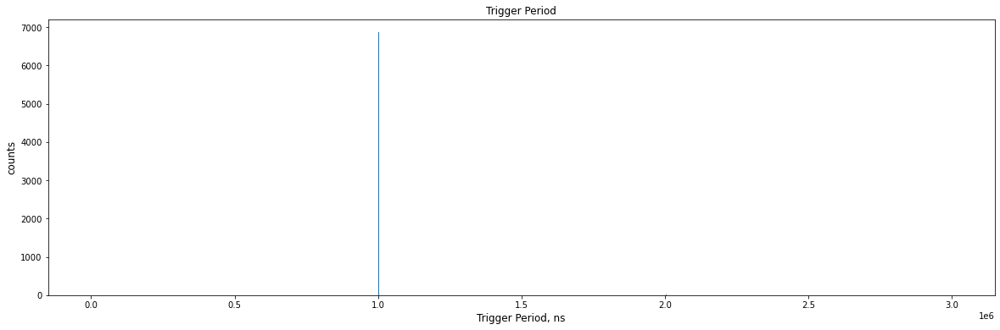

In [99]:
(n, bins, patches) = plt.hist(periodlist,range = (0,3e6), bins = 1000)
plt.title("Trigger Period", fontsize = 12) # change the title
plt.xlabel('Trigger Period, ns',fontsize = 12)
plt.ylabel('counts',fontsize = 12)
# plt.legend(loc='upper right')
# plt.xticks(bins[::80])
plt.show()